# Création d’un dataset de changement sur le Gers

## Objectif

L’objectif ici est de créer 2 datasets :
un par zone, c’est à dire que l’on créé des patches de la taille des zones annotées.
Un par petit patch,

### données en entrée :
 - __/mnt/store_dai/pocs/odeon/exo_pascal/zones_vt_diff_D032_2016_2019_S1.shp__: Le shape file avec les zones (bounding boxes) annotées

- __/mnt/store_dai/pocs/odeon/exo_pascal/annotations__: Le répertoire où se trouvent les annotations ( les annotations se trouvent à chaque fois dans des sous dossiers dans lequel il existe un sous dossier appelé SEGMENTED_DATA, c’est ici que ça se passe). Les annotations sont binaires, c’est à dire que tous les polygones renseignés correspondent à du changement, mans il n’y pas de notion de classe sémantique.

- __/mnt/store_dai/datasrc/ORTHO_MNS_MNT__: Ici se trouvent les données raster sources, à savoir le MNT, le MNS, l’IRC et le RVB, pour les années 2016 et 2019.

Pour chaque source, il y a un VRT afin de faciliter les accès en lecture, exemple pour le mns de 2016: /mnt/store_dai/datasrc/ORTHO_MNS_MNT/D032/2016/data_brutes/mns.vrt
Le mnt est le même pour 2016 et 2019, les évolutions du terrain étant rares par rapport à celles du sursol.


### Attendu en sortie :

l'attendu est de reproduire les 2 datasets changement du Gers (/mnt/store_dai/projets/dchan/datasets/gers/change), à savoir: 

- un par zone à 20cm de résolution, où tu vas tout simplement prendre les sources (RVB, IR, Elévation, et masque vérité terrain) dans l'emprise de chaque zone et créer un raster T0 pour 2016, un raster T1 pour 2019 et un raster masque changement change. Cela te donnera donc 3 répertoires T0 T1 et Change (voir les datasets pour mieux visualiser l'attendu).

- un par patch de 512*512 pixels à 20cm de résolution, tu devras ici découper tes zones (on parle de tuiler en télédétection) et faire des accès fenêtrés à tes entrées (voir doc de rasterio et Geopandas).

> Attention, tout doit être bien géo-référencé en Lambert 93.

Ainsi, pour la partie dataset par zone, on aura0 dans un répertoire racine nommé zones :

- un raster RVBIE de la taille de la zone à 20cm de résolution en int8 par date 2016 et 2019 dans un répertoire en respectant la nomenclature suivante de chemin relatif : T0/nom_de_la_zone.tiff pour T0 et T1/nom_de_la_zone.tiff.

- un raster de masque changement binaire 0/1 de la taille de la zone à 20cm de résolution en int8, en respectant la nomenclature de chemin relatif suivante : change/nom_de_la_zone.tiff

- un fichier shapefile à la racine nommé dataset.shp répartoriant dans des colonnes T0 T1 et change les chemins relatifs de chaque raster pour chaque zone.

Pour la partie par patch, on veut la même chose, mais lorsque l’on nomme un fichier, en plus du nom de la zone, on va donner la position en lambert 93 en x et y du coin en haut à gauche du patch dans le nom, par exemple pour T0, le chemin relatif sera : T0/nom_de_la_zone_posx_posy.tiff

> NB : les positions sont en float, hors les virgules ne sont pas acceptées dans un nom de fichier, il faudra les remplacer par des petits tirets par exemple (-) et on choisit de se limiter à 4 décimales.

Le mieux c'est de regarder à quoi ça ressemble sur /mnt/store_dai/projets/dchan/datasets/gers/change. la partie fichier dataset splité train / val /test et K split n'est pas le sujet, cela peut-être fait en option, mais dans ce cas là il faut que je précise que les folds en télédétection on les fait géographiquement (en gros ici ça veut dire que les patchs appartenant à une même zone seront dans le même fold) afin d'éviter des biais de proximité géographique, sachant que 2 patches côte à côte ont de grandes chances d'être très similaire, et peut biaiser notre appréciation du facteur de généralisation du modèle.


In [73]:
import geopandas
import rasterio
import rasterio.features
import os
import numpy as np
import glob
import pathlib
import pandas as pd
from tqdm.notebook import tqdm
import shapely

In [2]:
pd.set_option('display.max_colwidth', 1000)


## Building Datasources

In [3]:
zones_shp_file = "/mnt/store_dai/pocs/odeon/exo_pascal/zones_vt_diff_D032_2016_2019_S1.shp"
mns_2016_vrt_file = "/mnt/store_dai/datasrc/ORTHO_MNS_MNT/D032/2016/data_brutes/mns.vrt"
irc_2016_vrt_file = "/mnt/store_dai/datasrc/ORTHO_MNS_MNT/D032/2016/data_brutes/irc.vrt"
rvb_2016_vrt_file = "/mnt/store_dai/datasrc/ORTHO_MNS_MNT/D032/2016/data_brutes/rvb.vrt"

mns_2019_vrt_file = "/mnt/store_dai/datasrc/ORTHO_MNS_MNT/D032/2019/data_brutes/mns.vrt"
irc_2019_vrt_file = "/mnt/store_dai/datasrc/ORTHO_MNS_MNT/D032/2019/data_brutes/irc.vrt"
rvb_2019_vrt_file = "/mnt/store_dai/datasrc/ORTHO_MNS_MNT/D032/2019/data_brutes/rvb.vrt"

mnt_vrt_file = "/mnt/store_dai/datasrc/ORTHO_MNS_MNT/mnt/mnt_v3/MNT_2023_01_24_1m.vrt"
annotations_dir = "/mnt/store_dai/pocs/odeon/exo_pascal/annotations/"

resolution = 0.2

In [4]:
os.makedirs("output/T0", exist_ok=True)
os.makedirs("output/T1", exist_ok=True)

In [5]:
mns_2016_vrt = rasterio.open(mns_2016_vrt_file)
irc_2016_vrt = rasterio.open(irc_2016_vrt_file)
rvb_2016_vrt = rasterio.open(rvb_2016_vrt_file)

In [6]:
mns_2019_vrt = rasterio.open(mns_2019_vrt_file)
irc_2019_vrt = rasterio.open(irc_2019_vrt_file)
rvb_2019_vrt = rasterio.open(rvb_2019_vrt_file)

In [7]:
# mnt is common to 2016 & 2019
mnt_vrt = rasterio.open(mnt_vrt_file)

In [8]:
zones_df = geopandas.read_file(zones_shp_file)

In [9]:
zones_df.head()

,id_zone,comment,millesime1,millesime2,nom,num_serie,changeType,id_bis,geometry
0,UC_S1_1,"construction, broussailles-feuillus, culture",2016,2019,D032,1,UC,1,"POLYGON ((485584.000 6256200.000, 485840.000 6256200.000, 485840.000 6255944.000, 485584.000 6255944.000, 485584.000 6256200.000))"
1,CV_S1_2,"culture, herbacés-feuillus",2016,2019,D032,1,CV,2,"POLYGON ((491472.000 6257224.000, 491216.000 6257224.000, 491216.000 6257480.000, 491216.000 6257736.000, 491472.000 6257736.000, 491728.000 6257736.000, 491728.000 6257480.000, 491728.000 6257224.000, 491472.000 6257224.000))"
2,CU_S1_3,"culture, construction, sol_nu-feuillus",2016,2019,D032,1,CU,3,"POLYGON ((499664.000 6259016.000, 499920.000 6259016.000, 499920.000 6258760.000, 499664.000 6258760.000, 499664.000 6259016.000))"
3,VV_S1_4,broussailles-feuillus,2016,2019,D032,1,VV,4,"POLYGON ((475344.000 6259272.000, 475344.000 6259016.000, 475088.000 6259016.000, 474832.000 6259016.000, 474832.000 6259272.000, 474832.000 6259528.000, 475088.000 6259528.000, 475344.000 6259528.000, 475344.000 6259272.000))"
4,CU_S1_5,"construction, culture, sol_nu-feuillus",2016,2019,D032,1,CU,5,"POLYGON ((489936.000 6259528.000, 489936.000 6259272.000, 489680.000 6259272.000, 489680.000 6259528.000, 489680.000 6259784.000, 489936.000 6259784.000, 489936.000 6259528.000))"


## Code Utilities

In [69]:
# Code extracted from pandas to tile a zone

import logging
from typing import Dict, Generator, List, Union, Tuple, TypeAlias

import geopandas as gpd
import numpy as np
from shapely.geometry import box, mapping


def create_box_from_bounds(x_min: float, y_min: float, x_max: float, y_max: float) -> box:
    """

    Parameters
    ----------
    x_min
    y_min
    x_max
    y_max

    Returns
    -------
    shapely.geometry.box

    """

    return box(x_min, y_min, x_max, y_max)

#from .types import GeoTuple, OptionalGeoTuple
#from .vector import box, create_box_from_bounds

logger = logging.getLogger(__name__)

OptionalGeoTuple: TypeAlias = Union[int, float, Tuple[float, float], Tuple[int, int]]
GeoTuple: TypeAlias = Union[Tuple[float, float], List[float]]  # used for stuf like patch size, overlapd, etc.

def tile(bounds: List, tile_size: OptionalGeoTuple = 256.0, overlap: OptionalGeoTuple = 0,
         strict_inclusion: bool = True, fit_extent: bool = False) -> Generator[Dict, None, None]:
    """
    Simple function to tile with a regular step in X-axis and Y-axis
    Parameters
    ----------
    bounds : list
        bounds of the extent to tile
    tile_size : int | float | Tuple[float, float] | Tuple[int, int] | None
        size of tile
    overlap : int | float | Tuple[float, float] | Tuple[int, int] | None
        size of overlap if needed
    strict_inclusion : bool, default True
        if set to True, it will not add tile if it's in part outside the extent
    fit_extent:
        if strict_inclusion is false and extent not a multiple of tile size,
        it will adjust the x and y coordinates of tiles with an outside part the extent

    Returns
    -------

    """
    gdf: gpd.GeoDataFrame
    min_x, min_y = bounds[0], bounds[1]
    max_x, max_y = bounds[2], bounds[3]
    tile_size_tuple = tile_size if isinstance(tile_size, tuple) else (tile_size, tile_size)
    overlap_tuple = overlap if isinstance(overlap, tuple) else (overlap, overlap)
    assert 2 * overlap_tuple[0] < tile_size_tuple[0]
    assert 2 * overlap_tuple[1] < tile_size_tuple[1]

    step = [
        tile_size_tuple[0] - (2 * overlap_tuple[0]),
        tile_size_tuple[1] - (2 * overlap_tuple[1])
    ]

    for i in np.arange(min_x - overlap_tuple[0], max_x + overlap_tuple[0], step[0]):

        for j in np.arange(min_y - overlap_tuple[1], max_y + overlap_tuple[1], step[1]):

            "handling case where the extent is not a multiple of step"
            if (i + tile_size_tuple[0] > max_x + overlap_tuple[0] or j + tile_size_tuple[1] > max_y + overlap_tuple[1])\
                    and strict_inclusion:
                pass

            else:
                if fit_extent and strict_inclusion is False:
                    "handling case where the extent is not a multiple of step and you want to fit it"
                    if i + tile_size[0] > max_x:
                        i = max_x - tile_size[0]

                    if j + tile_size[1] > max_y:
                        j = max_y - tile_size[1]
                # j = max_y + tile_size[1] - tile_size[1]
                left = i
                right = i + tile_size_tuple[0]
                bottom = j
                top = j + tile_size_tuple[1]
                bbox: box = create_box_from_bounds(left, bottom, right, top)
                row_d = {
                    "id": f"{left}-{bottom}-{right}-{top}",
                    "geometry": bbox
                }
                yield row_d

In [79]:
def compute_mnh(mns: np.ndarray, mnt: np.ndarray) -> np.ndarray :
    """
    Computes height above ground bounding to min 0.2m and max 50.0m.
    """
    mnh = mns - mnt
    mnh[mnh > 50.0] = 50.0
    mnh[mnh < 0.20] = 0.0
    mnh *= 5.0 # x5 to spread values up to 250 (1byte max 255)
    return mnh

def read_window(
    rvb_vrt, irc_vrt, mns_vrt, mnt_vrt,
    left, bottom, right, top, resolution
):
    """
    Reads RVBIE data from VRTs in given window.
    """
    width = int((right - left) / resolution)
    height = int((top - bottom) / resolution)
    rvb_w = rasterio.windows.from_bounds(left, bottom, right, top, rvb_vrt.transform)
    mns_w = rasterio.windows.from_bounds(left, bottom, right, top, mns_vrt.transform)
    mnt_w = rasterio.windows.from_bounds(left, bottom, right, top, mnt_vrt.transform)
    irc_w = rasterio.windows.from_bounds(left, bottom, right, top, irc_vrt.transform)
    rvb_data = rvb_vrt.read([1, 2, 3], window=rvb_w, out_shape=(3, width, height))
    mns_data= mns_vrt.read(1, window=mns_w, out_shape=(1, width, height))
    mnt_data= mnt_vrt.read(1, window=mnt_w, out_shape=(1, width, height))

    # keep elevation only above ground limited to 50m
    elevation_data = compute_mnh(mns_data, mnt_data)
    irc_data = irc_vrt.read(1, window=irc_w, out_shape=(1, width, height))

    data = np.concatenate((rvb_data, np.expand_dims(irc_data, 0), np.expand_dims(elevation_data, 0)), axis=0)
    return data

def write_tiff(
    data,
    out_file,
    profile, count, left, bottom, right, top, width, height,
):
    """
    Utility function to write data in TIFF file in given window.
    """
    profile.update(
        dtype=rasterio.uint8,
        nodata=None,
        count=count,
        compress='lzw',
        driver= 'GTiff',
        width = width,
        height = height,
        transform = rasterio.transform.from_bounds(left, bottom, right, top, width, height)
    )
    with rasterio.open(out_file, 'w', **profile) as dst:
        dst.write(data.astype(rasterio.uint8), np.arange(1, count+1) if count > 1 else 1 )
        print(f"Wrote {out_file} ({width} x {height} pixels)")

        
def write_zone_rvbie(
    zones_df,
    rvb_vrt, irc_vrt, mns_vrt, mnt_vrt,
    output_dir,
    resolution,
    max_elements=-1
):
    """
    Reads RVBIE data corresponding to zone geometry in all given VRTs
    and writes in a TIFF file.
    """
    os.makedirs(output_dir, exist_ok=True)
    out_files = []
    profile = mns_vrt.profile
    zones_boundaries = zones_df.geometry.bounds
    ids_zones = zones_df.id_zone
    nb_elts = 0
    for idx, (left, bottom, right, top) in zones_boundaries.iterrows():
        if max_elements >= 0 and nb_elts >= max_elements:
            break

        width = int((right - left) / resolution)
        height = int((top - bottom) / resolution)
            
        # read & write full zone raster
        data = read_window(
            rvb_vrt, irc_vrt, mns_vrt, mnt_vrt,
            left, bottom, right, top, resolution
        )
        id_zone = ids_zones[idx]

        out_file = f"{output_dir}/{id_zone}.tiff"
        write_tiff(
            data,
            out_file,
            profile, 5, left, bottom, right, top, width, height,
        )

        nb_elts+=1
        out_files.append(out_file)
    return out_files



def write_patches_rvbie(
    zones_df,
    rvb_vrt, irc_vrt, mns_vrt, mnt_vrt,
    output_dir,
    patch_size_in_pixels,
    resolution,
    max_elements=-1,
):
    """
    Tiles zone in patches
    then reads RVBIE data corresponding to patch geometry in all given VRTs
    and writes in a TIFF file.
    """
    os.makedirs(output_dir, exist_ok=True)
    out_files = []
    profile = mns_vrt.profile
    zones_boundaries = zones_df.geometry.bounds
    ids_zones = zones_df.id_zone
    nb_elts = 0
    for idx, (left, bottom, right, top) in zones_boundaries.iterrows():
        if max_elements >= 0 and nb_elts >= max_elements:
            break
            
        os.makedirs(output_dir, exist_ok=True)
        patch_size = patch_size_in_pixels * resolution
        patches = tile([left, bottom, right, top], patch_size)
        for patch in patches:
            (left, bottom, right, top) = patch["geometry"].bounds
            width = int((right - left) / resolution)
            height = int((top - bottom) / resolution)
            
            # read & write full patch raster
            data = read_window(
                rvb_vrt, irc_vrt, mns_vrt, mnt_vrt,
                left, bottom, right, top, resolution
            )
            id_zone = ids_zones[idx]

            min_x_str = f"{left:.4f}".replace(".", "-")
            max_y_str = f"{top:.4f}".replace(".", "-")
            out_file = f"{output_dir}/{id_zone}-{min_x_str}-{max_y_str}.tiff"
            write_tiff(
                data,
                out_file,
                profile, 5, left, bottom, right, top, width, height,
            )
            out_files.append(out_file)
        nb_elts+=1
    return out_files


def write_zone_mask(
    changes_by_zone_df,
    zones_df,
    mnt_vrt,
    output_dir,
    resolution,
    live_plot = False
):
    """
    Builds mask raster corresponding to change geometries in a zone
    and writes to a TIFF file.
    """
    os.makedirs(output_dir, exist_ok=True)
    out_files = []
    profile = mnt_vrt.profile
    for idx, zd in list(zones_df.iterrows()):
#     for zone, r in list(changes_by_zone_df.iterrows()):
        zone = zd["id_zone"]
        print(f"Zone {zone} Building Mask...")
        if zone in changes_by_zone_df.index:
            r = changes_by_zone_df.loc[zone]
            (left, bottom, right, top) = zd["geometry"].bounds
    #         (left, bottom, right, top) = zd.bounds.values[0]
            width = int((right - left) / resolution)
            height = int((top - bottom) / resolution)
            print(height, width)
            if r.geometry.geom_type == 'Polygon':
                raster = rasterio.features.rasterize(
                    shapes = [r.geometry], out_shape = (height, width), fill = 0, default_value = 1,
                    transform = rasterio.transform.from_bounds(left, bottom, right, top, width, height),
                    all_touched=True
                )
            elif r.geometry.geom_type == 'MultiPolygon':
                raster = rasterio.features.rasterize(
                    shapes = r.geometry.geoms, out_shape = (height, width), fill = 0, default_value = 1,
                    transform = rasterio.transform.from_bounds(left, bottom, right, top, width, height),
                    all_touched=True
                )
            else:
                raise Exception("Impossible case")


        else:
            raster = rasterio.features.rasterize(
                shapes = [(zd["geometry"], None)], out_shape = (height, width), fill = 0,
                transform = rasterio.transform.from_bounds(left, bottom, right, top, width, height),
                all_touched=True
            )
                 
        if live_plot:
            from matplotlib import pyplot as plt
            plt.imshow(raster, interpolation='nearest')
            plt.show()
            
        out_file = f"{output_dir}/{zone}.tiff"

        write_tiff(
            raster,
            out_file,
            profile, 1, left, bottom, right, top, width, height,
        )
        out_files.append(out_file)
    return out_files


def write_patches_mask(
    changes_by_zone_df,
    zones_df,
    mnt_vrt,
    output_dir,
    patch_size_in_pixels,
    resolution,
    live_plot = False
):
    """
    Builds mask raster corresponding to change geometries in a zone
    and writes to a TIFF file.
    """
    os.makedirs(output_dir, exist_ok=True)
    out_files = []
    profile = mnt_vrt.profile
    
    for idx, zd in list(zones_df.iterrows()):
#     for zone, r in list(changes_by_zone_df.iterrows()):
        zone = zd["id_zone"]
        print(f"Zone {zone} Building Mask...")
        if zone in changes_by_zone_df.index:
            r = changes_by_zone_df.loc[zone]
            (left, bottom, right, top) = zd["geometry"].bounds
            patch_size = patch_size_in_pixels * resolution
            patches = tile([left, bottom, right, top], patch_size)
            for patch in patches:
                (pleft, pbottom, pright, ptop) = patch["geometry"].bounds
                pwidth = int((pright - pleft) / resolution)
                pheight = int((ptop - pbottom) / resolution)

                if r.geometry.geom_type == 'Polygon':
                    raster = rasterio.features.rasterize(
                        shapes = [r.geometry], out_shape = (pheight, pwidth), fill = 0, default_value = 1,
                        transform = rasterio.transform.from_bounds(pleft, pbottom, pright, ptop, pwidth, pheight),
                        all_touched=False
                    )
                elif r.geometry.geom_type == 'MultiPolygon':
                    raster = rasterio.features.rasterize(
                        shapes = r.geometry.geoms, out_shape = (pheight, pwidth), fill = 0, default_value = 1,
                        transform = rasterio.transform.from_bounds(pleft, pbottom, pright, ptop, pwidth, pheight),
                        all_touched=False
                    )
                if live_plot:
                    from matplotlib import pyplot as plt
                    plt.imshow(raster, interpolation='nearest')
                    plt.show()

                min_x_str = f"{pleft:.4f}".replace(".", "-")
                max_y_str = f"{ptop:.4f}".replace(".", "-")
                out_file = f"{output_dir}/{zone}-{min_x_str}-{max_y_str}.tiff"

                write_tiff(
                    raster,
                    out_file,
                    profile, 1, pleft, pbottom, pright, ptop, pwidth, pheight,
                )
                out_files.append(out_file)

        else:
            (left, bottom, right, top) = zd["geometry"].bounds
            patch_size = patch_size_in_pixels * resolution
            patches = tile([left, bottom, right, top], patch_size)
            for patch in patches:
                (pleft, pbottom, pright, ptop) = patch["geometry"].bounds
                pwidth = int((pright - pleft) / resolution)
                pheight = int((ptop - pbottom) / resolution)
                raster = rasterio.features.rasterize(
                    shapes = [(patch["geometry"], None)], out_shape = (pheight, pwidth), fill = 0,
                    transform = rasterio.transform.from_bounds(pleft, pbottom, pright, ptop, pwidth, pheight),
                    all_touched=True
                )
                if live_plot:
                    from matplotlib import pyplot as plt
                    plt.imshow(raster, interpolation='nearest')
                    plt.show()

                min_x_str = f"{pleft:.4f}".replace(".", "-")
                max_y_str = f"{ptop:.4f}".replace(".", "-")
                out_file = f"{output_dir}/{zone}-{min_x_str}-{max_y_str}.tiff"

                write_tiff(
                    raster,
                    out_file,
                    profile, 1, pleft, pbottom, pright, ptop, pwidth, pheight,
                )
                out_files.append(out_file)
                
    return out_files


#             r = changes_by_zone_df.loc[zone]
#             (left, bottom, right, top) = zd["geometry"].bounds
#             patch_size = patch_size_in_pixels * resolution
#             patches = tile([left, bottom, right, top], patch_size)
#             for patch in patches:
#                 (left, bottom, right, top) = patch["geometry"].bounds
#                 width = int((right - left) / resolution)
#                 height = int((top - bottom) / resolution)

#                 intersect = shapely.intersection(patch["geometry"], r["geometry"])
                
#                 if not intersect.is_empty:
#                     if intersect.geom_type == 'Polygon':
#                         raster = rasterio.features.rasterize(
#                             shapes = [intersect], out_shape = (height, width), fill = 0, default_value = 1,
#                             transform = rasterio.transform.from_bounds(left, bottom, right, top, width, height),
#                             all_touched=True
#                         )
#                     elif intersect.geom_type == 'MultiPolygon':
#                         raster = rasterio.features.rasterize(
#                             shapes = intersect.geoms, out_shape = (height, width), fill = 0, default_value = 1,
#                             transform = rasterio.transform.from_bounds(left, bottom, right, top, width, height),
#                             all_touched=True
#                         )
#                 else:
#                     raster = rasterio.features.rasterize(
#                         shapes = [(patch["geometry"], None)], out_shape = (height, width), fill = 0,
#                         transform = rasterio.transform.from_bounds(left, bottom, right, top, width, height),
#                         all_touched=True
#                     )
#                 if live_plot:
#                     from matplotlib import pyplot as plt
#                     plt.imshow(raster, interpolation='nearest')
#                     plt.show()

#                 min_x_str = f"{left:.4f}".replace(".", "-")
#                 max_y_str = f"{top:.4f}".replace(".", "-")
#                 out_file = f"{output_dir}/{zone}-{min_x_str}-{max_y_str}.tiff"

#                 write_tiff(
#                     raster,
#                     out_file,
#                     profile, 1, left, bottom, right, top, width, height,
#                 )
#                 out_files.append(out_file)

## Build 2016 zone & patches (T0)

In [14]:
zone_2016_files = write_zone_rvbie(zones_df, rvb_2016_vrt, irc_2016_vrt, mns_2016_vrt, mnt_vrt,
            "output/zones/T0", resolution=resolution)

Wrote output/zones/T0/UC_S1_1.tiff (1280 x 1280 pixels)
Wrote output/zones/T0/CV_S1_2.tiff (2560 x 2560 pixels)
Wrote output/zones/T0/CU_S1_3.tiff (1280 x 1280 pixels)
Wrote output/zones/T0/VV_S1_4.tiff (2560 x 2560 pixels)
Wrote output/zones/T0/CU_S1_5.tiff (1280 x 2560 pixels)
Wrote output/zones/T0/VV_S1_6.tiff (1280 x 2560 pixels)
Wrote output/zones/T0/CC_S1_7.tiff (2560 x 2560 pixels)
Wrote output/zones/T0/CV_S1_8.tiff (3840 x 3840 pixels)
Wrote output/zones/T0/VV_S1_9.tiff (2560 x 2560 pixels)
Wrote output/zones/T0/CC_S1_10.tiff (3840 x 2560 pixels)
Wrote output/zones/T0/CU_S1_11.tiff (1280 x 1280 pixels)
Wrote output/zones/T0/CN_S1_12.tiff (1280 x 1280 pixels)
Wrote output/zones/T0/CU_S1_13.tiff (3840 x 3840 pixels)
Wrote output/zones/T0/UC_S1_14.tiff (2560 x 2560 pixels)
Wrote output/zones/T0/VV_S1_15.tiff (1280 x 1280 pixels)
Wrote output/zones/T0/UC_S1_16.tiff (2560 x 3840 pixels)
Wrote output/zones/T0/UU_S1_17.tiff (2560 x 2560 pixels)
Wrote output/zones/T0/UU_S1_18.tiff (128

Wrote output/zones/T0/UU_S1_145.tiff (3840 x 2560 pixels)
Wrote output/zones/T0/CV_S1_146.tiff (6400 x 3840 pixels)
Wrote output/zones/T0/UC_S1_147.tiff (1280 x 2560 pixels)
Wrote output/zones/T0/VU_S1_148.tiff (2560 x 2560 pixels)
Wrote output/zones/T0/VC_S1_149.tiff (1280 x 1280 pixels)
Wrote output/zones/T0/CU_S1_150.tiff (2560 x 1280 pixels)
Wrote output/zones/T0/NV_S1_151.tiff (2560 x 1280 pixels)
Wrote output/zones/T0/CU_S1_152.tiff (1280 x 1280 pixels)
Wrote output/zones/T0/CU_S1_153.tiff (2560 x 2560 pixels)
Wrote output/zones/T0/VC_S1_154.tiff (1280 x 1280 pixels)
Wrote output/zones/T0/UV_S1_155.tiff (1280 x 2560 pixels)
Wrote output/zones/T0/CN_S1_156.tiff (1280 x 1280 pixels)
Wrote output/zones/T0/CV_S1_157.tiff (1280 x 1280 pixels)
Wrote output/zones/T0/CC_S1_158.tiff (2560 x 1280 pixels)
Wrote output/zones/T0/UV_S1_159.tiff (5120 x 2560 pixels)
Wrote output/zones/T0/VV_S1_160.tiff (1280 x 1280 pixels)
Wrote output/zones/T0/UU_S1_161.tiff (1280 x 1280 pixels)
Wrote output/z

In [16]:
patches_2016_files = write_patches_rvbie(zones_df, rvb_2016_vrt, irc_2016_vrt, mns_2016_vrt, mnt_vrt,
            "output/patches/T0", patch_size_in_pixels=512, resolution=resolution)

Wrote output/patches/T0/UC_S1_1-485584-0000-6256046-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_1-485584-0000-6256148-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_1-485686-4000-6256046-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_1-485686-4000-6256148-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_2-491216-0000-6257326-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_2-491216-0000-6257428-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_2-491216-0000-6257531-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_2-491216-0000-6257633-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_2-491318-4000-6257326-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_2-491318-4000-6257428-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_2-491318-4000-6257531-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_2-491318-4000-6257633-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S

Wrote output/patches/T0/CV_S1_8-500329-6000-6261422-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_8-500329-6000-6261524-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_8-500432-0000-6260910-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_8-500432-0000-6261012-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_8-500432-0000-6261115-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_8-500432-0000-6261217-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_8-500432-0000-6261320-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_8-500432-0000-6261422-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_8-500432-0000-6261524-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_8-500534-4000-6260910-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_8-500534-4000-6261012-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_8-500534-4000-6261115-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S

Wrote output/patches/T0/CU_S1_13-503760-0000-6262702-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_13-503760-0000-6262804-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_13-503760-0000-6262907-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_13-503760-0000-6263009-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_13-503760-0000-6263112-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_13-503760-0000-6263214-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_13-503760-0000-6263316-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_13-503862-4000-6262702-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_13-503862-4000-6262804-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_13-503862-4000-6262907-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_13-503862-4000-6263009-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_13-503862-4000-6263112-0000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/UU_S1_22-533558-4000-6270996-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_23-468176-0000-6270894-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_23-468176-0000-6270996-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_23-468176-0000-6271099-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_23-468176-0000-6271201-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_23-468176-0000-6271304-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_23-468176-0000-6271406-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_23-468176-0000-6271508-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_23-468278-4000-6270894-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_23-468278-4000-6270996-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_23-468278-4000-6271099-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_23-468278-4000-6271201-6000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/UC_S1_34-462800-0000-6277243-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_34-462800-0000-6277345-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_34-462902-4000-6277038-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_34-462902-4000-6277140-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_34-462902-4000-6277243-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_34-462902-4000-6277345-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_34-463004-8000-6277038-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_34-463004-8000-6277140-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_34-463004-8000-6277243-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_34-463004-8000-6277345-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_34-463107-2000-6277038-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_34-463107-2000-6277140-8000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/UU_S1_40-554038-4000-6278779-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_40-554038-4000-6278881-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_41-553168-0000-6278830-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_41-553168-0000-6278932-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_41-553270-4000-6278830-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_41-553270-4000-6278932-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_42-458192-0000-6279086-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_42-458192-0000-6279188-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_42-458192-0000-6279291-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_42-458192-0000-6279393-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_42-458294-4000-6279086-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_42-458294-4000-6279188-8000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/NV_S1_49-475856-0000-6281595-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NV_S1_49-475856-0000-6281697-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NV_S1_49-475856-0000-6281800-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NV_S1_49-475856-0000-6281902-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NV_S1_49-475856-0000-6282004-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NV_S1_49-475856-0000-6282107-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NV_S1_49-475856-0000-6282209-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NV_S1_49-475958-4000-6281390-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NV_S1_49-475958-4000-6281492-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NV_S1_49-475958-4000-6281595-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NV_S1_49-475958-4000-6281697-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NV_S1_49-475958-4000-6281800-0000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/UC_S1_50-527158-4000-6281646-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_50-527158-4000-6281748-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_50-527158-4000-6281851-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_50-527158-4000-6281953-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_50-527158-4000-6282056-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_50-527158-4000-6282158-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_50-527158-4000-6282260-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_50-527260-8000-6281646-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_50-527260-8000-6281748-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_50-527260-8000-6281851-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_50-527260-8000-6281953-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_50-527260-8000-6282056-0000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/UC_S1_57-493264-0000-6282414-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_57-493264-0000-6282516-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_57-493264-0000-6282619-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_57-493264-0000-6282721-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_57-493366-4000-6282414-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_57-493366-4000-6282516-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_57-493366-4000-6282619-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_57-493366-4000-6282721-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CF_S1_58-465104-0000-6282670-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CF_S1_58-465104-0000-6282772-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CF_S1_58-465104-0000-6282875-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CF_S1_58-465104-0000-6282977-6000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/UV_S1_63-546870-4000-6283796-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_63-546870-4000-6283899-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_63-546870-4000-6284001-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_63-546870-4000-6284104-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_63-546870-4000-6284206-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_63-546870-4000-6284308-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_63-546972-8000-6283694-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_63-546972-8000-6283796-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_63-546972-8000-6283899-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_63-546972-8000-6284001-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_63-546972-8000-6284104-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_63-546972-8000-6284206-4000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/UU_S1_69-519683-2000-6286049-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_69-519683-2000-6286152-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_69-519683-2000-6286254-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_69-519683-2000-6286356-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_69-519683-2000-6286459-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_69-519683-2000-6286561-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_69-519785-6000-6285742-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_69-519785-6000-6285844-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_69-519785-6000-6285947-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_69-519785-6000-6286049-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_69-519785-6000-6286152-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_69-519785-6000-6286254-4000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/NU_S1_73-455632-0000-6287432-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-455632-0000-6287534-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-455632-0000-6287636-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-455632-0000-6287739-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-455632-0000-6287841-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-455734-4000-6286510-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-455734-4000-6286612-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-455734-4000-6286715-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-455734-4000-6286817-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-455734-4000-6286920-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-455734-4000-6287022-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-455734-4000-6287124-8000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/NU_S1_73-456451-2000-6286510-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-456451-2000-6286612-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-456451-2000-6286715-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-456451-2000-6286817-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-456451-2000-6286920-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-456451-2000-6287022-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-456451-2000-6287124-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-456451-2000-6287227-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-456451-2000-6287329-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-456451-2000-6287432-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-456451-2000-6287534-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/NU_S1_73-456451-2000-6287636-8000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/UU_S1_83-507907-2000-6287790-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_83-507907-2000-6287892-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_83-507907-2000-6287995-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_83-507907-2000-6288097-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_84-451536-0000-6288046-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_84-451536-0000-6288148-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_84-451638-4000-6288046-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_84-451638-4000-6288148-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_85-439504-0000-6288302-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_85-439504-0000-6288404-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_85-439504-0000-6288507-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_85-439504-0000-6288609-6000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/CU_S1_90-473296-0000-6289326-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_90-473296-0000-6289428-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_90-473398-4000-6289326-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_90-473398-4000-6289428-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_90-473500-8000-6289326-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_90-473500-8000-6289428-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_90-473603-2000-6289326-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_90-473603-2000-6289428-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_91-462288-0000-6289070-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_91-462288-0000-6289172-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_91-462390-4000-6289070-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_91-462390-4000-6289172-8000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/UU_S1_96-445955-2000-6289889-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_96-445955-2000-6289992-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_96-445955-2000-6290094-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_96-445955-2000-6290196-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CN_S1_97-449232-0000-6289838-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CN_S1_97-449232-0000-6289940-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CN_S1_97-449232-0000-6290043-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CN_S1_97-449232-0000-6290145-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CN_S1_97-449334-4000-6289838-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CN_S1_97-449334-4000-6289940-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CN_S1_97-449334-4000-6290043-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CN_S1_97-449334-4000-6290145-6000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T0/CC_S1_108-453123-2000-6292654-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_108-453123-2000-6292756-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_108-453123-2000-6292859-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_108-453123-2000-6292961-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_108-453225-6000-6292654-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_108-453225-6000-6292756-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_108-453225-6000-6292859-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_108-453225-6000-6292961-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_108-453328-0000-6292654-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_108-453328-0000-6292756-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_108-453328-0000-6292859-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_108-453328-0000-6292961-6000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/UU_S1_111-529155-2000-6293678-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_111-529155-2000-6293780-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_111-529155-2000-6293883-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_111-529155-2000-6293985-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_111-529155-2000-6294088-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_111-529155-2000-6294190-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_111-529155-2000-6294292-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_111-529155-2000-6294395-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_111-529155-2000-6294497-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_112-441552-0000-6293678-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_112-441552-0000-6293780-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_112-441654-4000-6293678-4000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/VC_S1_128-472784-0000-6299566-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_128-472784-0000-6299668-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_128-472784-0000-6299771-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_128-472784-0000-6299873-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_128-472886-4000-6299566-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_128-472886-4000-6299668-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_128-472886-4000-6299771-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_128-472886-4000-6299873-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_129-463312-0000-6299822-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_129-463312-0000-6299924-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_129-463312-0000-6300027-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CC_S1_129-463312-0000-6300129-6000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/VU_S1_139-462748-8000-6303406-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_139-462748-8000-6303508-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_139-462748-8000-6303611-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_139-462748-8000-6303713-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_139-462748-8000-6303816-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_139-462748-8000-6303918-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_139-462748-8000-6304020-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_139-462851-2000-6303406-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_139-462851-2000-6303508-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_139-462851-2000-6303611-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_139-462851-2000-6303713-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_139-462851-2000-6303816-0000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/CV_S1_146-469456-0000-6304174-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_146-469456-0000-6304276-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_146-469456-0000-6304379-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_146-469456-0000-6304481-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_146-469456-0000-6304584-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_146-469456-0000-6304686-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_146-469456-0000-6304788-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_146-469558-4000-6304174-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_146-469558-4000-6304276-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_146-469558-4000-6304379-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_146-469558-4000-6304481-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CV_S1_146-469558-4000-6304584-0000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/VU_S1_148-465820-8000-6304737-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_148-465923-2000-6304430-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_148-465923-2000-6304532-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_148-465923-2000-6304635-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_148-465923-2000-6304737-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_149-447440-0000-6304430-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_149-447440-0000-6304532-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_149-447542-4000-6304430-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_149-447542-4000-6304532-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_150-448464-0000-6304686-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_150-448464-0000-6304788-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_150-448566-4000-6304686-4000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/UV_S1_159-458140-8000-6308270-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_159-458140-8000-6308372-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_159-458140-8000-6308475-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_159-458140-8000-6308577-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_159-458243-2000-6308270-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_159-458243-2000-6308372-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_159-458243-2000-6308475-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_159-458243-2000-6308577-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_160-463312-0000-6308782-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_160-463312-0000-6308884-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_160-463414-4000-6308782-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_160-463414-4000-6308884-8000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/UV_S1_163-472579-2000-6309857-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_163-472579-2000-6309960-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_163-472579-2000-6310062-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UV_S1_163-472579-2000-6310164-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_164-453584-0000-6310062-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_164-453584-0000-6310164-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_164-453686-4000-6310062-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_164-453686-4000-6310164-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_164-453788-8000-6310062-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_164-453788-8000-6310164-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_164-453891-2000-6310062-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_164-453891-2000-6310164-8000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/VC_S1_168-475958-4000-6311598-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_168-475958-4000-6311700-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_168-476060-8000-6311086-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_168-476060-8000-6311188-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_168-476060-8000-6311291-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_168-476060-8000-6311393-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_168-476060-8000-6311496-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_168-476060-8000-6311598-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_168-476060-8000-6311700-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_168-476163-2000-6311086-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_168-476163-2000-6311188-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_168-476163-2000-6311291-2000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/VC_S1_175-446416-0000-6312110-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_175-446416-0000-6312212-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_175-446416-0000-6312315-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_175-446416-0000-6312417-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_175-446518-4000-6312110-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_175-446518-4000-6312212-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_175-446518-4000-6312315-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_175-446518-4000-6312417-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_176-449488-0000-6312110-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_176-449488-0000-6312212-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_176-449590-4000-6312110-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_176-449590-4000-6312212-8000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/UC_S1_193-457526-4000-6315438-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_193-457526-4000-6315540-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_193-457526-4000-6315643-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_193-457526-4000-6315745-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_194-479184-0000-6316974-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_194-479184-0000-6317076-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_194-479184-0000-6317179-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_194-479184-0000-6317281-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_194-479286-4000-6316974-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_194-479286-4000-6317076-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_194-479286-4000-6317179-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VU_S1_194-479286-4000-6317281-6000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/VC_S1_197-448361-6000-6316974-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_197-448361-6000-6317076-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_197-448361-6000-6317179-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_197-448361-6000-6317281-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_197-448464-0000-6316974-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_197-448464-0000-6317076-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_197-448464-0000-6317179-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_197-448464-0000-6317281-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_197-448566-4000-6316974-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_197-448566-4000-6317076-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_197-448566-4000-6317179-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_197-448566-4000-6317281-6000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/VC_S1_202-468227-2000-6317998-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_202-468227-2000-6318100-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_202-468329-6000-6317998-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_202-468329-6000-6318100-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_202-468432-0000-6317998-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_202-468432-0000-6318100-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_202-468534-4000-6317998-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_202-468534-4000-6318100-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_203-487632-0000-6317998-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_203-487632-0000-6318100-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_203-487734-4000-6317998-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_203-487734-4000-6318100-8000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/CU_S1_207-455888-0000-6319022-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_207-455888-0000-6319124-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_207-455990-4000-6319022-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/CU_S1_207-455990-4000-6319124-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_208-457424-0000-6319278-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_208-457424-0000-6319380-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_208-457526-4000-6319278-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_208-457526-4000-6319380-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_209-476112-0000-6319278-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_209-476112-0000-6319380-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_209-476112-0000-6319483-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_209-476112-0000-6319585-6000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/VV_S1_214-451894-4000-6320916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_214-451996-8000-6320814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_214-451996-8000-6320916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_214-452099-2000-6320814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_214-452099-2000-6320916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_214-452201-6000-6320814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_214-452201-6000-6320916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_214-452304-0000-6320814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_214-452304-0000-6320916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_214-452406-4000-6320814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VV_S1_214-452406-4000-6320916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_215-490192-0000-6320814-4000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/VC_S1_222-477340-8000-6323476-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_222-477340-8000-6323579-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_222-477340-8000-6323681-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_222-477443-2000-6323374-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_222-477443-2000-6323476-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_222-477443-2000-6323579-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/VC_S1_222-477443-2000-6323681-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_223-468688-0000-6323886-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_223-468688-0000-6323988-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_223-468790-4000-6323886-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_223-468790-4000-6323988-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UU_S1_223-468892-8000-6323886-4000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T0/UC_S1_228-506268-8000-6332334-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_228-506268-8000-6332436-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_228-506268-8000-6332539-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_228-506268-8000-6332641-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_228-506371-2000-6331822-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_228-506371-2000-6331924-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_228-506371-2000-6332027-2000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_228-506371-2000-6332129-6000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_228-506371-2000-6332232-0000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_228-506371-2000-6332334-4000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_228-506371-2000-6332436-8000.tiff (512 x 512 pixels)
Wrote output/patches/T0/UC_S1_228-506371-2000-6332539-2000.tiff (512 x 512 pixels)
Wrot

## Build 2019 zone & patches (T1)

In [17]:
zone_2019_files = write_zone_rvbie(zones_df, rvb_2019_vrt, irc_2019_vrt, mns_2019_vrt, mnt_vrt,
            "output/zones/T1", resolution=resolution)

Wrote output/zones/T1/UC_S1_1.tiff (1280 x 1280 pixels)
Wrote output/zones/T1/CV_S1_2.tiff (2560 x 2560 pixels)
Wrote output/zones/T1/CU_S1_3.tiff (1280 x 1280 pixels)
Wrote output/zones/T1/VV_S1_4.tiff (2560 x 2560 pixels)
Wrote output/zones/T1/CU_S1_5.tiff (1280 x 2560 pixels)
Wrote output/zones/T1/VV_S1_6.tiff (1280 x 2560 pixels)
Wrote output/zones/T1/CC_S1_7.tiff (2560 x 2560 pixels)
Wrote output/zones/T1/CV_S1_8.tiff (3840 x 3840 pixels)
Wrote output/zones/T1/VV_S1_9.tiff (2560 x 2560 pixels)
Wrote output/zones/T1/CC_S1_10.tiff (3840 x 2560 pixels)
Wrote output/zones/T1/CU_S1_11.tiff (1280 x 1280 pixels)
Wrote output/zones/T1/CN_S1_12.tiff (1280 x 1280 pixels)
Wrote output/zones/T1/CU_S1_13.tiff (3840 x 3840 pixels)
Wrote output/zones/T1/UC_S1_14.tiff (2560 x 2560 pixels)
Wrote output/zones/T1/VV_S1_15.tiff (1280 x 1280 pixels)
Wrote output/zones/T1/UC_S1_16.tiff (2560 x 3840 pixels)
Wrote output/zones/T1/UU_S1_17.tiff (2560 x 2560 pixels)
Wrote output/zones/T1/UU_S1_18.tiff (128

Wrote output/zones/T1/UU_S1_145.tiff (3840 x 2560 pixels)
Wrote output/zones/T1/CV_S1_146.tiff (6400 x 3840 pixels)
Wrote output/zones/T1/UC_S1_147.tiff (1280 x 2560 pixels)
Wrote output/zones/T1/VU_S1_148.tiff (2560 x 2560 pixels)
Wrote output/zones/T1/VC_S1_149.tiff (1280 x 1280 pixels)
Wrote output/zones/T1/CU_S1_150.tiff (2560 x 1280 pixels)
Wrote output/zones/T1/NV_S1_151.tiff (2560 x 1280 pixels)
Wrote output/zones/T1/CU_S1_152.tiff (1280 x 1280 pixels)
Wrote output/zones/T1/CU_S1_153.tiff (2560 x 2560 pixels)
Wrote output/zones/T1/VC_S1_154.tiff (1280 x 1280 pixels)
Wrote output/zones/T1/UV_S1_155.tiff (1280 x 2560 pixels)
Wrote output/zones/T1/CN_S1_156.tiff (1280 x 1280 pixels)
Wrote output/zones/T1/CV_S1_157.tiff (1280 x 1280 pixels)
Wrote output/zones/T1/CC_S1_158.tiff (2560 x 1280 pixels)
Wrote output/zones/T1/UV_S1_159.tiff (5120 x 2560 pixels)
Wrote output/zones/T1/VV_S1_160.tiff (1280 x 1280 pixels)
Wrote output/zones/T1/UU_S1_161.tiff (1280 x 1280 pixels)
Wrote output/z

In [18]:
patches_2019_files = write_patches_rvbie(zones_df, rvb_2019_vrt, irc_2019_vrt, mns_2019_vrt, mnt_vrt,
            "output/patches/T1", patch_size_in_pixels=512, resolution=resolution)

Wrote output/patches/T1/UC_S1_1-485584-0000-6256046-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_1-485584-0000-6256148-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_1-485686-4000-6256046-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_1-485686-4000-6256148-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_2-491216-0000-6257326-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_2-491216-0000-6257428-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_2-491216-0000-6257531-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_2-491216-0000-6257633-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_2-491318-4000-6257326-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_2-491318-4000-6257428-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_2-491318-4000-6257531-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_2-491318-4000-6257633-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S

Wrote output/patches/T1/CV_S1_8-500329-6000-6261217-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_8-500329-6000-6261320-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_8-500329-6000-6261422-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_8-500329-6000-6261524-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_8-500432-0000-6260910-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_8-500432-0000-6261012-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_8-500432-0000-6261115-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_8-500432-0000-6261217-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_8-500432-0000-6261320-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_8-500432-0000-6261422-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_8-500432-0000-6261524-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_8-500534-4000-6260910-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S

Wrote output/patches/T1/CU_S1_13-503760-0000-6262702-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_13-503760-0000-6262804-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_13-503760-0000-6262907-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_13-503760-0000-6263009-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_13-503760-0000-6263112-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_13-503760-0000-6263214-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_13-503760-0000-6263316-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_13-503862-4000-6262702-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_13-503862-4000-6262804-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_13-503862-4000-6262907-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_13-503862-4000-6263009-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_13-503862-4000-6263112-0000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/UU_S1_22-533558-4000-6270894-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_22-533558-4000-6270996-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_23-468176-0000-6270894-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_23-468176-0000-6270996-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_23-468176-0000-6271099-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_23-468176-0000-6271201-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_23-468176-0000-6271304-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_23-468176-0000-6271406-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_23-468176-0000-6271508-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_23-468278-4000-6270894-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_23-468278-4000-6270996-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_23-468278-4000-6271099-2000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/UC_S1_34-462800-0000-6277038-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_34-462800-0000-6277140-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_34-462800-0000-6277243-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_34-462800-0000-6277345-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_34-462902-4000-6277038-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_34-462902-4000-6277140-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_34-462902-4000-6277243-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_34-462902-4000-6277345-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_34-463004-8000-6277038-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_34-463004-8000-6277140-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_34-463004-8000-6277243-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_34-463004-8000-6277345-6000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/UU_S1_41-553168-0000-6278830-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_41-553168-0000-6278932-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_41-553270-4000-6278830-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_41-553270-4000-6278932-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_42-458192-0000-6279086-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_42-458192-0000-6279188-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_42-458192-0000-6279291-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_42-458192-0000-6279393-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_42-458294-4000-6279086-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_42-458294-4000-6279188-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_42-458294-4000-6279291-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_42-458294-4000-6279393-6000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/NV_S1_49-475856-0000-6281902-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NV_S1_49-475856-0000-6282004-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NV_S1_49-475856-0000-6282107-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NV_S1_49-475856-0000-6282209-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NV_S1_49-475958-4000-6281390-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NV_S1_49-475958-4000-6281492-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NV_S1_49-475958-4000-6281595-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NV_S1_49-475958-4000-6281697-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NV_S1_49-475958-4000-6281800-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NV_S1_49-475958-4000-6281902-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NV_S1_49-475958-4000-6282004-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NV_S1_49-475958-4000-6282107-2000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/UC_S1_50-527158-4000-6281646-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_50-527158-4000-6281748-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_50-527158-4000-6281851-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_50-527158-4000-6281953-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_50-527158-4000-6282056-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_50-527158-4000-6282158-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_50-527158-4000-6282260-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_50-527260-8000-6281646-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_50-527260-8000-6281748-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_50-527260-8000-6281851-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_50-527260-8000-6281953-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_50-527260-8000-6282056-0000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/UC_S1_57-493264-0000-6282414-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_57-493264-0000-6282516-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_57-493264-0000-6282619-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_57-493264-0000-6282721-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_57-493366-4000-6282414-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_57-493366-4000-6282516-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_57-493366-4000-6282619-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_57-493366-4000-6282721-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CF_S1_58-465104-0000-6282670-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CF_S1_58-465104-0000-6282772-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CF_S1_58-465104-0000-6282875-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CF_S1_58-465104-0000-6282977-6000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/UV_S1_63-546870-4000-6283899-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_63-546870-4000-6284001-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_63-546870-4000-6284104-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_63-546870-4000-6284206-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_63-546870-4000-6284308-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_63-546972-8000-6283694-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_63-546972-8000-6283796-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_63-546972-8000-6283899-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_63-546972-8000-6284001-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_63-546972-8000-6284104-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_63-546972-8000-6284206-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_63-546972-8000-6284308-8000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/UU_S1_69-519683-2000-6285844-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_69-519683-2000-6285947-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_69-519683-2000-6286049-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_69-519683-2000-6286152-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_69-519683-2000-6286254-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_69-519683-2000-6286356-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_69-519683-2000-6286459-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_69-519683-2000-6286561-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_69-519785-6000-6285742-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_69-519785-6000-6285844-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_69-519785-6000-6285947-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_69-519785-6000-6286049-6000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/NU_S1_73-455632-0000-6287227-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-455632-0000-6287329-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-455632-0000-6287432-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-455632-0000-6287534-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-455632-0000-6287636-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-455632-0000-6287739-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-455632-0000-6287841-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-455734-4000-6286510-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-455734-4000-6286612-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-455734-4000-6286715-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-455734-4000-6286817-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-455734-4000-6286920-0000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/NU_S1_73-456348-8000-6287432-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-456348-8000-6287534-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-456348-8000-6287636-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-456348-8000-6287739-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-456348-8000-6287841-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-456451-2000-6286510-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-456451-2000-6286612-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-456451-2000-6286715-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-456451-2000-6286817-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-456451-2000-6286920-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-456451-2000-6287022-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NU_S1_73-456451-2000-6287124-8000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/UU_S1_83-507702-4000-6288097-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_83-507804-8000-6287790-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_83-507804-8000-6287892-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_83-507804-8000-6287995-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_83-507804-8000-6288097-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_83-507907-2000-6287790-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_83-507907-2000-6287892-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_83-507907-2000-6287995-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_83-507907-2000-6288097-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_84-451536-0000-6288046-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_84-451536-0000-6288148-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_84-451638-4000-6288046-4000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/NN_S1_89-447388-8000-6288814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NN_S1_89-447388-8000-6288916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NN_S1_89-447491-2000-6288814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/NN_S1_89-447491-2000-6288916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_90-473296-0000-6289326-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_90-473296-0000-6289428-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_90-473398-4000-6289326-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_90-473398-4000-6289428-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_90-473500-8000-6289326-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_90-473500-8000-6289428-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_90-473603-2000-6289326-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_90-473603-2000-6289428-8000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/UU_S1_96-445955-2000-6289582-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_96-445955-2000-6289684-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_96-445955-2000-6289787-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_96-445955-2000-6289889-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_96-445955-2000-6289992-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_96-445955-2000-6290094-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_96-445955-2000-6290196-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CN_S1_97-449232-0000-6289838-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CN_S1_97-449232-0000-6289940-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CN_S1_97-449232-0000-6290043-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CN_S1_97-449232-0000-6290145-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CN_S1_97-449334-4000-6289838-4000.tiff (512 x 512 pixels)
Wrote output/pat

Wrote output/patches/T1/CC_S1_108-452918-4000-6292961-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_108-453020-8000-6292654-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_108-453020-8000-6292756-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_108-453020-8000-6292859-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_108-453020-8000-6292961-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_108-453123-2000-6292654-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_108-453123-2000-6292756-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_108-453123-2000-6292859-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_108-453123-2000-6292961-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_108-453225-6000-6292654-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_108-453225-6000-6292756-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_108-453225-6000-6292859-2000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/UU_S1_111-529052-8000-6294497-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_111-529155-2000-6293678-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_111-529155-2000-6293780-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_111-529155-2000-6293883-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_111-529155-2000-6293985-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_111-529155-2000-6294088-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_111-529155-2000-6294190-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_111-529155-2000-6294292-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_111-529155-2000-6294395-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_111-529155-2000-6294497-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_112-441552-0000-6293678-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_112-441552-0000-6293780-8000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/VC_S1_128-472784-0000-6299566-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_128-472784-0000-6299668-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_128-472784-0000-6299771-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_128-472784-0000-6299873-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_128-472886-4000-6299566-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_128-472886-4000-6299668-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_128-472886-4000-6299771-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_128-472886-4000-6299873-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_129-463312-0000-6299822-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_129-463312-0000-6299924-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_129-463312-0000-6300027-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CC_S1_129-463312-0000-6300129-6000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/VU_S1_139-462748-8000-6303406-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_139-462748-8000-6303508-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_139-462748-8000-6303611-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_139-462748-8000-6303713-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_139-462748-8000-6303816-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_139-462748-8000-6303918-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_139-462748-8000-6304020-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_139-462851-2000-6303406-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_139-462851-2000-6303508-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_139-462851-2000-6303611-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_139-462851-2000-6303713-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_139-462851-2000-6303816-0000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/CV_S1_146-469456-0000-6304174-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_146-469456-0000-6304276-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_146-469456-0000-6304379-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_146-469456-0000-6304481-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_146-469456-0000-6304584-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_146-469456-0000-6304686-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_146-469456-0000-6304788-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_146-469558-4000-6304174-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_146-469558-4000-6304276-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_146-469558-4000-6304379-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_146-469558-4000-6304481-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CV_S1_146-469558-4000-6304584-0000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/VU_S1_148-465820-8000-6304532-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_148-465820-8000-6304635-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_148-465820-8000-6304737-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_148-465923-2000-6304430-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_148-465923-2000-6304532-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_148-465923-2000-6304635-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_148-465923-2000-6304737-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_149-447440-0000-6304430-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_149-447440-0000-6304532-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_149-447542-4000-6304430-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_149-447542-4000-6304532-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_150-448464-0000-6304686-4000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/UV_S1_159-458140-8000-6308270-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_159-458140-8000-6308372-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_159-458140-8000-6308475-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_159-458140-8000-6308577-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_159-458243-2000-6308270-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_159-458243-2000-6308372-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_159-458243-2000-6308475-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_159-458243-2000-6308577-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_160-463312-0000-6308782-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_160-463312-0000-6308884-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_160-463414-4000-6308782-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_160-463414-4000-6308884-8000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/UV_S1_163-472579-2000-6309550-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_163-472579-2000-6309652-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_163-472579-2000-6309755-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_163-472579-2000-6309857-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_163-472579-2000-6309960-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_163-472579-2000-6310062-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UV_S1_163-472579-2000-6310164-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_164-453584-0000-6310062-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_164-453584-0000-6310164-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_164-453686-4000-6310062-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_164-453686-4000-6310164-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_164-453788-8000-6310062-4000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/VC_S1_168-475958-4000-6311291-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_168-475958-4000-6311393-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_168-475958-4000-6311496-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_168-475958-4000-6311598-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_168-475958-4000-6311700-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_168-476060-8000-6311086-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_168-476060-8000-6311188-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_168-476060-8000-6311291-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_168-476060-8000-6311393-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_168-476060-8000-6311496-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_168-476060-8000-6311598-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_168-476060-8000-6311700-8000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/VV_S1_174-468176-0000-6311598-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_174-468176-0000-6311700-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_174-468278-4000-6311598-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_174-468278-4000-6311700-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_175-446416-0000-6312110-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_175-446416-0000-6312212-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_175-446416-0000-6312315-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_175-446416-0000-6312417-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_175-446518-4000-6312110-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_175-446518-4000-6312212-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_175-446518-4000-6312315-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_175-446518-4000-6312417-6000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/UC_S1_193-457424-0000-6315438-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_193-457424-0000-6315540-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_193-457424-0000-6315643-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_193-457424-0000-6315745-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_193-457526-4000-6315438-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_193-457526-4000-6315540-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_193-457526-4000-6315643-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_193-457526-4000-6315745-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_194-479184-0000-6316974-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_194-479184-0000-6317076-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_194-479184-0000-6317179-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VU_S1_194-479184-0000-6317281-6000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/VC_S1_197-448259-2000-6317179-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_197-448259-2000-6317281-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_197-448361-6000-6316974-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_197-448361-6000-6317076-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_197-448361-6000-6317179-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_197-448361-6000-6317281-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_197-448464-0000-6316974-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_197-448464-0000-6317076-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_197-448464-0000-6317179-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_197-448464-0000-6317281-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_197-448566-4000-6316974-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_197-448566-4000-6317076-8000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/VC_S1_202-468124-8000-6318100-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_202-468227-2000-6317998-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_202-468227-2000-6318100-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_202-468329-6000-6317998-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_202-468329-6000-6318100-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_202-468432-0000-6317998-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_202-468432-0000-6318100-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_202-468534-4000-6317998-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_202-468534-4000-6318100-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_203-487632-0000-6317998-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_203-487632-0000-6318100-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_203-487734-4000-6317998-4000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/CU_S1_207-455888-0000-6319022-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_207-455888-0000-6319124-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_207-455990-4000-6319022-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/CU_S1_207-455990-4000-6319124-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_208-457424-0000-6319278-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_208-457424-0000-6319380-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_208-457526-4000-6319278-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_208-457526-4000-6319380-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_209-476112-0000-6319278-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_209-476112-0000-6319380-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_209-476112-0000-6319483-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_209-476112-0000-6319585-6000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/VV_S1_214-451996-8000-6320814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_214-451996-8000-6320916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_214-452099-2000-6320814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_214-452099-2000-6320916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_214-452201-6000-6320814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_214-452201-6000-6320916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_214-452304-0000-6320814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_214-452304-0000-6320916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_214-452406-4000-6320814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_214-452406-4000-6320916-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_215-490192-0000-6320814-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_215-490192-0000-6320916-8000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/VC_S1_222-477340-8000-6323681-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_222-477443-2000-6323374-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_222-477443-2000-6323476-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_222-477443-2000-6323579-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VC_S1_222-477443-2000-6323681-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_223-468688-0000-6323886-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_223-468688-0000-6323988-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_223-468790-4000-6323886-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_223-468790-4000-6323988-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_223-468892-8000-6323886-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_223-468892-8000-6323988-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UU_S1_223-468995-2000-6323886-4000.tiff (512 x 512 pixels)
Wrot

Wrote output/patches/T1/UC_S1_228-506371-2000-6331822-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_228-506371-2000-6331924-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_228-506371-2000-6332027-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_228-506371-2000-6332129-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_228-506371-2000-6332232-0000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_228-506371-2000-6332334-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_228-506371-2000-6332436-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_228-506371-2000-6332539-2000.tiff (512 x 512 pixels)
Wrote output/patches/T1/UC_S1_228-506371-2000-6332641-6000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_229-446416-0000-6294190-4000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_229-446416-0000-6294292-8000.tiff (512 x 512 pixels)
Wrote output/patches/T1/VV_S1_229-446416-0000-6294395-2000.tiff (512 x 512 pixels)
Wrot

## Build masks from annotations

In [72]:
# get all directories of annotation (corresponding to "commune")
from pathlib import Path
anns = list(Path(annotations_dir).glob("*"))

# spatial join between zone and annotation zone with change only
change_dfs = []
for ann in tqdm(anns):
    print(f"Computing {ann}")
    shp_file = list((ann / "SEGMENTED_DATA").glob("*.shp"))[0]
    shp_df = geopandas.read_file(shp_file)
    change_df = shp_df[shp_df["change"] == 1].copy()
    zs = change_df.sjoin(zones_df, how="inner", predicate="intersects")
    change_df["zone"] = zs["id_zone"]
    change_df["town"] = ann
    change_dfs.append(change_df)
    
# group by zone
changes_df = geopandas.GeoDataFrame(pd.concat(change_dfs, ignore_index=True))
changes_by_zone_df = changes_df.dissolve(by='zone')
print(changes_by_zone_df.head())    

  0%|          | 0/28 [00:00<?, ?it/s]

Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/L_ISLE_JOURDAIN
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/CATELNAU_D_AUZAN_LABARRERE
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/MAUVEZIN
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/BARCELONNE_DU_GERS
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/PUJAUDRAN
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/RISCLE
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/MANCIET
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/LE_HOUGA
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/MIELAN
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/VIELLA
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/REANS
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/ARBLADE_LE_HAUT
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/PREREMPLIE
Computing /mnt/store_dai/pocs/odeon/exo_pascal/annotations/CONDOM
Computing /mnt/

## Build zone & patches masks

Zone UC_S1_1 Building Mask...
1280 1280


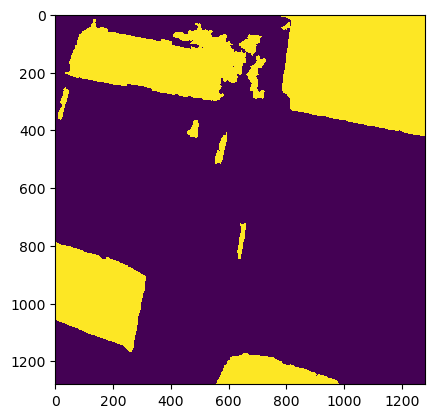

Wrote output/zones/mask/UC_S1_1.tiff (1280 x 1280 pixels)
Zone CV_S1_2 Building Mask...
2560 2560


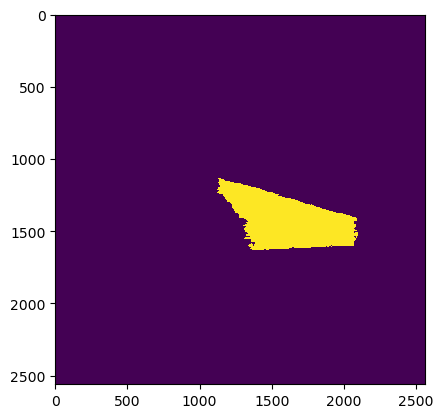

Wrote output/zones/mask/CV_S1_2.tiff (2560 x 2560 pixels)
Zone CU_S1_3 Building Mask...
1280 1280


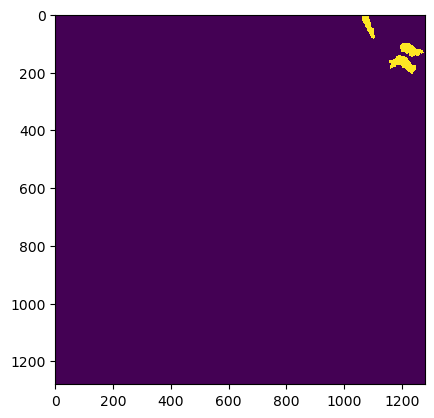

Wrote output/zones/mask/CU_S1_3.tiff (1280 x 1280 pixels)
Zone VV_S1_4 Building Mask...
2560 2560


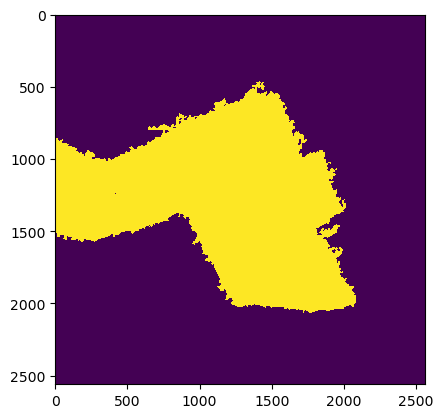

Wrote output/zones/mask/VV_S1_4.tiff (2560 x 2560 pixels)
Zone CU_S1_5 Building Mask...
2560 1280


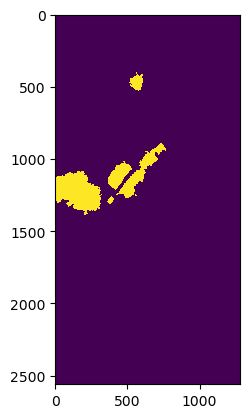

Wrote output/zones/mask/CU_S1_5.tiff (1280 x 2560 pixels)
Zone VV_S1_6 Building Mask...


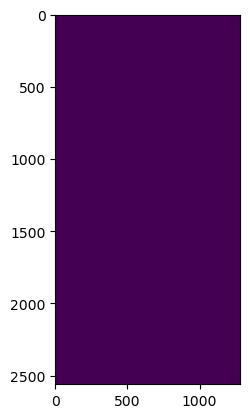

Wrote output/zones/mask/VV_S1_6.tiff (1280 x 2560 pixels)
Zone CC_S1_7 Building Mask...
2560 2560


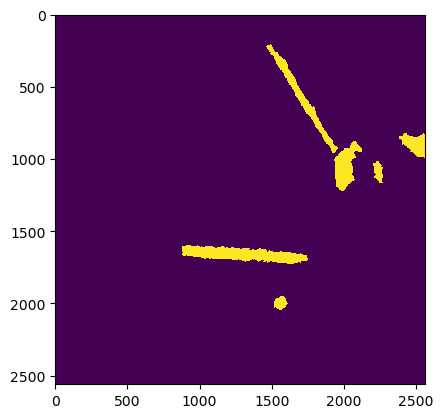

Wrote output/zones/mask/CC_S1_7.tiff (2560 x 2560 pixels)
Zone CV_S1_8 Building Mask...
3840 3840


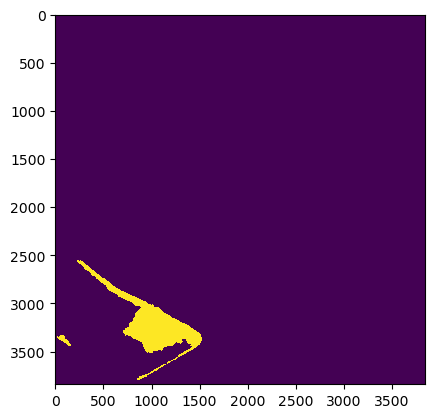

Wrote output/zones/mask/CV_S1_8.tiff (3840 x 3840 pixels)
Zone VV_S1_9 Building Mask...
2560 2560


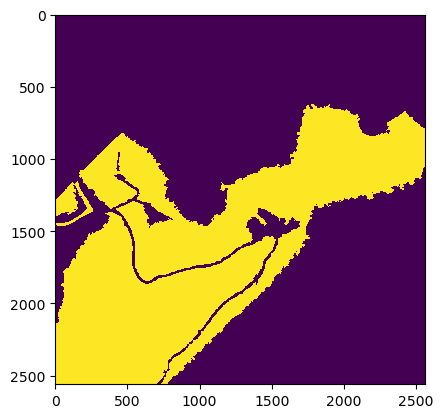

Wrote output/zones/mask/VV_S1_9.tiff (2560 x 2560 pixels)
Zone CC_S1_10 Building Mask...
2560 3840


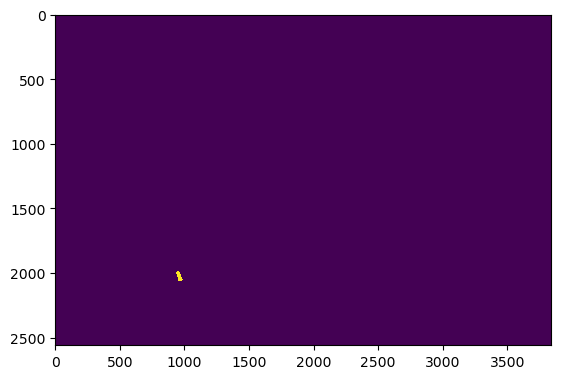

Wrote output/zones/mask/CC_S1_10.tiff (3840 x 2560 pixels)
Zone CU_S1_11 Building Mask...
1280 1280


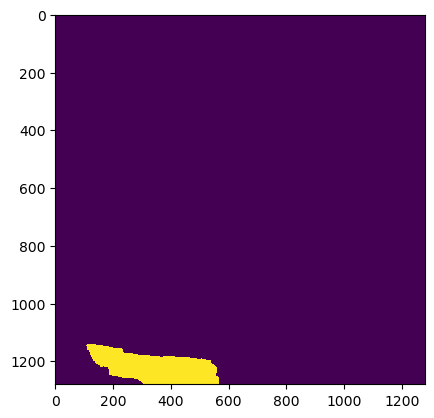

Wrote output/zones/mask/CU_S1_11.tiff (1280 x 1280 pixels)
Zone CN_S1_12 Building Mask...
1280 1280


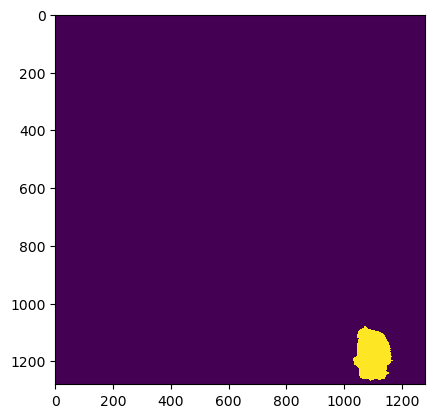

Wrote output/zones/mask/CN_S1_12.tiff (1280 x 1280 pixels)
Zone CU_S1_13 Building Mask...
3840 3840


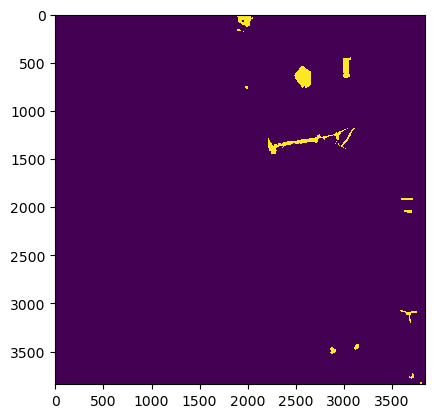

Wrote output/zones/mask/CU_S1_13.tiff (3840 x 3840 pixels)
Zone UC_S1_14 Building Mask...
2560 2560


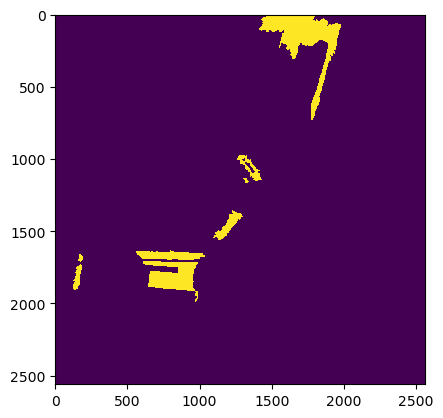

Wrote output/zones/mask/UC_S1_14.tiff (2560 x 2560 pixels)
Zone VV_S1_15 Building Mask...
1280 1280


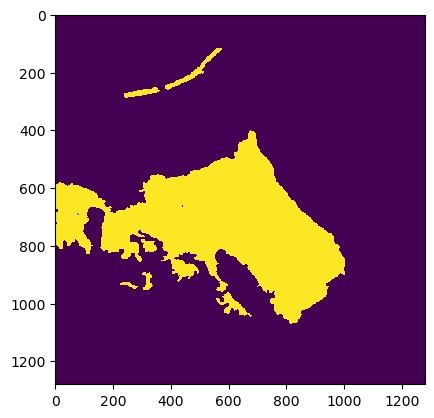

Wrote output/zones/mask/VV_S1_15.tiff (1280 x 1280 pixels)
Zone UC_S1_16 Building Mask...
3840 2560


KeyboardInterrupt: 

In [80]:
zones_masks_files = write_zone_mask(
    changes_by_zone_df,
    zones_df,
    mnt_vrt,
    "output/zones/mask",
    resolution,
    live_plot=True
)

Zone UC_S1_1 Building Mask...


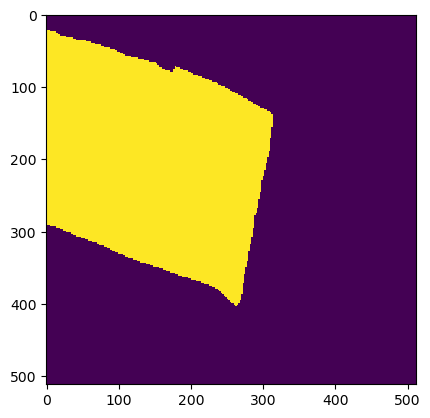

Wrote output/patches/mask/UC_S1_1-485584-0000-6256046-4000.tiff (512 x 512 pixels)


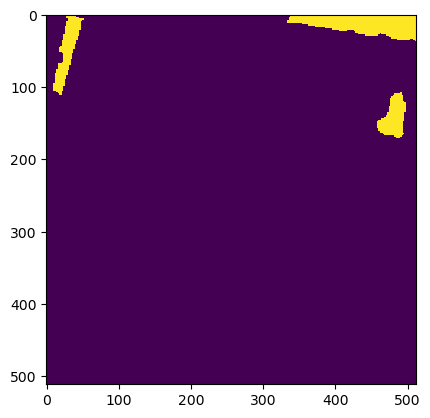

Wrote output/patches/mask/UC_S1_1-485584-0000-6256148-8000.tiff (512 x 512 pixels)


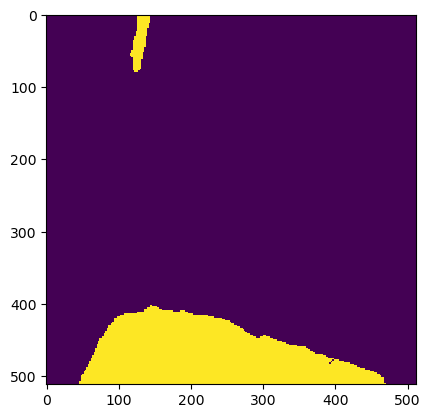

Wrote output/patches/mask/UC_S1_1-485686-4000-6256046-4000.tiff (512 x 512 pixels)


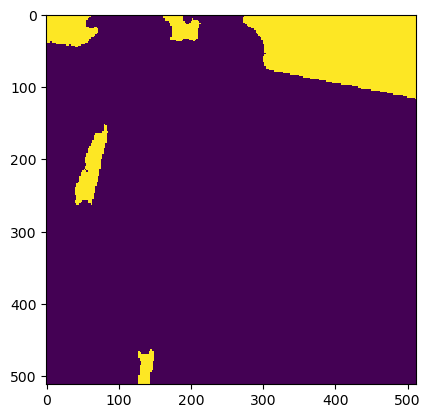

Wrote output/patches/mask/UC_S1_1-485686-4000-6256148-8000.tiff (512 x 512 pixels)
Zone CV_S1_2 Building Mask...


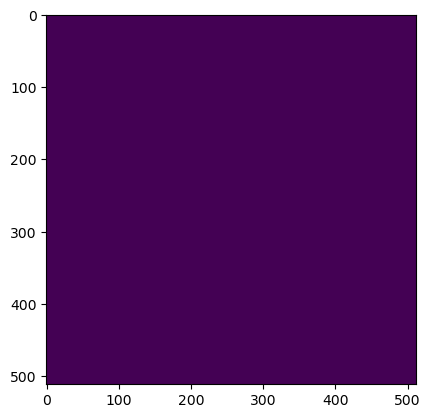

Wrote output/patches/mask/CV_S1_2-491216-0000-6257326-4000.tiff (512 x 512 pixels)


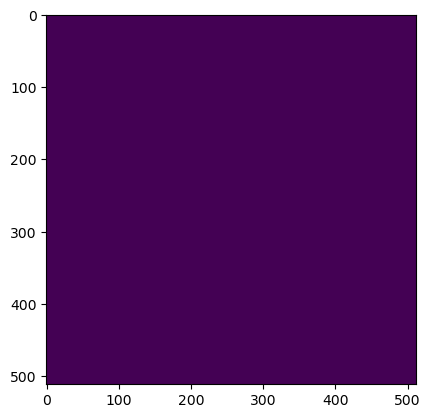

Wrote output/patches/mask/CV_S1_2-491216-0000-6257428-8000.tiff (512 x 512 pixels)


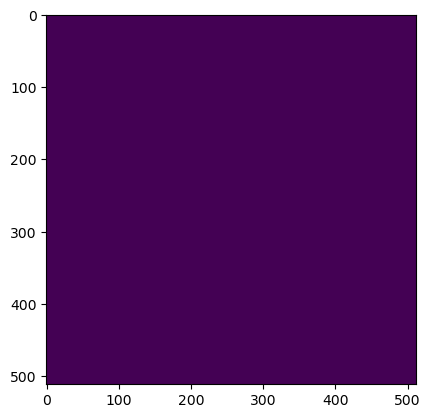

Wrote output/patches/mask/CV_S1_2-491216-0000-6257531-2000.tiff (512 x 512 pixels)


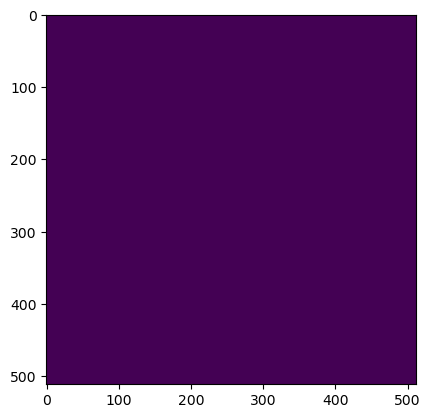

Wrote output/patches/mask/CV_S1_2-491216-0000-6257633-6000.tiff (512 x 512 pixels)


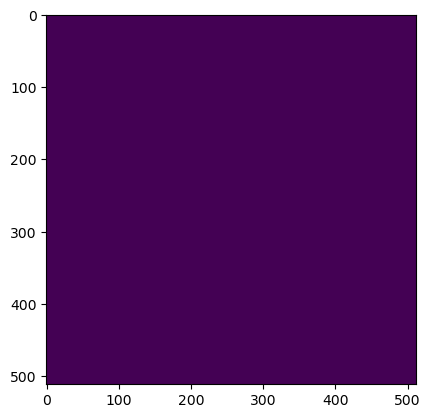

Wrote output/patches/mask/CV_S1_2-491318-4000-6257326-4000.tiff (512 x 512 pixels)


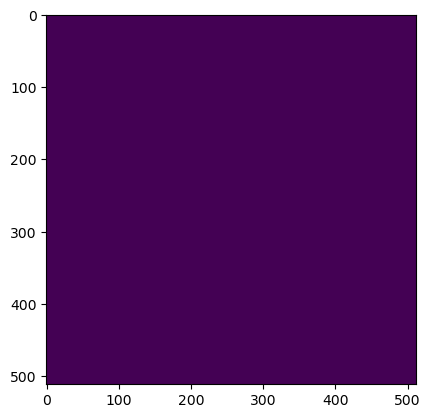

Wrote output/patches/mask/CV_S1_2-491318-4000-6257428-8000.tiff (512 x 512 pixels)


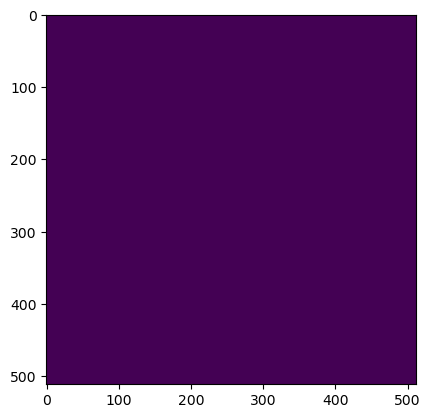

Wrote output/patches/mask/CV_S1_2-491318-4000-6257531-2000.tiff (512 x 512 pixels)


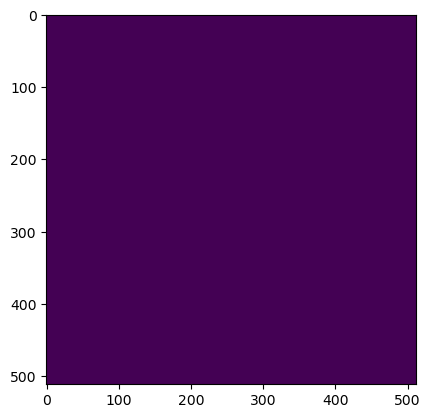

Wrote output/patches/mask/CV_S1_2-491318-4000-6257633-6000.tiff (512 x 512 pixels)


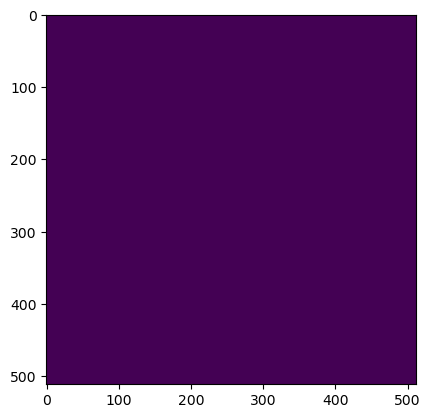

Wrote output/patches/mask/CV_S1_2-491420-8000-6257326-4000.tiff (512 x 512 pixels)


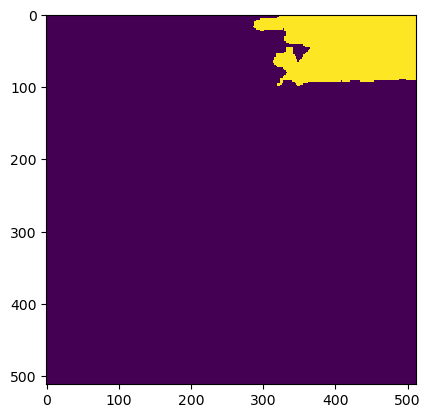

Wrote output/patches/mask/CV_S1_2-491420-8000-6257428-8000.tiff (512 x 512 pixels)


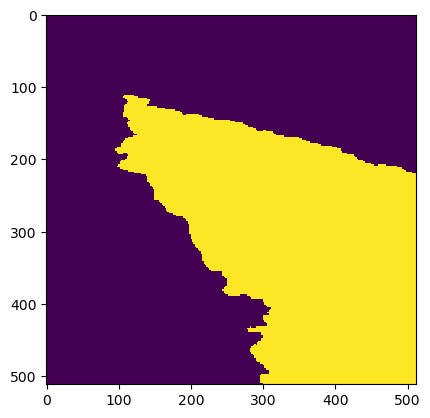

Wrote output/patches/mask/CV_S1_2-491420-8000-6257531-2000.tiff (512 x 512 pixels)


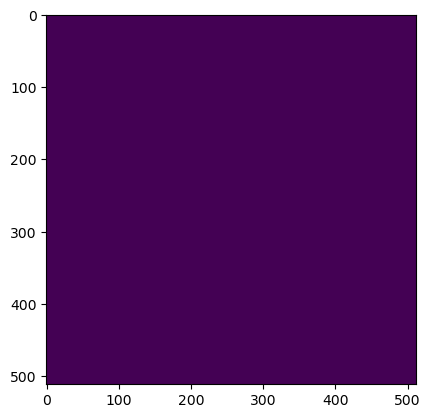

Wrote output/patches/mask/CV_S1_2-491420-8000-6257633-6000.tiff (512 x 512 pixels)


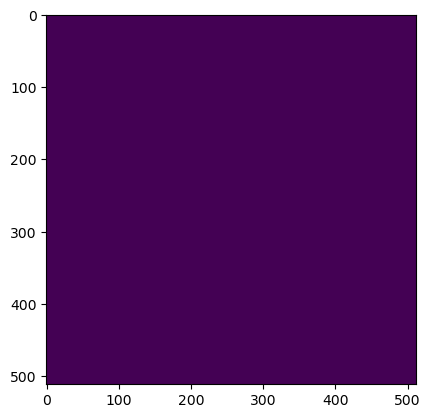

Wrote output/patches/mask/CV_S1_2-491523-2000-6257326-4000.tiff (512 x 512 pixels)


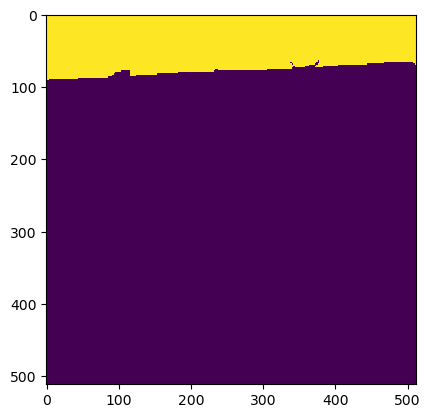

Wrote output/patches/mask/CV_S1_2-491523-2000-6257428-8000.tiff (512 x 512 pixels)


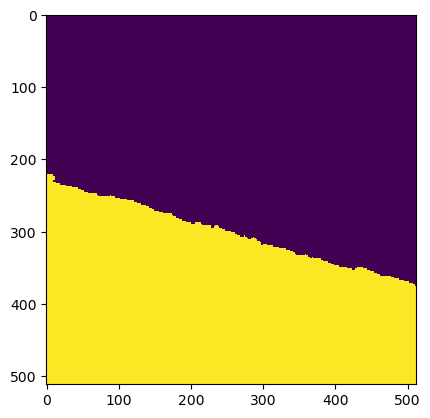

Wrote output/patches/mask/CV_S1_2-491523-2000-6257531-2000.tiff (512 x 512 pixels)


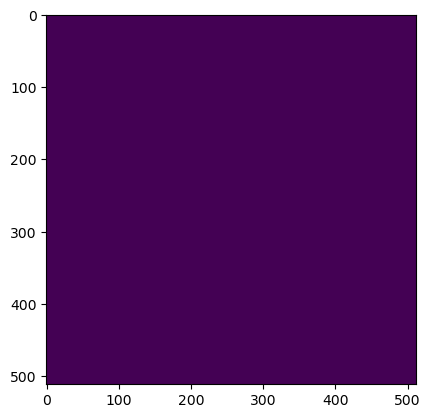

Wrote output/patches/mask/CV_S1_2-491523-2000-6257633-6000.tiff (512 x 512 pixels)
Zone CU_S1_3 Building Mask...


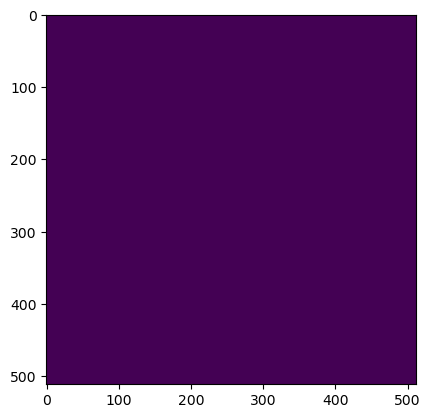

Wrote output/patches/mask/CU_S1_3-499664-0000-6258862-4000.tiff (512 x 512 pixels)


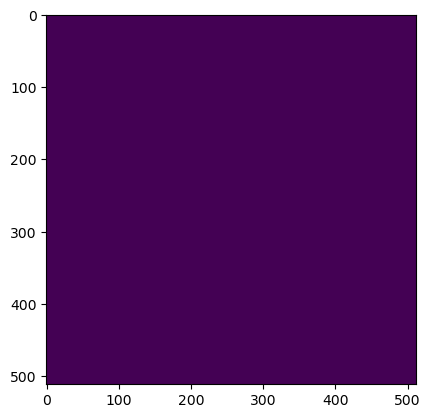

Wrote output/patches/mask/CU_S1_3-499664-0000-6258964-8000.tiff (512 x 512 pixels)


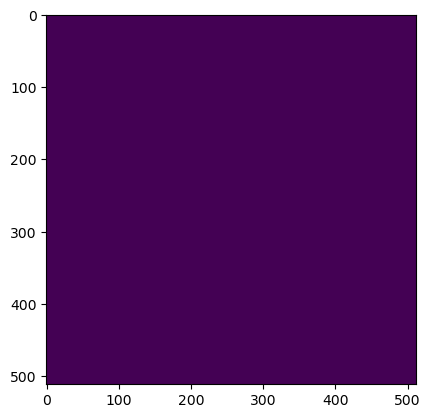

Wrote output/patches/mask/CU_S1_3-499766-4000-6258862-4000.tiff (512 x 512 pixels)


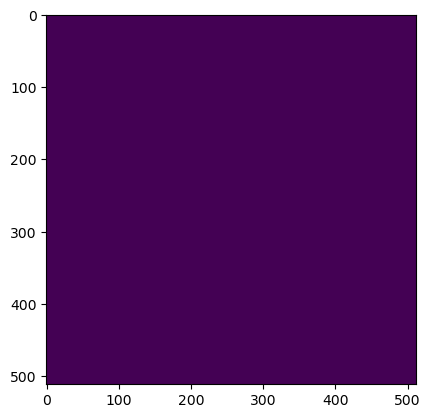

Wrote output/patches/mask/CU_S1_3-499766-4000-6258964-8000.tiff (512 x 512 pixels)
Zone VV_S1_4 Building Mask...


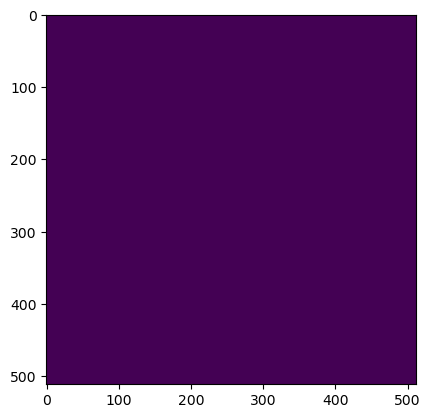

Wrote output/patches/mask/VV_S1_4-474832-0000-6259118-4000.tiff (512 x 512 pixels)


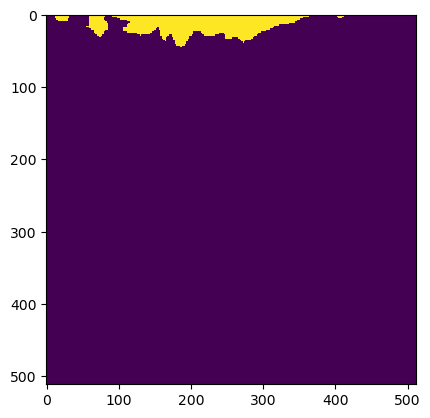

Wrote output/patches/mask/VV_S1_4-474832-0000-6259220-8000.tiff (512 x 512 pixels)


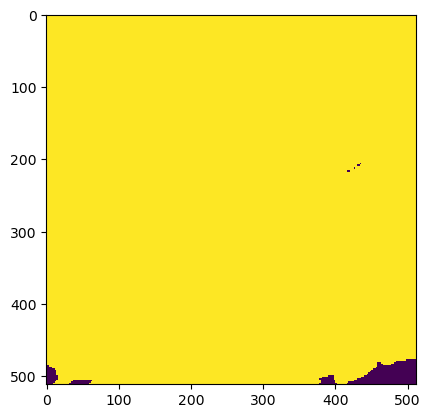

Wrote output/patches/mask/VV_S1_4-474832-0000-6259323-2000.tiff (512 x 512 pixels)


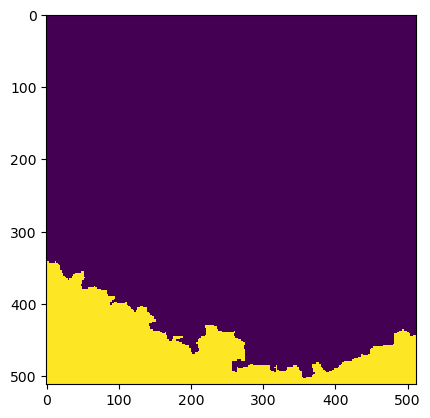

Wrote output/patches/mask/VV_S1_4-474832-0000-6259425-6000.tiff (512 x 512 pixels)


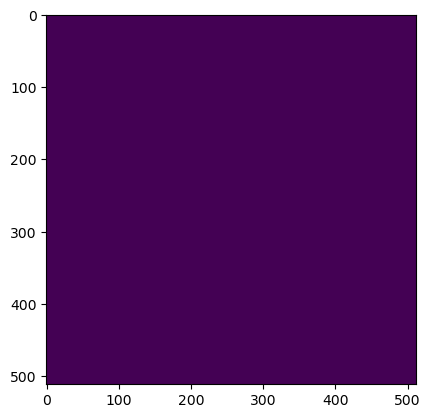

Wrote output/patches/mask/VV_S1_4-474934-4000-6259118-4000.tiff (512 x 512 pixels)


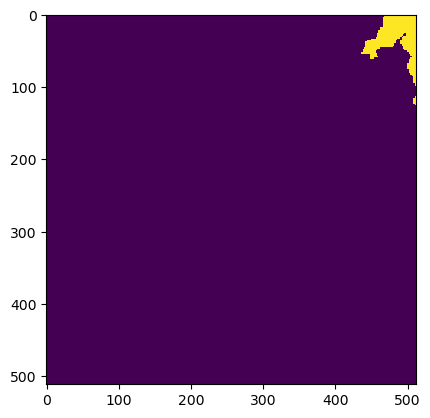

Wrote output/patches/mask/VV_S1_4-474934-4000-6259220-8000.tiff (512 x 512 pixels)


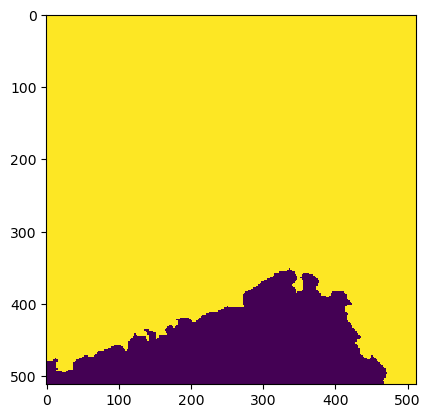

Wrote output/patches/mask/VV_S1_4-474934-4000-6259323-2000.tiff (512 x 512 pixels)


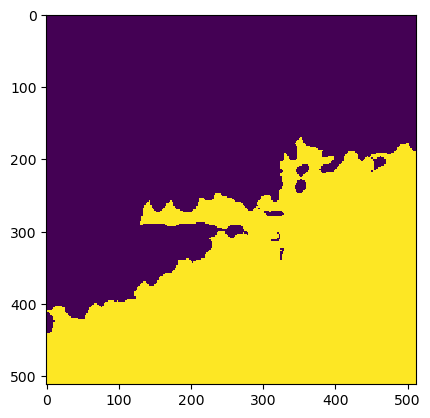

Wrote output/patches/mask/VV_S1_4-474934-4000-6259425-6000.tiff (512 x 512 pixels)


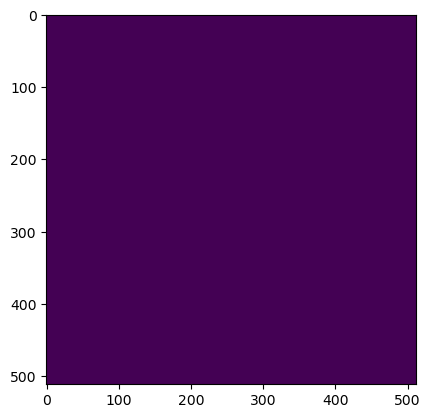

Wrote output/patches/mask/VV_S1_4-475036-8000-6259118-4000.tiff (512 x 512 pixels)


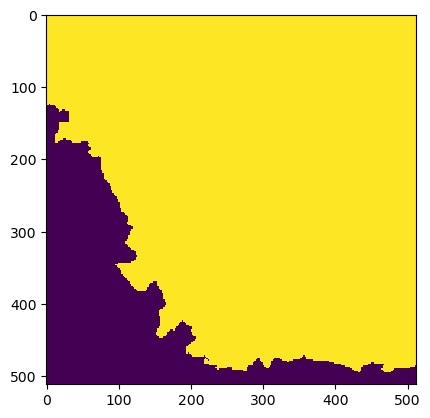

Wrote output/patches/mask/VV_S1_4-475036-8000-6259220-8000.tiff (512 x 512 pixels)


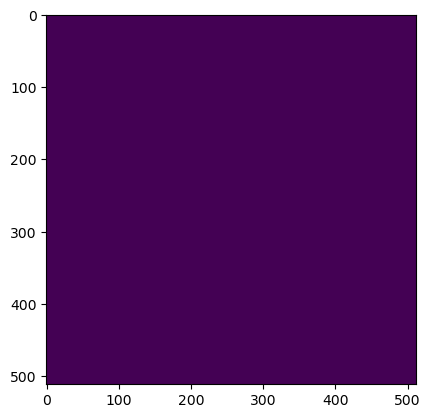

Wrote output/patches/mask/VV_S1_4-475036-8000-6259323-2000.tiff (512 x 512 pixels)


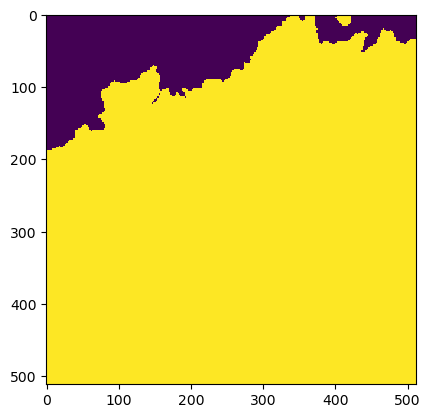

Wrote output/patches/mask/VV_S1_4-475036-8000-6259425-6000.tiff (512 x 512 pixels)


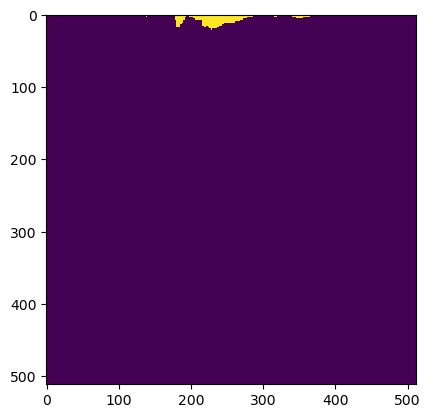

Wrote output/patches/mask/VV_S1_4-475139-2000-6259118-4000.tiff (512 x 512 pixels)


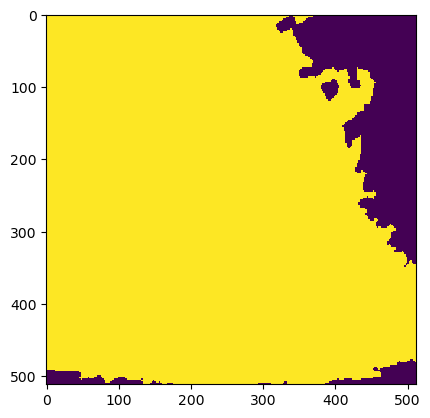

Wrote output/patches/mask/VV_S1_4-475139-2000-6259220-8000.tiff (512 x 512 pixels)


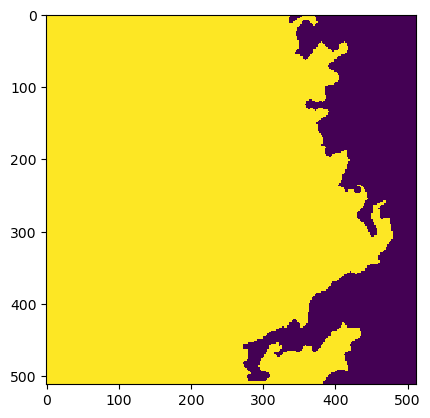

Wrote output/patches/mask/VV_S1_4-475139-2000-6259323-2000.tiff (512 x 512 pixels)


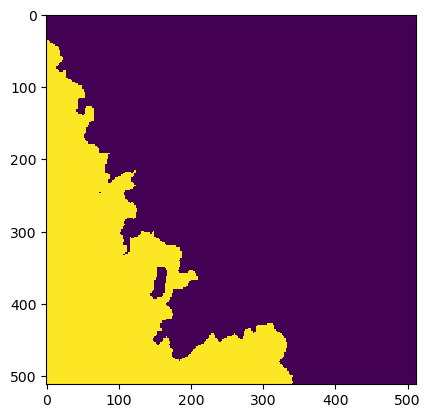

Wrote output/patches/mask/VV_S1_4-475139-2000-6259425-6000.tiff (512 x 512 pixels)
Zone CU_S1_5 Building Mask...


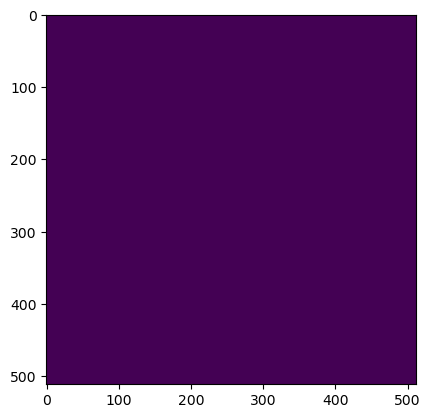

Wrote output/patches/mask/CU_S1_5-489680-0000-6259374-4000.tiff (512 x 512 pixels)


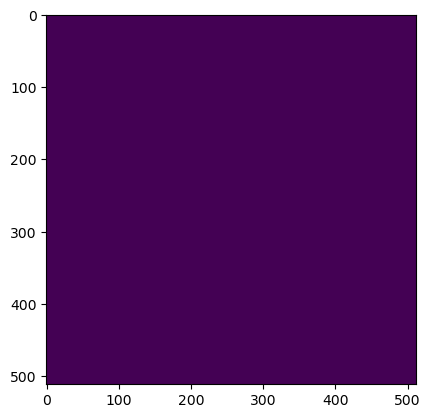

Wrote output/patches/mask/CU_S1_5-489680-0000-6259476-8000.tiff (512 x 512 pixels)


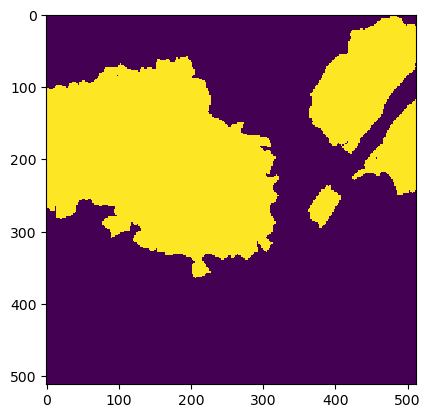

Wrote output/patches/mask/CU_S1_5-489680-0000-6259579-2000.tiff (512 x 512 pixels)


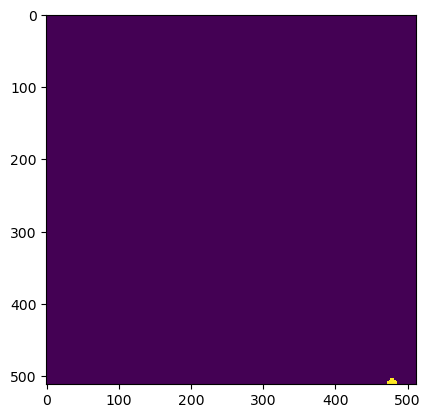

Wrote output/patches/mask/CU_S1_5-489680-0000-6259681-6000.tiff (512 x 512 pixels)


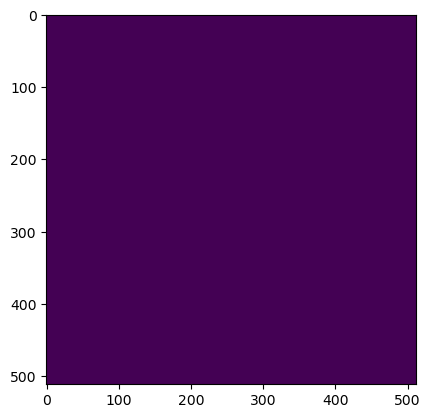

Wrote output/patches/mask/CU_S1_5-489782-4000-6259374-4000.tiff (512 x 512 pixels)


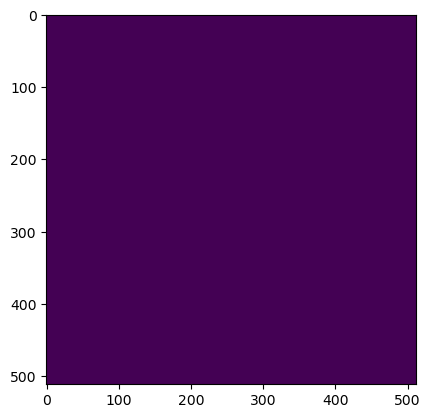

Wrote output/patches/mask/CU_S1_5-489782-4000-6259476-8000.tiff (512 x 512 pixels)


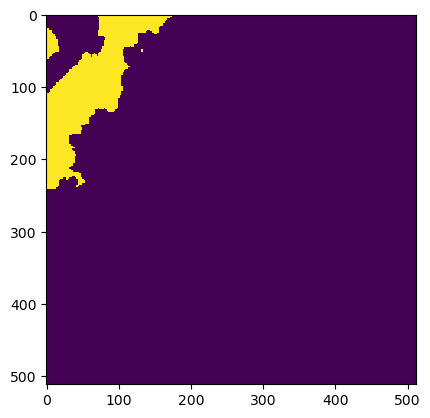

Wrote output/patches/mask/CU_S1_5-489782-4000-6259579-2000.tiff (512 x 512 pixels)


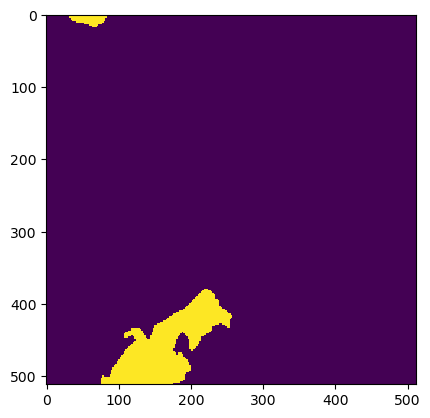

Wrote output/patches/mask/CU_S1_5-489782-4000-6259681-6000.tiff (512 x 512 pixels)
Zone VV_S1_6 Building Mask...


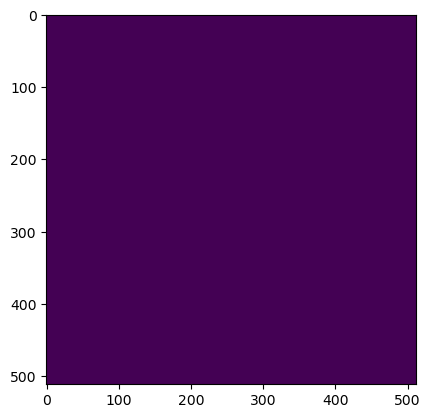

Wrote output/patches/mask/VV_S1_6-526288-0000-6259886-4000.tiff (512 x 512 pixels)


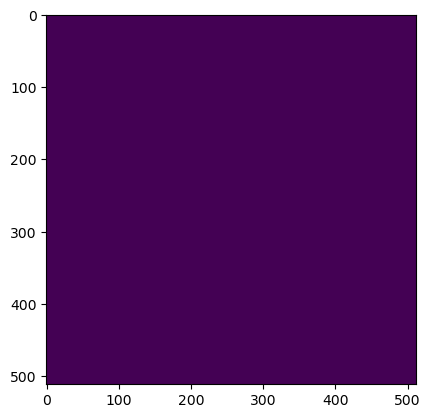

Wrote output/patches/mask/VV_S1_6-526288-0000-6259988-8000.tiff (512 x 512 pixels)


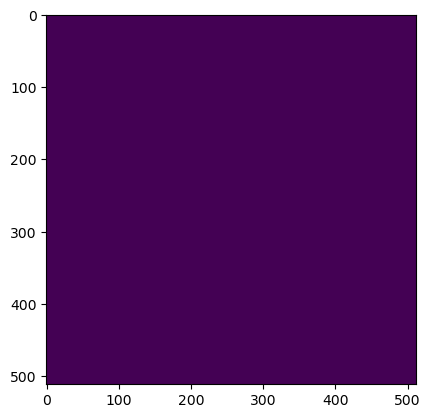

Wrote output/patches/mask/VV_S1_6-526288-0000-6260091-2000.tiff (512 x 512 pixels)


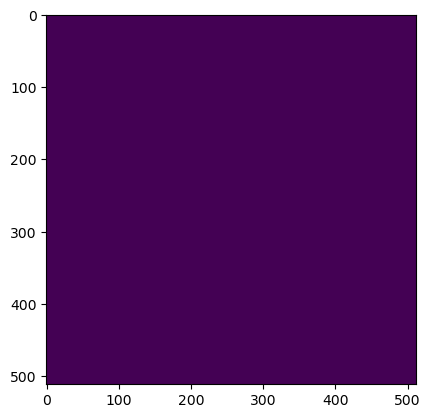

Wrote output/patches/mask/VV_S1_6-526288-0000-6260193-6000.tiff (512 x 512 pixels)


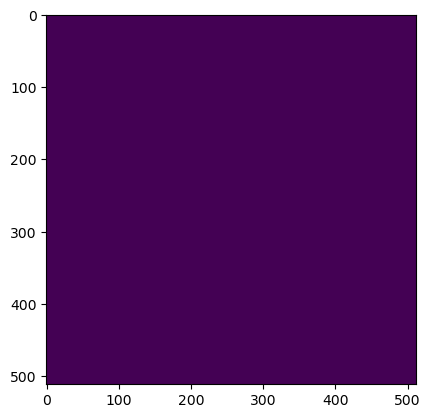

Wrote output/patches/mask/VV_S1_6-526390-4000-6259886-4000.tiff (512 x 512 pixels)


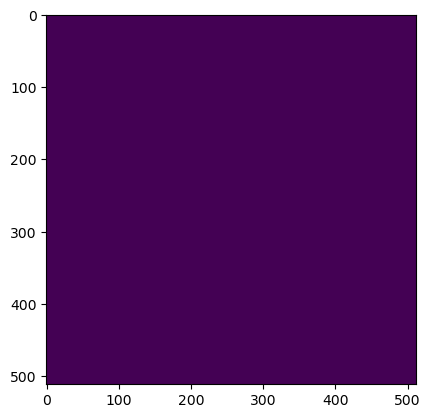

Wrote output/patches/mask/VV_S1_6-526390-4000-6259988-8000.tiff (512 x 512 pixels)


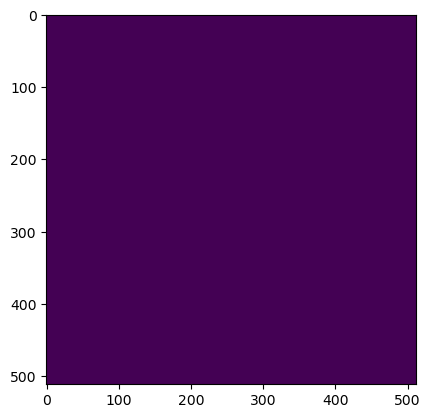

Wrote output/patches/mask/VV_S1_6-526390-4000-6260091-2000.tiff (512 x 512 pixels)


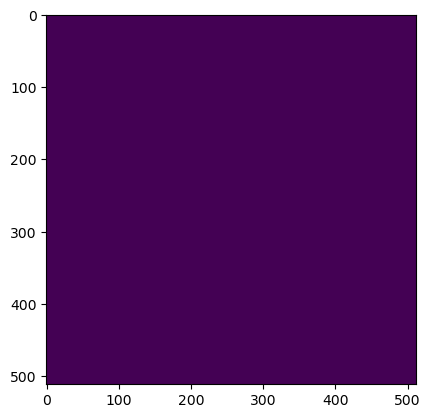

Wrote output/patches/mask/VV_S1_6-526390-4000-6260193-6000.tiff (512 x 512 pixels)
Zone CC_S1_7 Building Mask...


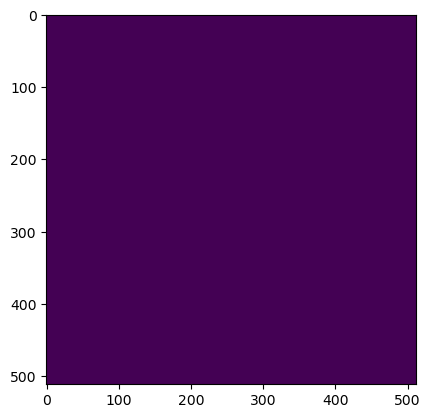

Wrote output/patches/mask/CC_S1_7-498640-0000-6260398-4000.tiff (512 x 512 pixels)


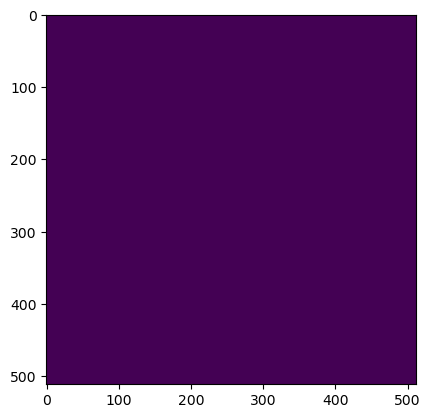

Wrote output/patches/mask/CC_S1_7-498640-0000-6260500-8000.tiff (512 x 512 pixels)


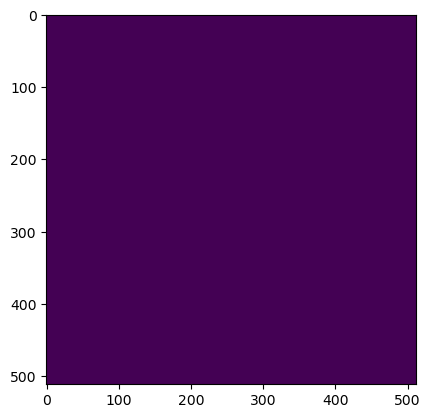

Wrote output/patches/mask/CC_S1_7-498640-0000-6260603-2000.tiff (512 x 512 pixels)


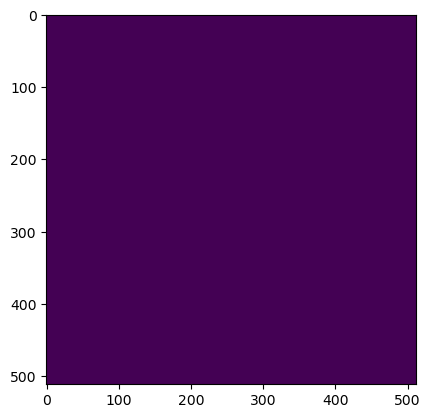

Wrote output/patches/mask/CC_S1_7-498640-0000-6260705-6000.tiff (512 x 512 pixels)


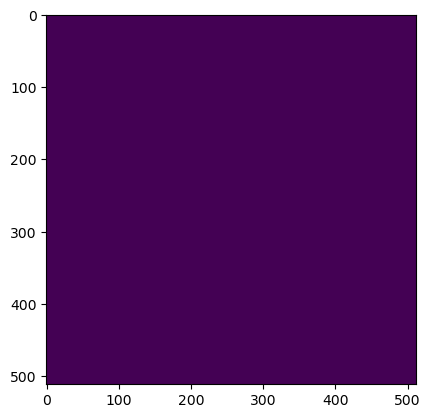

Wrote output/patches/mask/CC_S1_7-498742-4000-6260398-4000.tiff (512 x 512 pixels)


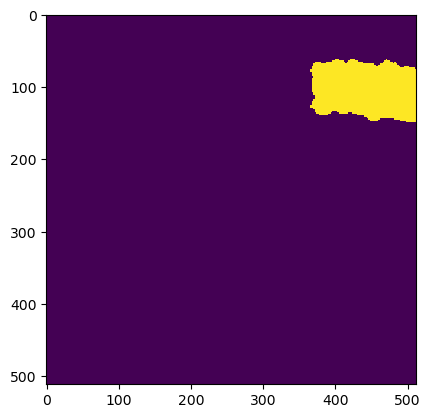

Wrote output/patches/mask/CC_S1_7-498742-4000-6260500-8000.tiff (512 x 512 pixels)


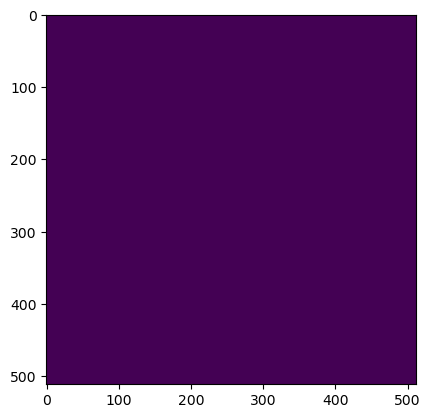

Wrote output/patches/mask/CC_S1_7-498742-4000-6260603-2000.tiff (512 x 512 pixels)


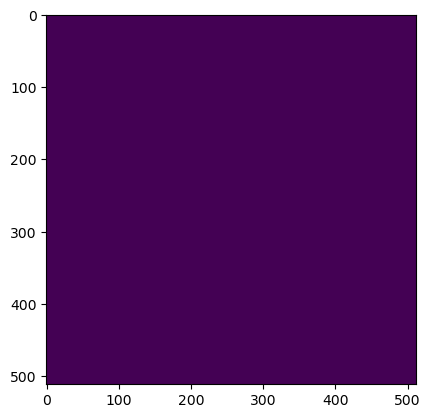

Wrote output/patches/mask/CC_S1_7-498742-4000-6260705-6000.tiff (512 x 512 pixels)


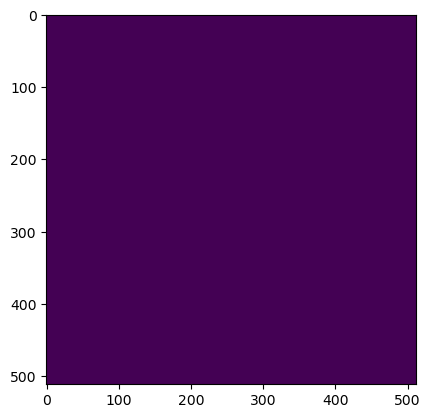

Wrote output/patches/mask/CC_S1_7-498844-8000-6260398-4000.tiff (512 x 512 pixels)


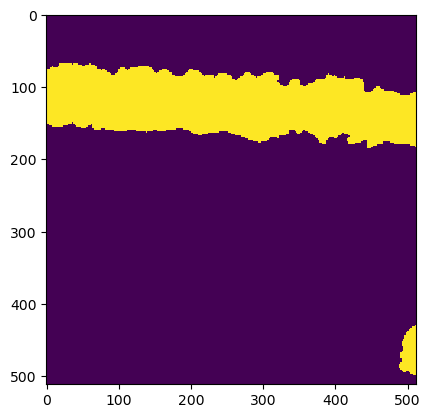

Wrote output/patches/mask/CC_S1_7-498844-8000-6260500-8000.tiff (512 x 512 pixels)


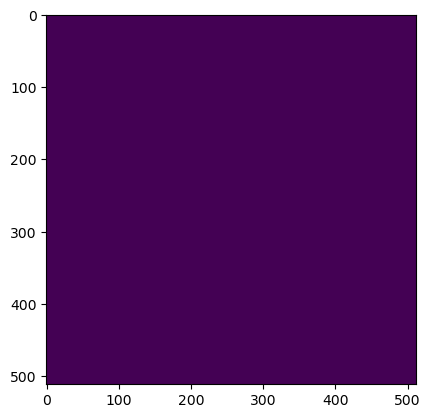

Wrote output/patches/mask/CC_S1_7-498844-8000-6260603-2000.tiff (512 x 512 pixels)


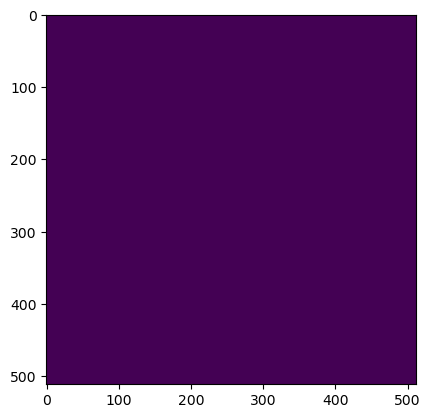

Wrote output/patches/mask/CC_S1_7-498844-8000-6260705-6000.tiff (512 x 512 pixels)


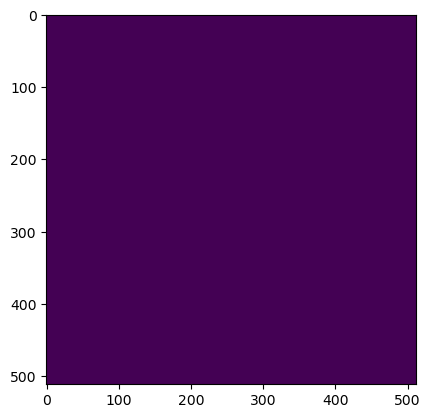

Wrote output/patches/mask/CC_S1_7-498947-2000-6260398-4000.tiff (512 x 512 pixels)


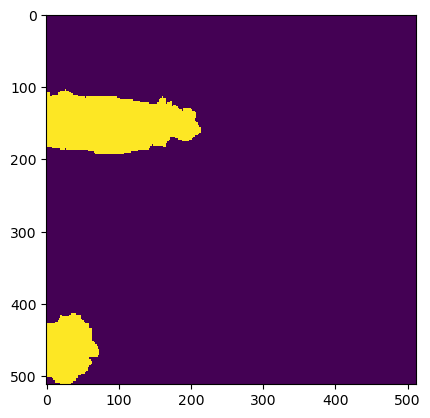

Wrote output/patches/mask/CC_S1_7-498947-2000-6260500-8000.tiff (512 x 512 pixels)


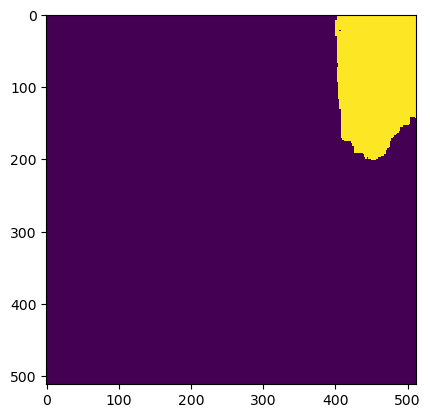

Wrote output/patches/mask/CC_S1_7-498947-2000-6260603-2000.tiff (512 x 512 pixels)


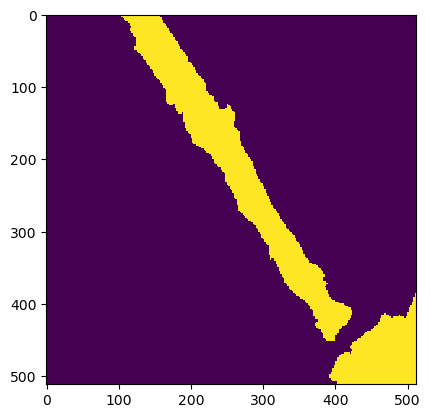

Wrote output/patches/mask/CC_S1_7-498947-2000-6260705-6000.tiff (512 x 512 pixels)
Zone CV_S1_8 Building Mask...


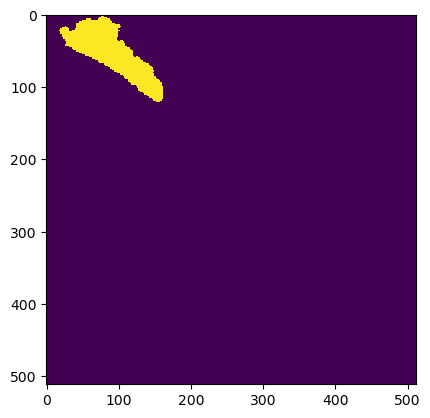

Wrote output/patches/mask/CV_S1_8-499920-0000-6260910-4000.tiff (512 x 512 pixels)


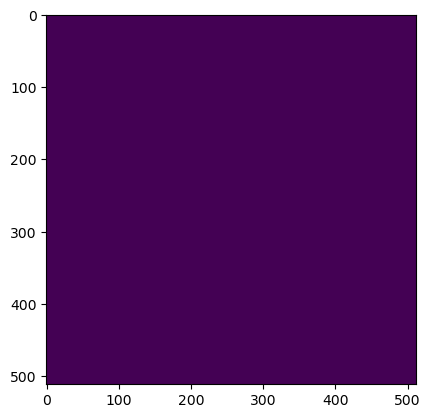

Wrote output/patches/mask/CV_S1_8-499920-0000-6261012-8000.tiff (512 x 512 pixels)


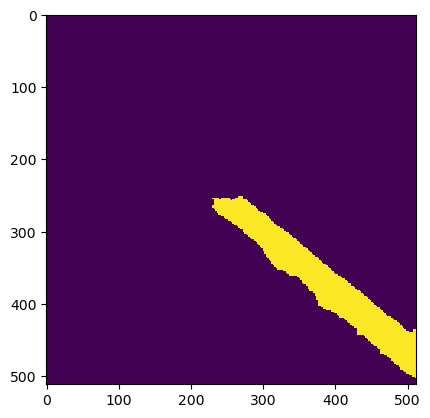

Wrote output/patches/mask/CV_S1_8-499920-0000-6261115-2000.tiff (512 x 512 pixels)


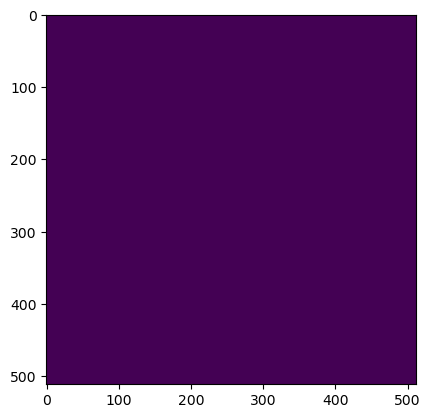

Wrote output/patches/mask/CV_S1_8-499920-0000-6261217-6000.tiff (512 x 512 pixels)


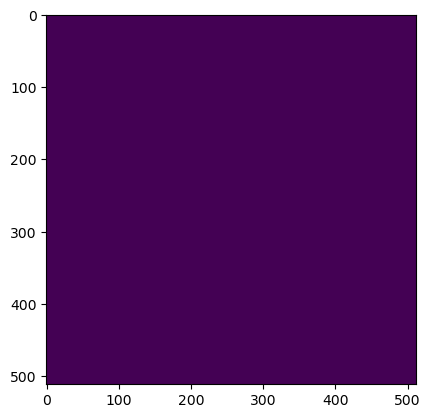

Wrote output/patches/mask/CV_S1_8-499920-0000-6261320-0000.tiff (512 x 512 pixels)


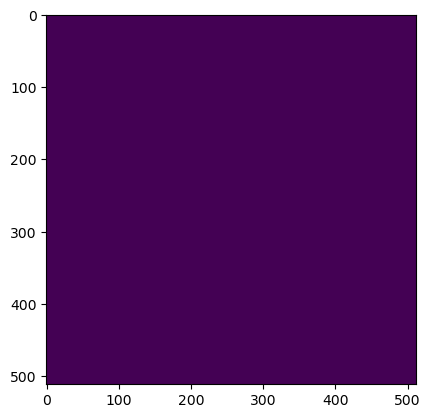

Wrote output/patches/mask/CV_S1_8-499920-0000-6261422-4000.tiff (512 x 512 pixels)


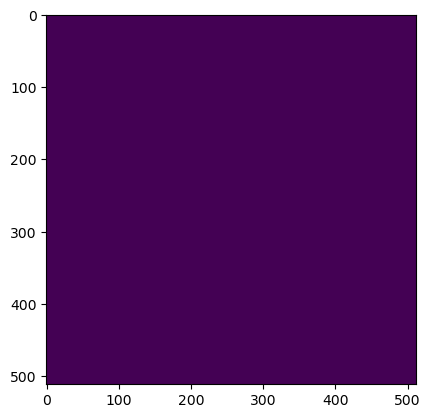

Wrote output/patches/mask/CV_S1_8-499920-0000-6261524-8000.tiff (512 x 512 pixels)


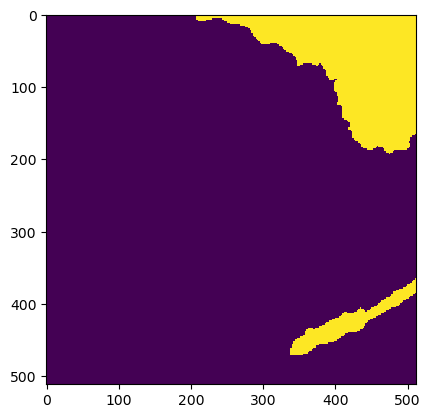

Wrote output/patches/mask/CV_S1_8-500022-4000-6260910-4000.tiff (512 x 512 pixels)


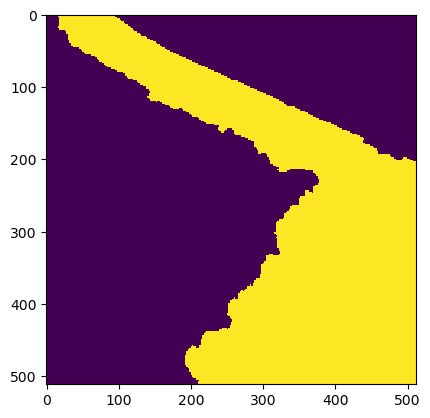

Wrote output/patches/mask/CV_S1_8-500022-4000-6261012-8000.tiff (512 x 512 pixels)


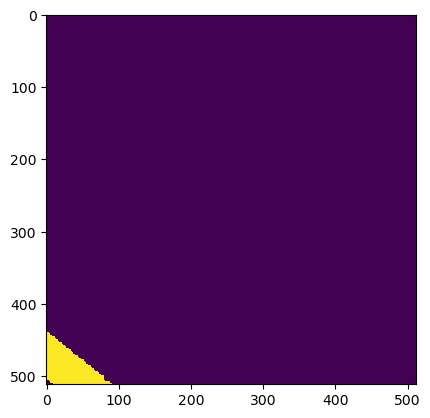

Wrote output/patches/mask/CV_S1_8-500022-4000-6261115-2000.tiff (512 x 512 pixels)


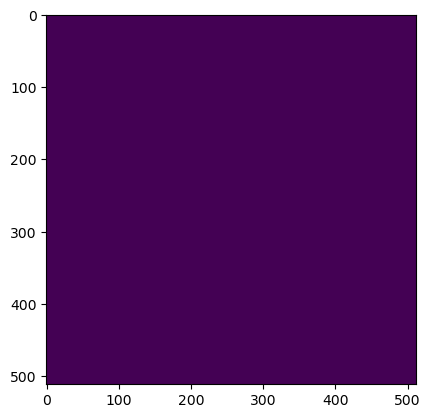

Wrote output/patches/mask/CV_S1_8-500022-4000-6261217-6000.tiff (512 x 512 pixels)


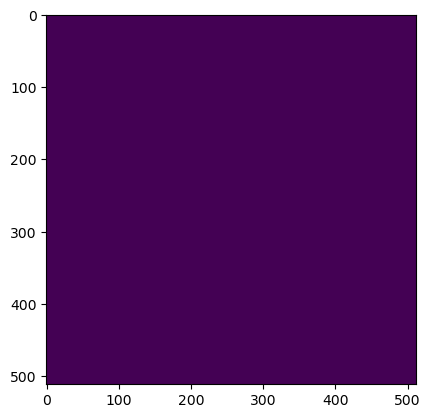

Wrote output/patches/mask/CV_S1_8-500022-4000-6261320-0000.tiff (512 x 512 pixels)


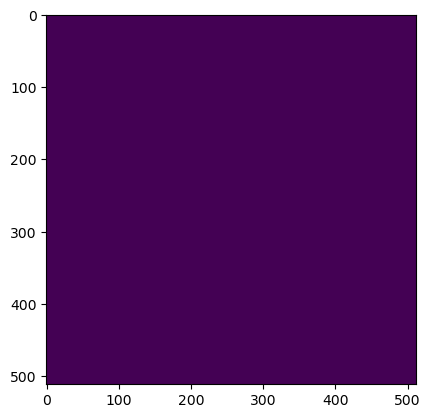

Wrote output/patches/mask/CV_S1_8-500022-4000-6261422-4000.tiff (512 x 512 pixels)


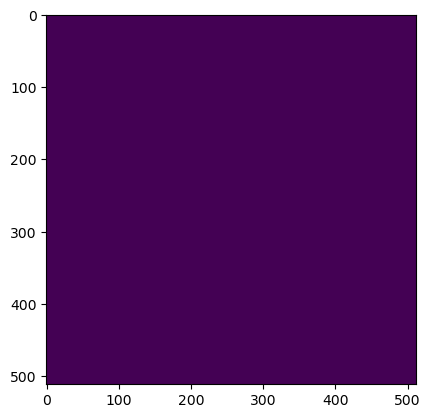

Wrote output/patches/mask/CV_S1_8-500022-4000-6261524-8000.tiff (512 x 512 pixels)


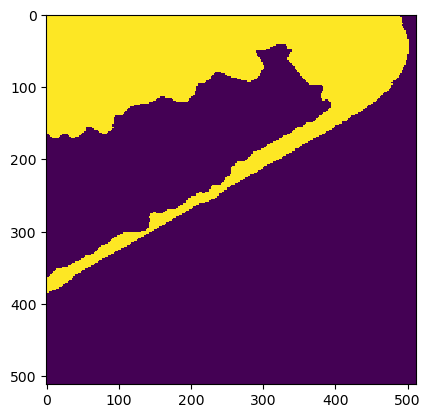

Wrote output/patches/mask/CV_S1_8-500124-8000-6260910-4000.tiff (512 x 512 pixels)


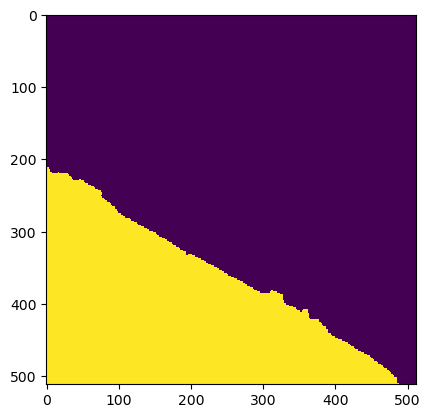

Wrote output/patches/mask/CV_S1_8-500124-8000-6261012-8000.tiff (512 x 512 pixels)


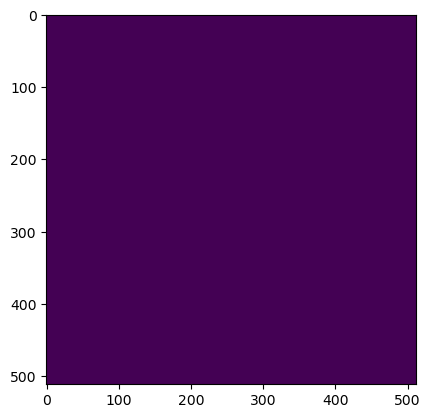

Wrote output/patches/mask/CV_S1_8-500124-8000-6261115-2000.tiff (512 x 512 pixels)


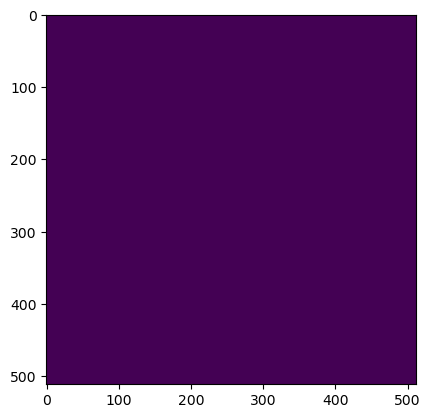

Wrote output/patches/mask/CV_S1_8-500124-8000-6261217-6000.tiff (512 x 512 pixels)


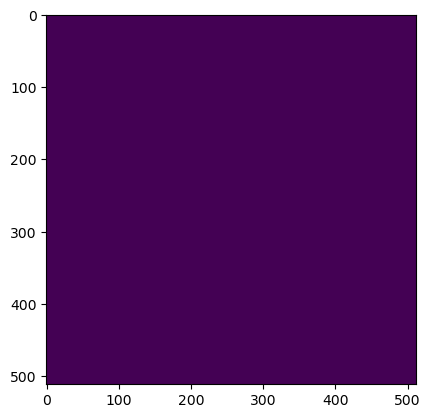

Wrote output/patches/mask/CV_S1_8-500124-8000-6261320-0000.tiff (512 x 512 pixels)


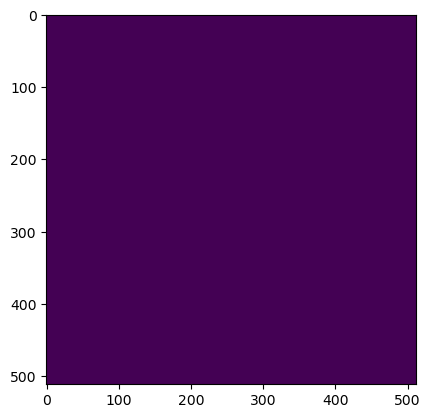

Wrote output/patches/mask/CV_S1_8-500124-8000-6261422-4000.tiff (512 x 512 pixels)


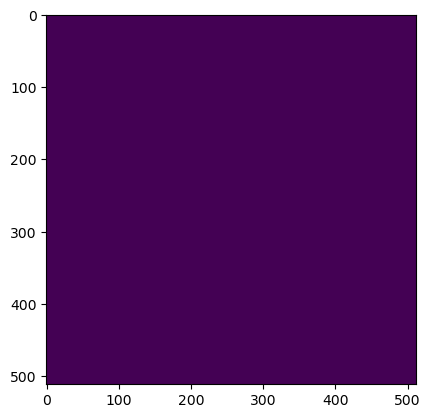

Wrote output/patches/mask/CV_S1_8-500124-8000-6261524-8000.tiff (512 x 512 pixels)


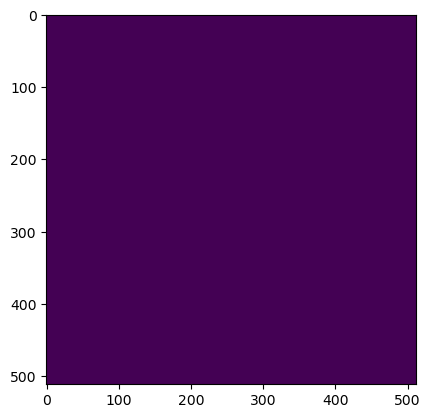

Wrote output/patches/mask/CV_S1_8-500227-2000-6260910-4000.tiff (512 x 512 pixels)


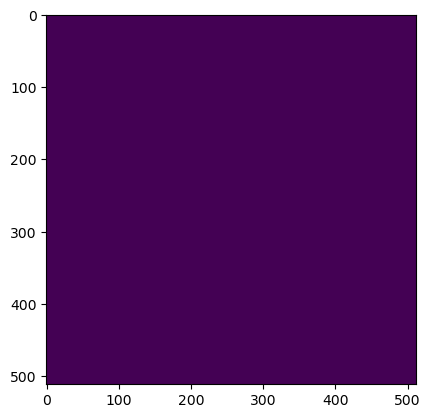

Wrote output/patches/mask/CV_S1_8-500227-2000-6261012-8000.tiff (512 x 512 pixels)


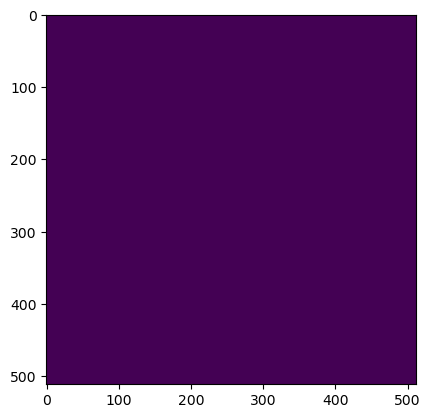

Wrote output/patches/mask/CV_S1_8-500227-2000-6261115-2000.tiff (512 x 512 pixels)


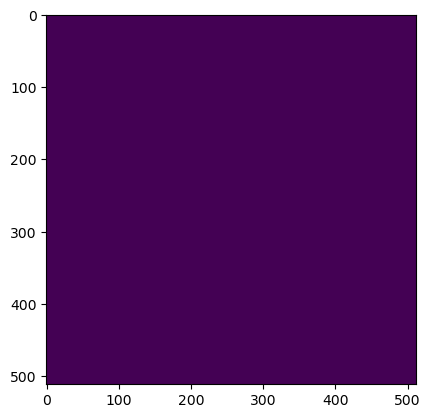

Wrote output/patches/mask/CV_S1_8-500227-2000-6261217-6000.tiff (512 x 512 pixels)


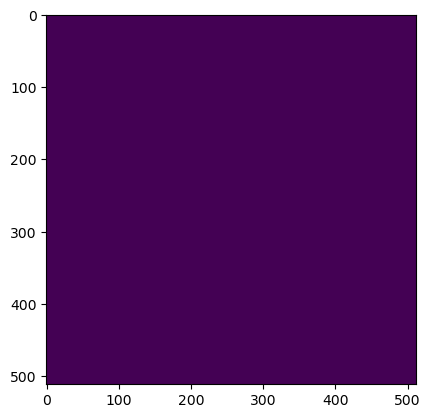

Wrote output/patches/mask/CV_S1_8-500227-2000-6261320-0000.tiff (512 x 512 pixels)


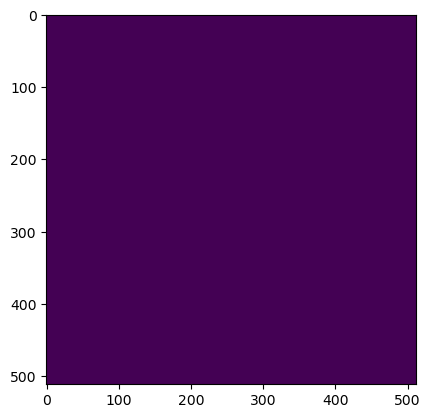

Wrote output/patches/mask/CV_S1_8-500227-2000-6261422-4000.tiff (512 x 512 pixels)


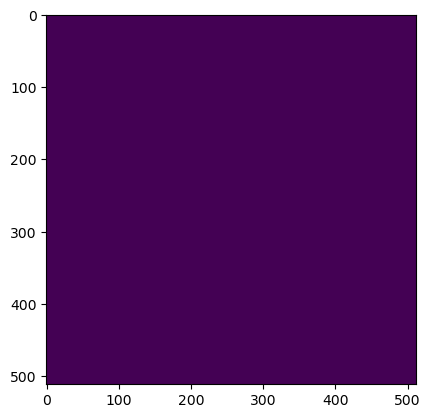

Wrote output/patches/mask/CV_S1_8-500227-2000-6261524-8000.tiff (512 x 512 pixels)


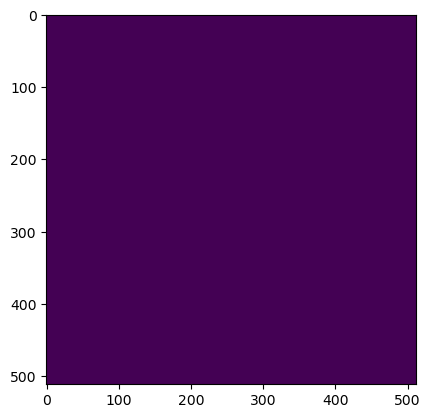

Wrote output/patches/mask/CV_S1_8-500329-6000-6260910-4000.tiff (512 x 512 pixels)


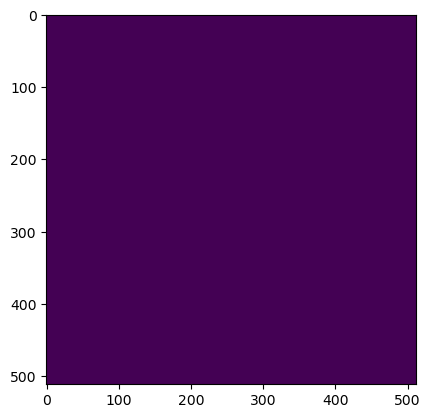

Wrote output/patches/mask/CV_S1_8-500329-6000-6261012-8000.tiff (512 x 512 pixels)


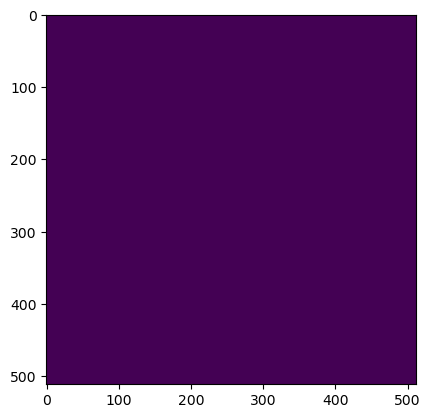

Wrote output/patches/mask/CV_S1_8-500329-6000-6261115-2000.tiff (512 x 512 pixels)


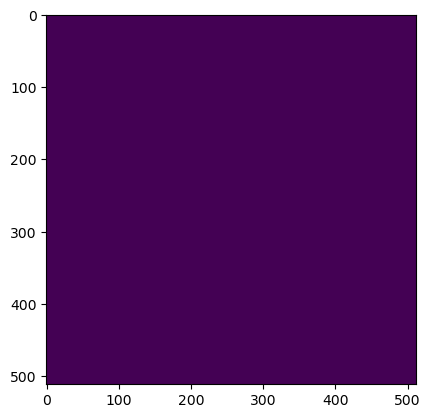

Wrote output/patches/mask/CV_S1_8-500329-6000-6261217-6000.tiff (512 x 512 pixels)


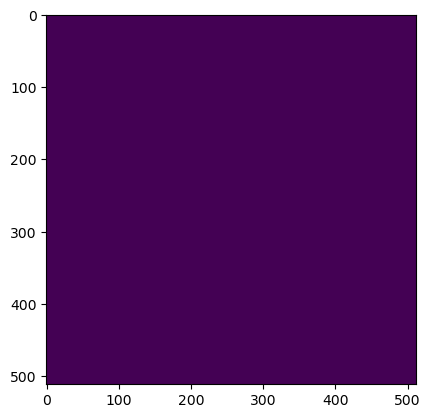

Wrote output/patches/mask/CV_S1_8-500329-6000-6261320-0000.tiff (512 x 512 pixels)


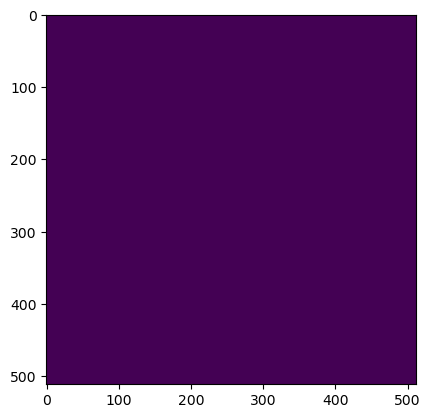

Wrote output/patches/mask/CV_S1_8-500329-6000-6261422-4000.tiff (512 x 512 pixels)


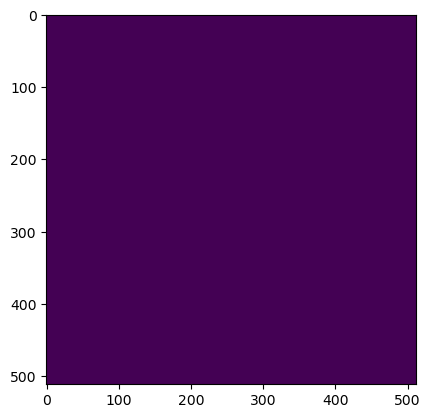

Wrote output/patches/mask/CV_S1_8-500329-6000-6261524-8000.tiff (512 x 512 pixels)


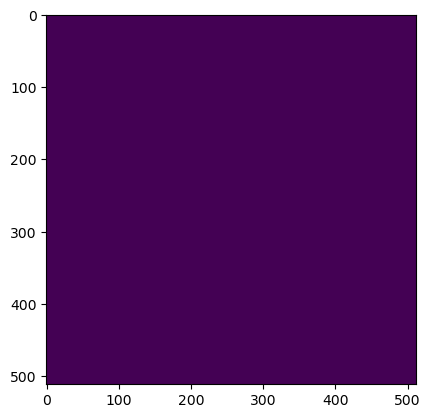

Wrote output/patches/mask/CV_S1_8-500432-0000-6260910-4000.tiff (512 x 512 pixels)


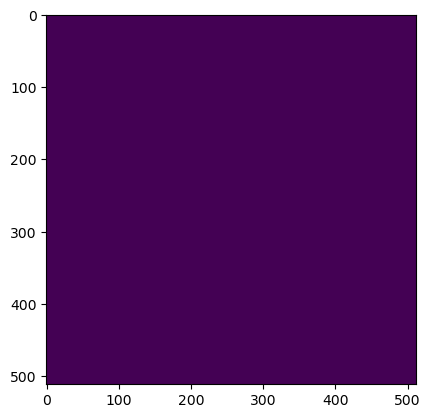

Wrote output/patches/mask/CV_S1_8-500432-0000-6261012-8000.tiff (512 x 512 pixels)


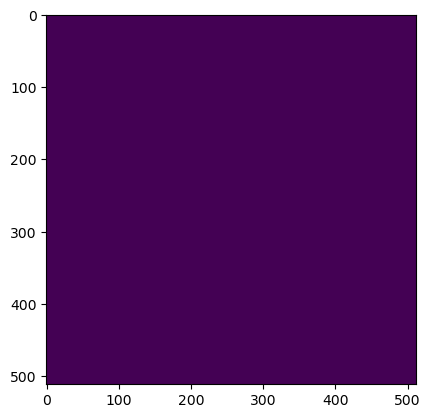

Wrote output/patches/mask/CV_S1_8-500432-0000-6261115-2000.tiff (512 x 512 pixels)


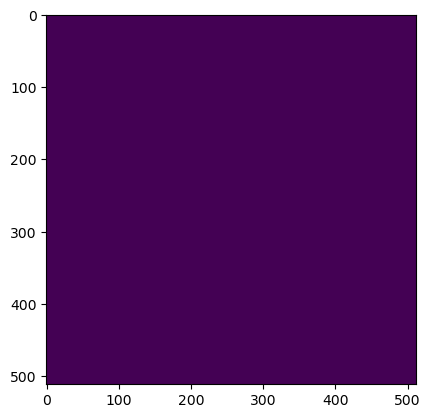

Wrote output/patches/mask/CV_S1_8-500432-0000-6261217-6000.tiff (512 x 512 pixels)


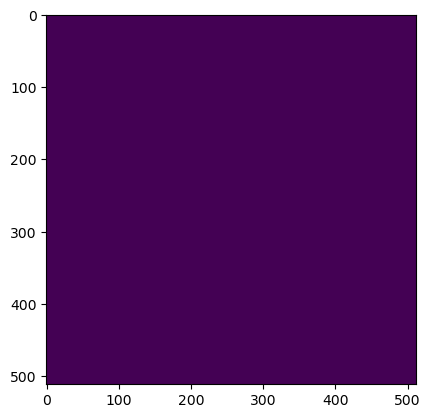

Wrote output/patches/mask/CV_S1_8-500432-0000-6261320-0000.tiff (512 x 512 pixels)


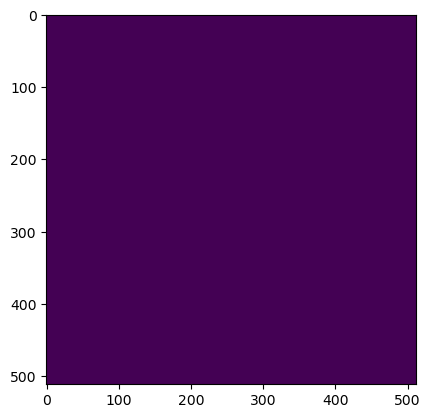

Wrote output/patches/mask/CV_S1_8-500432-0000-6261422-4000.tiff (512 x 512 pixels)


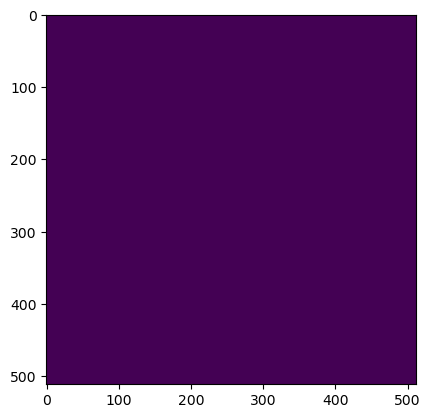

Wrote output/patches/mask/CV_S1_8-500432-0000-6261524-8000.tiff (512 x 512 pixels)


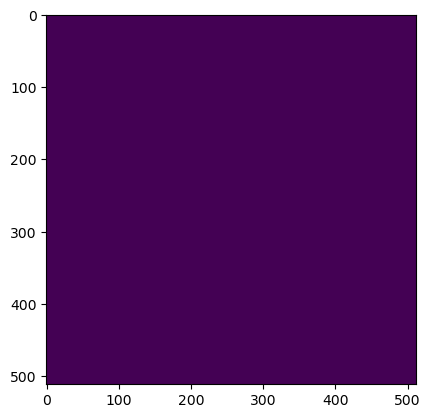

Wrote output/patches/mask/CV_S1_8-500534-4000-6260910-4000.tiff (512 x 512 pixels)


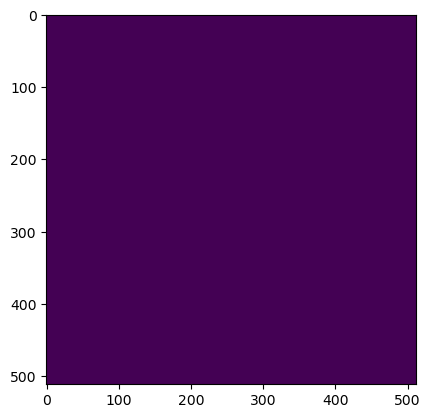

Wrote output/patches/mask/CV_S1_8-500534-4000-6261012-8000.tiff (512 x 512 pixels)


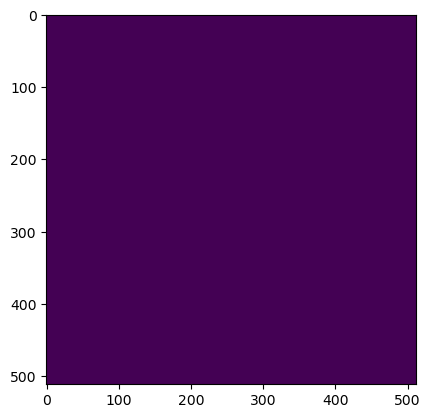

Wrote output/patches/mask/CV_S1_8-500534-4000-6261115-2000.tiff (512 x 512 pixels)


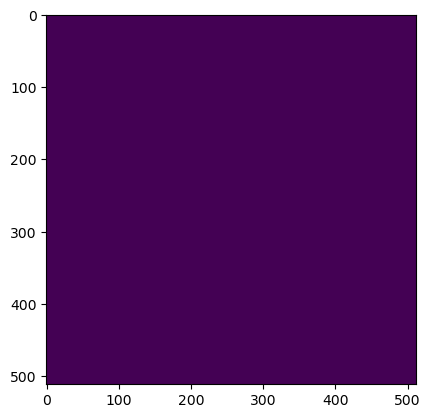

Wrote output/patches/mask/CV_S1_8-500534-4000-6261217-6000.tiff (512 x 512 pixels)


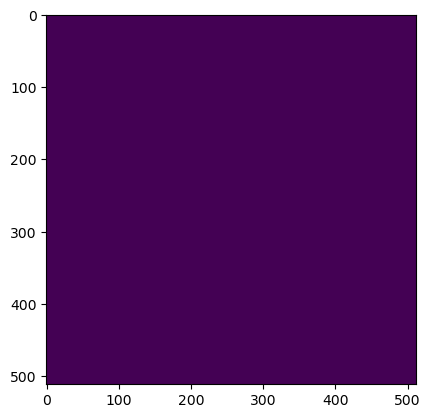

Wrote output/patches/mask/CV_S1_8-500534-4000-6261320-0000.tiff (512 x 512 pixels)


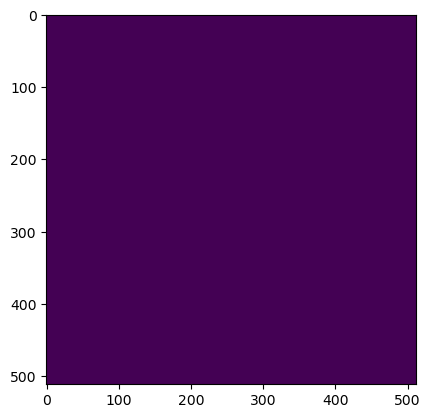

Wrote output/patches/mask/CV_S1_8-500534-4000-6261422-4000.tiff (512 x 512 pixels)


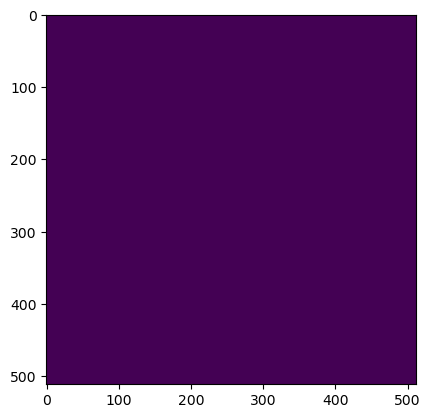

Wrote output/patches/mask/CV_S1_8-500534-4000-6261524-8000.tiff (512 x 512 pixels)
Zone VV_S1_9 Building Mask...


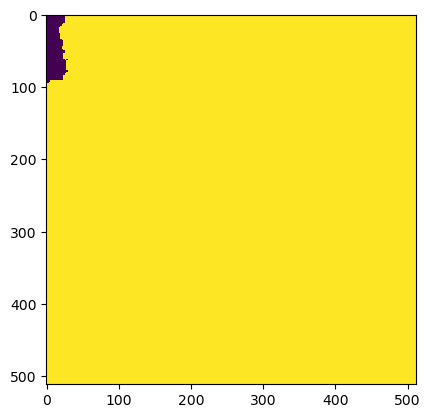

Wrote output/patches/mask/VV_S1_9-474832-0000-6260910-4000.tiff (512 x 512 pixels)


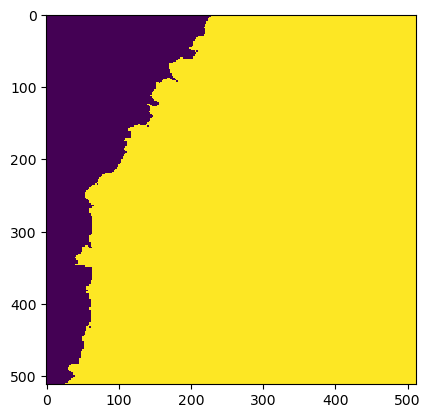

Wrote output/patches/mask/VV_S1_9-474832-0000-6261012-8000.tiff (512 x 512 pixels)


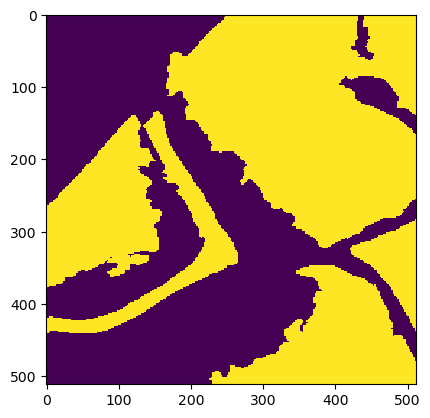

Wrote output/patches/mask/VV_S1_9-474832-0000-6261115-2000.tiff (512 x 512 pixels)


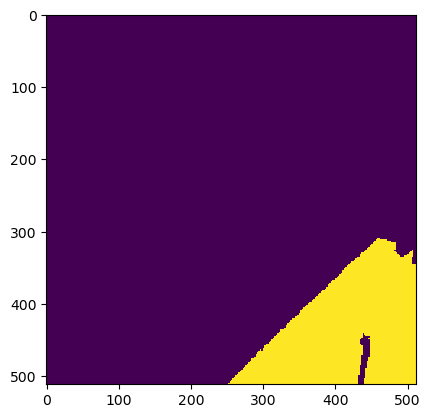

Wrote output/patches/mask/VV_S1_9-474832-0000-6261217-6000.tiff (512 x 512 pixels)


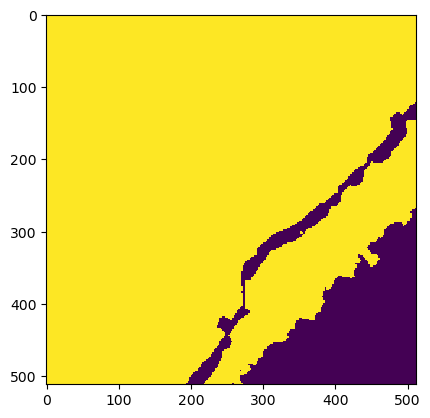

Wrote output/patches/mask/VV_S1_9-474934-4000-6260910-4000.tiff (512 x 512 pixels)


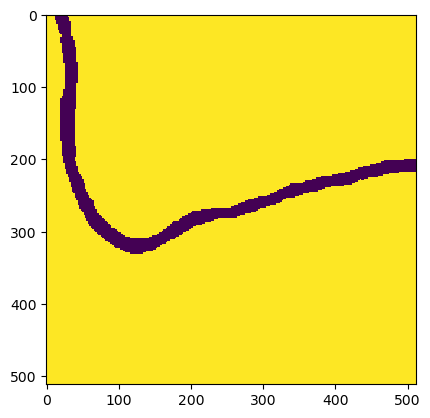

Wrote output/patches/mask/VV_S1_9-474934-4000-6261012-8000.tiff (512 x 512 pixels)


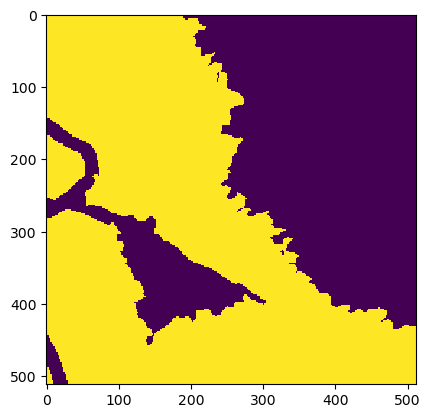

Wrote output/patches/mask/VV_S1_9-474934-4000-6261115-2000.tiff (512 x 512 pixels)


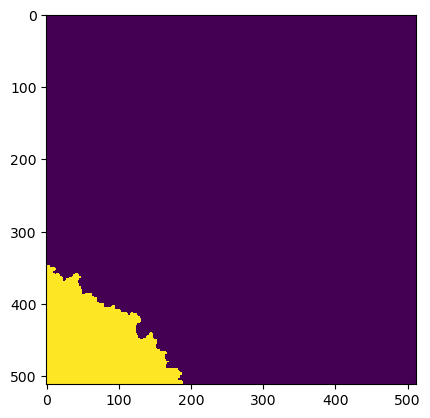

Wrote output/patches/mask/VV_S1_9-474934-4000-6261217-6000.tiff (512 x 512 pixels)


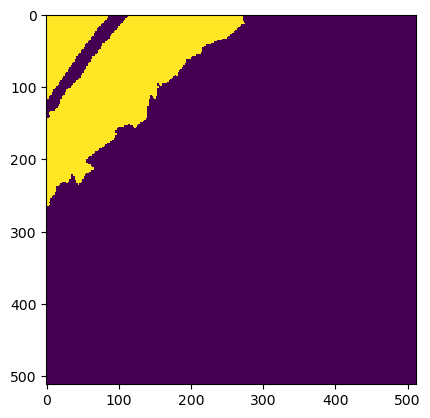

Wrote output/patches/mask/VV_S1_9-475036-8000-6260910-4000.tiff (512 x 512 pixels)


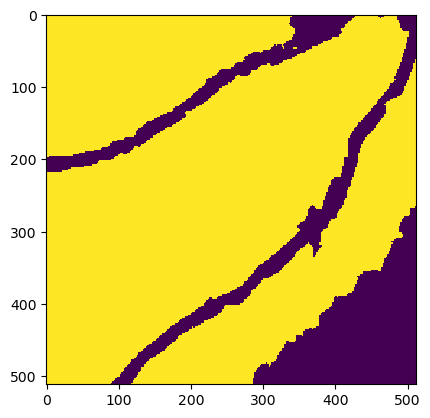

Wrote output/patches/mask/VV_S1_9-475036-8000-6261012-8000.tiff (512 x 512 pixels)


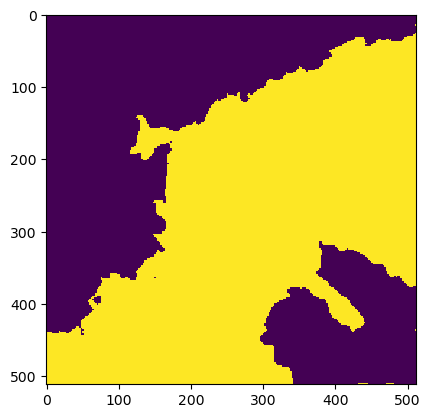

Wrote output/patches/mask/VV_S1_9-475036-8000-6261115-2000.tiff (512 x 512 pixels)


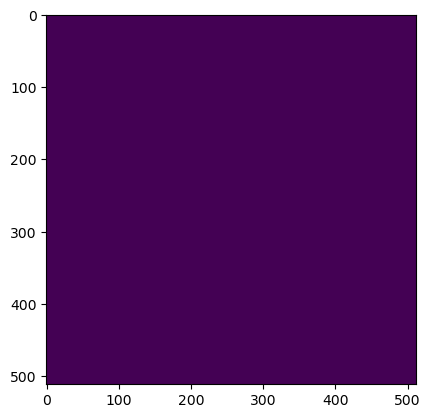

Wrote output/patches/mask/VV_S1_9-475036-8000-6261217-6000.tiff (512 x 512 pixels)


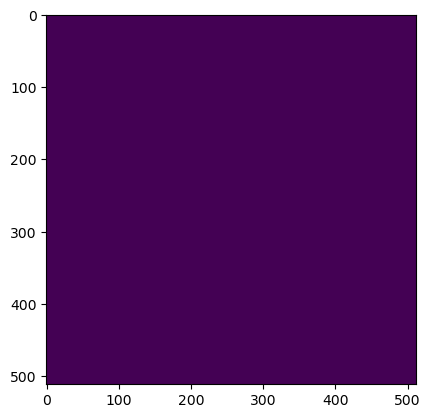

Wrote output/patches/mask/VV_S1_9-475139-2000-6260910-4000.tiff (512 x 512 pixels)


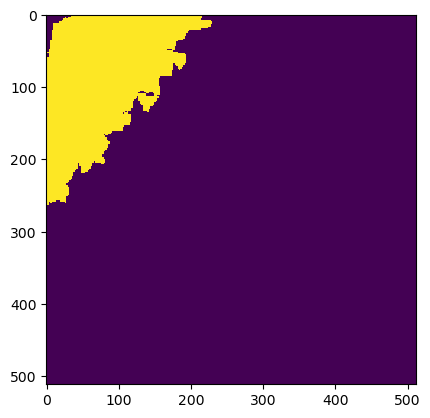

Wrote output/patches/mask/VV_S1_9-475139-2000-6261012-8000.tiff (512 x 512 pixels)


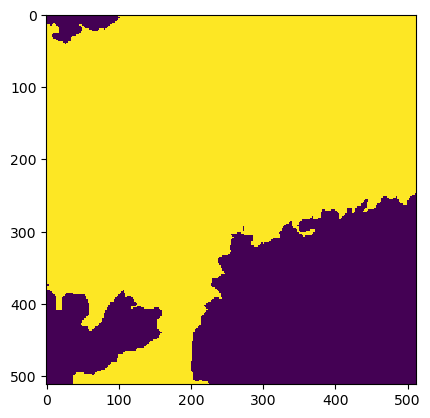

Wrote output/patches/mask/VV_S1_9-475139-2000-6261115-2000.tiff (512 x 512 pixels)


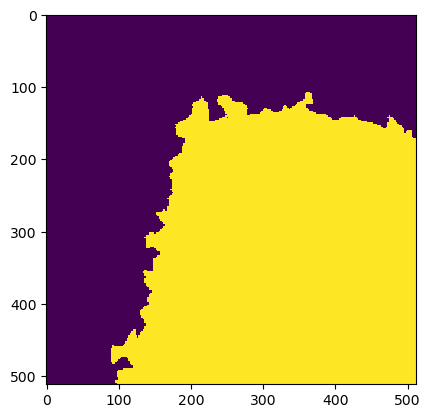

Wrote output/patches/mask/VV_S1_9-475139-2000-6261217-6000.tiff (512 x 512 pixels)
Zone CC_S1_10 Building Mask...


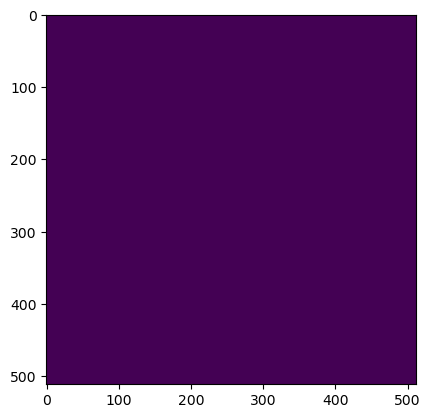

Wrote output/patches/mask/CC_S1_10-500944-0000-6261166-4000.tiff (512 x 512 pixels)


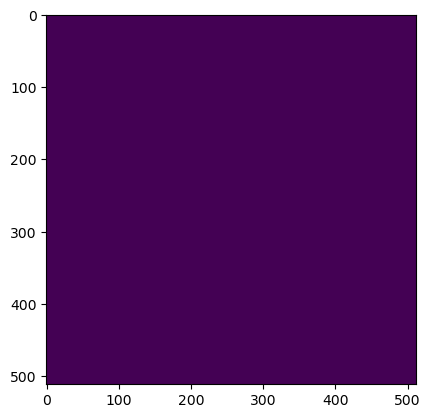

Wrote output/patches/mask/CC_S1_10-500944-0000-6261268-8000.tiff (512 x 512 pixels)


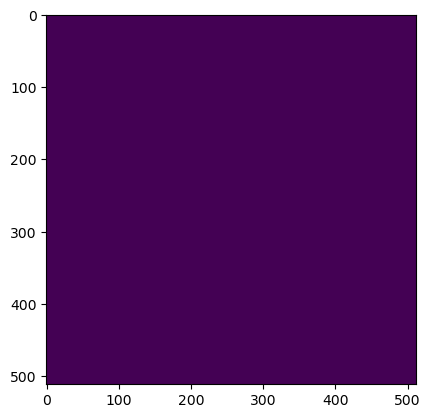

Wrote output/patches/mask/CC_S1_10-500944-0000-6261371-2000.tiff (512 x 512 pixels)


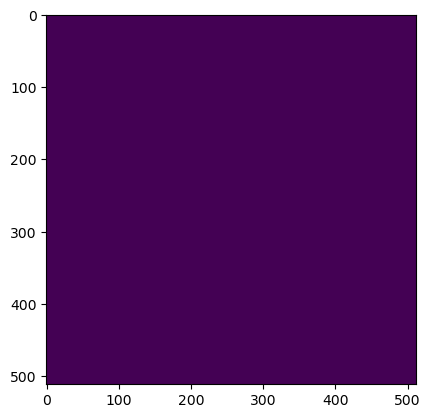

Wrote output/patches/mask/CC_S1_10-500944-0000-6261473-6000.tiff (512 x 512 pixels)


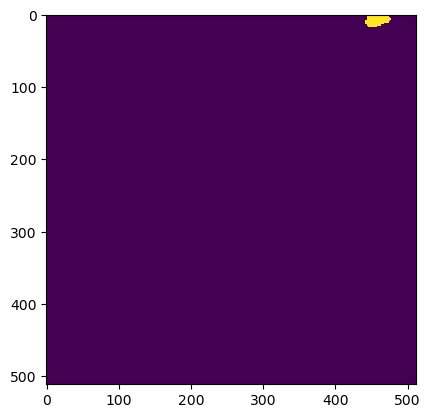

Wrote output/patches/mask/CC_S1_10-501046-4000-6261166-4000.tiff (512 x 512 pixels)


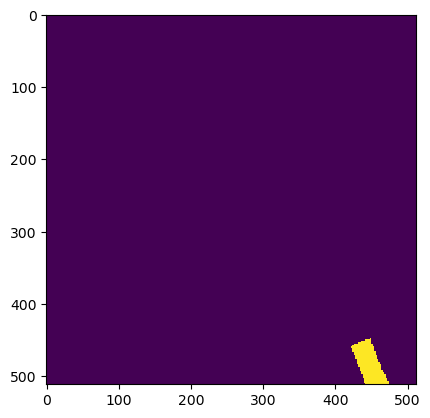

Wrote output/patches/mask/CC_S1_10-501046-4000-6261268-8000.tiff (512 x 512 pixels)


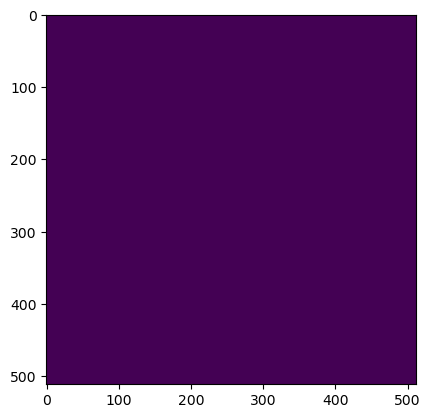

Wrote output/patches/mask/CC_S1_10-501046-4000-6261371-2000.tiff (512 x 512 pixels)


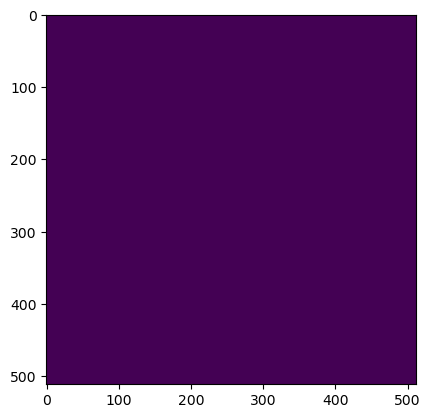

Wrote output/patches/mask/CC_S1_10-501046-4000-6261473-6000.tiff (512 x 512 pixels)


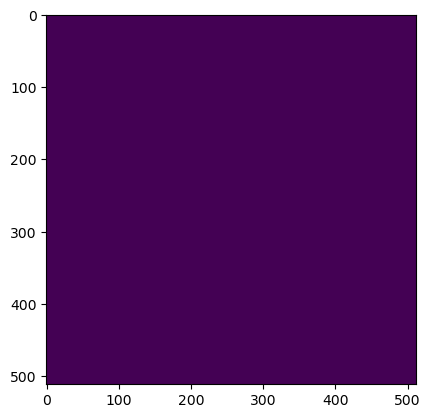

Wrote output/patches/mask/CC_S1_10-501148-8000-6261166-4000.tiff (512 x 512 pixels)


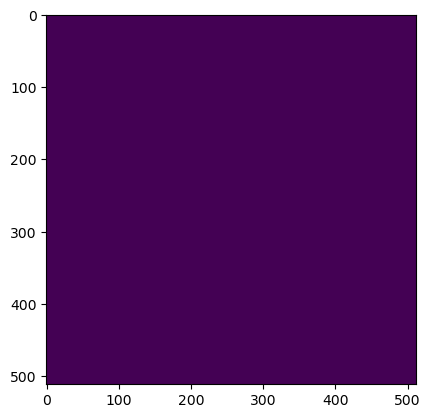

Wrote output/patches/mask/CC_S1_10-501148-8000-6261268-8000.tiff (512 x 512 pixels)


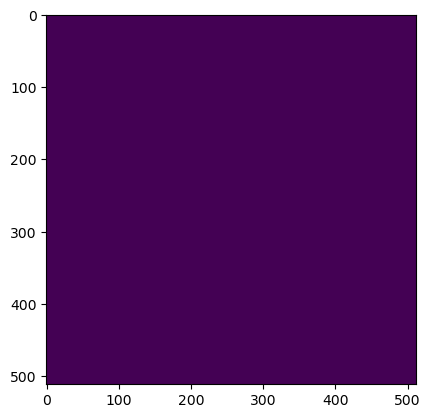

Wrote output/patches/mask/CC_S1_10-501148-8000-6261371-2000.tiff (512 x 512 pixels)


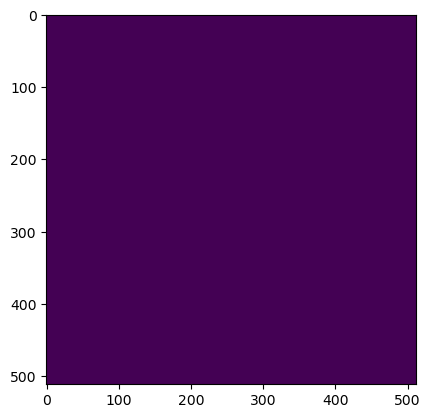

Wrote output/patches/mask/CC_S1_10-501148-8000-6261473-6000.tiff (512 x 512 pixels)


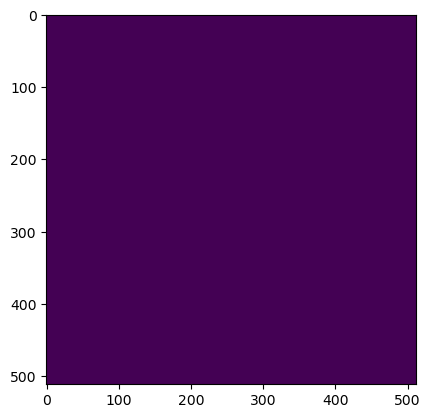

Wrote output/patches/mask/CC_S1_10-501251-2000-6261166-4000.tiff (512 x 512 pixels)


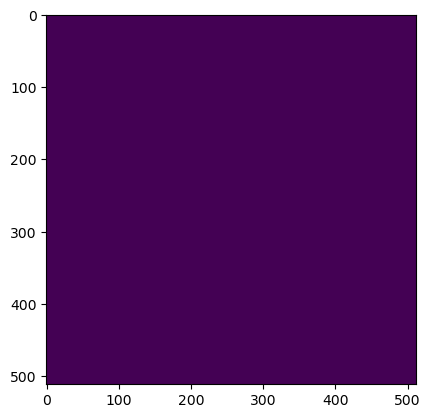

Wrote output/patches/mask/CC_S1_10-501251-2000-6261268-8000.tiff (512 x 512 pixels)


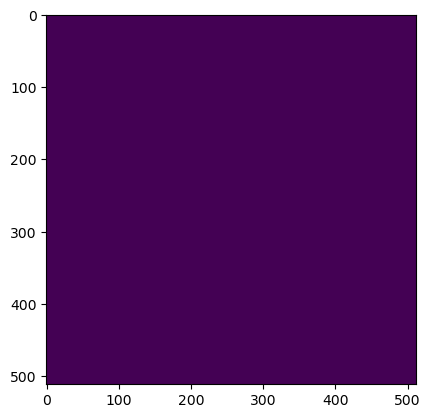

Wrote output/patches/mask/CC_S1_10-501251-2000-6261371-2000.tiff (512 x 512 pixels)


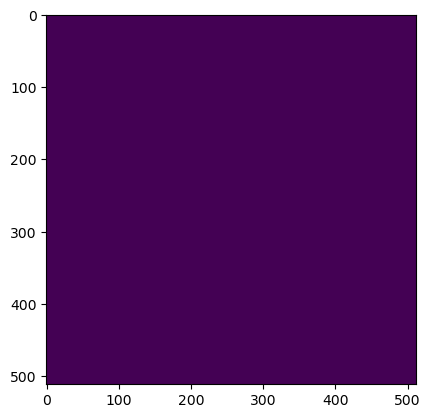

Wrote output/patches/mask/CC_S1_10-501251-2000-6261473-6000.tiff (512 x 512 pixels)


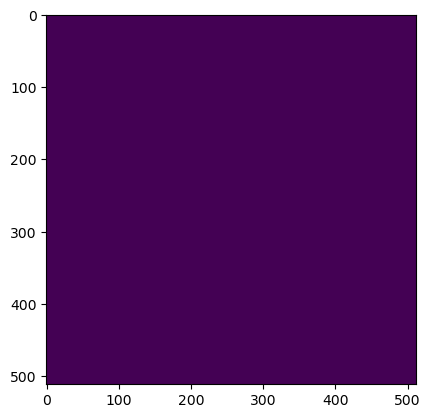

Wrote output/patches/mask/CC_S1_10-501353-6000-6261166-4000.tiff (512 x 512 pixels)


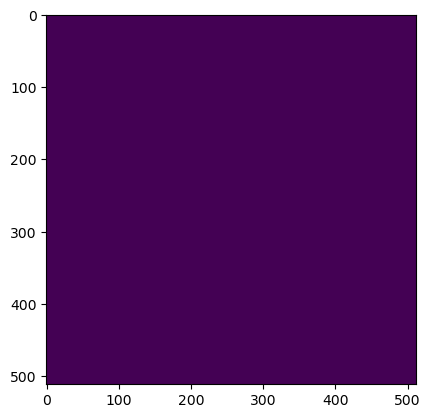

Wrote output/patches/mask/CC_S1_10-501353-6000-6261268-8000.tiff (512 x 512 pixels)


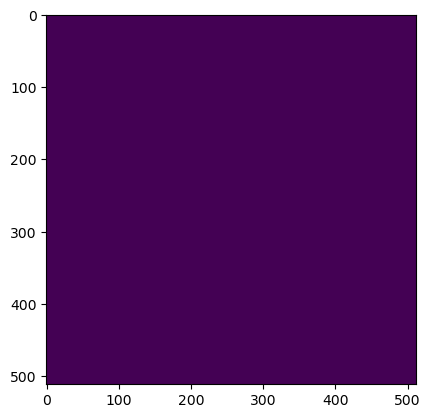

Wrote output/patches/mask/CC_S1_10-501353-6000-6261371-2000.tiff (512 x 512 pixels)


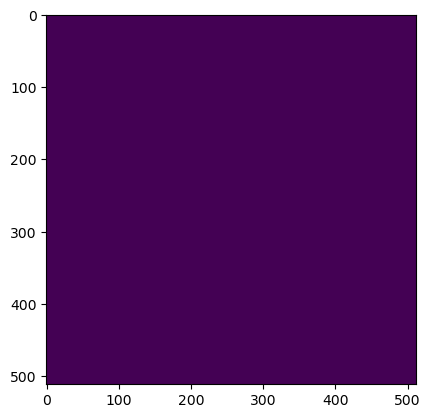

Wrote output/patches/mask/CC_S1_10-501353-6000-6261473-6000.tiff (512 x 512 pixels)


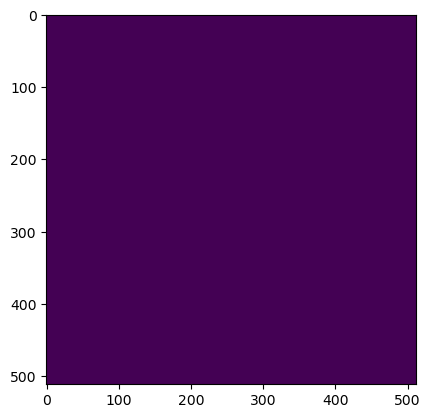

Wrote output/patches/mask/CC_S1_10-501456-0000-6261166-4000.tiff (512 x 512 pixels)


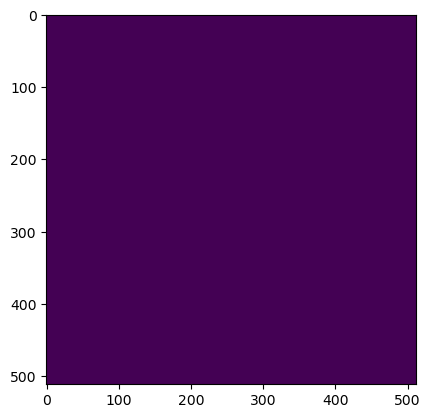

Wrote output/patches/mask/CC_S1_10-501456-0000-6261268-8000.tiff (512 x 512 pixels)


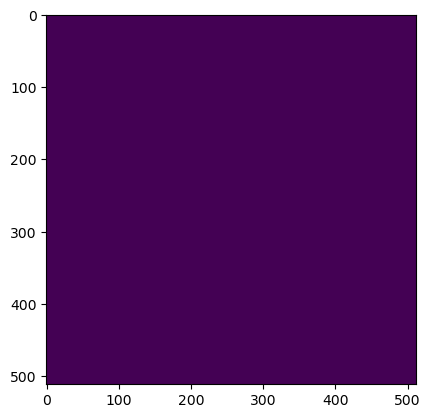

Wrote output/patches/mask/CC_S1_10-501456-0000-6261371-2000.tiff (512 x 512 pixels)


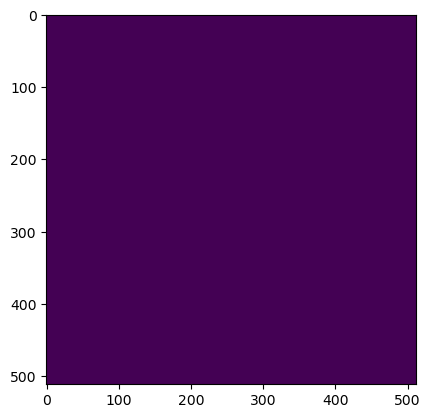

Wrote output/patches/mask/CC_S1_10-501456-0000-6261473-6000.tiff (512 x 512 pixels)


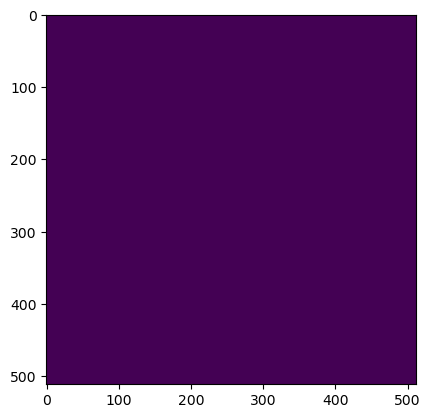

Wrote output/patches/mask/CC_S1_10-501558-4000-6261166-4000.tiff (512 x 512 pixels)


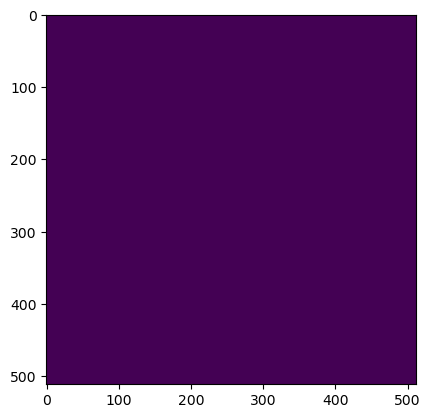

Wrote output/patches/mask/CC_S1_10-501558-4000-6261268-8000.tiff (512 x 512 pixels)


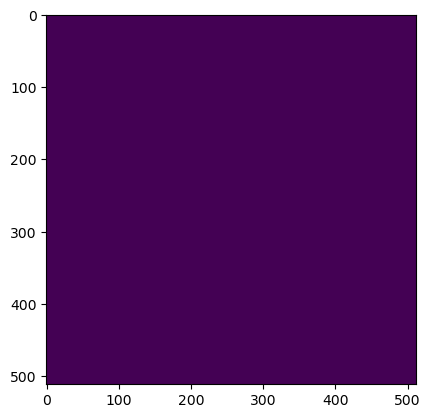

Wrote output/patches/mask/CC_S1_10-501558-4000-6261371-2000.tiff (512 x 512 pixels)


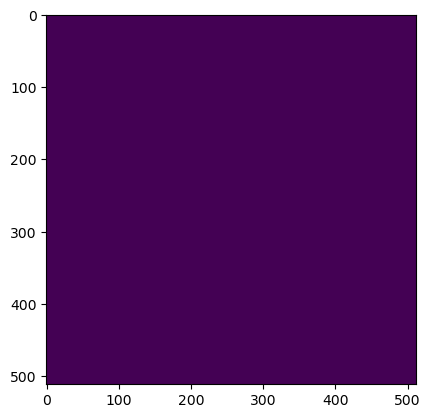

Wrote output/patches/mask/CC_S1_10-501558-4000-6261473-6000.tiff (512 x 512 pixels)
Zone CU_S1_11 Building Mask...


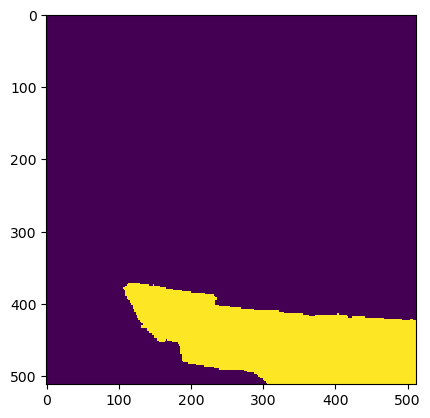

Wrote output/patches/mask/CU_S1_11-523984-0000-6261678-4000.tiff (512 x 512 pixels)


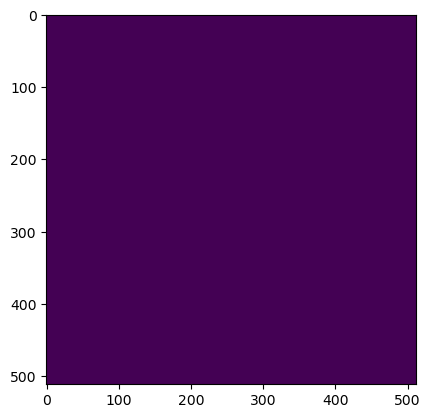

Wrote output/patches/mask/CU_S1_11-523984-0000-6261780-8000.tiff (512 x 512 pixels)


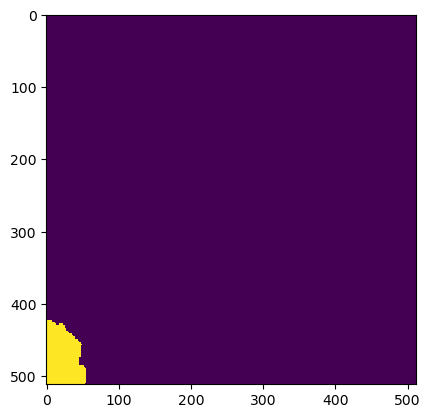

Wrote output/patches/mask/CU_S1_11-524086-4000-6261678-4000.tiff (512 x 512 pixels)


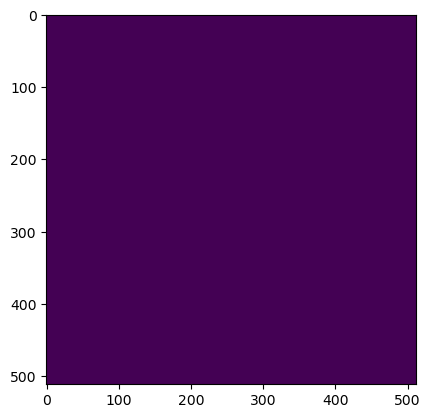

Wrote output/patches/mask/CU_S1_11-524086-4000-6261780-8000.tiff (512 x 512 pixels)
Zone CN_S1_12 Building Mask...


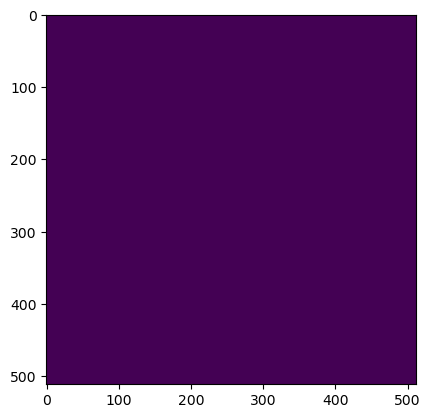

Wrote output/patches/mask/CN_S1_12-480464-0000-6262190-4000.tiff (512 x 512 pixels)


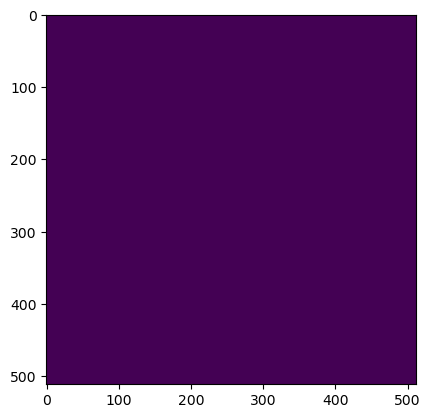

Wrote output/patches/mask/CN_S1_12-480464-0000-6262292-8000.tiff (512 x 512 pixels)


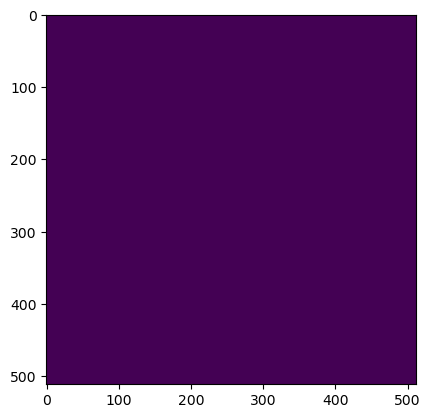

Wrote output/patches/mask/CN_S1_12-480566-4000-6262190-4000.tiff (512 x 512 pixels)


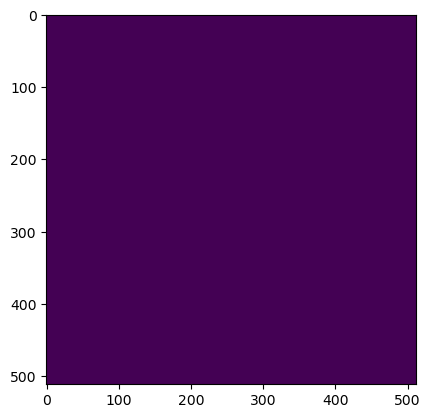

Wrote output/patches/mask/CN_S1_12-480566-4000-6262292-8000.tiff (512 x 512 pixels)
Zone CU_S1_13 Building Mask...


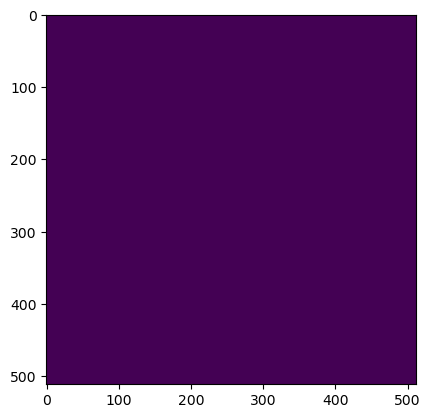

Wrote output/patches/mask/CU_S1_13-503248-0000-6262702-4000.tiff (512 x 512 pixels)


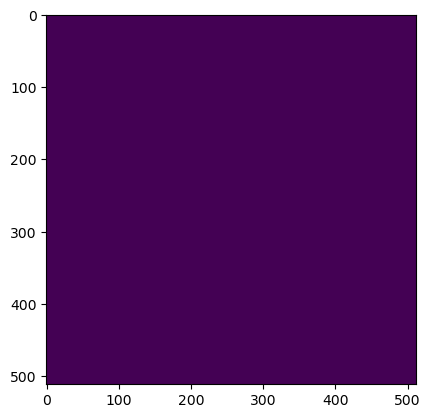

Wrote output/patches/mask/CU_S1_13-503248-0000-6262804-8000.tiff (512 x 512 pixels)


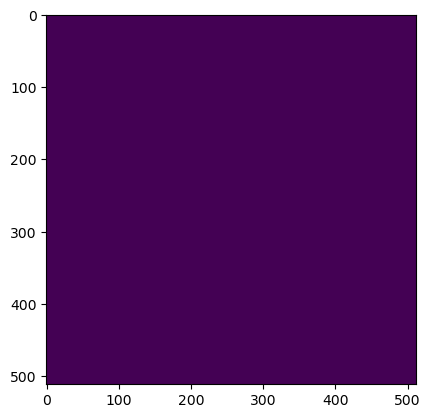

Wrote output/patches/mask/CU_S1_13-503248-0000-6262907-2000.tiff (512 x 512 pixels)


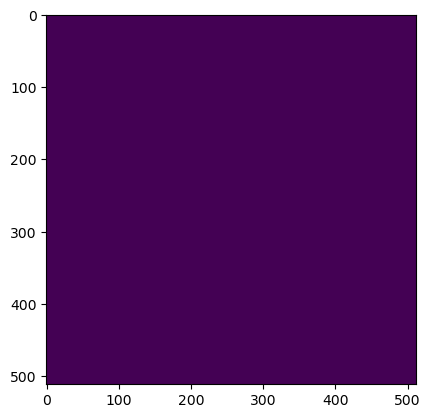

Wrote output/patches/mask/CU_S1_13-503248-0000-6263009-6000.tiff (512 x 512 pixels)


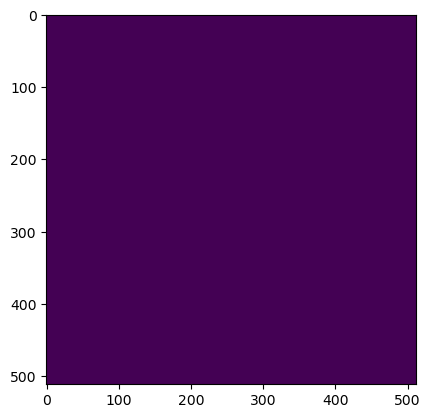

Wrote output/patches/mask/CU_S1_13-503248-0000-6263112-0000.tiff (512 x 512 pixels)


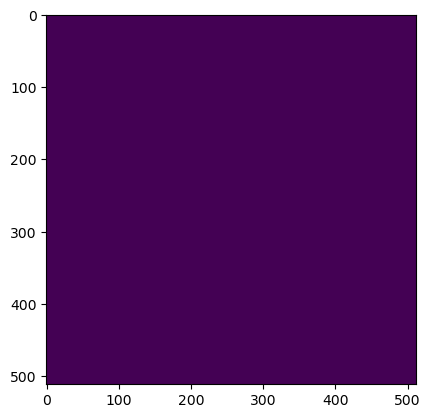

Wrote output/patches/mask/CU_S1_13-503248-0000-6263214-4000.tiff (512 x 512 pixels)


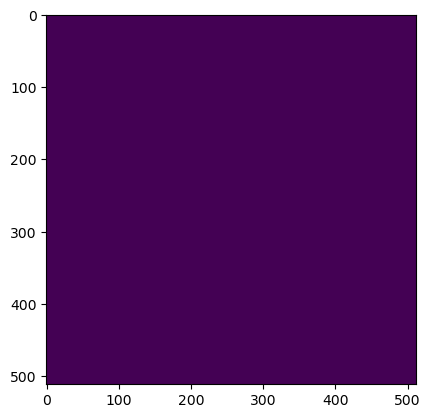

Wrote output/patches/mask/CU_S1_13-503248-0000-6263316-8000.tiff (512 x 512 pixels)


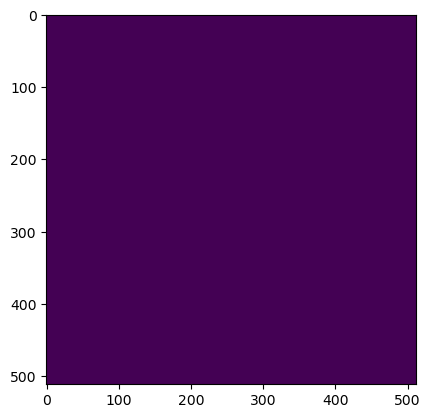

Wrote output/patches/mask/CU_S1_13-503350-4000-6262702-4000.tiff (512 x 512 pixels)


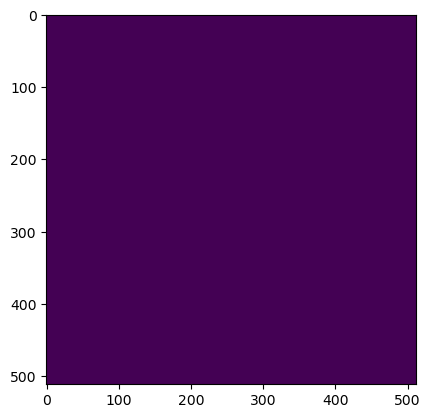

Wrote output/patches/mask/CU_S1_13-503350-4000-6262804-8000.tiff (512 x 512 pixels)


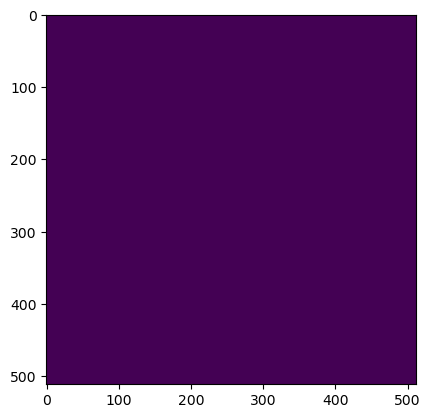

Wrote output/patches/mask/CU_S1_13-503350-4000-6262907-2000.tiff (512 x 512 pixels)


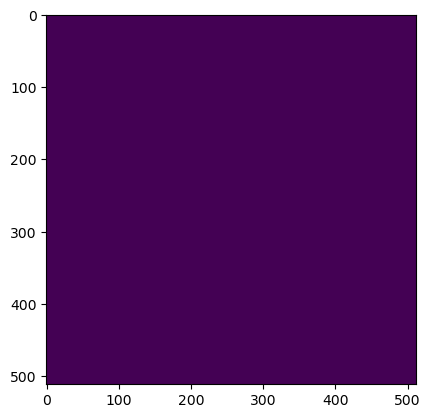

Wrote output/patches/mask/CU_S1_13-503350-4000-6263009-6000.tiff (512 x 512 pixels)


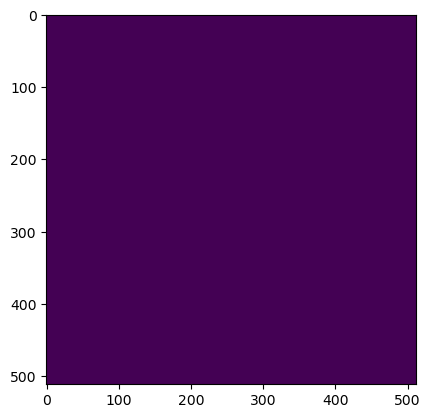

Wrote output/patches/mask/CU_S1_13-503350-4000-6263112-0000.tiff (512 x 512 pixels)


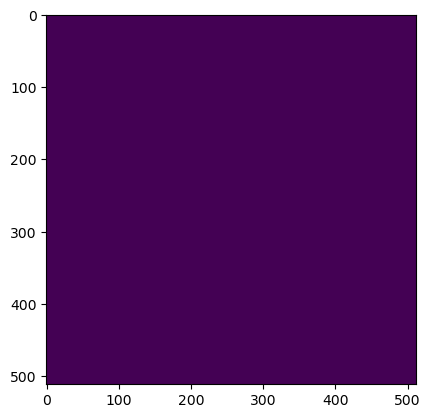

Wrote output/patches/mask/CU_S1_13-503350-4000-6263214-4000.tiff (512 x 512 pixels)


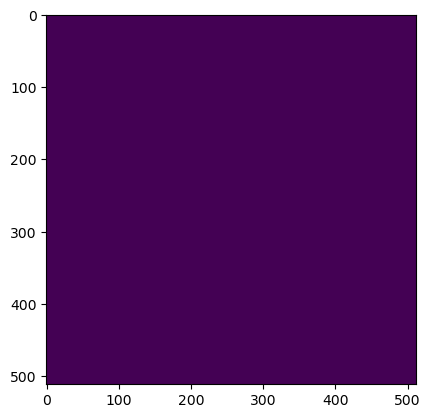

Wrote output/patches/mask/CU_S1_13-503350-4000-6263316-8000.tiff (512 x 512 pixels)


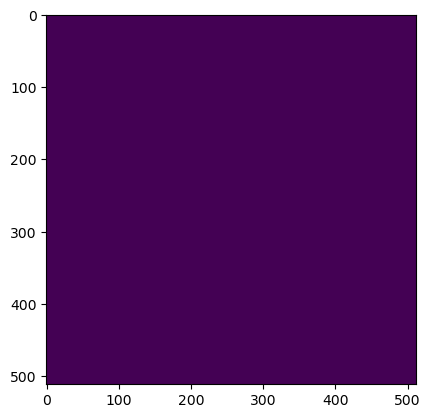

Wrote output/patches/mask/CU_S1_13-503452-8000-6262702-4000.tiff (512 x 512 pixels)


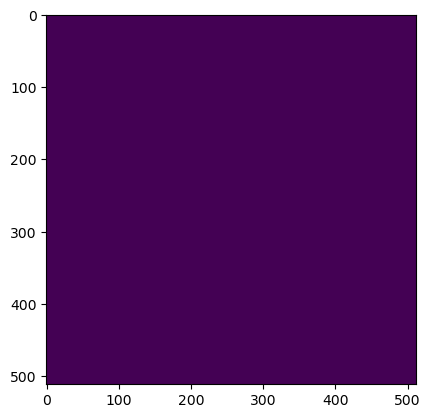

Wrote output/patches/mask/CU_S1_13-503452-8000-6262804-8000.tiff (512 x 512 pixels)


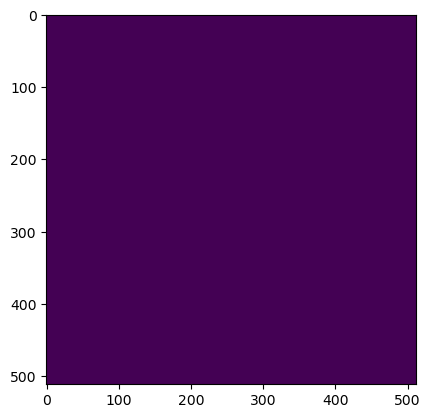

Wrote output/patches/mask/CU_S1_13-503452-8000-6262907-2000.tiff (512 x 512 pixels)


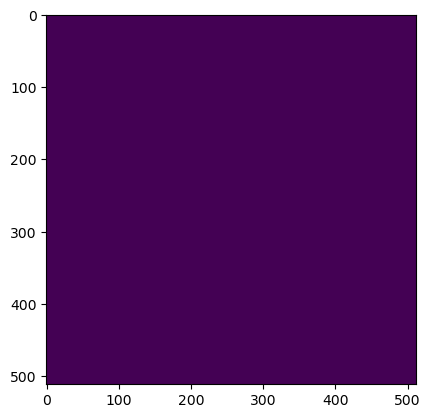

Wrote output/patches/mask/CU_S1_13-503452-8000-6263009-6000.tiff (512 x 512 pixels)


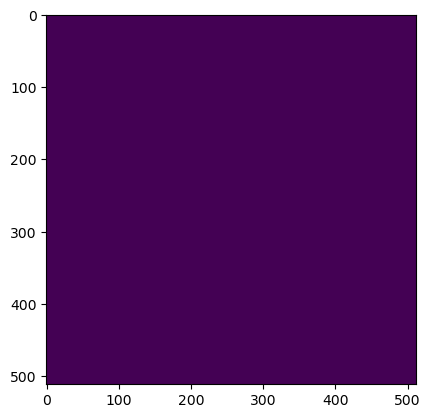

Wrote output/patches/mask/CU_S1_13-503452-8000-6263112-0000.tiff (512 x 512 pixels)


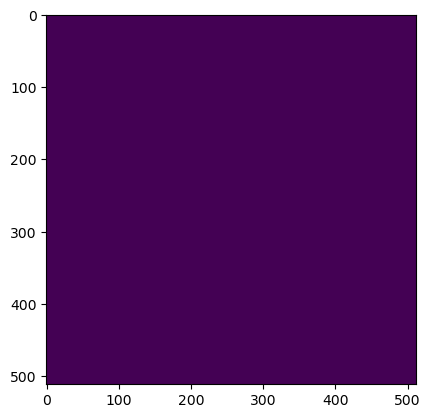

Wrote output/patches/mask/CU_S1_13-503452-8000-6263214-4000.tiff (512 x 512 pixels)


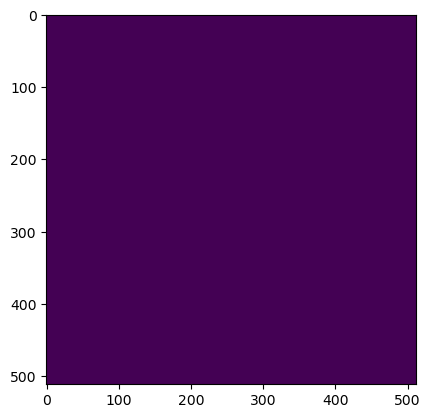

Wrote output/patches/mask/CU_S1_13-503452-8000-6263316-8000.tiff (512 x 512 pixels)


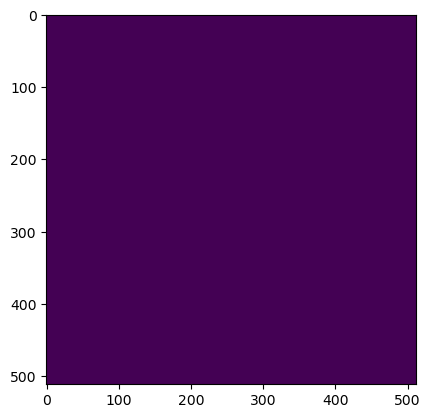

Wrote output/patches/mask/CU_S1_13-503555-2000-6262702-4000.tiff (512 x 512 pixels)


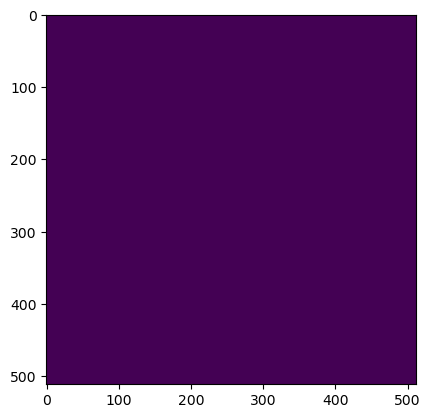

Wrote output/patches/mask/CU_S1_13-503555-2000-6262804-8000.tiff (512 x 512 pixels)


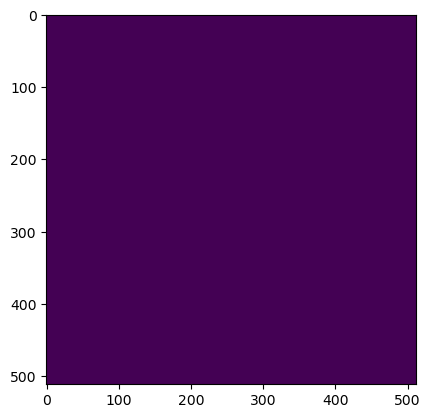

Wrote output/patches/mask/CU_S1_13-503555-2000-6262907-2000.tiff (512 x 512 pixels)


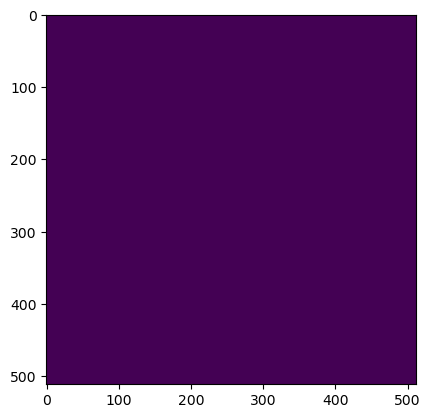

Wrote output/patches/mask/CU_S1_13-503555-2000-6263009-6000.tiff (512 x 512 pixels)


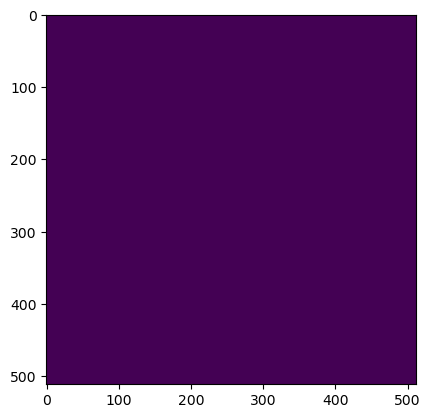

Wrote output/patches/mask/CU_S1_13-503555-2000-6263112-0000.tiff (512 x 512 pixels)


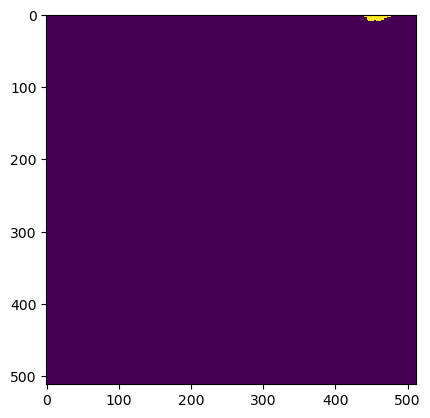

Wrote output/patches/mask/CU_S1_13-503555-2000-6263214-4000.tiff (512 x 512 pixels)


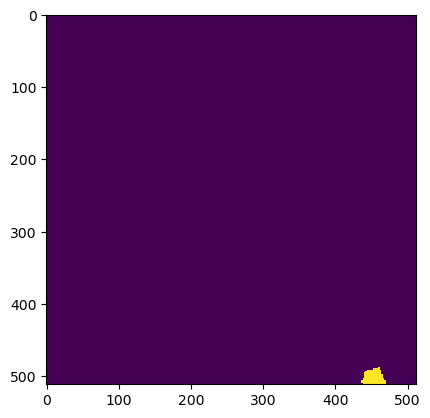

Wrote output/patches/mask/CU_S1_13-503555-2000-6263316-8000.tiff (512 x 512 pixels)


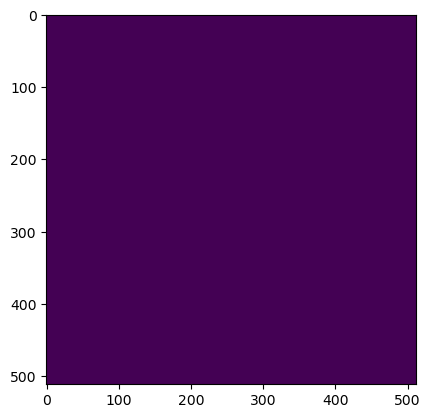

Wrote output/patches/mask/CU_S1_13-503657-6000-6262702-4000.tiff (512 x 512 pixels)


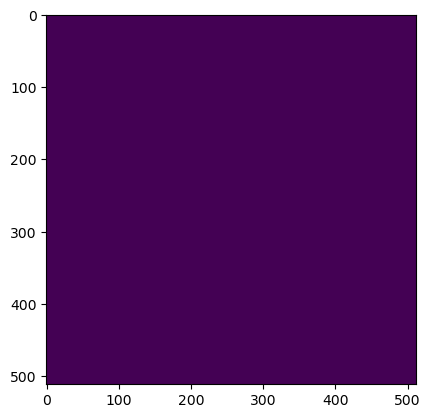

Wrote output/patches/mask/CU_S1_13-503657-6000-6262804-8000.tiff (512 x 512 pixels)


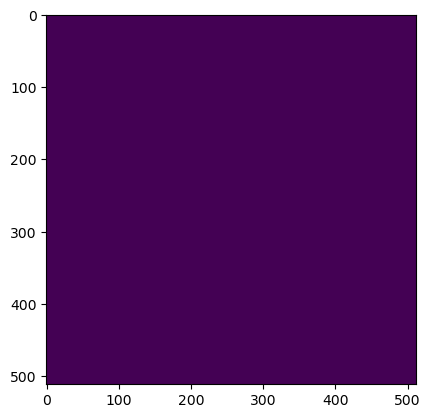

Wrote output/patches/mask/CU_S1_13-503657-6000-6262907-2000.tiff (512 x 512 pixels)


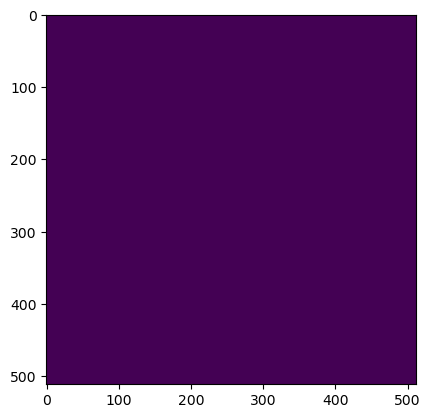

Wrote output/patches/mask/CU_S1_13-503657-6000-6263009-6000.tiff (512 x 512 pixels)


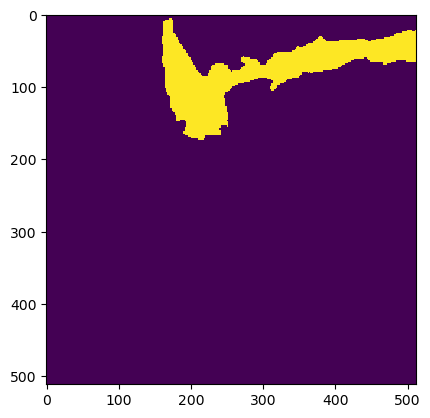

Wrote output/patches/mask/CU_S1_13-503657-6000-6263112-0000.tiff (512 x 512 pixels)


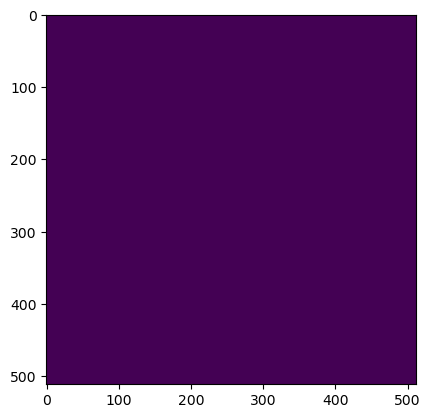

Wrote output/patches/mask/CU_S1_13-503657-6000-6263214-4000.tiff (512 x 512 pixels)


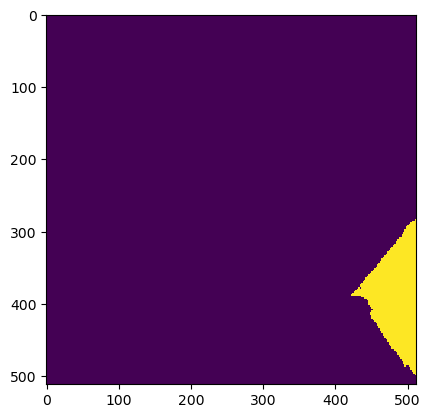

Wrote output/patches/mask/CU_S1_13-503657-6000-6263316-8000.tiff (512 x 512 pixels)


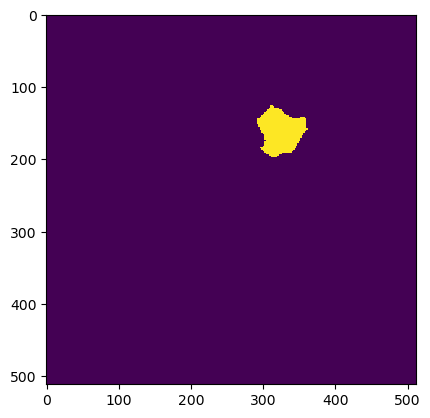

Wrote output/patches/mask/CU_S1_13-503760-0000-6262702-4000.tiff (512 x 512 pixels)


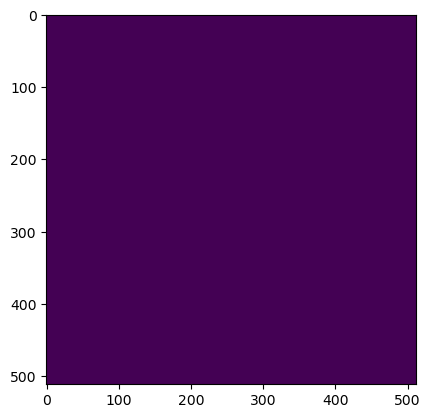

Wrote output/patches/mask/CU_S1_13-503760-0000-6262804-8000.tiff (512 x 512 pixels)


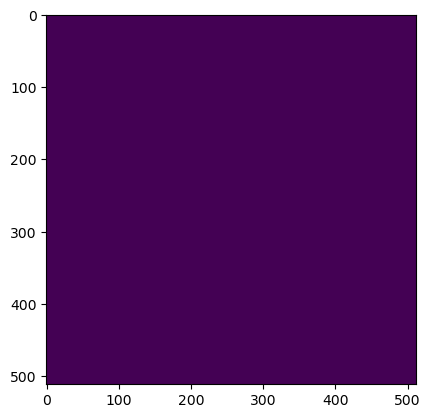

Wrote output/patches/mask/CU_S1_13-503760-0000-6262907-2000.tiff (512 x 512 pixels)


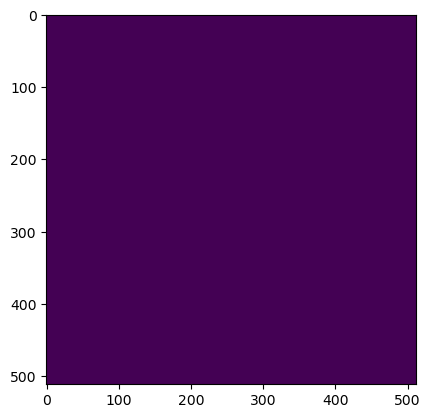

Wrote output/patches/mask/CU_S1_13-503760-0000-6263009-6000.tiff (512 x 512 pixels)


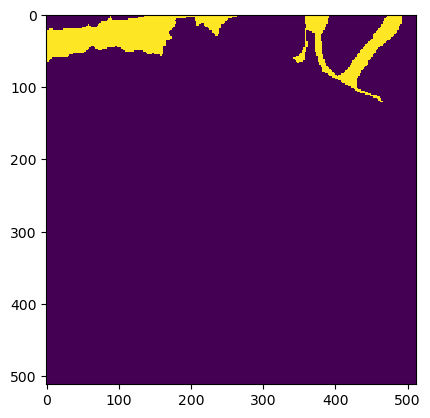

Wrote output/patches/mask/CU_S1_13-503760-0000-6263112-0000.tiff (512 x 512 pixels)


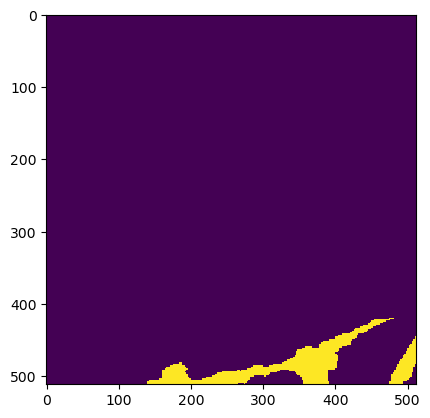

Wrote output/patches/mask/CU_S1_13-503760-0000-6263214-4000.tiff (512 x 512 pixels)


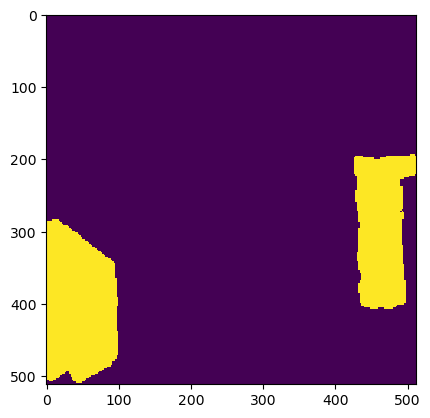

Wrote output/patches/mask/CU_S1_13-503760-0000-6263316-8000.tiff (512 x 512 pixels)


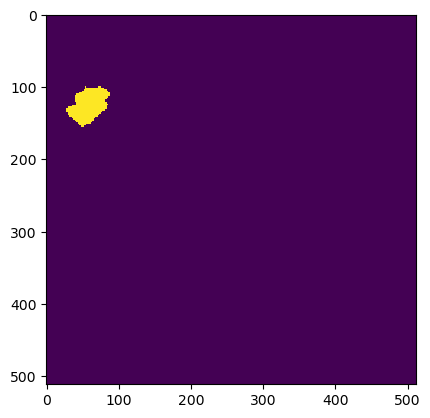

Wrote output/patches/mask/CU_S1_13-503862-4000-6262702-4000.tiff (512 x 512 pixels)


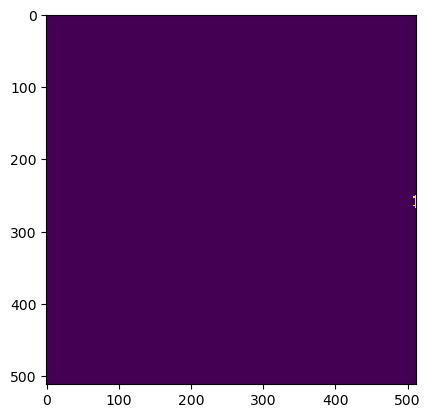

Wrote output/patches/mask/CU_S1_13-503862-4000-6262804-8000.tiff (512 x 512 pixels)


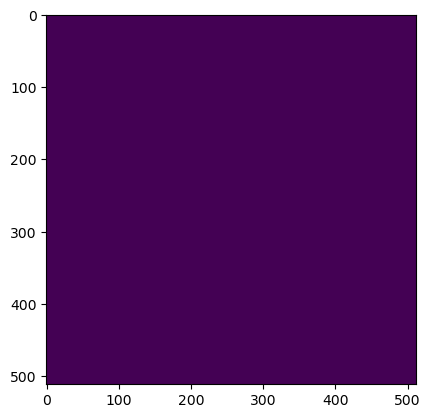

Wrote output/patches/mask/CU_S1_13-503862-4000-6262907-2000.tiff (512 x 512 pixels)


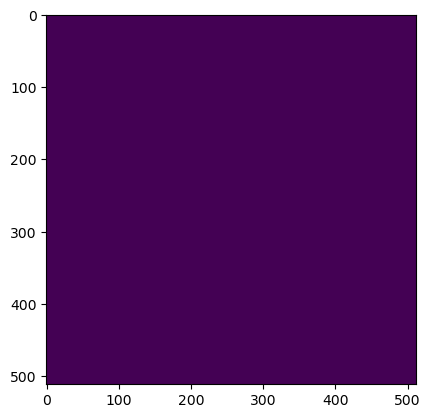

Wrote output/patches/mask/CU_S1_13-503862-4000-6263009-6000.tiff (512 x 512 pixels)


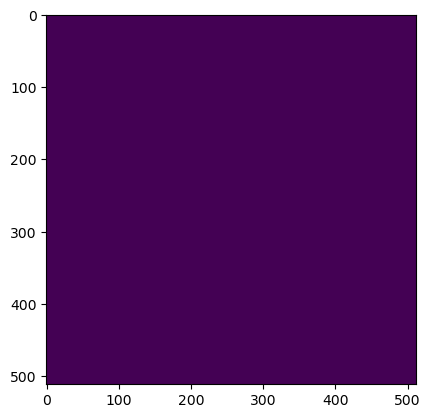

Wrote output/patches/mask/CU_S1_13-503862-4000-6263112-0000.tiff (512 x 512 pixels)


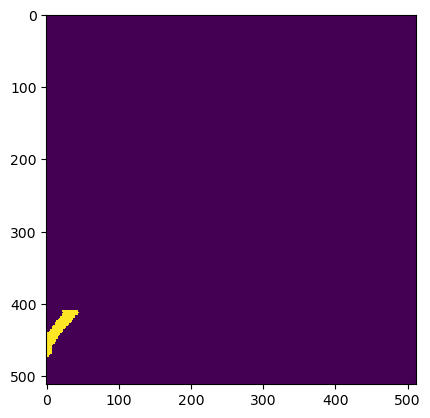

Wrote output/patches/mask/CU_S1_13-503862-4000-6263214-4000.tiff (512 x 512 pixels)


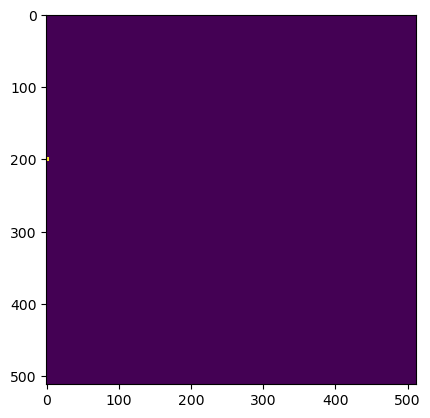

Wrote output/patches/mask/CU_S1_13-503862-4000-6263316-8000.tiff (512 x 512 pixels)
Zone UC_S1_14 Building Mask...


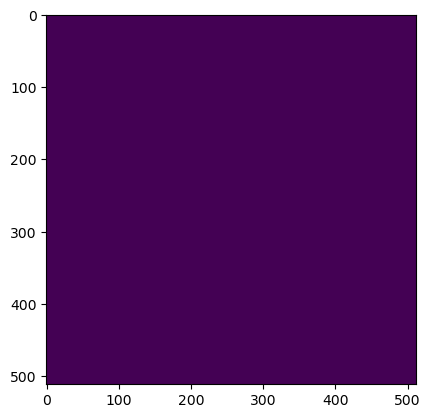

Wrote output/patches/mask/UC_S1_14-492240-0000-6264494-4000.tiff (512 x 512 pixels)


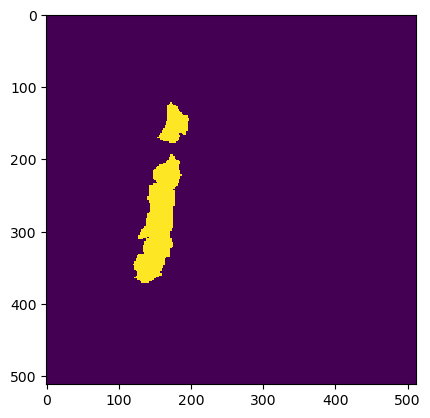

Wrote output/patches/mask/UC_S1_14-492240-0000-6264596-8000.tiff (512 x 512 pixels)


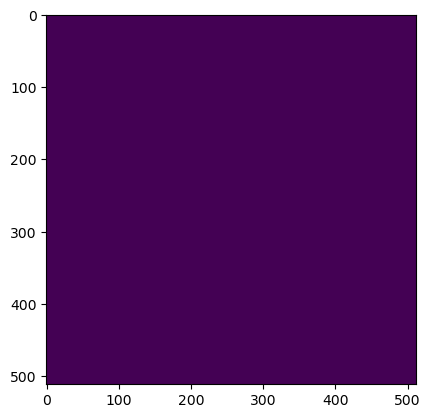

Wrote output/patches/mask/UC_S1_14-492240-0000-6264699-2000.tiff (512 x 512 pixels)


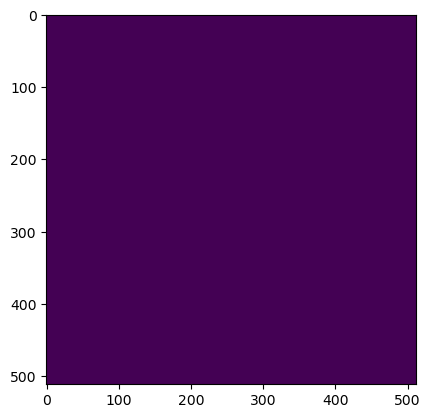

Wrote output/patches/mask/UC_S1_14-492240-0000-6264801-6000.tiff (512 x 512 pixels)


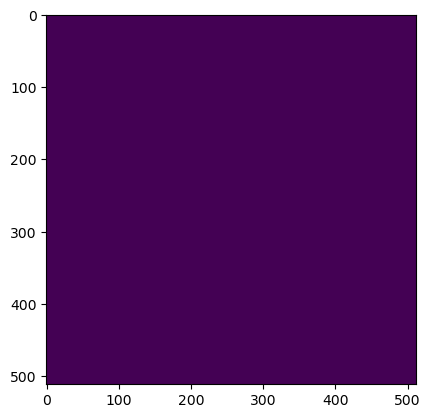

Wrote output/patches/mask/UC_S1_14-492342-4000-6264494-4000.tiff (512 x 512 pixels)


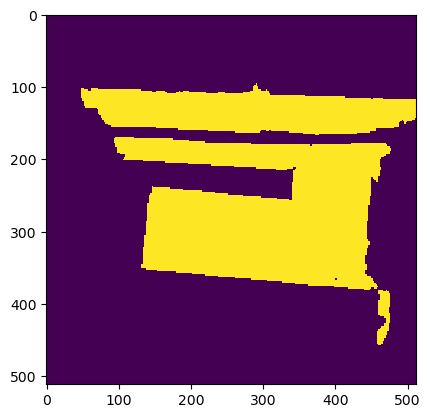

Wrote output/patches/mask/UC_S1_14-492342-4000-6264596-8000.tiff (512 x 512 pixels)


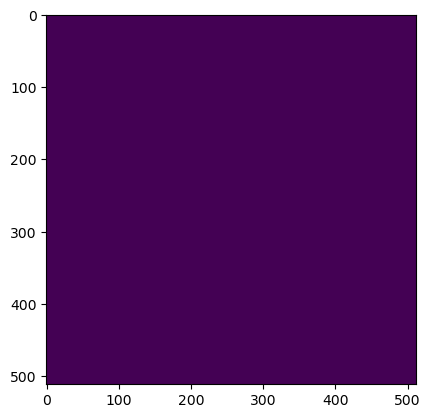

Wrote output/patches/mask/UC_S1_14-492342-4000-6264699-2000.tiff (512 x 512 pixels)


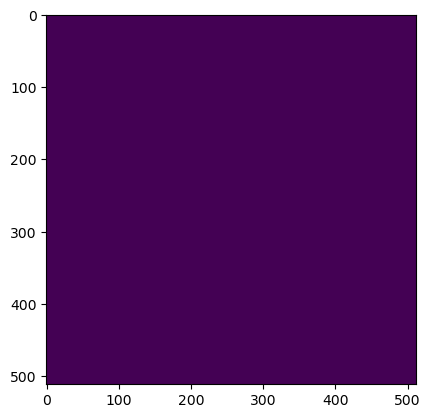

Wrote output/patches/mask/UC_S1_14-492342-4000-6264801-6000.tiff (512 x 512 pixels)


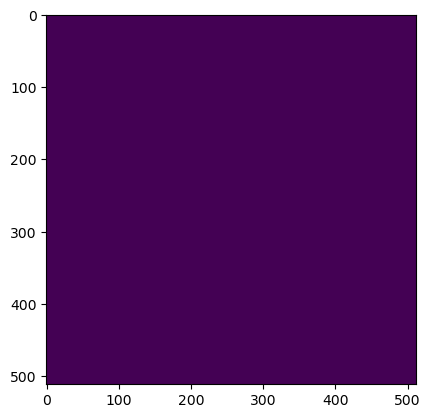

Wrote output/patches/mask/UC_S1_14-492444-8000-6264494-4000.tiff (512 x 512 pixels)


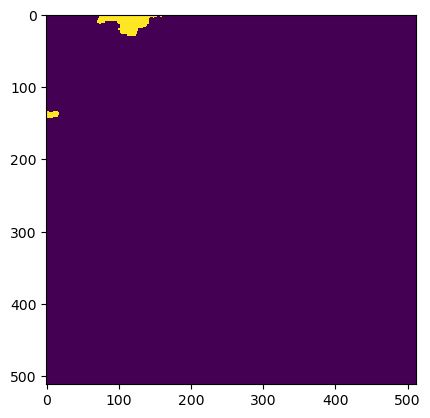

Wrote output/patches/mask/UC_S1_14-492444-8000-6264596-8000.tiff (512 x 512 pixels)


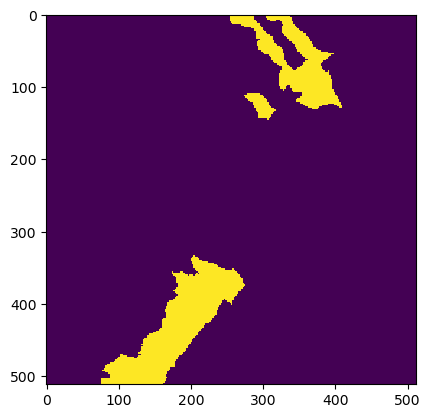

Wrote output/patches/mask/UC_S1_14-492444-8000-6264699-2000.tiff (512 x 512 pixels)


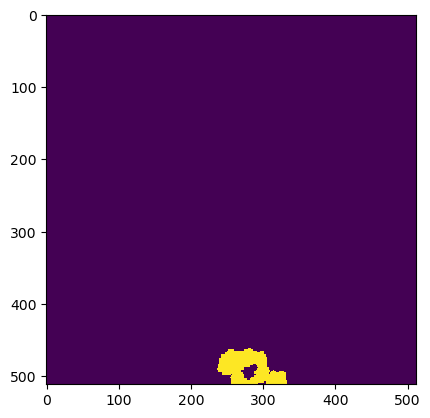

Wrote output/patches/mask/UC_S1_14-492444-8000-6264801-6000.tiff (512 x 512 pixels)


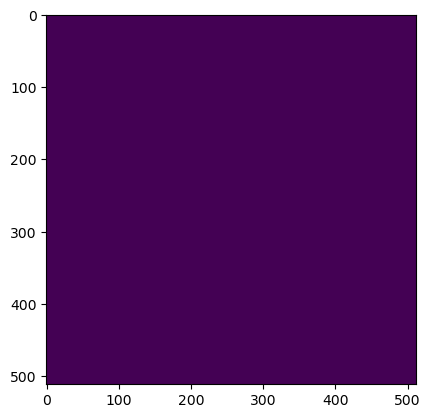

Wrote output/patches/mask/UC_S1_14-492547-2000-6264494-4000.tiff (512 x 512 pixels)


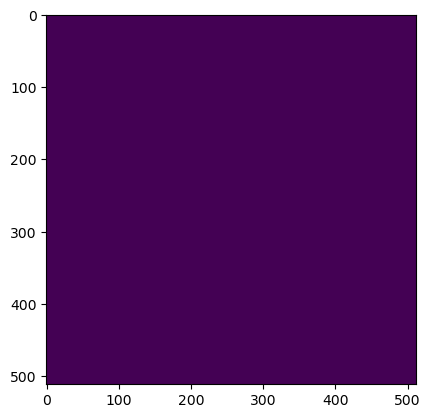

Wrote output/patches/mask/UC_S1_14-492547-2000-6264596-8000.tiff (512 x 512 pixels)


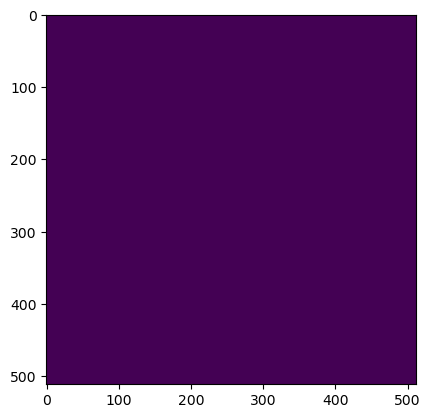

Wrote output/patches/mask/UC_S1_14-492547-2000-6264699-2000.tiff (512 x 512 pixels)


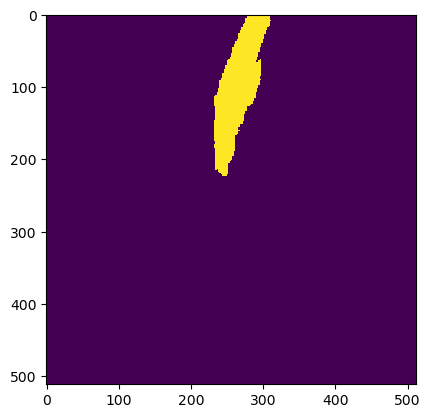

Wrote output/patches/mask/UC_S1_14-492547-2000-6264801-6000.tiff (512 x 512 pixels)
Zone VV_S1_15 Building Mask...


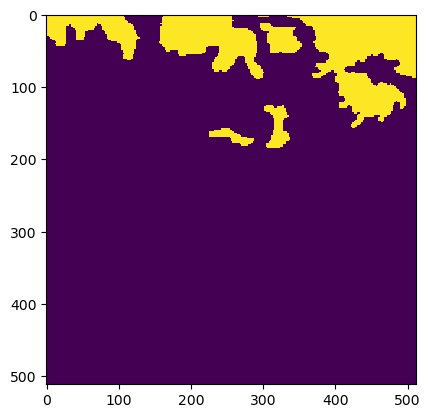

Wrote output/patches/mask/VV_S1_15-505296-0000-6264750-4000.tiff (512 x 512 pixels)


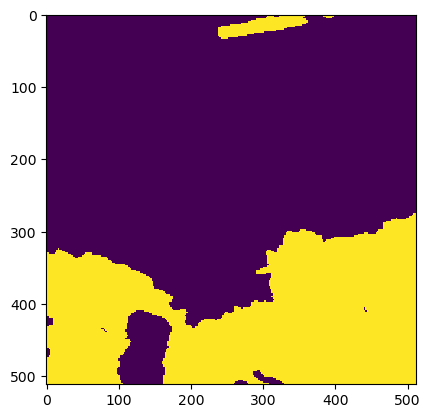

Wrote output/patches/mask/VV_S1_15-505296-0000-6264852-8000.tiff (512 x 512 pixels)


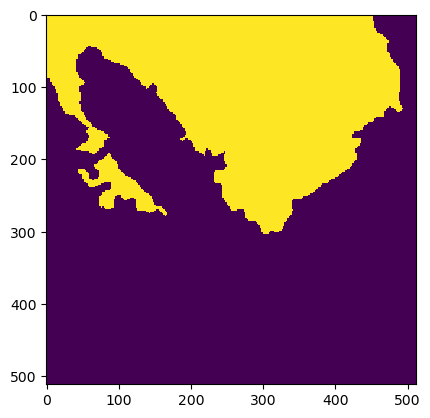

Wrote output/patches/mask/VV_S1_15-505398-4000-6264750-4000.tiff (512 x 512 pixels)


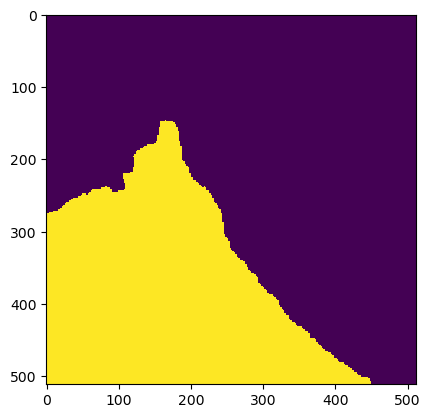

Wrote output/patches/mask/VV_S1_15-505398-4000-6264852-8000.tiff (512 x 512 pixels)
Zone UC_S1_16 Building Mask...


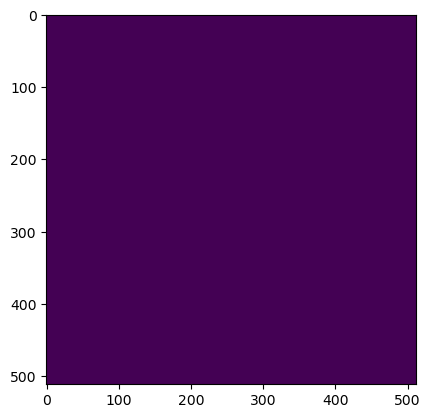

Wrote output/patches/mask/UC_S1_16-474320-0000-6266030-4000.tiff (512 x 512 pixels)


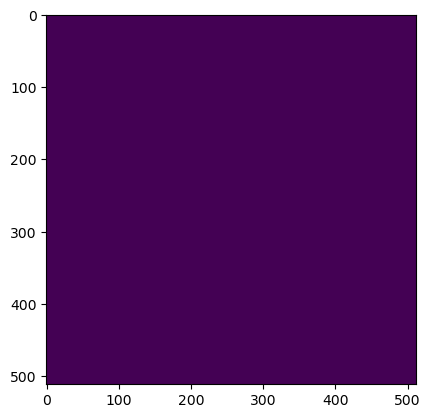

Wrote output/patches/mask/UC_S1_16-474320-0000-6266132-8000.tiff (512 x 512 pixels)


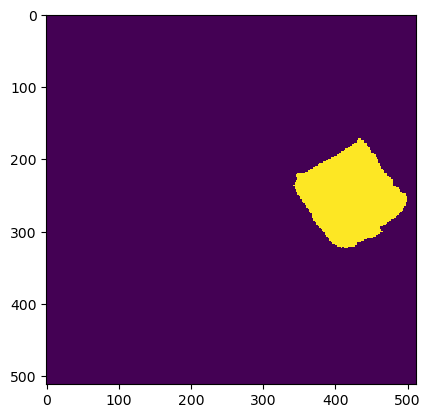

Wrote output/patches/mask/UC_S1_16-474320-0000-6266235-2000.tiff (512 x 512 pixels)


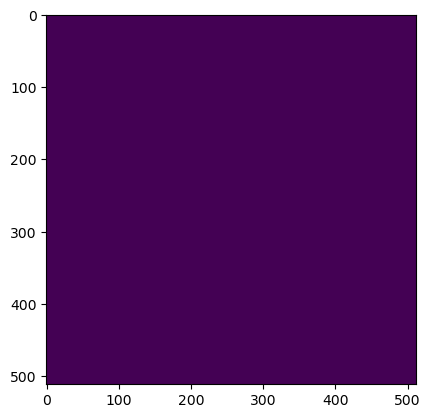

Wrote output/patches/mask/UC_S1_16-474320-0000-6266337-6000.tiff (512 x 512 pixels)


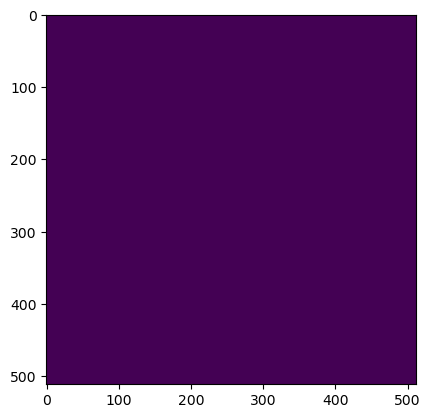

Wrote output/patches/mask/UC_S1_16-474320-0000-6266440-0000.tiff (512 x 512 pixels)


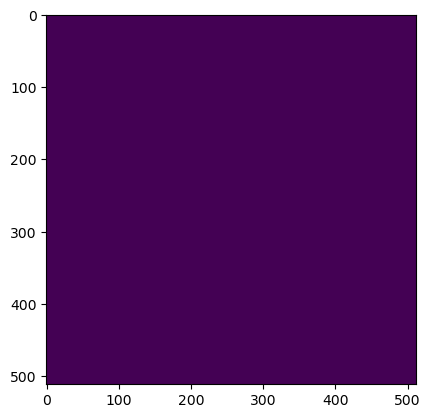

Wrote output/patches/mask/UC_S1_16-474320-0000-6266542-4000.tiff (512 x 512 pixels)


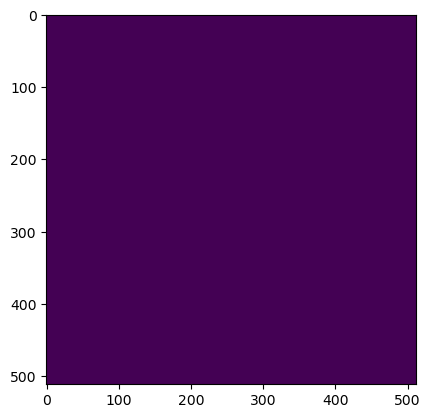

Wrote output/patches/mask/UC_S1_16-474320-0000-6266644-8000.tiff (512 x 512 pixels)


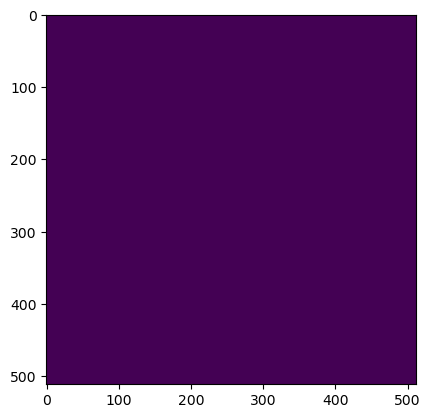

Wrote output/patches/mask/UC_S1_16-474422-4000-6266030-4000.tiff (512 x 512 pixels)


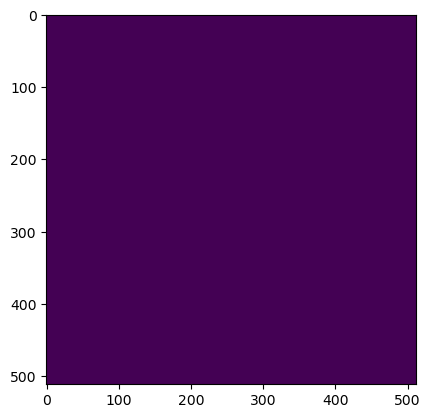

Wrote output/patches/mask/UC_S1_16-474422-4000-6266132-8000.tiff (512 x 512 pixels)


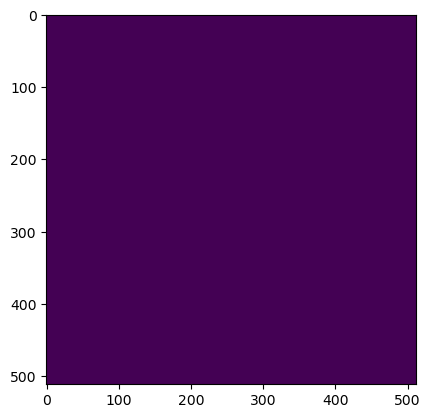

Wrote output/patches/mask/UC_S1_16-474422-4000-6266235-2000.tiff (512 x 512 pixels)


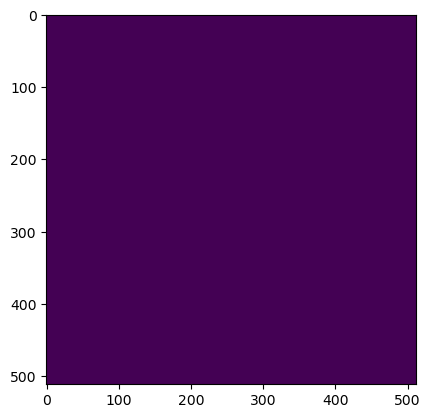

Wrote output/patches/mask/UC_S1_16-474422-4000-6266337-6000.tiff (512 x 512 pixels)


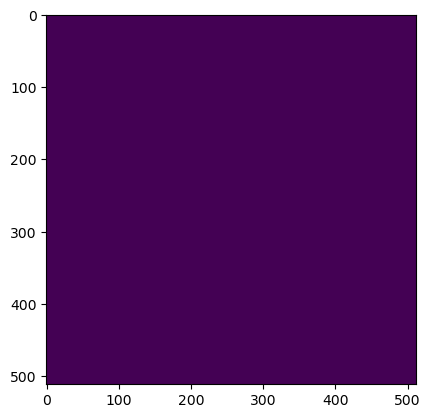

Wrote output/patches/mask/UC_S1_16-474422-4000-6266440-0000.tiff (512 x 512 pixels)


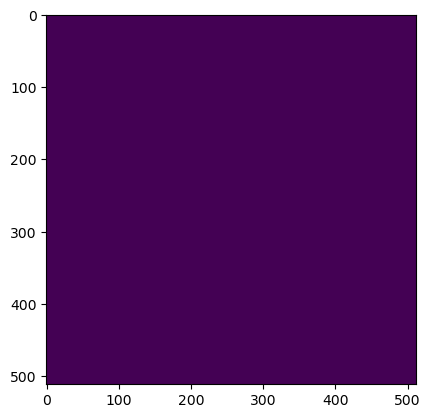

Wrote output/patches/mask/UC_S1_16-474422-4000-6266542-4000.tiff (512 x 512 pixels)


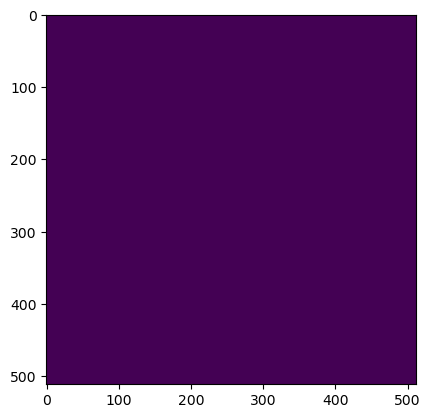

Wrote output/patches/mask/UC_S1_16-474422-4000-6266644-8000.tiff (512 x 512 pixels)


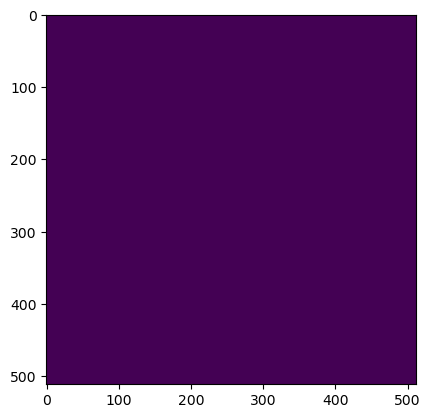

Wrote output/patches/mask/UC_S1_16-474524-8000-6266030-4000.tiff (512 x 512 pixels)


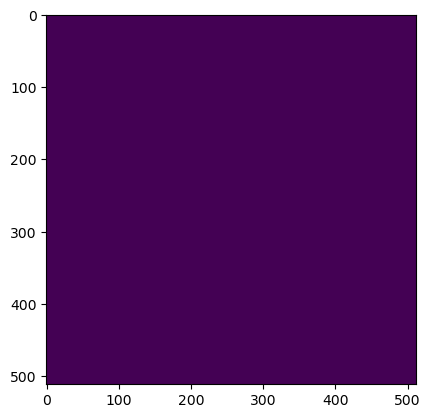

Wrote output/patches/mask/UC_S1_16-474524-8000-6266132-8000.tiff (512 x 512 pixels)


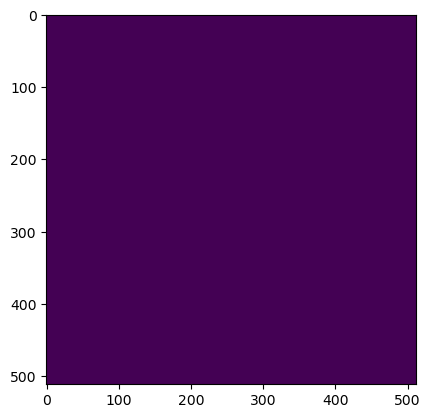

Wrote output/patches/mask/UC_S1_16-474524-8000-6266235-2000.tiff (512 x 512 pixels)


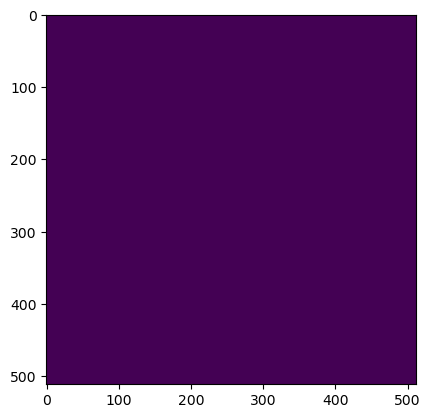

Wrote output/patches/mask/UC_S1_16-474524-8000-6266337-6000.tiff (512 x 512 pixels)


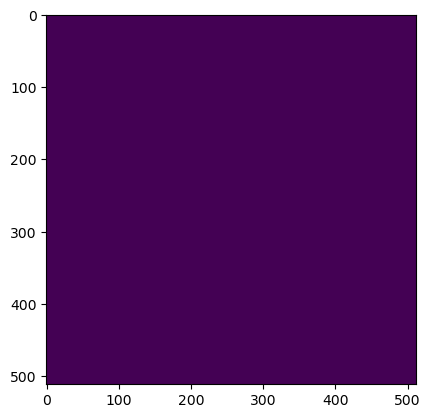

Wrote output/patches/mask/UC_S1_16-474524-8000-6266440-0000.tiff (512 x 512 pixels)


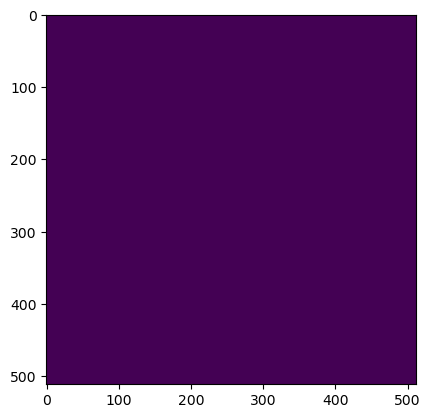

Wrote output/patches/mask/UC_S1_16-474524-8000-6266542-4000.tiff (512 x 512 pixels)


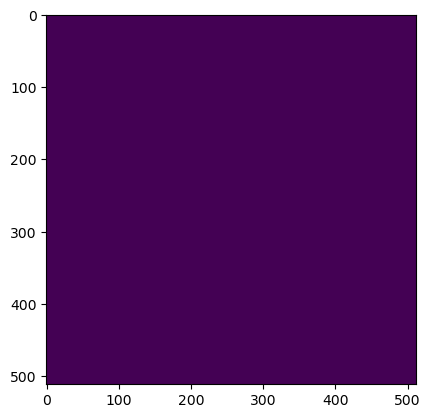

Wrote output/patches/mask/UC_S1_16-474524-8000-6266644-8000.tiff (512 x 512 pixels)


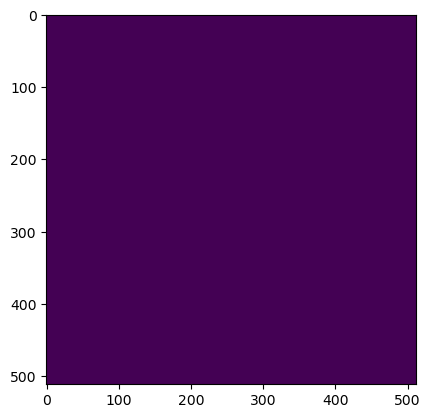

Wrote output/patches/mask/UC_S1_16-474627-2000-6266030-4000.tiff (512 x 512 pixels)


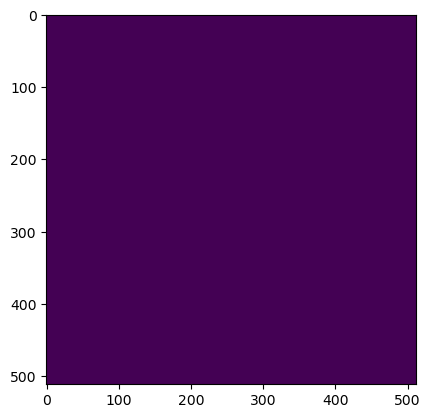

Wrote output/patches/mask/UC_S1_16-474627-2000-6266132-8000.tiff (512 x 512 pixels)


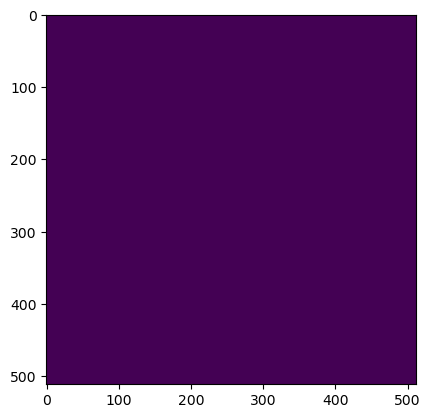

Wrote output/patches/mask/UC_S1_16-474627-2000-6266235-2000.tiff (512 x 512 pixels)


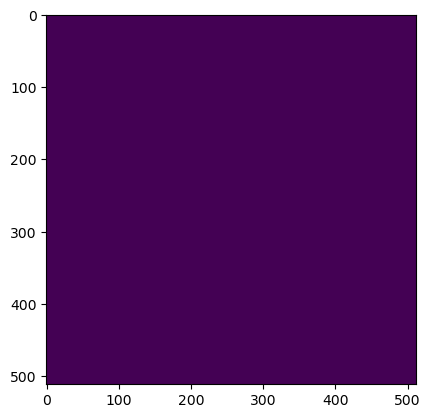

Wrote output/patches/mask/UC_S1_16-474627-2000-6266337-6000.tiff (512 x 512 pixels)


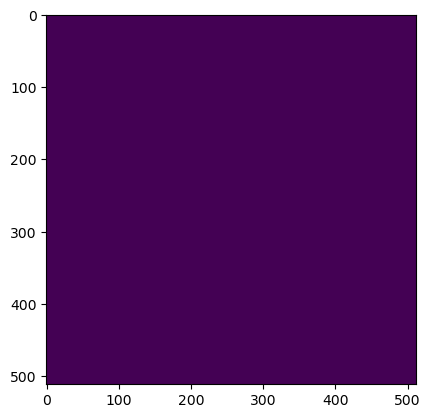

Wrote output/patches/mask/UC_S1_16-474627-2000-6266440-0000.tiff (512 x 512 pixels)


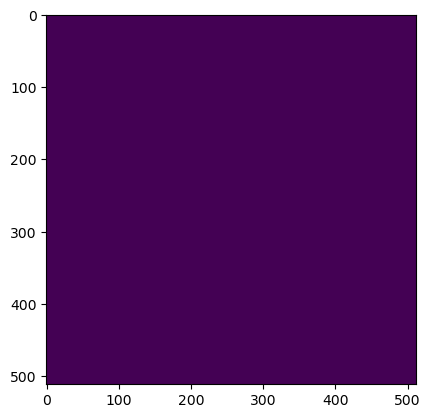

Wrote output/patches/mask/UC_S1_16-474627-2000-6266542-4000.tiff (512 x 512 pixels)


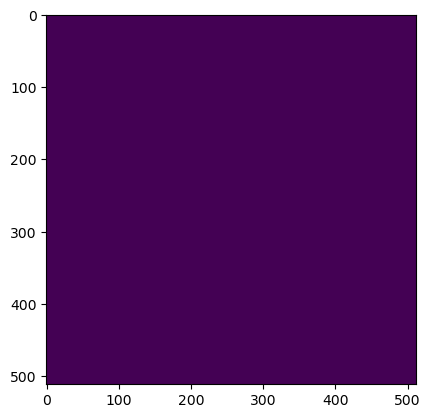

Wrote output/patches/mask/UC_S1_16-474627-2000-6266644-8000.tiff (512 x 512 pixels)
Zone UU_S1_17 Building Mask...


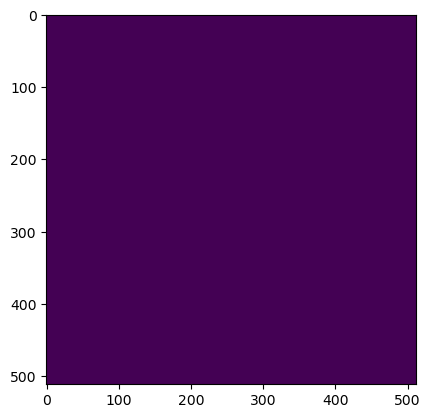

Wrote output/patches/mask/UU_S1_17-521680-0000-6266798-4000.tiff (512 x 512 pixels)


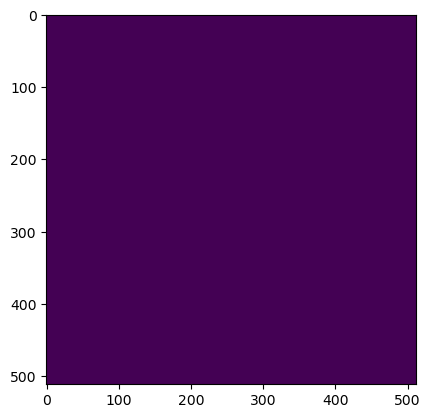

Wrote output/patches/mask/UU_S1_17-521680-0000-6266900-8000.tiff (512 x 512 pixels)


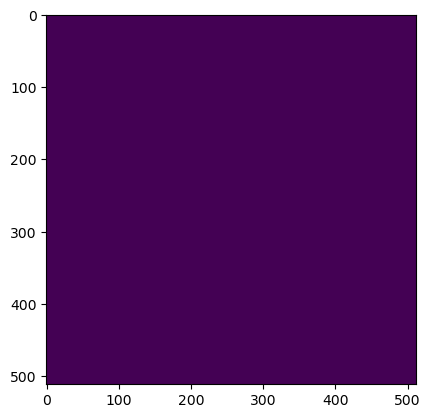

Wrote output/patches/mask/UU_S1_17-521680-0000-6267003-2000.tiff (512 x 512 pixels)


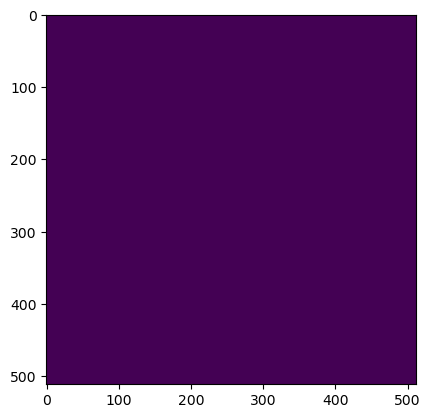

Wrote output/patches/mask/UU_S1_17-521680-0000-6267105-6000.tiff (512 x 512 pixels)


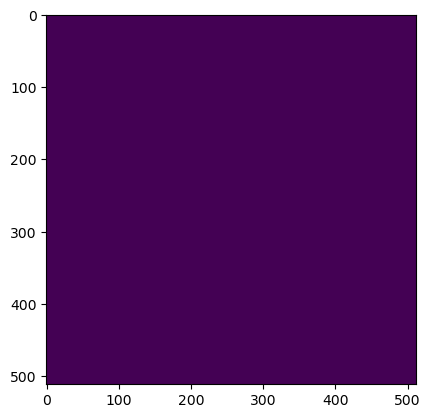

Wrote output/patches/mask/UU_S1_17-521782-4000-6266798-4000.tiff (512 x 512 pixels)


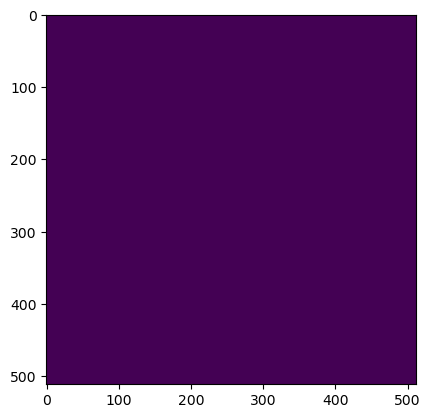

Wrote output/patches/mask/UU_S1_17-521782-4000-6266900-8000.tiff (512 x 512 pixels)


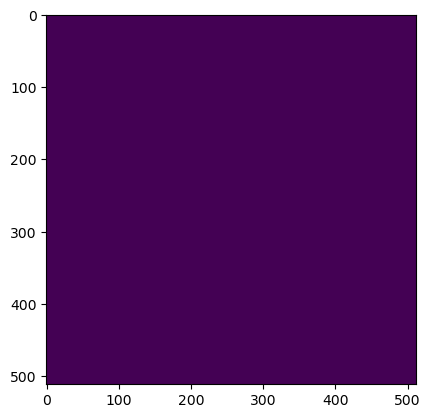

Wrote output/patches/mask/UU_S1_17-521782-4000-6267003-2000.tiff (512 x 512 pixels)


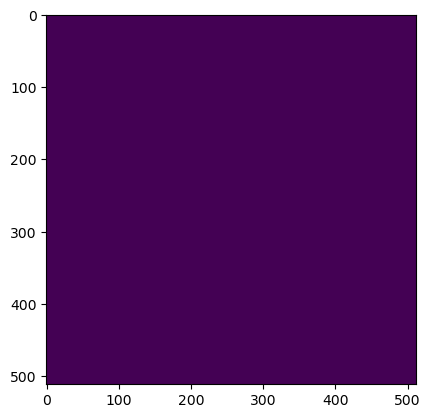

Wrote output/patches/mask/UU_S1_17-521782-4000-6267105-6000.tiff (512 x 512 pixels)


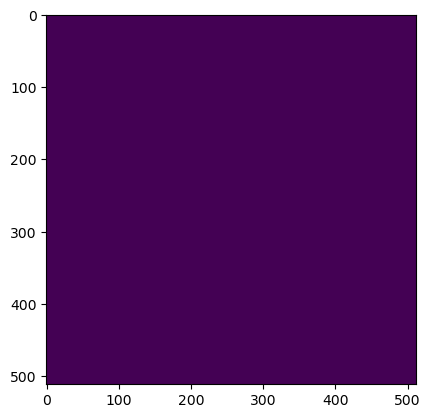

Wrote output/patches/mask/UU_S1_17-521884-8000-6266798-4000.tiff (512 x 512 pixels)


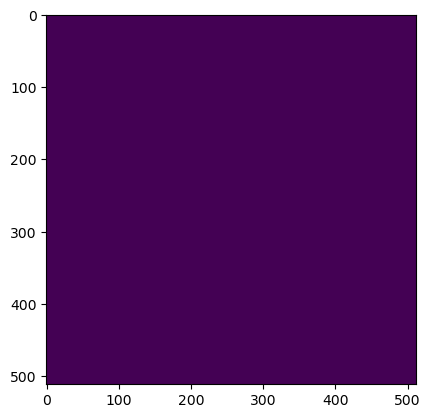

Wrote output/patches/mask/UU_S1_17-521884-8000-6266900-8000.tiff (512 x 512 pixels)


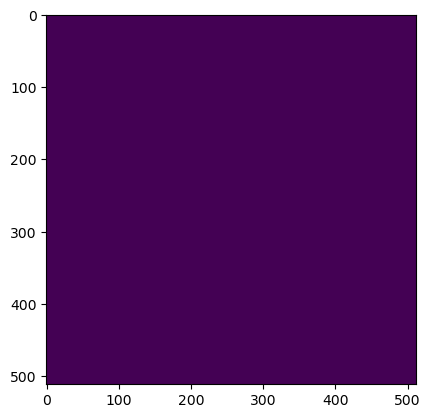

Wrote output/patches/mask/UU_S1_17-521884-8000-6267003-2000.tiff (512 x 512 pixels)


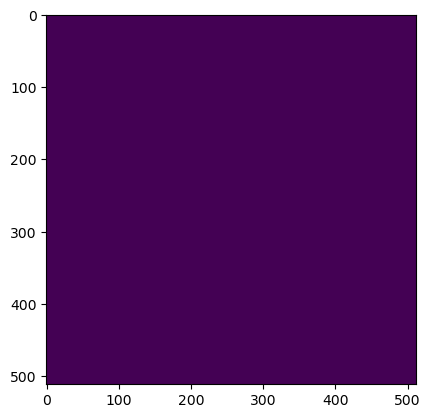

Wrote output/patches/mask/UU_S1_17-521884-8000-6267105-6000.tiff (512 x 512 pixels)


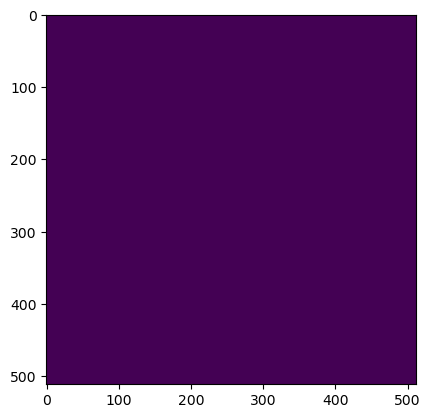

Wrote output/patches/mask/UU_S1_17-521987-2000-6266798-4000.tiff (512 x 512 pixels)


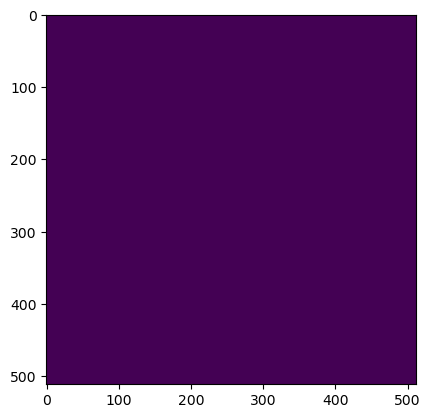

Wrote output/patches/mask/UU_S1_17-521987-2000-6266900-8000.tiff (512 x 512 pixels)


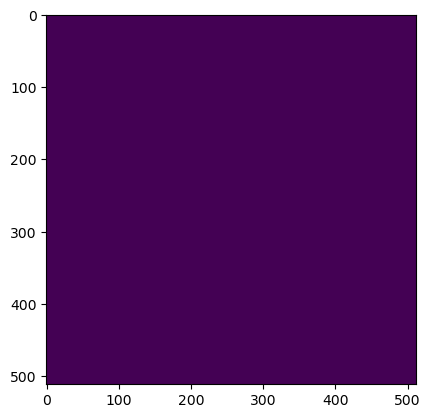

Wrote output/patches/mask/UU_S1_17-521987-2000-6267003-2000.tiff (512 x 512 pixels)


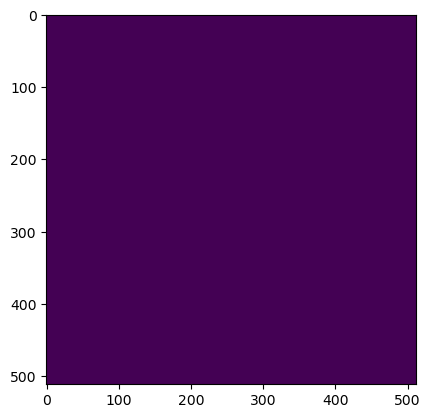

Wrote output/patches/mask/UU_S1_17-521987-2000-6267105-6000.tiff (512 x 512 pixels)
Zone UU_S1_18 Building Mask...


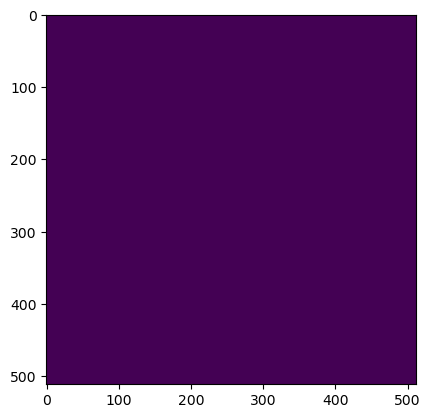

Wrote output/patches/mask/UU_S1_18-530896-0000-6267822-4000.tiff (512 x 512 pixels)


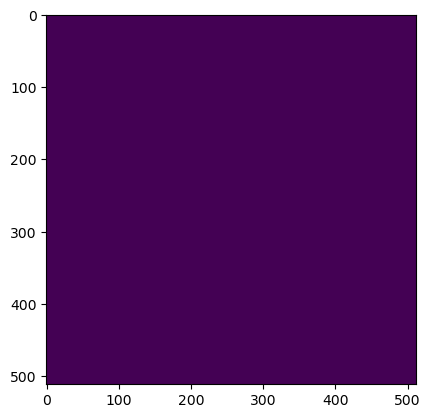

Wrote output/patches/mask/UU_S1_18-530896-0000-6267924-8000.tiff (512 x 512 pixels)


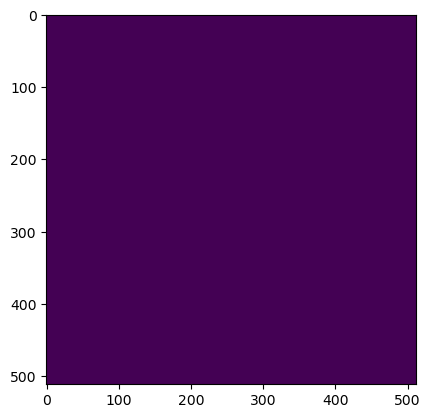

Wrote output/patches/mask/UU_S1_18-530896-0000-6268027-2000.tiff (512 x 512 pixels)


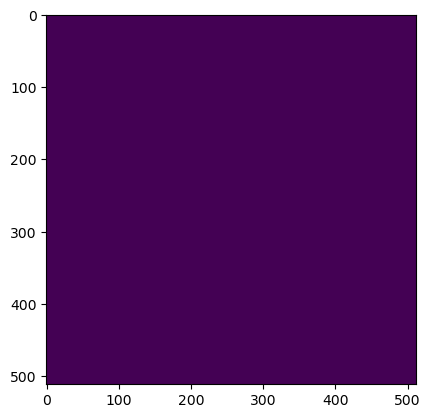

Wrote output/patches/mask/UU_S1_18-530896-0000-6268129-6000.tiff (512 x 512 pixels)


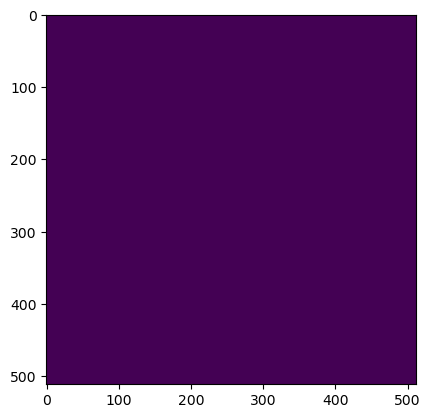

Wrote output/patches/mask/UU_S1_18-530998-4000-6267822-4000.tiff (512 x 512 pixels)


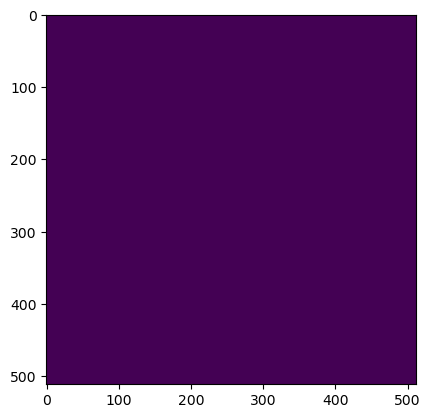

Wrote output/patches/mask/UU_S1_18-530998-4000-6267924-8000.tiff (512 x 512 pixels)


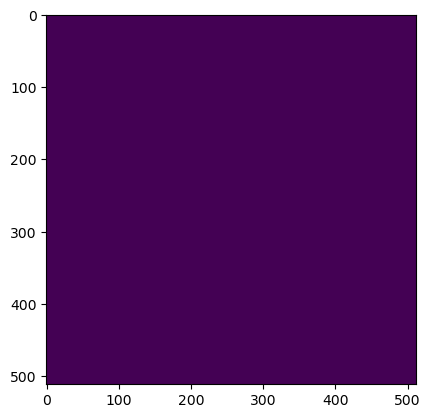

Wrote output/patches/mask/UU_S1_18-530998-4000-6268027-2000.tiff (512 x 512 pixels)


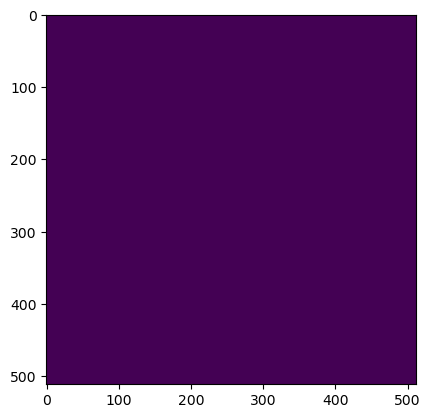

Wrote output/patches/mask/UU_S1_18-530998-4000-6268129-6000.tiff (512 x 512 pixels)
Zone UU_S1_19 Building Mask...


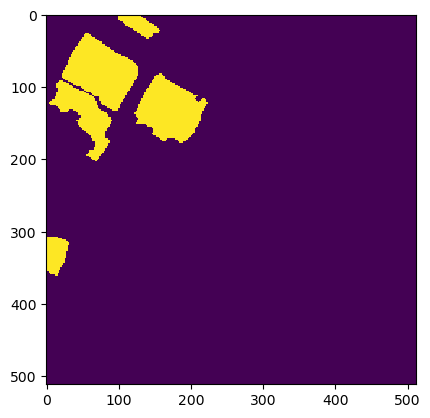

Wrote output/patches/mask/UU_S1_19-532176-0000-6268078-4000.tiff (512 x 512 pixels)


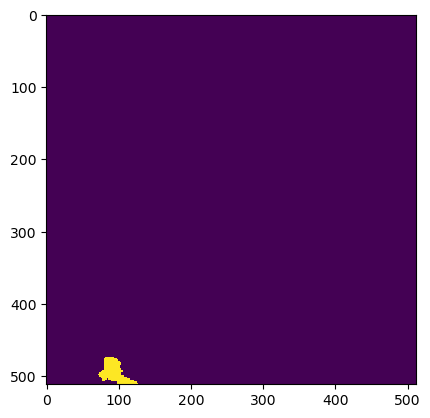

Wrote output/patches/mask/UU_S1_19-532176-0000-6268180-8000.tiff (512 x 512 pixels)


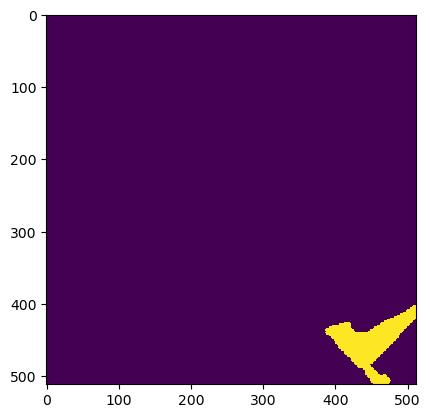

Wrote output/patches/mask/UU_S1_19-532278-4000-6268078-4000.tiff (512 x 512 pixels)


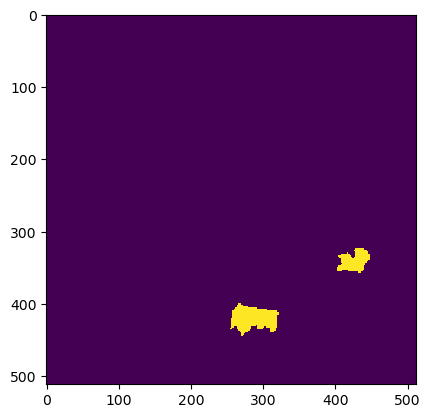

Wrote output/patches/mask/UU_S1_19-532278-4000-6268180-8000.tiff (512 x 512 pixels)
Zone VV_S1_20 Building Mask...


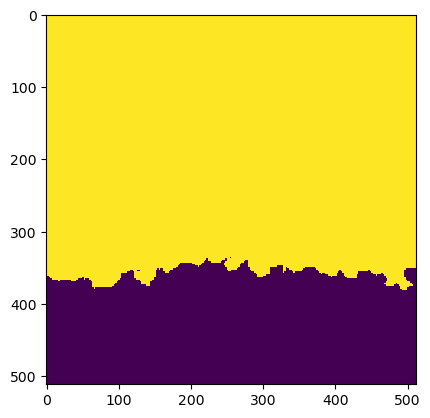

Wrote output/patches/mask/VV_S1_20-491216-0000-6269102-4000.tiff (512 x 512 pixels)


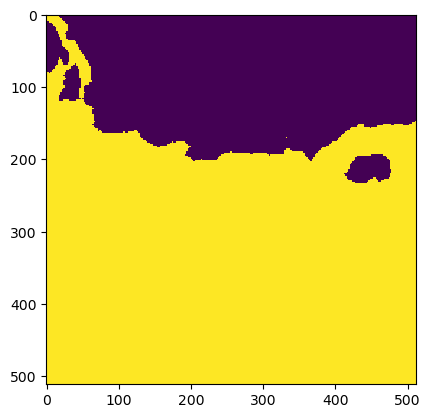

Wrote output/patches/mask/VV_S1_20-491216-0000-6269204-8000.tiff (512 x 512 pixels)


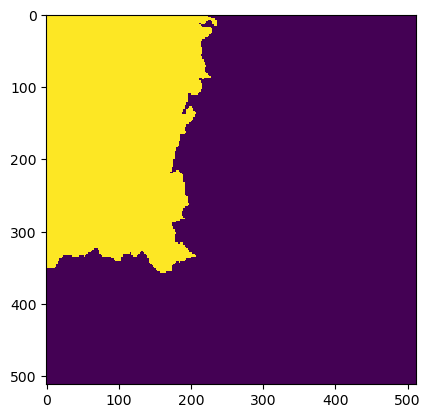

Wrote output/patches/mask/VV_S1_20-491318-4000-6269102-4000.tiff (512 x 512 pixels)


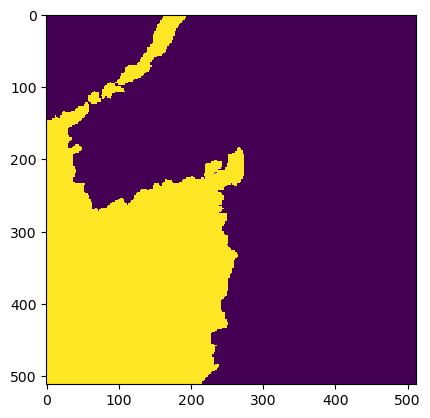

Wrote output/patches/mask/VV_S1_20-491318-4000-6269204-8000.tiff (512 x 512 pixels)
Zone CU_S1_21 Building Mask...


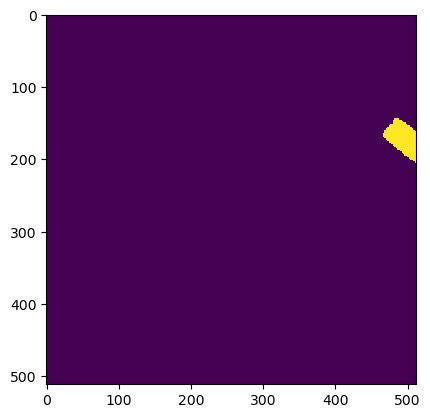

Wrote output/patches/mask/CU_S1_21-485584-0000-6270126-4000.tiff (512 x 512 pixels)


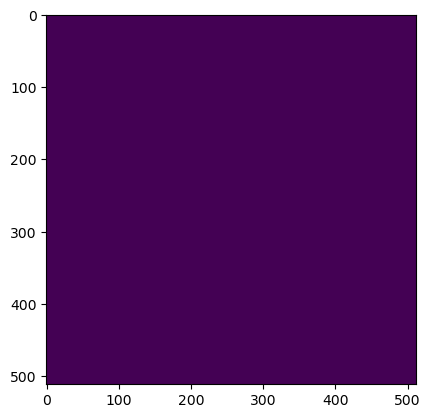

Wrote output/patches/mask/CU_S1_21-485584-0000-6270228-8000.tiff (512 x 512 pixels)


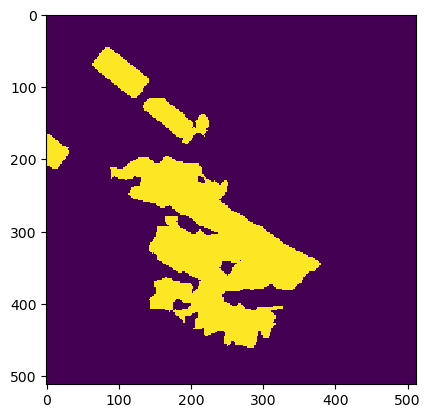

Wrote output/patches/mask/CU_S1_21-485686-4000-6270126-4000.tiff (512 x 512 pixels)


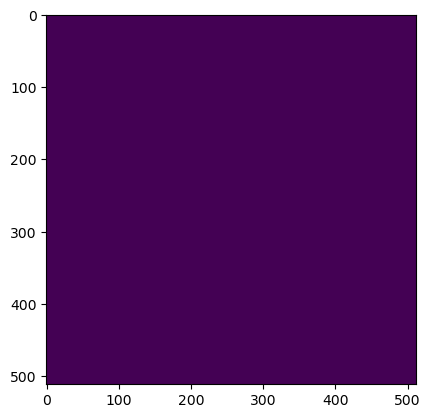

Wrote output/patches/mask/CU_S1_21-485686-4000-6270228-8000.tiff (512 x 512 pixels)
Zone UU_S1_22 Building Mask...


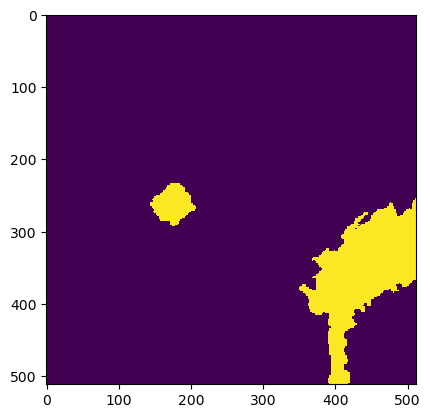

Wrote output/patches/mask/UU_S1_22-533456-0000-6270894-4000.tiff (512 x 512 pixels)


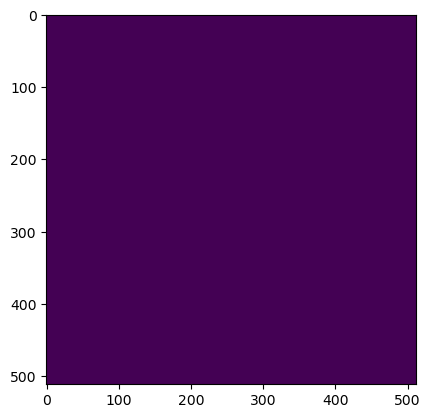

Wrote output/patches/mask/UU_S1_22-533456-0000-6270996-8000.tiff (512 x 512 pixels)


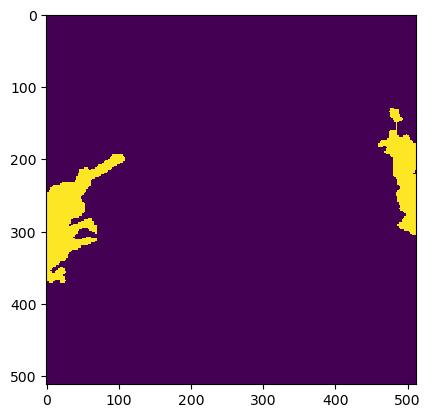

Wrote output/patches/mask/UU_S1_22-533558-4000-6270894-4000.tiff (512 x 512 pixels)


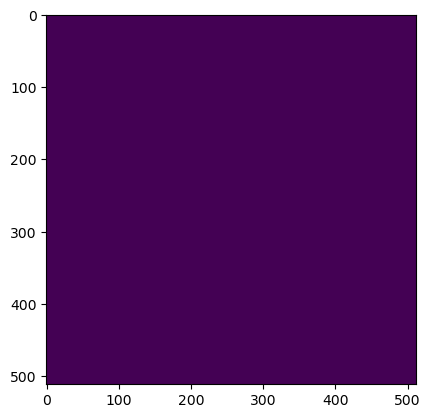

Wrote output/patches/mask/UU_S1_22-533558-4000-6270996-8000.tiff (512 x 512 pixels)
Zone CC_S1_23 Building Mask...


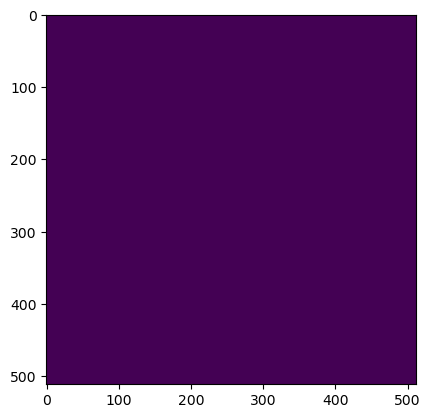

Wrote output/patches/mask/CC_S1_23-468176-0000-6270894-4000.tiff (512 x 512 pixels)


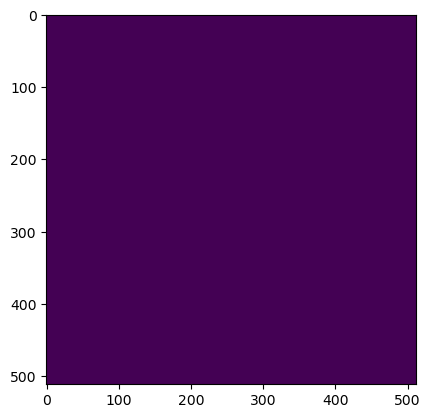

Wrote output/patches/mask/CC_S1_23-468176-0000-6270996-8000.tiff (512 x 512 pixels)


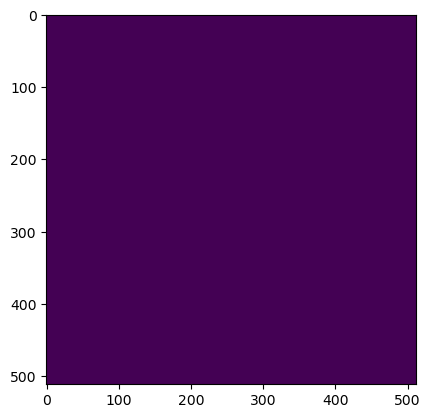

Wrote output/patches/mask/CC_S1_23-468176-0000-6271099-2000.tiff (512 x 512 pixels)


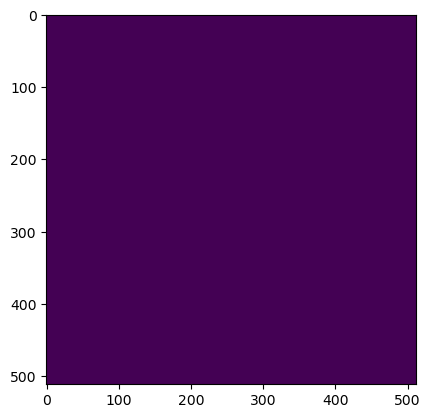

Wrote output/patches/mask/CC_S1_23-468176-0000-6271201-6000.tiff (512 x 512 pixels)


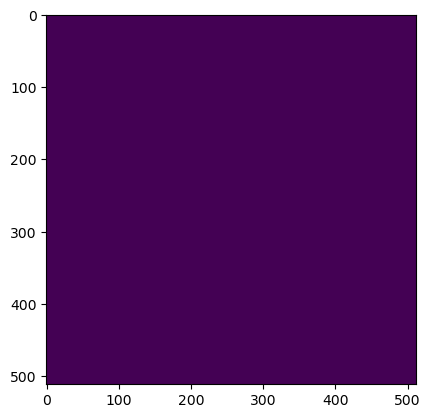

Wrote output/patches/mask/CC_S1_23-468176-0000-6271304-0000.tiff (512 x 512 pixels)


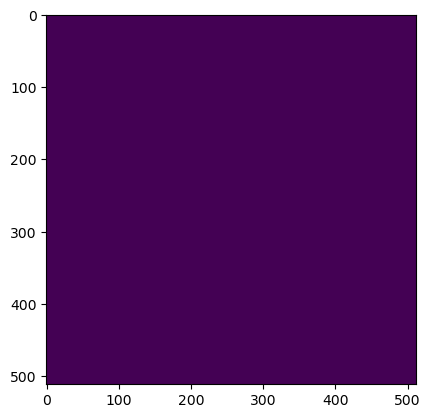

Wrote output/patches/mask/CC_S1_23-468176-0000-6271406-4000.tiff (512 x 512 pixels)


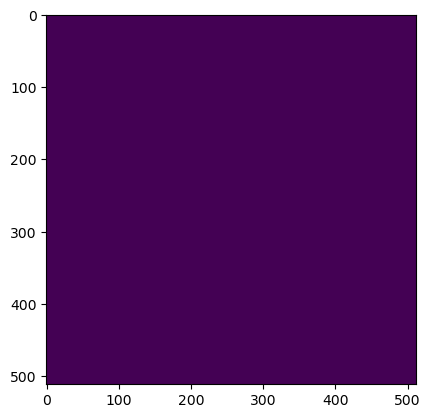

Wrote output/patches/mask/CC_S1_23-468176-0000-6271508-8000.tiff (512 x 512 pixels)


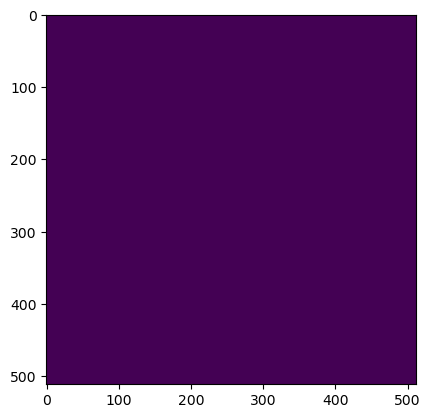

Wrote output/patches/mask/CC_S1_23-468278-4000-6270894-4000.tiff (512 x 512 pixels)


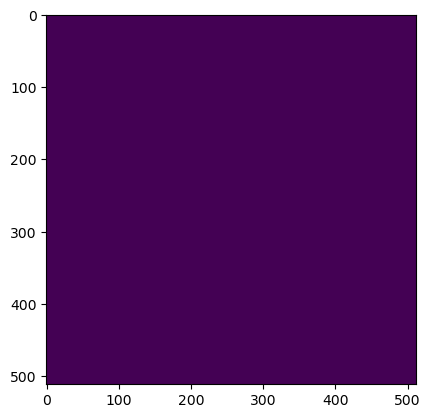

Wrote output/patches/mask/CC_S1_23-468278-4000-6270996-8000.tiff (512 x 512 pixels)


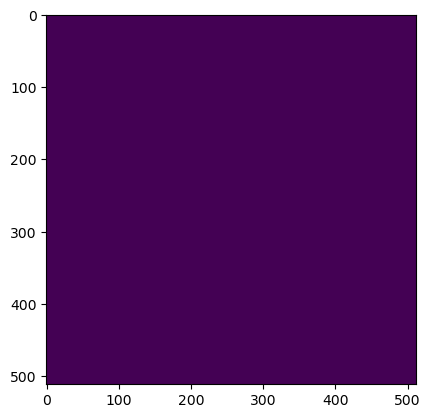

Wrote output/patches/mask/CC_S1_23-468278-4000-6271099-2000.tiff (512 x 512 pixels)


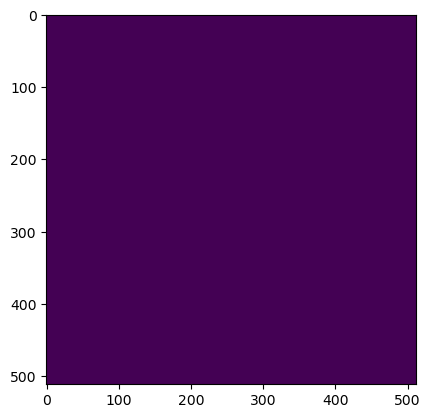

Wrote output/patches/mask/CC_S1_23-468278-4000-6271201-6000.tiff (512 x 512 pixels)


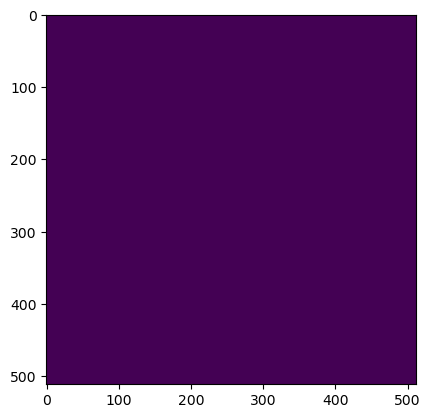

Wrote output/patches/mask/CC_S1_23-468278-4000-6271304-0000.tiff (512 x 512 pixels)


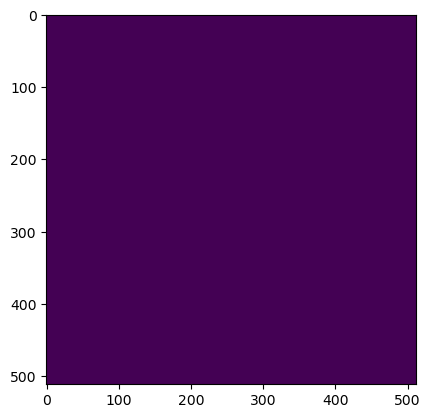

Wrote output/patches/mask/CC_S1_23-468278-4000-6271406-4000.tiff (512 x 512 pixels)


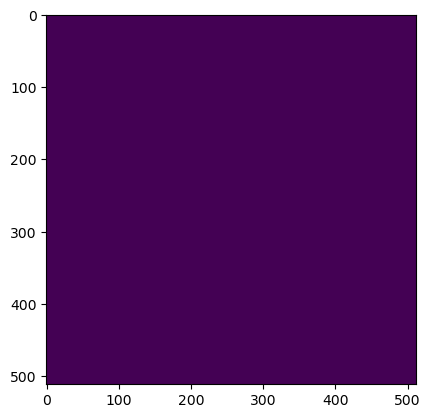

Wrote output/patches/mask/CC_S1_23-468278-4000-6271508-8000.tiff (512 x 512 pixels)
Zone CU_S1_24 Building Mask...


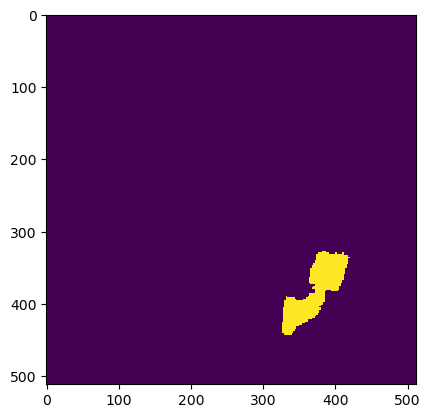

Wrote output/patches/mask/CU_S1_24-481488-0000-6271918-4000.tiff (512 x 512 pixels)


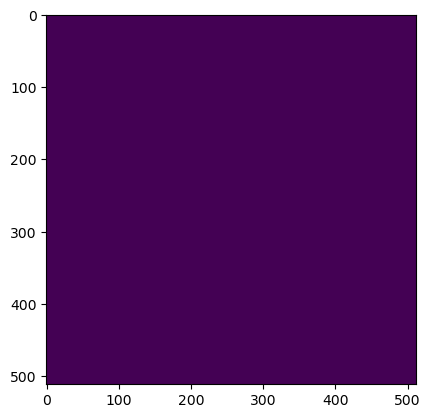

Wrote output/patches/mask/CU_S1_24-481488-0000-6272020-8000.tiff (512 x 512 pixels)


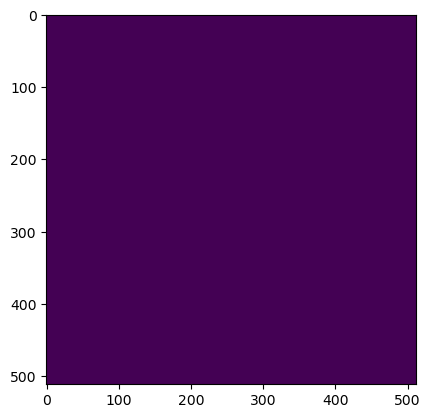

Wrote output/patches/mask/CU_S1_24-481590-4000-6271918-4000.tiff (512 x 512 pixels)


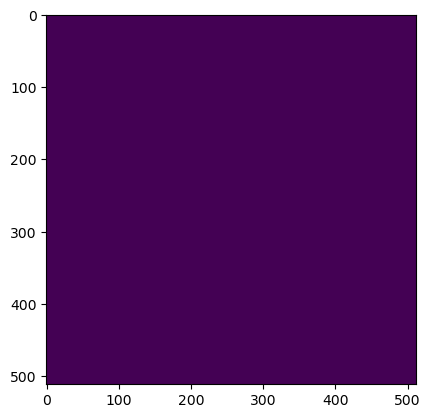

Wrote output/patches/mask/CU_S1_24-481590-4000-6272020-8000.tiff (512 x 512 pixels)
Zone VV_S1_25 Building Mask...


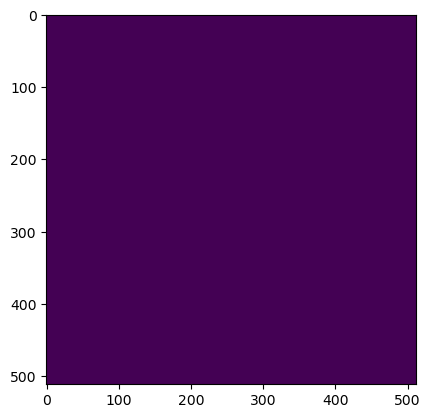

Wrote output/patches/mask/VV_S1_25-507856-0000-6272686-4000.tiff (512 x 512 pixels)


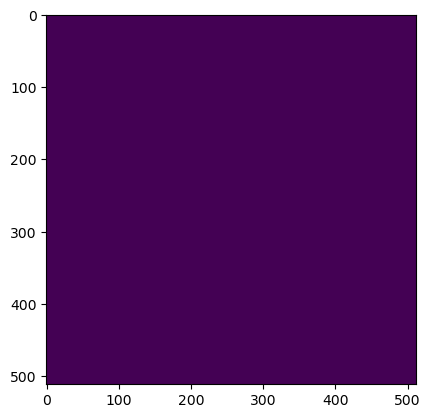

Wrote output/patches/mask/VV_S1_25-507856-0000-6272788-8000.tiff (512 x 512 pixels)


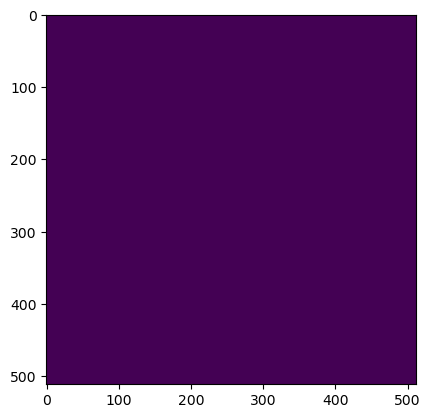

Wrote output/patches/mask/VV_S1_25-507856-0000-6272891-2000.tiff (512 x 512 pixels)


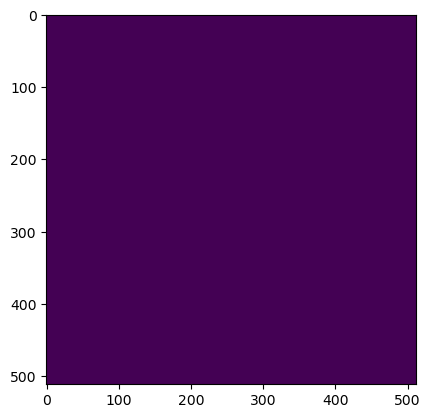

Wrote output/patches/mask/VV_S1_25-507856-0000-6272993-6000.tiff (512 x 512 pixels)


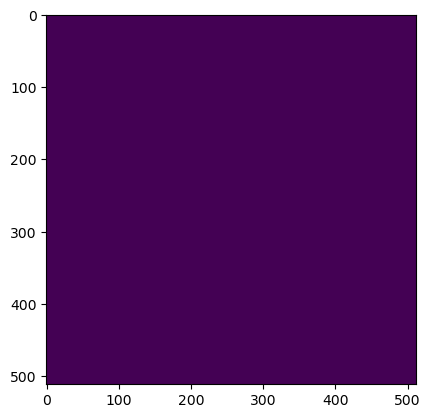

Wrote output/patches/mask/VV_S1_25-507958-4000-6272686-4000.tiff (512 x 512 pixels)


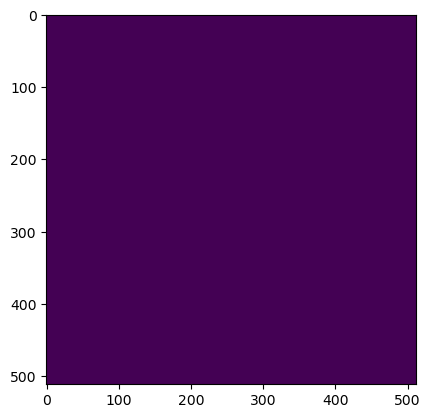

Wrote output/patches/mask/VV_S1_25-507958-4000-6272788-8000.tiff (512 x 512 pixels)


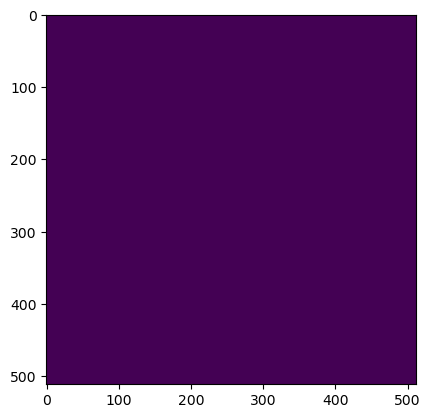

Wrote output/patches/mask/VV_S1_25-507958-4000-6272891-2000.tiff (512 x 512 pixels)


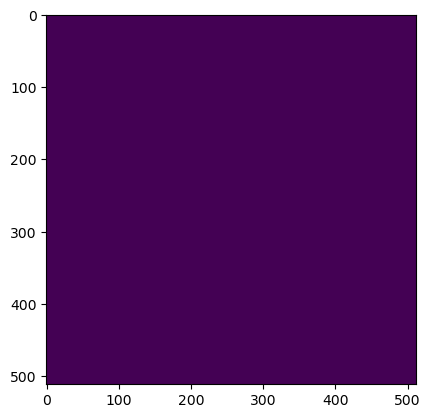

Wrote output/patches/mask/VV_S1_25-507958-4000-6272993-6000.tiff (512 x 512 pixels)


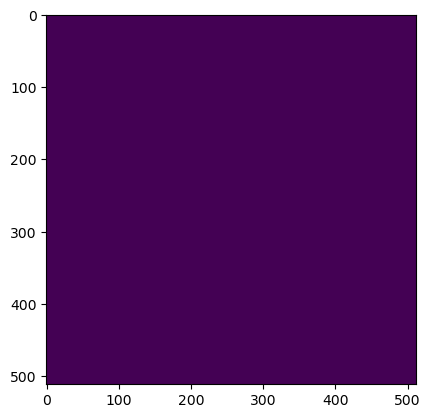

Wrote output/patches/mask/VV_S1_25-508060-8000-6272686-4000.tiff (512 x 512 pixels)


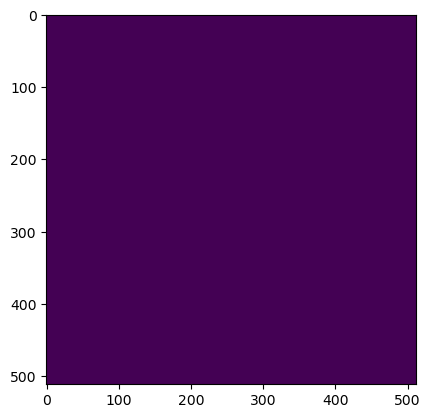

Wrote output/patches/mask/VV_S1_25-508060-8000-6272788-8000.tiff (512 x 512 pixels)


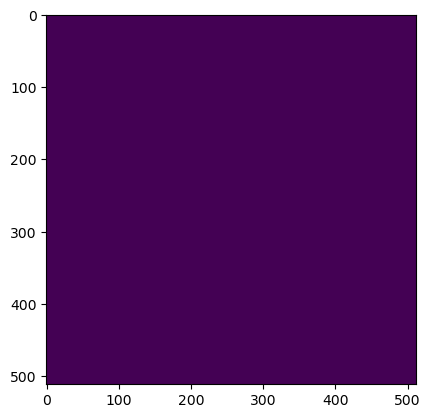

Wrote output/patches/mask/VV_S1_25-508060-8000-6272891-2000.tiff (512 x 512 pixels)


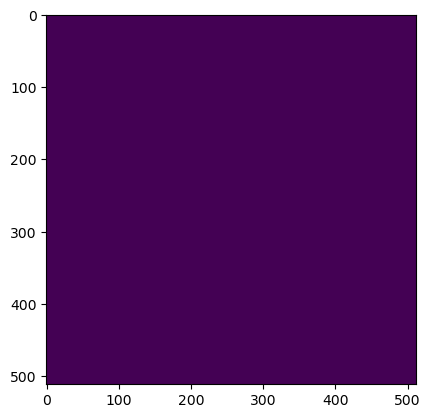

Wrote output/patches/mask/VV_S1_25-508060-8000-6272993-6000.tiff (512 x 512 pixels)


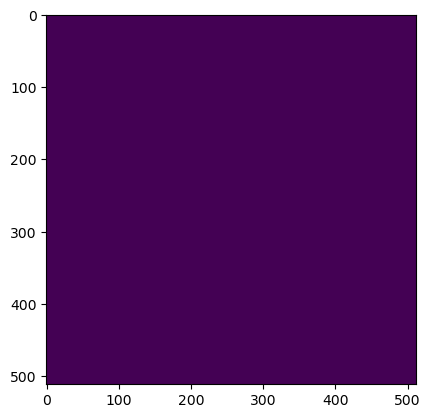

Wrote output/patches/mask/VV_S1_25-508163-2000-6272686-4000.tiff (512 x 512 pixels)


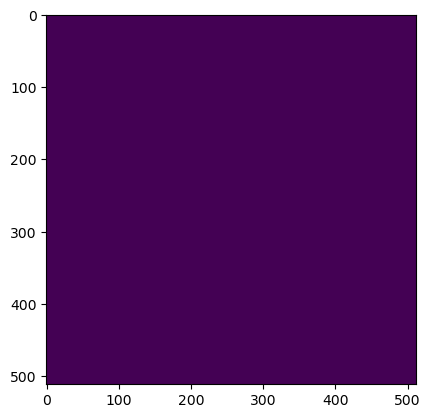

Wrote output/patches/mask/VV_S1_25-508163-2000-6272788-8000.tiff (512 x 512 pixels)


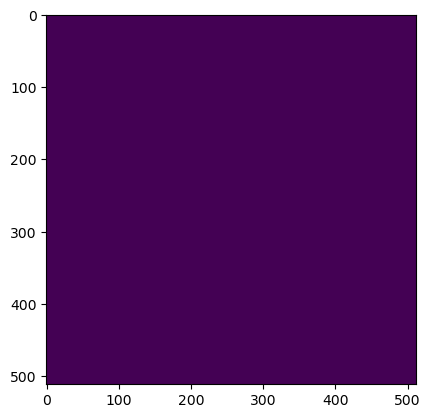

Wrote output/patches/mask/VV_S1_25-508163-2000-6272891-2000.tiff (512 x 512 pixels)


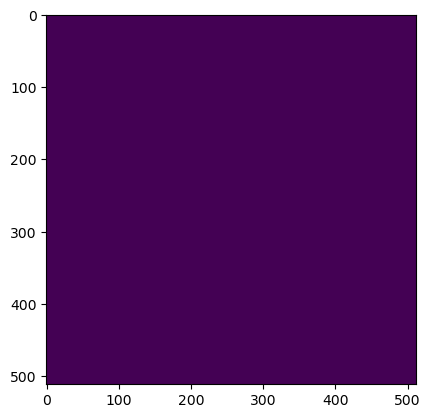

Wrote output/patches/mask/VV_S1_25-508163-2000-6272993-6000.tiff (512 x 512 pixels)
Zone UC_S1_26 Building Mask...


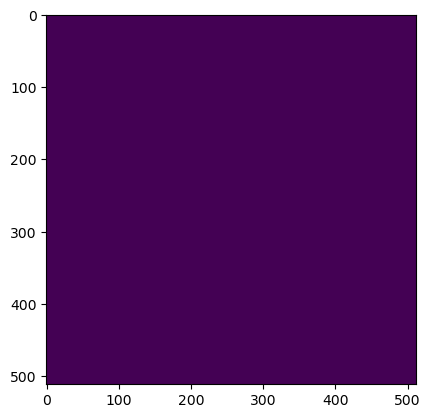

Wrote output/patches/mask/UC_S1_26-518352-0000-6271406-4000.tiff (512 x 512 pixels)


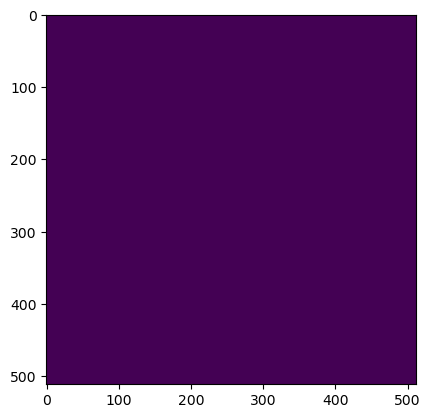

Wrote output/patches/mask/UC_S1_26-518352-0000-6271508-8000.tiff (512 x 512 pixels)


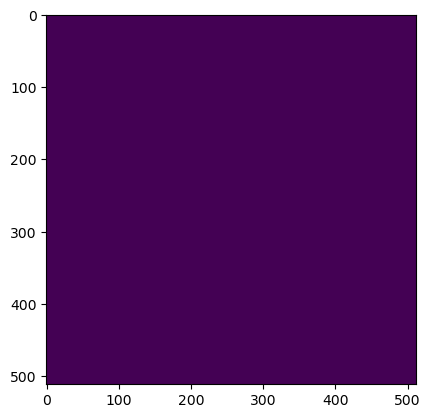

Wrote output/patches/mask/UC_S1_26-518454-4000-6271406-4000.tiff (512 x 512 pixels)


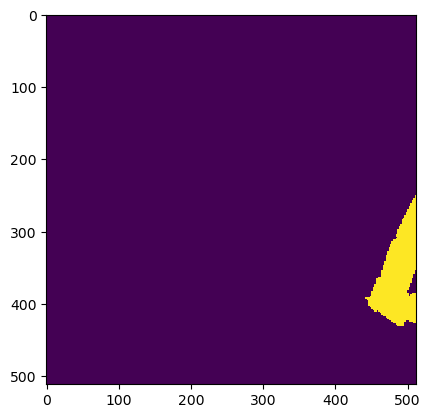

Wrote output/patches/mask/UC_S1_26-518454-4000-6271508-8000.tiff (512 x 512 pixels)
Zone UC_S1_27 Building Mask...


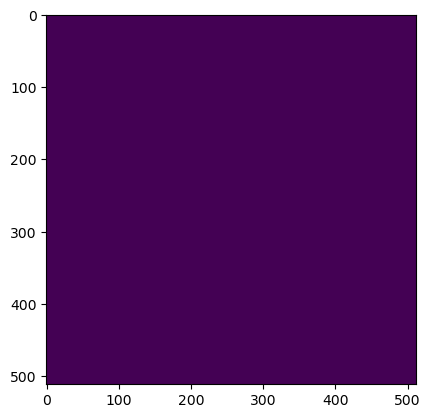

Wrote output/patches/mask/UC_S1_27-479696-0000-6271662-4000.tiff (512 x 512 pixels)


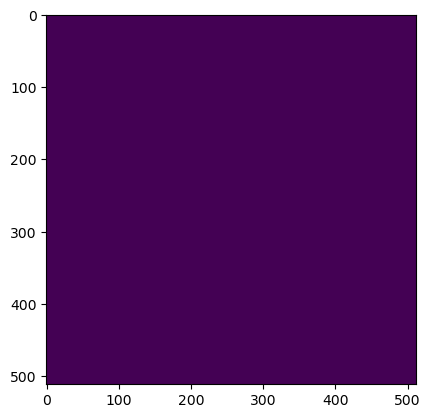

Wrote output/patches/mask/UC_S1_27-479696-0000-6271764-8000.tiff (512 x 512 pixels)


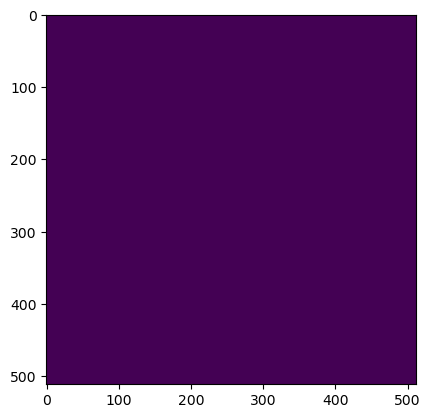

Wrote output/patches/mask/UC_S1_27-479696-0000-6271867-2000.tiff (512 x 512 pixels)


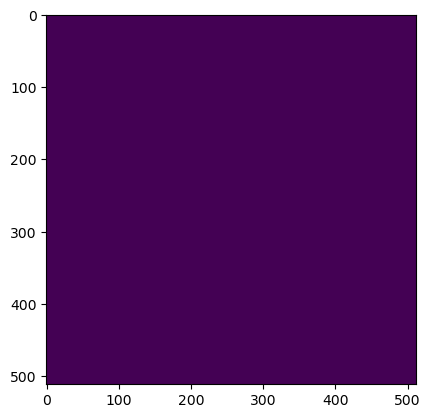

Wrote output/patches/mask/UC_S1_27-479696-0000-6271969-6000.tiff (512 x 512 pixels)


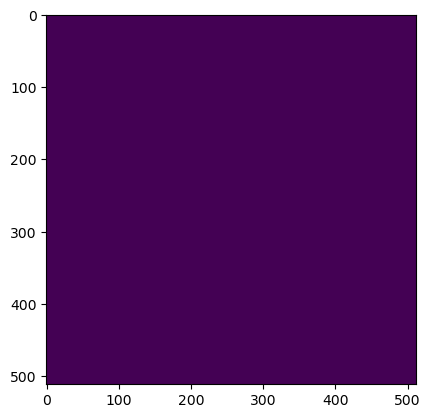

Wrote output/patches/mask/UC_S1_27-479798-4000-6271662-4000.tiff (512 x 512 pixels)


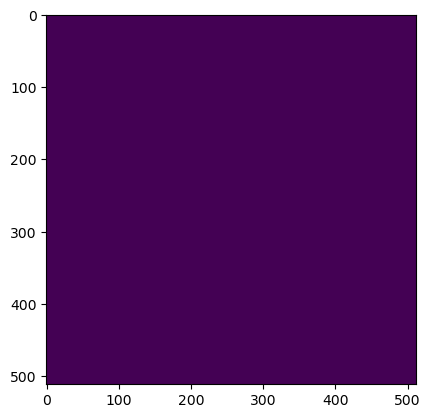

Wrote output/patches/mask/UC_S1_27-479798-4000-6271764-8000.tiff (512 x 512 pixels)


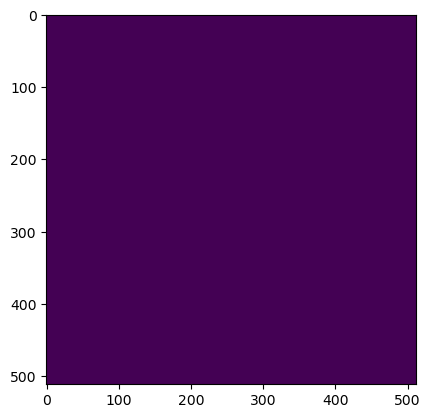

Wrote output/patches/mask/UC_S1_27-479798-4000-6271867-2000.tiff (512 x 512 pixels)


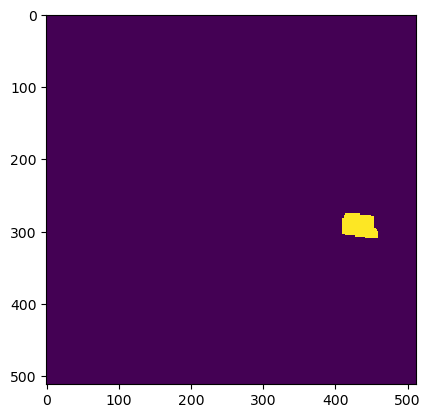

Wrote output/patches/mask/UC_S1_27-479798-4000-6271969-6000.tiff (512 x 512 pixels)


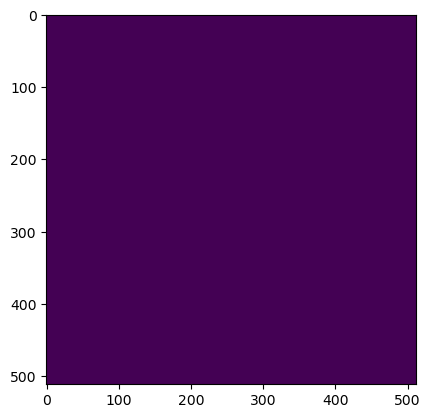

Wrote output/patches/mask/UC_S1_27-479900-8000-6271662-4000.tiff (512 x 512 pixels)


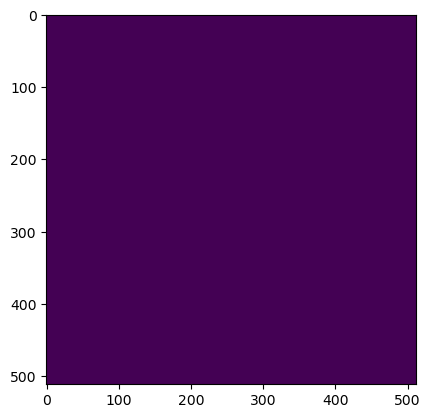

Wrote output/patches/mask/UC_S1_27-479900-8000-6271764-8000.tiff (512 x 512 pixels)


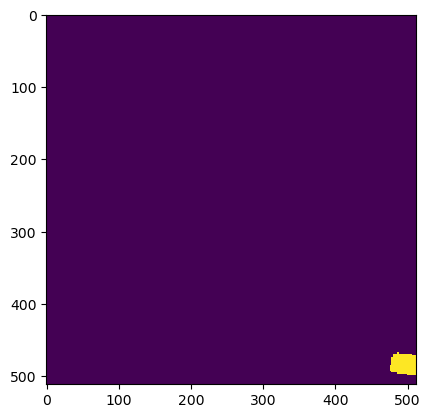

Wrote output/patches/mask/UC_S1_27-479900-8000-6271867-2000.tiff (512 x 512 pixels)


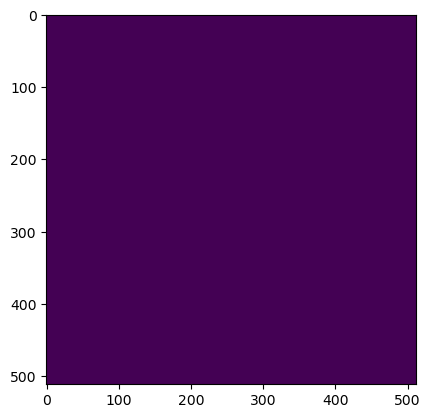

Wrote output/patches/mask/UC_S1_27-479900-8000-6271969-6000.tiff (512 x 512 pixels)


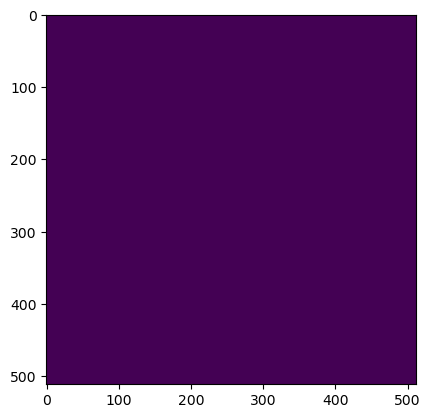

Wrote output/patches/mask/UC_S1_27-480003-2000-6271662-4000.tiff (512 x 512 pixels)


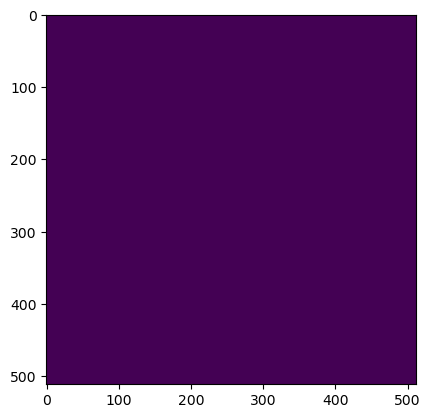

Wrote output/patches/mask/UC_S1_27-480003-2000-6271764-8000.tiff (512 x 512 pixels)


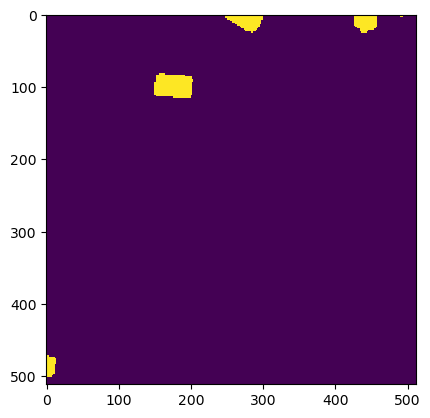

Wrote output/patches/mask/UC_S1_27-480003-2000-6271867-2000.tiff (512 x 512 pixels)


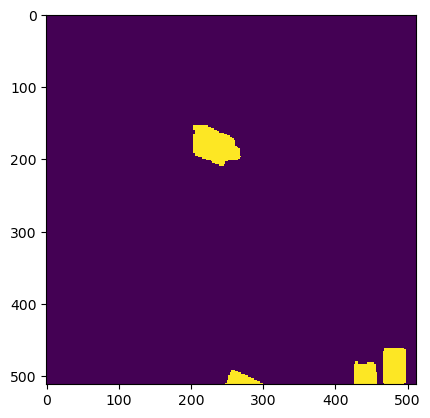

Wrote output/patches/mask/UC_S1_27-480003-2000-6271969-6000.tiff (512 x 512 pixels)
Zone VV_S1_28 Building Mask...


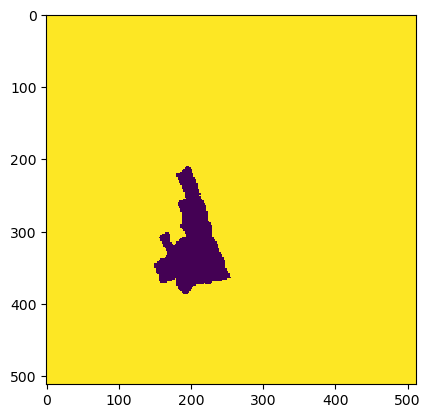

Wrote output/patches/mask/VV_S1_28-466896-0000-6273198-4000.tiff (512 x 512 pixels)


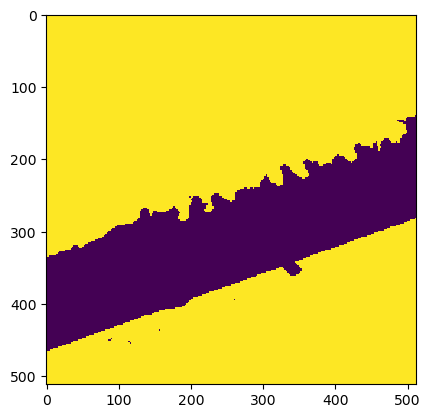

Wrote output/patches/mask/VV_S1_28-466896-0000-6273300-8000.tiff (512 x 512 pixels)


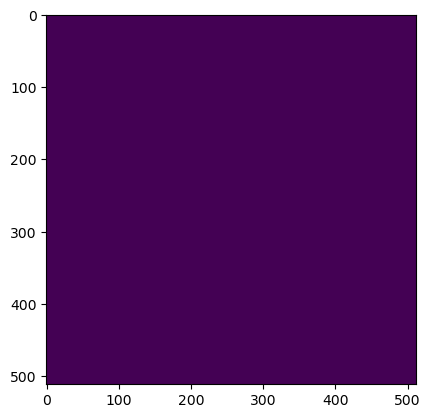

Wrote output/patches/mask/VV_S1_28-466998-4000-6273198-4000.tiff (512 x 512 pixels)


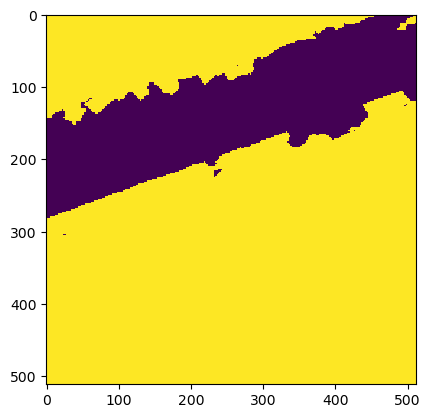

Wrote output/patches/mask/VV_S1_28-466998-4000-6273300-8000.tiff (512 x 512 pixels)
Zone UU_S1_29 Building Mask...


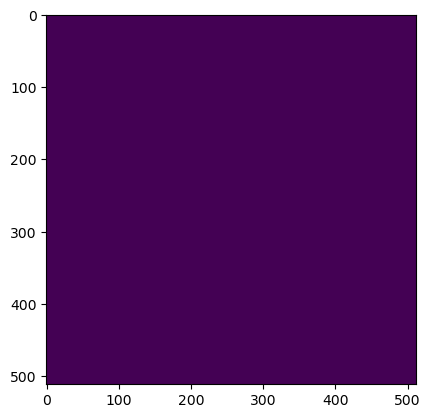

Wrote output/patches/mask/UU_S1_29-516048-0000-6273710-4000.tiff (512 x 512 pixels)


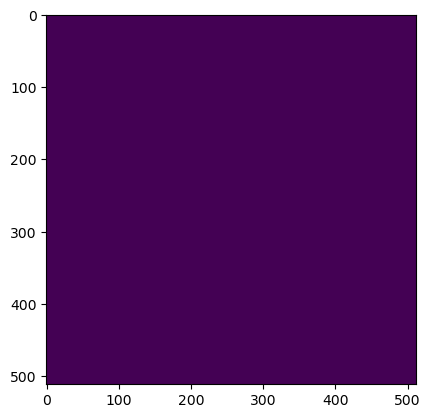

Wrote output/patches/mask/UU_S1_29-516048-0000-6273812-8000.tiff (512 x 512 pixels)


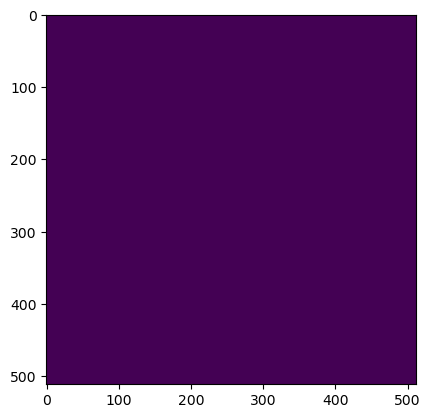

Wrote output/patches/mask/UU_S1_29-516150-4000-6273710-4000.tiff (512 x 512 pixels)


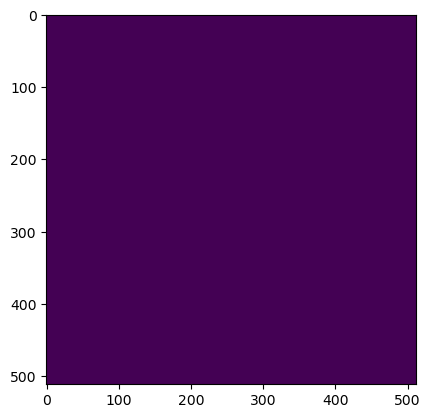

Wrote output/patches/mask/UU_S1_29-516150-4000-6273812-8000.tiff (512 x 512 pixels)
Zone VC_S1_30 Building Mask...


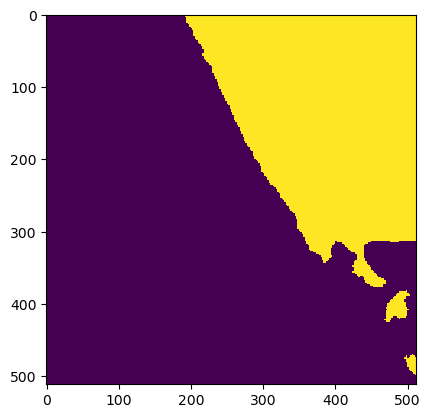

Wrote output/patches/mask/VC_S1_30-478416-0000-6274734-4000.tiff (512 x 512 pixels)


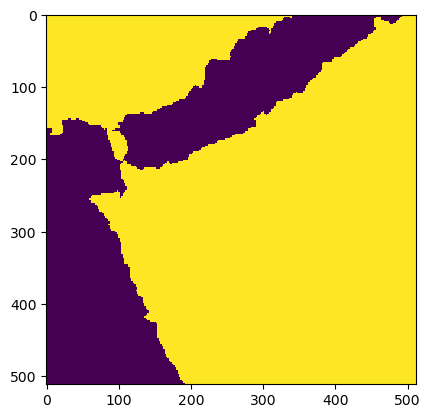

Wrote output/patches/mask/VC_S1_30-478416-0000-6274836-8000.tiff (512 x 512 pixels)


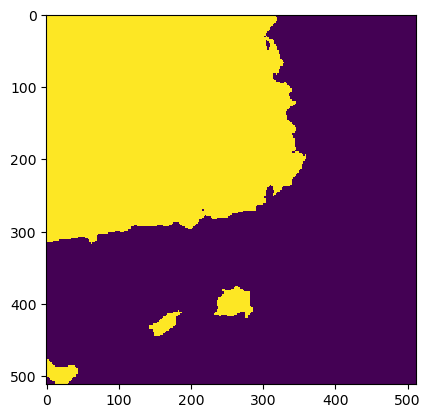

Wrote output/patches/mask/VC_S1_30-478518-4000-6274734-4000.tiff (512 x 512 pixels)


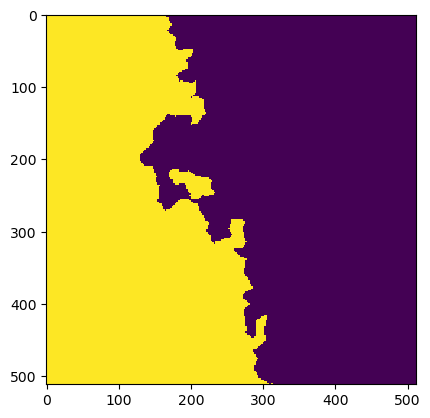

Wrote output/patches/mask/VC_S1_30-478518-4000-6274836-8000.tiff (512 x 512 pixels)
Zone UU_S1_31 Building Mask...


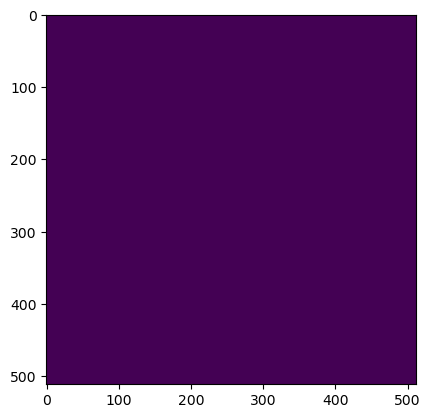

Wrote output/patches/mask/UU_S1_31-549584-0000-6275246-4000.tiff (512 x 512 pixels)


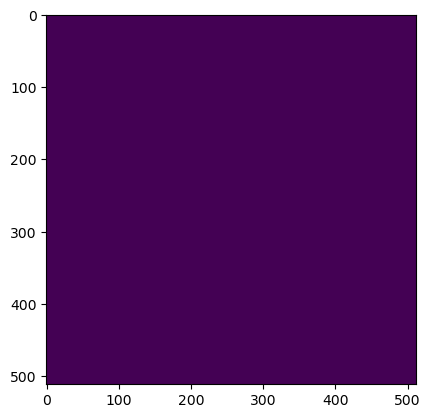

Wrote output/patches/mask/UU_S1_31-549584-0000-6275348-8000.tiff (512 x 512 pixels)


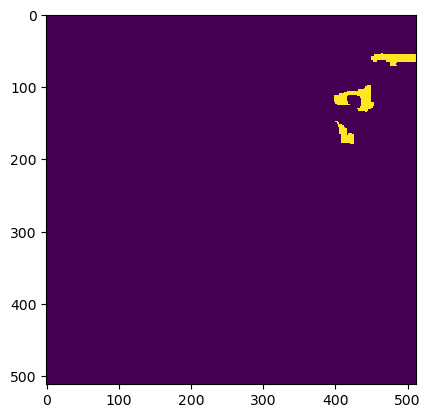

Wrote output/patches/mask/UU_S1_31-549584-0000-6275451-2000.tiff (512 x 512 pixels)


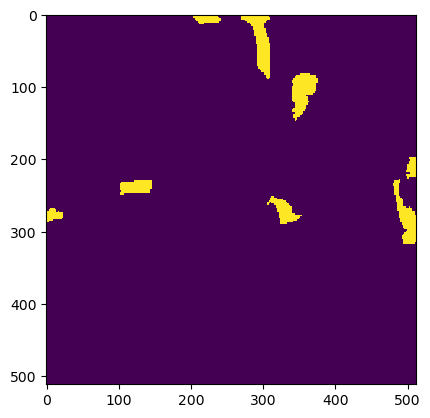

Wrote output/patches/mask/UU_S1_31-549584-0000-6275553-6000.tiff (512 x 512 pixels)


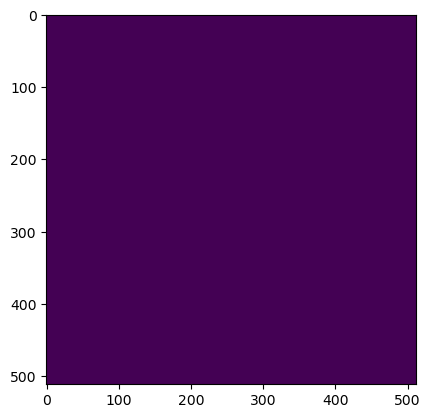

Wrote output/patches/mask/UU_S1_31-549686-4000-6275246-4000.tiff (512 x 512 pixels)


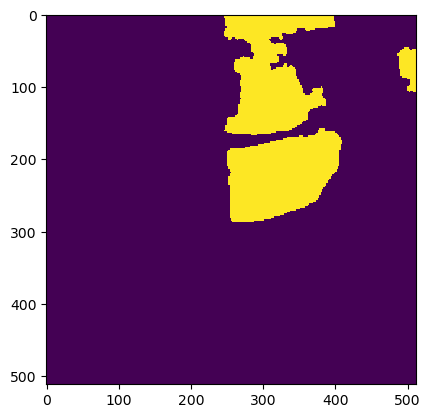

Wrote output/patches/mask/UU_S1_31-549686-4000-6275348-8000.tiff (512 x 512 pixels)


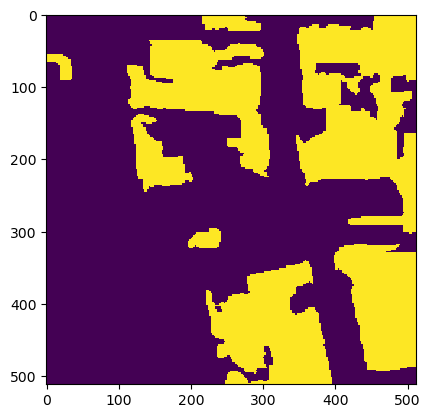

Wrote output/patches/mask/UU_S1_31-549686-4000-6275451-2000.tiff (512 x 512 pixels)


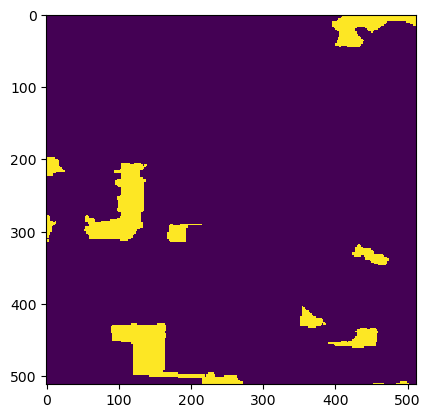

Wrote output/patches/mask/UU_S1_31-549686-4000-6275553-6000.tiff (512 x 512 pixels)


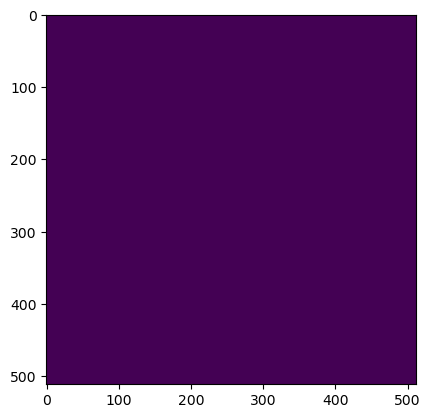

Wrote output/patches/mask/UU_S1_31-549788-8000-6275246-4000.tiff (512 x 512 pixels)


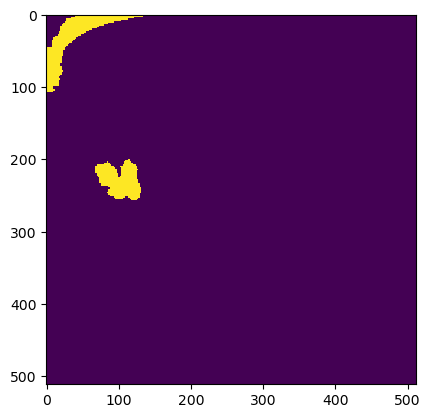

Wrote output/patches/mask/UU_S1_31-549788-8000-6275348-8000.tiff (512 x 512 pixels)


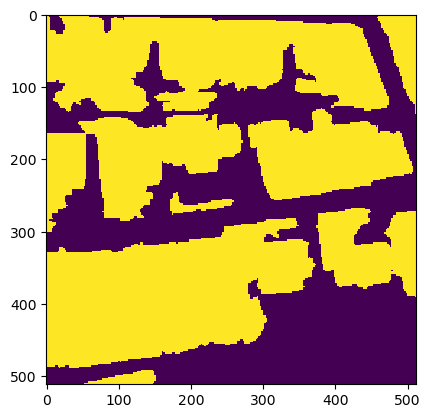

Wrote output/patches/mask/UU_S1_31-549788-8000-6275451-2000.tiff (512 x 512 pixels)


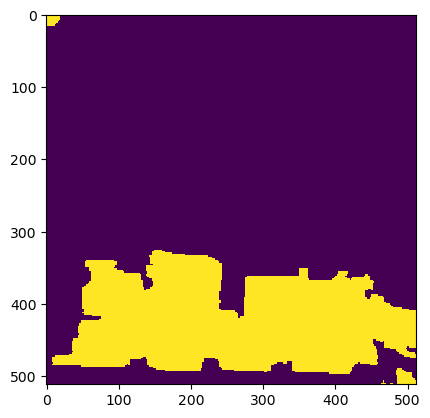

Wrote output/patches/mask/UU_S1_31-549788-8000-6275553-6000.tiff (512 x 512 pixels)


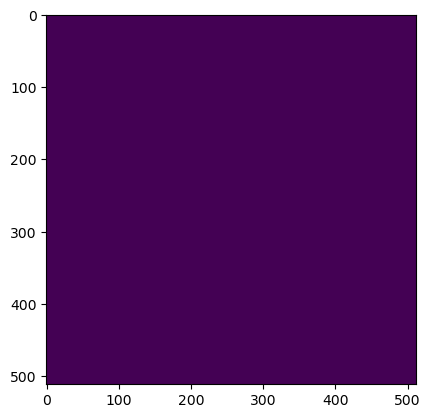

Wrote output/patches/mask/UU_S1_31-549891-2000-6275246-4000.tiff (512 x 512 pixels)


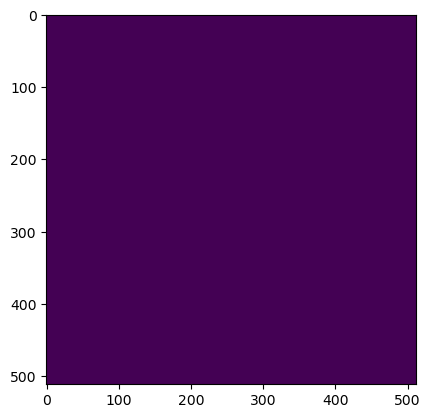

Wrote output/patches/mask/UU_S1_31-549891-2000-6275348-8000.tiff (512 x 512 pixels)


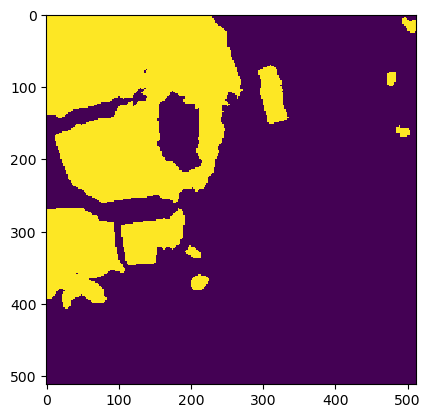

Wrote output/patches/mask/UU_S1_31-549891-2000-6275451-2000.tiff (512 x 512 pixels)


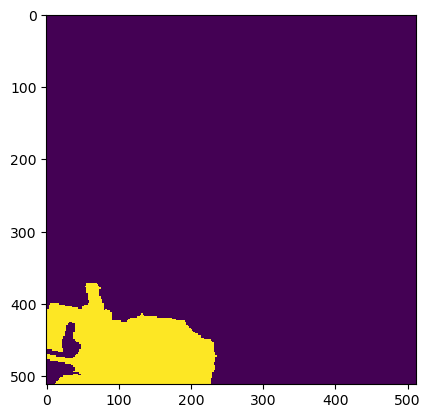

Wrote output/patches/mask/UU_S1_31-549891-2000-6275553-6000.tiff (512 x 512 pixels)
Zone UC_S1_32 Building Mask...


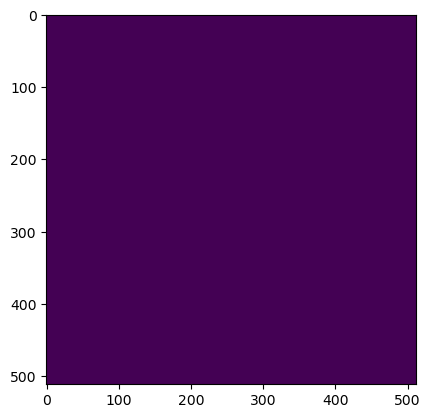

Wrote output/patches/mask/UC_S1_32-543184-0000-6275758-4000.tiff (512 x 512 pixels)


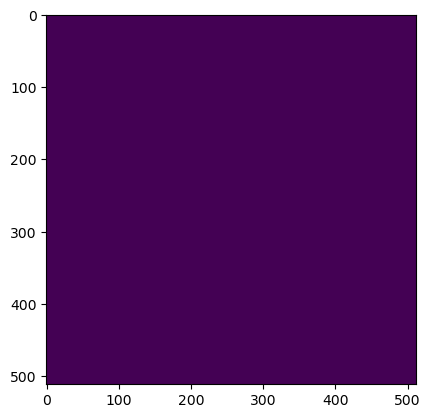

Wrote output/patches/mask/UC_S1_32-543184-0000-6275860-8000.tiff (512 x 512 pixels)


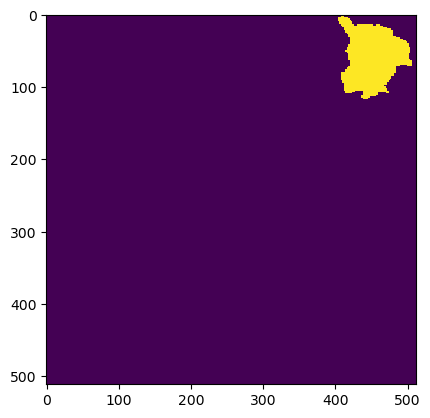

Wrote output/patches/mask/UC_S1_32-543286-4000-6275758-4000.tiff (512 x 512 pixels)


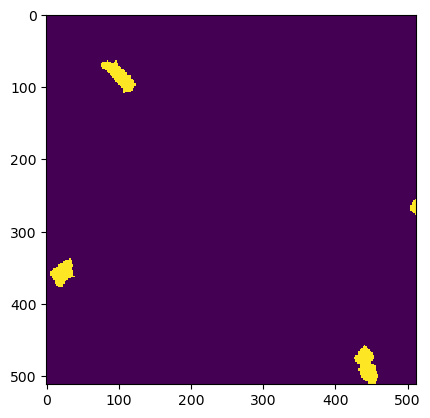

Wrote output/patches/mask/UC_S1_32-543286-4000-6275860-8000.tiff (512 x 512 pixels)


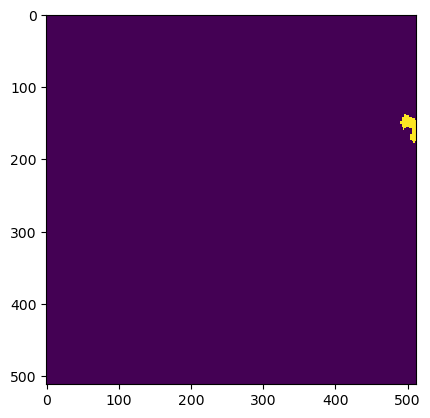

Wrote output/patches/mask/UC_S1_32-543388-8000-6275758-4000.tiff (512 x 512 pixels)


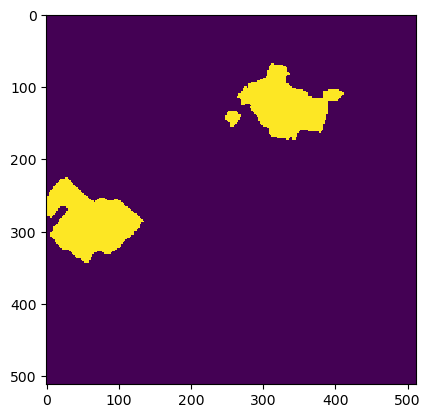

Wrote output/patches/mask/UC_S1_32-543388-8000-6275860-8000.tiff (512 x 512 pixels)


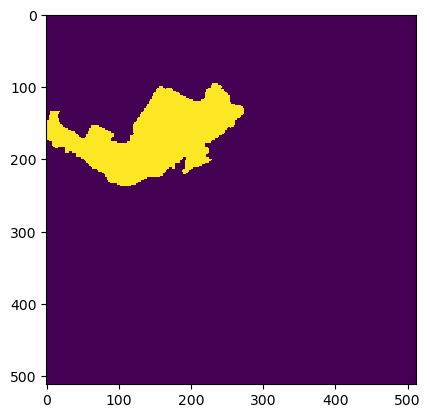

Wrote output/patches/mask/UC_S1_32-543491-2000-6275758-4000.tiff (512 x 512 pixels)


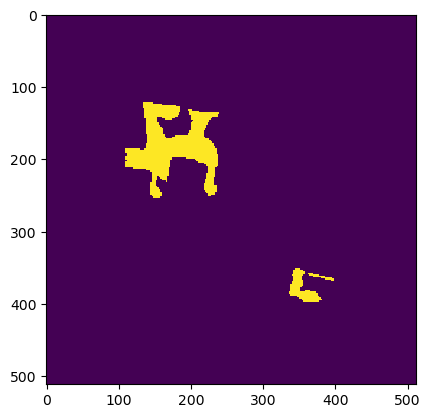

Wrote output/patches/mask/UC_S1_32-543491-2000-6275860-8000.tiff (512 x 512 pixels)
Zone UC_S1_33 Building Mask...


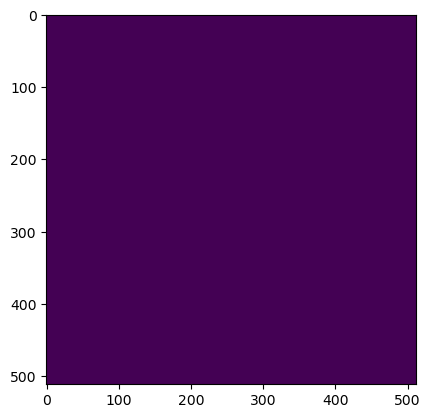

Wrote output/patches/mask/UC_S1_33-542160-0000-6276014-4000.tiff (512 x 512 pixels)


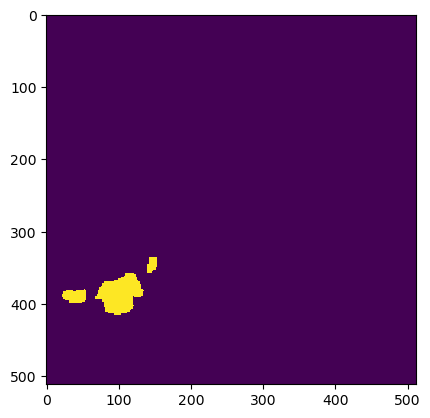

Wrote output/patches/mask/UC_S1_33-542160-0000-6276116-8000.tiff (512 x 512 pixels)


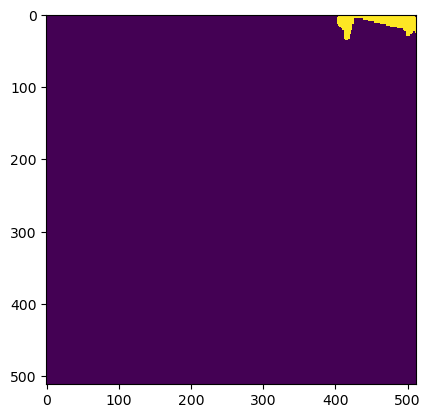

Wrote output/patches/mask/UC_S1_33-542160-0000-6276219-2000.tiff (512 x 512 pixels)


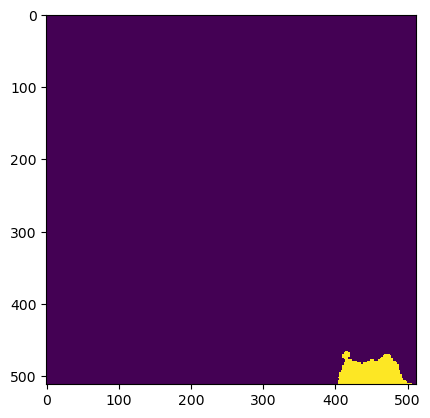

Wrote output/patches/mask/UC_S1_33-542160-0000-6276321-6000.tiff (512 x 512 pixels)


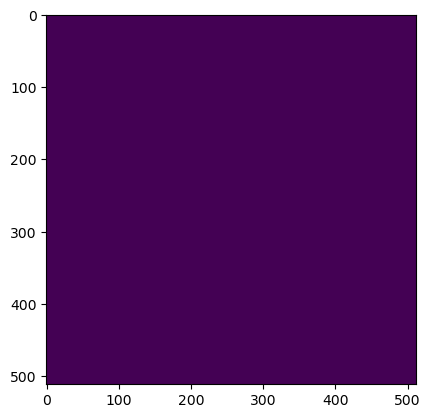

Wrote output/patches/mask/UC_S1_33-542262-4000-6276014-4000.tiff (512 x 512 pixels)


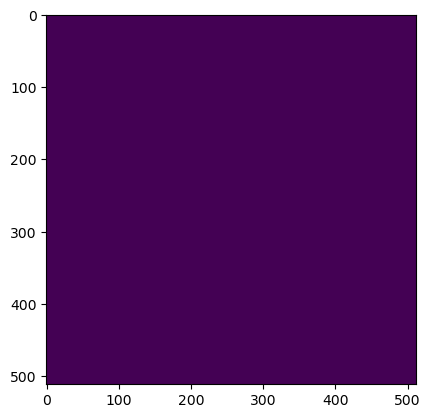

Wrote output/patches/mask/UC_S1_33-542262-4000-6276116-8000.tiff (512 x 512 pixels)


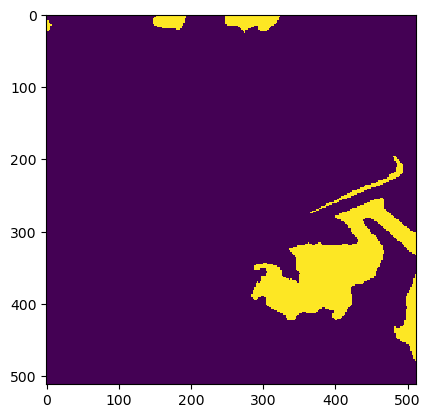

Wrote output/patches/mask/UC_S1_33-542262-4000-6276219-2000.tiff (512 x 512 pixels)


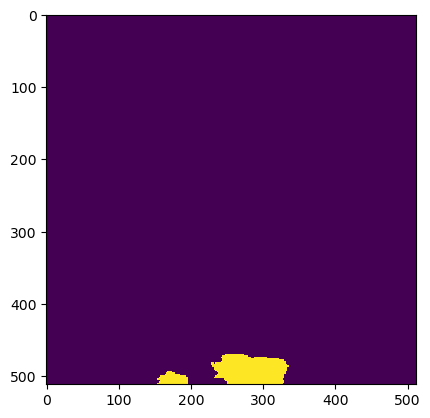

Wrote output/patches/mask/UC_S1_33-542262-4000-6276321-6000.tiff (512 x 512 pixels)
Zone UC_S1_34 Building Mask...


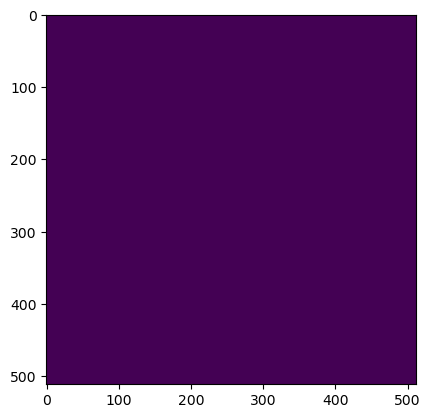

Wrote output/patches/mask/UC_S1_34-462800-0000-6277038-4000.tiff (512 x 512 pixels)


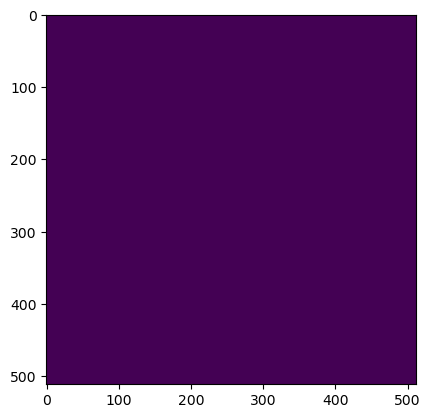

Wrote output/patches/mask/UC_S1_34-462800-0000-6277140-8000.tiff (512 x 512 pixels)


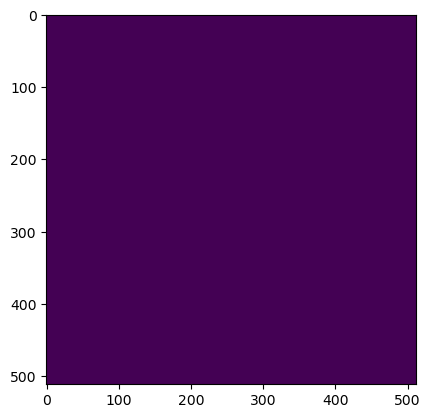

Wrote output/patches/mask/UC_S1_34-462800-0000-6277243-2000.tiff (512 x 512 pixels)


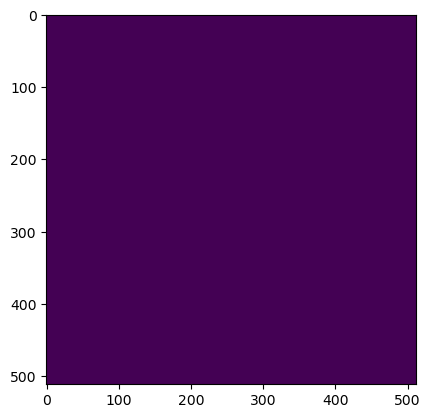

Wrote output/patches/mask/UC_S1_34-462800-0000-6277345-6000.tiff (512 x 512 pixels)


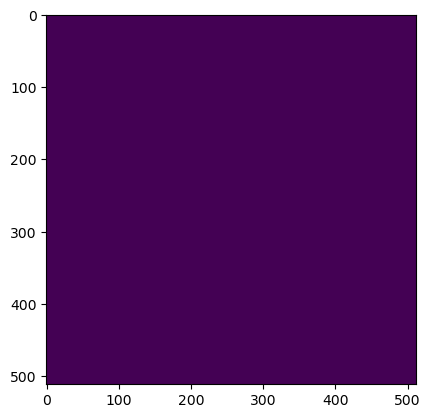

Wrote output/patches/mask/UC_S1_34-462902-4000-6277038-4000.tiff (512 x 512 pixels)


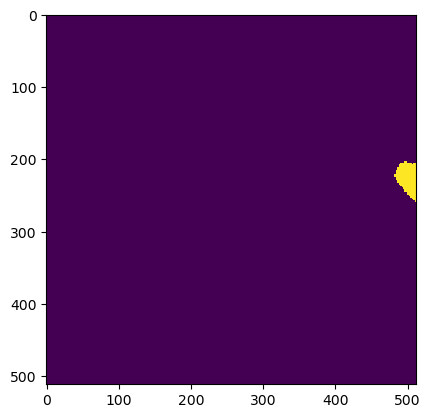

Wrote output/patches/mask/UC_S1_34-462902-4000-6277140-8000.tiff (512 x 512 pixels)


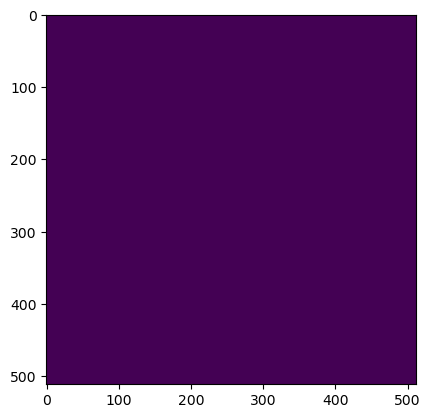

Wrote output/patches/mask/UC_S1_34-462902-4000-6277243-2000.tiff (512 x 512 pixels)


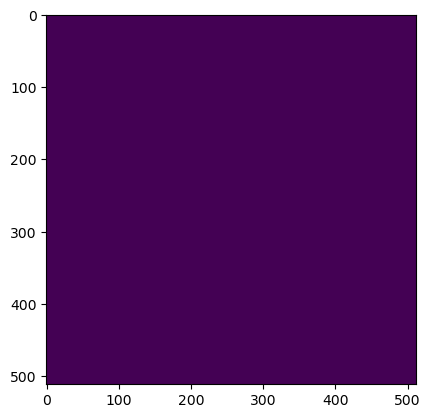

Wrote output/patches/mask/UC_S1_34-462902-4000-6277345-6000.tiff (512 x 512 pixels)


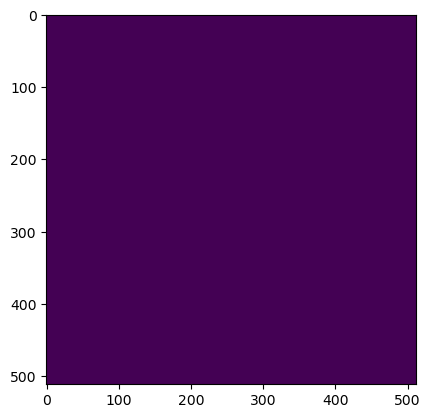

Wrote output/patches/mask/UC_S1_34-463004-8000-6277038-4000.tiff (512 x 512 pixels)


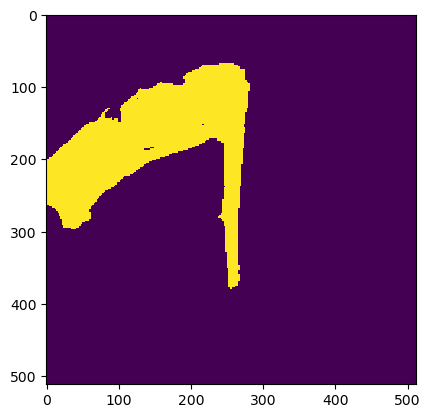

Wrote output/patches/mask/UC_S1_34-463004-8000-6277140-8000.tiff (512 x 512 pixels)


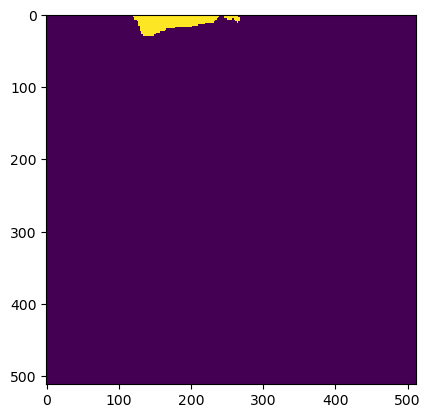

Wrote output/patches/mask/UC_S1_34-463004-8000-6277243-2000.tiff (512 x 512 pixels)


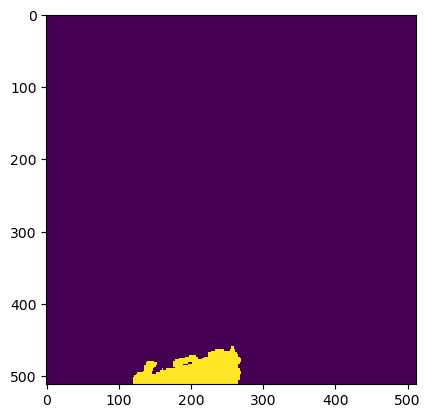

Wrote output/patches/mask/UC_S1_34-463004-8000-6277345-6000.tiff (512 x 512 pixels)


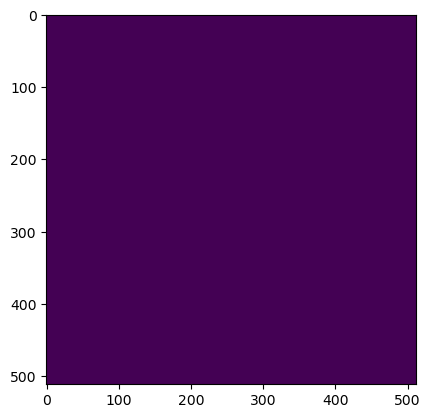

Wrote output/patches/mask/UC_S1_34-463107-2000-6277038-4000.tiff (512 x 512 pixels)


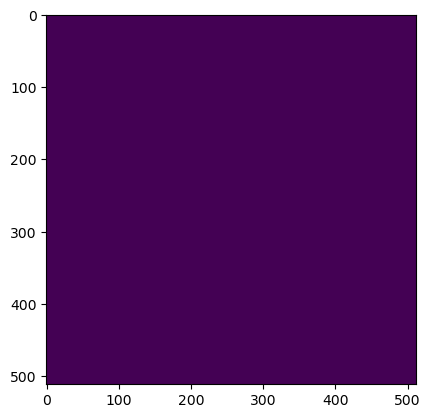

Wrote output/patches/mask/UC_S1_34-463107-2000-6277140-8000.tiff (512 x 512 pixels)


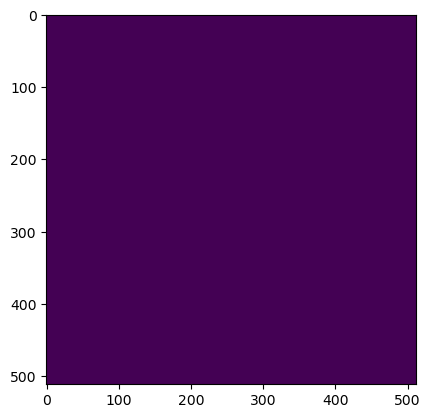

Wrote output/patches/mask/UC_S1_34-463107-2000-6277243-2000.tiff (512 x 512 pixels)


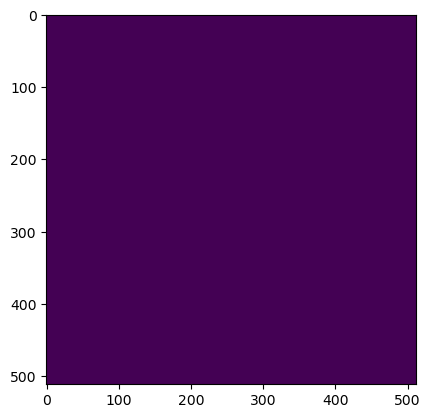

Wrote output/patches/mask/UC_S1_34-463107-2000-6277345-6000.tiff (512 x 512 pixels)


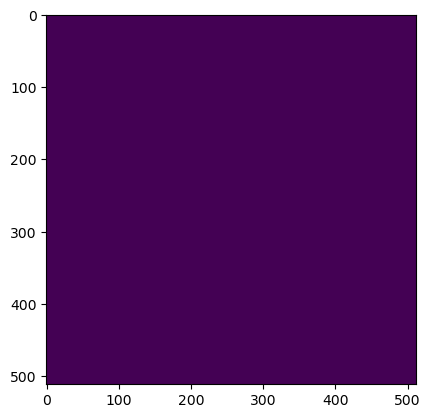

Wrote output/patches/mask/UC_S1_34-463209-6000-6277038-4000.tiff (512 x 512 pixels)


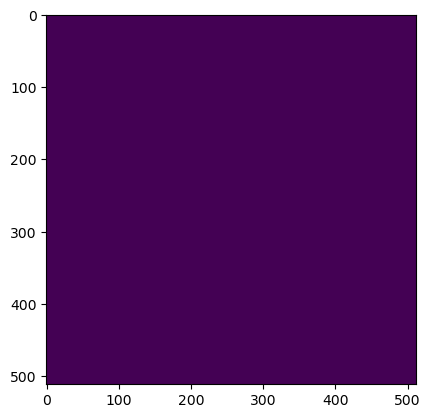

Wrote output/patches/mask/UC_S1_34-463209-6000-6277140-8000.tiff (512 x 512 pixels)


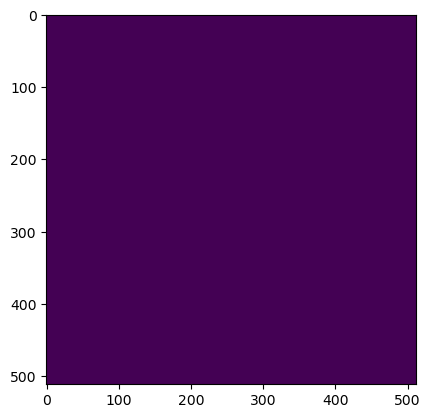

Wrote output/patches/mask/UC_S1_34-463209-6000-6277243-2000.tiff (512 x 512 pixels)


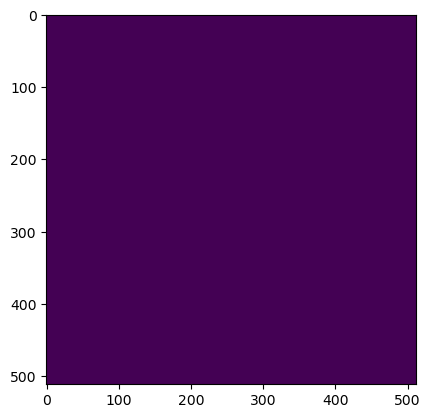

Wrote output/patches/mask/UC_S1_34-463209-6000-6277345-6000.tiff (512 x 512 pixels)


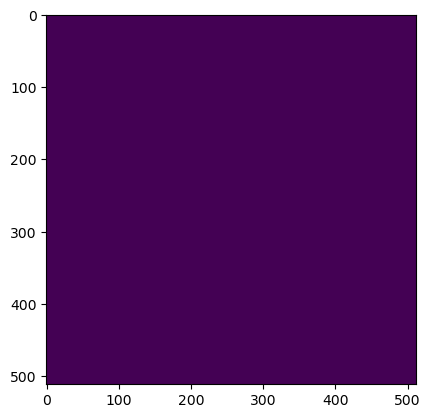

Wrote output/patches/mask/UC_S1_34-463312-0000-6277038-4000.tiff (512 x 512 pixels)


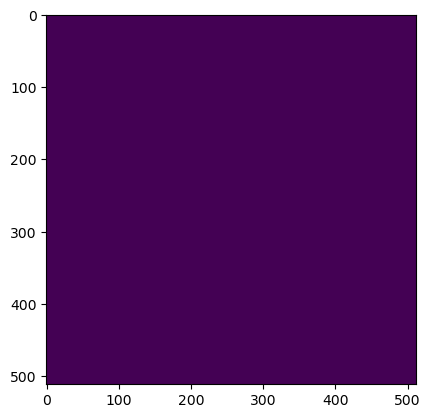

Wrote output/patches/mask/UC_S1_34-463312-0000-6277140-8000.tiff (512 x 512 pixels)


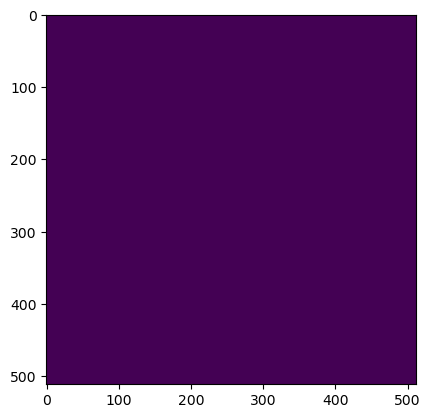

Wrote output/patches/mask/UC_S1_34-463312-0000-6277243-2000.tiff (512 x 512 pixels)


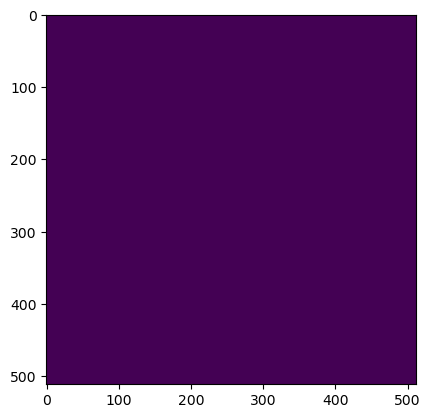

Wrote output/patches/mask/UC_S1_34-463312-0000-6277345-6000.tiff (512 x 512 pixels)


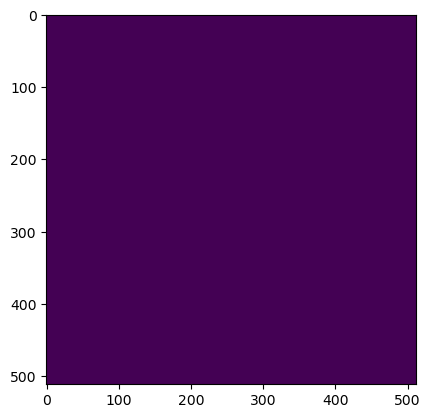

Wrote output/patches/mask/UC_S1_34-463414-4000-6277038-4000.tiff (512 x 512 pixels)


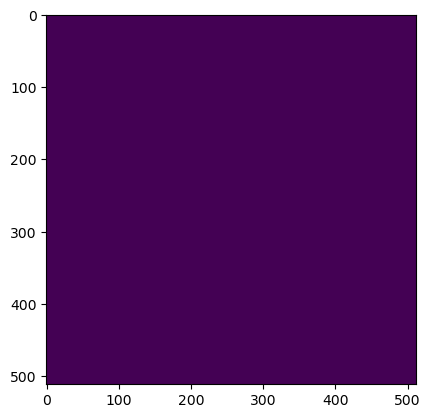

Wrote output/patches/mask/UC_S1_34-463414-4000-6277140-8000.tiff (512 x 512 pixels)


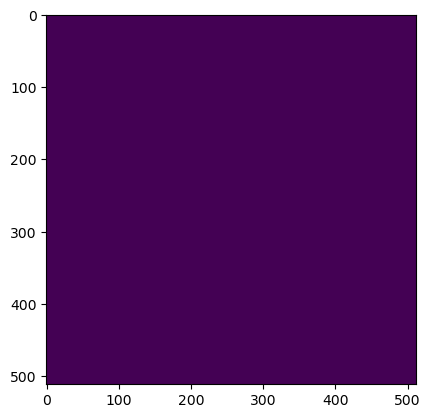

Wrote output/patches/mask/UC_S1_34-463414-4000-6277243-2000.tiff (512 x 512 pixels)


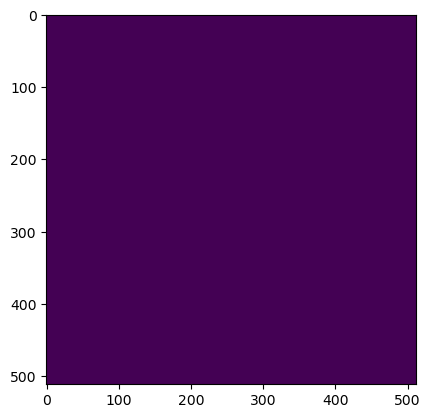

Wrote output/patches/mask/UC_S1_34-463414-4000-6277345-6000.tiff (512 x 512 pixels)


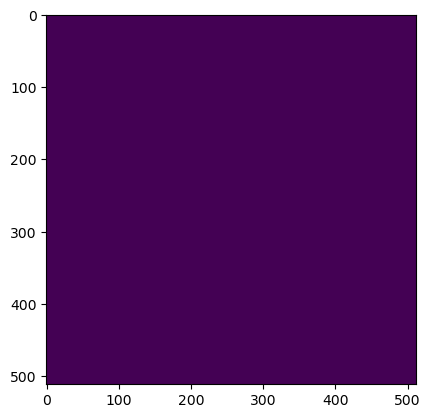

Wrote output/patches/mask/UC_S1_34-463516-8000-6277038-4000.tiff (512 x 512 pixels)


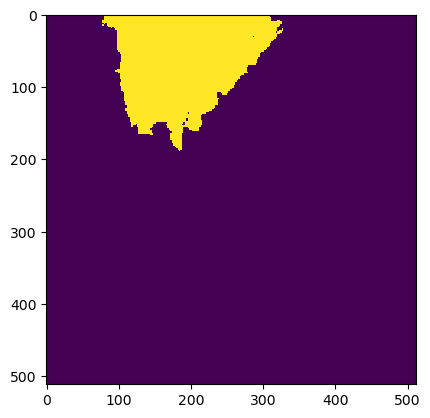

Wrote output/patches/mask/UC_S1_34-463516-8000-6277140-8000.tiff (512 x 512 pixels)


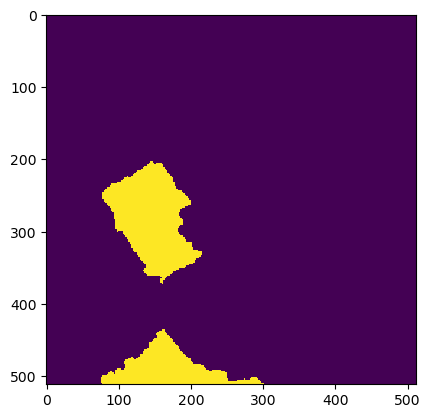

Wrote output/patches/mask/UC_S1_34-463516-8000-6277243-2000.tiff (512 x 512 pixels)


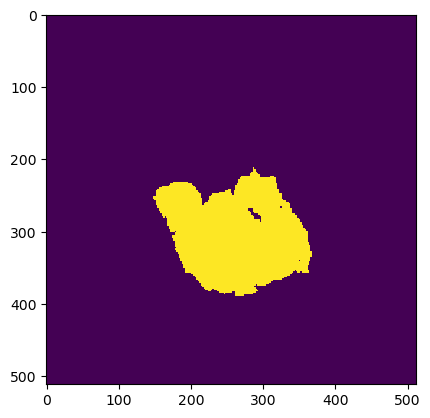

Wrote output/patches/mask/UC_S1_34-463516-8000-6277345-6000.tiff (512 x 512 pixels)


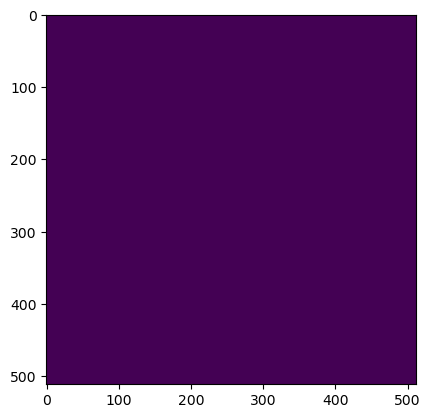

Wrote output/patches/mask/UC_S1_34-463619-2000-6277038-4000.tiff (512 x 512 pixels)


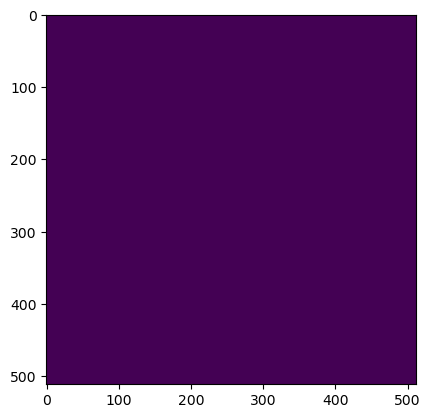

Wrote output/patches/mask/UC_S1_34-463619-2000-6277140-8000.tiff (512 x 512 pixels)


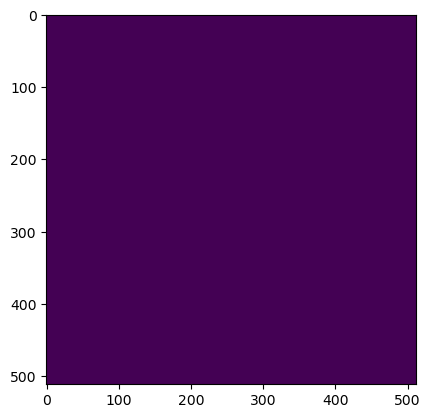

Wrote output/patches/mask/UC_S1_34-463619-2000-6277243-2000.tiff (512 x 512 pixels)


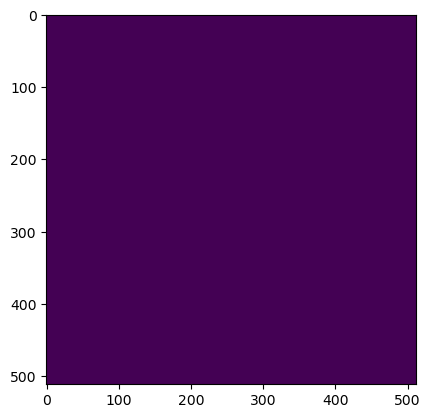

Wrote output/patches/mask/UC_S1_34-463619-2000-6277345-6000.tiff (512 x 512 pixels)
Zone UU_S1_35 Building Mask...


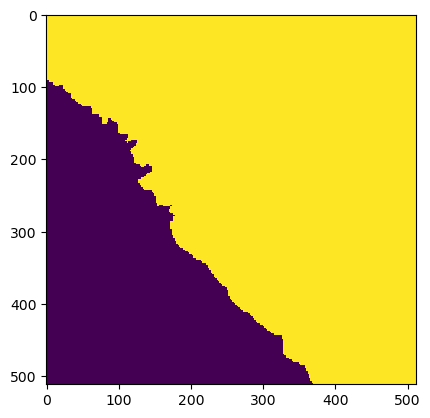

Wrote output/patches/mask/UU_S1_35-543696-0000-6277038-4000.tiff (512 x 512 pixels)


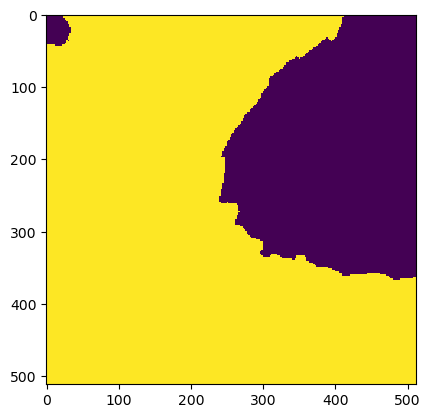

Wrote output/patches/mask/UU_S1_35-543696-0000-6277140-8000.tiff (512 x 512 pixels)


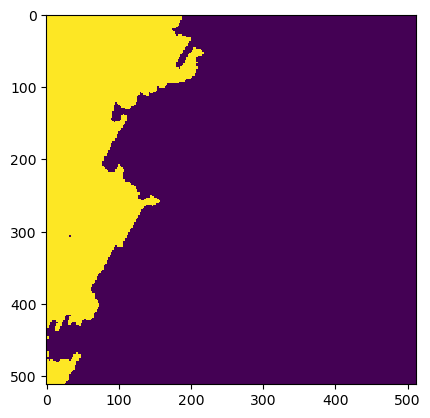

Wrote output/patches/mask/UU_S1_35-543798-4000-6277038-4000.tiff (512 x 512 pixels)


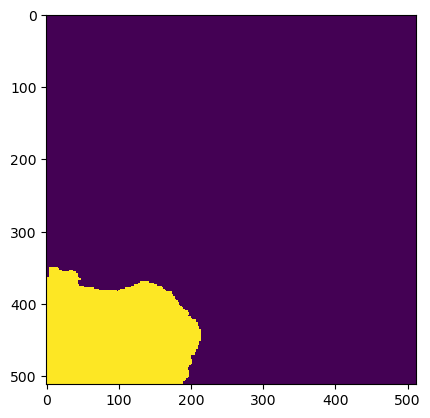

Wrote output/patches/mask/UU_S1_35-543798-4000-6277140-8000.tiff (512 x 512 pixels)
Zone CU_S1_36 Building Mask...


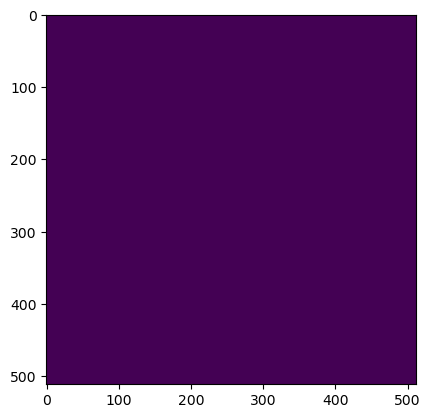

Wrote output/patches/mask/CU_S1_36-483024-0000-6277550-4000.tiff (512 x 512 pixels)


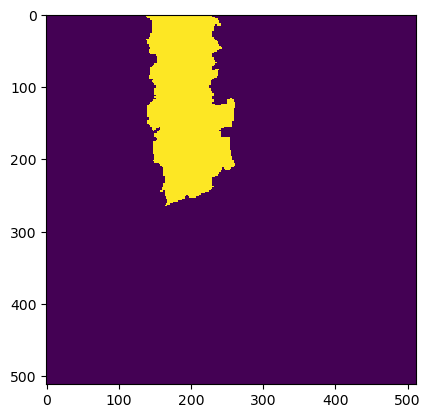

Wrote output/patches/mask/CU_S1_36-483024-0000-6277652-8000.tiff (512 x 512 pixels)


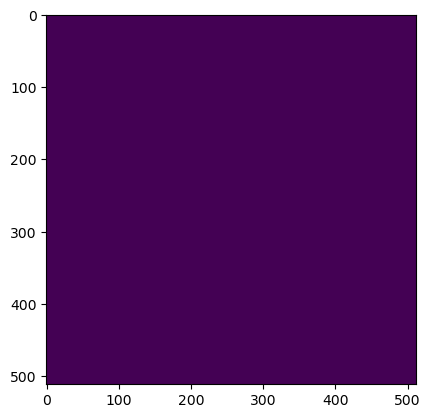

Wrote output/patches/mask/CU_S1_36-483126-4000-6277550-4000.tiff (512 x 512 pixels)


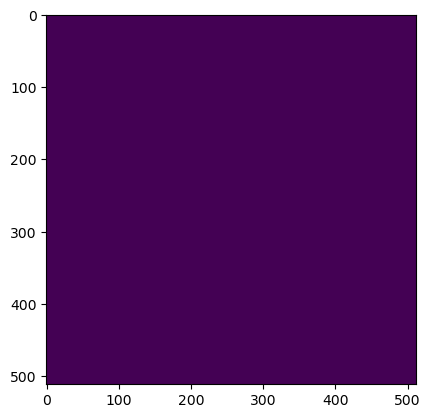

Wrote output/patches/mask/CU_S1_36-483126-4000-6277652-8000.tiff (512 x 512 pixels)
Zone UC_S1_37 Building Mask...


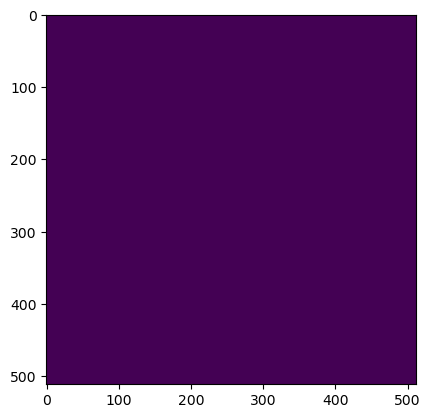

Wrote output/patches/mask/UC_S1_37-458704-0000-6277806-4000.tiff (512 x 512 pixels)


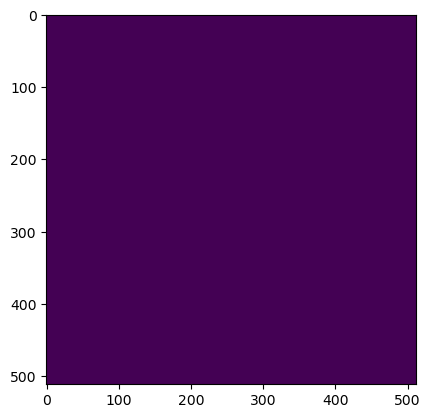

Wrote output/patches/mask/UC_S1_37-458704-0000-6277908-8000.tiff (512 x 512 pixels)


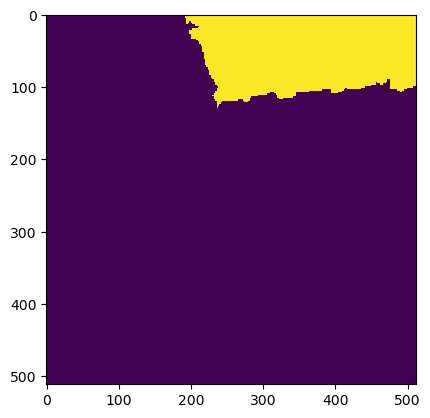

Wrote output/patches/mask/UC_S1_37-458806-4000-6277806-4000.tiff (512 x 512 pixels)


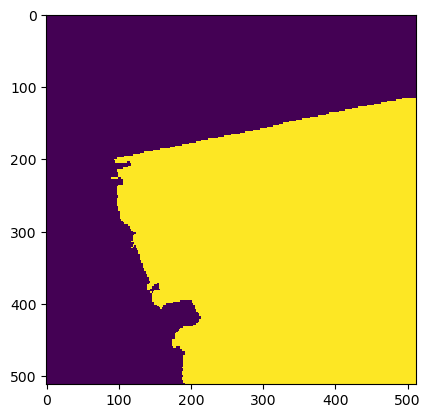

Wrote output/patches/mask/UC_S1_37-458806-4000-6277908-8000.tiff (512 x 512 pixels)


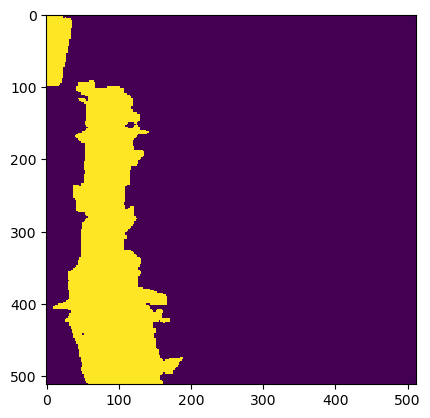

Wrote output/patches/mask/UC_S1_37-458908-8000-6277806-4000.tiff (512 x 512 pixels)


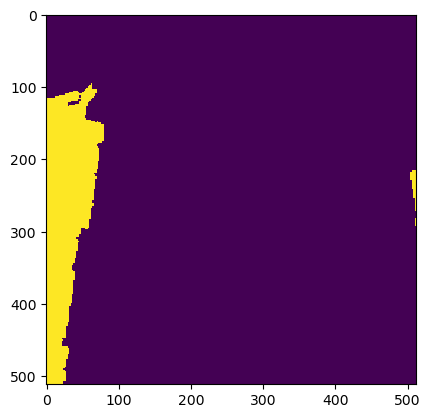

Wrote output/patches/mask/UC_S1_37-458908-8000-6277908-8000.tiff (512 x 512 pixels)


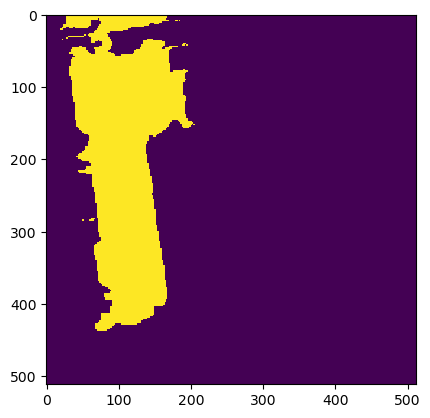

Wrote output/patches/mask/UC_S1_37-459011-2000-6277806-4000.tiff (512 x 512 pixels)


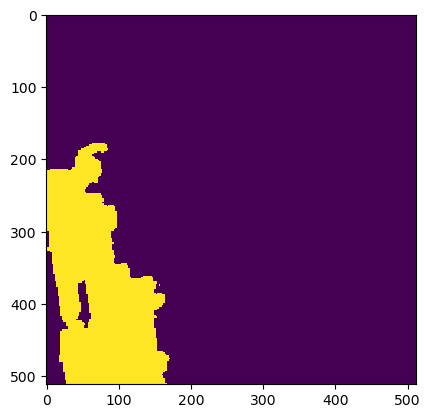

Wrote output/patches/mask/UC_S1_37-459011-2000-6277908-8000.tiff (512 x 512 pixels)
Zone UU_S1_38 Building Mask...


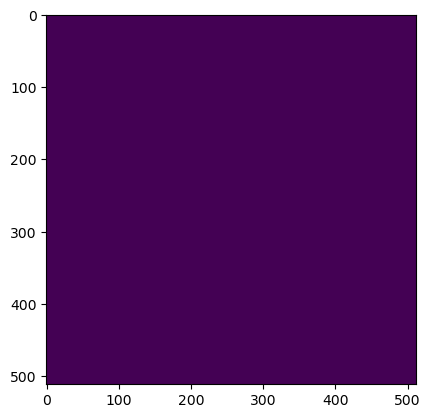

Wrote output/patches/mask/UU_S1_38-552144-0000-6278318-4000.tiff (512 x 512 pixels)


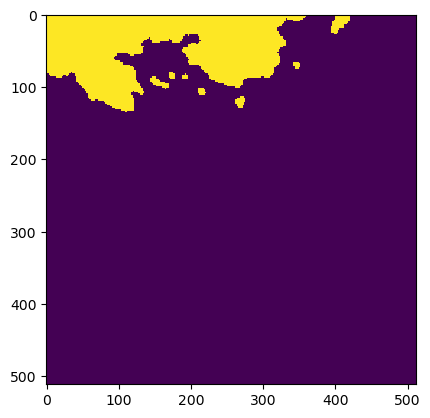

Wrote output/patches/mask/UU_S1_38-552144-0000-6278420-8000.tiff (512 x 512 pixels)


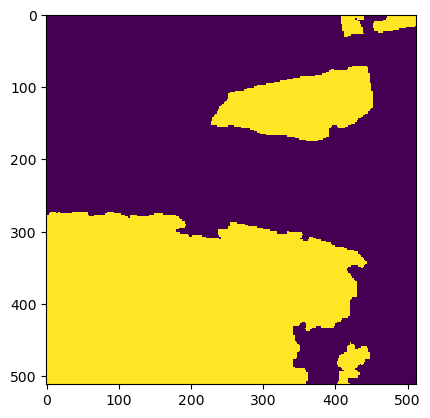

Wrote output/patches/mask/UU_S1_38-552144-0000-6278523-2000.tiff (512 x 512 pixels)


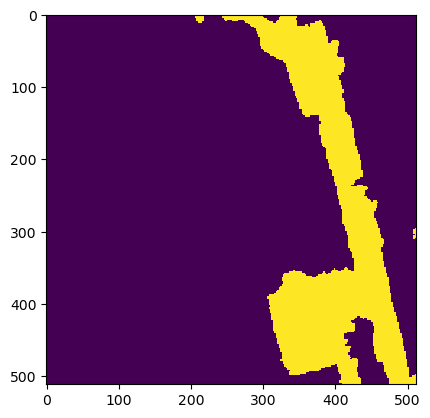

Wrote output/patches/mask/UU_S1_38-552144-0000-6278625-6000.tiff (512 x 512 pixels)


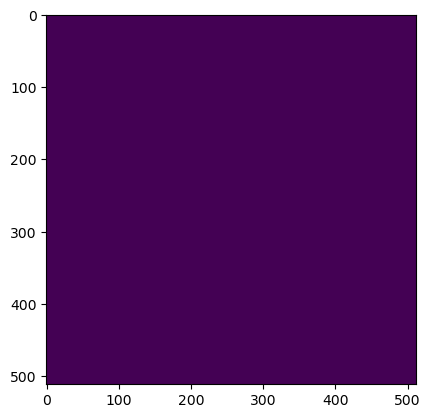

Wrote output/patches/mask/UU_S1_38-552246-4000-6278318-4000.tiff (512 x 512 pixels)


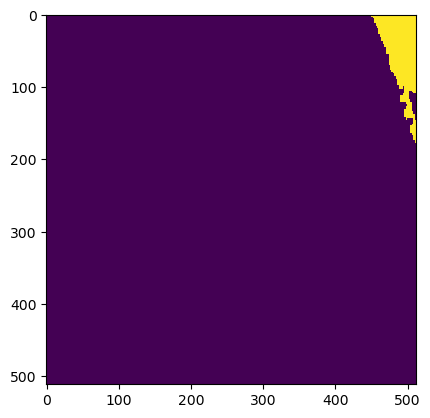

Wrote output/patches/mask/UU_S1_38-552246-4000-6278420-8000.tiff (512 x 512 pixels)


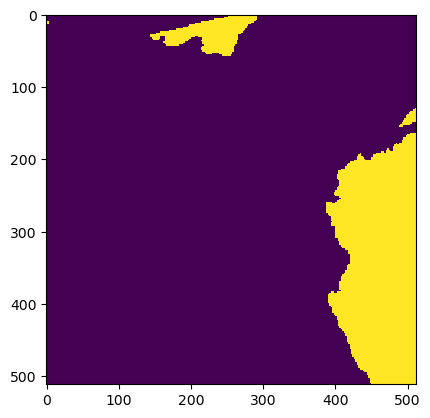

Wrote output/patches/mask/UU_S1_38-552246-4000-6278523-2000.tiff (512 x 512 pixels)


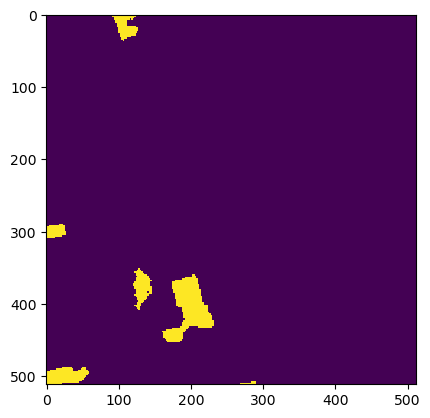

Wrote output/patches/mask/UU_S1_38-552246-4000-6278625-6000.tiff (512 x 512 pixels)


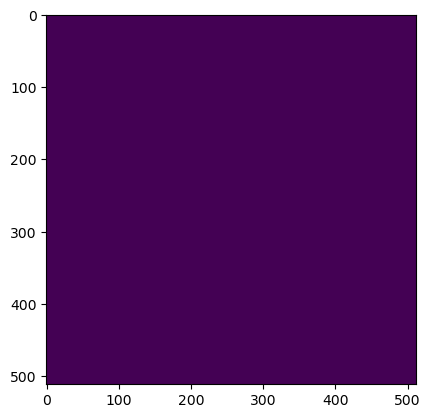

Wrote output/patches/mask/UU_S1_38-552348-8000-6278318-4000.tiff (512 x 512 pixels)


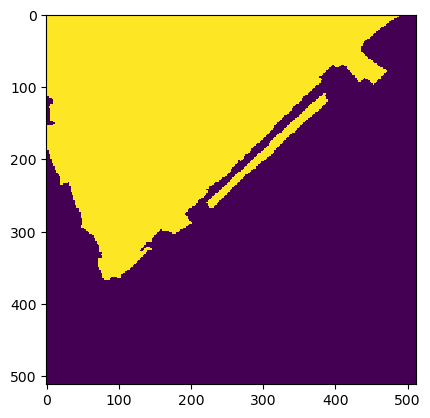

Wrote output/patches/mask/UU_S1_38-552348-8000-6278420-8000.tiff (512 x 512 pixels)


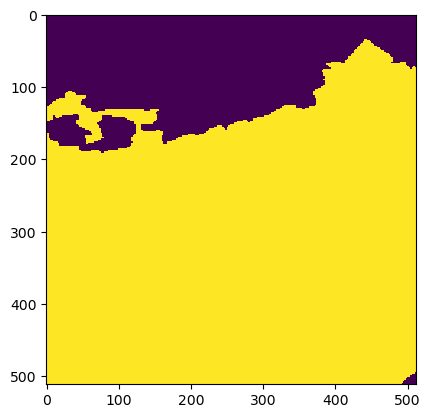

Wrote output/patches/mask/UU_S1_38-552348-8000-6278523-2000.tiff (512 x 512 pixels)


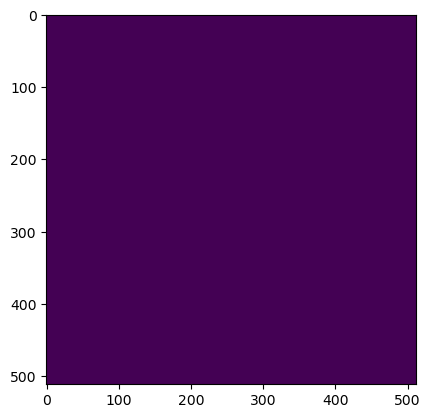

Wrote output/patches/mask/UU_S1_38-552348-8000-6278625-6000.tiff (512 x 512 pixels)


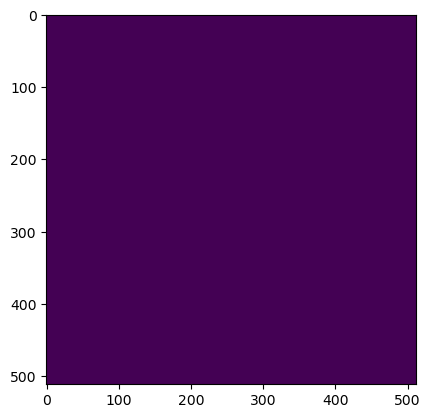

Wrote output/patches/mask/UU_S1_38-552451-2000-6278318-4000.tiff (512 x 512 pixels)


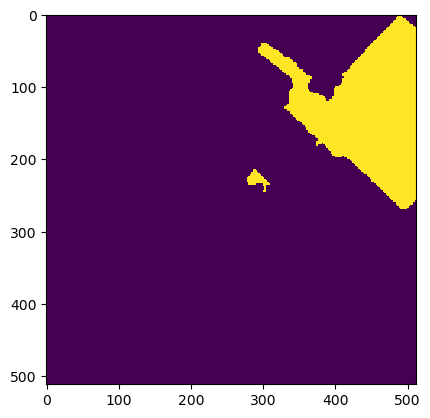

Wrote output/patches/mask/UU_S1_38-552451-2000-6278420-8000.tiff (512 x 512 pixels)


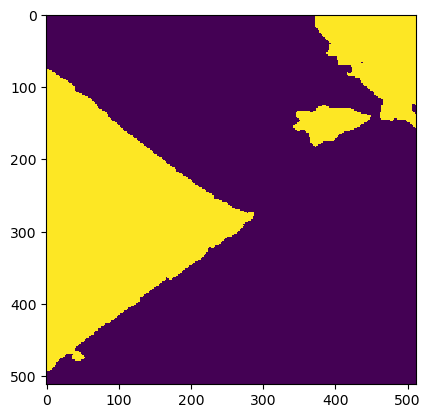

Wrote output/patches/mask/UU_S1_38-552451-2000-6278523-2000.tiff (512 x 512 pixels)


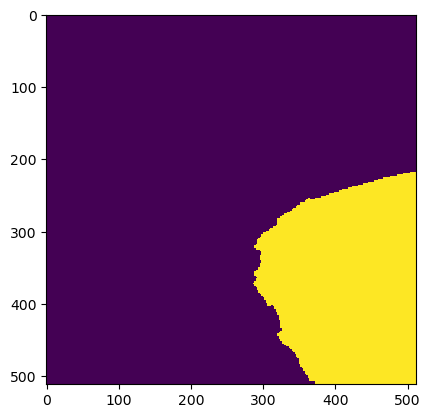

Wrote output/patches/mask/UU_S1_38-552451-2000-6278625-6000.tiff (512 x 512 pixels)
Zone UU_S1_39 Building Mask...


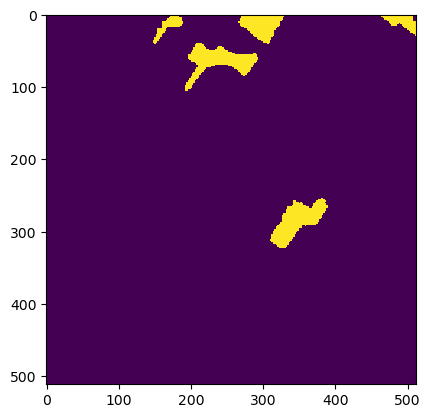

Wrote output/patches/mask/UU_S1_39-550096-0000-6278318-4000.tiff (512 x 512 pixels)


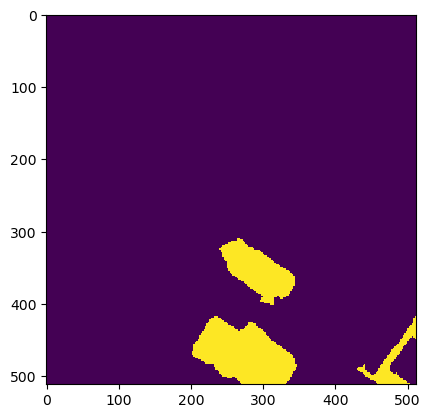

Wrote output/patches/mask/UU_S1_39-550096-0000-6278420-8000.tiff (512 x 512 pixels)


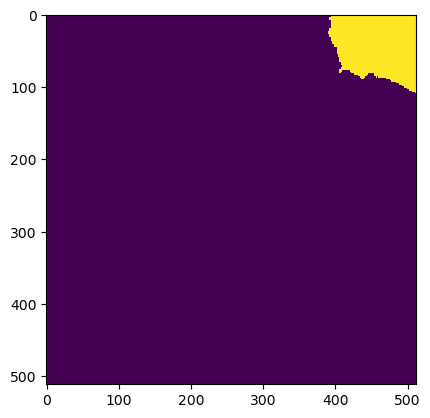

Wrote output/patches/mask/UU_S1_39-550096-0000-6278523-2000.tiff (512 x 512 pixels)


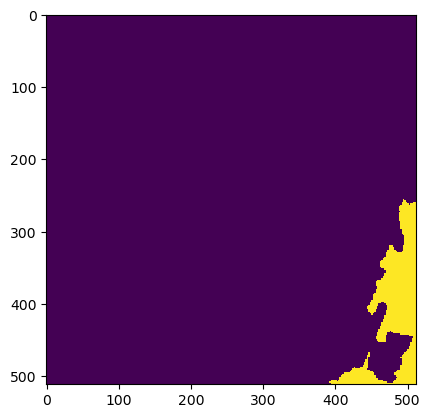

Wrote output/patches/mask/UU_S1_39-550096-0000-6278625-6000.tiff (512 x 512 pixels)


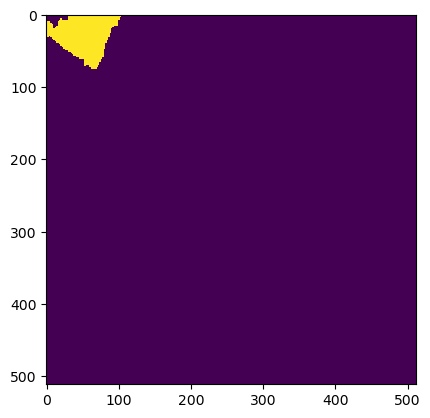

Wrote output/patches/mask/UU_S1_39-550198-4000-6278318-4000.tiff (512 x 512 pixels)


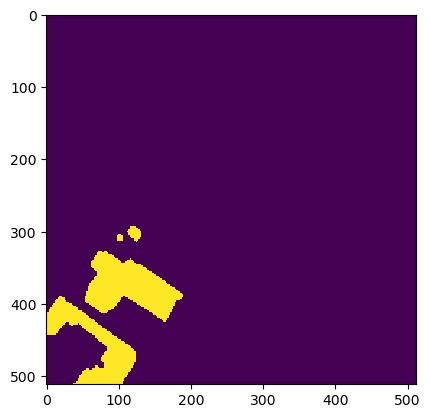

Wrote output/patches/mask/UU_S1_39-550198-4000-6278420-8000.tiff (512 x 512 pixels)


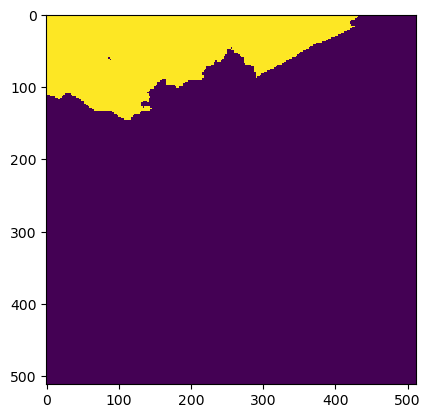

Wrote output/patches/mask/UU_S1_39-550198-4000-6278523-2000.tiff (512 x 512 pixels)


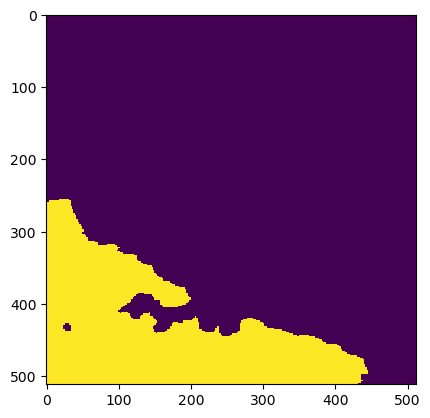

Wrote output/patches/mask/UU_S1_39-550198-4000-6278625-6000.tiff (512 x 512 pixels)


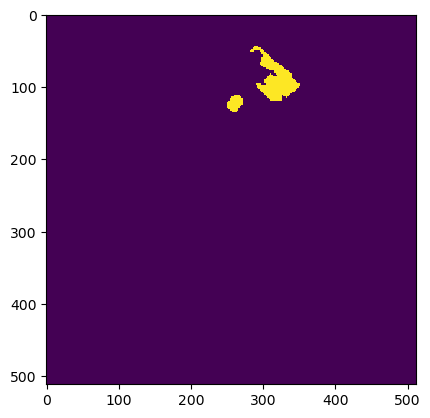

Wrote output/patches/mask/UU_S1_39-550300-8000-6278318-4000.tiff (512 x 512 pixels)


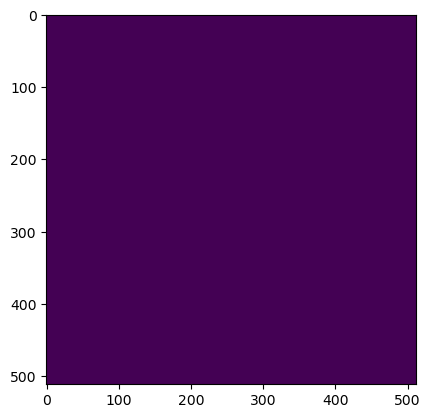

Wrote output/patches/mask/UU_S1_39-550300-8000-6278420-8000.tiff (512 x 512 pixels)


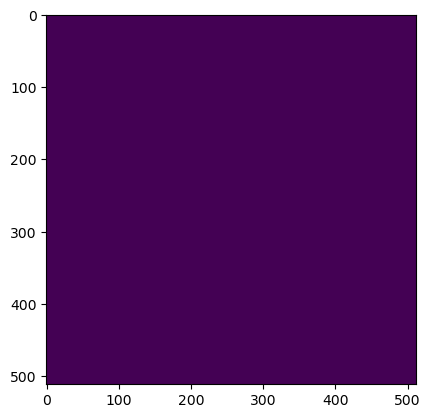

Wrote output/patches/mask/UU_S1_39-550300-8000-6278523-2000.tiff (512 x 512 pixels)


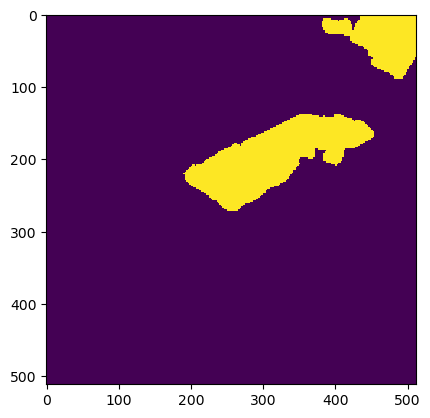

Wrote output/patches/mask/UU_S1_39-550300-8000-6278625-6000.tiff (512 x 512 pixels)


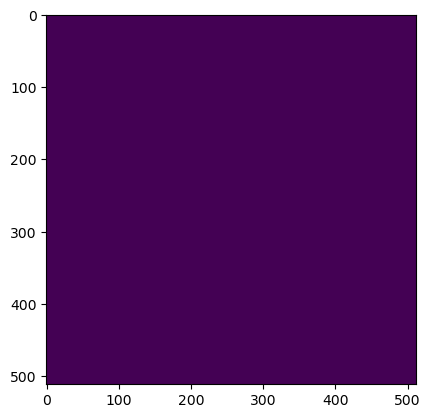

Wrote output/patches/mask/UU_S1_39-550403-2000-6278318-4000.tiff (512 x 512 pixels)


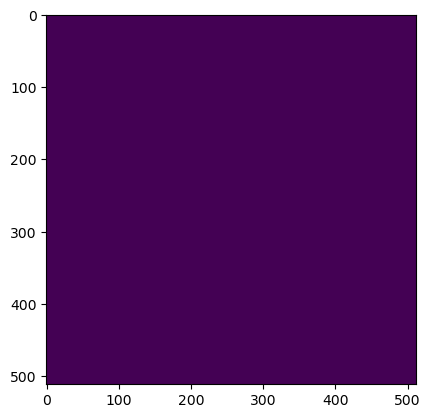

Wrote output/patches/mask/UU_S1_39-550403-2000-6278420-8000.tiff (512 x 512 pixels)


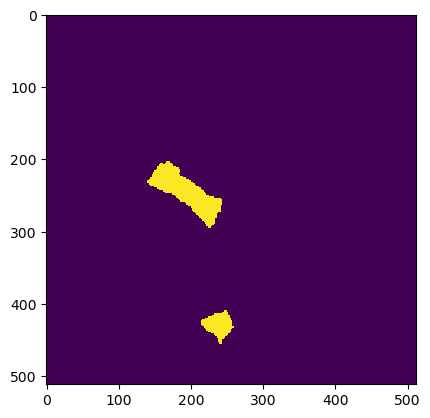

Wrote output/patches/mask/UU_S1_39-550403-2000-6278523-2000.tiff (512 x 512 pixels)


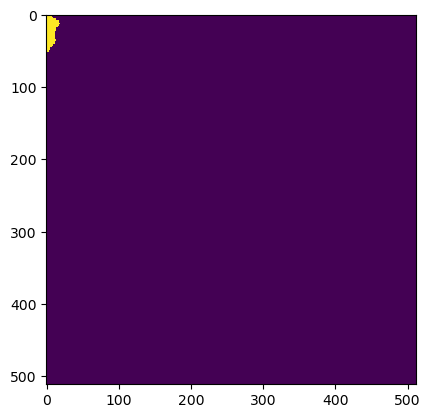

Wrote output/patches/mask/UU_S1_39-550403-2000-6278625-6000.tiff (512 x 512 pixels)


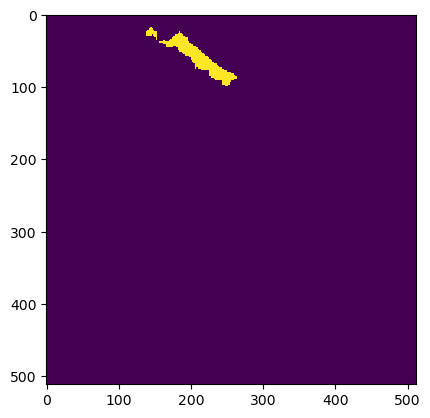

Wrote output/patches/mask/UU_S1_39-550505-6000-6278318-4000.tiff (512 x 512 pixels)


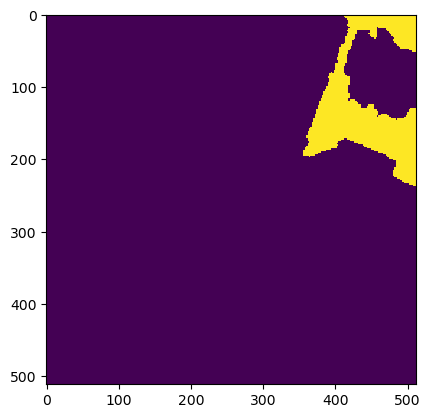

Wrote output/patches/mask/UU_S1_39-550505-6000-6278420-8000.tiff (512 x 512 pixels)


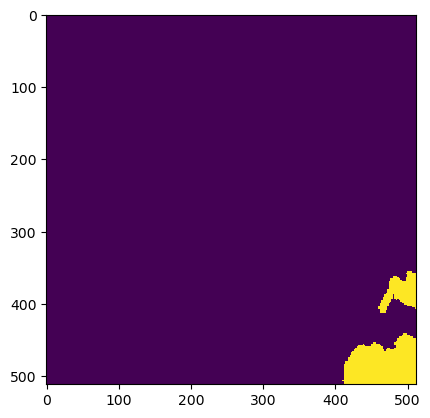

Wrote output/patches/mask/UU_S1_39-550505-6000-6278523-2000.tiff (512 x 512 pixels)


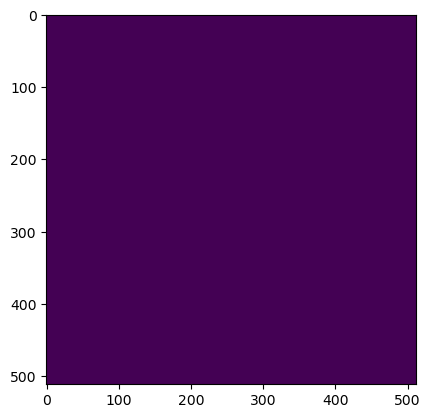

Wrote output/patches/mask/UU_S1_39-550505-6000-6278625-6000.tiff (512 x 512 pixels)


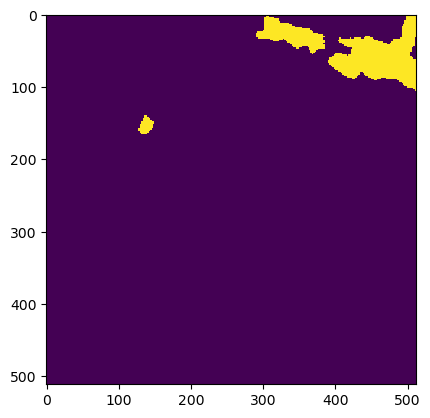

Wrote output/patches/mask/UU_S1_39-550608-0000-6278318-4000.tiff (512 x 512 pixels)


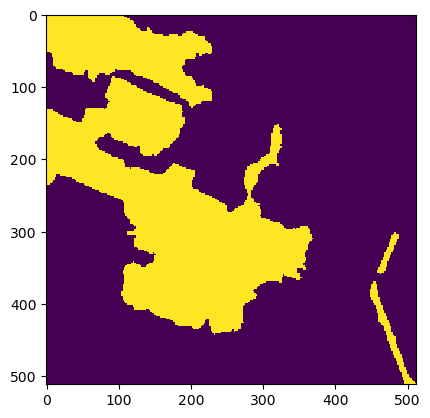

Wrote output/patches/mask/UU_S1_39-550608-0000-6278420-8000.tiff (512 x 512 pixels)


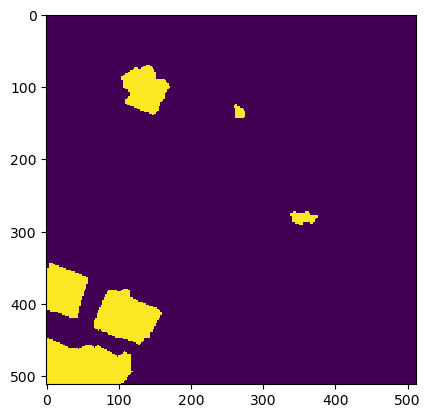

Wrote output/patches/mask/UU_S1_39-550608-0000-6278523-2000.tiff (512 x 512 pixels)


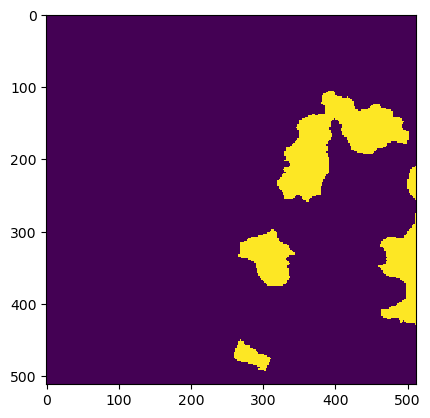

Wrote output/patches/mask/UU_S1_39-550608-0000-6278625-6000.tiff (512 x 512 pixels)


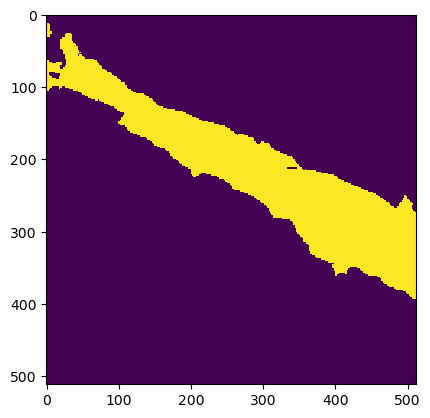

Wrote output/patches/mask/UU_S1_39-550710-4000-6278318-4000.tiff (512 x 512 pixels)


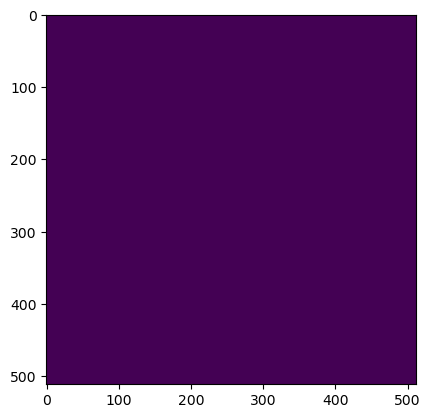

Wrote output/patches/mask/UU_S1_39-550710-4000-6278420-8000.tiff (512 x 512 pixels)


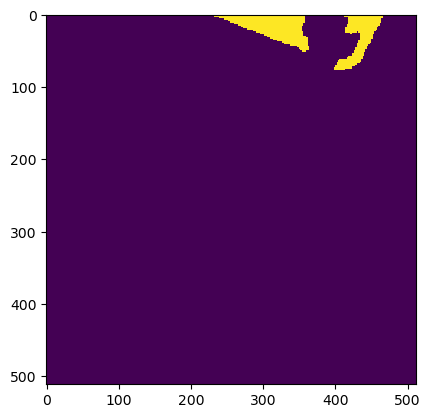

Wrote output/patches/mask/UU_S1_39-550710-4000-6278523-2000.tiff (512 x 512 pixels)


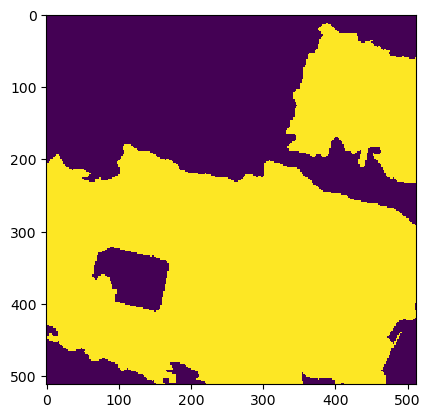

Wrote output/patches/mask/UU_S1_39-550710-4000-6278625-6000.tiff (512 x 512 pixels)
Zone UU_S1_40 Building Mask...


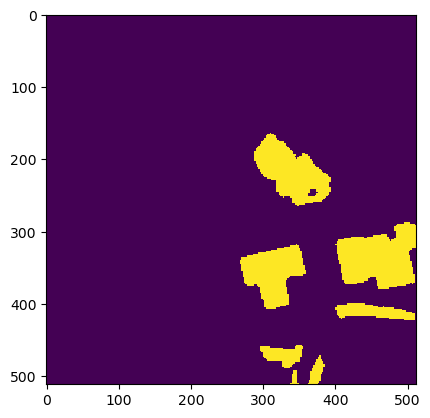

Wrote output/patches/mask/UU_S1_40-553936-0000-6278574-4000.tiff (512 x 512 pixels)


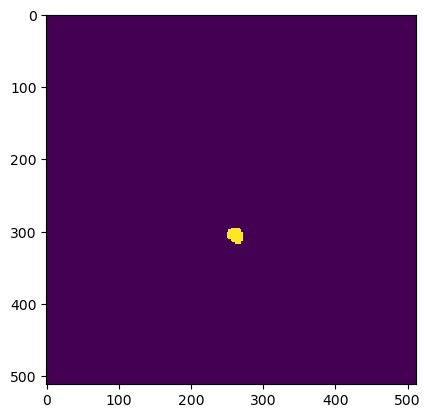

Wrote output/patches/mask/UU_S1_40-553936-0000-6278676-8000.tiff (512 x 512 pixels)


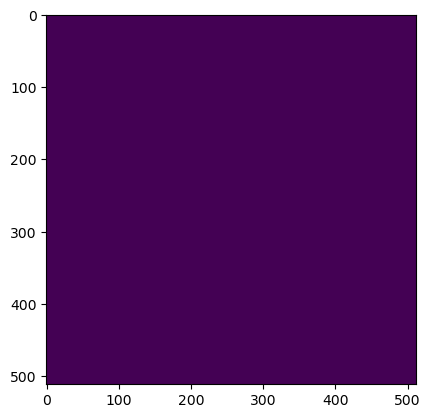

Wrote output/patches/mask/UU_S1_40-553936-0000-6278779-2000.tiff (512 x 512 pixels)


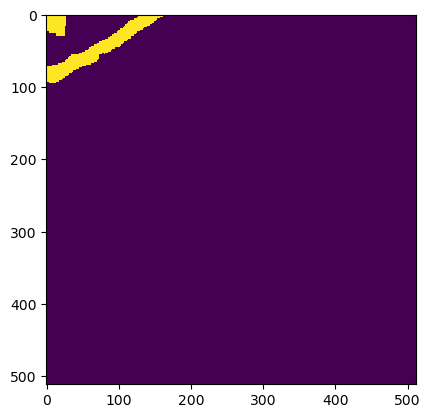

Wrote output/patches/mask/UU_S1_40-553936-0000-6278881-6000.tiff (512 x 512 pixels)


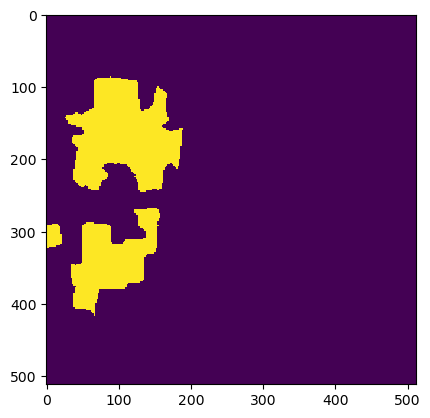

Wrote output/patches/mask/UU_S1_40-554038-4000-6278574-4000.tiff (512 x 512 pixels)


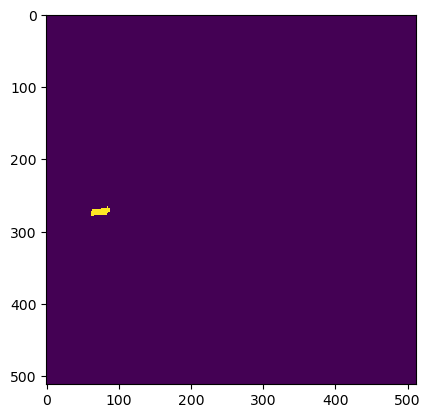

Wrote output/patches/mask/UU_S1_40-554038-4000-6278676-8000.tiff (512 x 512 pixels)


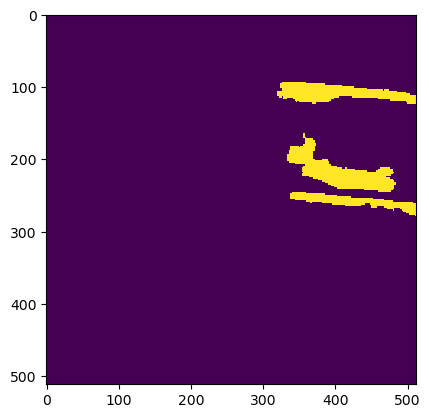

Wrote output/patches/mask/UU_S1_40-554038-4000-6278779-2000.tiff (512 x 512 pixels)


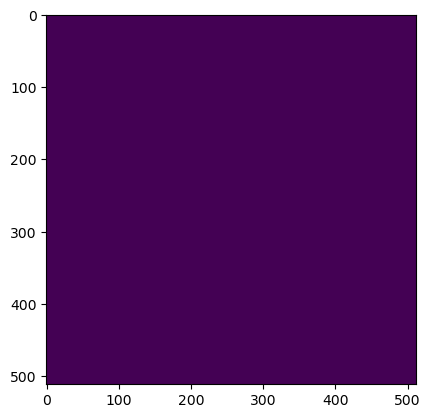

Wrote output/patches/mask/UU_S1_40-554038-4000-6278881-6000.tiff (512 x 512 pixels)
Zone UU_S1_41 Building Mask...


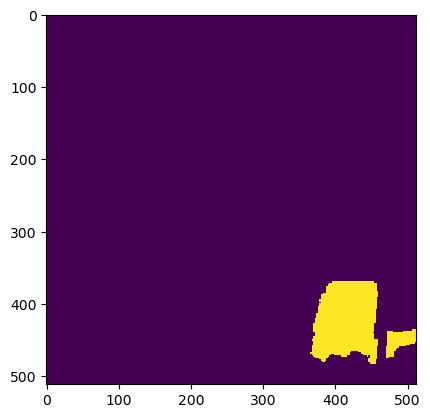

Wrote output/patches/mask/UU_S1_41-553168-0000-6278830-4000.tiff (512 x 512 pixels)


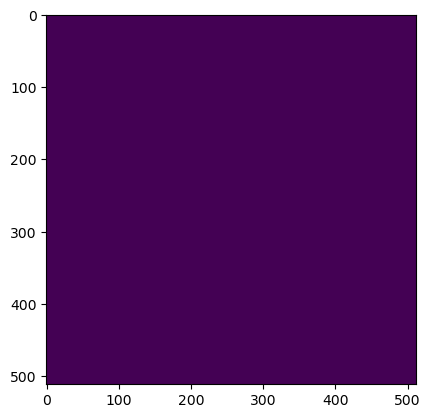

Wrote output/patches/mask/UU_S1_41-553168-0000-6278932-8000.tiff (512 x 512 pixels)


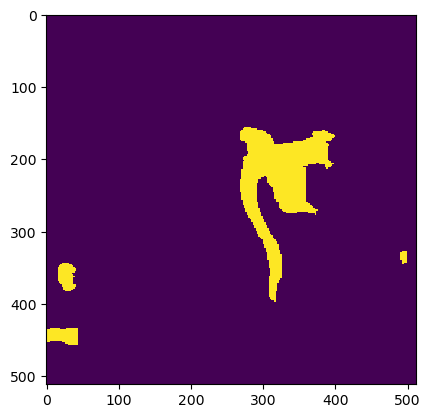

Wrote output/patches/mask/UU_S1_41-553270-4000-6278830-4000.tiff (512 x 512 pixels)


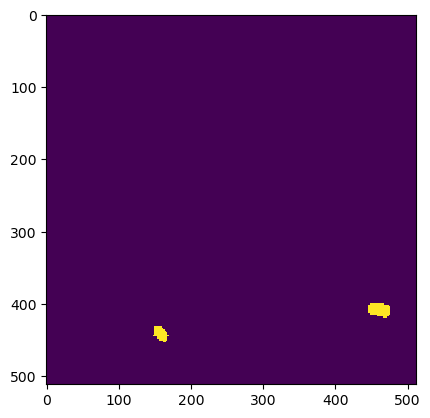

Wrote output/patches/mask/UU_S1_41-553270-4000-6278932-8000.tiff (512 x 512 pixels)
Zone CU_S1_42 Building Mask...


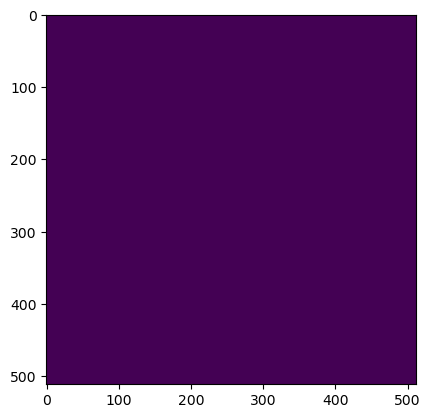

Wrote output/patches/mask/CU_S1_42-458192-0000-6279086-4000.tiff (512 x 512 pixels)


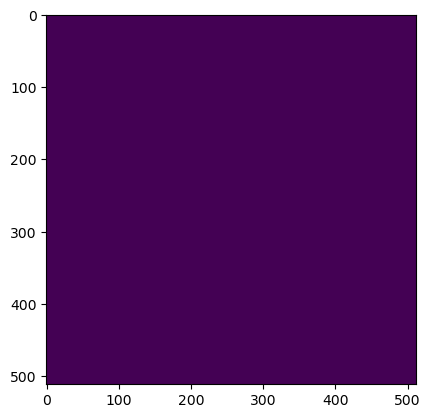

Wrote output/patches/mask/CU_S1_42-458192-0000-6279188-8000.tiff (512 x 512 pixels)


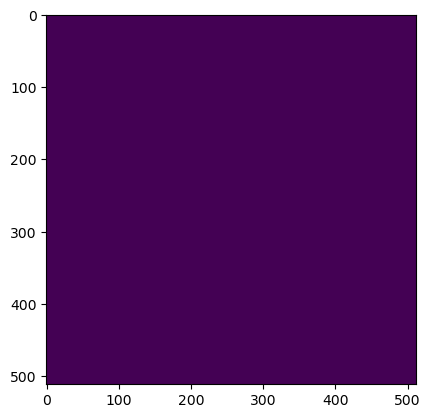

Wrote output/patches/mask/CU_S1_42-458192-0000-6279291-2000.tiff (512 x 512 pixels)


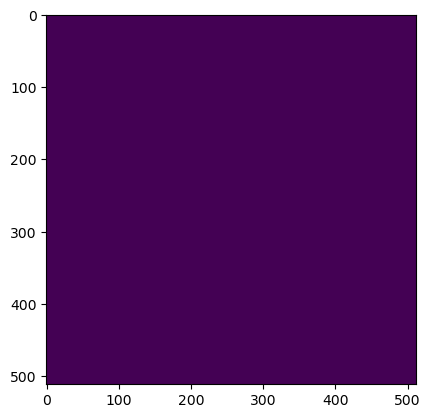

Wrote output/patches/mask/CU_S1_42-458192-0000-6279393-6000.tiff (512 x 512 pixels)


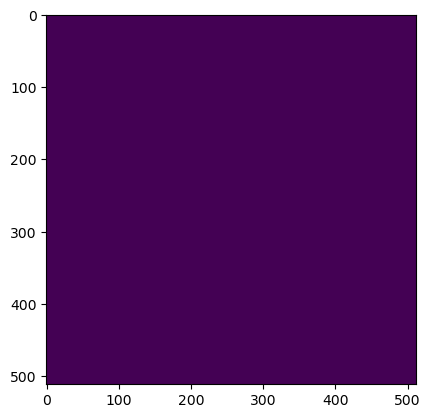

Wrote output/patches/mask/CU_S1_42-458294-4000-6279086-4000.tiff (512 x 512 pixels)


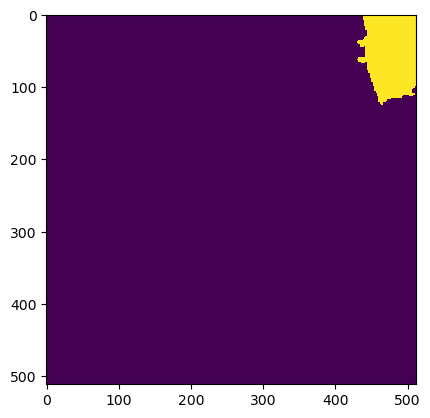

Wrote output/patches/mask/CU_S1_42-458294-4000-6279188-8000.tiff (512 x 512 pixels)


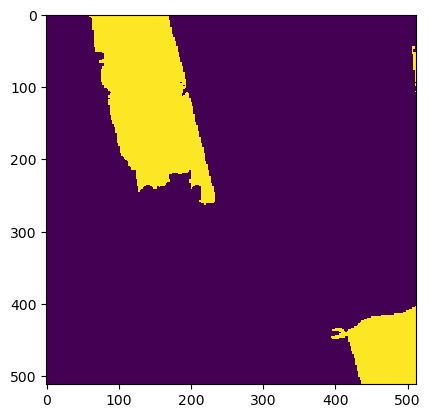

Wrote output/patches/mask/CU_S1_42-458294-4000-6279291-2000.tiff (512 x 512 pixels)


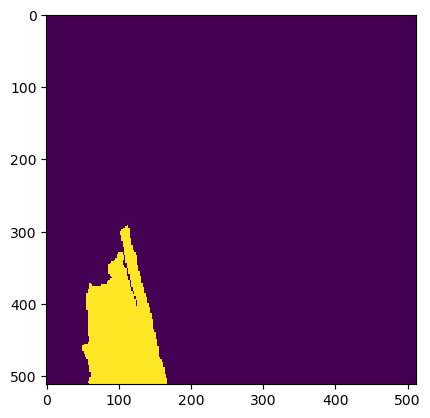

Wrote output/patches/mask/CU_S1_42-458294-4000-6279393-6000.tiff (512 x 512 pixels)


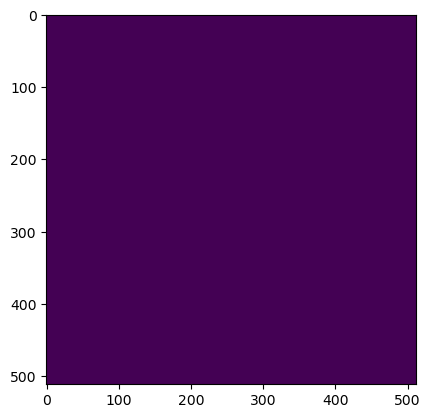

Wrote output/patches/mask/CU_S1_42-458396-8000-6279086-4000.tiff (512 x 512 pixels)


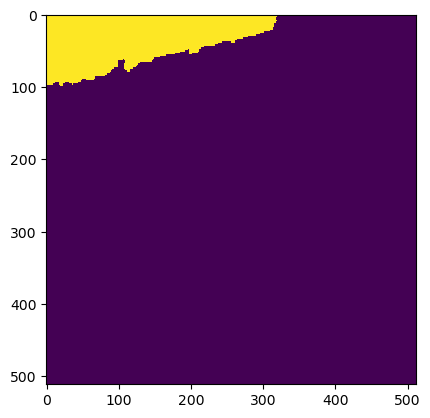

Wrote output/patches/mask/CU_S1_42-458396-8000-6279188-8000.tiff (512 x 512 pixels)


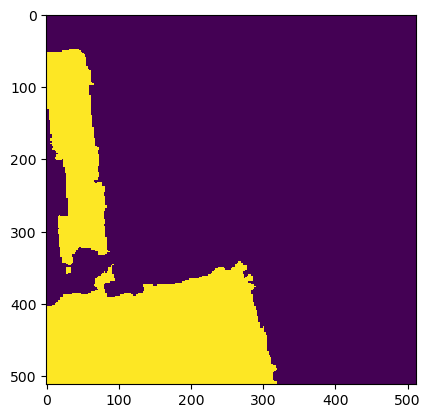

Wrote output/patches/mask/CU_S1_42-458396-8000-6279291-2000.tiff (512 x 512 pixels)


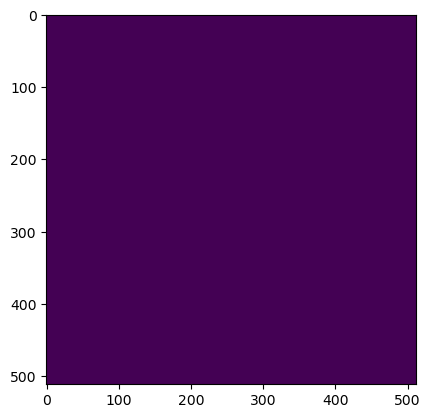

Wrote output/patches/mask/CU_S1_42-458396-8000-6279393-6000.tiff (512 x 512 pixels)


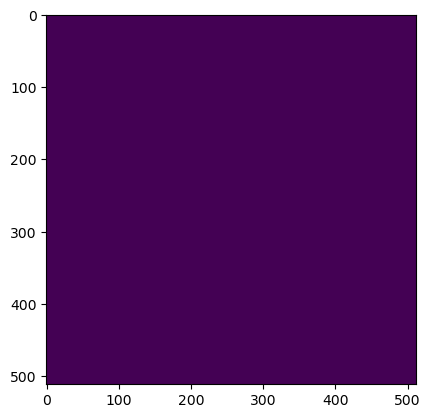

Wrote output/patches/mask/CU_S1_42-458499-2000-6279086-4000.tiff (512 x 512 pixels)


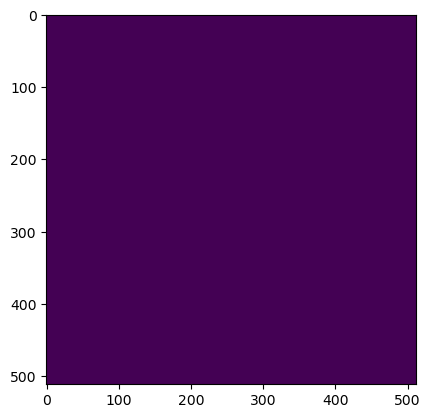

Wrote output/patches/mask/CU_S1_42-458499-2000-6279188-8000.tiff (512 x 512 pixels)


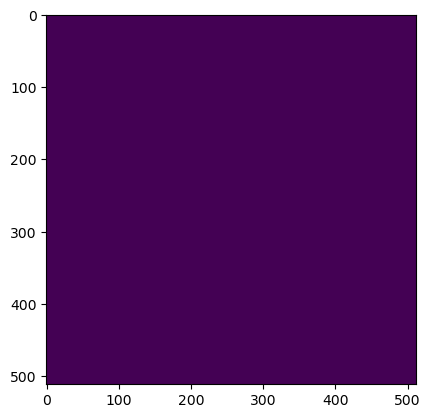

Wrote output/patches/mask/CU_S1_42-458499-2000-6279291-2000.tiff (512 x 512 pixels)


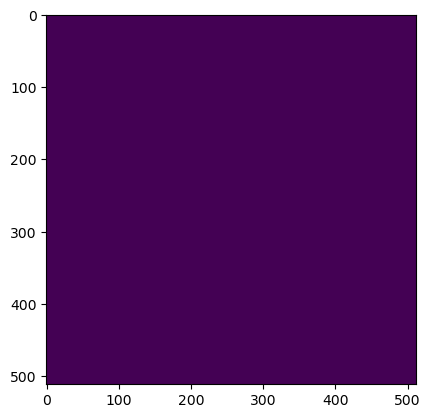

Wrote output/patches/mask/CU_S1_42-458499-2000-6279393-6000.tiff (512 x 512 pixels)
Zone CV_S1_43 Building Mask...


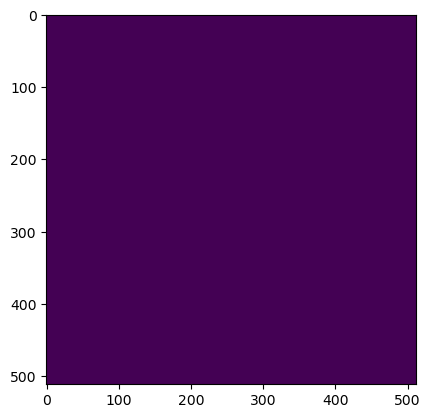

Wrote output/patches/mask/CV_S1_43-514256-0000-6279598-4000.tiff (512 x 512 pixels)


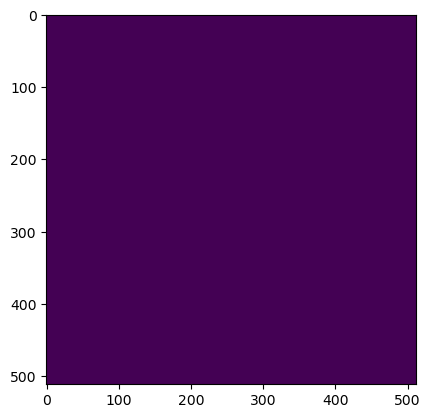

Wrote output/patches/mask/CV_S1_43-514256-0000-6279700-8000.tiff (512 x 512 pixels)


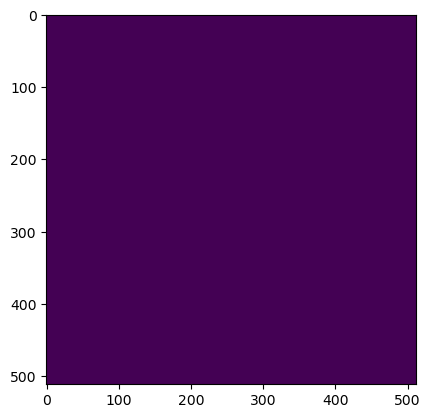

Wrote output/patches/mask/CV_S1_43-514358-4000-6279598-4000.tiff (512 x 512 pixels)


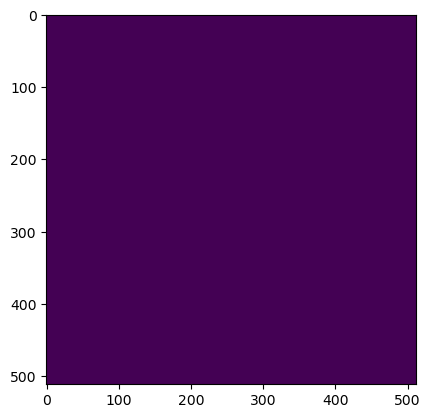

Wrote output/patches/mask/CV_S1_43-514358-4000-6279700-8000.tiff (512 x 512 pixels)
Zone UU_S1_44 Building Mask...


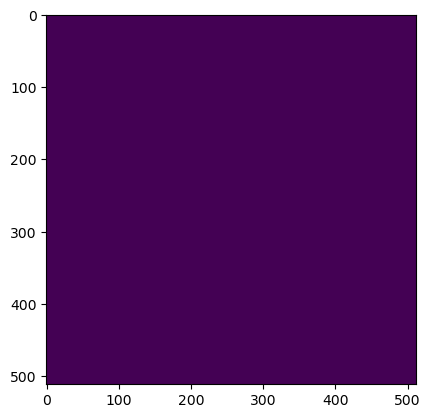

Wrote output/patches/mask/UU_S1_44-544464-0000-6280110-4000.tiff (512 x 512 pixels)


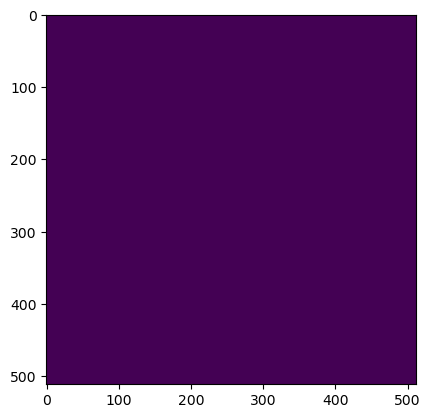

Wrote output/patches/mask/UU_S1_44-544464-0000-6280212-8000.tiff (512 x 512 pixels)


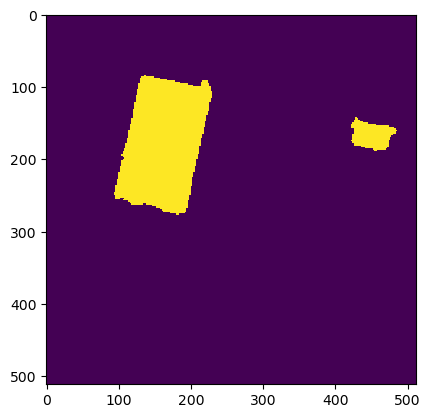

Wrote output/patches/mask/UU_S1_44-544464-0000-6280315-2000.tiff (512 x 512 pixels)


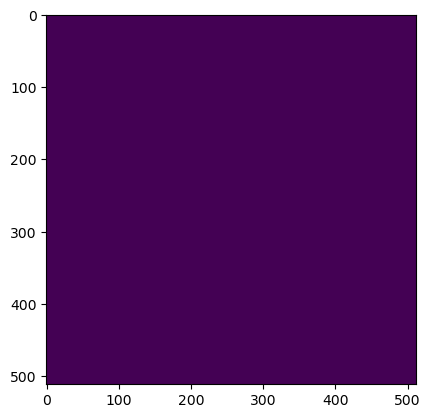

Wrote output/patches/mask/UU_S1_44-544464-0000-6280417-6000.tiff (512 x 512 pixels)


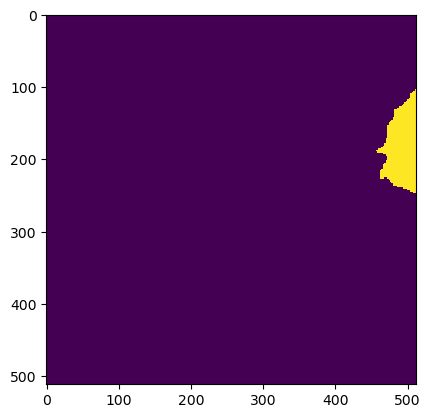

Wrote output/patches/mask/UU_S1_44-544464-0000-6280520-0000.tiff (512 x 512 pixels)


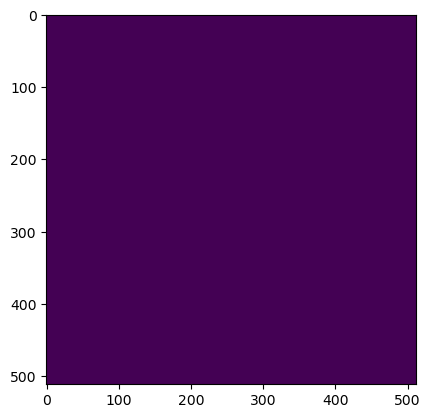

Wrote output/patches/mask/UU_S1_44-544464-0000-6280622-4000.tiff (512 x 512 pixels)


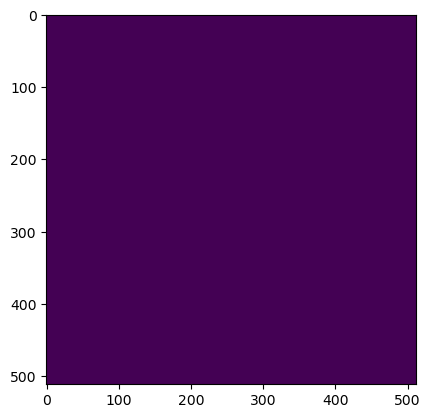

Wrote output/patches/mask/UU_S1_44-544464-0000-6280724-8000.tiff (512 x 512 pixels)


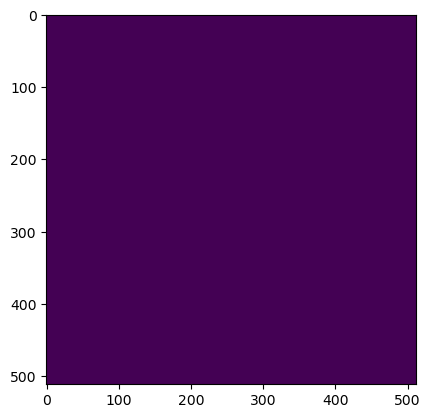

Wrote output/patches/mask/UU_S1_44-544566-4000-6280110-4000.tiff (512 x 512 pixels)


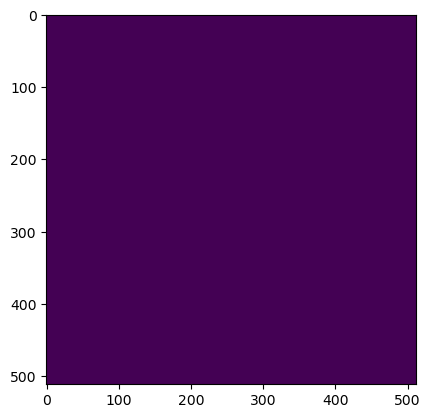

Wrote output/patches/mask/UU_S1_44-544566-4000-6280212-8000.tiff (512 x 512 pixels)


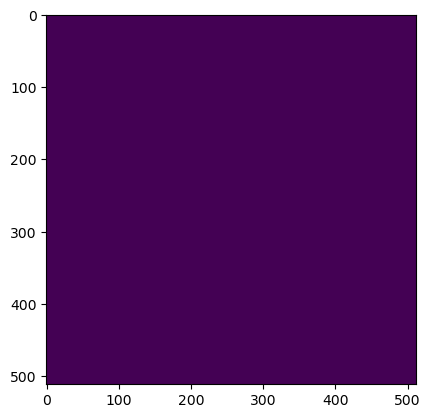

Wrote output/patches/mask/UU_S1_44-544566-4000-6280315-2000.tiff (512 x 512 pixels)


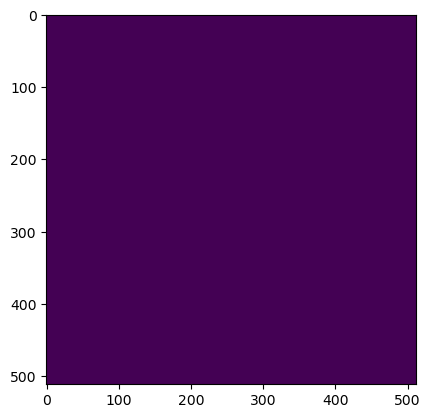

Wrote output/patches/mask/UU_S1_44-544566-4000-6280417-6000.tiff (512 x 512 pixels)


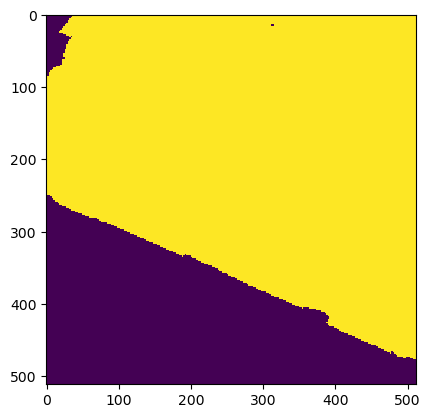

Wrote output/patches/mask/UU_S1_44-544566-4000-6280520-0000.tiff (512 x 512 pixels)


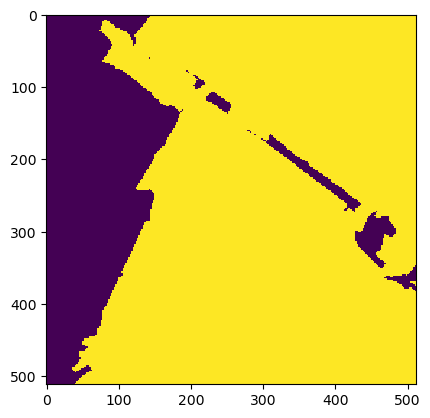

Wrote output/patches/mask/UU_S1_44-544566-4000-6280622-4000.tiff (512 x 512 pixels)


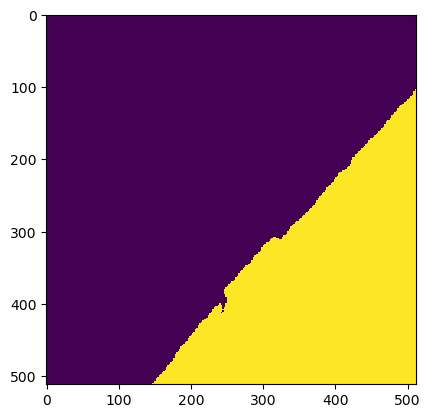

Wrote output/patches/mask/UU_S1_44-544566-4000-6280724-8000.tiff (512 x 512 pixels)


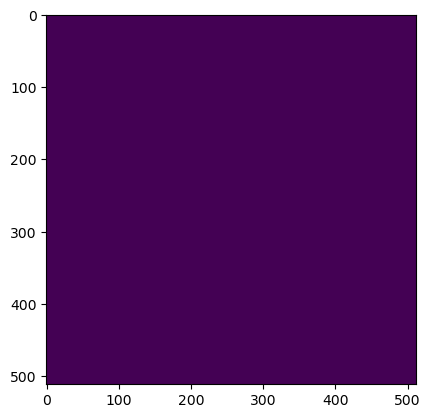

Wrote output/patches/mask/UU_S1_44-544668-8000-6280110-4000.tiff (512 x 512 pixels)


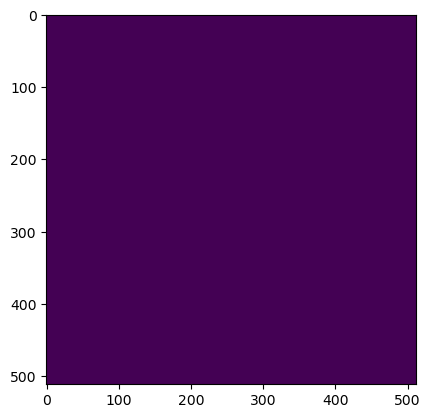

Wrote output/patches/mask/UU_S1_44-544668-8000-6280212-8000.tiff (512 x 512 pixels)


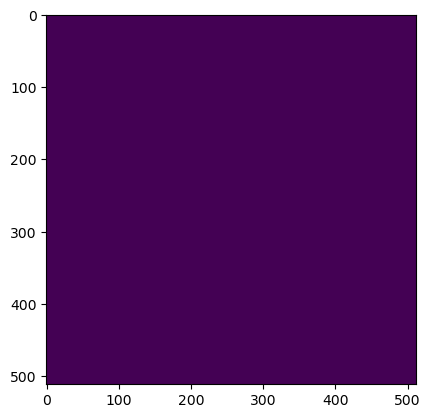

Wrote output/patches/mask/UU_S1_44-544668-8000-6280315-2000.tiff (512 x 512 pixels)


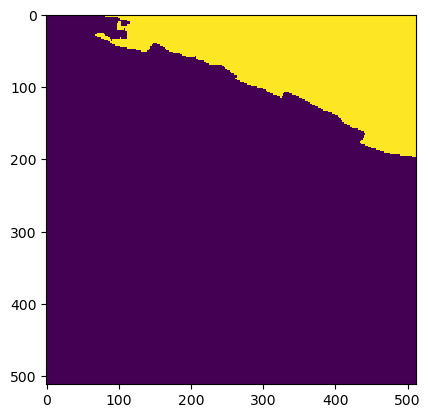

Wrote output/patches/mask/UU_S1_44-544668-8000-6280417-6000.tiff (512 x 512 pixels)


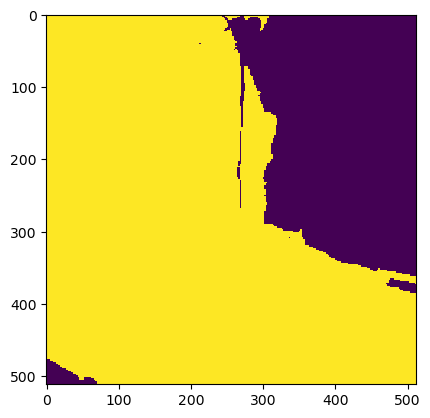

Wrote output/patches/mask/UU_S1_44-544668-8000-6280520-0000.tiff (512 x 512 pixels)


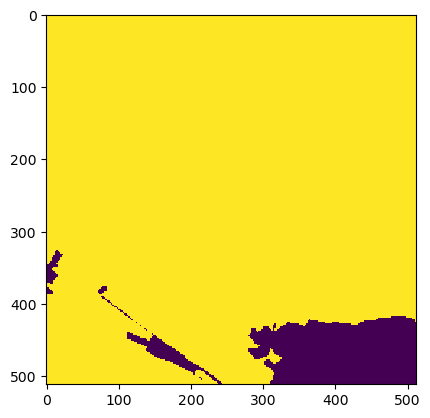

Wrote output/patches/mask/UU_S1_44-544668-8000-6280622-4000.tiff (512 x 512 pixels)


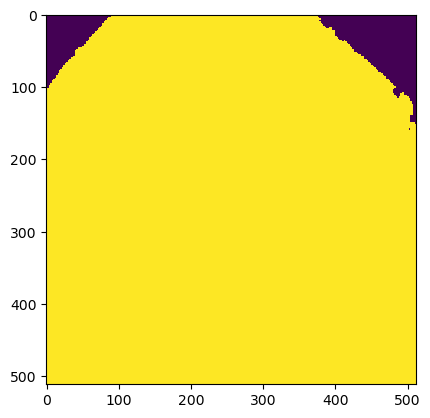

Wrote output/patches/mask/UU_S1_44-544668-8000-6280724-8000.tiff (512 x 512 pixels)


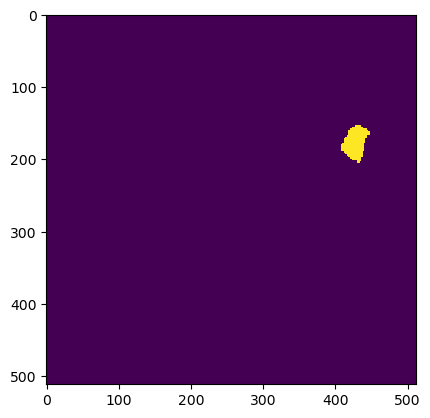

Wrote output/patches/mask/UU_S1_44-544771-2000-6280110-4000.tiff (512 x 512 pixels)


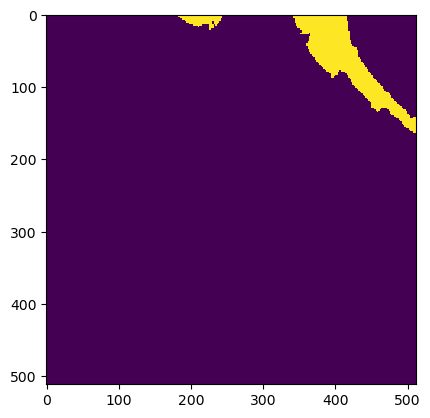

Wrote output/patches/mask/UU_S1_44-544771-2000-6280212-8000.tiff (512 x 512 pixels)


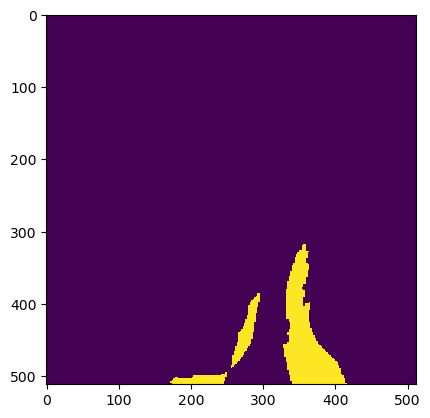

Wrote output/patches/mask/UU_S1_44-544771-2000-6280315-2000.tiff (512 x 512 pixels)


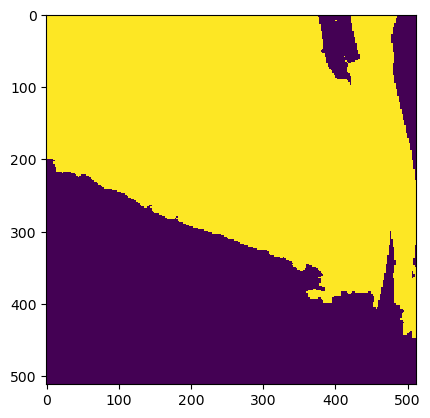

Wrote output/patches/mask/UU_S1_44-544771-2000-6280417-6000.tiff (512 x 512 pixels)


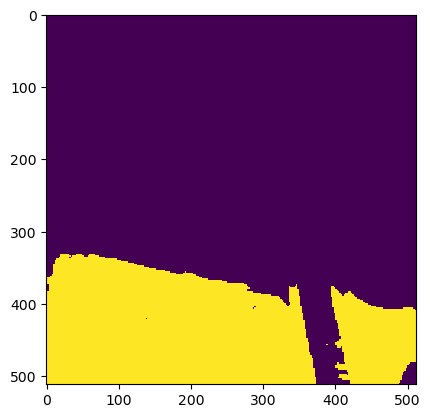

Wrote output/patches/mask/UU_S1_44-544771-2000-6280520-0000.tiff (512 x 512 pixels)


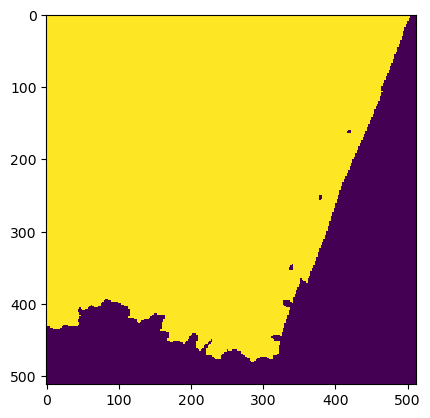

Wrote output/patches/mask/UU_S1_44-544771-2000-6280622-4000.tiff (512 x 512 pixels)


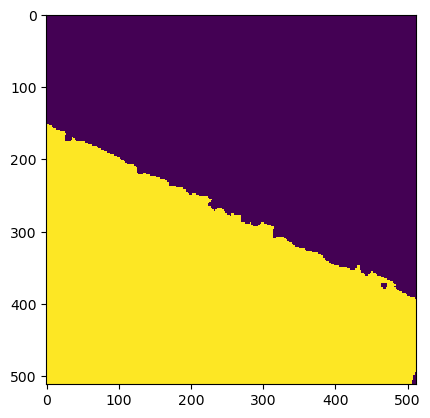

Wrote output/patches/mask/UU_S1_44-544771-2000-6280724-8000.tiff (512 x 512 pixels)
Zone CU_S1_45 Building Mask...


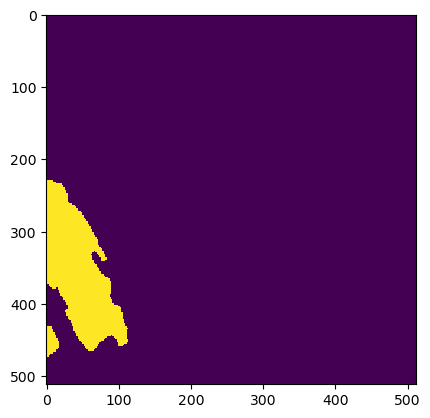

Wrote output/patches/mask/CU_S1_45-506320-0000-6280366-4000.tiff (512 x 512 pixels)


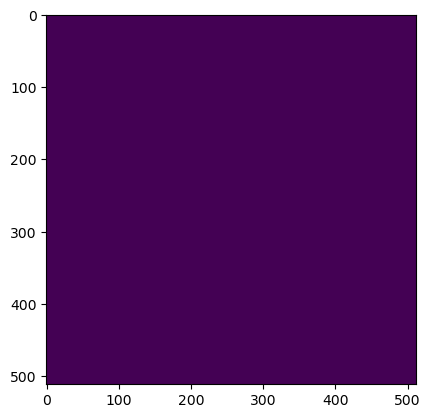

Wrote output/patches/mask/CU_S1_45-506320-0000-6280468-8000.tiff (512 x 512 pixels)


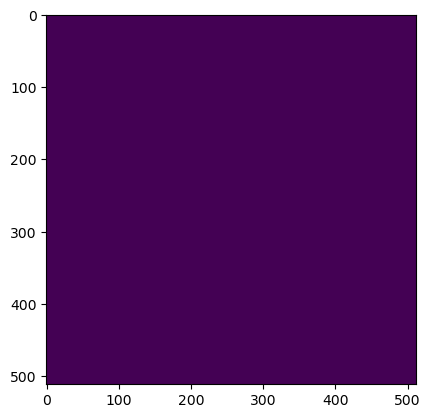

Wrote output/patches/mask/CU_S1_45-506422-4000-6280366-4000.tiff (512 x 512 pixels)


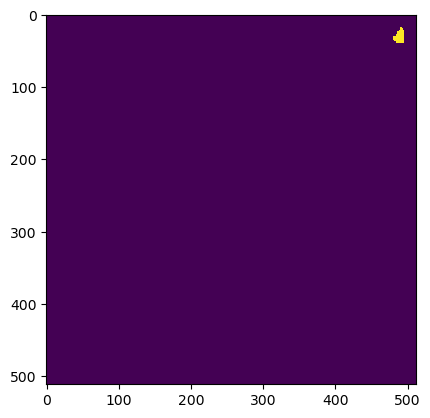

Wrote output/patches/mask/CU_S1_45-506422-4000-6280468-8000.tiff (512 x 512 pixels)
Zone UU_S1_46 Building Mask...


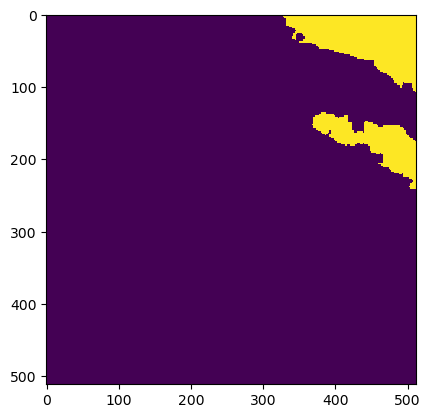

Wrote output/patches/mask/UU_S1_46-545744-0000-6280622-4000.tiff (512 x 512 pixels)


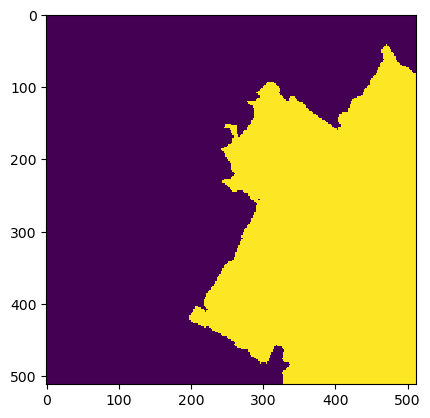

Wrote output/patches/mask/UU_S1_46-545744-0000-6280724-8000.tiff (512 x 512 pixels)


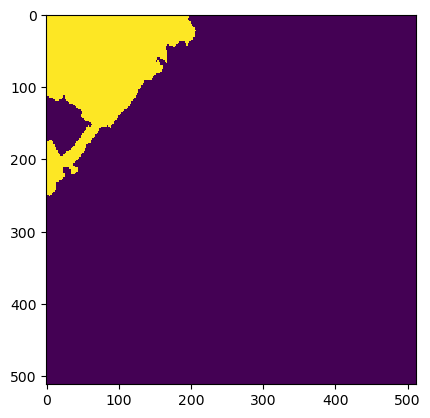

Wrote output/patches/mask/UU_S1_46-545846-4000-6280622-4000.tiff (512 x 512 pixels)


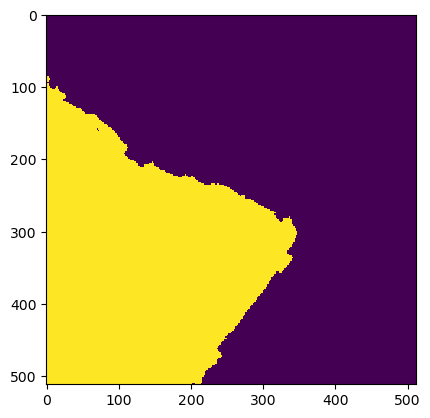

Wrote output/patches/mask/UU_S1_46-545846-4000-6280724-8000.tiff (512 x 512 pixels)
Zone UC_S1_47 Building Mask...


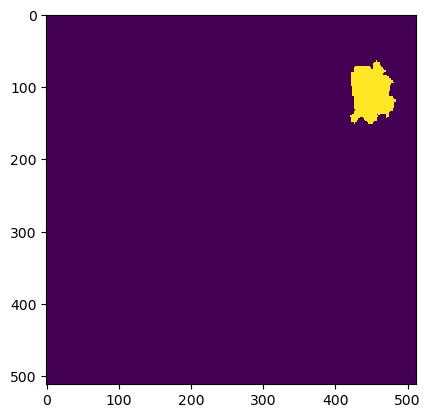

Wrote output/patches/mask/UC_S1_47-458448-0000-6281134-4000.tiff (512 x 512 pixels)


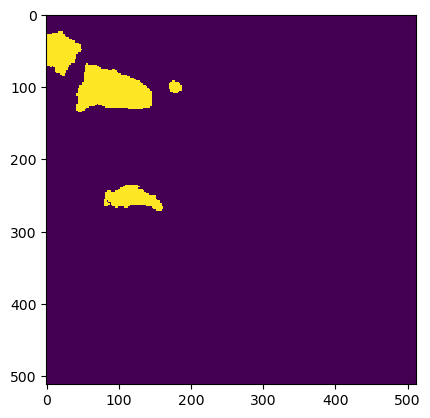

Wrote output/patches/mask/UC_S1_47-458448-0000-6281236-8000.tiff (512 x 512 pixels)


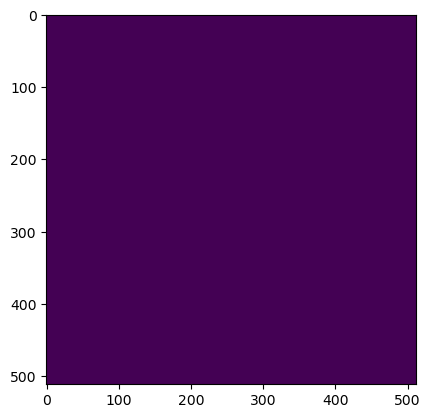

Wrote output/patches/mask/UC_S1_47-458550-4000-6281134-4000.tiff (512 x 512 pixels)


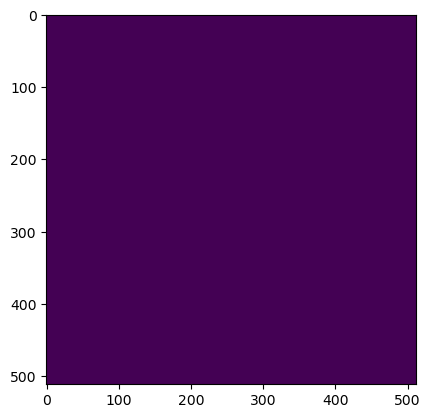

Wrote output/patches/mask/UC_S1_47-458550-4000-6281236-8000.tiff (512 x 512 pixels)


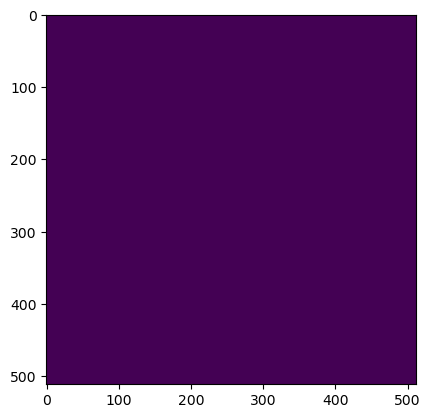

Wrote output/patches/mask/UC_S1_47-458652-8000-6281134-4000.tiff (512 x 512 pixels)


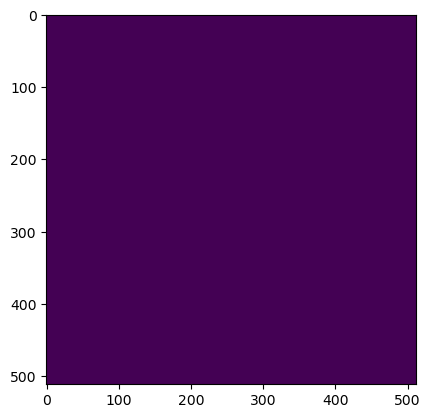

Wrote output/patches/mask/UC_S1_47-458652-8000-6281236-8000.tiff (512 x 512 pixels)


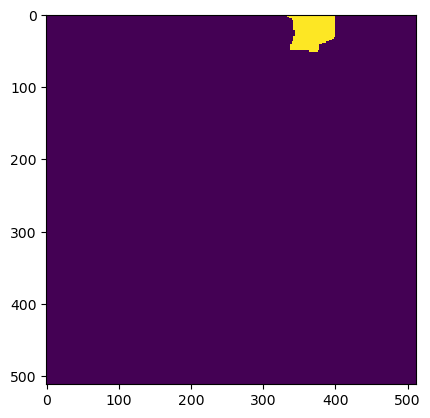

Wrote output/patches/mask/UC_S1_47-458755-2000-6281134-4000.tiff (512 x 512 pixels)


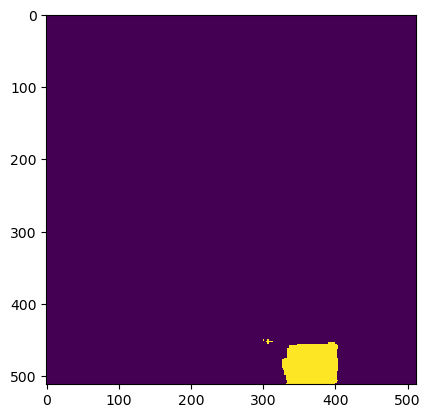

Wrote output/patches/mask/UC_S1_47-458755-2000-6281236-8000.tiff (512 x 512 pixels)
Zone UU_S1_48 Building Mask...


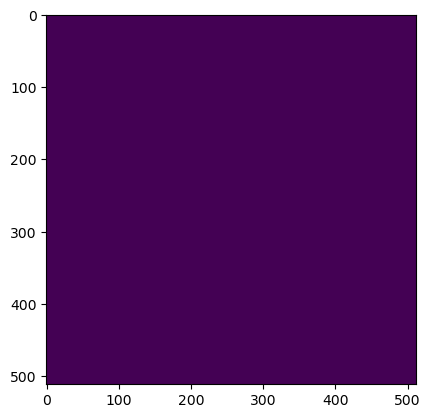

Wrote output/patches/mask/UU_S1_48-507856-0000-6281390-4000.tiff (512 x 512 pixels)


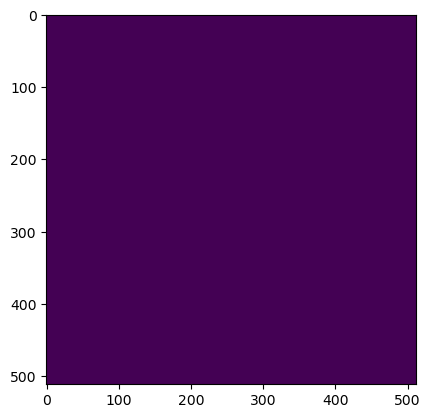

Wrote output/patches/mask/UU_S1_48-507856-0000-6281492-8000.tiff (512 x 512 pixels)


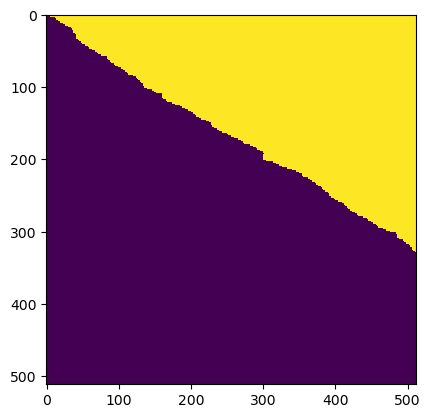

Wrote output/patches/mask/UU_S1_48-507856-0000-6281595-2000.tiff (512 x 512 pixels)


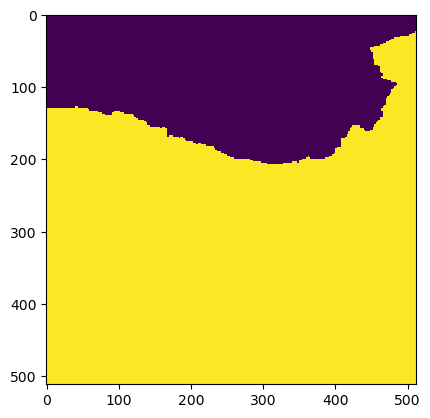

Wrote output/patches/mask/UU_S1_48-507856-0000-6281697-6000.tiff (512 x 512 pixels)


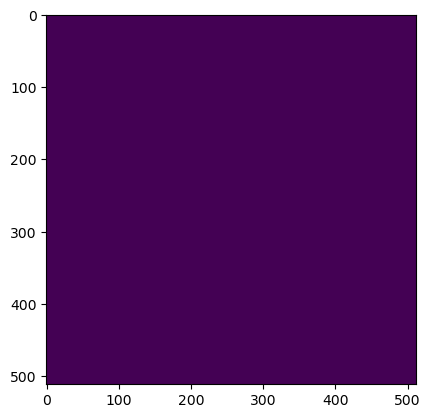

Wrote output/patches/mask/UU_S1_48-507958-4000-6281390-4000.tiff (512 x 512 pixels)


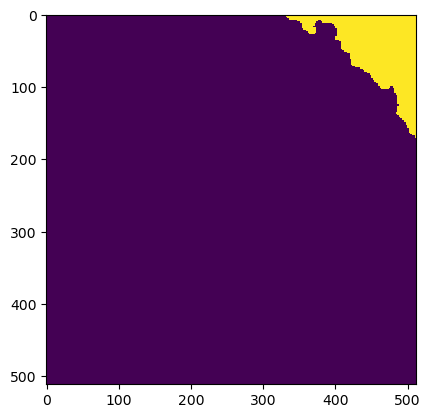

Wrote output/patches/mask/UU_S1_48-507958-4000-6281492-8000.tiff (512 x 512 pixels)


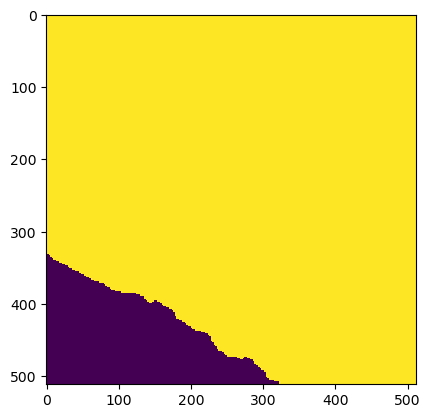

Wrote output/patches/mask/UU_S1_48-507958-4000-6281595-2000.tiff (512 x 512 pixels)


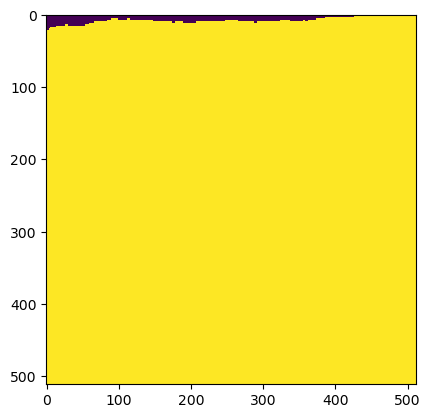

Wrote output/patches/mask/UU_S1_48-507958-4000-6281697-6000.tiff (512 x 512 pixels)


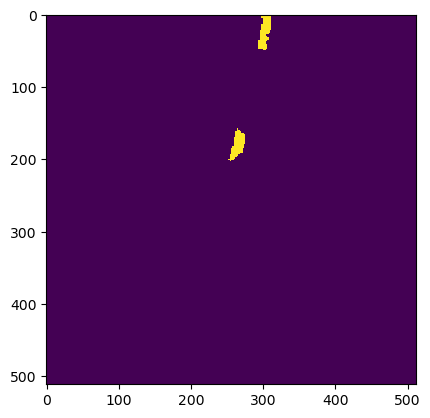

Wrote output/patches/mask/UU_S1_48-508060-8000-6281390-4000.tiff (512 x 512 pixels)


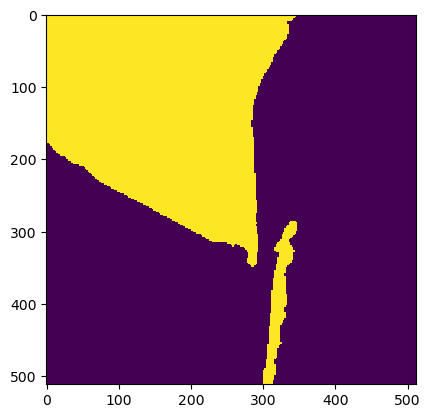

Wrote output/patches/mask/UU_S1_48-508060-8000-6281492-8000.tiff (512 x 512 pixels)


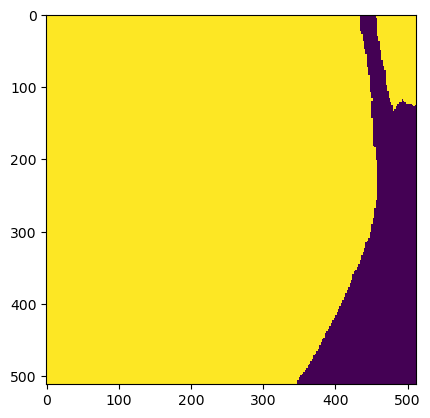

Wrote output/patches/mask/UU_S1_48-508060-8000-6281595-2000.tiff (512 x 512 pixels)


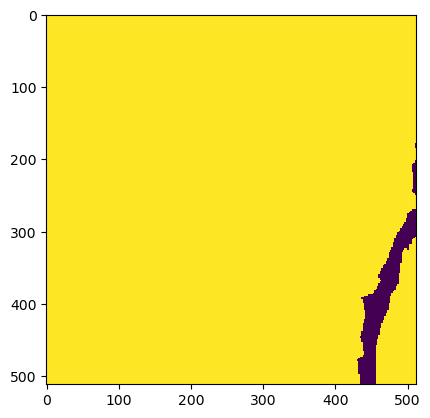

Wrote output/patches/mask/UU_S1_48-508060-8000-6281697-6000.tiff (512 x 512 pixels)


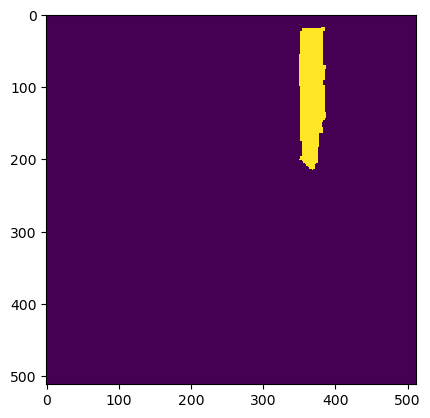

Wrote output/patches/mask/UU_S1_48-508163-2000-6281390-4000.tiff (512 x 512 pixels)


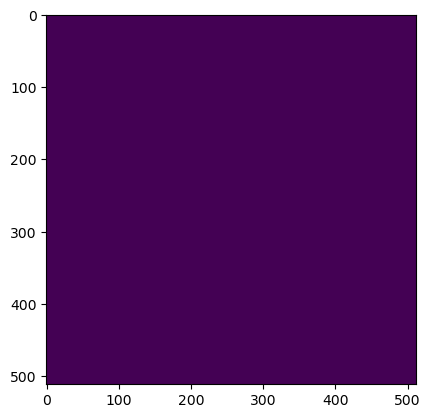

Wrote output/patches/mask/UU_S1_48-508163-2000-6281492-8000.tiff (512 x 512 pixels)


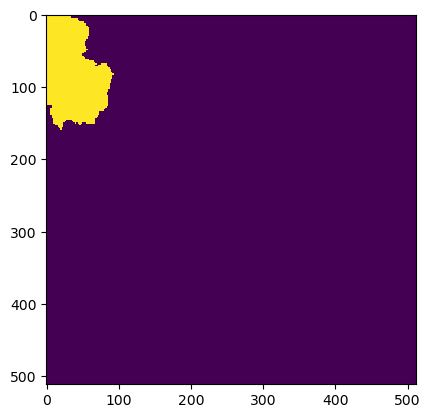

Wrote output/patches/mask/UU_S1_48-508163-2000-6281595-2000.tiff (512 x 512 pixels)


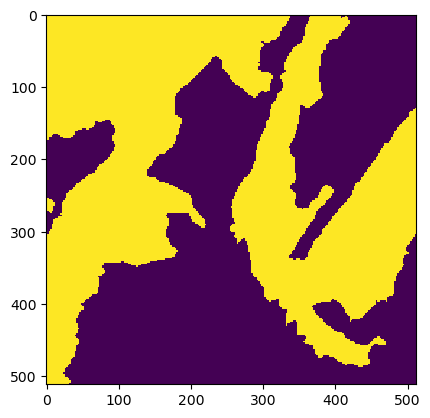

Wrote output/patches/mask/UU_S1_48-508163-2000-6281697-6000.tiff (512 x 512 pixels)


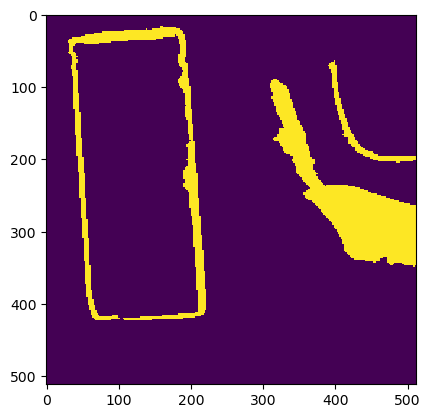

Wrote output/patches/mask/UU_S1_48-508265-6000-6281390-4000.tiff (512 x 512 pixels)


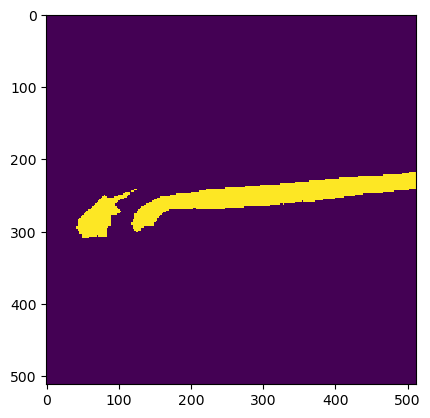

Wrote output/patches/mask/UU_S1_48-508265-6000-6281492-8000.tiff (512 x 512 pixels)


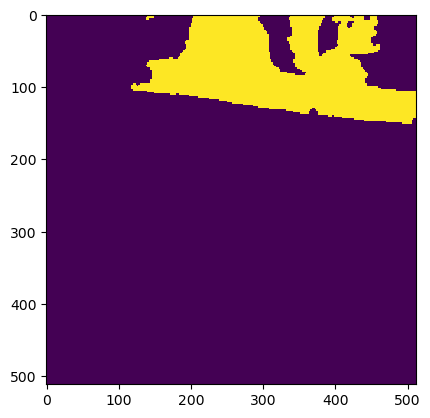

Wrote output/patches/mask/UU_S1_48-508265-6000-6281595-2000.tiff (512 x 512 pixels)


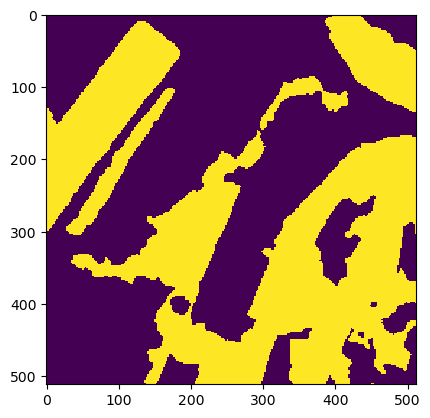

Wrote output/patches/mask/UU_S1_48-508265-6000-6281697-6000.tiff (512 x 512 pixels)


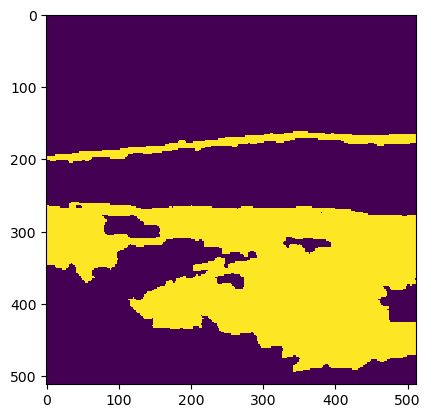

Wrote output/patches/mask/UU_S1_48-508368-0000-6281390-4000.tiff (512 x 512 pixels)


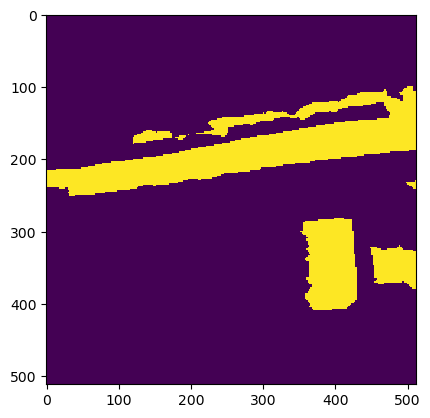

Wrote output/patches/mask/UU_S1_48-508368-0000-6281492-8000.tiff (512 x 512 pixels)


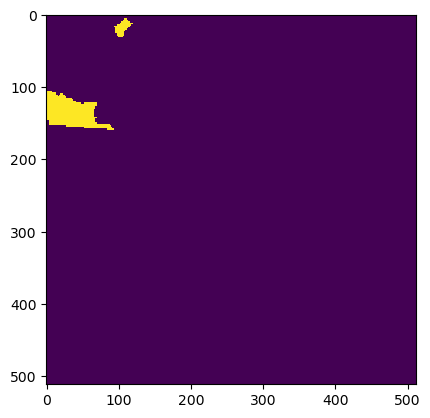

Wrote output/patches/mask/UU_S1_48-508368-0000-6281595-2000.tiff (512 x 512 pixels)


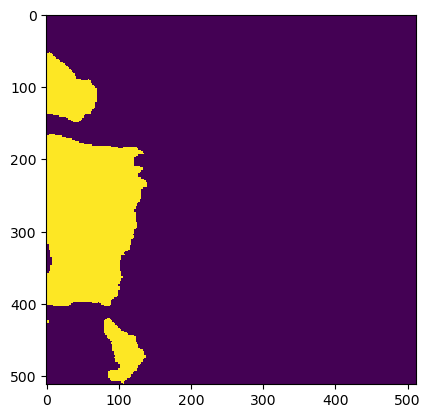

Wrote output/patches/mask/UU_S1_48-508368-0000-6281697-6000.tiff (512 x 512 pixels)


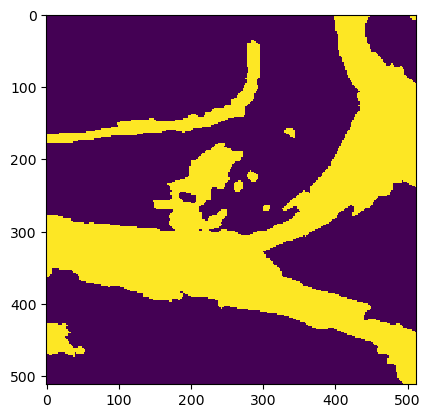

Wrote output/patches/mask/UU_S1_48-508470-4000-6281390-4000.tiff (512 x 512 pixels)


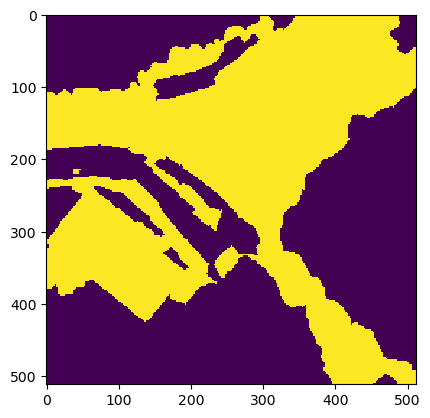

Wrote output/patches/mask/UU_S1_48-508470-4000-6281492-8000.tiff (512 x 512 pixels)


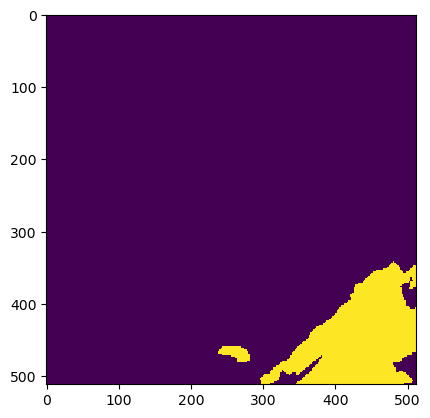

Wrote output/patches/mask/UU_S1_48-508470-4000-6281595-2000.tiff (512 x 512 pixels)


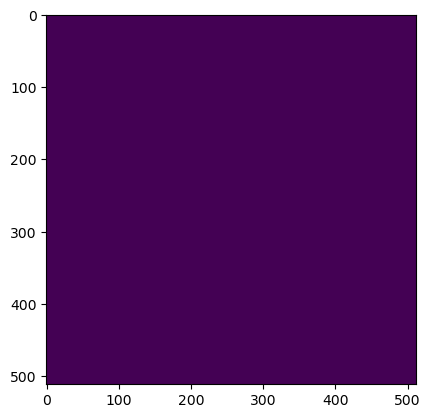

Wrote output/patches/mask/UU_S1_48-508470-4000-6281697-6000.tiff (512 x 512 pixels)
Zone NV_S1_49 Building Mask...


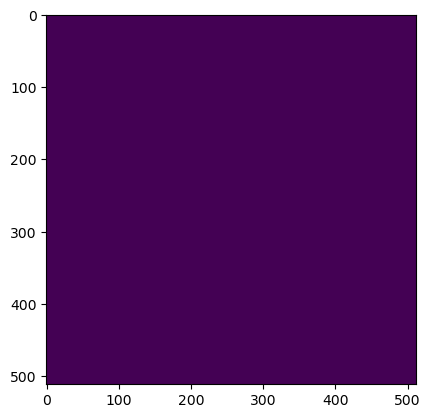

Wrote output/patches/mask/NV_S1_49-475856-0000-6281390-4000.tiff (512 x 512 pixels)


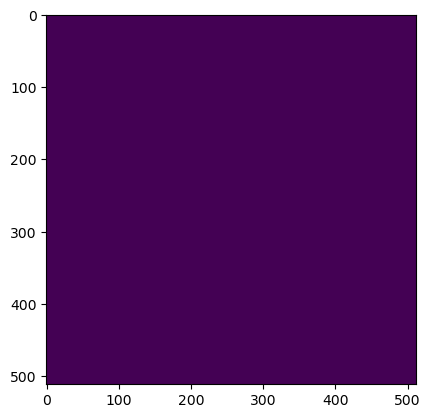

Wrote output/patches/mask/NV_S1_49-475856-0000-6281492-8000.tiff (512 x 512 pixels)


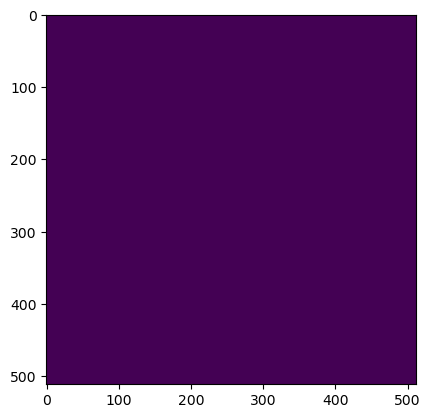

Wrote output/patches/mask/NV_S1_49-475856-0000-6281595-2000.tiff (512 x 512 pixels)


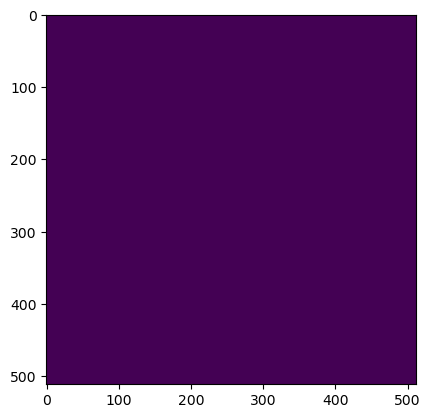

Wrote output/patches/mask/NV_S1_49-475856-0000-6281697-6000.tiff (512 x 512 pixels)


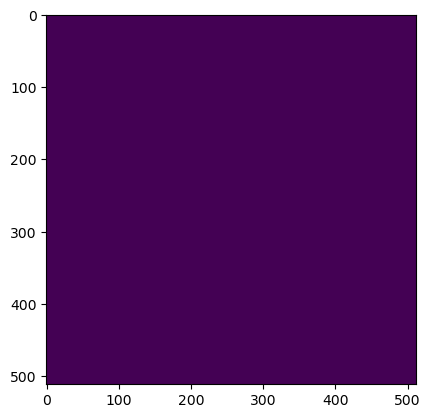

Wrote output/patches/mask/NV_S1_49-475856-0000-6281800-0000.tiff (512 x 512 pixels)


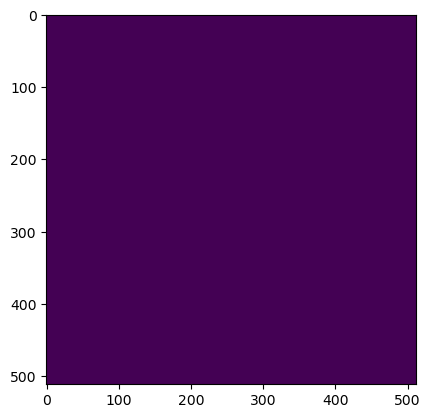

Wrote output/patches/mask/NV_S1_49-475856-0000-6281902-4000.tiff (512 x 512 pixels)


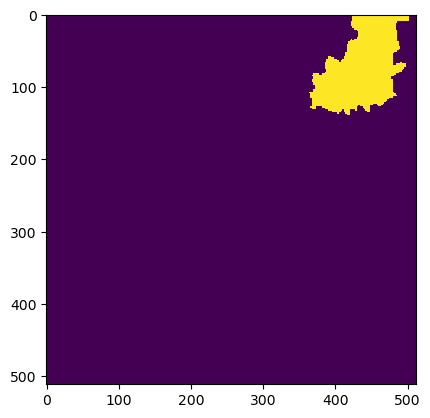

Wrote output/patches/mask/NV_S1_49-475856-0000-6282004-8000.tiff (512 x 512 pixels)


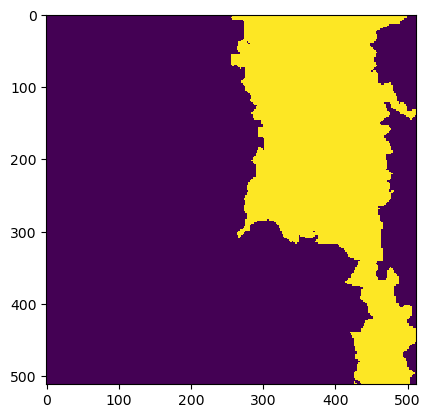

Wrote output/patches/mask/NV_S1_49-475856-0000-6282107-2000.tiff (512 x 512 pixels)


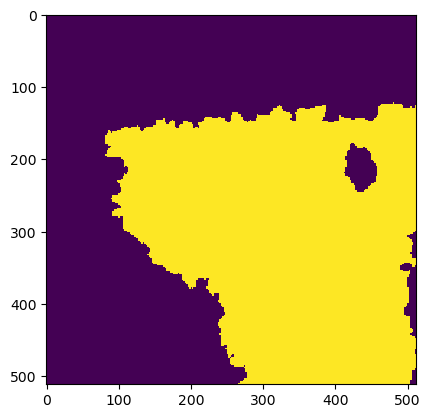

Wrote output/patches/mask/NV_S1_49-475856-0000-6282209-6000.tiff (512 x 512 pixels)


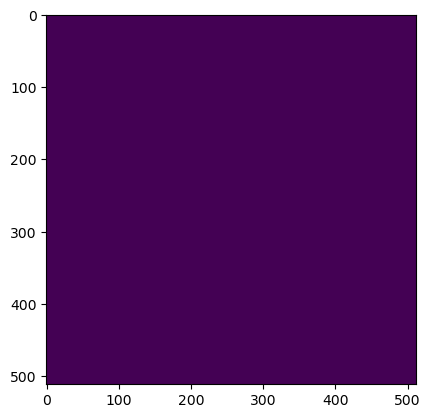

Wrote output/patches/mask/NV_S1_49-475958-4000-6281390-4000.tiff (512 x 512 pixels)


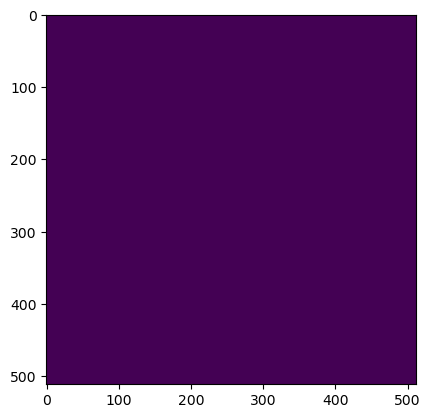

Wrote output/patches/mask/NV_S1_49-475958-4000-6281492-8000.tiff (512 x 512 pixels)


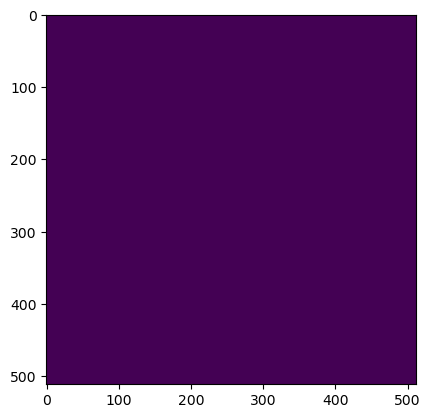

Wrote output/patches/mask/NV_S1_49-475958-4000-6281595-2000.tiff (512 x 512 pixels)


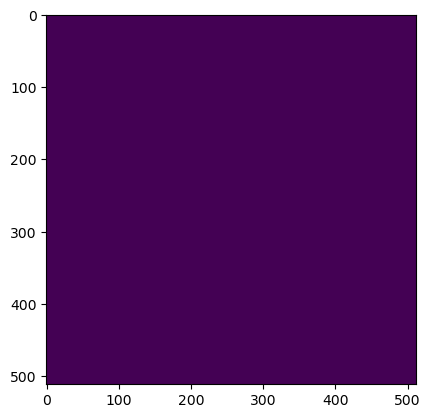

Wrote output/patches/mask/NV_S1_49-475958-4000-6281697-6000.tiff (512 x 512 pixels)


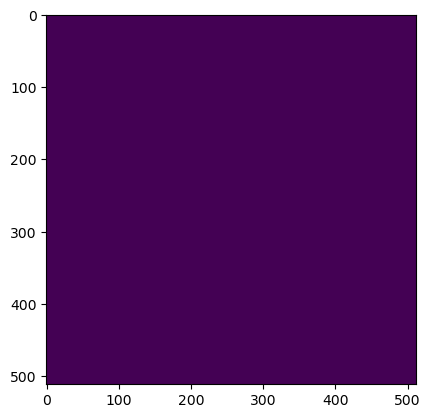

Wrote output/patches/mask/NV_S1_49-475958-4000-6281800-0000.tiff (512 x 512 pixels)


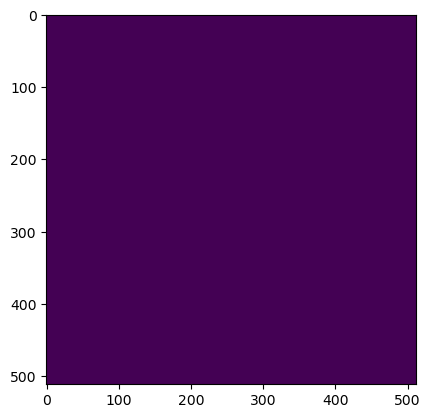

Wrote output/patches/mask/NV_S1_49-475958-4000-6281902-4000.tiff (512 x 512 pixels)


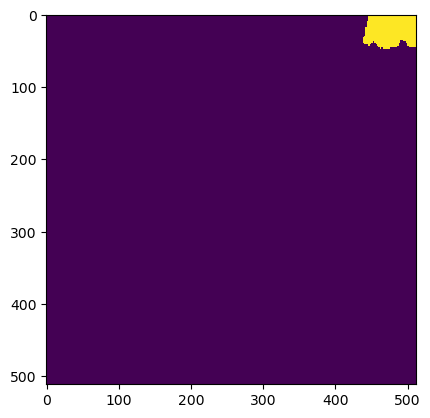

Wrote output/patches/mask/NV_S1_49-475958-4000-6282004-8000.tiff (512 x 512 pixels)


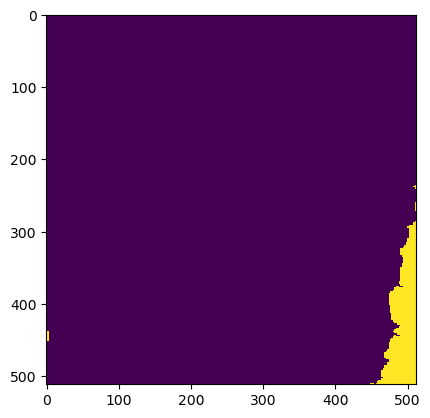

Wrote output/patches/mask/NV_S1_49-475958-4000-6282107-2000.tiff (512 x 512 pixels)


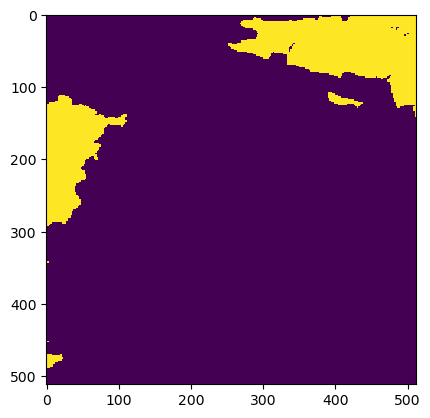

Wrote output/patches/mask/NV_S1_49-475958-4000-6282209-6000.tiff (512 x 512 pixels)


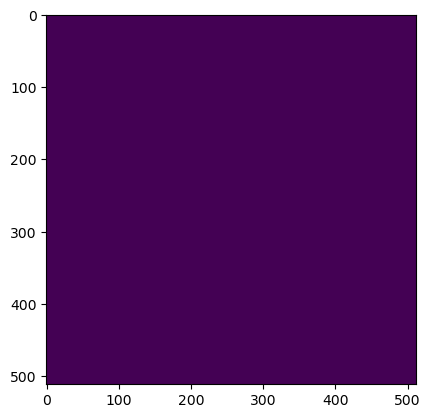

Wrote output/patches/mask/NV_S1_49-476060-8000-6281390-4000.tiff (512 x 512 pixels)


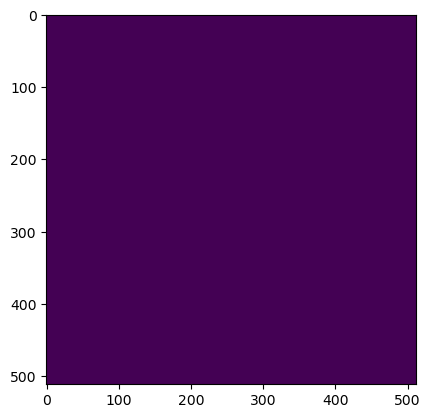

Wrote output/patches/mask/NV_S1_49-476060-8000-6281492-8000.tiff (512 x 512 pixels)


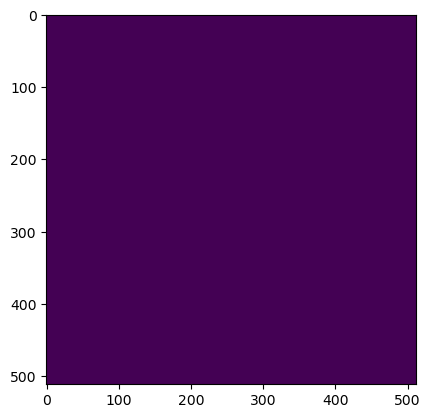

Wrote output/patches/mask/NV_S1_49-476060-8000-6281595-2000.tiff (512 x 512 pixels)


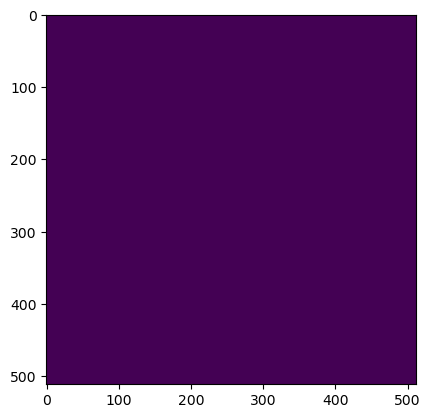

Wrote output/patches/mask/NV_S1_49-476060-8000-6281697-6000.tiff (512 x 512 pixels)


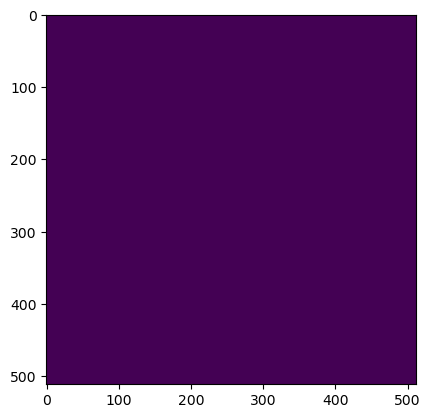

Wrote output/patches/mask/NV_S1_49-476060-8000-6281800-0000.tiff (512 x 512 pixels)


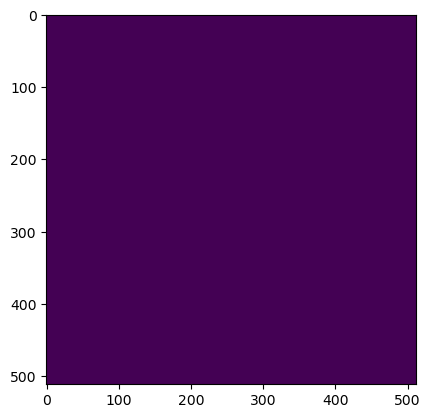

Wrote output/patches/mask/NV_S1_49-476060-8000-6281902-4000.tiff (512 x 512 pixels)


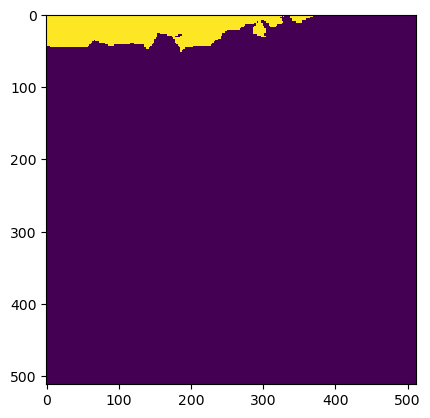

Wrote output/patches/mask/NV_S1_49-476060-8000-6282004-8000.tiff (512 x 512 pixels)


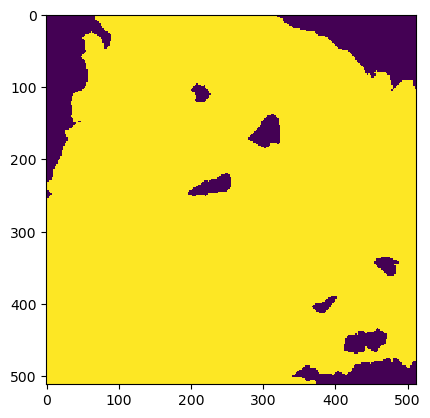

Wrote output/patches/mask/NV_S1_49-476060-8000-6282107-2000.tiff (512 x 512 pixels)


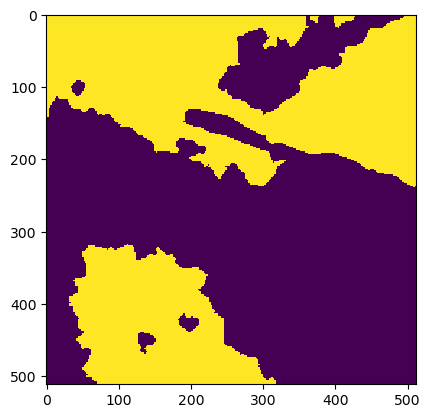

Wrote output/patches/mask/NV_S1_49-476060-8000-6282209-6000.tiff (512 x 512 pixels)


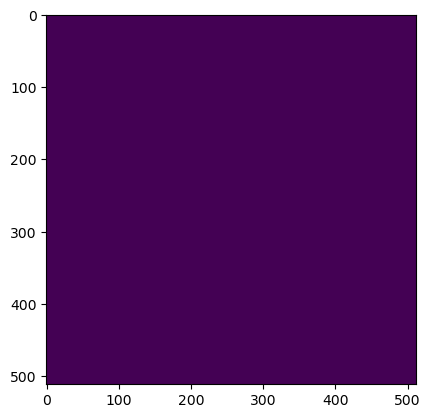

Wrote output/patches/mask/NV_S1_49-476163-2000-6281390-4000.tiff (512 x 512 pixels)


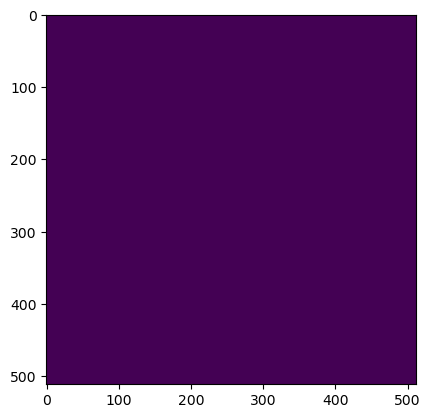

Wrote output/patches/mask/NV_S1_49-476163-2000-6281492-8000.tiff (512 x 512 pixels)


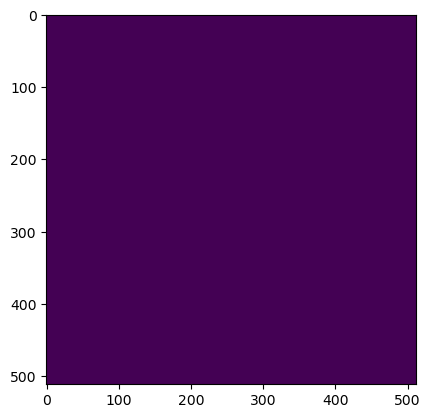

Wrote output/patches/mask/NV_S1_49-476163-2000-6281595-2000.tiff (512 x 512 pixels)


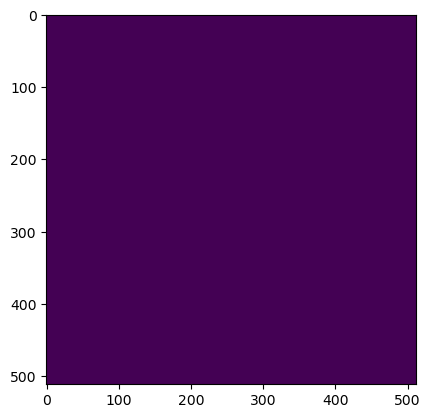

Wrote output/patches/mask/NV_S1_49-476163-2000-6281697-6000.tiff (512 x 512 pixels)


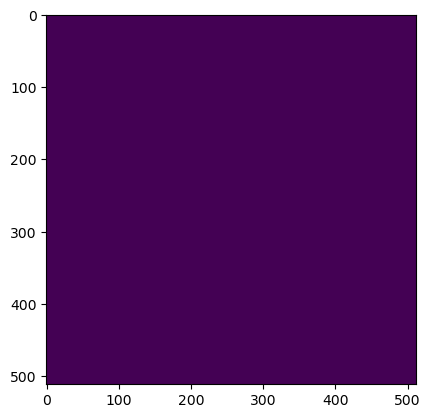

Wrote output/patches/mask/NV_S1_49-476163-2000-6281800-0000.tiff (512 x 512 pixels)


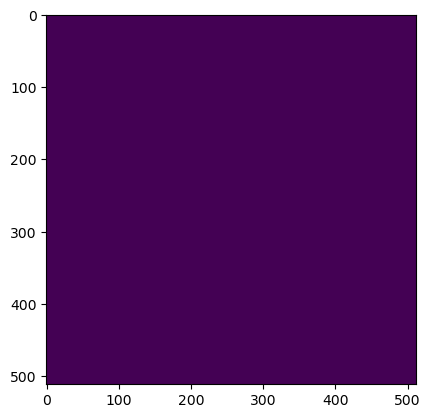

Wrote output/patches/mask/NV_S1_49-476163-2000-6281902-4000.tiff (512 x 512 pixels)


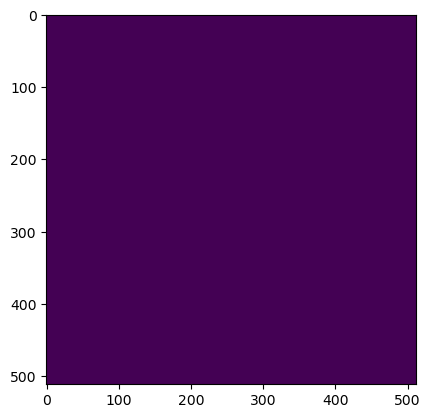

Wrote output/patches/mask/NV_S1_49-476163-2000-6282004-8000.tiff (512 x 512 pixels)


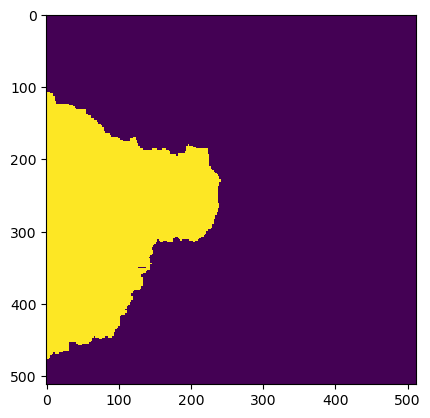

Wrote output/patches/mask/NV_S1_49-476163-2000-6282107-2000.tiff (512 x 512 pixels)


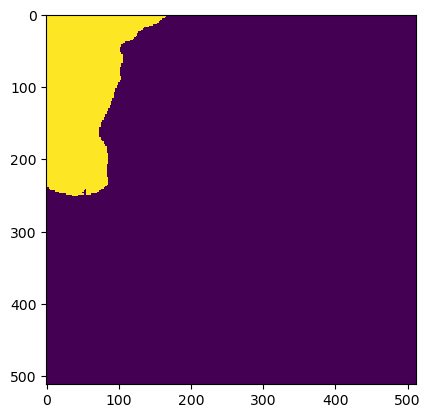

Wrote output/patches/mask/NV_S1_49-476163-2000-6282209-6000.tiff (512 x 512 pixels)


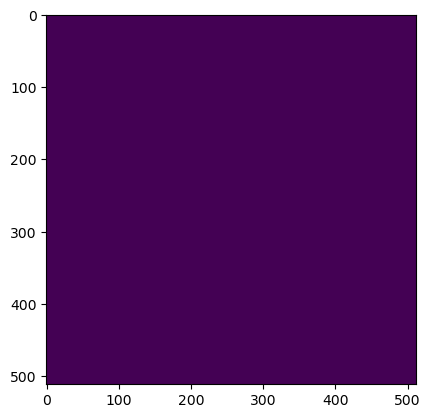

Wrote output/patches/mask/NV_S1_49-476265-6000-6281390-4000.tiff (512 x 512 pixels)


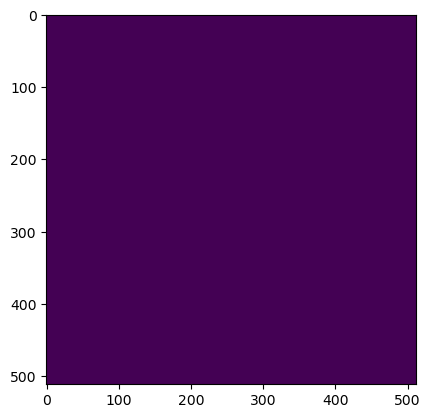

Wrote output/patches/mask/NV_S1_49-476265-6000-6281492-8000.tiff (512 x 512 pixels)


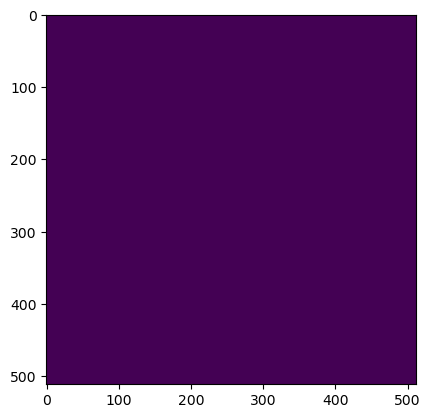

Wrote output/patches/mask/NV_S1_49-476265-6000-6281595-2000.tiff (512 x 512 pixels)


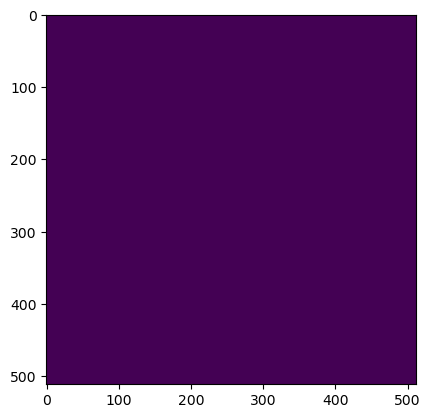

Wrote output/patches/mask/NV_S1_49-476265-6000-6281697-6000.tiff (512 x 512 pixels)


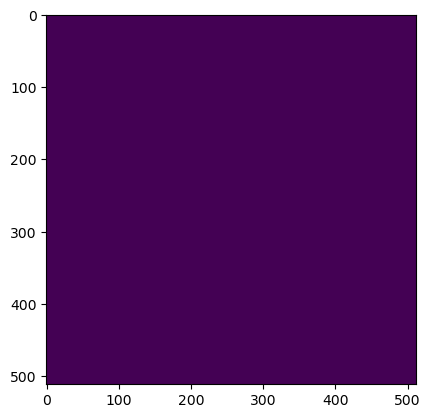

Wrote output/patches/mask/NV_S1_49-476265-6000-6281800-0000.tiff (512 x 512 pixels)


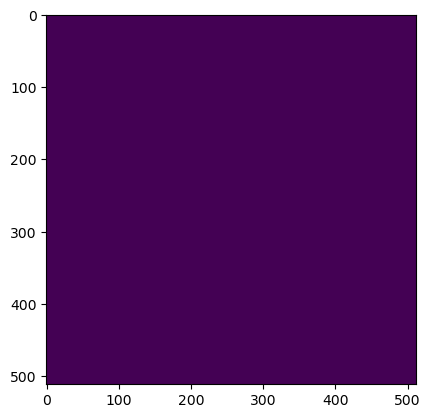

Wrote output/patches/mask/NV_S1_49-476265-6000-6281902-4000.tiff (512 x 512 pixels)


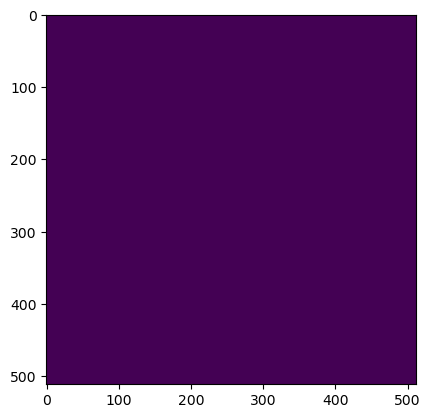

Wrote output/patches/mask/NV_S1_49-476265-6000-6282004-8000.tiff (512 x 512 pixels)


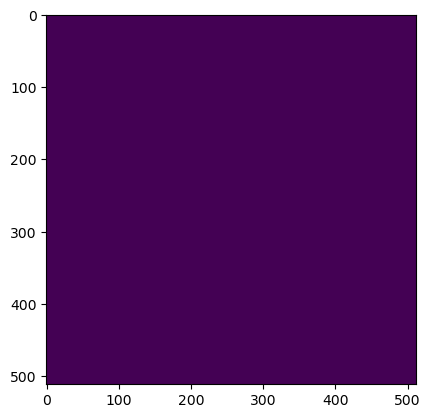

Wrote output/patches/mask/NV_S1_49-476265-6000-6282107-2000.tiff (512 x 512 pixels)


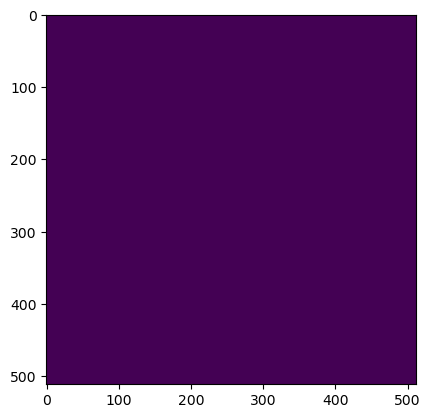

Wrote output/patches/mask/NV_S1_49-476265-6000-6282209-6000.tiff (512 x 512 pixels)


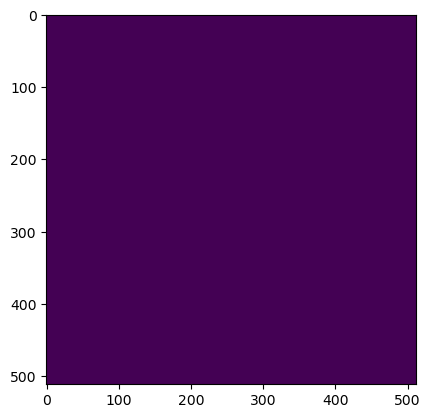

Wrote output/patches/mask/NV_S1_49-476368-0000-6281390-4000.tiff (512 x 512 pixels)


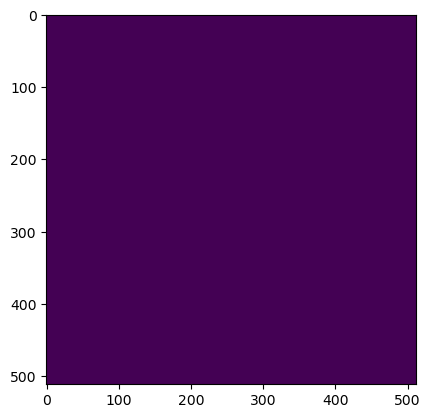

Wrote output/patches/mask/NV_S1_49-476368-0000-6281492-8000.tiff (512 x 512 pixels)


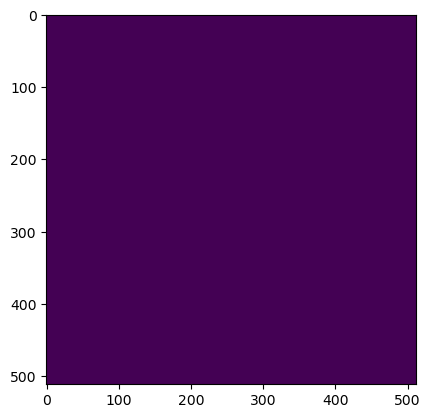

Wrote output/patches/mask/NV_S1_49-476368-0000-6281595-2000.tiff (512 x 512 pixels)


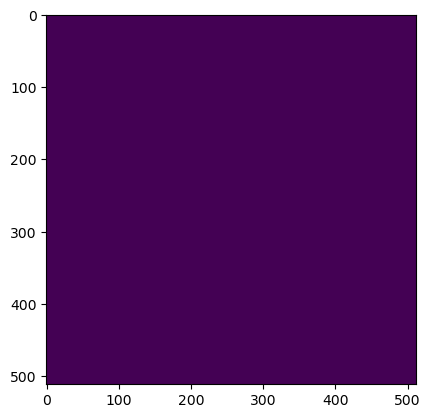

Wrote output/patches/mask/NV_S1_49-476368-0000-6281697-6000.tiff (512 x 512 pixels)


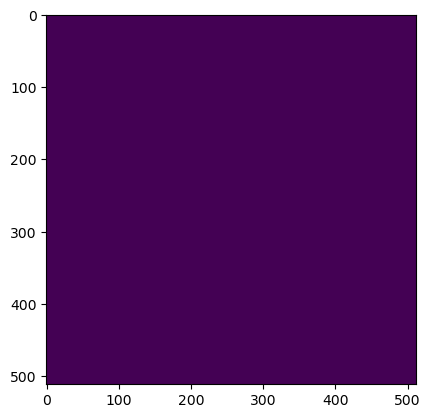

Wrote output/patches/mask/NV_S1_49-476368-0000-6281800-0000.tiff (512 x 512 pixels)


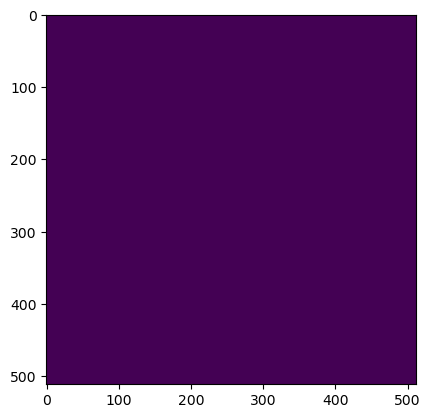

Wrote output/patches/mask/NV_S1_49-476368-0000-6281902-4000.tiff (512 x 512 pixels)


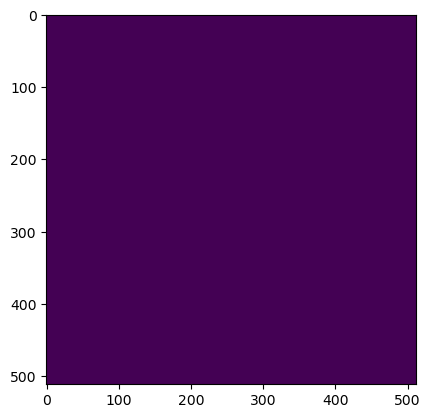

Wrote output/patches/mask/NV_S1_49-476368-0000-6282004-8000.tiff (512 x 512 pixels)


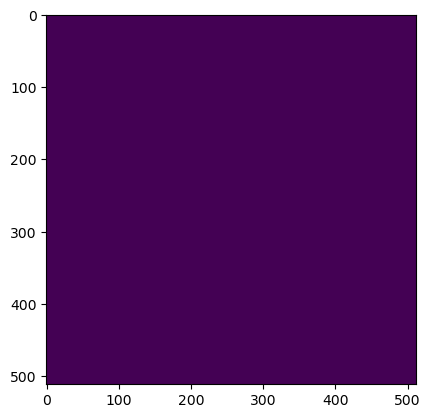

Wrote output/patches/mask/NV_S1_49-476368-0000-6282107-2000.tiff (512 x 512 pixels)


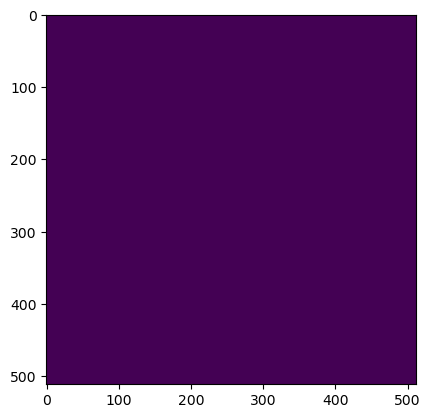

Wrote output/patches/mask/NV_S1_49-476368-0000-6282209-6000.tiff (512 x 512 pixels)


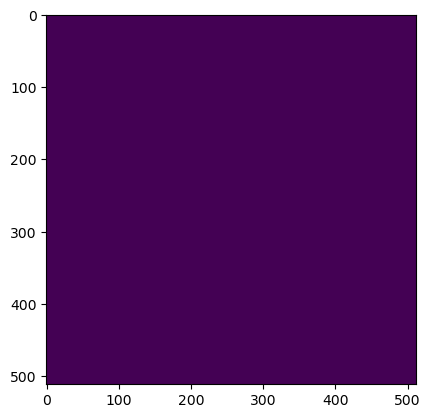

Wrote output/patches/mask/NV_S1_49-476470-4000-6281390-4000.tiff (512 x 512 pixels)


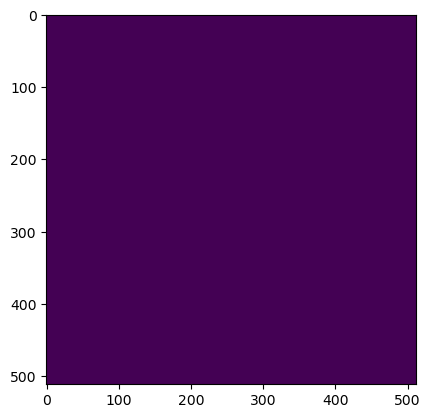

Wrote output/patches/mask/NV_S1_49-476470-4000-6281492-8000.tiff (512 x 512 pixels)


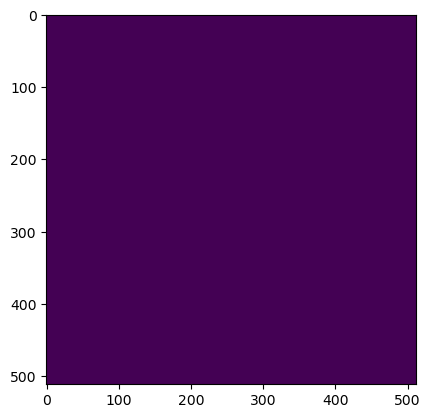

Wrote output/patches/mask/NV_S1_49-476470-4000-6281595-2000.tiff (512 x 512 pixels)


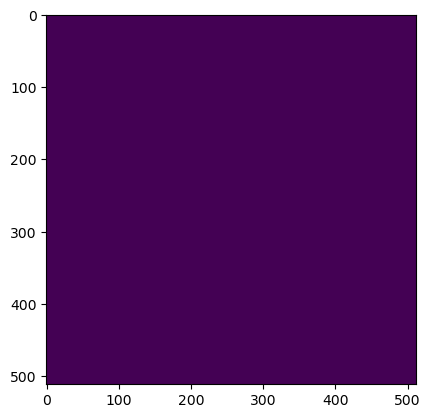

Wrote output/patches/mask/NV_S1_49-476470-4000-6281697-6000.tiff (512 x 512 pixels)


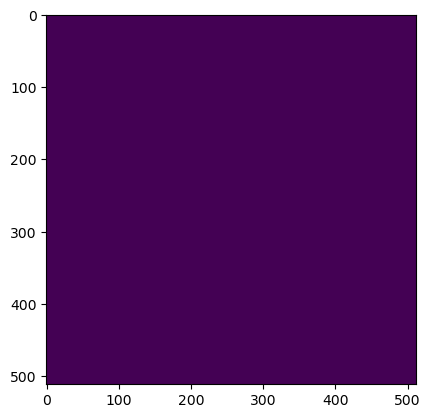

Wrote output/patches/mask/NV_S1_49-476470-4000-6281800-0000.tiff (512 x 512 pixels)


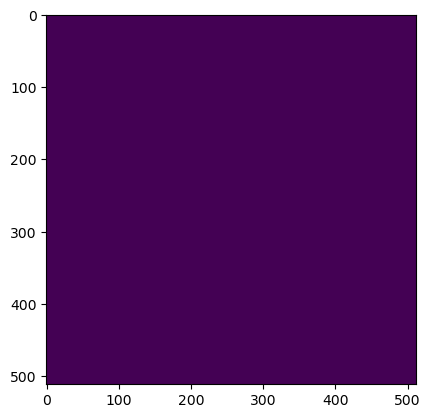

Wrote output/patches/mask/NV_S1_49-476470-4000-6281902-4000.tiff (512 x 512 pixels)


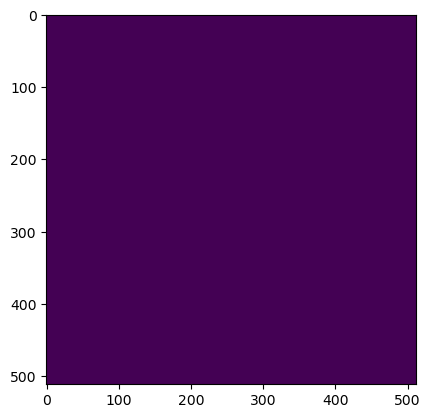

Wrote output/patches/mask/NV_S1_49-476470-4000-6282004-8000.tiff (512 x 512 pixels)


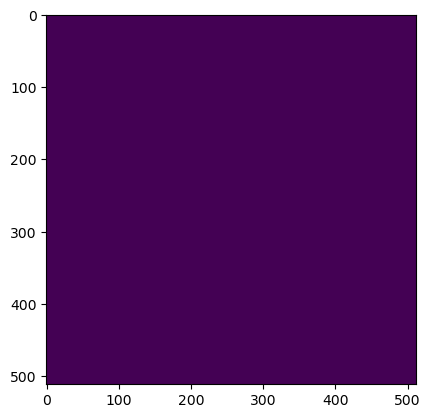

Wrote output/patches/mask/NV_S1_49-476470-4000-6282107-2000.tiff (512 x 512 pixels)


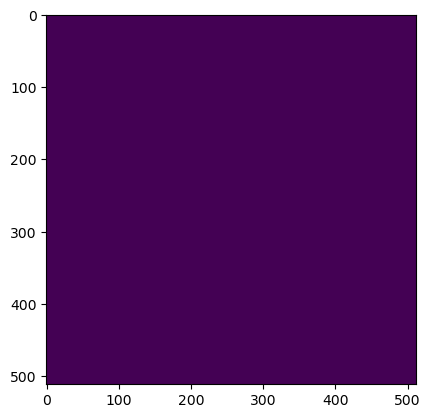

Wrote output/patches/mask/NV_S1_49-476470-4000-6282209-6000.tiff (512 x 512 pixels)
Zone UC_S1_50 Building Mask...


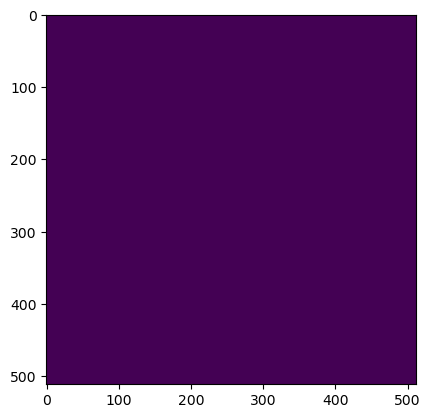

Wrote output/patches/mask/UC_S1_50-526544-0000-6281646-4000.tiff (512 x 512 pixels)


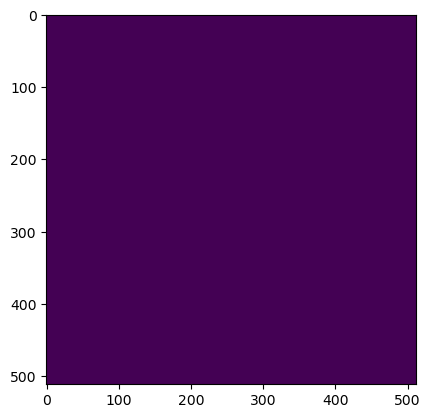

Wrote output/patches/mask/UC_S1_50-526544-0000-6281748-8000.tiff (512 x 512 pixels)


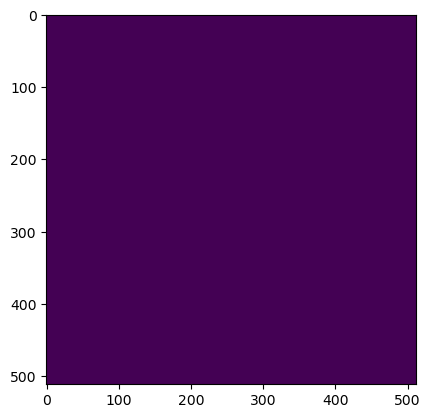

Wrote output/patches/mask/UC_S1_50-526544-0000-6281851-2000.tiff (512 x 512 pixels)


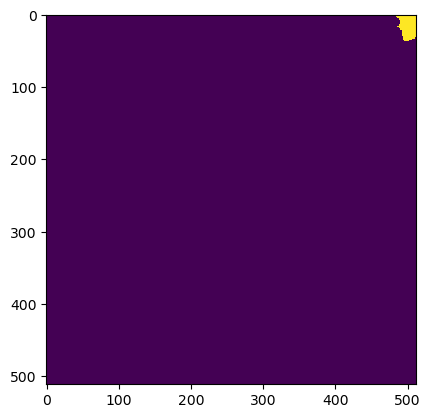

Wrote output/patches/mask/UC_S1_50-526544-0000-6281953-6000.tiff (512 x 512 pixels)


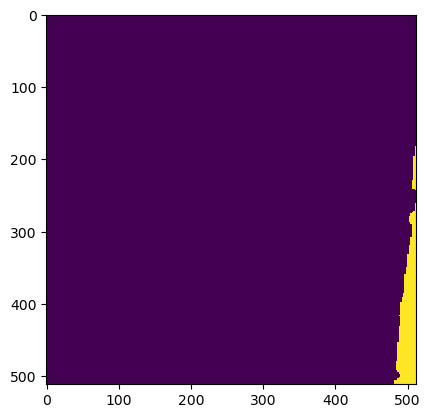

Wrote output/patches/mask/UC_S1_50-526544-0000-6282056-0000.tiff (512 x 512 pixels)


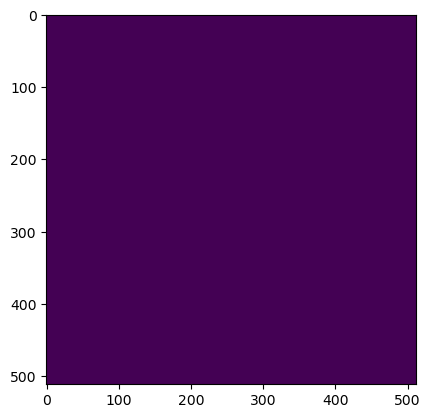

Wrote output/patches/mask/UC_S1_50-526544-0000-6282158-4000.tiff (512 x 512 pixels)


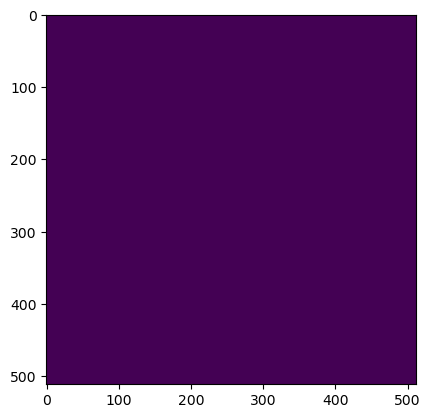

Wrote output/patches/mask/UC_S1_50-526544-0000-6282260-8000.tiff (512 x 512 pixels)


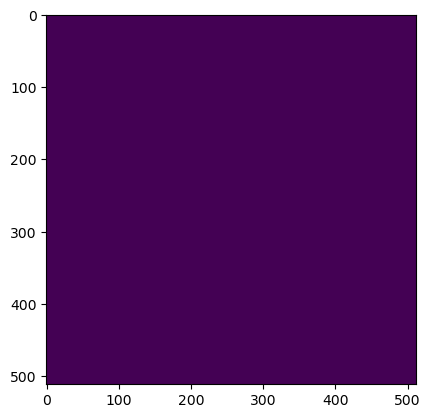

Wrote output/patches/mask/UC_S1_50-526646-4000-6281646-4000.tiff (512 x 512 pixels)


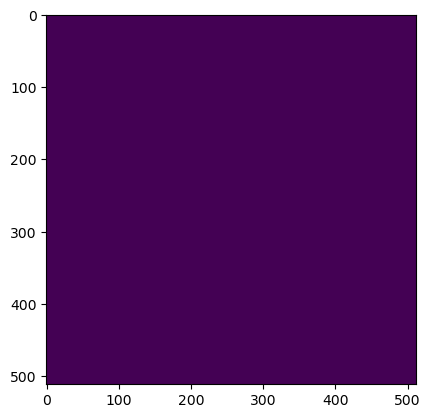

Wrote output/patches/mask/UC_S1_50-526646-4000-6281748-8000.tiff (512 x 512 pixels)


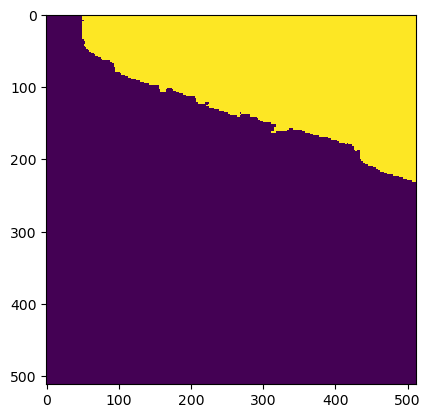

Wrote output/patches/mask/UC_S1_50-526646-4000-6281851-2000.tiff (512 x 512 pixels)


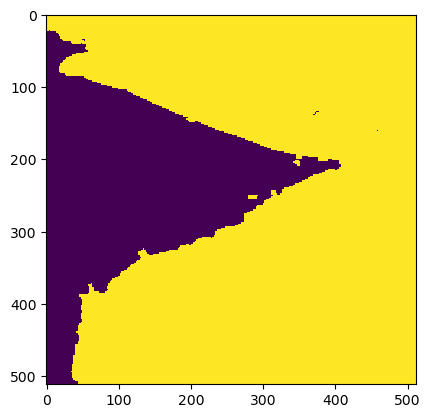

Wrote output/patches/mask/UC_S1_50-526646-4000-6281953-6000.tiff (512 x 512 pixels)


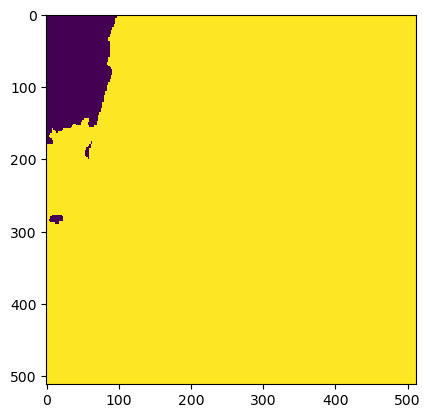

Wrote output/patches/mask/UC_S1_50-526646-4000-6282056-0000.tiff (512 x 512 pixels)


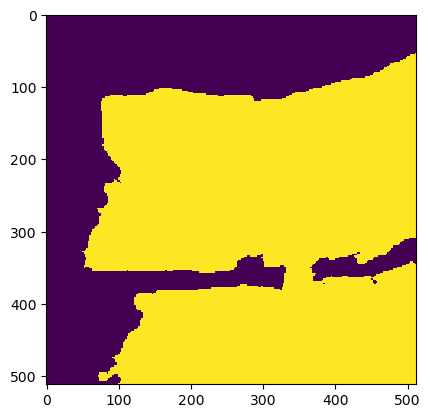

Wrote output/patches/mask/UC_S1_50-526646-4000-6282158-4000.tiff (512 x 512 pixels)


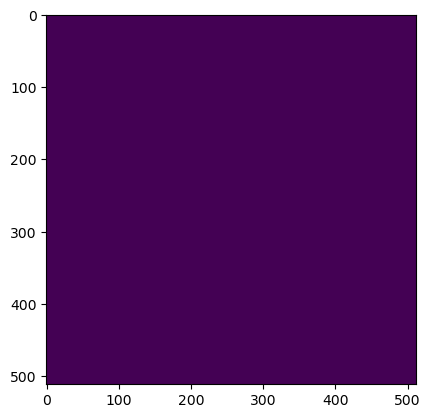

Wrote output/patches/mask/UC_S1_50-526646-4000-6282260-8000.tiff (512 x 512 pixels)


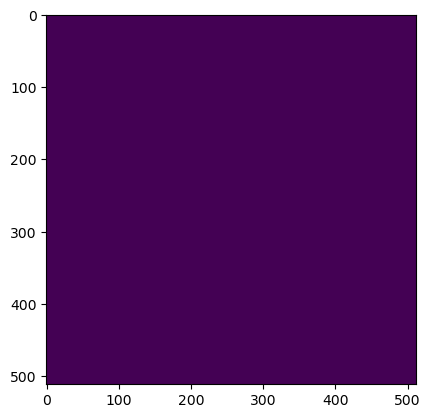

Wrote output/patches/mask/UC_S1_50-526748-8000-6281646-4000.tiff (512 x 512 pixels)


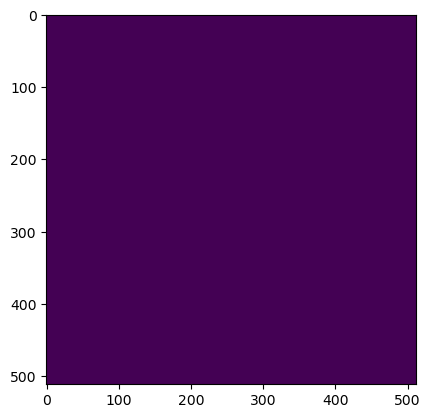

Wrote output/patches/mask/UC_S1_50-526748-8000-6281748-8000.tiff (512 x 512 pixels)


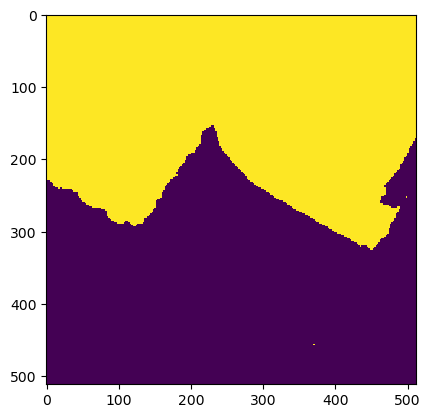

Wrote output/patches/mask/UC_S1_50-526748-8000-6281851-2000.tiff (512 x 512 pixels)


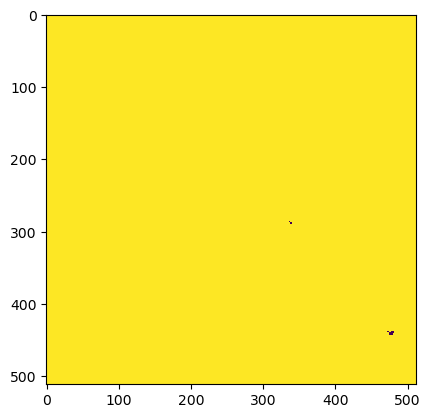

Wrote output/patches/mask/UC_S1_50-526748-8000-6281953-6000.tiff (512 x 512 pixels)


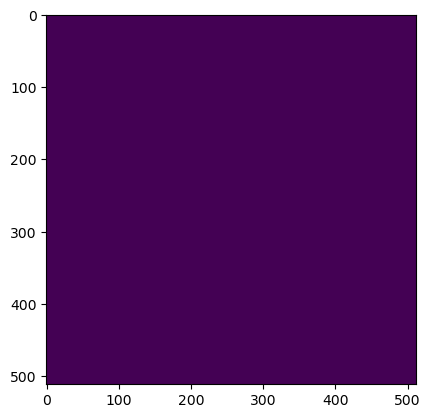

Wrote output/patches/mask/UC_S1_50-526748-8000-6282056-0000.tiff (512 x 512 pixels)


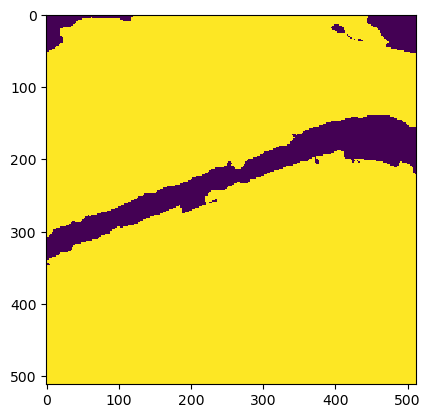

Wrote output/patches/mask/UC_S1_50-526748-8000-6282158-4000.tiff (512 x 512 pixels)


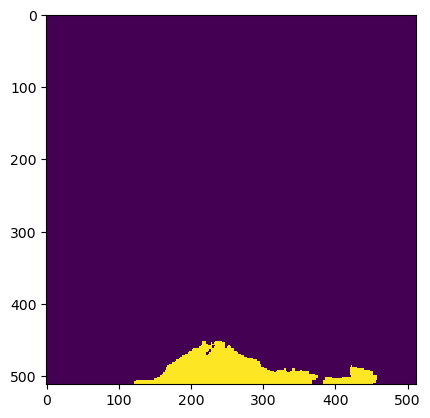

Wrote output/patches/mask/UC_S1_50-526748-8000-6282260-8000.tiff (512 x 512 pixels)


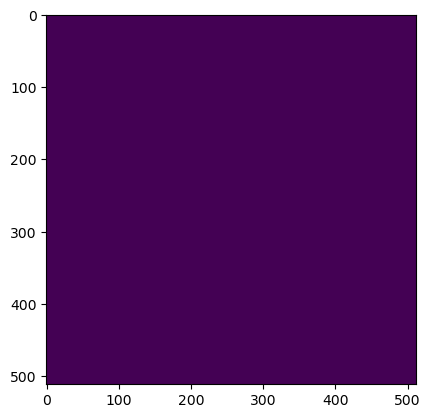

Wrote output/patches/mask/UC_S1_50-526851-2000-6281646-4000.tiff (512 x 512 pixels)


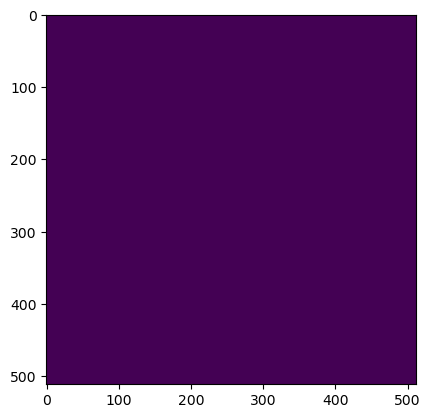

Wrote output/patches/mask/UC_S1_50-526851-2000-6281748-8000.tiff (512 x 512 pixels)


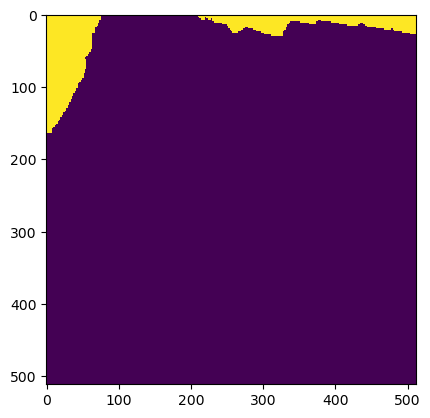

Wrote output/patches/mask/UC_S1_50-526851-2000-6281851-2000.tiff (512 x 512 pixels)


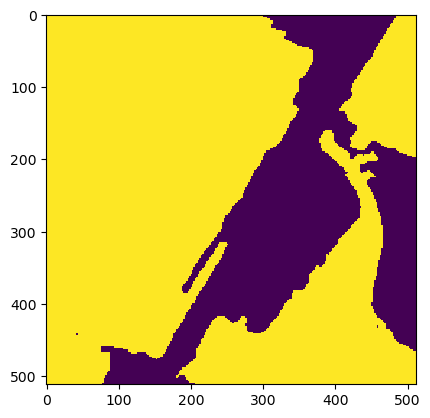

Wrote output/patches/mask/UC_S1_50-526851-2000-6281953-6000.tiff (512 x 512 pixels)


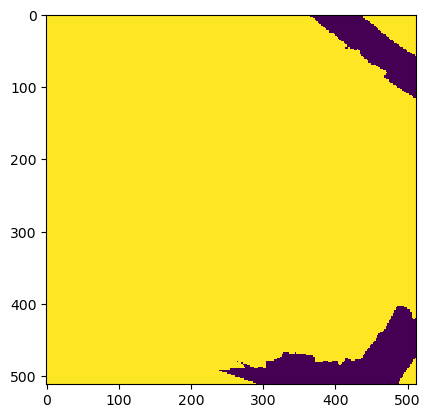

Wrote output/patches/mask/UC_S1_50-526851-2000-6282056-0000.tiff (512 x 512 pixels)


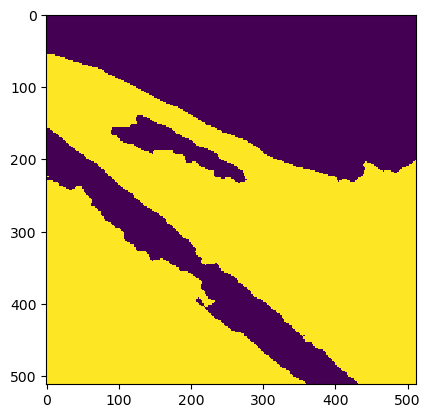

Wrote output/patches/mask/UC_S1_50-526851-2000-6282158-4000.tiff (512 x 512 pixels)


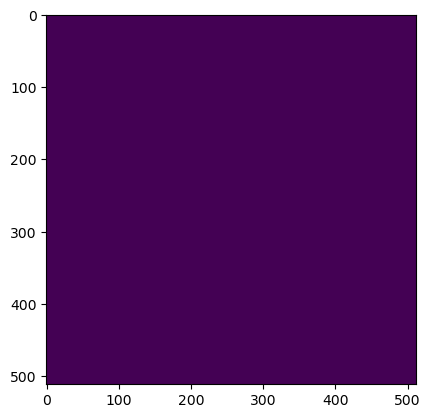

Wrote output/patches/mask/UC_S1_50-526851-2000-6282260-8000.tiff (512 x 512 pixels)


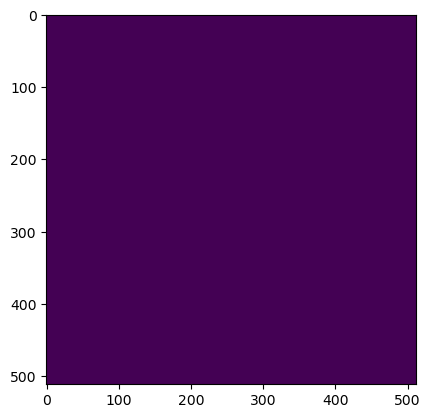

Wrote output/patches/mask/UC_S1_50-526953-6000-6281646-4000.tiff (512 x 512 pixels)


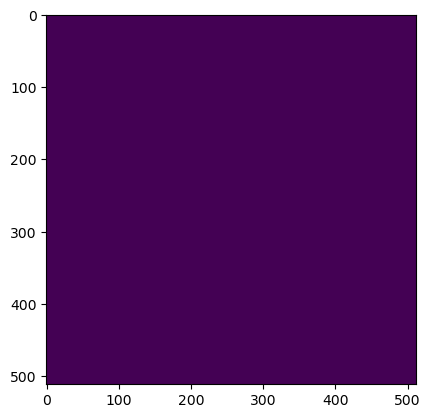

Wrote output/patches/mask/UC_S1_50-526953-6000-6281748-8000.tiff (512 x 512 pixels)


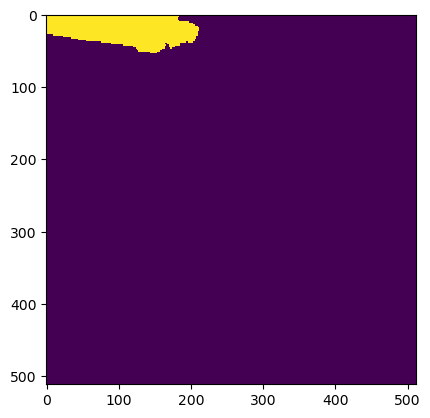

Wrote output/patches/mask/UC_S1_50-526953-6000-6281851-2000.tiff (512 x 512 pixels)


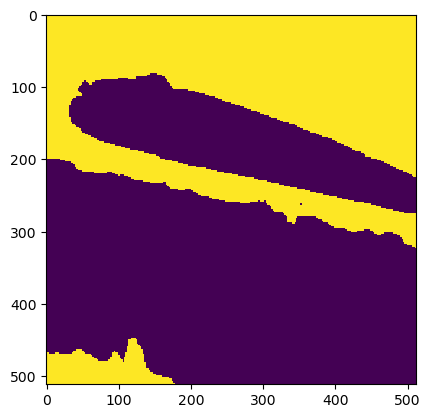

Wrote output/patches/mask/UC_S1_50-526953-6000-6281953-6000.tiff (512 x 512 pixels)


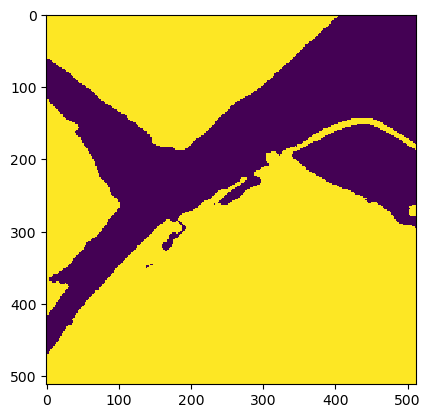

Wrote output/patches/mask/UC_S1_50-526953-6000-6282056-0000.tiff (512 x 512 pixels)


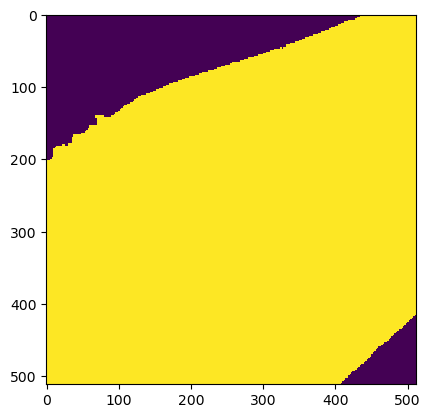

Wrote output/patches/mask/UC_S1_50-526953-6000-6282158-4000.tiff (512 x 512 pixels)


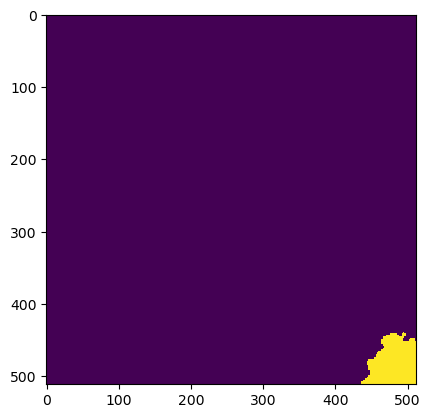

Wrote output/patches/mask/UC_S1_50-526953-6000-6282260-8000.tiff (512 x 512 pixels)


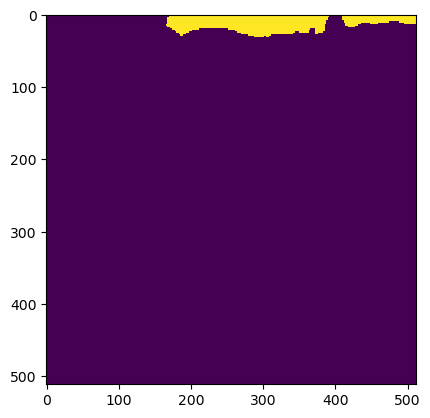

Wrote output/patches/mask/UC_S1_50-527056-0000-6281646-4000.tiff (512 x 512 pixels)


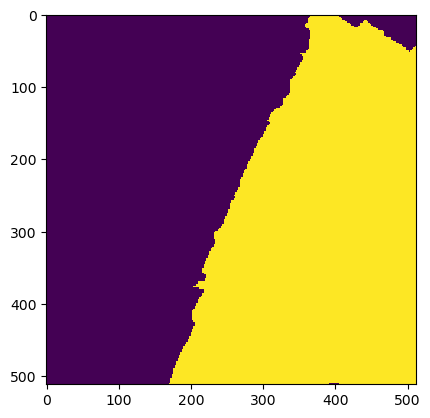

Wrote output/patches/mask/UC_S1_50-527056-0000-6281748-8000.tiff (512 x 512 pixels)


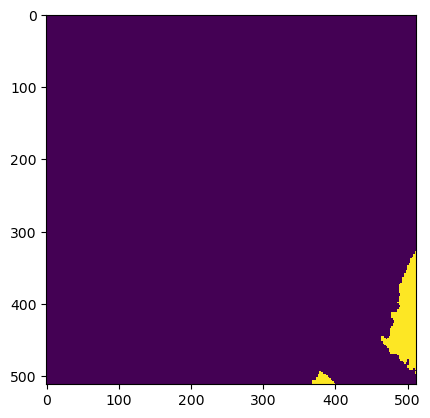

Wrote output/patches/mask/UC_S1_50-527056-0000-6281851-2000.tiff (512 x 512 pixels)


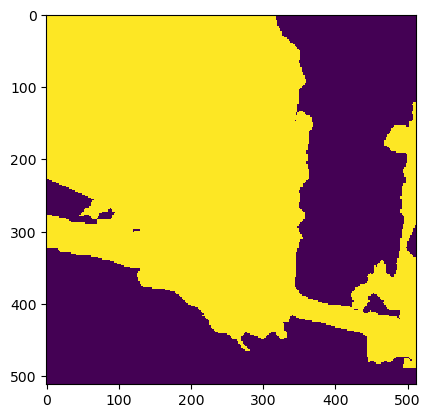

Wrote output/patches/mask/UC_S1_50-527056-0000-6281953-6000.tiff (512 x 512 pixels)


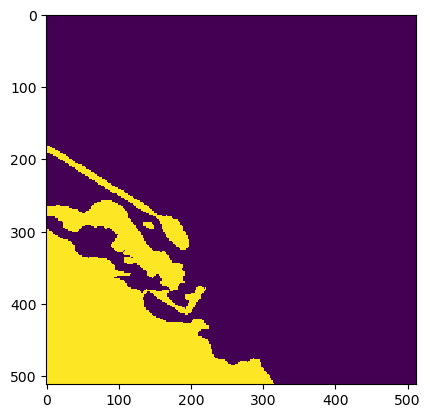

Wrote output/patches/mask/UC_S1_50-527056-0000-6282056-0000.tiff (512 x 512 pixels)


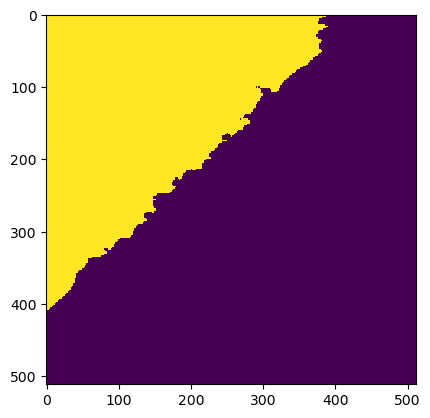

Wrote output/patches/mask/UC_S1_50-527056-0000-6282158-4000.tiff (512 x 512 pixels)


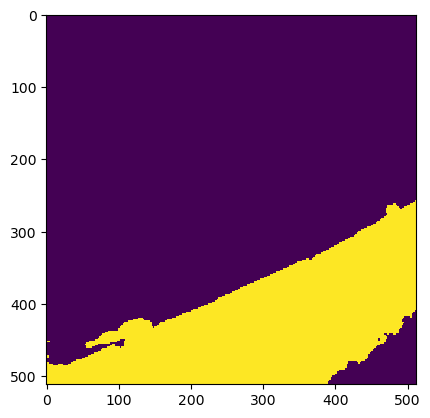

Wrote output/patches/mask/UC_S1_50-527056-0000-6282260-8000.tiff (512 x 512 pixels)


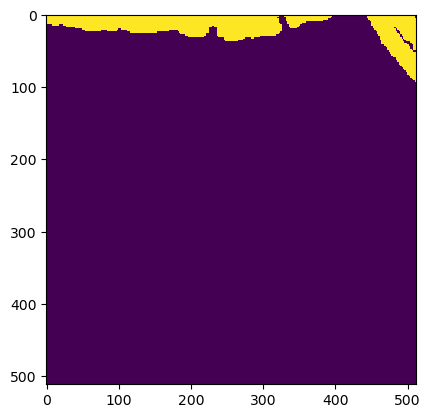

Wrote output/patches/mask/UC_S1_50-527158-4000-6281646-4000.tiff (512 x 512 pixels)


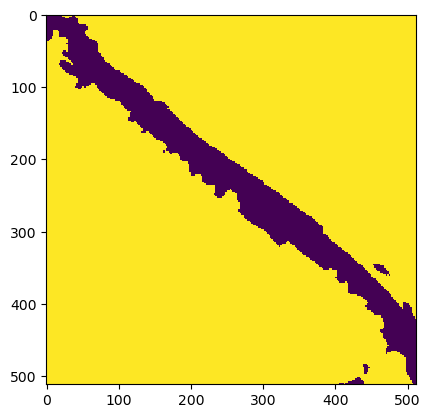

Wrote output/patches/mask/UC_S1_50-527158-4000-6281748-8000.tiff (512 x 512 pixels)


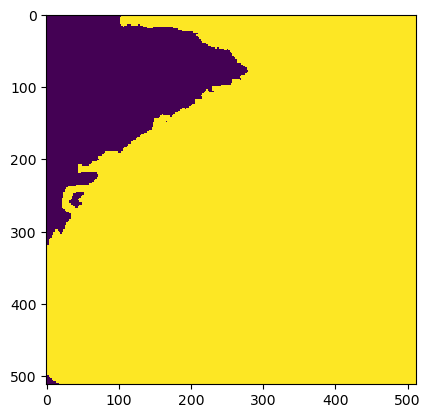

Wrote output/patches/mask/UC_S1_50-527158-4000-6281851-2000.tiff (512 x 512 pixels)


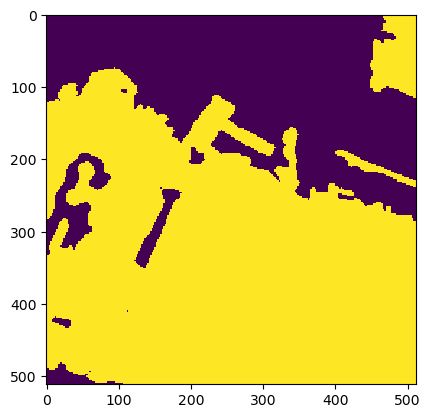

Wrote output/patches/mask/UC_S1_50-527158-4000-6281953-6000.tiff (512 x 512 pixels)


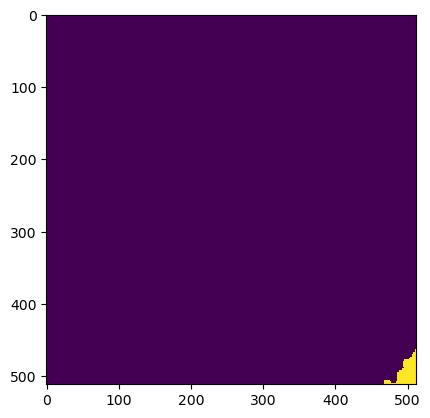

Wrote output/patches/mask/UC_S1_50-527158-4000-6282056-0000.tiff (512 x 512 pixels)


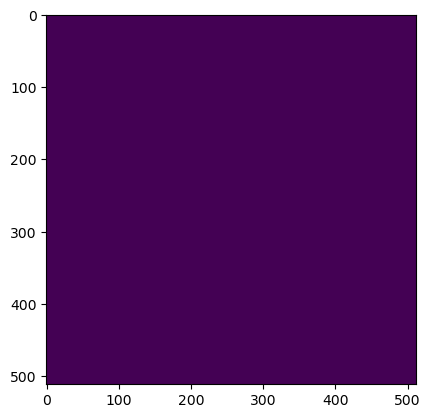

Wrote output/patches/mask/UC_S1_50-527158-4000-6282158-4000.tiff (512 x 512 pixels)


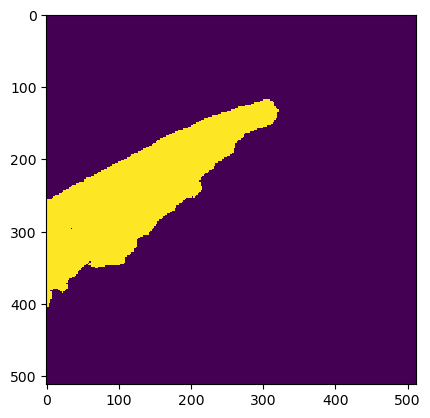

Wrote output/patches/mask/UC_S1_50-527158-4000-6282260-8000.tiff (512 x 512 pixels)


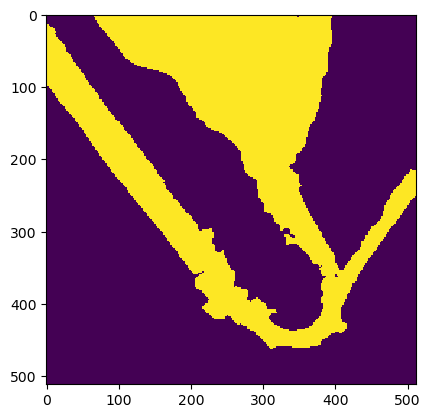

Wrote output/patches/mask/UC_S1_50-527260-8000-6281646-4000.tiff (512 x 512 pixels)


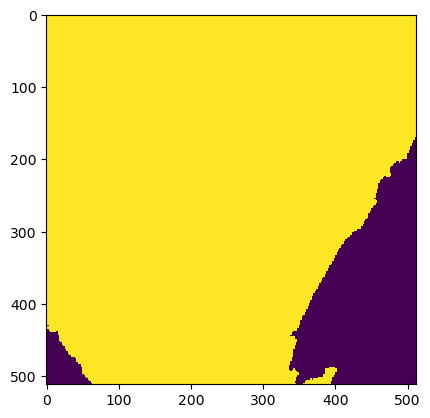

Wrote output/patches/mask/UC_S1_50-527260-8000-6281748-8000.tiff (512 x 512 pixels)


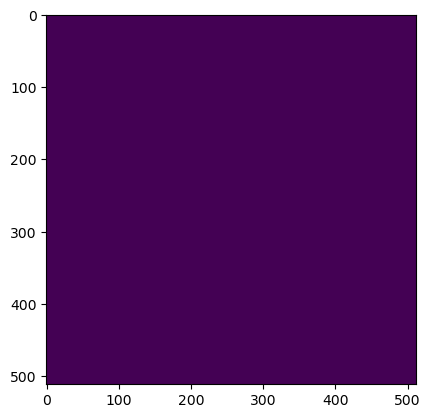

Wrote output/patches/mask/UC_S1_50-527260-8000-6281851-2000.tiff (512 x 512 pixels)


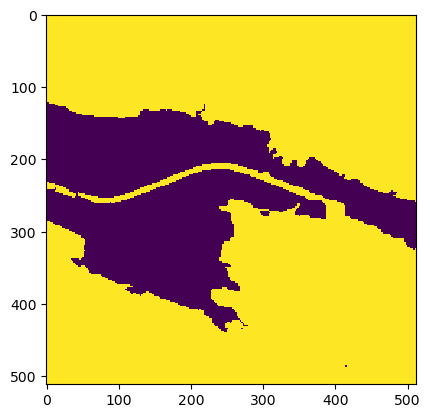

Wrote output/patches/mask/UC_S1_50-527260-8000-6281953-6000.tiff (512 x 512 pixels)


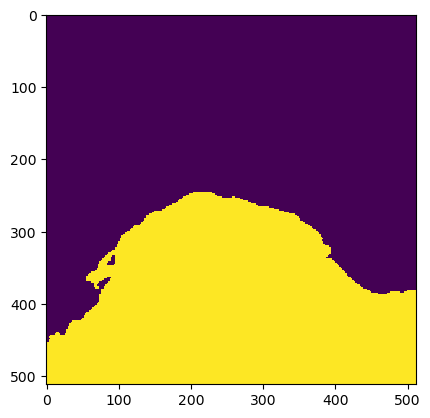

Wrote output/patches/mask/UC_S1_50-527260-8000-6282056-0000.tiff (512 x 512 pixels)


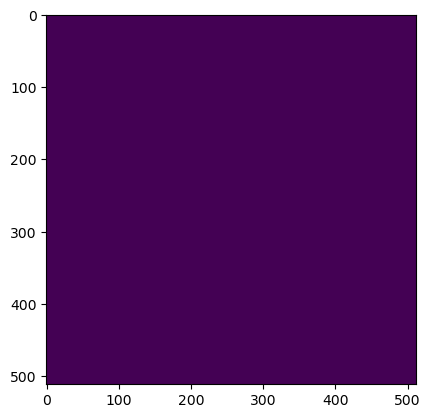

Wrote output/patches/mask/UC_S1_50-527260-8000-6282158-4000.tiff (512 x 512 pixels)


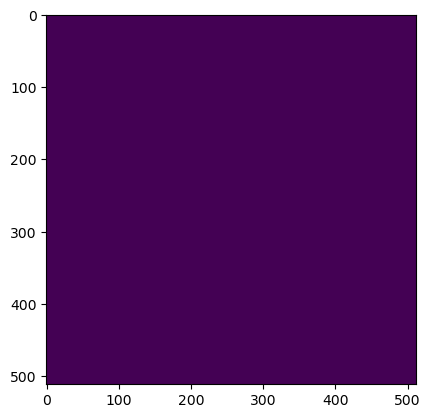

Wrote output/patches/mask/UC_S1_50-527260-8000-6282260-8000.tiff (512 x 512 pixels)


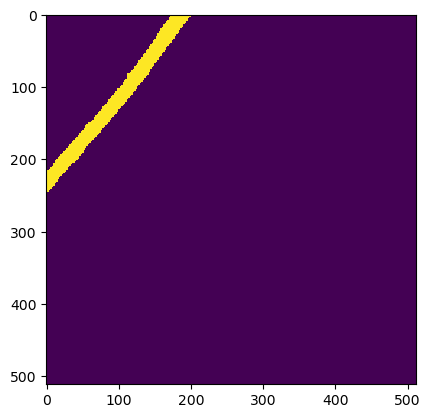

Wrote output/patches/mask/UC_S1_50-527363-2000-6281646-4000.tiff (512 x 512 pixels)


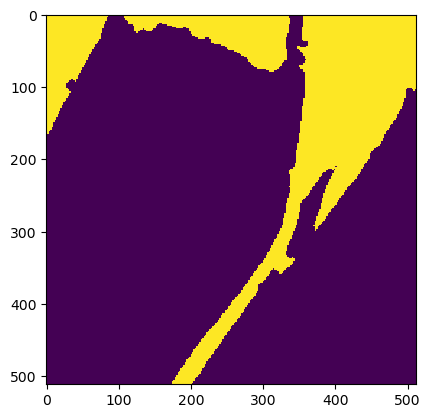

Wrote output/patches/mask/UC_S1_50-527363-2000-6281748-8000.tiff (512 x 512 pixels)


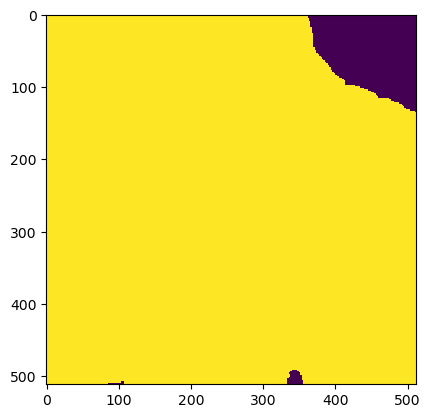

Wrote output/patches/mask/UC_S1_50-527363-2000-6281851-2000.tiff (512 x 512 pixels)


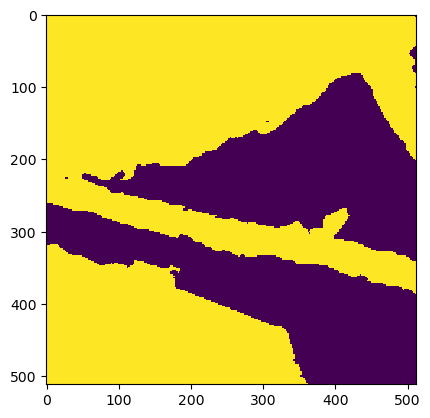

Wrote output/patches/mask/UC_S1_50-527363-2000-6281953-6000.tiff (512 x 512 pixels)


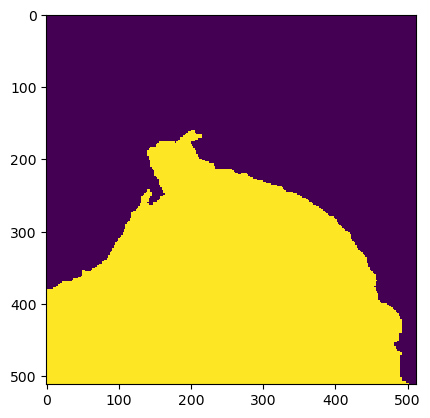

Wrote output/patches/mask/UC_S1_50-527363-2000-6282056-0000.tiff (512 x 512 pixels)


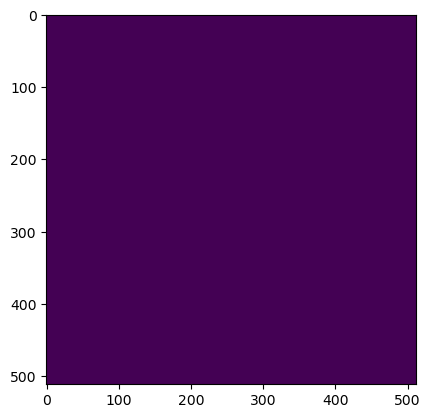

Wrote output/patches/mask/UC_S1_50-527363-2000-6282158-4000.tiff (512 x 512 pixels)


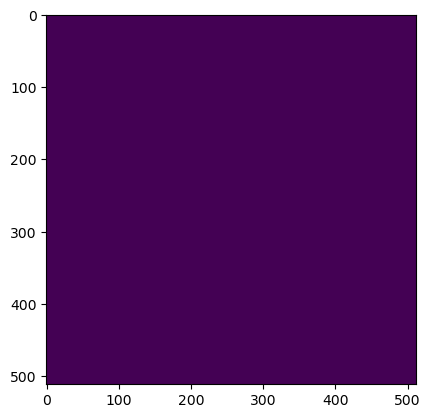

Wrote output/patches/mask/UC_S1_50-527363-2000-6282260-8000.tiff (512 x 512 pixels)
Zone UU_S1_51 Building Mask...


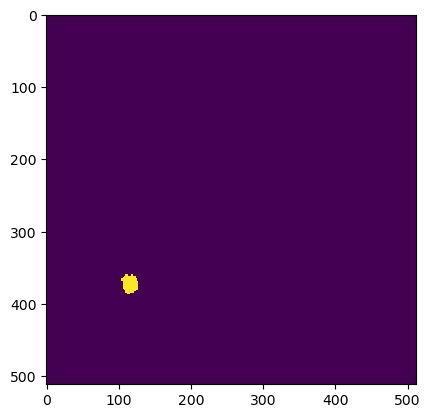

Wrote output/patches/mask/UU_S1_51-545232-0000-6281646-4000.tiff (512 x 512 pixels)


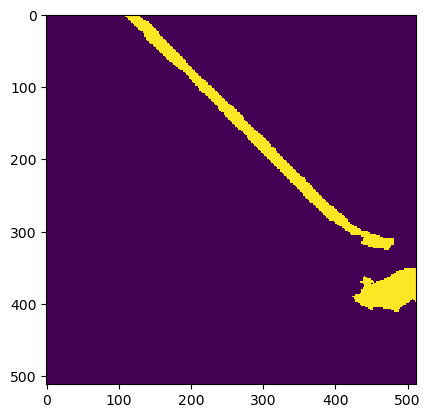

Wrote output/patches/mask/UU_S1_51-545232-0000-6281748-8000.tiff (512 x 512 pixels)


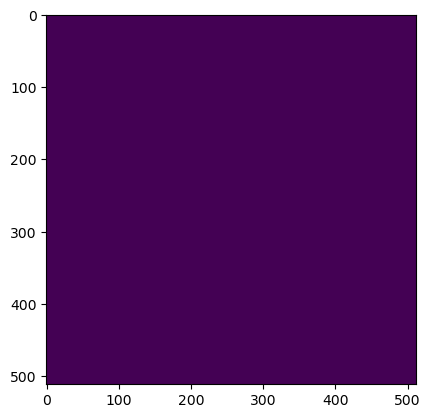

Wrote output/patches/mask/UU_S1_51-545334-4000-6281646-4000.tiff (512 x 512 pixels)


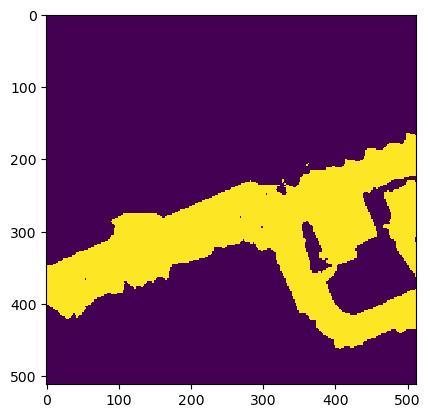

Wrote output/patches/mask/UU_S1_51-545334-4000-6281748-8000.tiff (512 x 512 pixels)
Zone VC_S1_52 Building Mask...


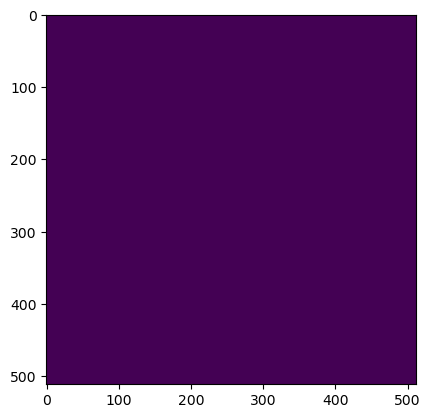

Wrote output/patches/mask/VC_S1_52-445136-0000-6281646-4000.tiff (512 x 512 pixels)


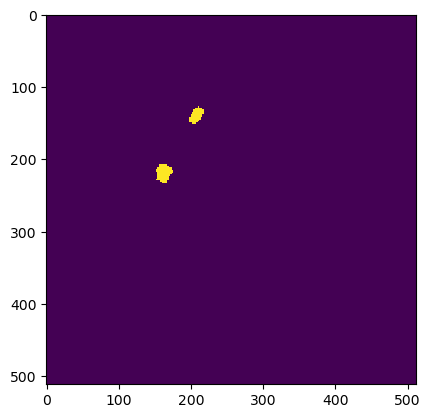

Wrote output/patches/mask/VC_S1_52-445136-0000-6281748-8000.tiff (512 x 512 pixels)


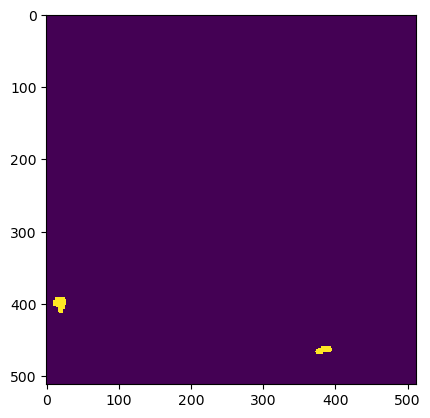

Wrote output/patches/mask/VC_S1_52-445136-0000-6281851-2000.tiff (512 x 512 pixels)


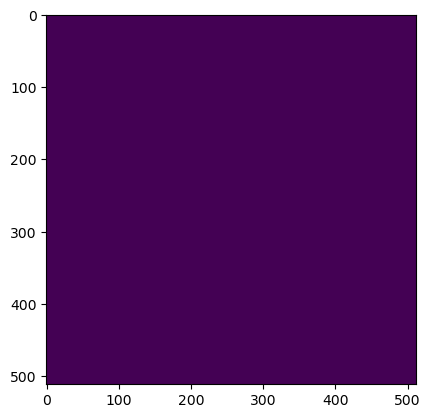

Wrote output/patches/mask/VC_S1_52-445136-0000-6281953-6000.tiff (512 x 512 pixels)


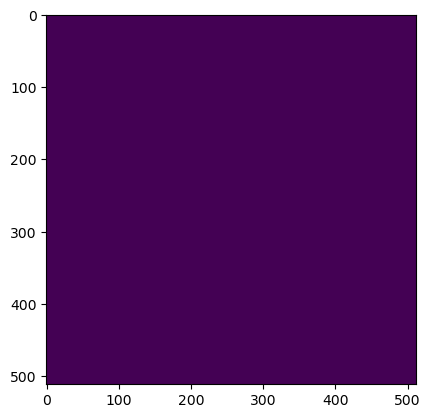

Wrote output/patches/mask/VC_S1_52-445238-4000-6281646-4000.tiff (512 x 512 pixels)


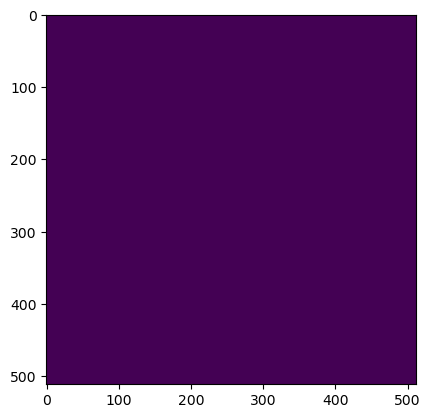

Wrote output/patches/mask/VC_S1_52-445238-4000-6281748-8000.tiff (512 x 512 pixels)


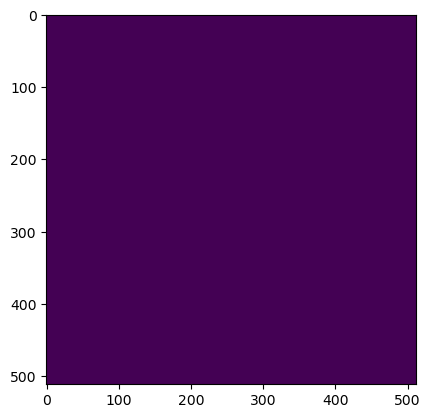

Wrote output/patches/mask/VC_S1_52-445238-4000-6281851-2000.tiff (512 x 512 pixels)


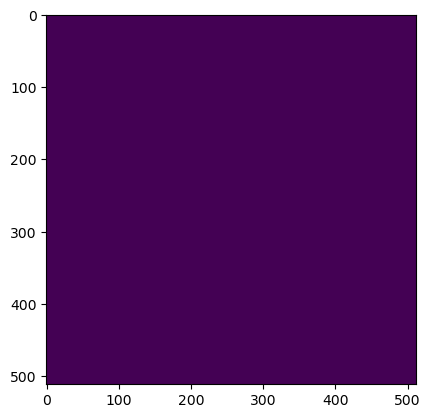

Wrote output/patches/mask/VC_S1_52-445238-4000-6281953-6000.tiff (512 x 512 pixels)
Zone UU_S1_53 Building Mask...


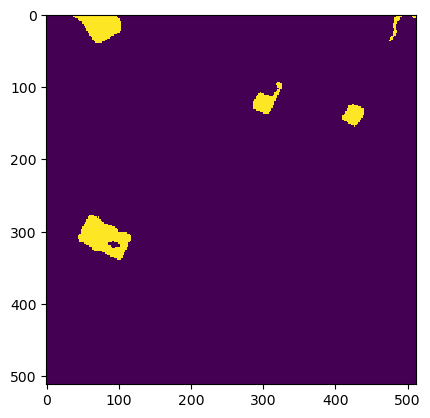

Wrote output/patches/mask/UU_S1_53-540880-0000-6281902-4000.tiff (512 x 512 pixels)


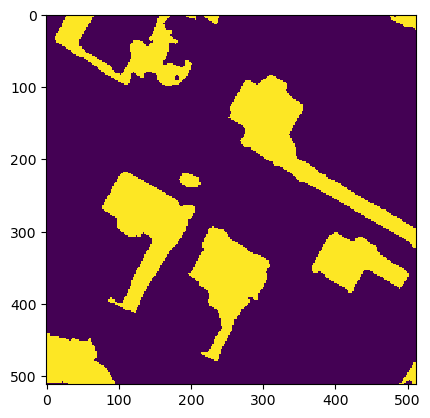

Wrote output/patches/mask/UU_S1_53-540880-0000-6282004-8000.tiff (512 x 512 pixels)


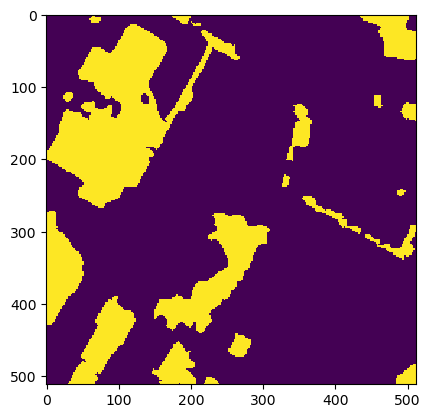

Wrote output/patches/mask/UU_S1_53-540880-0000-6282107-2000.tiff (512 x 512 pixels)


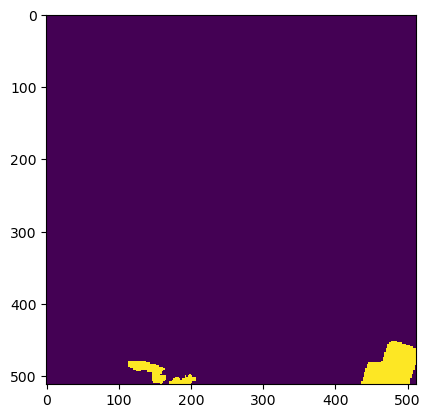

Wrote output/patches/mask/UU_S1_53-540880-0000-6282209-6000.tiff (512 x 512 pixels)


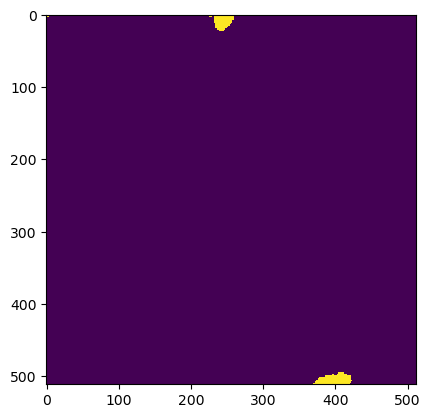

Wrote output/patches/mask/UU_S1_53-540982-4000-6281902-4000.tiff (512 x 512 pixels)


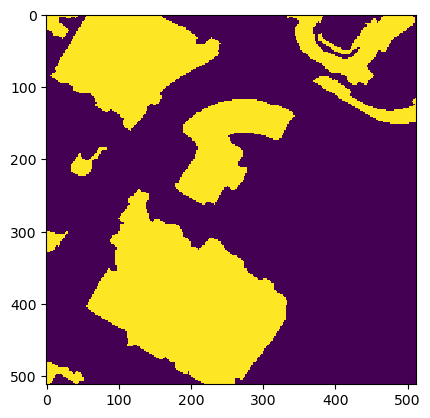

Wrote output/patches/mask/UU_S1_53-540982-4000-6282004-8000.tiff (512 x 512 pixels)


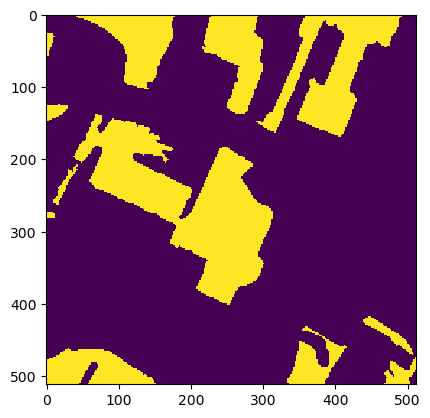

Wrote output/patches/mask/UU_S1_53-540982-4000-6282107-2000.tiff (512 x 512 pixels)


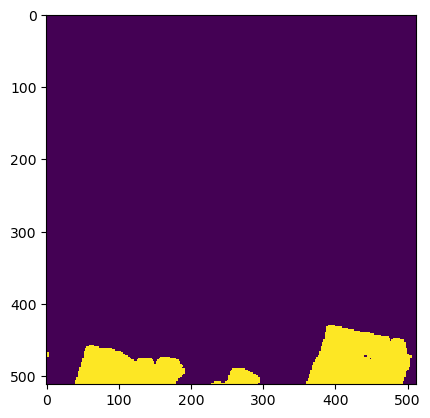

Wrote output/patches/mask/UU_S1_53-540982-4000-6282209-6000.tiff (512 x 512 pixels)
Zone CU_S1_54 Building Mask...


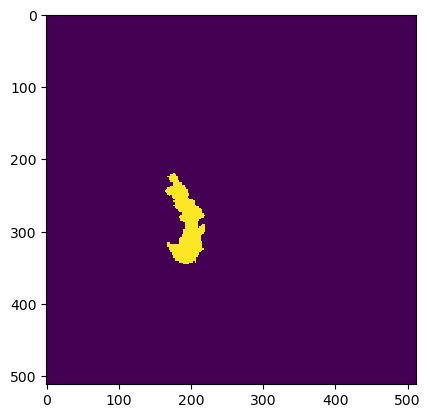

Wrote output/patches/mask/CU_S1_54-519888-0000-6282158-4000.tiff (512 x 512 pixels)


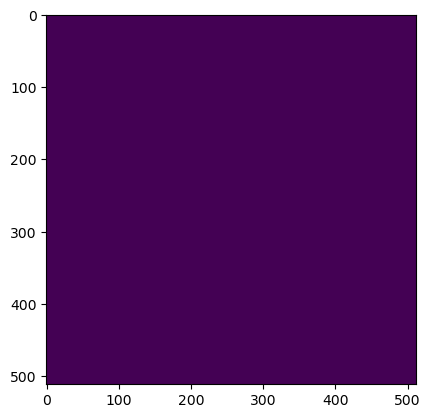

Wrote output/patches/mask/CU_S1_54-519888-0000-6282260-8000.tiff (512 x 512 pixels)


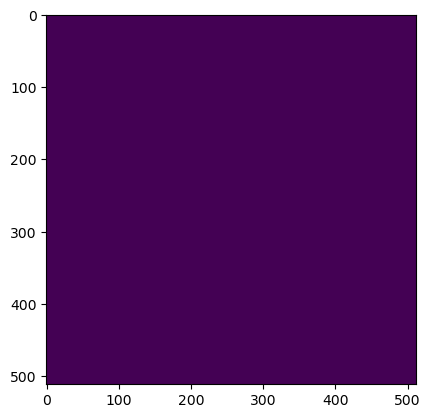

Wrote output/patches/mask/CU_S1_54-519888-0000-6282363-2000.tiff (512 x 512 pixels)


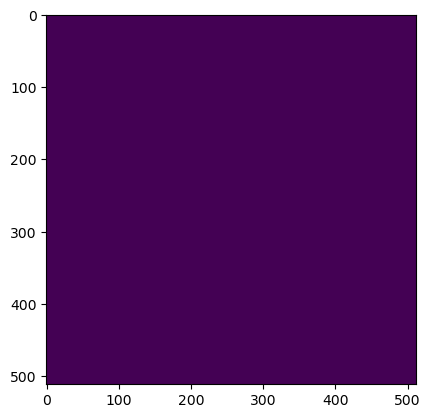

Wrote output/patches/mask/CU_S1_54-519888-0000-6282465-6000.tiff (512 x 512 pixels)


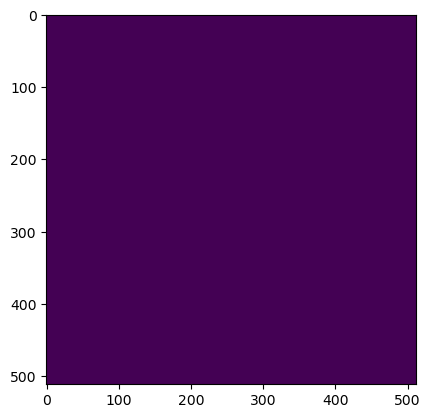

Wrote output/patches/mask/CU_S1_54-519990-4000-6282158-4000.tiff (512 x 512 pixels)


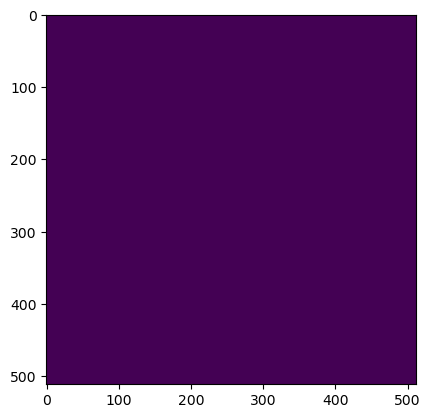

Wrote output/patches/mask/CU_S1_54-519990-4000-6282260-8000.tiff (512 x 512 pixels)


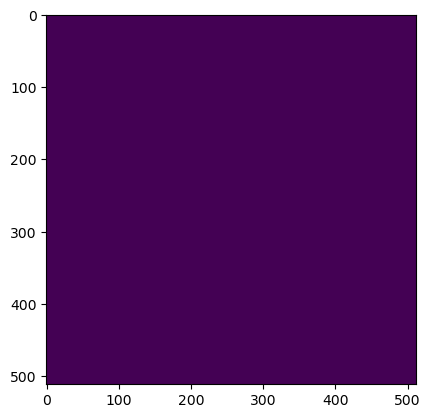

Wrote output/patches/mask/CU_S1_54-519990-4000-6282363-2000.tiff (512 x 512 pixels)


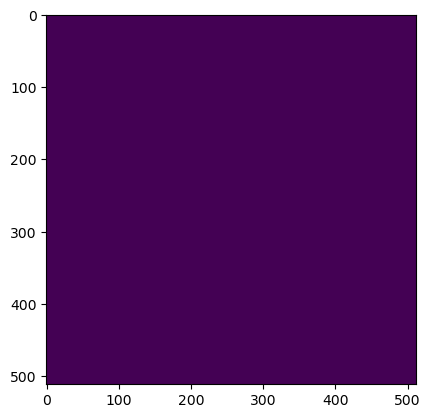

Wrote output/patches/mask/CU_S1_54-519990-4000-6282465-6000.tiff (512 x 512 pixels)


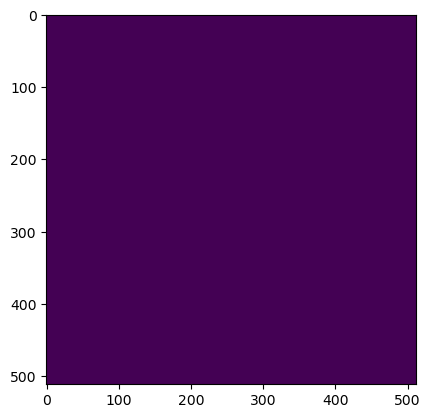

Wrote output/patches/mask/CU_S1_54-520092-8000-6282158-4000.tiff (512 x 512 pixels)


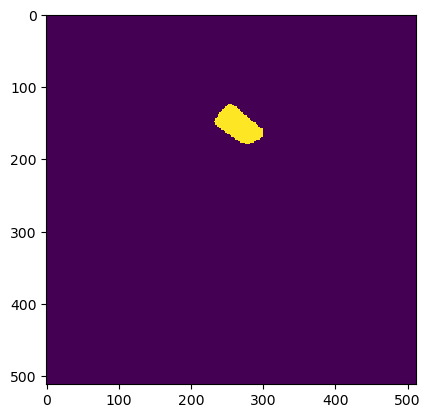

Wrote output/patches/mask/CU_S1_54-520092-8000-6282260-8000.tiff (512 x 512 pixels)


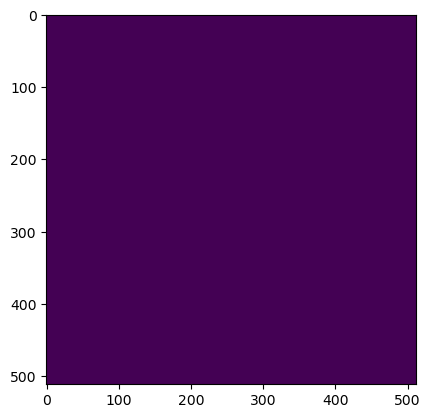

Wrote output/patches/mask/CU_S1_54-520092-8000-6282363-2000.tiff (512 x 512 pixels)


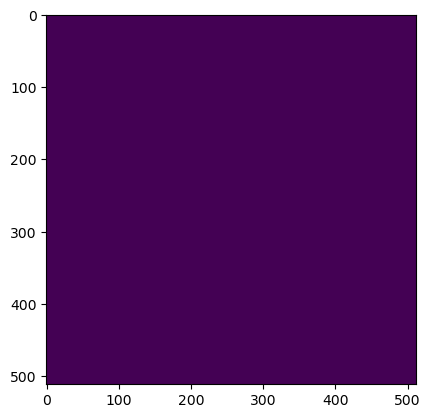

Wrote output/patches/mask/CU_S1_54-520092-8000-6282465-6000.tiff (512 x 512 pixels)


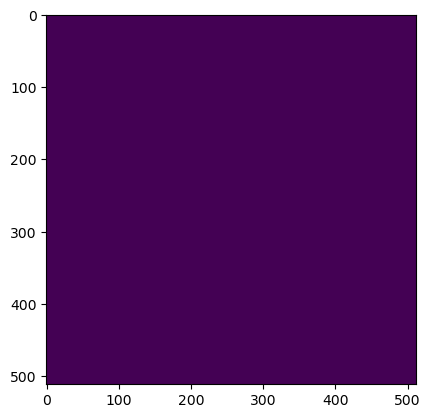

Wrote output/patches/mask/CU_S1_54-520195-2000-6282158-4000.tiff (512 x 512 pixels)


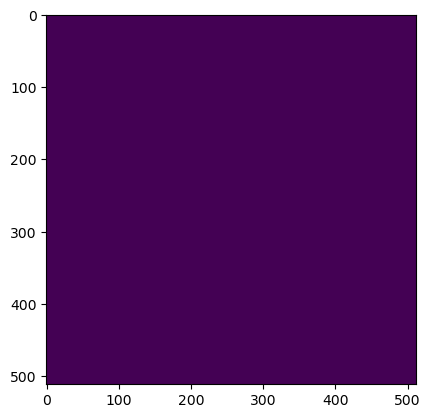

Wrote output/patches/mask/CU_S1_54-520195-2000-6282260-8000.tiff (512 x 512 pixels)


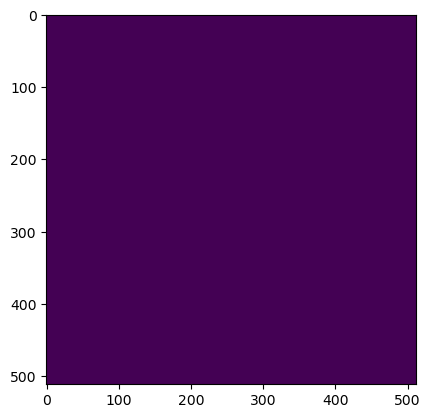

Wrote output/patches/mask/CU_S1_54-520195-2000-6282363-2000.tiff (512 x 512 pixels)


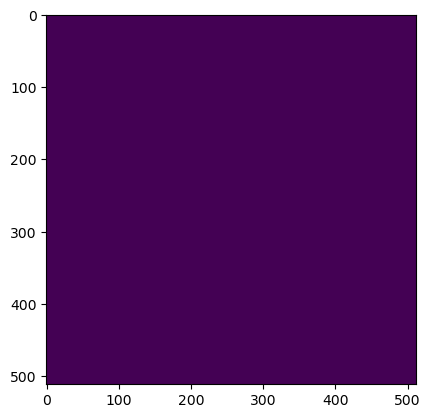

Wrote output/patches/mask/CU_S1_54-520195-2000-6282465-6000.tiff (512 x 512 pixels)
Zone UU_S1_55 Building Mask...


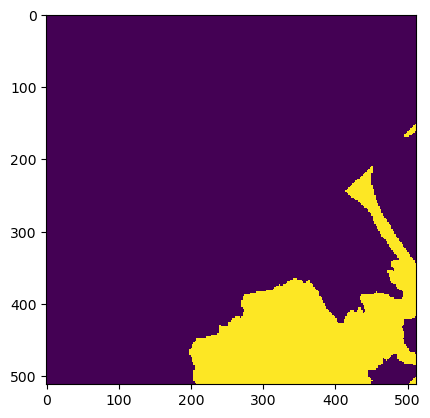

Wrote output/patches/mask/UU_S1_55-547024-0000-6282414-4000.tiff (512 x 512 pixels)


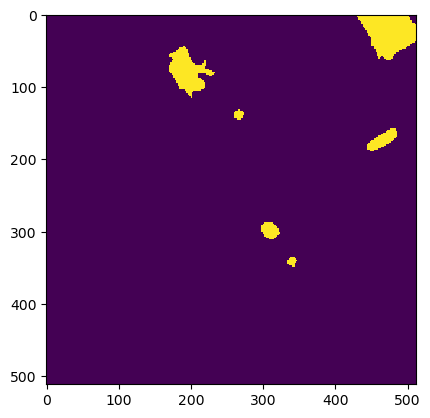

Wrote output/patches/mask/UU_S1_55-547024-0000-6282516-8000.tiff (512 x 512 pixels)


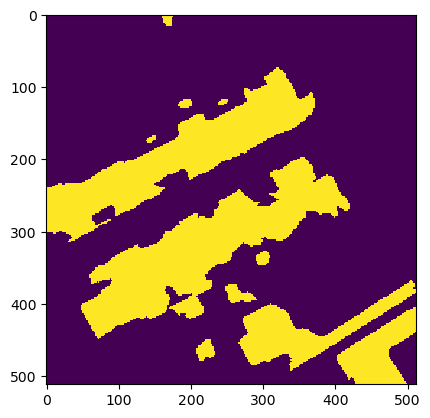

Wrote output/patches/mask/UU_S1_55-547024-0000-6282619-2000.tiff (512 x 512 pixels)


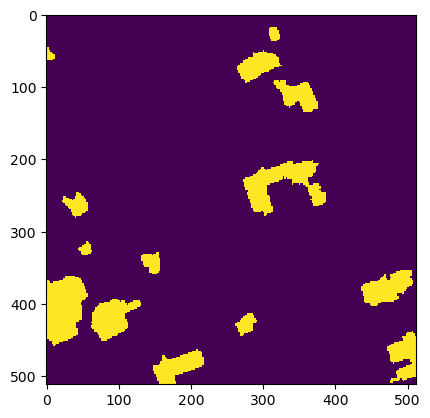

Wrote output/patches/mask/UU_S1_55-547024-0000-6282721-6000.tiff (512 x 512 pixels)


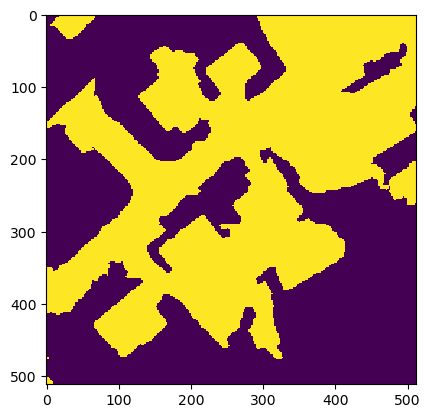

Wrote output/patches/mask/UU_S1_55-547126-4000-6282414-4000.tiff (512 x 512 pixels)


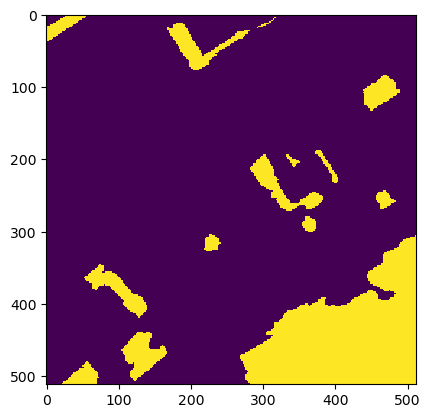

Wrote output/patches/mask/UU_S1_55-547126-4000-6282516-8000.tiff (512 x 512 pixels)


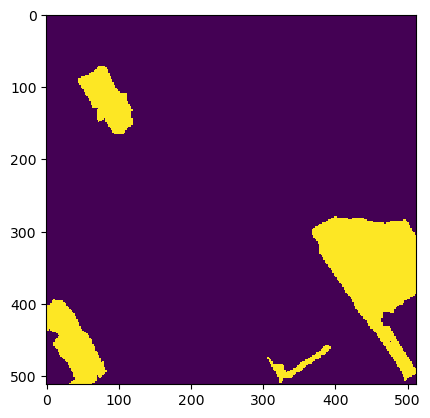

Wrote output/patches/mask/UU_S1_55-547126-4000-6282619-2000.tiff (512 x 512 pixels)


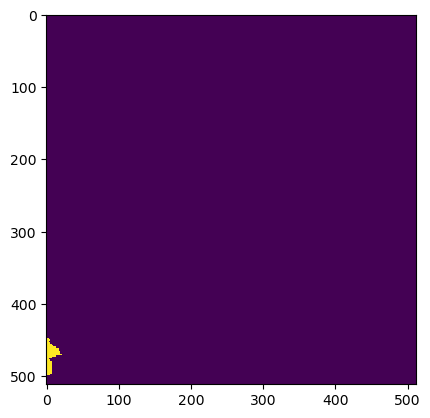

Wrote output/patches/mask/UU_S1_55-547126-4000-6282721-6000.tiff (512 x 512 pixels)


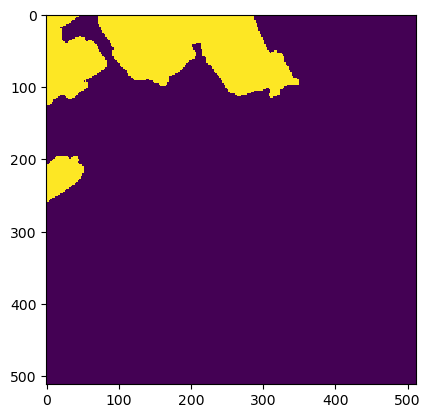

Wrote output/patches/mask/UU_S1_55-547228-8000-6282414-4000.tiff (512 x 512 pixels)


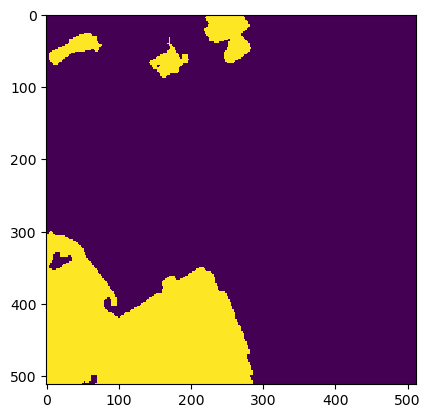

Wrote output/patches/mask/UU_S1_55-547228-8000-6282516-8000.tiff (512 x 512 pixels)


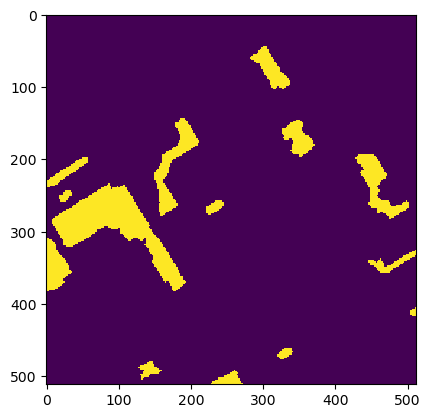

Wrote output/patches/mask/UU_S1_55-547228-8000-6282619-2000.tiff (512 x 512 pixels)


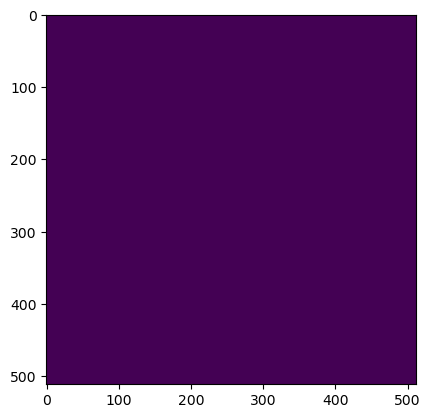

Wrote output/patches/mask/UU_S1_55-547228-8000-6282721-6000.tiff (512 x 512 pixels)


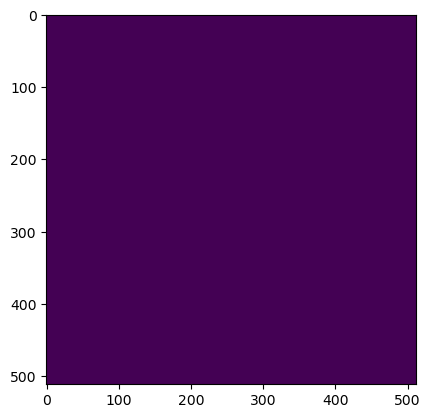

Wrote output/patches/mask/UU_S1_55-547331-2000-6282414-4000.tiff (512 x 512 pixels)


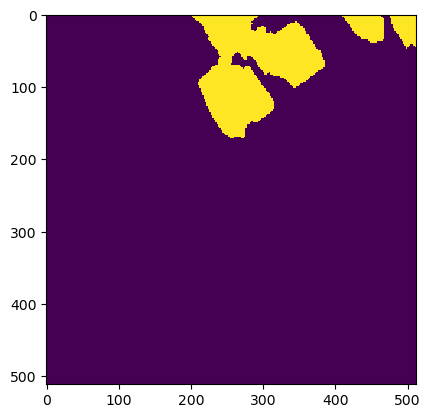

Wrote output/patches/mask/UU_S1_55-547331-2000-6282516-8000.tiff (512 x 512 pixels)


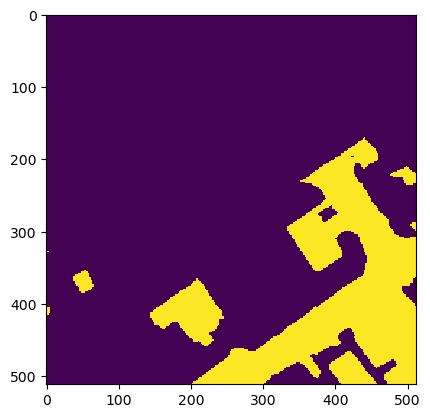

Wrote output/patches/mask/UU_S1_55-547331-2000-6282619-2000.tiff (512 x 512 pixels)


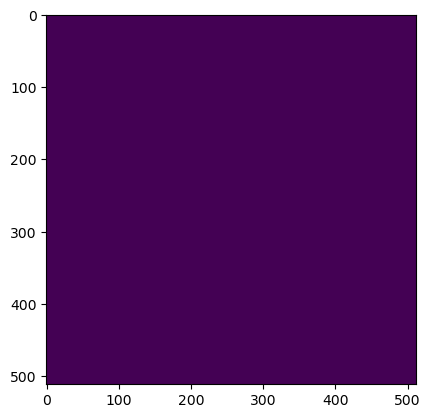

Wrote output/patches/mask/UU_S1_55-547331-2000-6282721-6000.tiff (512 x 512 pixels)


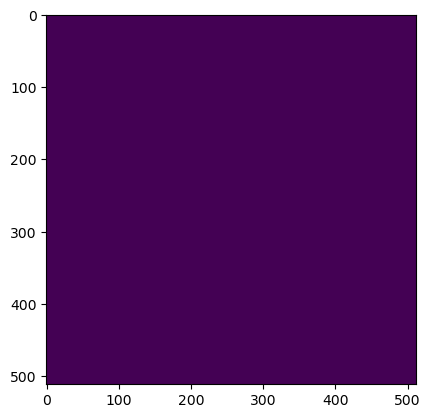

Wrote output/patches/mask/UU_S1_55-547433-6000-6282414-4000.tiff (512 x 512 pixels)


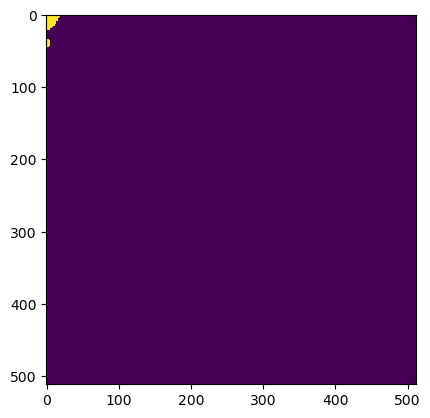

Wrote output/patches/mask/UU_S1_55-547433-6000-6282516-8000.tiff (512 x 512 pixels)


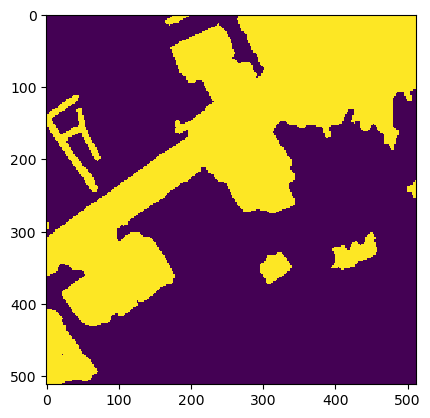

Wrote output/patches/mask/UU_S1_55-547433-6000-6282619-2000.tiff (512 x 512 pixels)


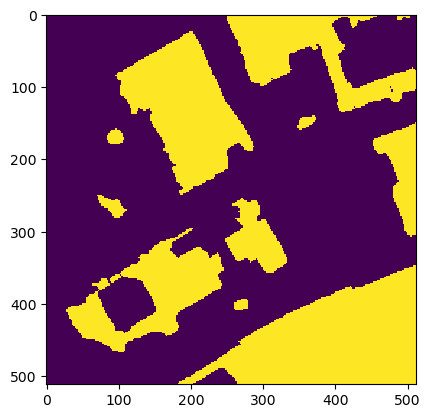

Wrote output/patches/mask/UU_S1_55-547433-6000-6282721-6000.tiff (512 x 512 pixels)


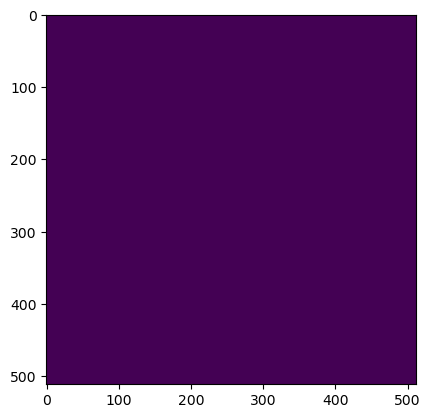

Wrote output/patches/mask/UU_S1_55-547536-0000-6282414-4000.tiff (512 x 512 pixels)


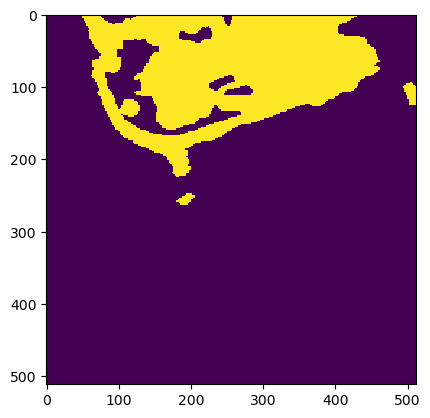

Wrote output/patches/mask/UU_S1_55-547536-0000-6282516-8000.tiff (512 x 512 pixels)


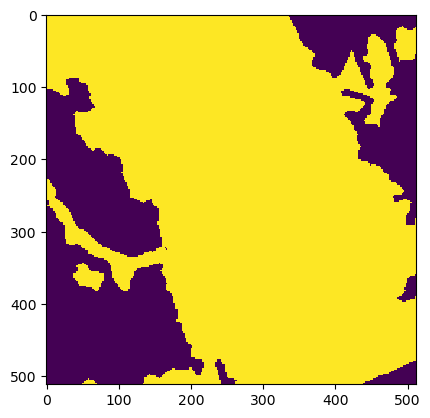

Wrote output/patches/mask/UU_S1_55-547536-0000-6282619-2000.tiff (512 x 512 pixels)


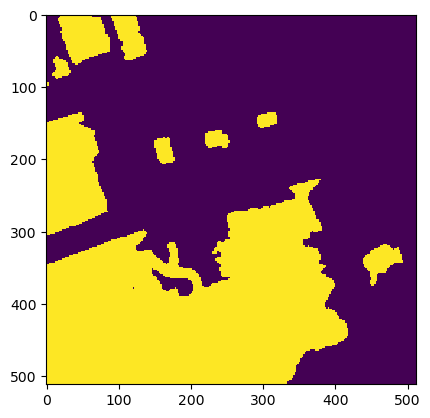

Wrote output/patches/mask/UU_S1_55-547536-0000-6282721-6000.tiff (512 x 512 pixels)


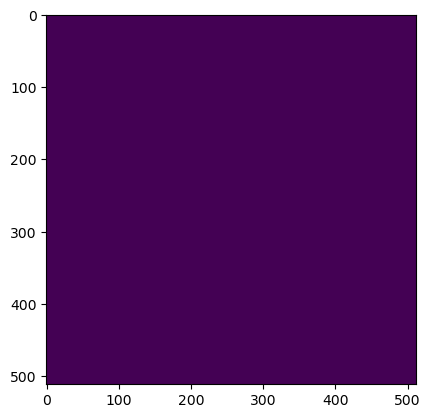

Wrote output/patches/mask/UU_S1_55-547638-4000-6282414-4000.tiff (512 x 512 pixels)


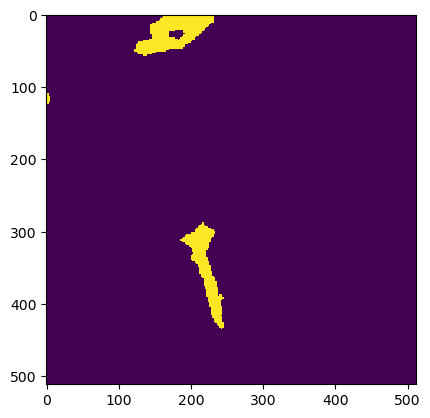

Wrote output/patches/mask/UU_S1_55-547638-4000-6282516-8000.tiff (512 x 512 pixels)


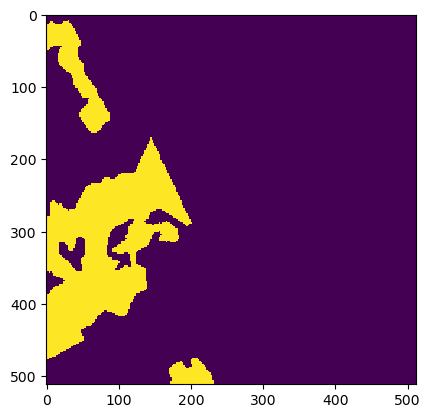

Wrote output/patches/mask/UU_S1_55-547638-4000-6282619-2000.tiff (512 x 512 pixels)


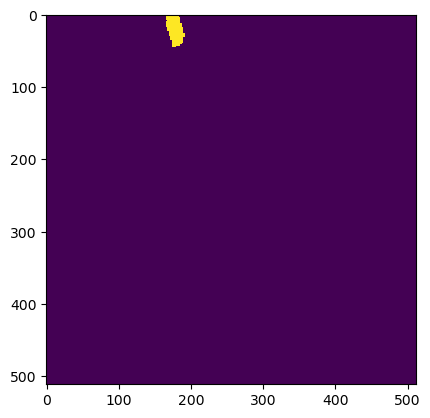

Wrote output/patches/mask/UU_S1_55-547638-4000-6282721-6000.tiff (512 x 512 pixels)
Zone UC_S1_56 Building Mask...


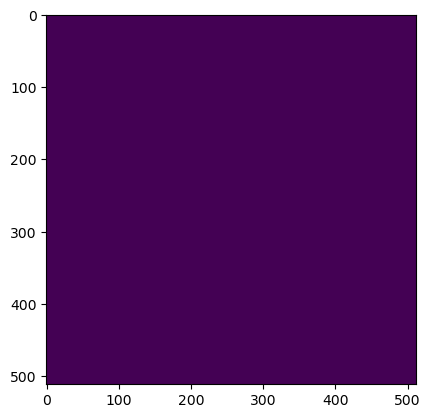

Wrote output/patches/mask/UC_S1_56-441296-0000-6282414-4000.tiff (512 x 512 pixels)


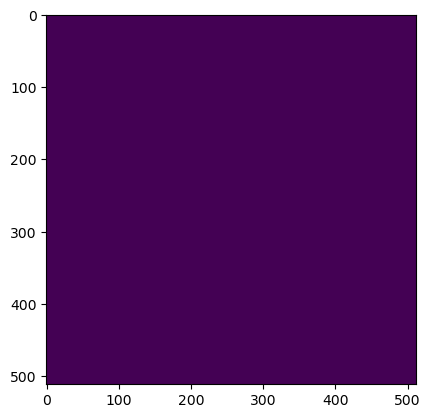

Wrote output/patches/mask/UC_S1_56-441296-0000-6282516-8000.tiff (512 x 512 pixels)


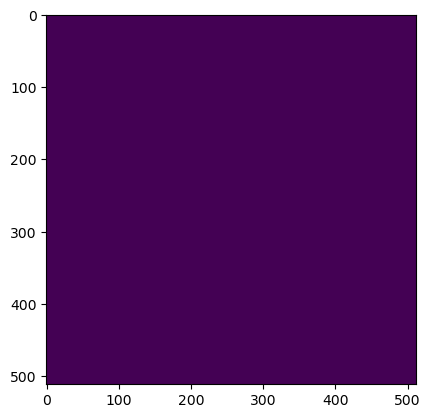

Wrote output/patches/mask/UC_S1_56-441296-0000-6282619-2000.tiff (512 x 512 pixels)


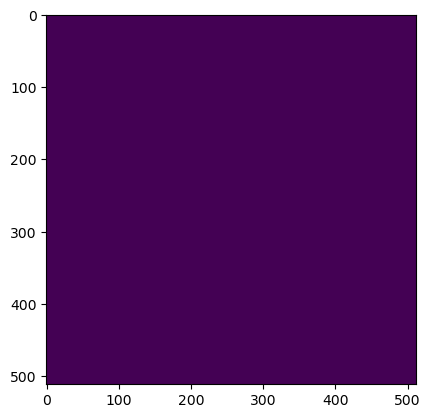

Wrote output/patches/mask/UC_S1_56-441296-0000-6282721-6000.tiff (512 x 512 pixels)


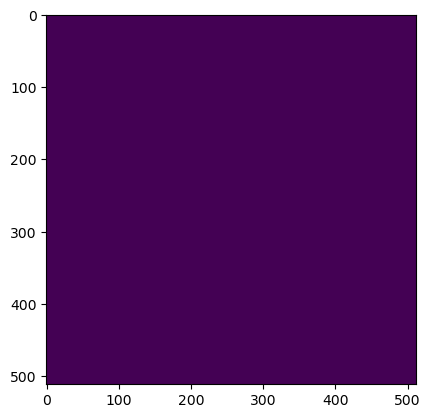

Wrote output/patches/mask/UC_S1_56-441398-4000-6282414-4000.tiff (512 x 512 pixels)


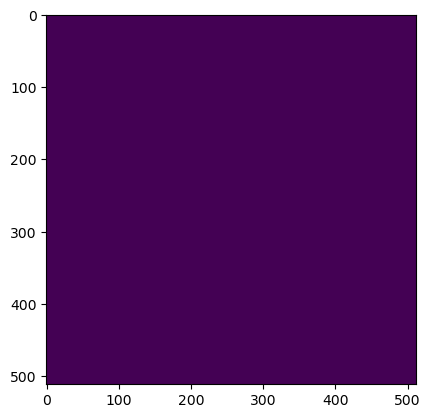

Wrote output/patches/mask/UC_S1_56-441398-4000-6282516-8000.tiff (512 x 512 pixels)


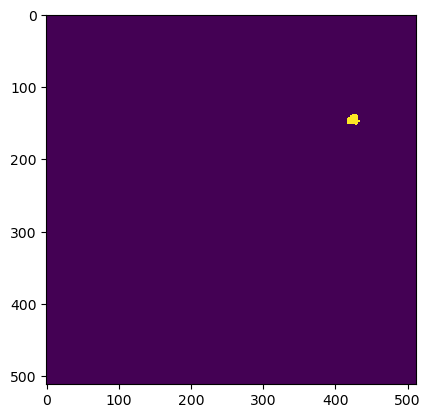

Wrote output/patches/mask/UC_S1_56-441398-4000-6282619-2000.tiff (512 x 512 pixels)


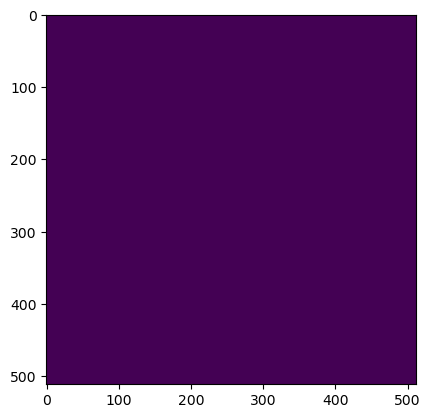

Wrote output/patches/mask/UC_S1_56-441398-4000-6282721-6000.tiff (512 x 512 pixels)


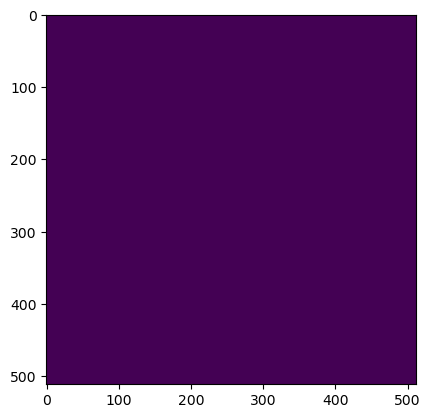

Wrote output/patches/mask/UC_S1_56-441500-8000-6282414-4000.tiff (512 x 512 pixels)


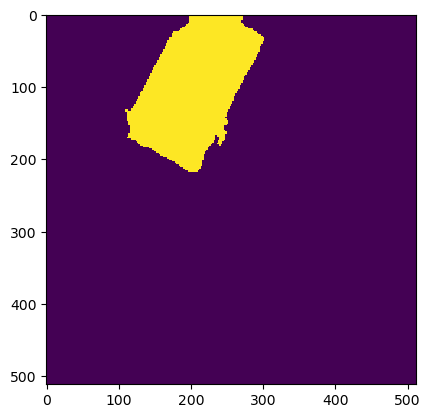

Wrote output/patches/mask/UC_S1_56-441500-8000-6282516-8000.tiff (512 x 512 pixels)


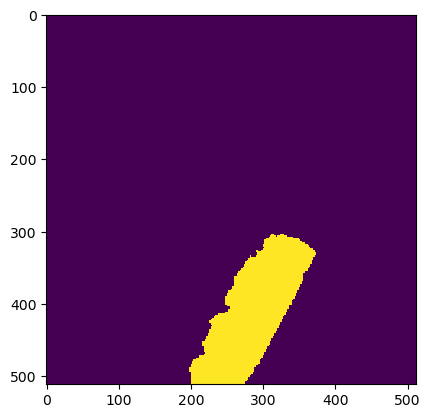

Wrote output/patches/mask/UC_S1_56-441500-8000-6282619-2000.tiff (512 x 512 pixels)


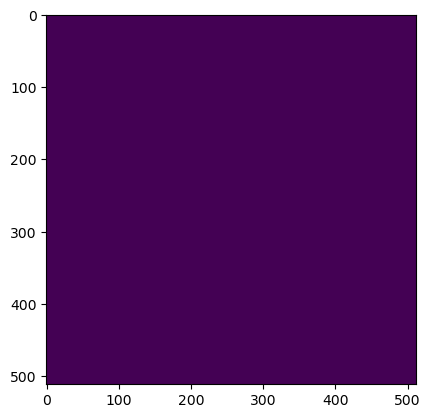

Wrote output/patches/mask/UC_S1_56-441500-8000-6282721-6000.tiff (512 x 512 pixels)


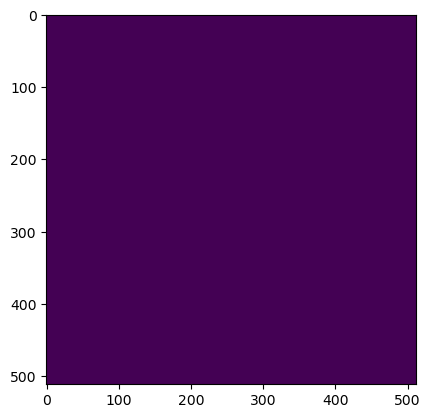

Wrote output/patches/mask/UC_S1_56-441603-2000-6282414-4000.tiff (512 x 512 pixels)


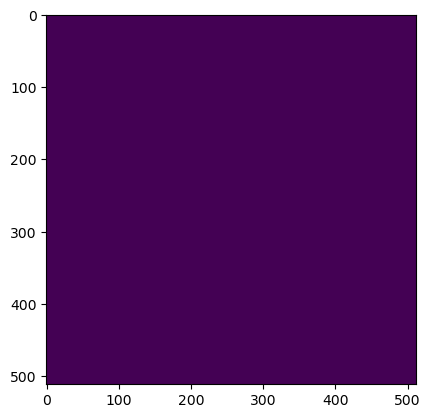

Wrote output/patches/mask/UC_S1_56-441603-2000-6282516-8000.tiff (512 x 512 pixels)


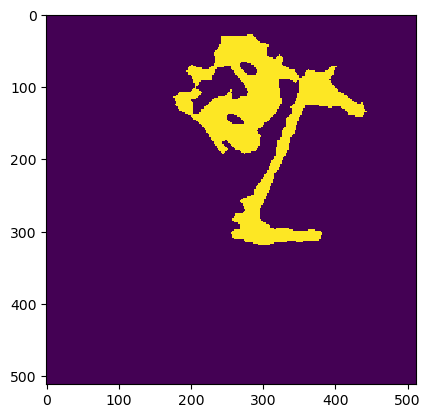

Wrote output/patches/mask/UC_S1_56-441603-2000-6282619-2000.tiff (512 x 512 pixels)


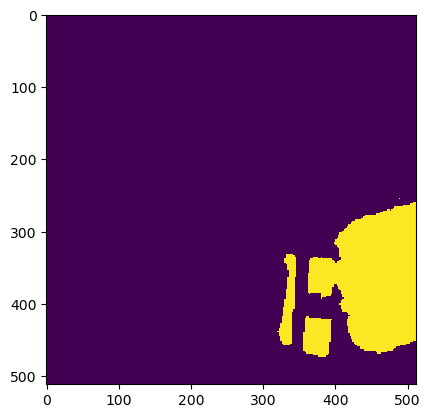

Wrote output/patches/mask/UC_S1_56-441603-2000-6282721-6000.tiff (512 x 512 pixels)
Zone UC_S1_57 Building Mask...


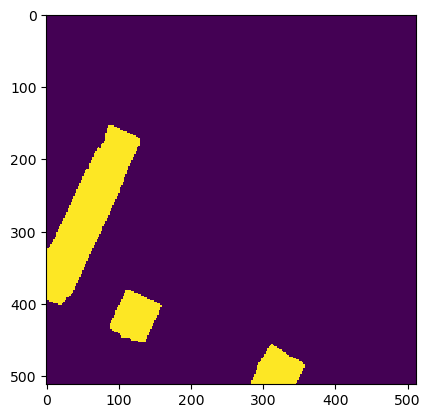

Wrote output/patches/mask/UC_S1_57-493264-0000-6282414-4000.tiff (512 x 512 pixels)


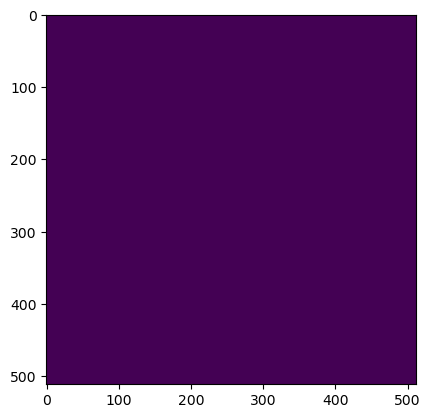

Wrote output/patches/mask/UC_S1_57-493264-0000-6282516-8000.tiff (512 x 512 pixels)


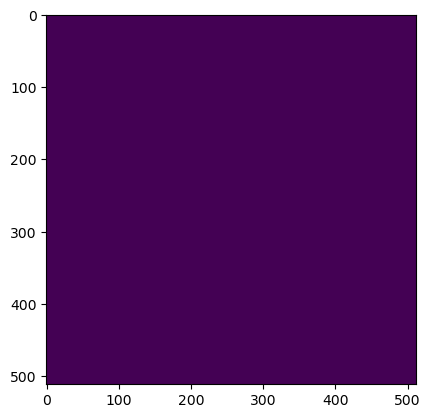

Wrote output/patches/mask/UC_S1_57-493264-0000-6282619-2000.tiff (512 x 512 pixels)


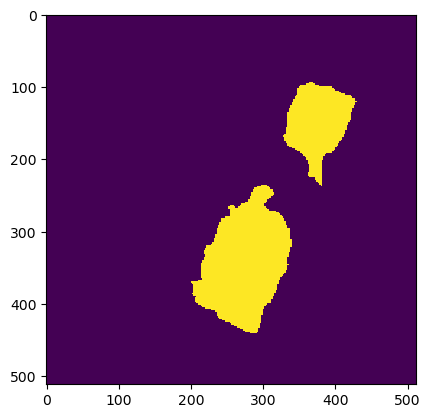

Wrote output/patches/mask/UC_S1_57-493264-0000-6282721-6000.tiff (512 x 512 pixels)


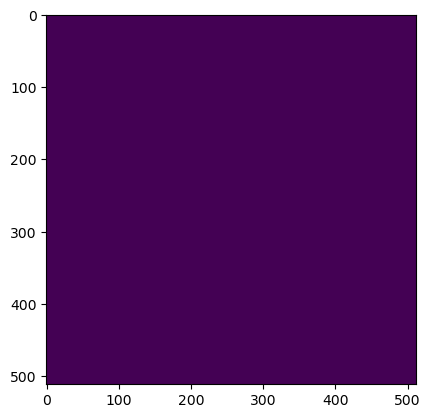

Wrote output/patches/mask/UC_S1_57-493366-4000-6282414-4000.tiff (512 x 512 pixels)


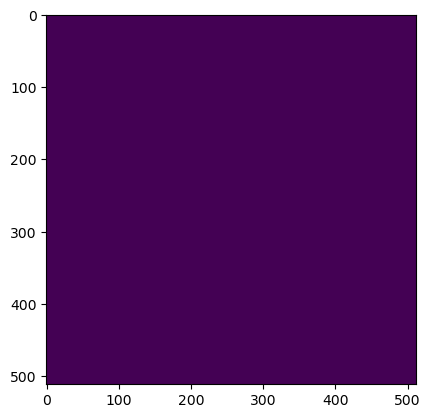

Wrote output/patches/mask/UC_S1_57-493366-4000-6282516-8000.tiff (512 x 512 pixels)


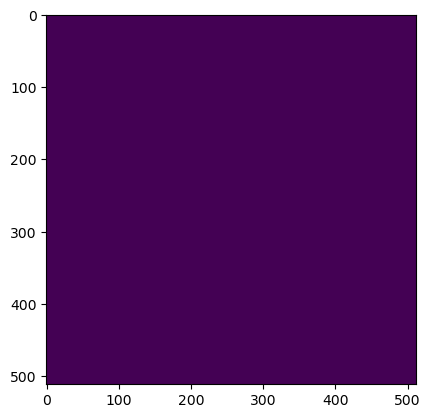

Wrote output/patches/mask/UC_S1_57-493366-4000-6282619-2000.tiff (512 x 512 pixels)


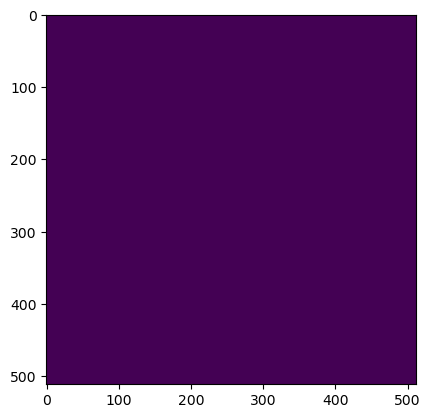

Wrote output/patches/mask/UC_S1_57-493366-4000-6282721-6000.tiff (512 x 512 pixels)
Zone CF_S1_58 Building Mask...


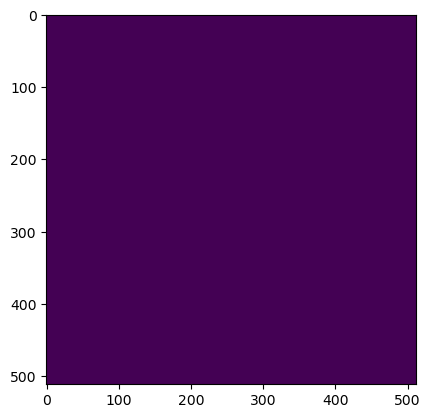

Wrote output/patches/mask/CF_S1_58-465104-0000-6282670-4000.tiff (512 x 512 pixels)


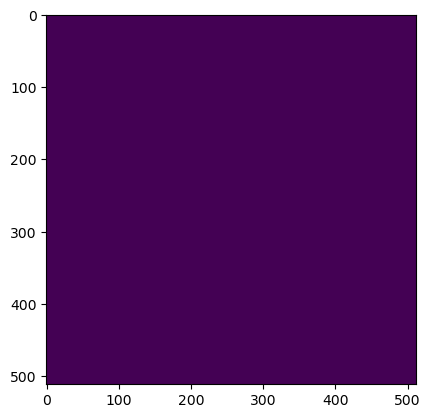

Wrote output/patches/mask/CF_S1_58-465104-0000-6282772-8000.tiff (512 x 512 pixels)


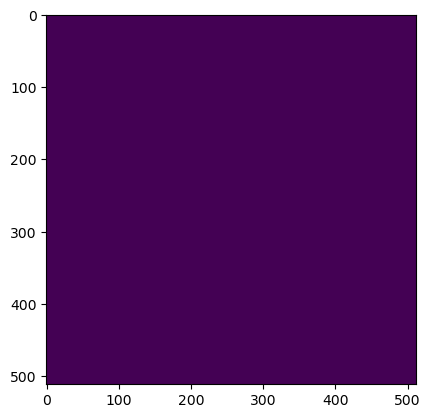

Wrote output/patches/mask/CF_S1_58-465104-0000-6282875-2000.tiff (512 x 512 pixels)


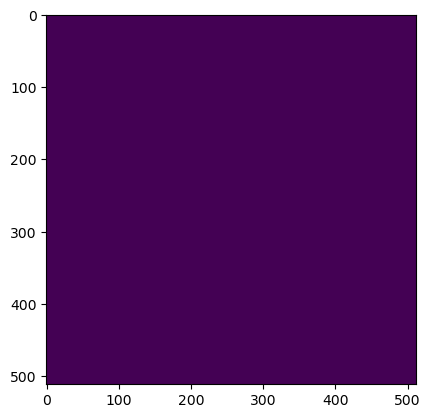

Wrote output/patches/mask/CF_S1_58-465104-0000-6282977-6000.tiff (512 x 512 pixels)


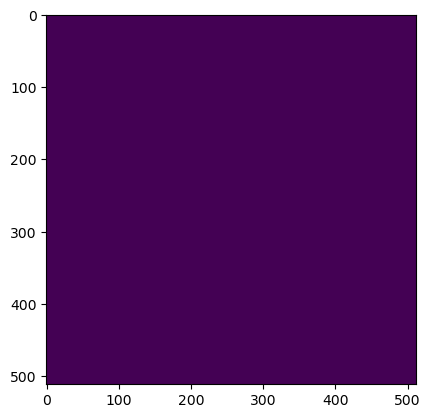

Wrote output/patches/mask/CF_S1_58-465206-4000-6282670-4000.tiff (512 x 512 pixels)


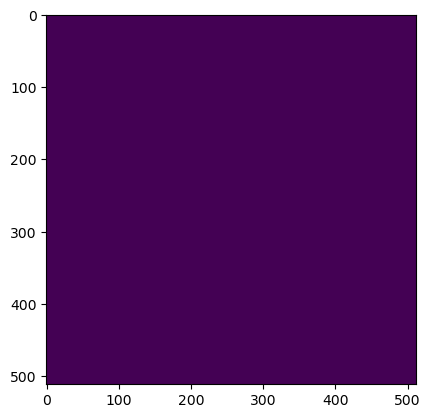

Wrote output/patches/mask/CF_S1_58-465206-4000-6282772-8000.tiff (512 x 512 pixels)


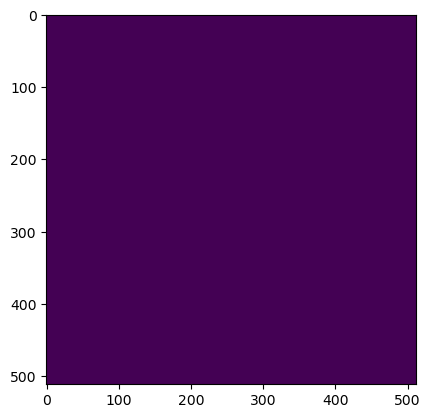

Wrote output/patches/mask/CF_S1_58-465206-4000-6282875-2000.tiff (512 x 512 pixels)


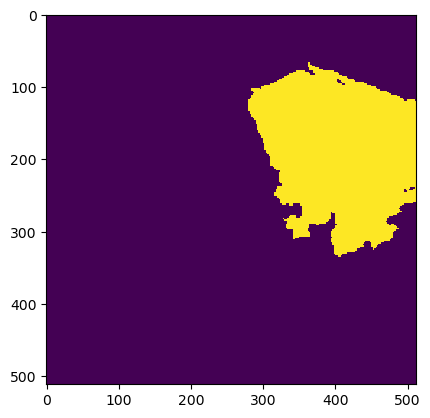

Wrote output/patches/mask/CF_S1_58-465206-4000-6282977-6000.tiff (512 x 512 pixels)
Zone UU_S1_59 Building Mask...


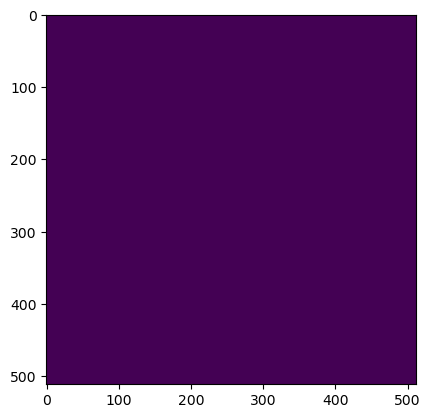

Wrote output/patches/mask/UU_S1_59-505040-0000-6283438-4000.tiff (512 x 512 pixels)


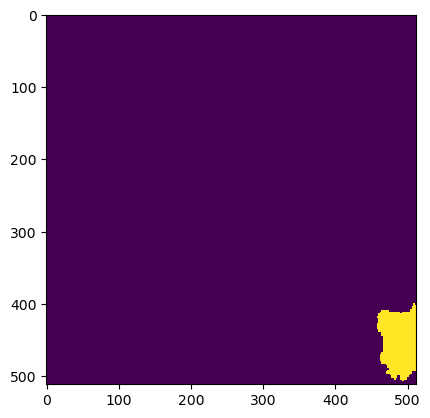

Wrote output/patches/mask/UU_S1_59-505040-0000-6283540-8000.tiff (512 x 512 pixels)


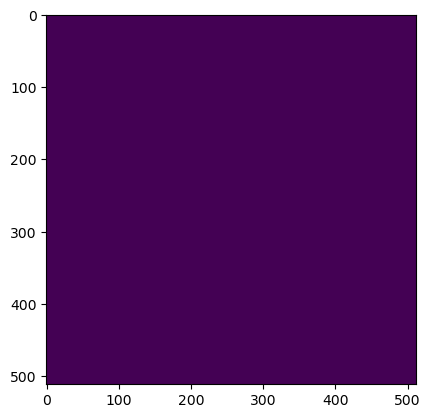

Wrote output/patches/mask/UU_S1_59-505040-0000-6283643-2000.tiff (512 x 512 pixels)


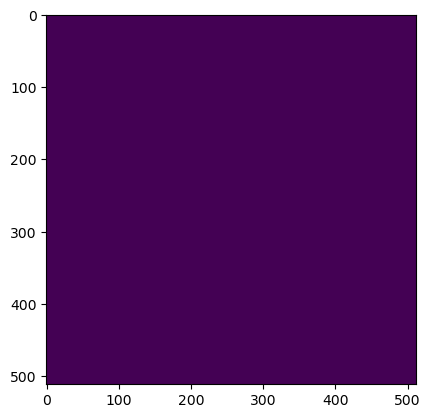

Wrote output/patches/mask/UU_S1_59-505040-0000-6283745-6000.tiff (512 x 512 pixels)


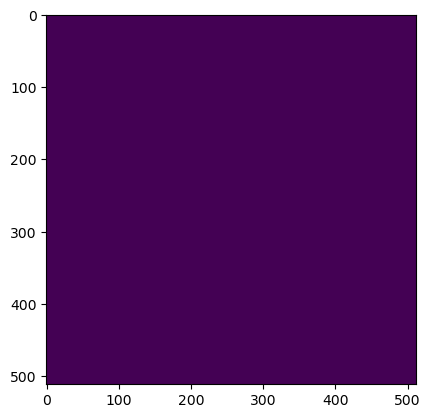

Wrote output/patches/mask/UU_S1_59-505142-4000-6283438-4000.tiff (512 x 512 pixels)


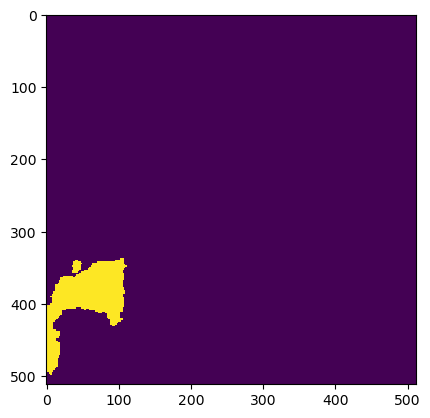

Wrote output/patches/mask/UU_S1_59-505142-4000-6283540-8000.tiff (512 x 512 pixels)


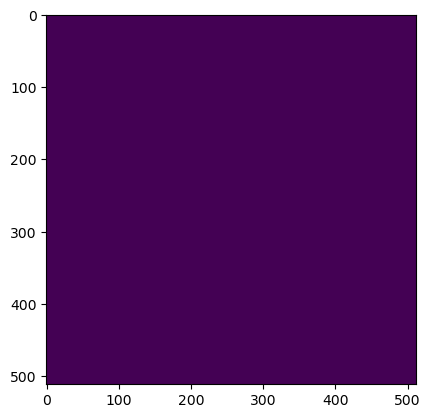

Wrote output/patches/mask/UU_S1_59-505142-4000-6283643-2000.tiff (512 x 512 pixels)


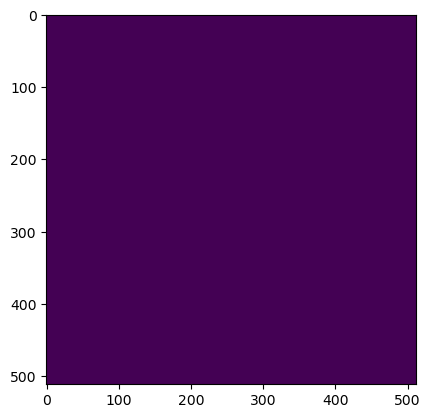

Wrote output/patches/mask/UU_S1_59-505142-4000-6283745-6000.tiff (512 x 512 pixels)


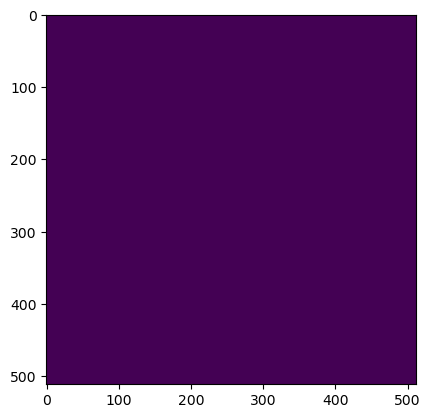

Wrote output/patches/mask/UU_S1_59-505244-8000-6283438-4000.tiff (512 x 512 pixels)


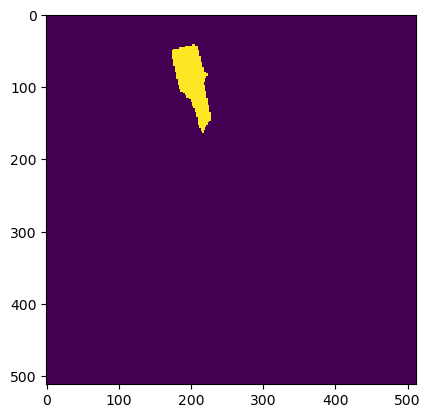

Wrote output/patches/mask/UU_S1_59-505244-8000-6283540-8000.tiff (512 x 512 pixels)


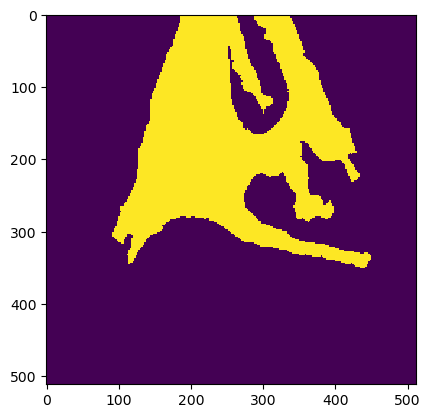

Wrote output/patches/mask/UU_S1_59-505244-8000-6283643-2000.tiff (512 x 512 pixels)


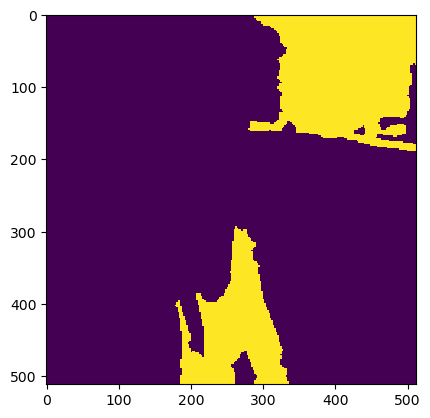

Wrote output/patches/mask/UU_S1_59-505244-8000-6283745-6000.tiff (512 x 512 pixels)


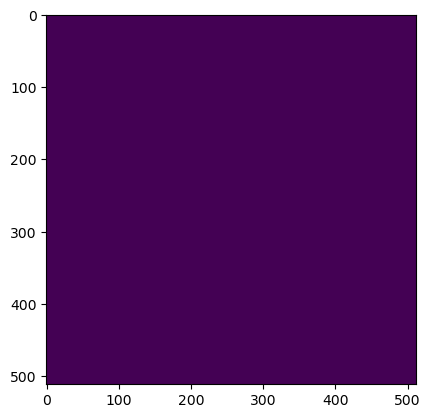

Wrote output/patches/mask/UU_S1_59-505347-2000-6283438-4000.tiff (512 x 512 pixels)


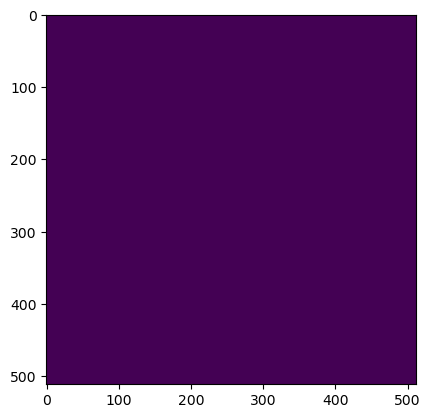

Wrote output/patches/mask/UU_S1_59-505347-2000-6283540-8000.tiff (512 x 512 pixels)


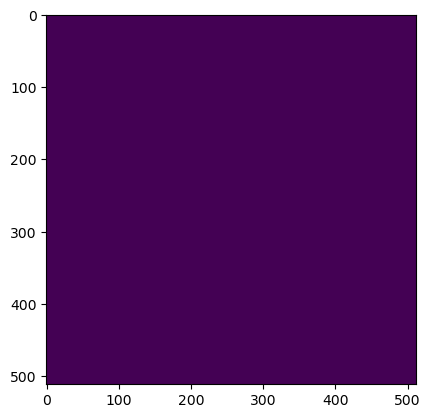

Wrote output/patches/mask/UU_S1_59-505347-2000-6283643-2000.tiff (512 x 512 pixels)


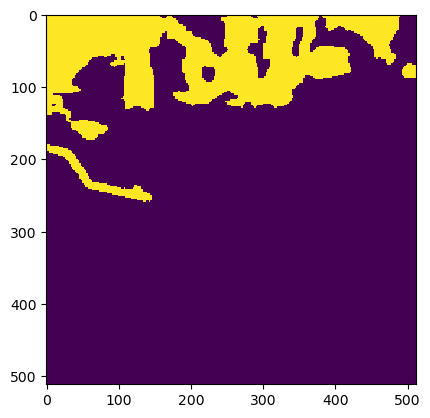

Wrote output/patches/mask/UU_S1_59-505347-2000-6283745-6000.tiff (512 x 512 pixels)
Zone UU_S1_60 Building Mask...


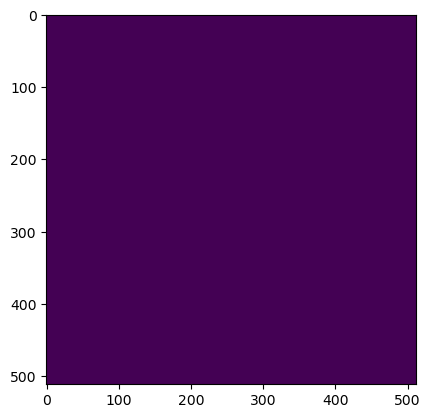

Wrote output/patches/mask/UU_S1_60-528592-0000-6283182-4000.tiff (512 x 512 pixels)


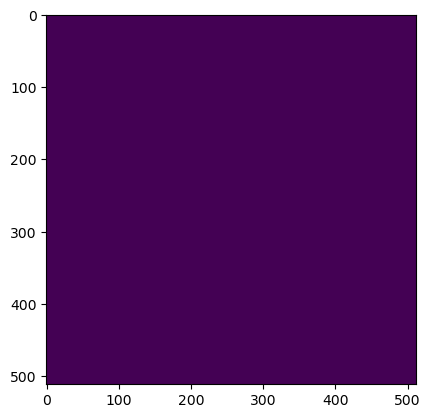

Wrote output/patches/mask/UU_S1_60-528592-0000-6283284-8000.tiff (512 x 512 pixels)


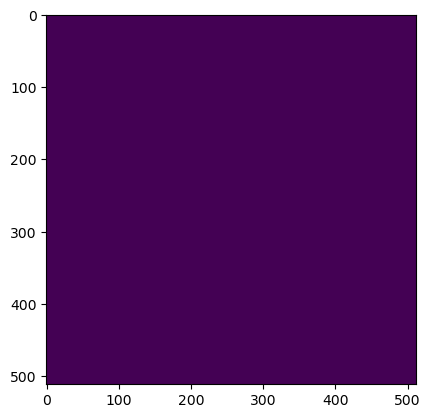

Wrote output/patches/mask/UU_S1_60-528694-4000-6283182-4000.tiff (512 x 512 pixels)


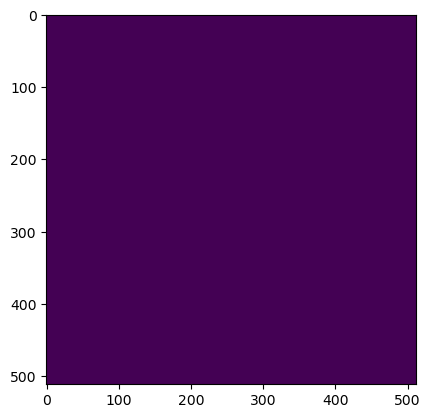

Wrote output/patches/mask/UU_S1_60-528694-4000-6283284-8000.tiff (512 x 512 pixels)
Zone UV_S1_61 Building Mask...


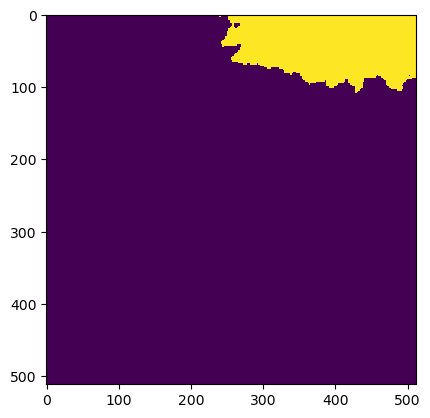

Wrote output/patches/mask/UV_S1_61-452304-0000-6283438-4000.tiff (512 x 512 pixels)


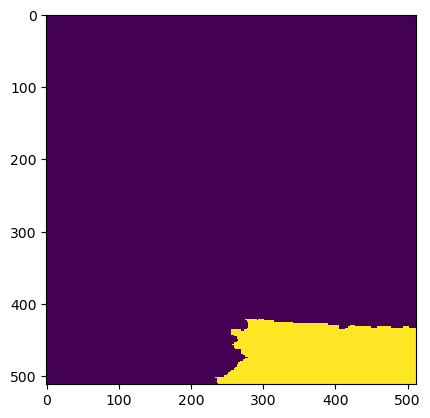

Wrote output/patches/mask/UV_S1_61-452304-0000-6283540-8000.tiff (512 x 512 pixels)


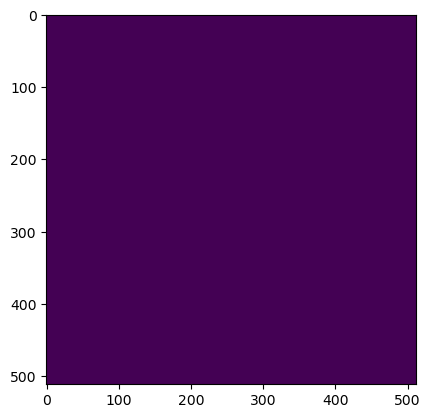

Wrote output/patches/mask/UV_S1_61-452304-0000-6283643-2000.tiff (512 x 512 pixels)


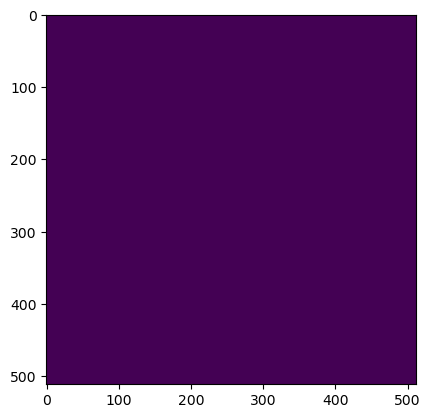

Wrote output/patches/mask/UV_S1_61-452304-0000-6283745-6000.tiff (512 x 512 pixels)


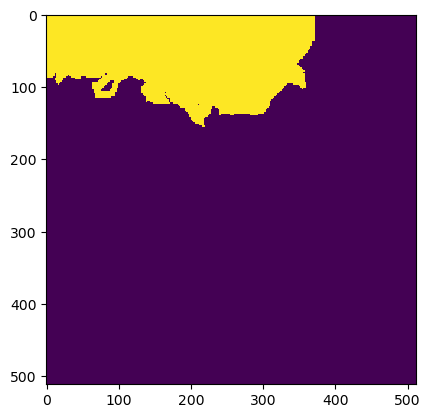

Wrote output/patches/mask/UV_S1_61-452406-4000-6283438-4000.tiff (512 x 512 pixels)


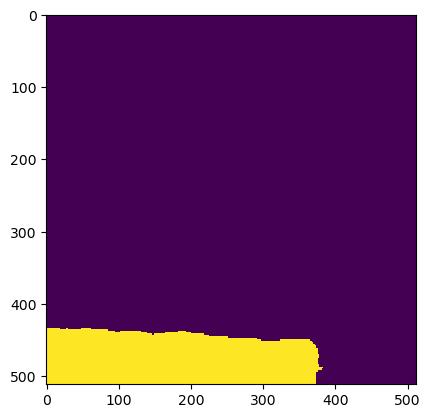

Wrote output/patches/mask/UV_S1_61-452406-4000-6283540-8000.tiff (512 x 512 pixels)


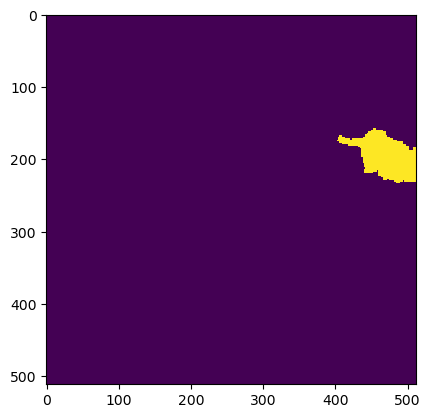

Wrote output/patches/mask/UV_S1_61-452406-4000-6283643-2000.tiff (512 x 512 pixels)


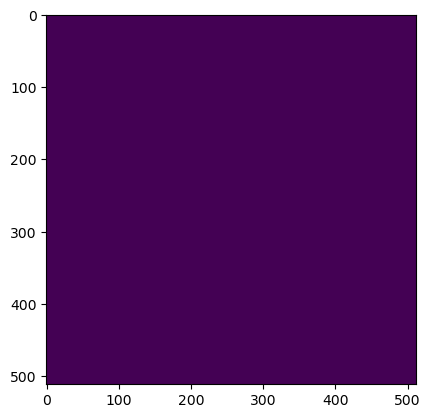

Wrote output/patches/mask/UV_S1_61-452406-4000-6283745-6000.tiff (512 x 512 pixels)
Zone NN_S1_62 Building Mask...


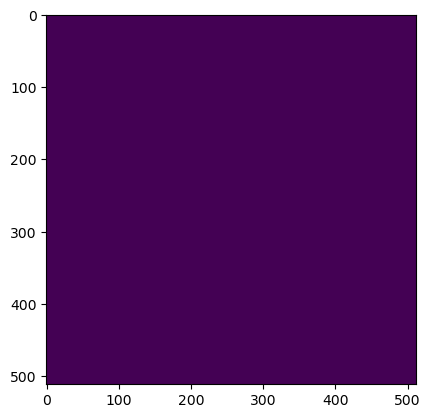

Wrote output/patches/mask/NN_S1_62-456656-0000-6283694-4000.tiff (512 x 512 pixels)


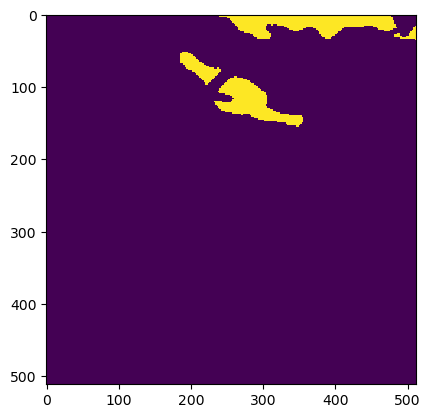

Wrote output/patches/mask/NN_S1_62-456656-0000-6283796-8000.tiff (512 x 512 pixels)


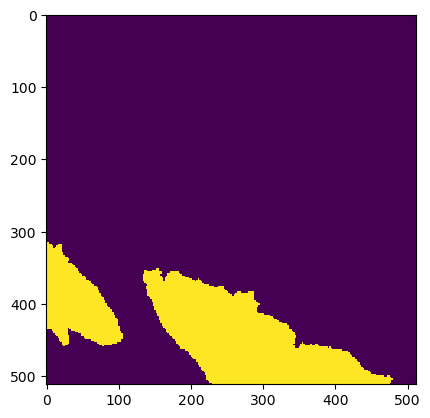

Wrote output/patches/mask/NN_S1_62-456656-0000-6283899-2000.tiff (512 x 512 pixels)


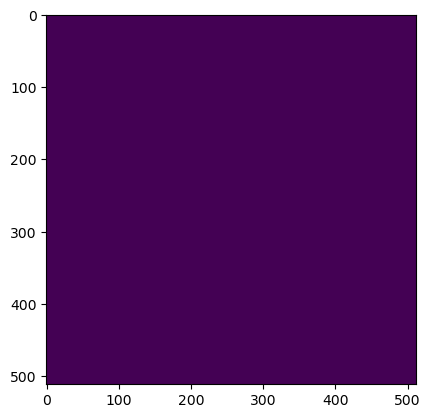

Wrote output/patches/mask/NN_S1_62-456656-0000-6284001-6000.tiff (512 x 512 pixels)


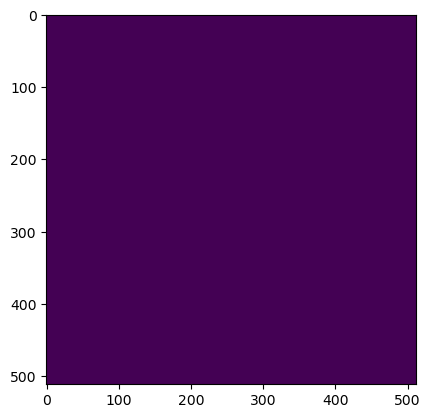

Wrote output/patches/mask/NN_S1_62-456758-4000-6283694-4000.tiff (512 x 512 pixels)


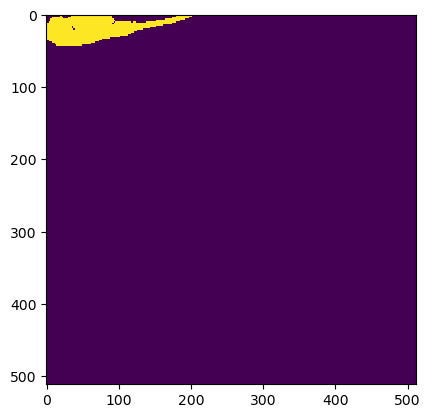

Wrote output/patches/mask/NN_S1_62-456758-4000-6283796-8000.tiff (512 x 512 pixels)


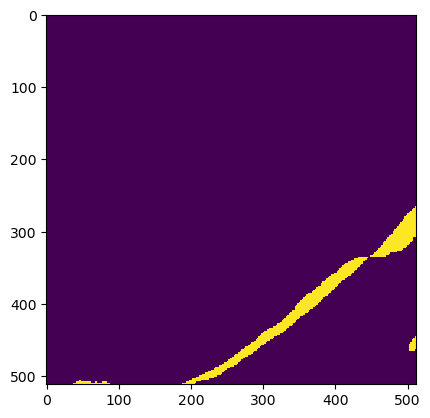

Wrote output/patches/mask/NN_S1_62-456758-4000-6283899-2000.tiff (512 x 512 pixels)


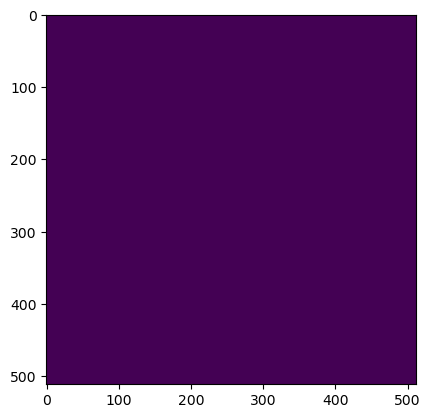

Wrote output/patches/mask/NN_S1_62-456758-4000-6284001-6000.tiff (512 x 512 pixels)


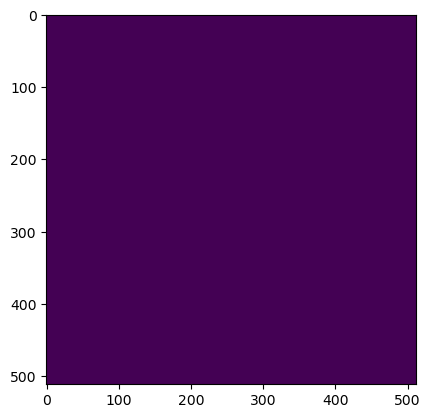

Wrote output/patches/mask/NN_S1_62-456860-8000-6283694-4000.tiff (512 x 512 pixels)


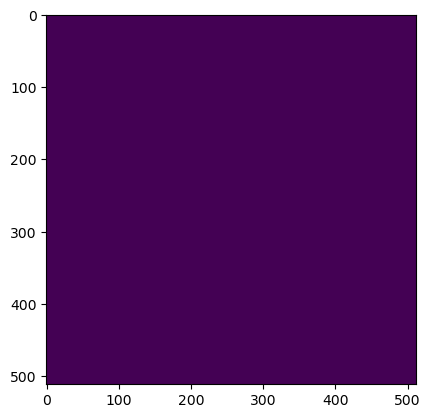

Wrote output/patches/mask/NN_S1_62-456860-8000-6283796-8000.tiff (512 x 512 pixels)


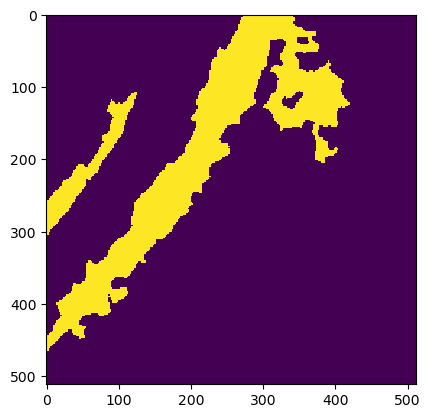

Wrote output/patches/mask/NN_S1_62-456860-8000-6283899-2000.tiff (512 x 512 pixels)


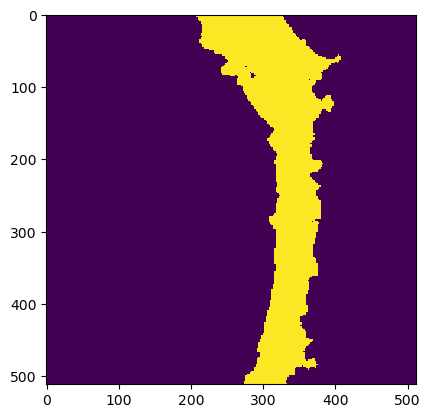

Wrote output/patches/mask/NN_S1_62-456860-8000-6284001-6000.tiff (512 x 512 pixels)


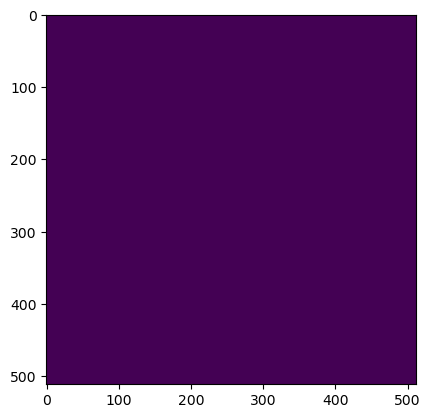

Wrote output/patches/mask/NN_S1_62-456963-2000-6283694-4000.tiff (512 x 512 pixels)


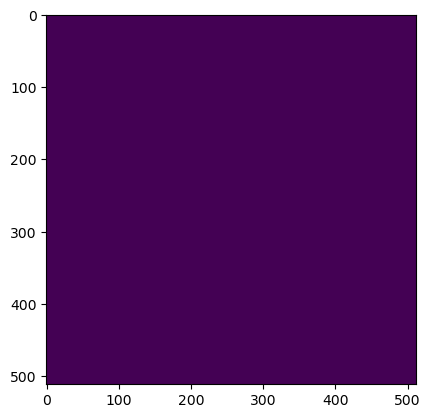

Wrote output/patches/mask/NN_S1_62-456963-2000-6283796-8000.tiff (512 x 512 pixels)


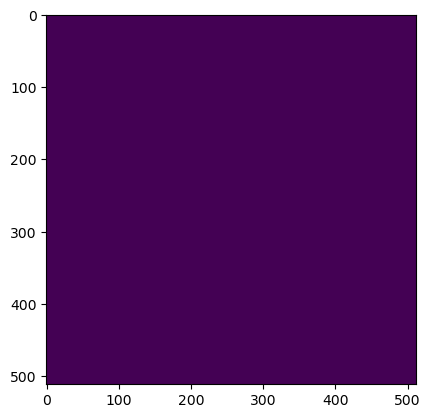

Wrote output/patches/mask/NN_S1_62-456963-2000-6283899-2000.tiff (512 x 512 pixels)


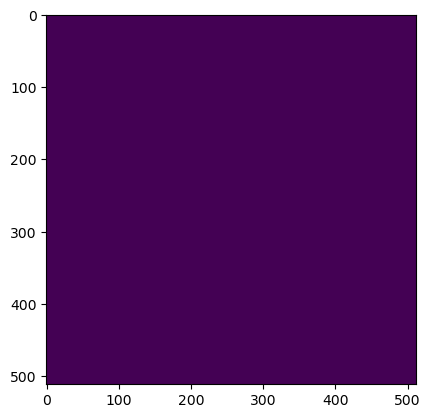

Wrote output/patches/mask/NN_S1_62-456963-2000-6284001-6000.tiff (512 x 512 pixels)
Zone UV_S1_63 Building Mask...


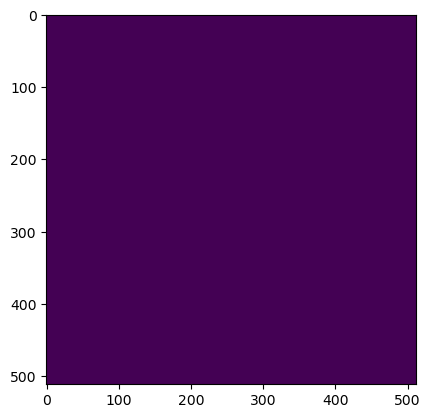

Wrote output/patches/mask/UV_S1_63-546256-0000-6283694-4000.tiff (512 x 512 pixels)


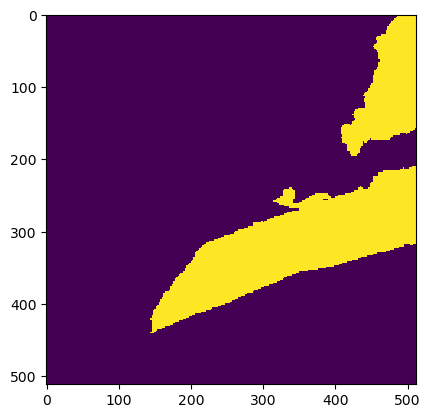

Wrote output/patches/mask/UV_S1_63-546256-0000-6283796-8000.tiff (512 x 512 pixels)


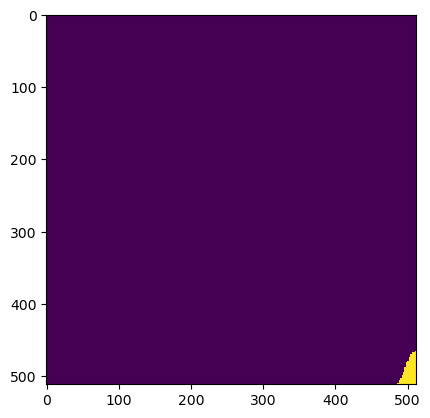

Wrote output/patches/mask/UV_S1_63-546256-0000-6283899-2000.tiff (512 x 512 pixels)


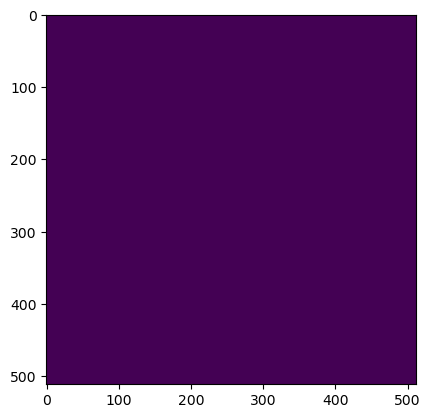

Wrote output/patches/mask/UV_S1_63-546256-0000-6284001-6000.tiff (512 x 512 pixels)


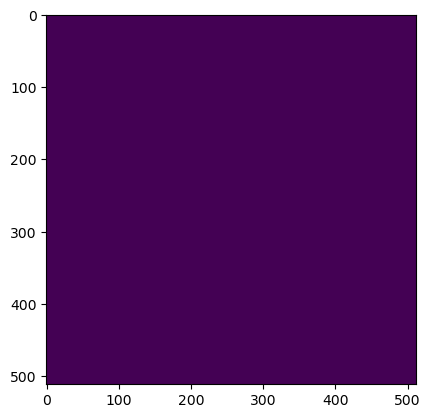

Wrote output/patches/mask/UV_S1_63-546256-0000-6284104-0000.tiff (512 x 512 pixels)


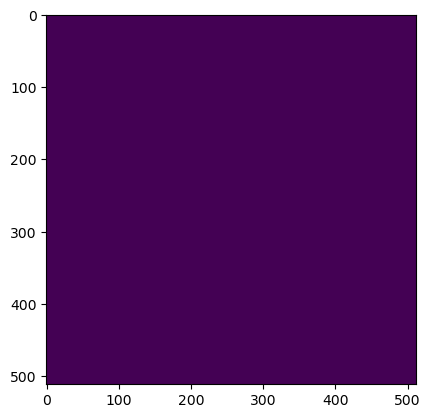

Wrote output/patches/mask/UV_S1_63-546256-0000-6284206-4000.tiff (512 x 512 pixels)


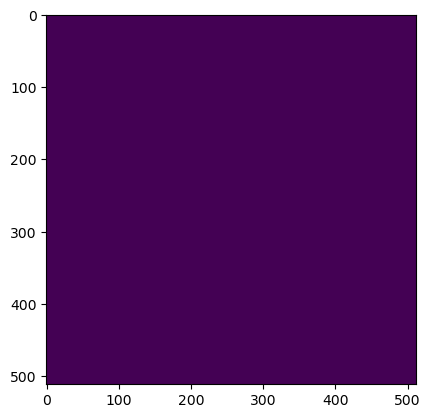

Wrote output/patches/mask/UV_S1_63-546256-0000-6284308-8000.tiff (512 x 512 pixels)


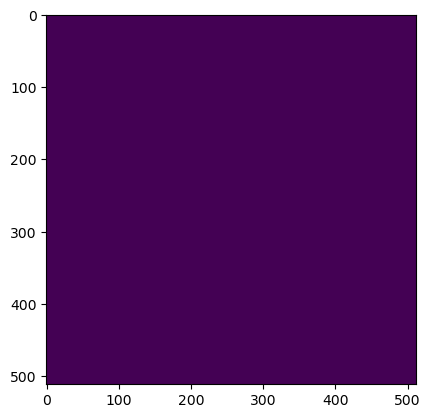

Wrote output/patches/mask/UV_S1_63-546358-4000-6283694-4000.tiff (512 x 512 pixels)


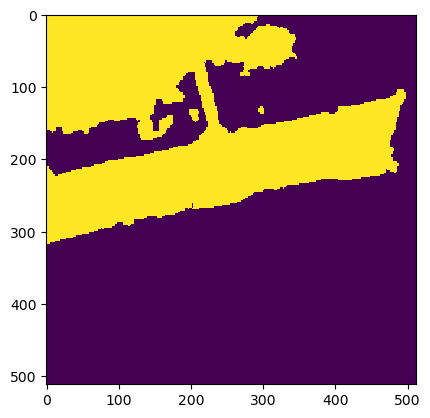

Wrote output/patches/mask/UV_S1_63-546358-4000-6283796-8000.tiff (512 x 512 pixels)


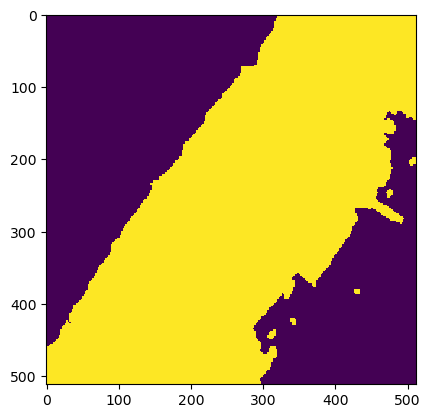

Wrote output/patches/mask/UV_S1_63-546358-4000-6283899-2000.tiff (512 x 512 pixels)


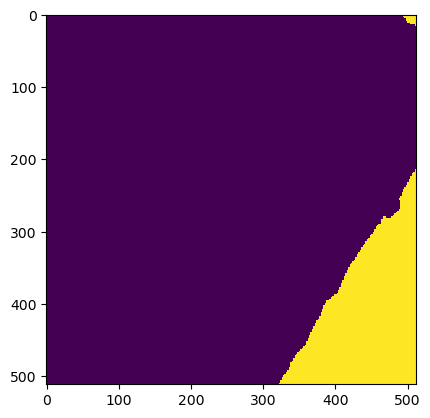

Wrote output/patches/mask/UV_S1_63-546358-4000-6284001-6000.tiff (512 x 512 pixels)


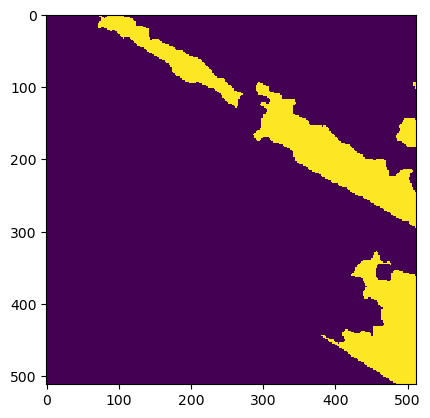

Wrote output/patches/mask/UV_S1_63-546358-4000-6284104-0000.tiff (512 x 512 pixels)


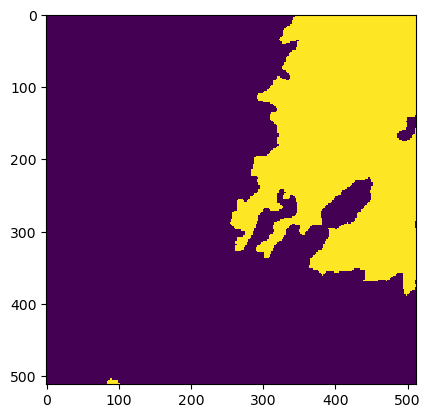

Wrote output/patches/mask/UV_S1_63-546358-4000-6284206-4000.tiff (512 x 512 pixels)


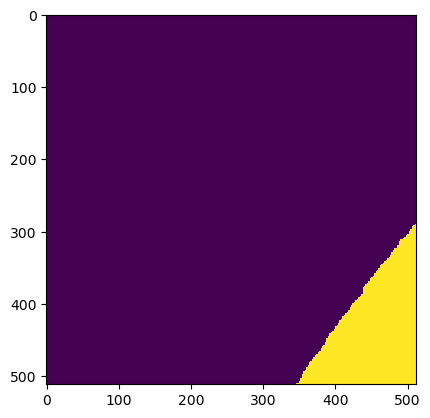

Wrote output/patches/mask/UV_S1_63-546358-4000-6284308-8000.tiff (512 x 512 pixels)


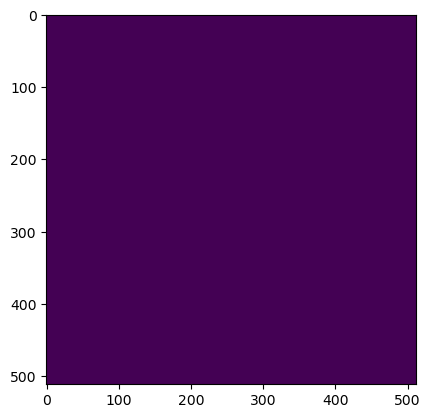

Wrote output/patches/mask/UV_S1_63-546460-8000-6283694-4000.tiff (512 x 512 pixels)


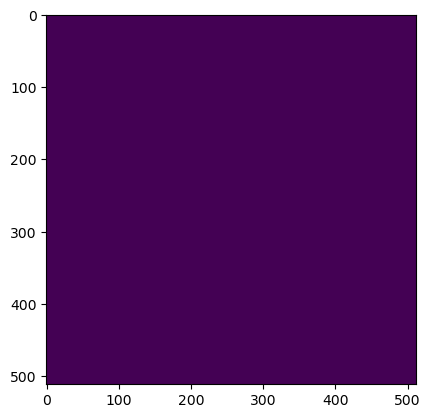

Wrote output/patches/mask/UV_S1_63-546460-8000-6283796-8000.tiff (512 x 512 pixels)


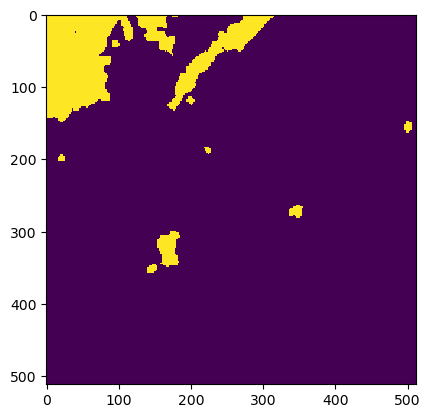

Wrote output/patches/mask/UV_S1_63-546460-8000-6283899-2000.tiff (512 x 512 pixels)


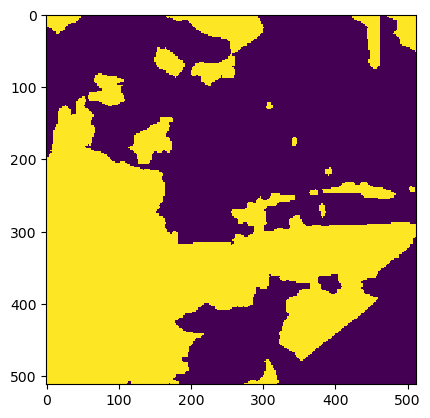

Wrote output/patches/mask/UV_S1_63-546460-8000-6284001-6000.tiff (512 x 512 pixels)


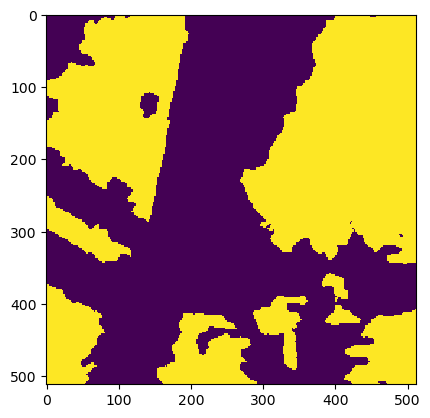

Wrote output/patches/mask/UV_S1_63-546460-8000-6284104-0000.tiff (512 x 512 pixels)


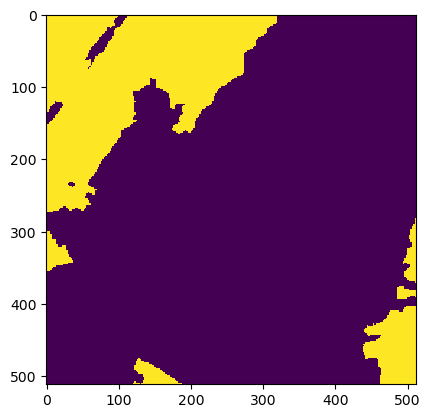

Wrote output/patches/mask/UV_S1_63-546460-8000-6284206-4000.tiff (512 x 512 pixels)


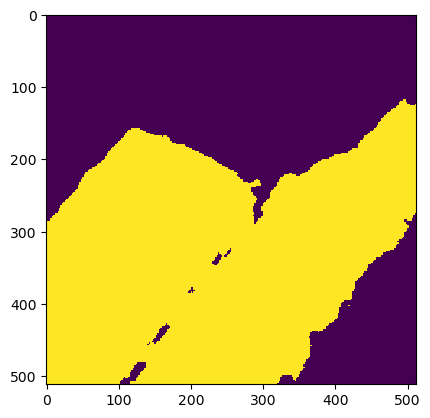

Wrote output/patches/mask/UV_S1_63-546460-8000-6284308-8000.tiff (512 x 512 pixels)


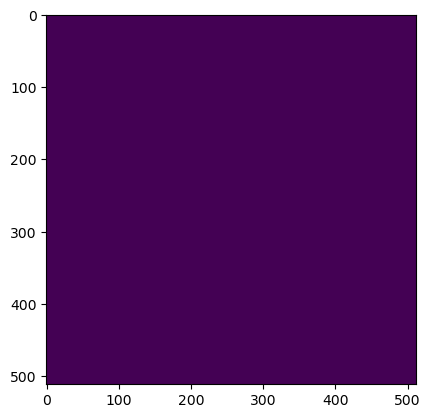

Wrote output/patches/mask/UV_S1_63-546563-2000-6283694-4000.tiff (512 x 512 pixels)


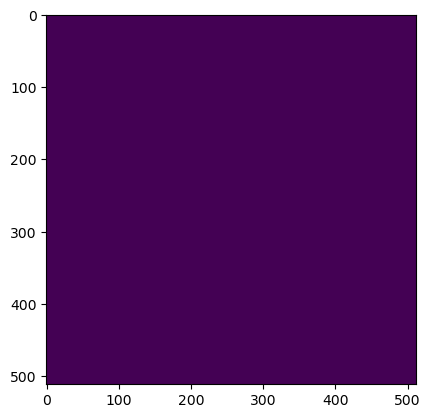

Wrote output/patches/mask/UV_S1_63-546563-2000-6283796-8000.tiff (512 x 512 pixels)


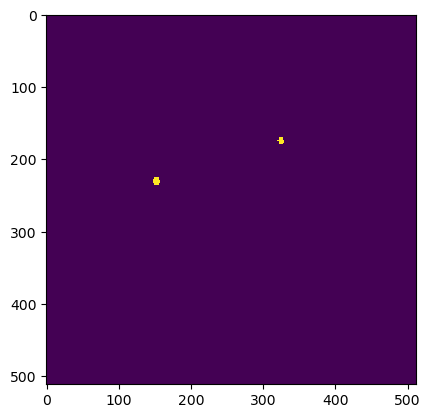

Wrote output/patches/mask/UV_S1_63-546563-2000-6283899-2000.tiff (512 x 512 pixels)


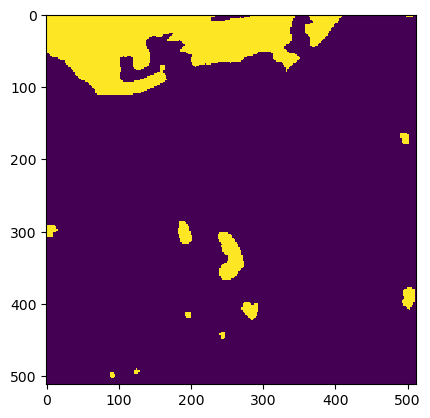

Wrote output/patches/mask/UV_S1_63-546563-2000-6284001-6000.tiff (512 x 512 pixels)


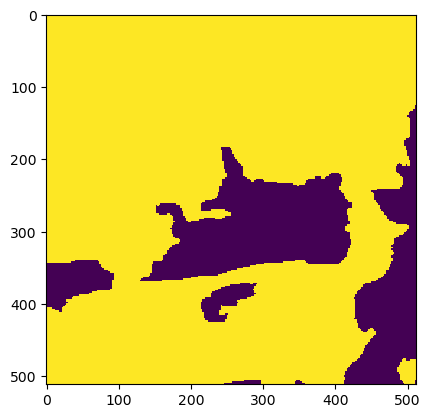

Wrote output/patches/mask/UV_S1_63-546563-2000-6284104-0000.tiff (512 x 512 pixels)


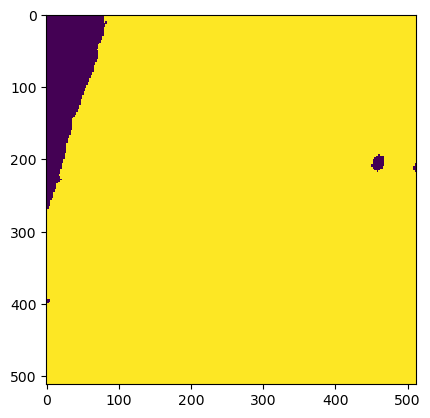

Wrote output/patches/mask/UV_S1_63-546563-2000-6284206-4000.tiff (512 x 512 pixels)


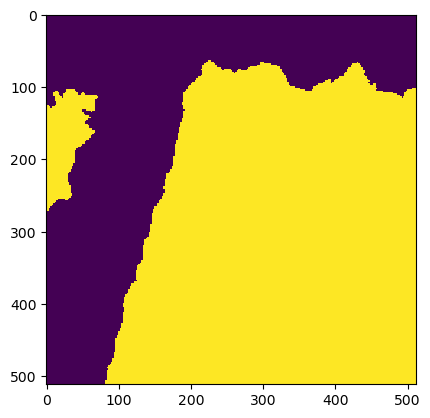

Wrote output/patches/mask/UV_S1_63-546563-2000-6284308-8000.tiff (512 x 512 pixels)


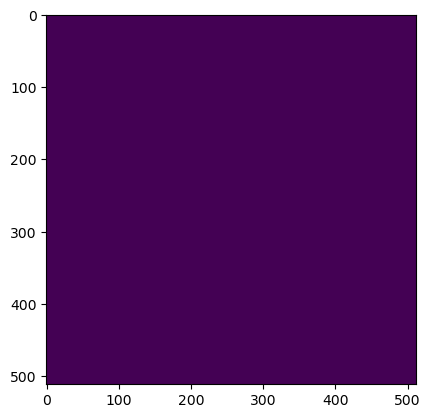

Wrote output/patches/mask/UV_S1_63-546665-6000-6283694-4000.tiff (512 x 512 pixels)


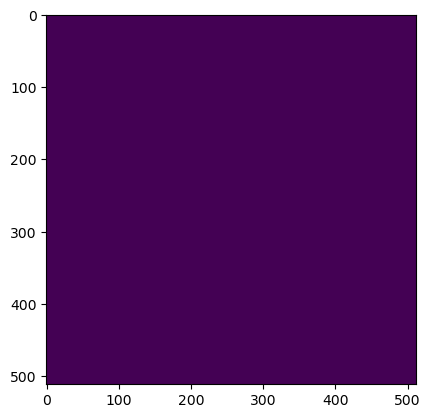

Wrote output/patches/mask/UV_S1_63-546665-6000-6283796-8000.tiff (512 x 512 pixels)


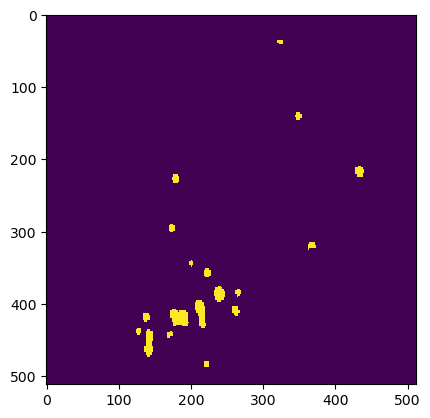

Wrote output/patches/mask/UV_S1_63-546665-6000-6283899-2000.tiff (512 x 512 pixels)


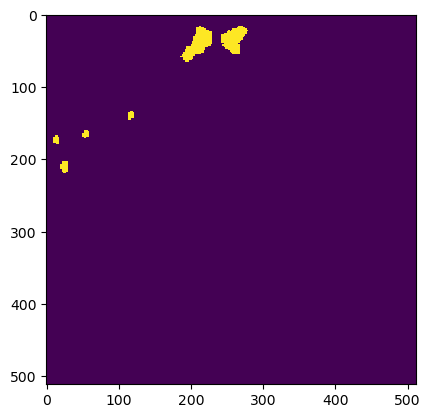

Wrote output/patches/mask/UV_S1_63-546665-6000-6284001-6000.tiff (512 x 512 pixels)


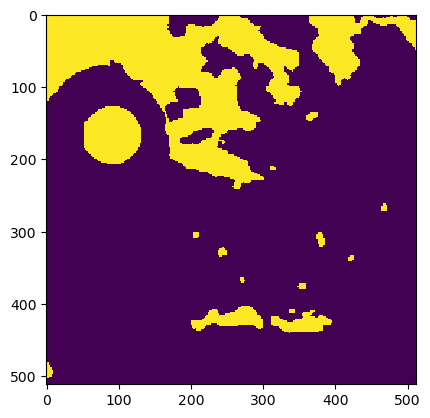

Wrote output/patches/mask/UV_S1_63-546665-6000-6284104-0000.tiff (512 x 512 pixels)


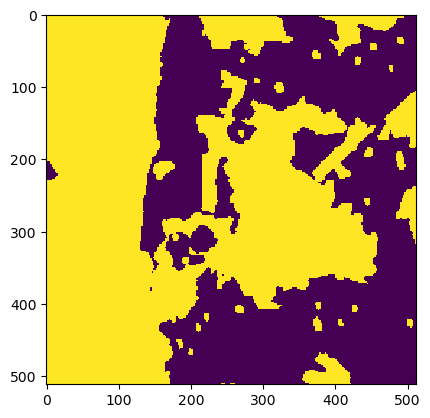

Wrote output/patches/mask/UV_S1_63-546665-6000-6284206-4000.tiff (512 x 512 pixels)


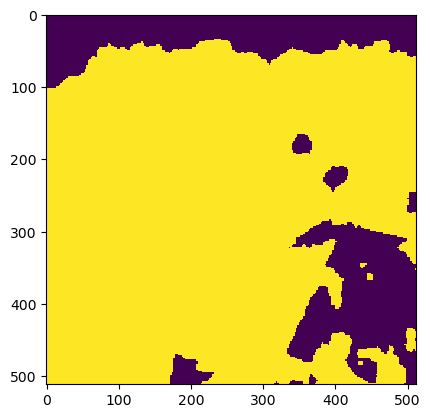

Wrote output/patches/mask/UV_S1_63-546665-6000-6284308-8000.tiff (512 x 512 pixels)


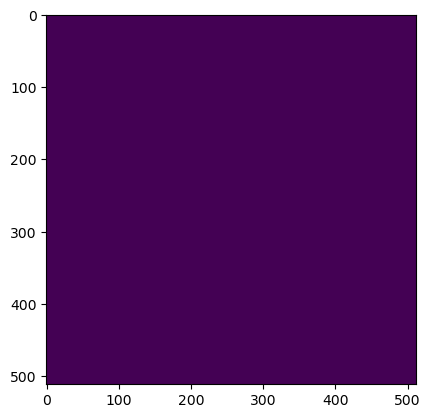

Wrote output/patches/mask/UV_S1_63-546768-0000-6283694-4000.tiff (512 x 512 pixels)


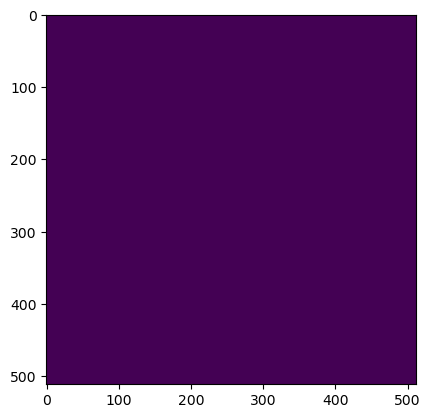

Wrote output/patches/mask/UV_S1_63-546768-0000-6283796-8000.tiff (512 x 512 pixels)


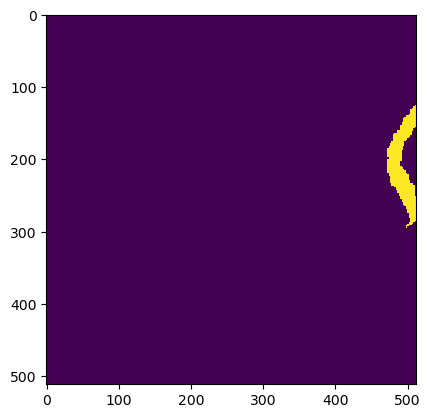

Wrote output/patches/mask/UV_S1_63-546768-0000-6283899-2000.tiff (512 x 512 pixels)


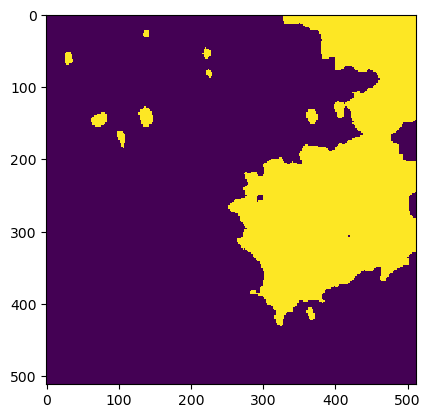

Wrote output/patches/mask/UV_S1_63-546768-0000-6284001-6000.tiff (512 x 512 pixels)


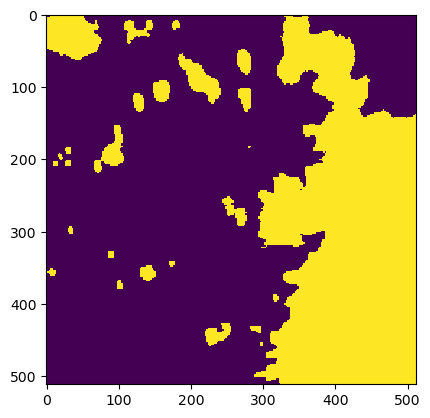

Wrote output/patches/mask/UV_S1_63-546768-0000-6284104-0000.tiff (512 x 512 pixels)


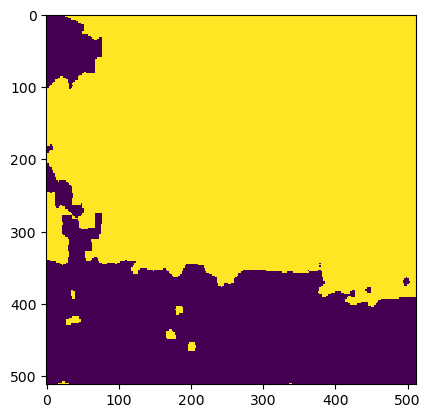

Wrote output/patches/mask/UV_S1_63-546768-0000-6284206-4000.tiff (512 x 512 pixels)


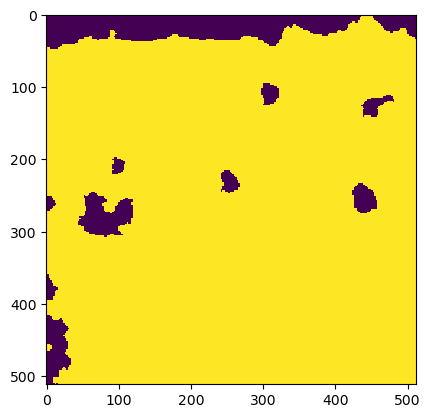

Wrote output/patches/mask/UV_S1_63-546768-0000-6284308-8000.tiff (512 x 512 pixels)


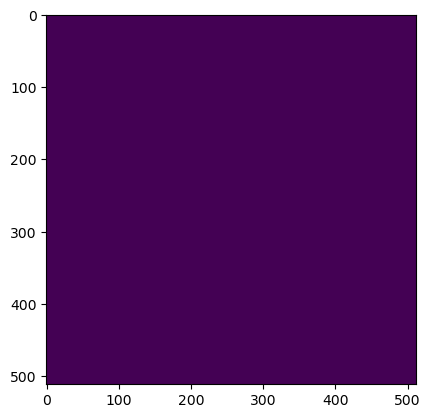

Wrote output/patches/mask/UV_S1_63-546870-4000-6283694-4000.tiff (512 x 512 pixels)


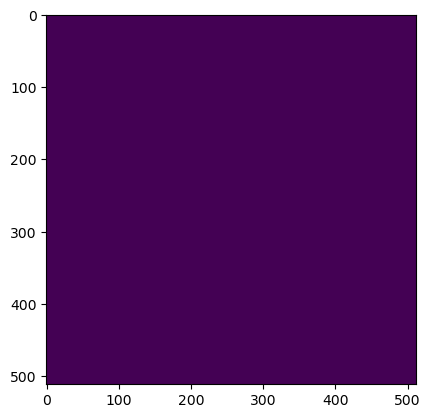

Wrote output/patches/mask/UV_S1_63-546870-4000-6283796-8000.tiff (512 x 512 pixels)


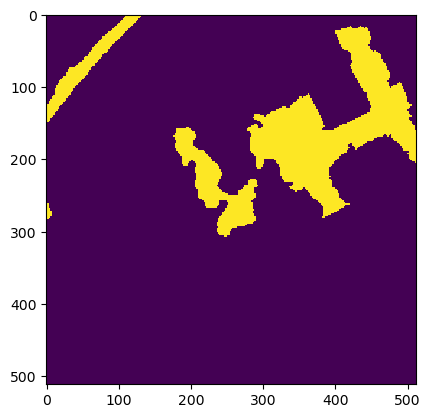

Wrote output/patches/mask/UV_S1_63-546870-4000-6283899-2000.tiff (512 x 512 pixels)


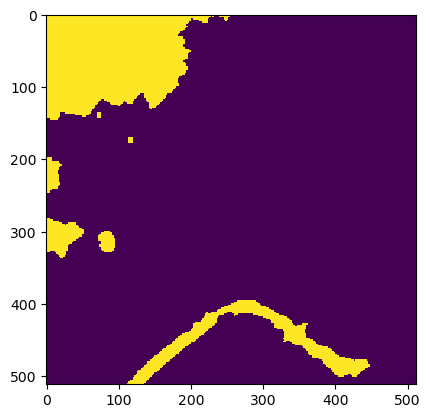

Wrote output/patches/mask/UV_S1_63-546870-4000-6284001-6000.tiff (512 x 512 pixels)


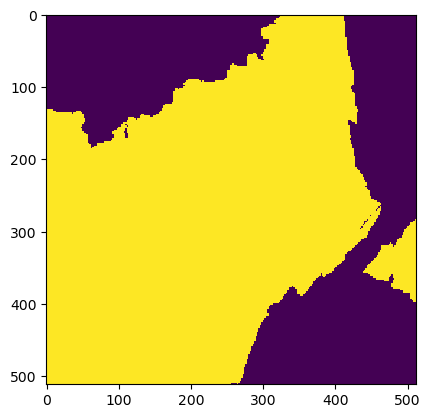

Wrote output/patches/mask/UV_S1_63-546870-4000-6284104-0000.tiff (512 x 512 pixels)


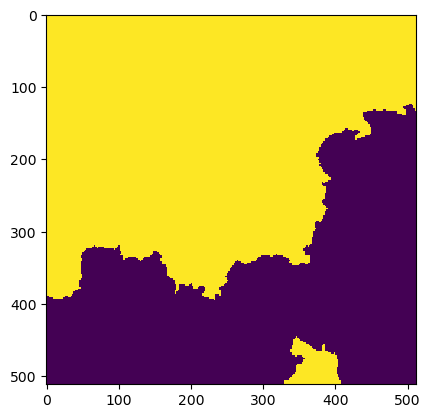

Wrote output/patches/mask/UV_S1_63-546870-4000-6284206-4000.tiff (512 x 512 pixels)


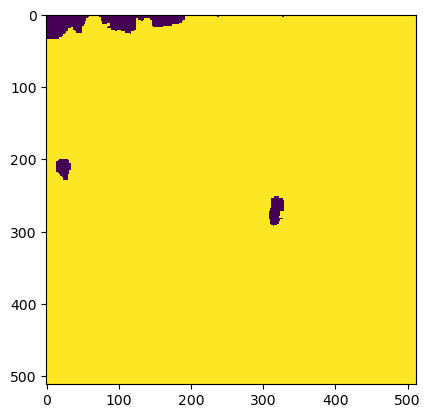

Wrote output/patches/mask/UV_S1_63-546870-4000-6284308-8000.tiff (512 x 512 pixels)


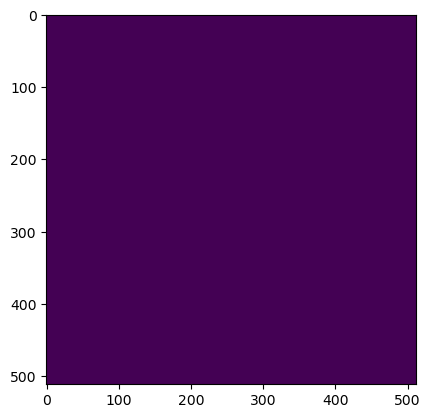

Wrote output/patches/mask/UV_S1_63-546972-8000-6283694-4000.tiff (512 x 512 pixels)


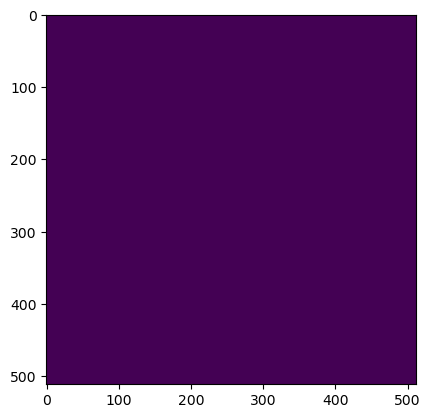

Wrote output/patches/mask/UV_S1_63-546972-8000-6283796-8000.tiff (512 x 512 pixels)


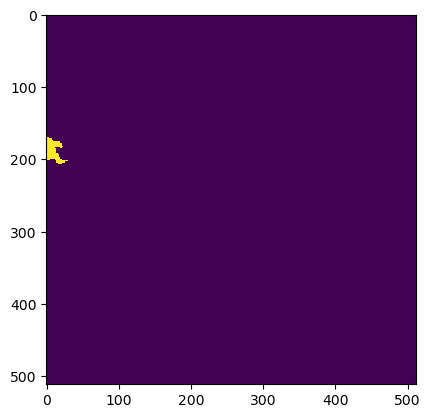

Wrote output/patches/mask/UV_S1_63-546972-8000-6283899-2000.tiff (512 x 512 pixels)


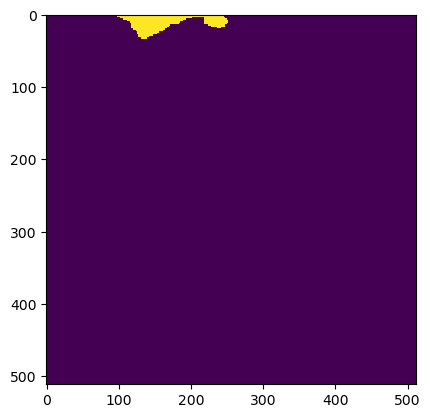

Wrote output/patches/mask/UV_S1_63-546972-8000-6284001-6000.tiff (512 x 512 pixels)


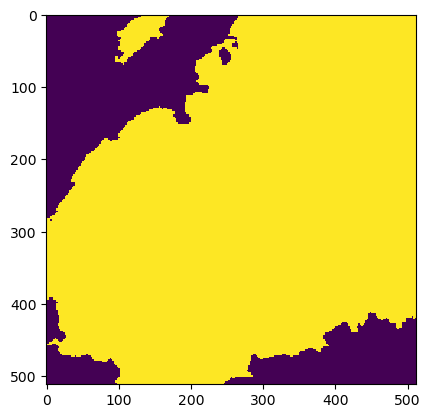

Wrote output/patches/mask/UV_S1_63-546972-8000-6284104-0000.tiff (512 x 512 pixels)


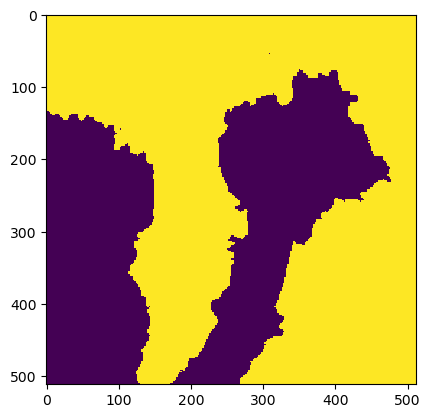

Wrote output/patches/mask/UV_S1_63-546972-8000-6284206-4000.tiff (512 x 512 pixels)


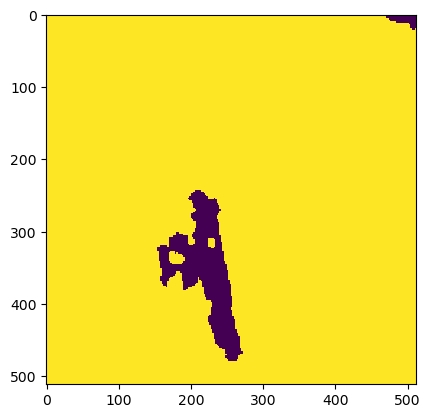

Wrote output/patches/mask/UV_S1_63-546972-8000-6284308-8000.tiff (512 x 512 pixels)


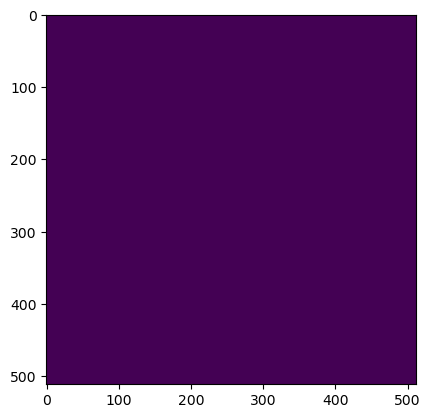

Wrote output/patches/mask/UV_S1_63-547075-2000-6283694-4000.tiff (512 x 512 pixels)


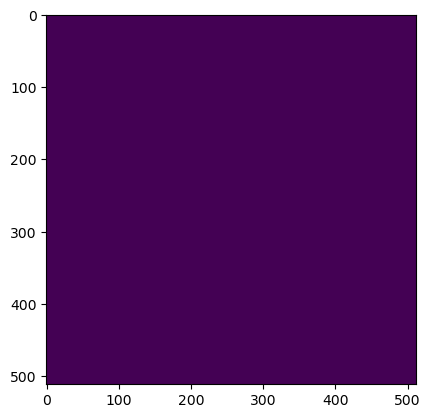

Wrote output/patches/mask/UV_S1_63-547075-2000-6283796-8000.tiff (512 x 512 pixels)


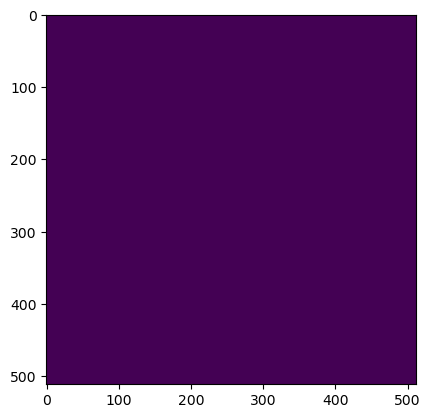

Wrote output/patches/mask/UV_S1_63-547075-2000-6283899-2000.tiff (512 x 512 pixels)


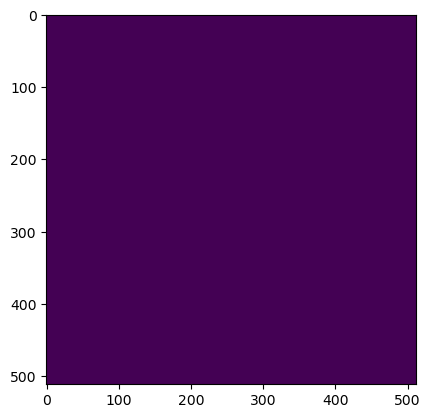

Wrote output/patches/mask/UV_S1_63-547075-2000-6284001-6000.tiff (512 x 512 pixels)


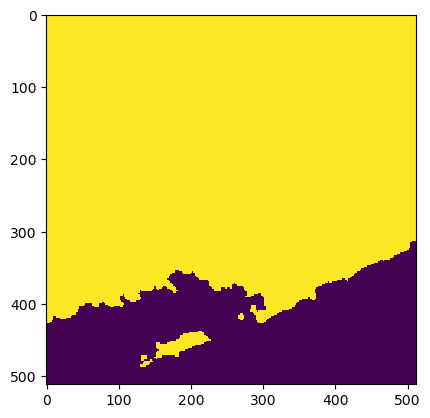

Wrote output/patches/mask/UV_S1_63-547075-2000-6284104-0000.tiff (512 x 512 pixels)


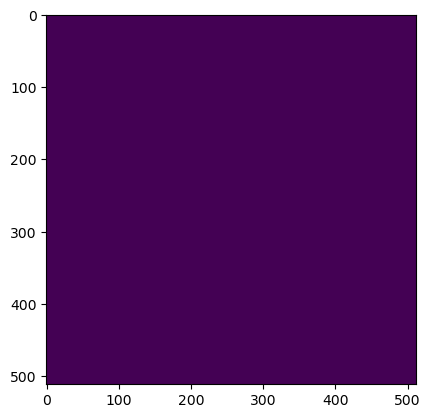

Wrote output/patches/mask/UV_S1_63-547075-2000-6284206-4000.tiff (512 x 512 pixels)


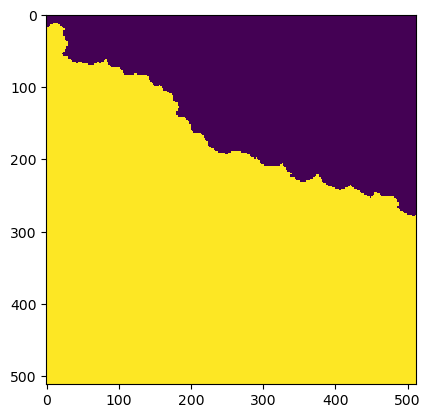

Wrote output/patches/mask/UV_S1_63-547075-2000-6284308-8000.tiff (512 x 512 pixels)
Zone UC_S1_64 Building Mask...


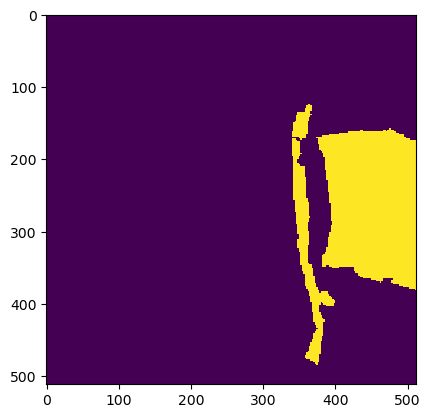

Wrote output/patches/mask/UC_S1_64-449744-0000-6284206-4000.tiff (512 x 512 pixels)


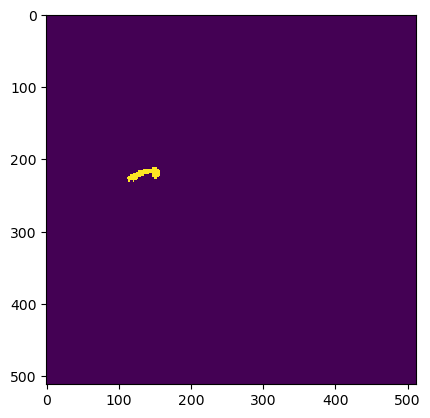

Wrote output/patches/mask/UC_S1_64-449744-0000-6284308-8000.tiff (512 x 512 pixels)


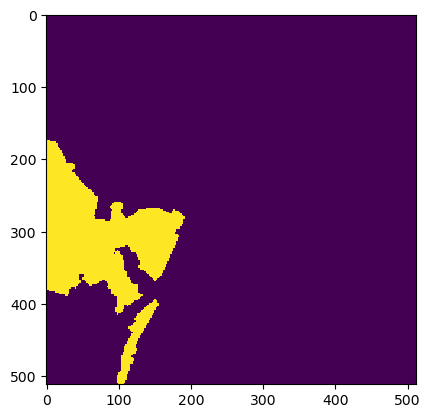

Wrote output/patches/mask/UC_S1_64-449846-4000-6284206-4000.tiff (512 x 512 pixels)


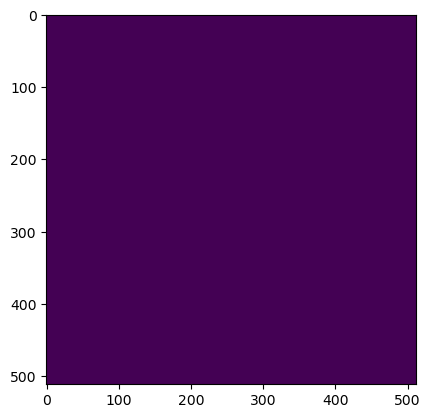

Wrote output/patches/mask/UC_S1_64-449846-4000-6284308-8000.tiff (512 x 512 pixels)
Zone UU_S1_65 Building Mask...


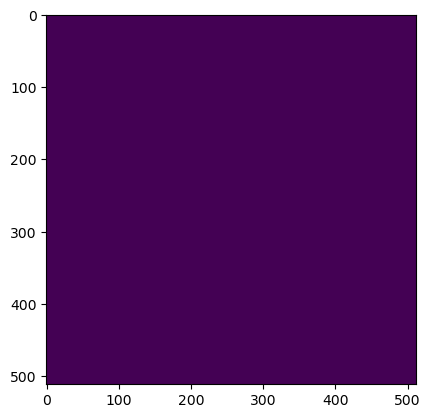

Wrote output/patches/mask/UU_S1_65-538320-0000-6284462-4000.tiff (512 x 512 pixels)


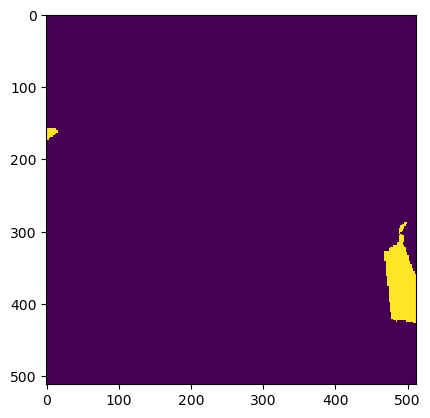

Wrote output/patches/mask/UU_S1_65-538320-0000-6284564-8000.tiff (512 x 512 pixels)


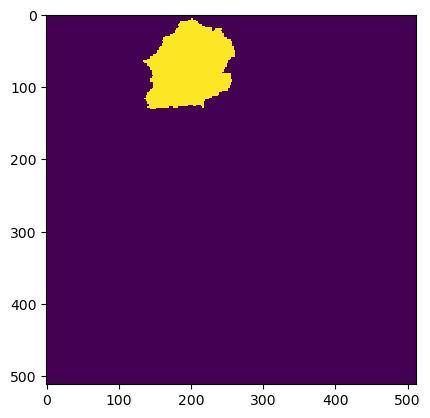

Wrote output/patches/mask/UU_S1_65-538422-4000-6284462-4000.tiff (512 x 512 pixels)


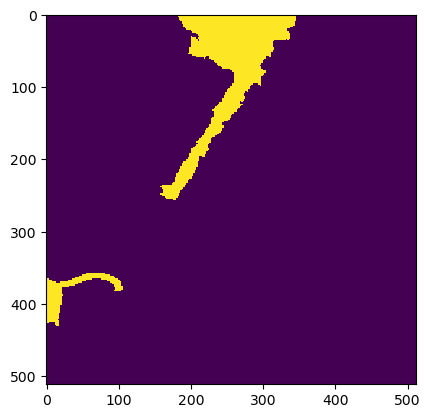

Wrote output/patches/mask/UU_S1_65-538422-4000-6284564-8000.tiff (512 x 512 pixels)


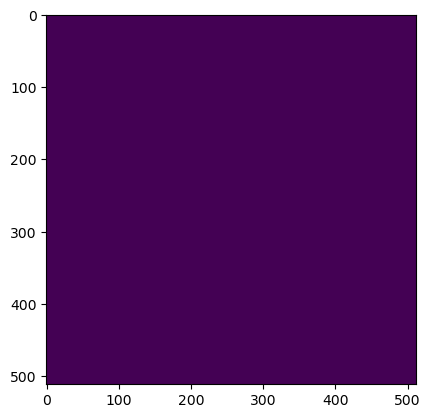

Wrote output/patches/mask/UU_S1_65-538524-8000-6284462-4000.tiff (512 x 512 pixels)


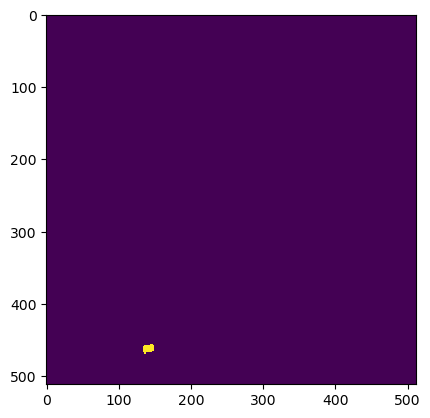

Wrote output/patches/mask/UU_S1_65-538524-8000-6284564-8000.tiff (512 x 512 pixels)


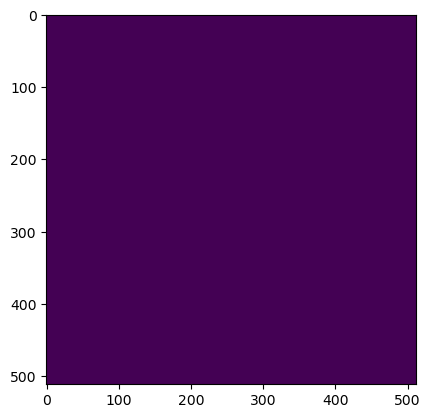

Wrote output/patches/mask/UU_S1_65-538627-2000-6284462-4000.tiff (512 x 512 pixels)


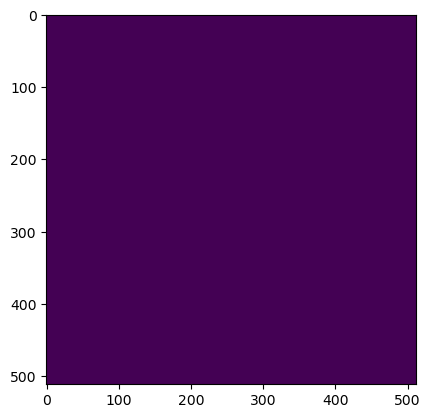

Wrote output/patches/mask/UU_S1_65-538627-2000-6284564-8000.tiff (512 x 512 pixels)


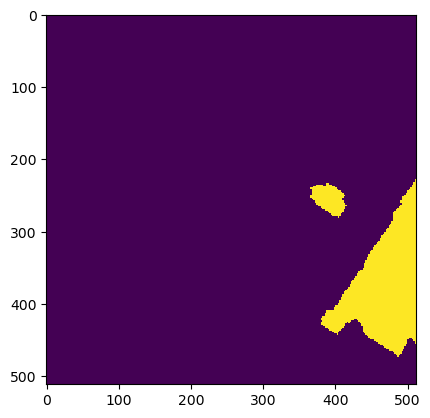

Wrote output/patches/mask/UU_S1_65-538729-6000-6284462-4000.tiff (512 x 512 pixels)


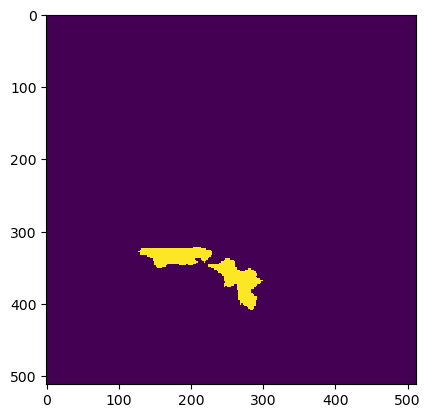

Wrote output/patches/mask/UU_S1_65-538729-6000-6284564-8000.tiff (512 x 512 pixels)


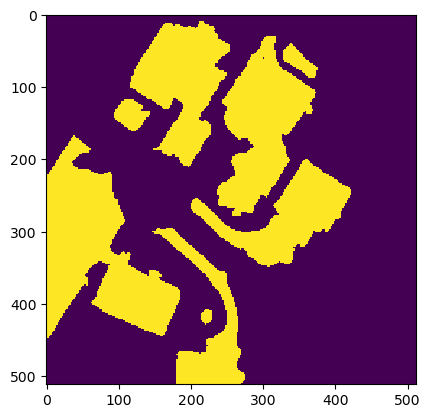

Wrote output/patches/mask/UU_S1_65-538832-0000-6284462-4000.tiff (512 x 512 pixels)


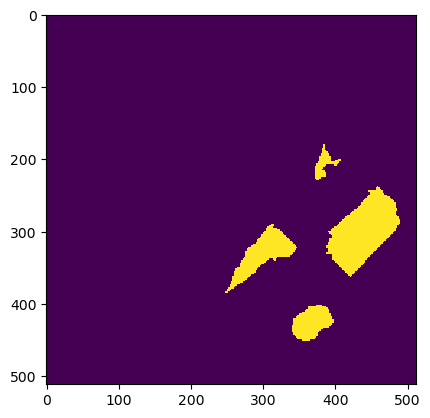

Wrote output/patches/mask/UU_S1_65-538832-0000-6284564-8000.tiff (512 x 512 pixels)


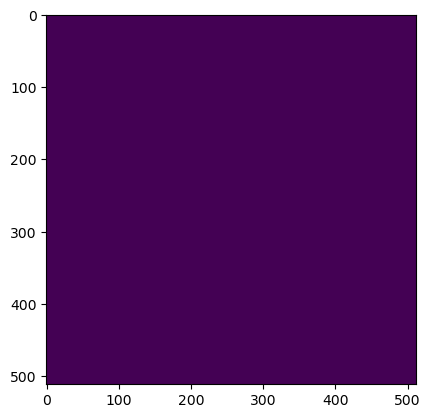

Wrote output/patches/mask/UU_S1_65-538934-4000-6284462-4000.tiff (512 x 512 pixels)


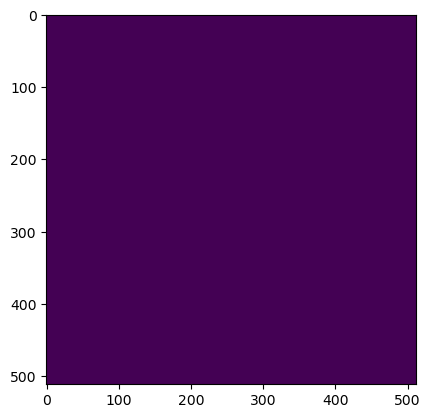

Wrote output/patches/mask/UU_S1_65-538934-4000-6284564-8000.tiff (512 x 512 pixels)
Zone UU_S1_66 Building Mask...


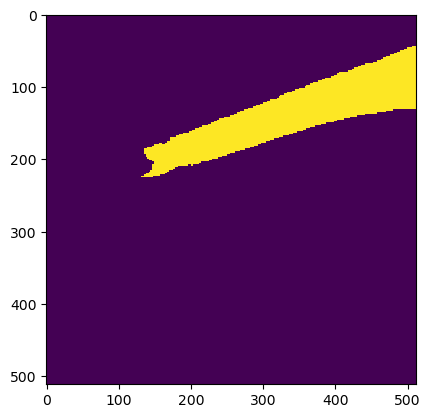

Wrote output/patches/mask/UU_S1_66-523984-0000-6284462-4000.tiff (512 x 512 pixels)


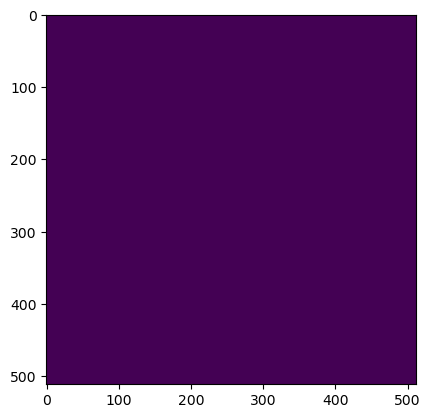

Wrote output/patches/mask/UU_S1_66-523984-0000-6284564-8000.tiff (512 x 512 pixels)


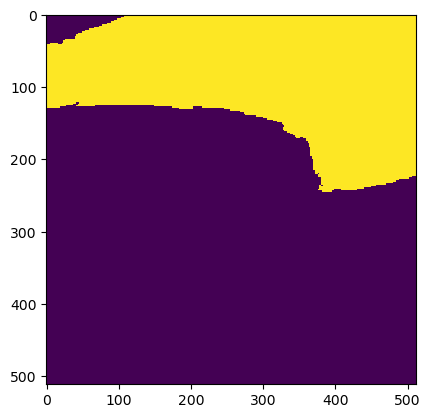

Wrote output/patches/mask/UU_S1_66-524086-4000-6284462-4000.tiff (512 x 512 pixels)


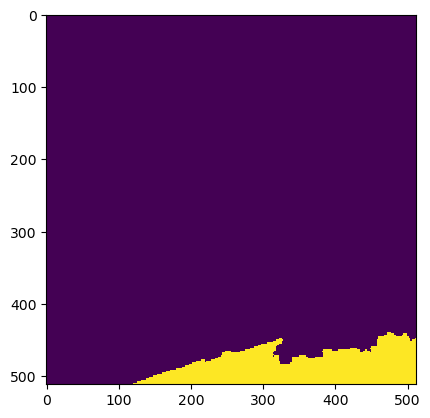

Wrote output/patches/mask/UU_S1_66-524086-4000-6284564-8000.tiff (512 x 512 pixels)


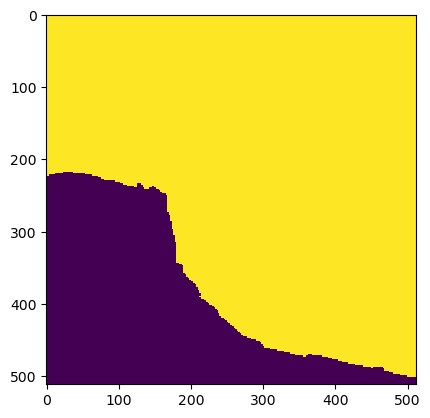

Wrote output/patches/mask/UU_S1_66-524188-8000-6284462-4000.tiff (512 x 512 pixels)


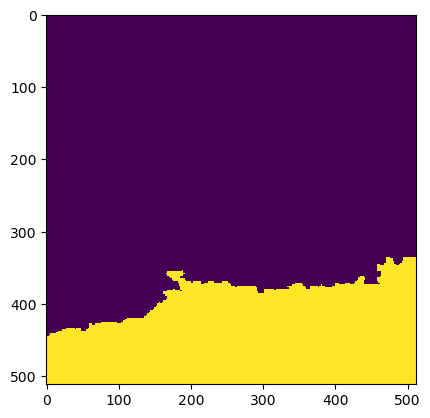

Wrote output/patches/mask/UU_S1_66-524188-8000-6284564-8000.tiff (512 x 512 pixels)


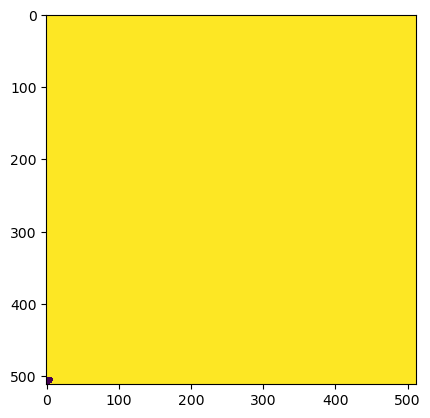

Wrote output/patches/mask/UU_S1_66-524291-2000-6284462-4000.tiff (512 x 512 pixels)


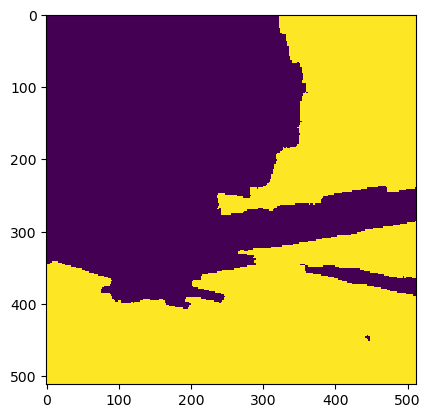

Wrote output/patches/mask/UU_S1_66-524291-2000-6284564-8000.tiff (512 x 512 pixels)


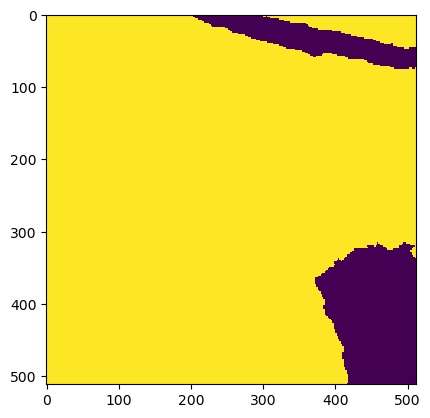

Wrote output/patches/mask/UU_S1_66-524393-6000-6284462-4000.tiff (512 x 512 pixels)


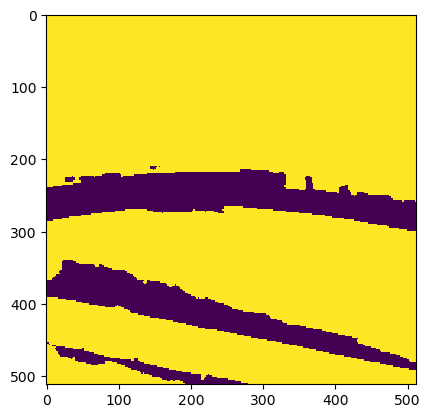

Wrote output/patches/mask/UU_S1_66-524393-6000-6284564-8000.tiff (512 x 512 pixels)


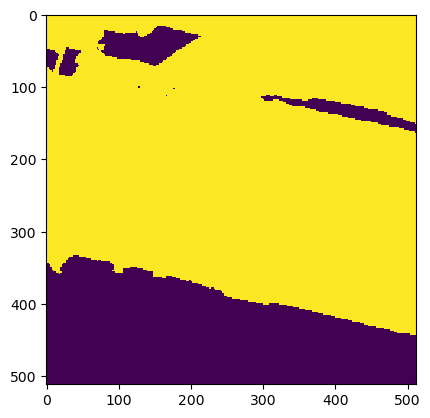

Wrote output/patches/mask/UU_S1_66-524496-0000-6284462-4000.tiff (512 x 512 pixels)


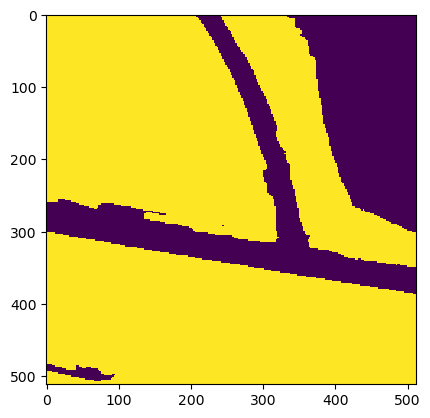

Wrote output/patches/mask/UU_S1_66-524496-0000-6284564-8000.tiff (512 x 512 pixels)


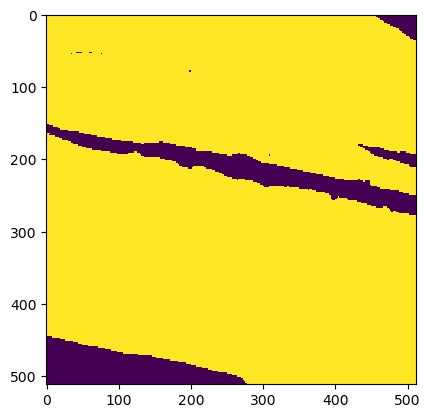

Wrote output/patches/mask/UU_S1_66-524598-4000-6284462-4000.tiff (512 x 512 pixels)


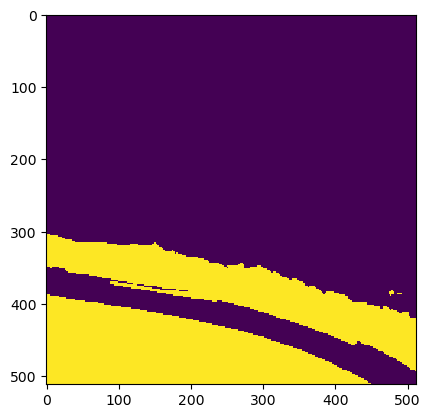

Wrote output/patches/mask/UU_S1_66-524598-4000-6284564-8000.tiff (512 x 512 pixels)
Zone CC_S1_67 Building Mask...


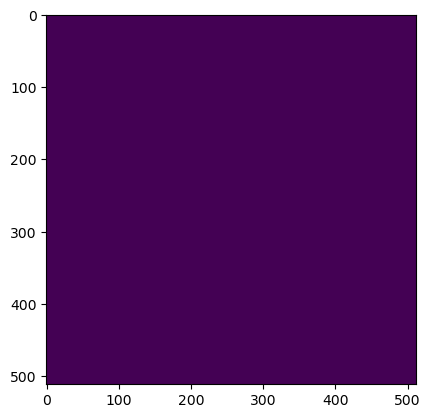

Wrote output/patches/mask/CC_S1_67-446416-0000-6284974-4000.tiff (512 x 512 pixels)


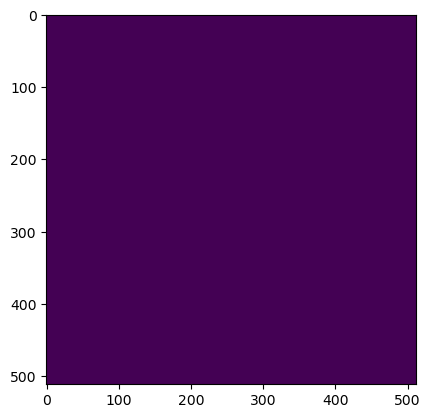

Wrote output/patches/mask/CC_S1_67-446416-0000-6285076-8000.tiff (512 x 512 pixels)


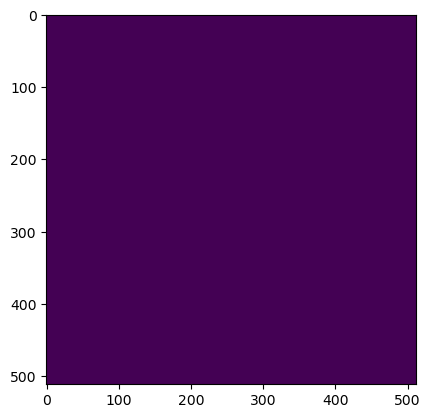

Wrote output/patches/mask/CC_S1_67-446416-0000-6285179-2000.tiff (512 x 512 pixels)


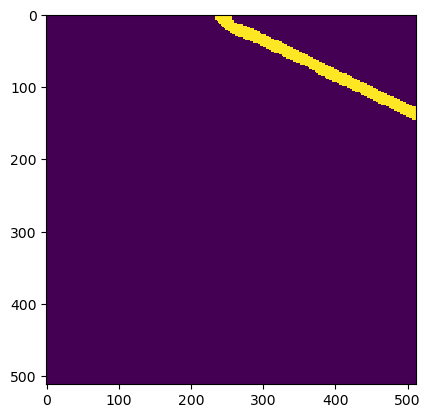

Wrote output/patches/mask/CC_S1_67-446416-0000-6285281-6000.tiff (512 x 512 pixels)


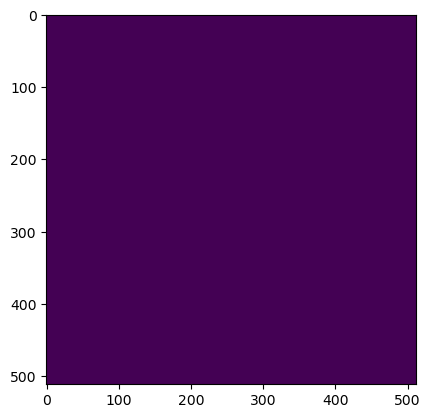

Wrote output/patches/mask/CC_S1_67-446518-4000-6284974-4000.tiff (512 x 512 pixels)


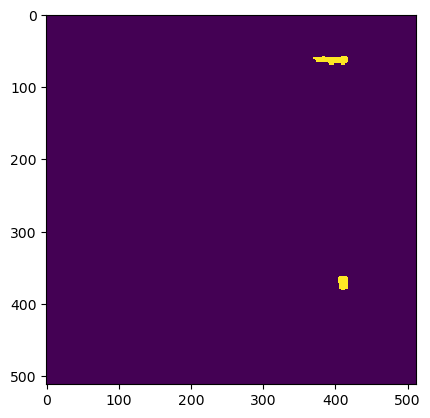

Wrote output/patches/mask/CC_S1_67-446518-4000-6285076-8000.tiff (512 x 512 pixels)


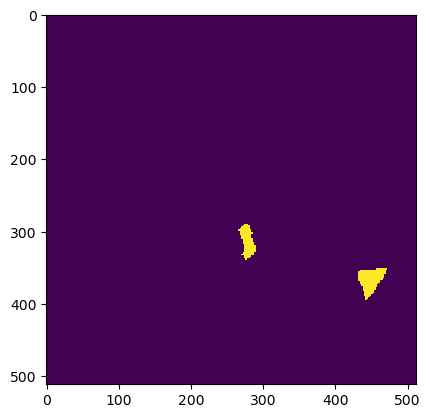

Wrote output/patches/mask/CC_S1_67-446518-4000-6285179-2000.tiff (512 x 512 pixels)


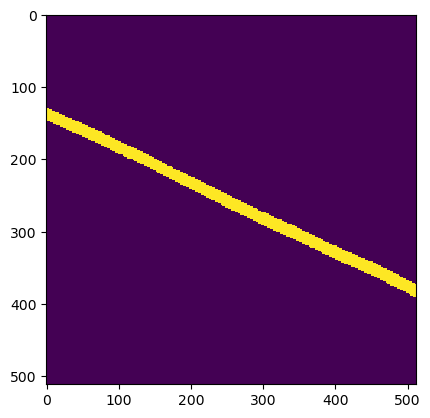

Wrote output/patches/mask/CC_S1_67-446518-4000-6285281-6000.tiff (512 x 512 pixels)
Zone UC_S1_68 Building Mask...


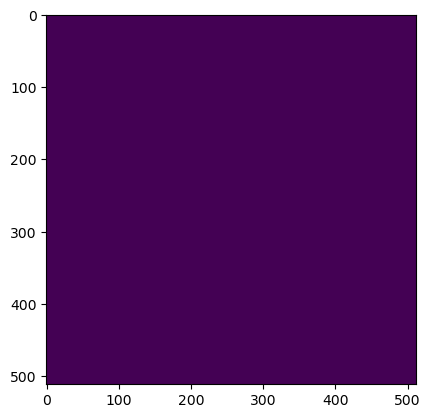

Wrote output/patches/mask/UC_S1_68-448976-0000-6285230-4000.tiff (512 x 512 pixels)


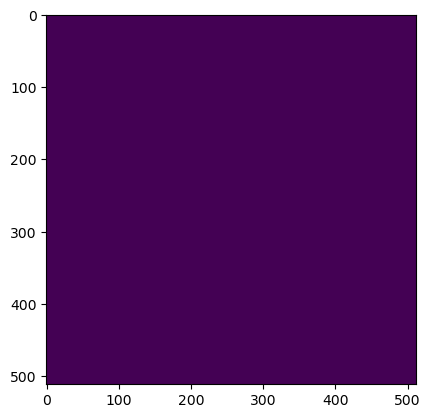

Wrote output/patches/mask/UC_S1_68-448976-0000-6285332-8000.tiff (512 x 512 pixels)


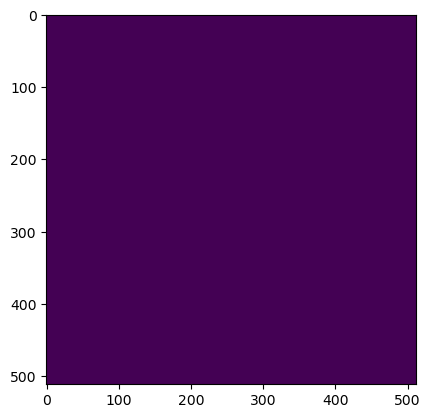

Wrote output/patches/mask/UC_S1_68-448976-0000-6285435-2000.tiff (512 x 512 pixels)


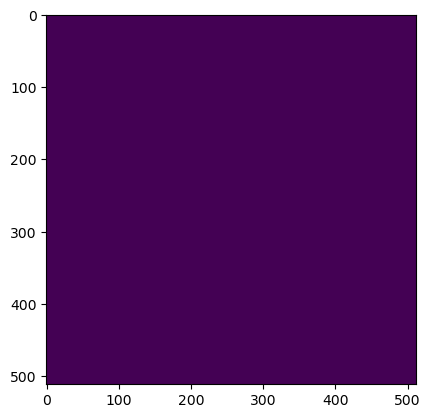

Wrote output/patches/mask/UC_S1_68-448976-0000-6285537-6000.tiff (512 x 512 pixels)


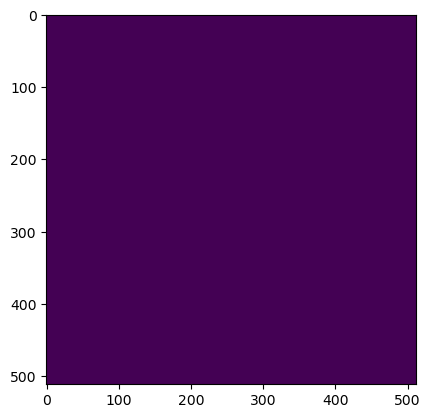

Wrote output/patches/mask/UC_S1_68-449078-4000-6285230-4000.tiff (512 x 512 pixels)


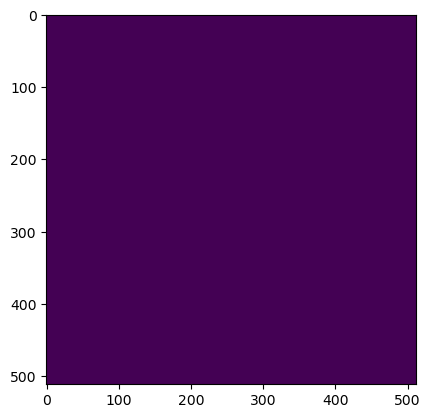

Wrote output/patches/mask/UC_S1_68-449078-4000-6285332-8000.tiff (512 x 512 pixels)


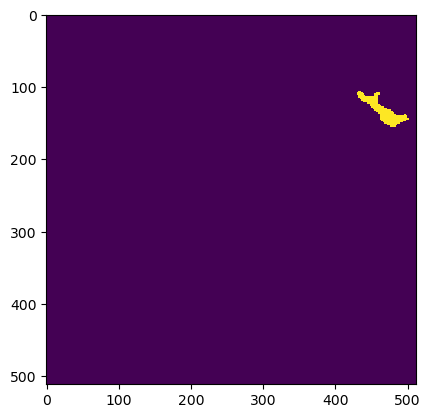

Wrote output/patches/mask/UC_S1_68-449078-4000-6285435-2000.tiff (512 x 512 pixels)


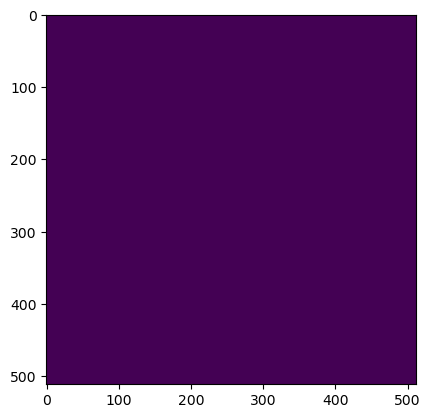

Wrote output/patches/mask/UC_S1_68-449078-4000-6285537-6000.tiff (512 x 512 pixels)


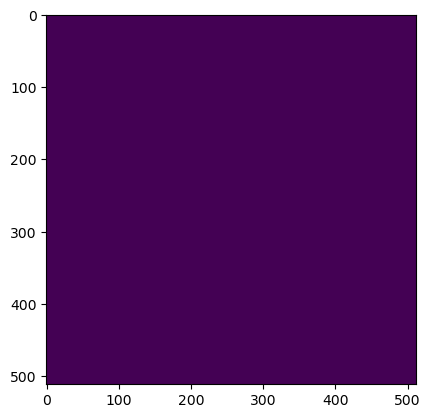

Wrote output/patches/mask/UC_S1_68-449180-8000-6285230-4000.tiff (512 x 512 pixels)


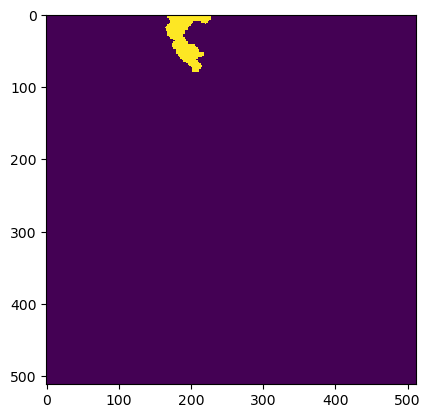

Wrote output/patches/mask/UC_S1_68-449180-8000-6285332-8000.tiff (512 x 512 pixels)


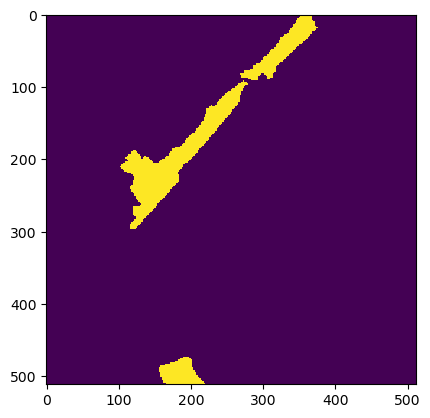

Wrote output/patches/mask/UC_S1_68-449180-8000-6285435-2000.tiff (512 x 512 pixels)


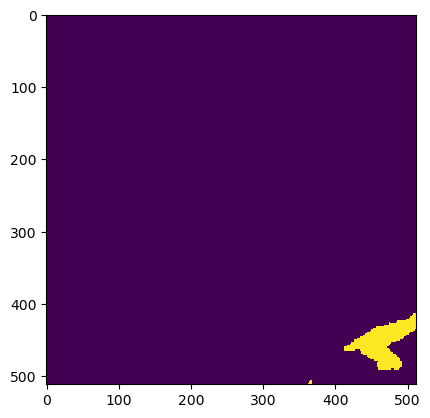

Wrote output/patches/mask/UC_S1_68-449180-8000-6285537-6000.tiff (512 x 512 pixels)


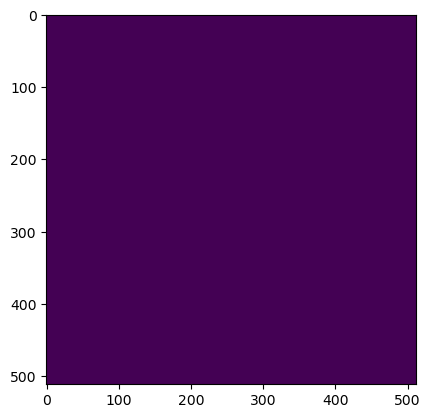

Wrote output/patches/mask/UC_S1_68-449283-2000-6285230-4000.tiff (512 x 512 pixels)


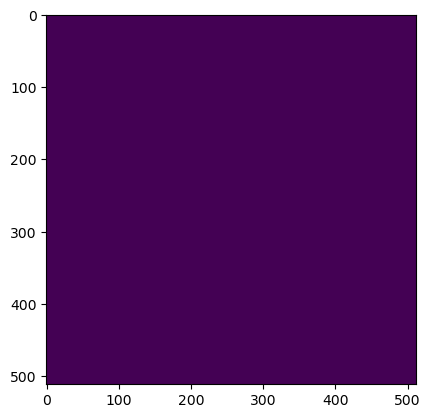

Wrote output/patches/mask/UC_S1_68-449283-2000-6285332-8000.tiff (512 x 512 pixels)


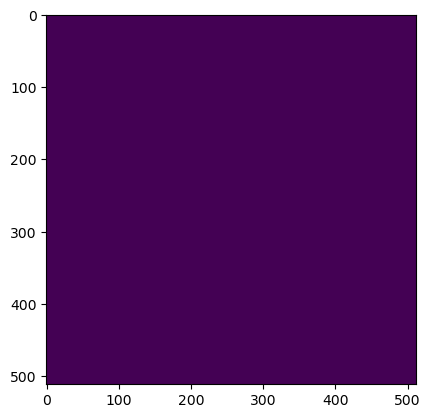

Wrote output/patches/mask/UC_S1_68-449283-2000-6285435-2000.tiff (512 x 512 pixels)


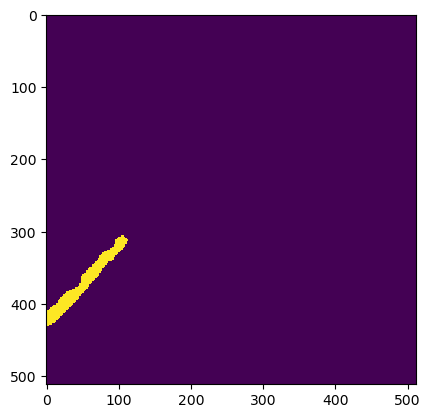

Wrote output/patches/mask/UC_S1_68-449283-2000-6285537-6000.tiff (512 x 512 pixels)
Zone UU_S1_69 Building Mask...


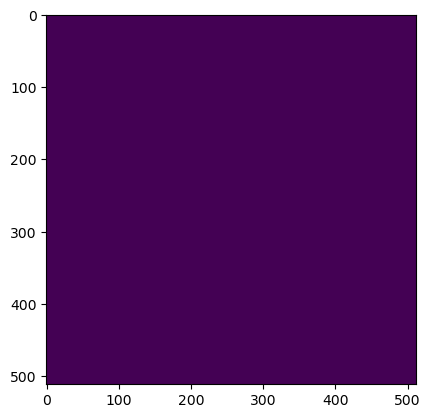

Wrote output/patches/mask/UU_S1_69-519376-0000-6285742-4000.tiff (512 x 512 pixels)


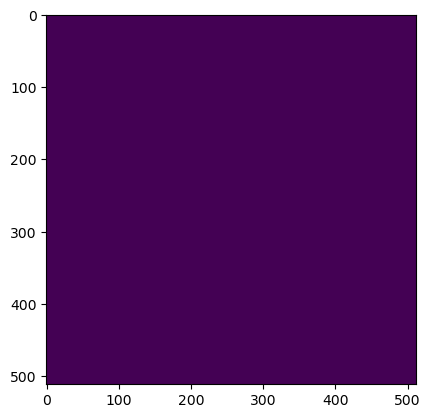

Wrote output/patches/mask/UU_S1_69-519376-0000-6285844-8000.tiff (512 x 512 pixels)


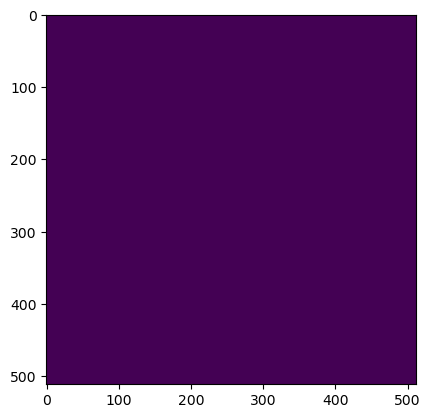

Wrote output/patches/mask/UU_S1_69-519376-0000-6285947-2000.tiff (512 x 512 pixels)


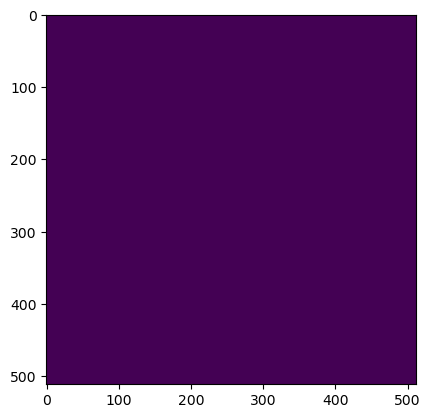

Wrote output/patches/mask/UU_S1_69-519376-0000-6286049-6000.tiff (512 x 512 pixels)


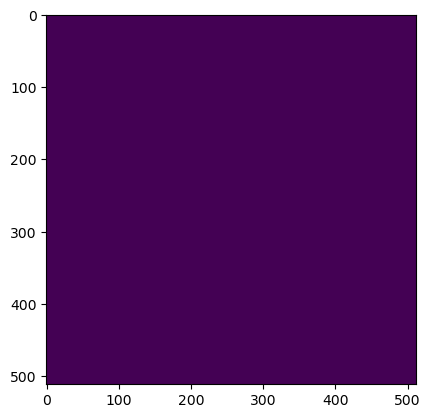

Wrote output/patches/mask/UU_S1_69-519376-0000-6286152-0000.tiff (512 x 512 pixels)


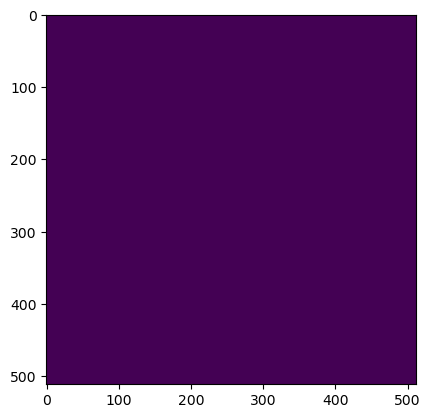

Wrote output/patches/mask/UU_S1_69-519376-0000-6286254-4000.tiff (512 x 512 pixels)


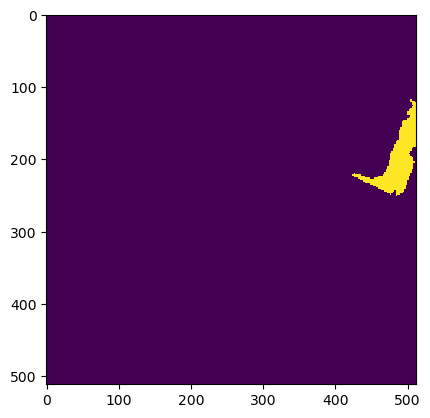

Wrote output/patches/mask/UU_S1_69-519376-0000-6286356-8000.tiff (512 x 512 pixels)


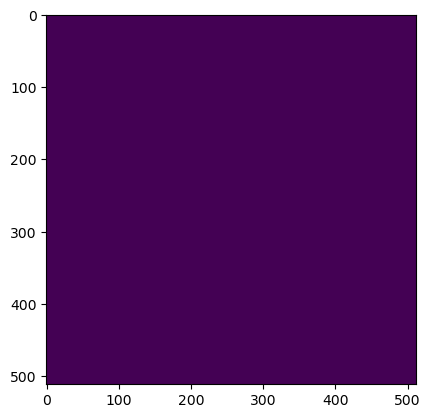

Wrote output/patches/mask/UU_S1_69-519376-0000-6286459-2000.tiff (512 x 512 pixels)


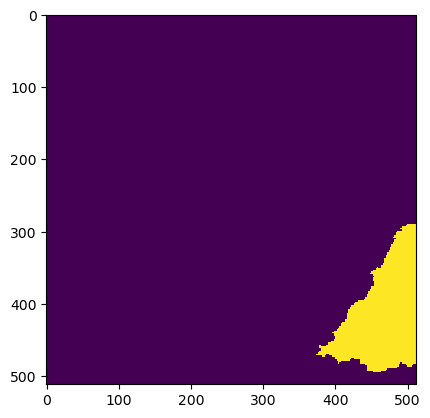

Wrote output/patches/mask/UU_S1_69-519376-0000-6286561-6000.tiff (512 x 512 pixels)


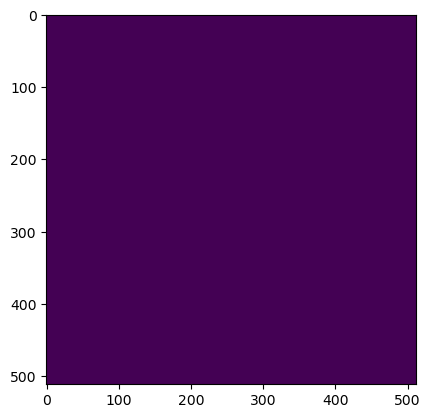

Wrote output/patches/mask/UU_S1_69-519478-4000-6285742-4000.tiff (512 x 512 pixels)


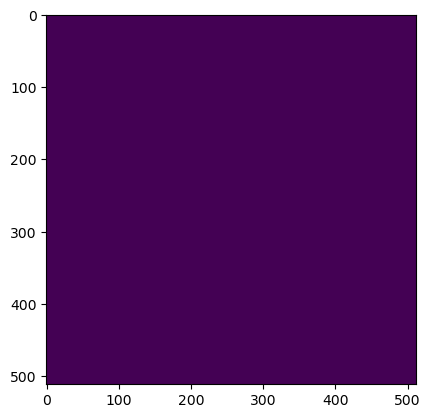

Wrote output/patches/mask/UU_S1_69-519478-4000-6285844-8000.tiff (512 x 512 pixels)


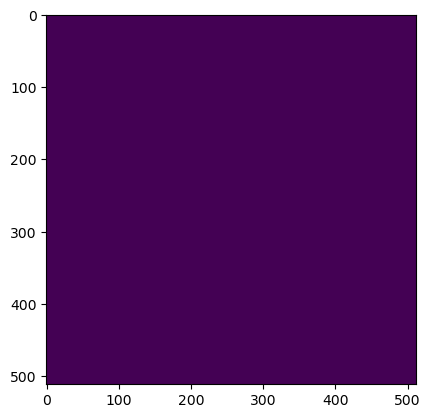

Wrote output/patches/mask/UU_S1_69-519478-4000-6285947-2000.tiff (512 x 512 pixels)


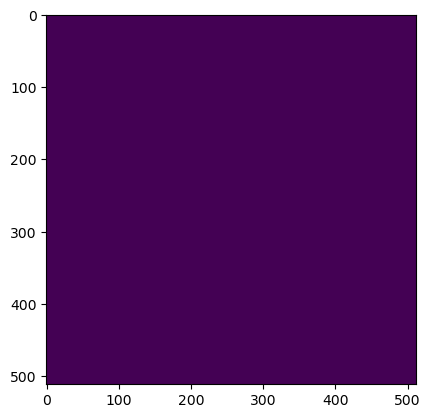

Wrote output/patches/mask/UU_S1_69-519478-4000-6286049-6000.tiff (512 x 512 pixels)


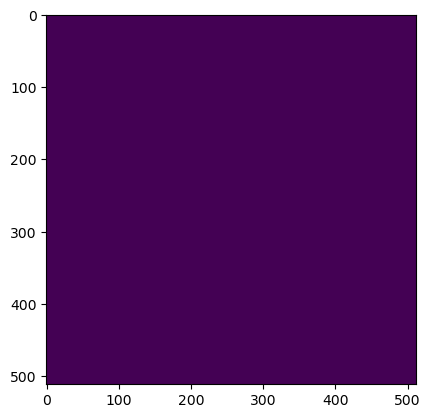

Wrote output/patches/mask/UU_S1_69-519478-4000-6286152-0000.tiff (512 x 512 pixels)


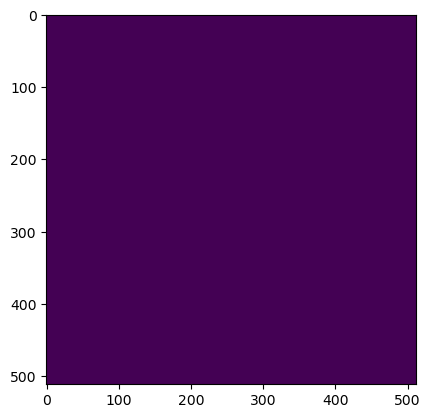

Wrote output/patches/mask/UU_S1_69-519478-4000-6286254-4000.tiff (512 x 512 pixels)


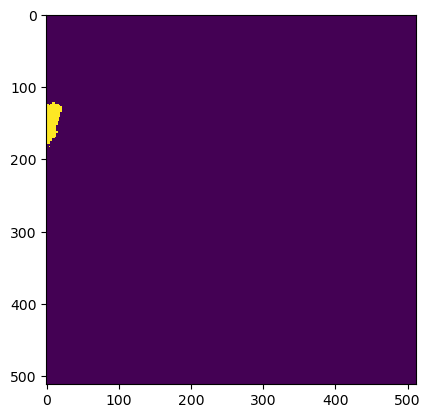

Wrote output/patches/mask/UU_S1_69-519478-4000-6286356-8000.tiff (512 x 512 pixels)


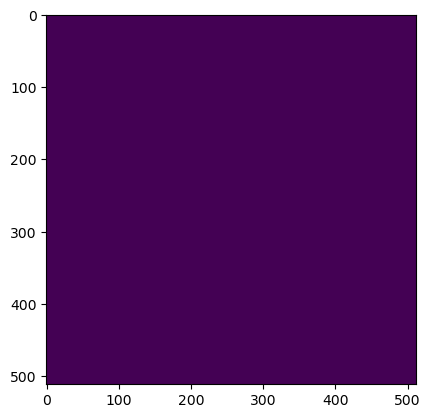

Wrote output/patches/mask/UU_S1_69-519478-4000-6286459-2000.tiff (512 x 512 pixels)


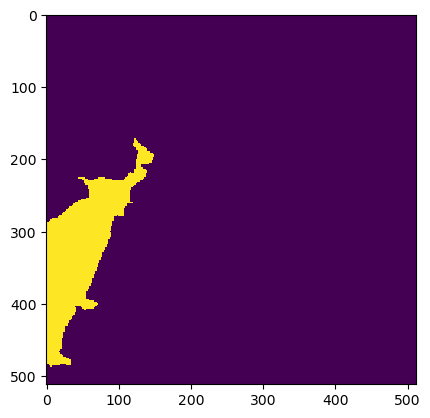

Wrote output/patches/mask/UU_S1_69-519478-4000-6286561-6000.tiff (512 x 512 pixels)


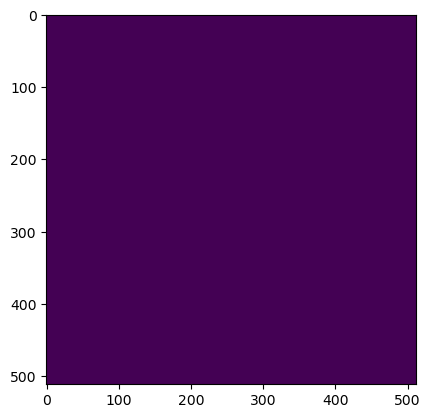

Wrote output/patches/mask/UU_S1_69-519580-8000-6285742-4000.tiff (512 x 512 pixels)


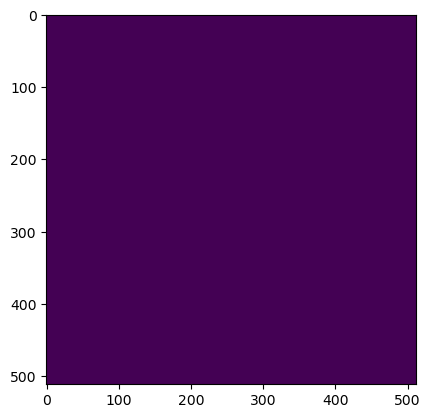

Wrote output/patches/mask/UU_S1_69-519580-8000-6285844-8000.tiff (512 x 512 pixels)


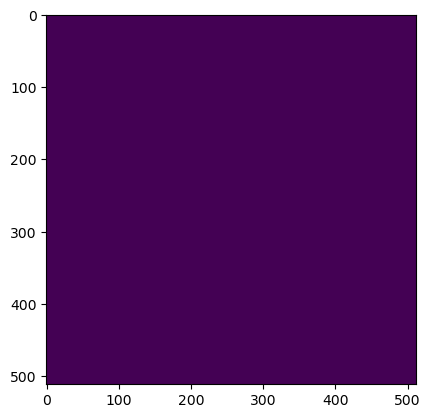

Wrote output/patches/mask/UU_S1_69-519580-8000-6285947-2000.tiff (512 x 512 pixels)


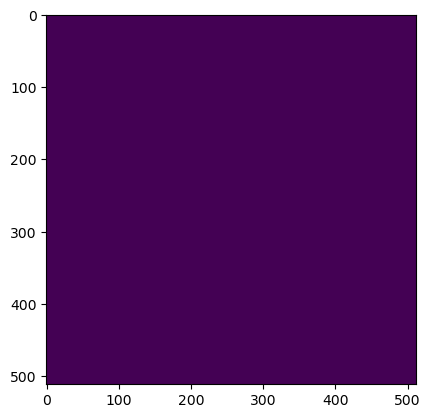

Wrote output/patches/mask/UU_S1_69-519580-8000-6286049-6000.tiff (512 x 512 pixels)


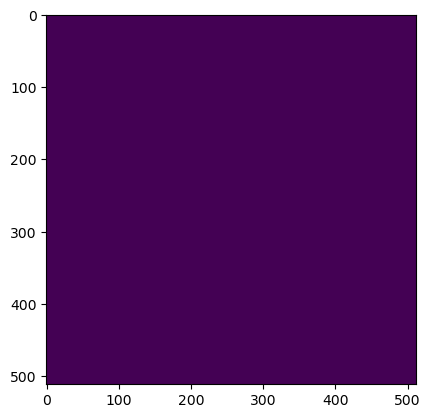

Wrote output/patches/mask/UU_S1_69-519580-8000-6286152-0000.tiff (512 x 512 pixels)


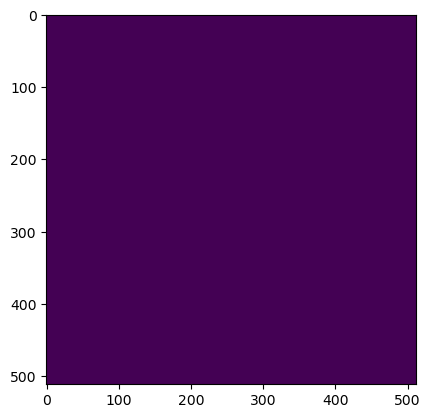

Wrote output/patches/mask/UU_S1_69-519580-8000-6286254-4000.tiff (512 x 512 pixels)


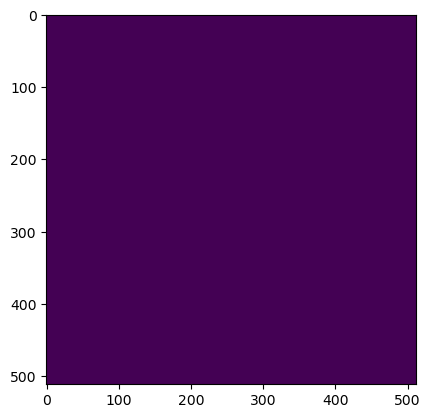

Wrote output/patches/mask/UU_S1_69-519580-8000-6286356-8000.tiff (512 x 512 pixels)


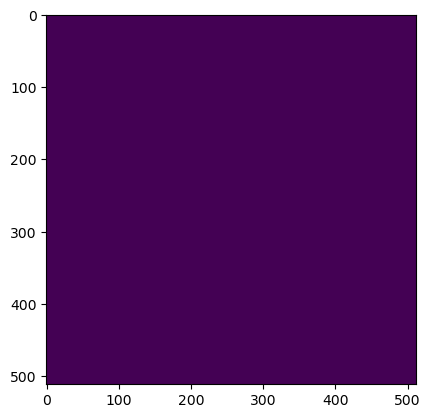

Wrote output/patches/mask/UU_S1_69-519580-8000-6286459-2000.tiff (512 x 512 pixels)


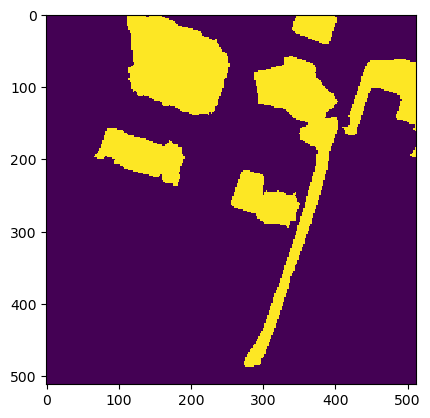

Wrote output/patches/mask/UU_S1_69-519580-8000-6286561-6000.tiff (512 x 512 pixels)


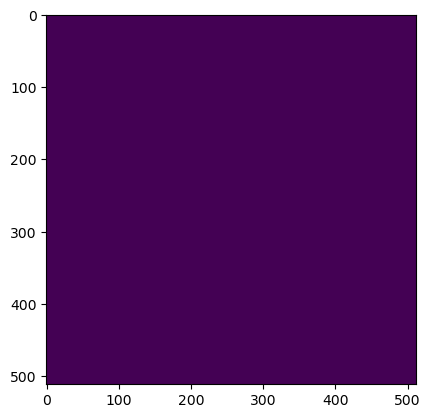

Wrote output/patches/mask/UU_S1_69-519683-2000-6285742-4000.tiff (512 x 512 pixels)


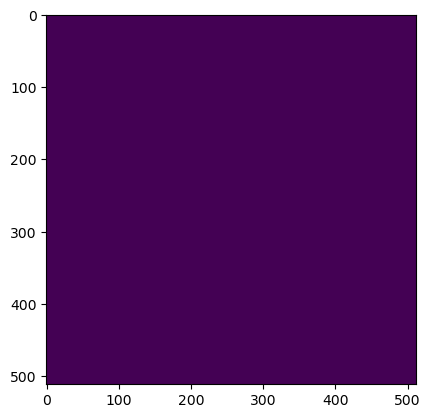

Wrote output/patches/mask/UU_S1_69-519683-2000-6285844-8000.tiff (512 x 512 pixels)


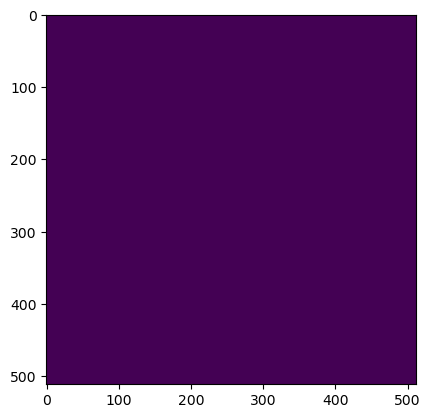

Wrote output/patches/mask/UU_S1_69-519683-2000-6285947-2000.tiff (512 x 512 pixels)


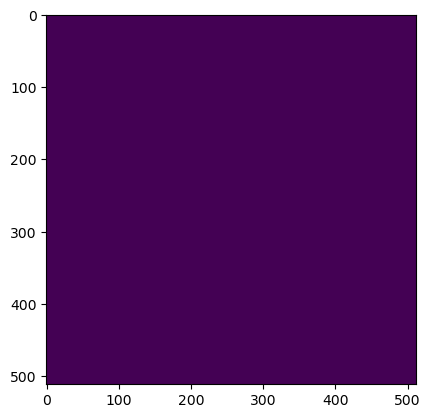

Wrote output/patches/mask/UU_S1_69-519683-2000-6286049-6000.tiff (512 x 512 pixels)


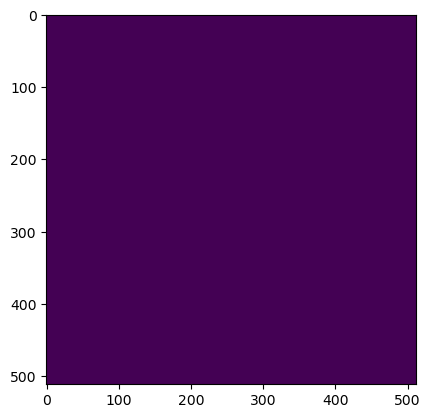

Wrote output/patches/mask/UU_S1_69-519683-2000-6286152-0000.tiff (512 x 512 pixels)


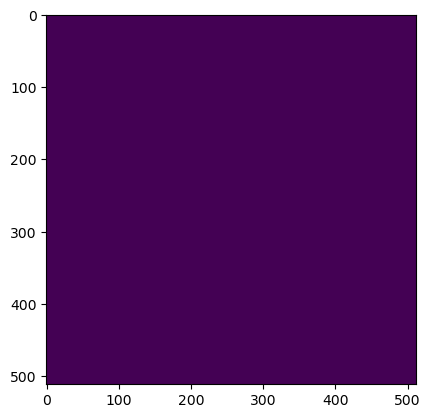

Wrote output/patches/mask/UU_S1_69-519683-2000-6286254-4000.tiff (512 x 512 pixels)


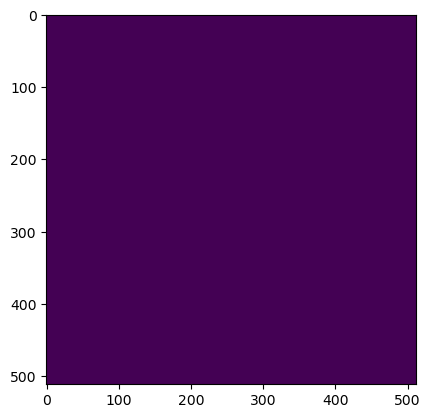

Wrote output/patches/mask/UU_S1_69-519683-2000-6286356-8000.tiff (512 x 512 pixels)


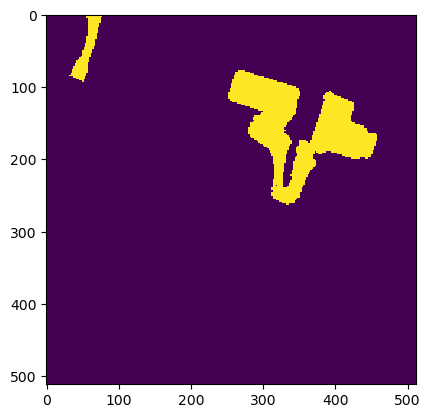

Wrote output/patches/mask/UU_S1_69-519683-2000-6286459-2000.tiff (512 x 512 pixels)


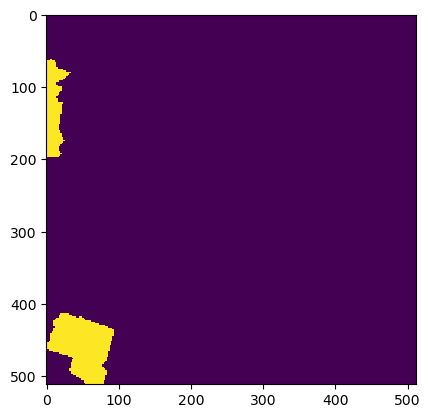

Wrote output/patches/mask/UU_S1_69-519683-2000-6286561-6000.tiff (512 x 512 pixels)


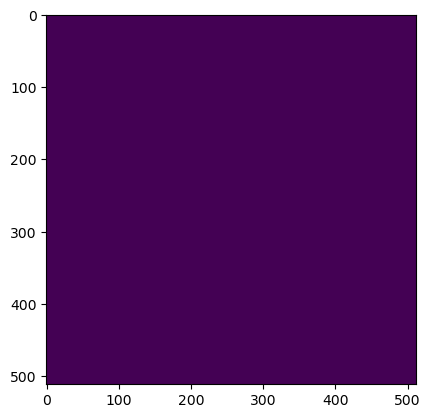

Wrote output/patches/mask/UU_S1_69-519785-6000-6285742-4000.tiff (512 x 512 pixels)


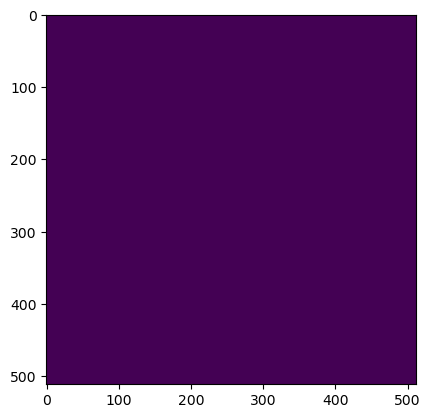

Wrote output/patches/mask/UU_S1_69-519785-6000-6285844-8000.tiff (512 x 512 pixels)


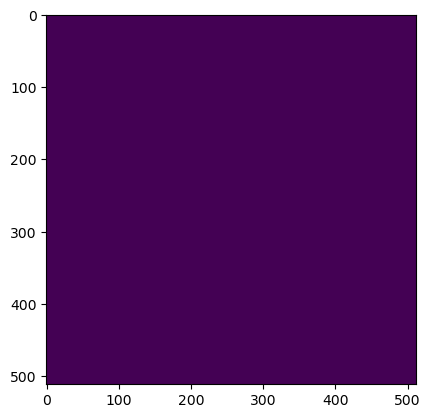

Wrote output/patches/mask/UU_S1_69-519785-6000-6285947-2000.tiff (512 x 512 pixels)


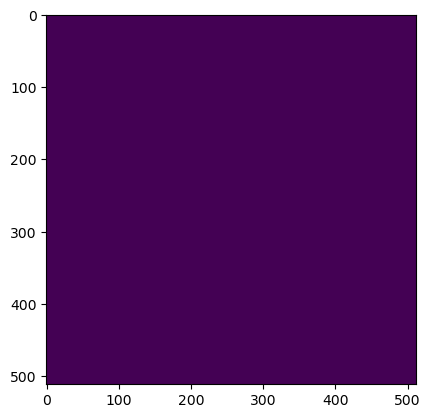

Wrote output/patches/mask/UU_S1_69-519785-6000-6286049-6000.tiff (512 x 512 pixels)


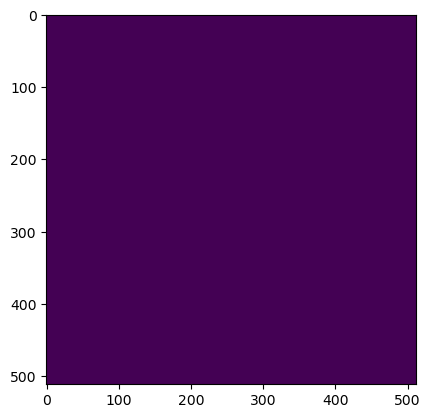

Wrote output/patches/mask/UU_S1_69-519785-6000-6286152-0000.tiff (512 x 512 pixels)


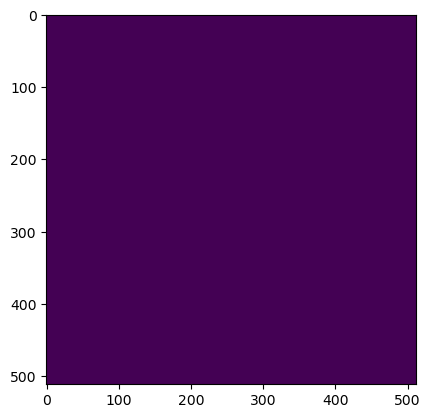

Wrote output/patches/mask/UU_S1_69-519785-6000-6286254-4000.tiff (512 x 512 pixels)


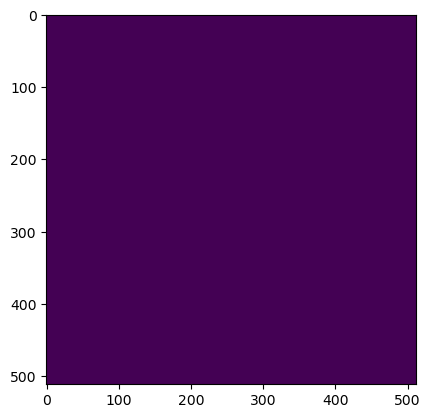

Wrote output/patches/mask/UU_S1_69-519785-6000-6286356-8000.tiff (512 x 512 pixels)


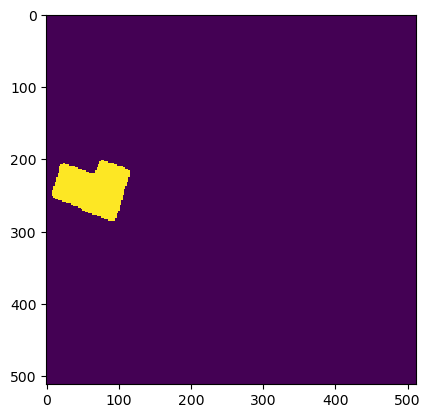

Wrote output/patches/mask/UU_S1_69-519785-6000-6286459-2000.tiff (512 x 512 pixels)


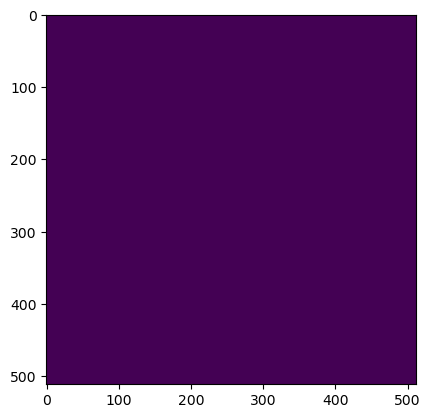

Wrote output/patches/mask/UU_S1_69-519785-6000-6286561-6000.tiff (512 x 512 pixels)


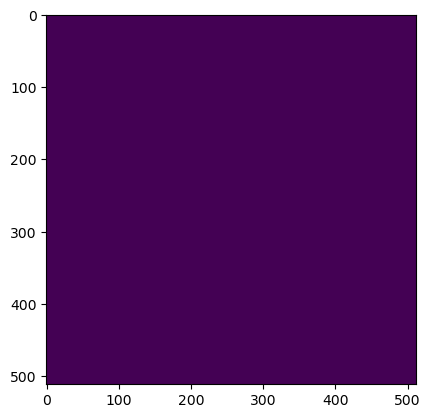

Wrote output/patches/mask/UU_S1_69-519888-0000-6285742-4000.tiff (512 x 512 pixels)


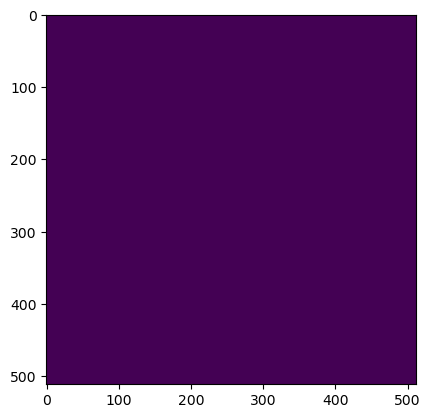

Wrote output/patches/mask/UU_S1_69-519888-0000-6285844-8000.tiff (512 x 512 pixels)


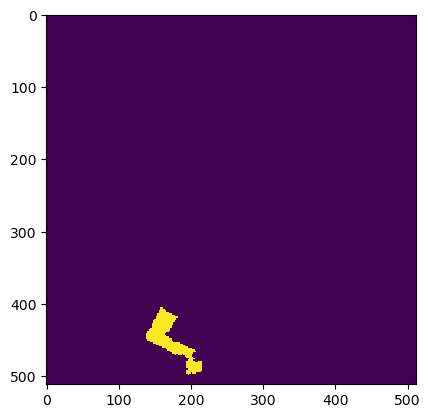

Wrote output/patches/mask/UU_S1_69-519888-0000-6285947-2000.tiff (512 x 512 pixels)


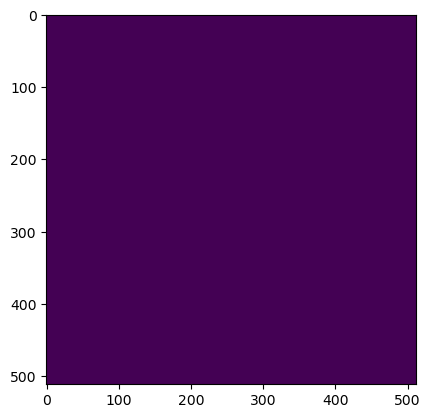

Wrote output/patches/mask/UU_S1_69-519888-0000-6286049-6000.tiff (512 x 512 pixels)


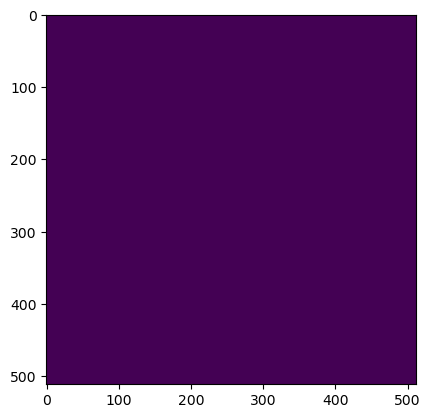

Wrote output/patches/mask/UU_S1_69-519888-0000-6286152-0000.tiff (512 x 512 pixels)


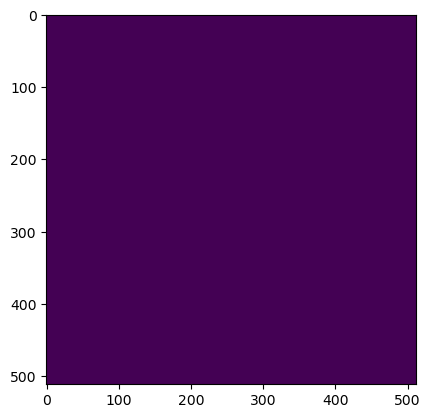

Wrote output/patches/mask/UU_S1_69-519888-0000-6286254-4000.tiff (512 x 512 pixels)


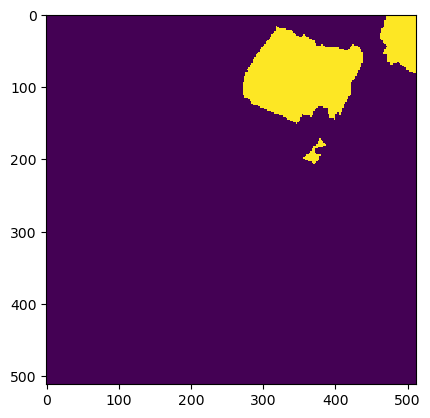

Wrote output/patches/mask/UU_S1_69-519888-0000-6286356-8000.tiff (512 x 512 pixels)


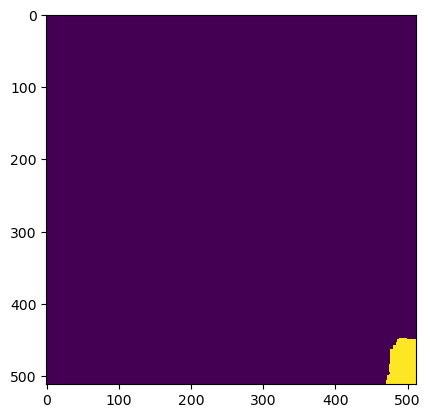

Wrote output/patches/mask/UU_S1_69-519888-0000-6286459-2000.tiff (512 x 512 pixels)


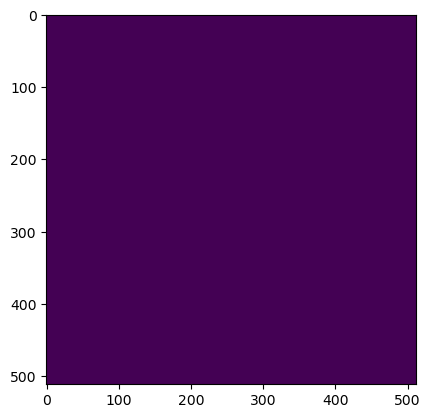

Wrote output/patches/mask/UU_S1_69-519888-0000-6286561-6000.tiff (512 x 512 pixels)


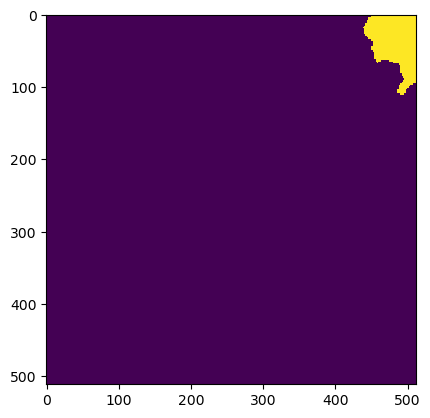

Wrote output/patches/mask/UU_S1_69-519990-4000-6285742-4000.tiff (512 x 512 pixels)


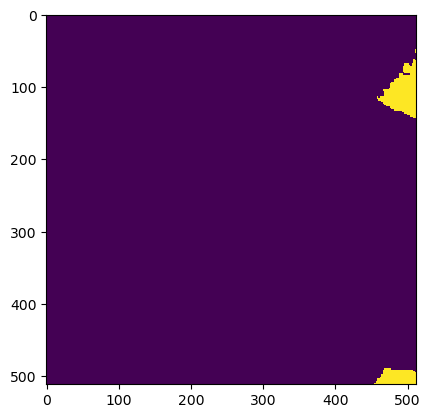

Wrote output/patches/mask/UU_S1_69-519990-4000-6285844-8000.tiff (512 x 512 pixels)


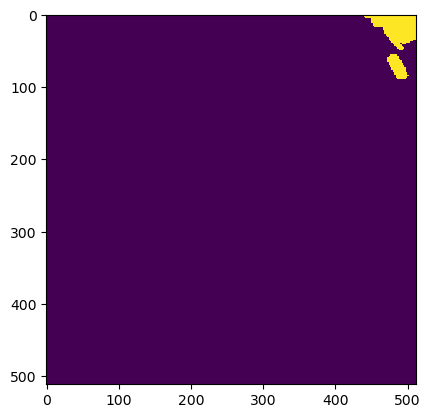

Wrote output/patches/mask/UU_S1_69-519990-4000-6285947-2000.tiff (512 x 512 pixels)


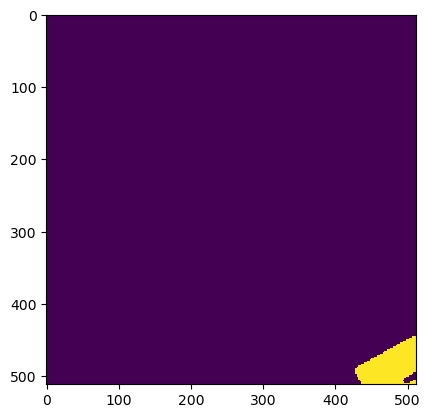

Wrote output/patches/mask/UU_S1_69-519990-4000-6286049-6000.tiff (512 x 512 pixels)


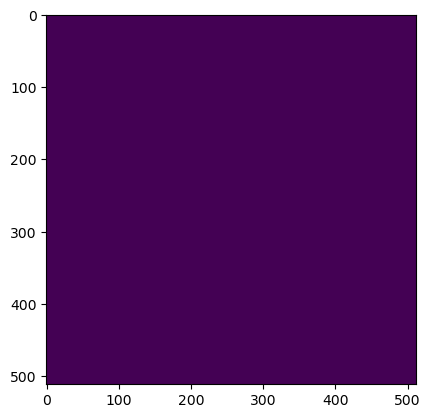

Wrote output/patches/mask/UU_S1_69-519990-4000-6286152-0000.tiff (512 x 512 pixels)


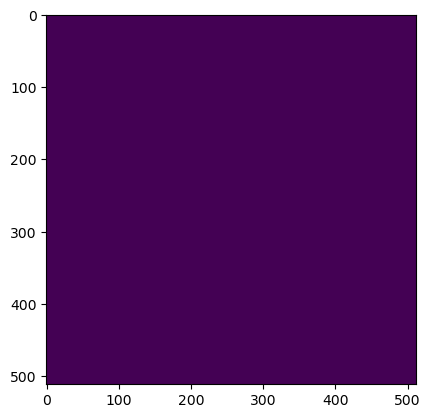

Wrote output/patches/mask/UU_S1_69-519990-4000-6286254-4000.tiff (512 x 512 pixels)


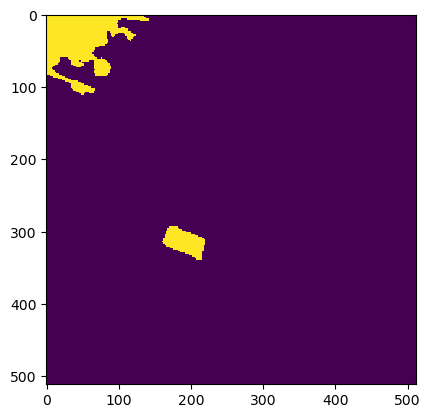

Wrote output/patches/mask/UU_S1_69-519990-4000-6286356-8000.tiff (512 x 512 pixels)


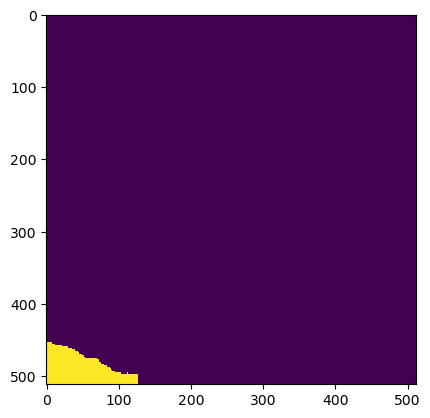

Wrote output/patches/mask/UU_S1_69-519990-4000-6286459-2000.tiff (512 x 512 pixels)


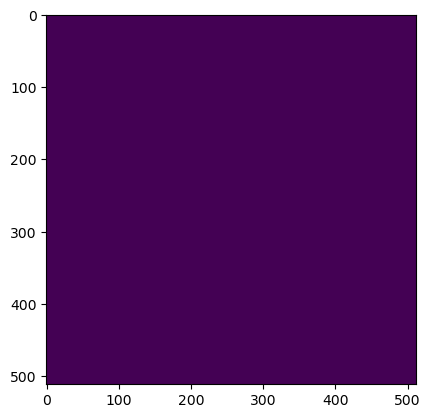

Wrote output/patches/mask/UU_S1_69-519990-4000-6286561-6000.tiff (512 x 512 pixels)


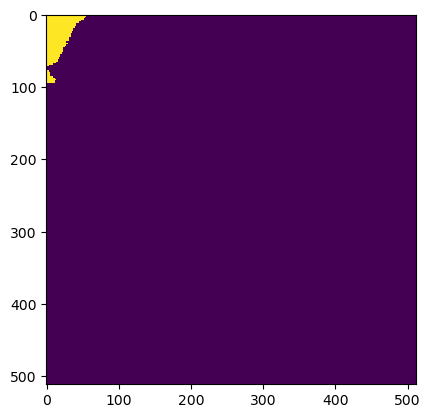

Wrote output/patches/mask/UU_S1_69-520092-8000-6285742-4000.tiff (512 x 512 pixels)


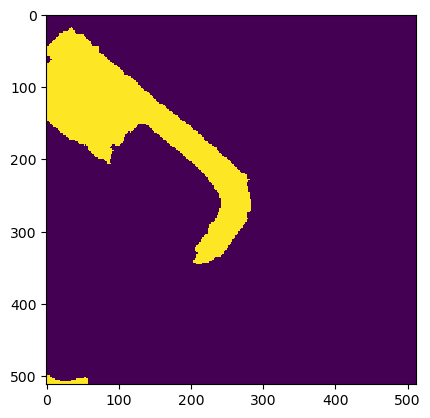

Wrote output/patches/mask/UU_S1_69-520092-8000-6285844-8000.tiff (512 x 512 pixels)


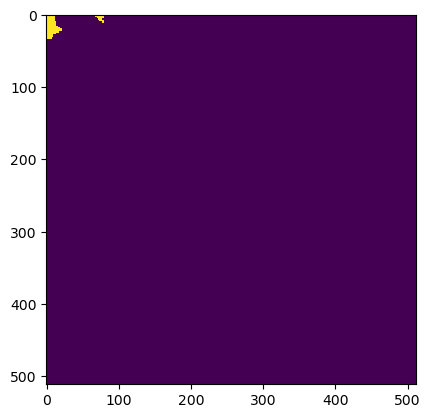

Wrote output/patches/mask/UU_S1_69-520092-8000-6285947-2000.tiff (512 x 512 pixels)


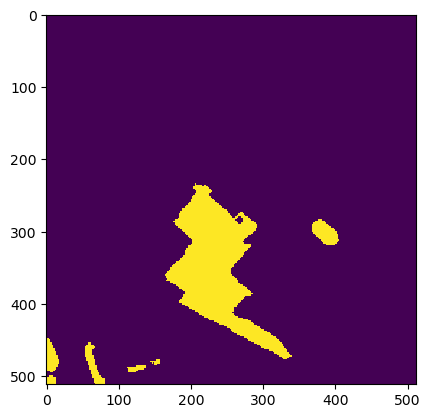

Wrote output/patches/mask/UU_S1_69-520092-8000-6286049-6000.tiff (512 x 512 pixels)


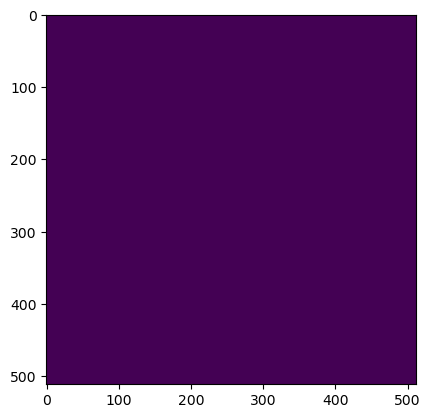

Wrote output/patches/mask/UU_S1_69-520092-8000-6286152-0000.tiff (512 x 512 pixels)


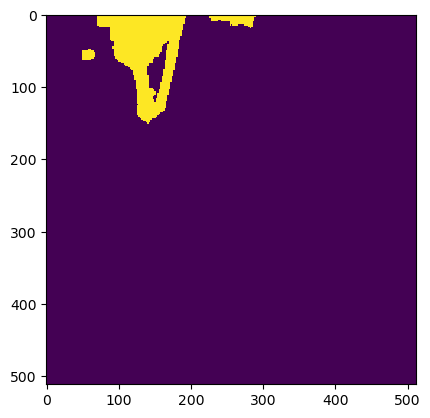

Wrote output/patches/mask/UU_S1_69-520092-8000-6286254-4000.tiff (512 x 512 pixels)


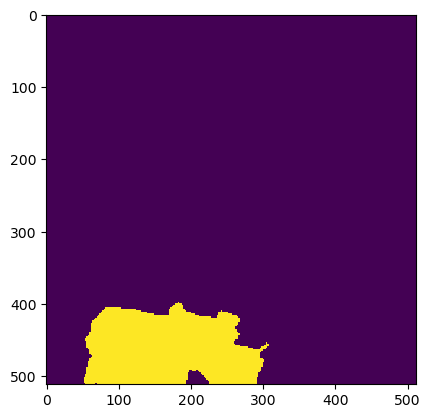

Wrote output/patches/mask/UU_S1_69-520092-8000-6286356-8000.tiff (512 x 512 pixels)


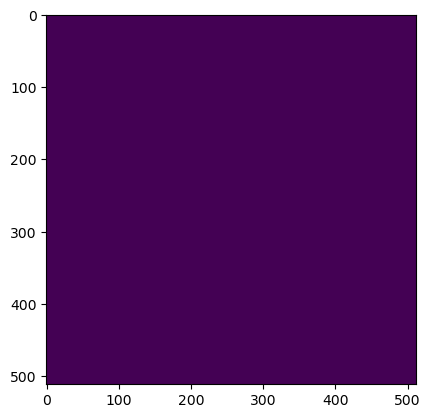

Wrote output/patches/mask/UU_S1_69-520092-8000-6286459-2000.tiff (512 x 512 pixels)


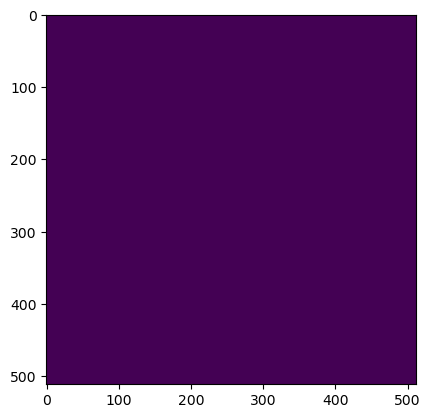

Wrote output/patches/mask/UU_S1_69-520092-8000-6286561-6000.tiff (512 x 512 pixels)


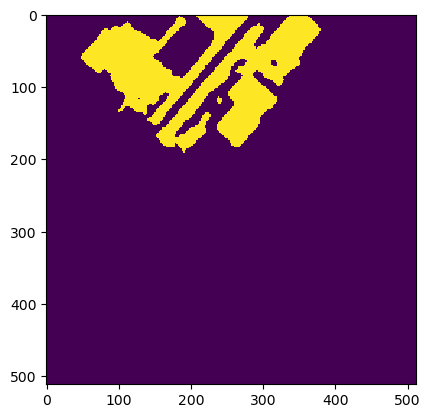

Wrote output/patches/mask/UU_S1_69-520195-2000-6285742-4000.tiff (512 x 512 pixels)


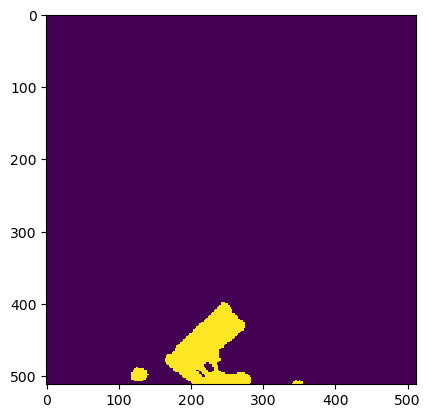

Wrote output/patches/mask/UU_S1_69-520195-2000-6285844-8000.tiff (512 x 512 pixels)


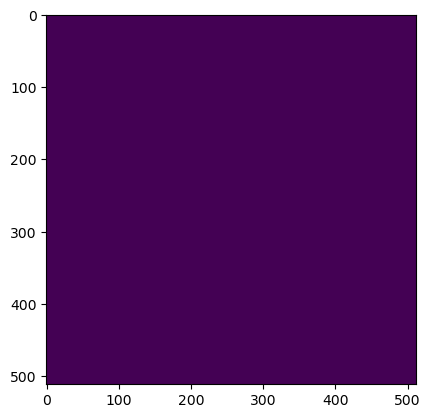

Wrote output/patches/mask/UU_S1_69-520195-2000-6285947-2000.tiff (512 x 512 pixels)


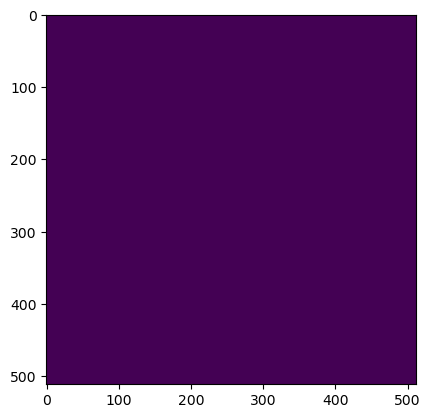

Wrote output/patches/mask/UU_S1_69-520195-2000-6286049-6000.tiff (512 x 512 pixels)


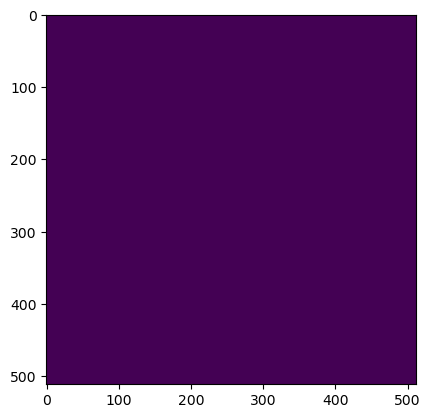

Wrote output/patches/mask/UU_S1_69-520195-2000-6286152-0000.tiff (512 x 512 pixels)


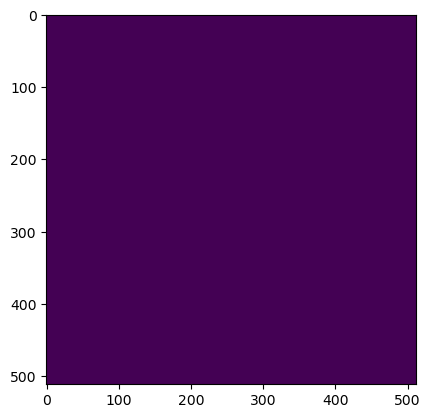

Wrote output/patches/mask/UU_S1_69-520195-2000-6286254-4000.tiff (512 x 512 pixels)


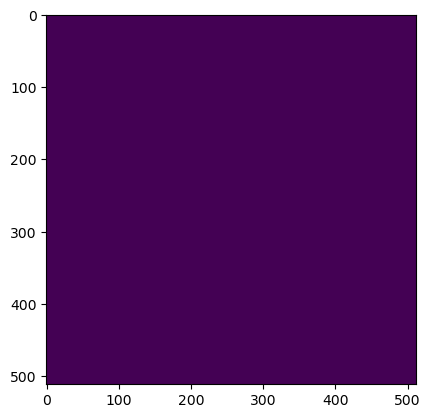

Wrote output/patches/mask/UU_S1_69-520195-2000-6286356-8000.tiff (512 x 512 pixels)


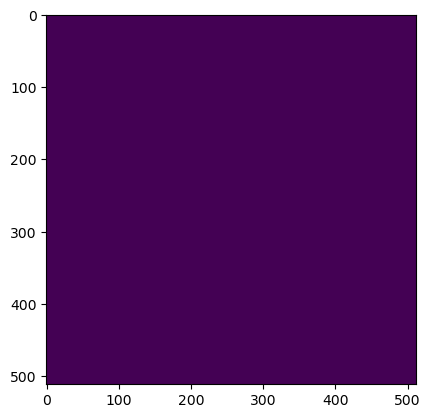

Wrote output/patches/mask/UU_S1_69-520195-2000-6286459-2000.tiff (512 x 512 pixels)


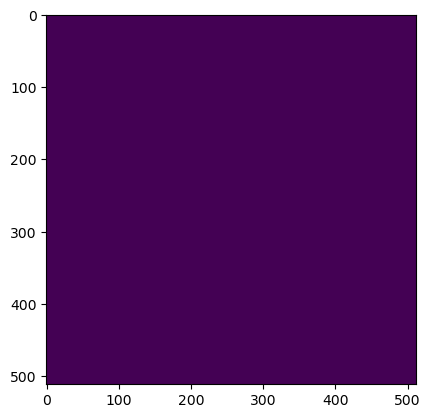

Wrote output/patches/mask/UU_S1_69-520195-2000-6286561-6000.tiff (512 x 512 pixels)
Zone UU_S1_70 Building Mask...


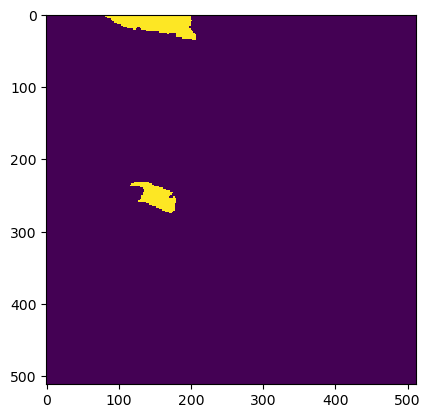

Wrote output/patches/mask/UU_S1_70-503760-0000-6285742-4000.tiff (512 x 512 pixels)


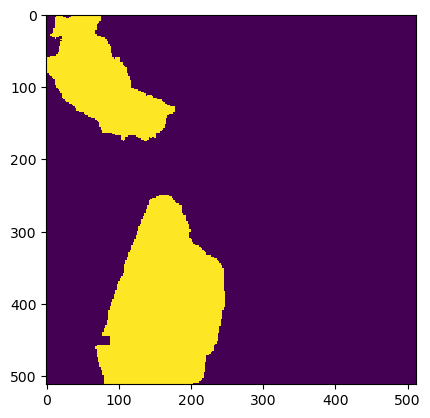

Wrote output/patches/mask/UU_S1_70-503760-0000-6285844-8000.tiff (512 x 512 pixels)


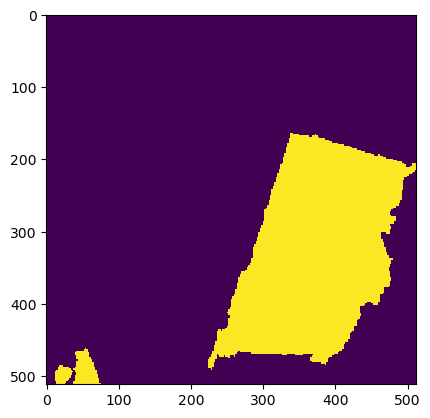

Wrote output/patches/mask/UU_S1_70-503760-0000-6285947-2000.tiff (512 x 512 pixels)


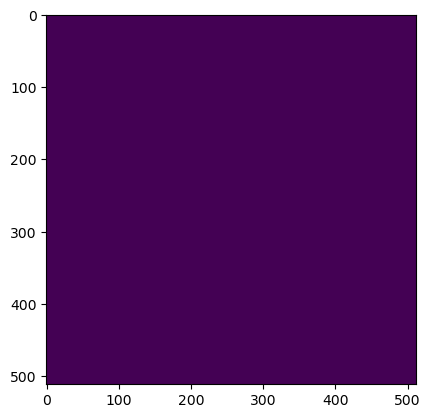

Wrote output/patches/mask/UU_S1_70-503760-0000-6286049-6000.tiff (512 x 512 pixels)


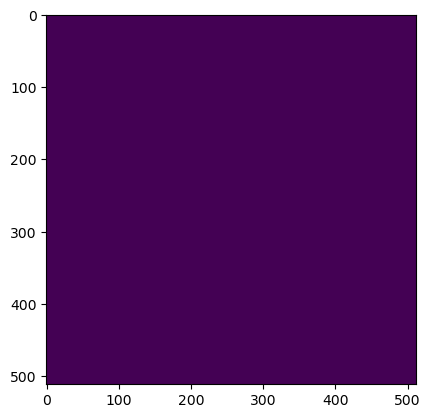

Wrote output/patches/mask/UU_S1_70-503862-4000-6285742-4000.tiff (512 x 512 pixels)


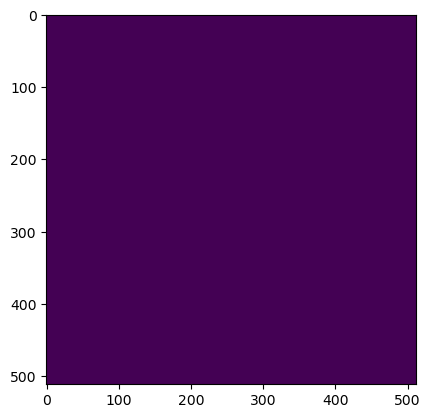

Wrote output/patches/mask/UU_S1_70-503862-4000-6285844-8000.tiff (512 x 512 pixels)


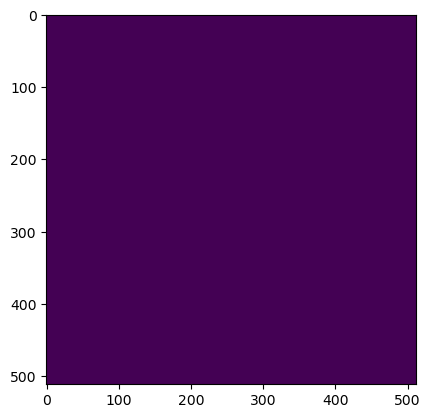

Wrote output/patches/mask/UU_S1_70-503862-4000-6285947-2000.tiff (512 x 512 pixels)


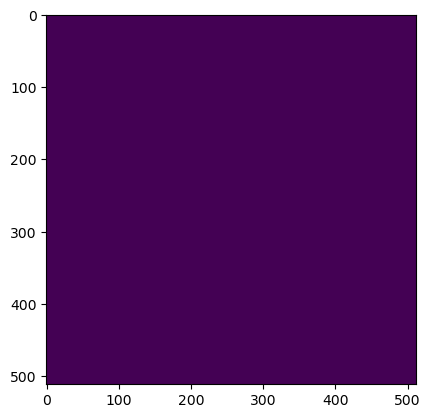

Wrote output/patches/mask/UU_S1_70-503862-4000-6286049-6000.tiff (512 x 512 pixels)


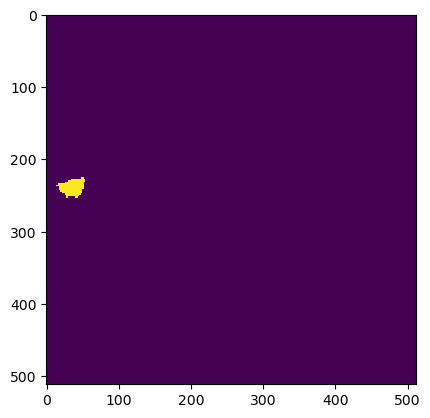

Wrote output/patches/mask/UU_S1_70-503964-8000-6285742-4000.tiff (512 x 512 pixels)


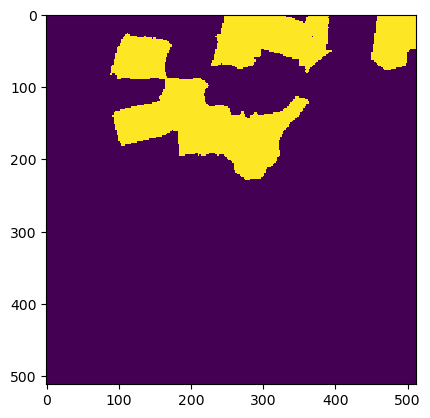

Wrote output/patches/mask/UU_S1_70-503964-8000-6285844-8000.tiff (512 x 512 pixels)


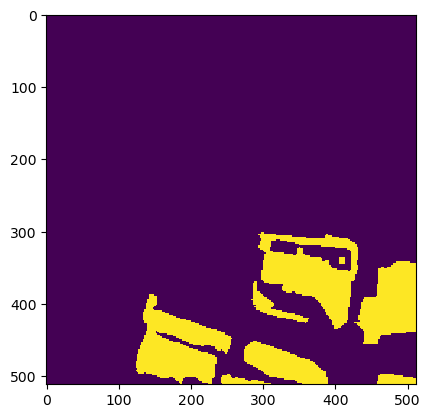

Wrote output/patches/mask/UU_S1_70-503964-8000-6285947-2000.tiff (512 x 512 pixels)


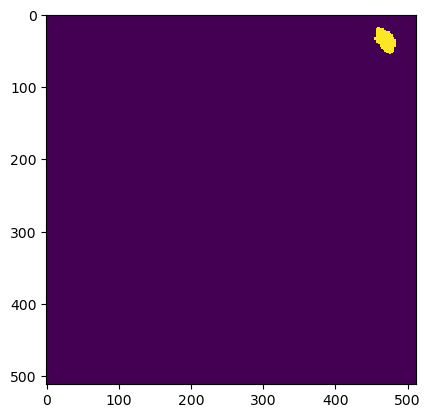

Wrote output/patches/mask/UU_S1_70-503964-8000-6286049-6000.tiff (512 x 512 pixels)


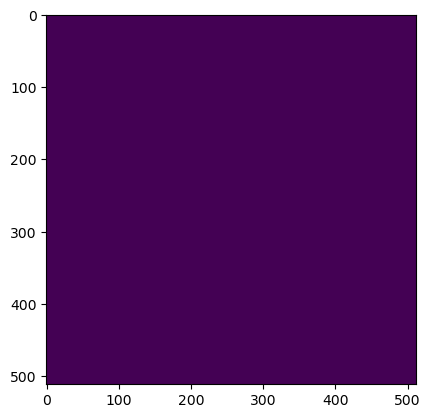

Wrote output/patches/mask/UU_S1_70-504067-2000-6285742-4000.tiff (512 x 512 pixels)


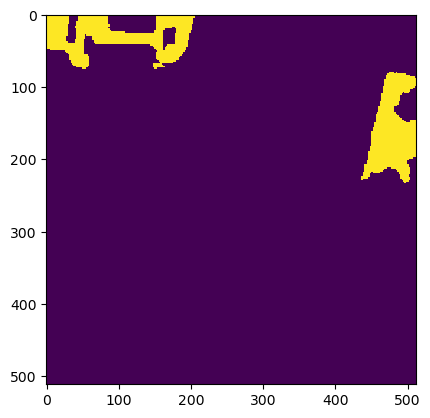

Wrote output/patches/mask/UU_S1_70-504067-2000-6285844-8000.tiff (512 x 512 pixels)


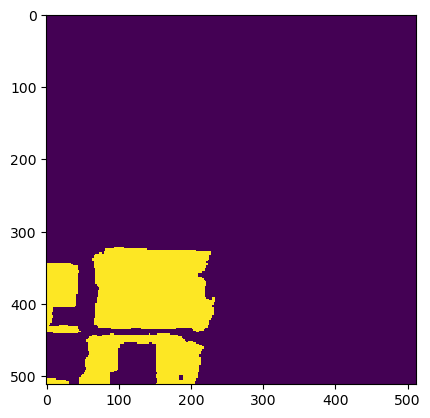

Wrote output/patches/mask/UU_S1_70-504067-2000-6285947-2000.tiff (512 x 512 pixels)


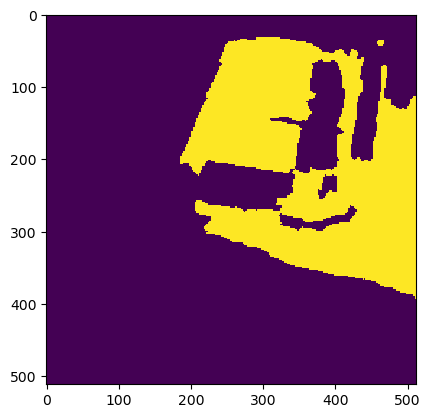

Wrote output/patches/mask/UU_S1_70-504067-2000-6286049-6000.tiff (512 x 512 pixels)


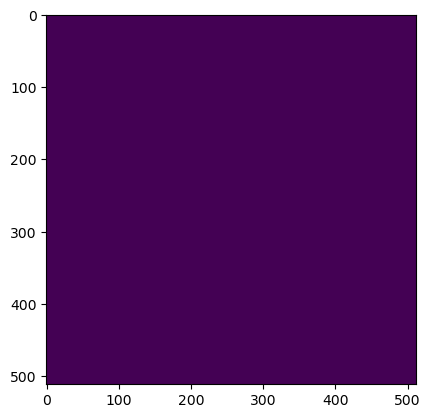

Wrote output/patches/mask/UU_S1_70-504169-6000-6285742-4000.tiff (512 x 512 pixels)


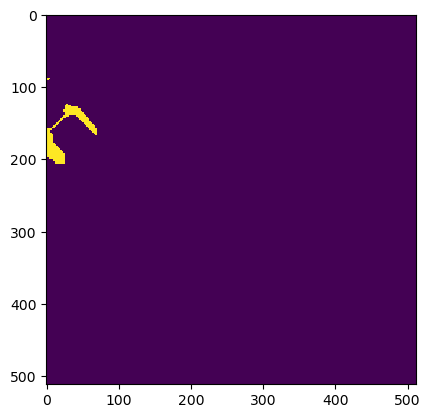

Wrote output/patches/mask/UU_S1_70-504169-6000-6285844-8000.tiff (512 x 512 pixels)


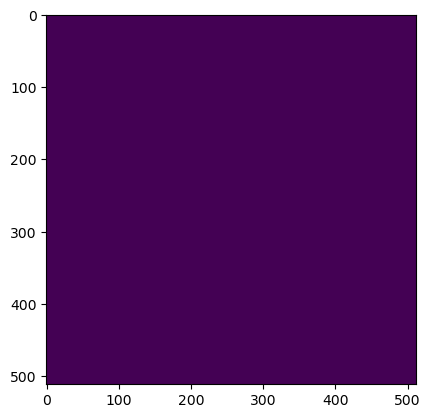

Wrote output/patches/mask/UU_S1_70-504169-6000-6285947-2000.tiff (512 x 512 pixels)


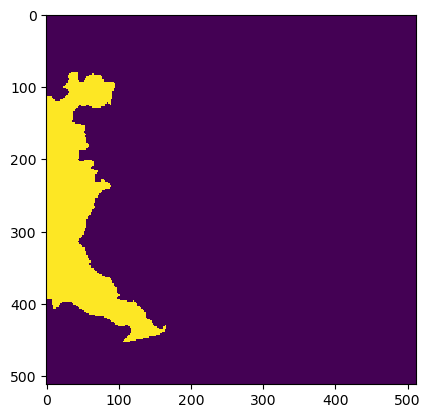

Wrote output/patches/mask/UU_S1_70-504169-6000-6286049-6000.tiff (512 x 512 pixels)


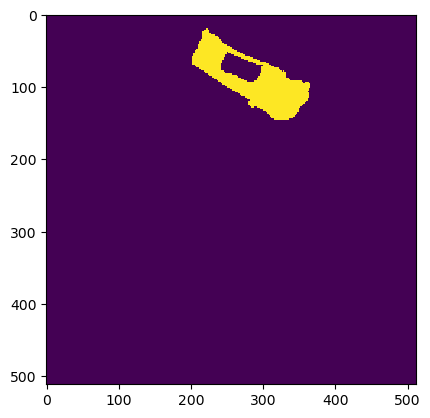

Wrote output/patches/mask/UU_S1_70-504272-0000-6285742-4000.tiff (512 x 512 pixels)


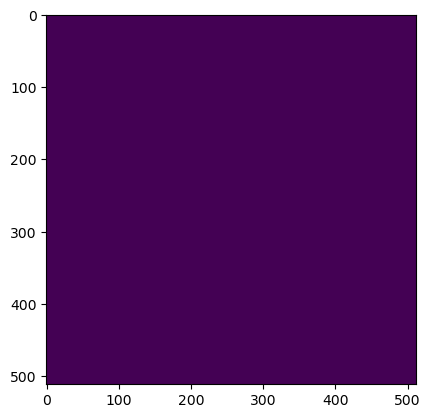

Wrote output/patches/mask/UU_S1_70-504272-0000-6285844-8000.tiff (512 x 512 pixels)


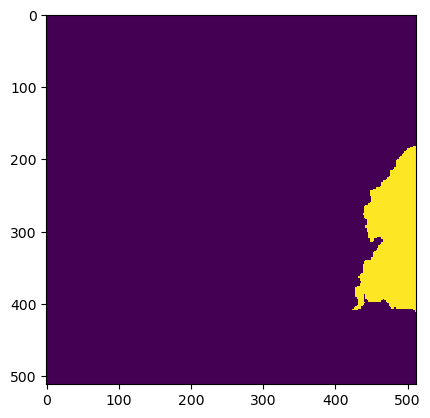

Wrote output/patches/mask/UU_S1_70-504272-0000-6285947-2000.tiff (512 x 512 pixels)


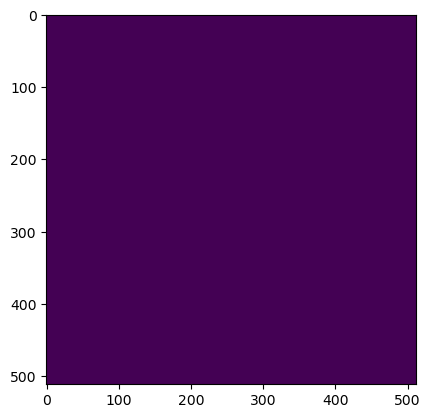

Wrote output/patches/mask/UU_S1_70-504272-0000-6286049-6000.tiff (512 x 512 pixels)


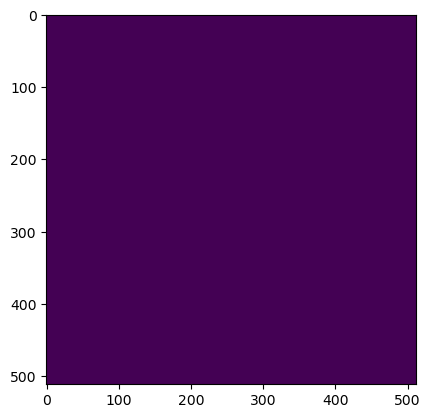

Wrote output/patches/mask/UU_S1_70-504374-4000-6285742-4000.tiff (512 x 512 pixels)


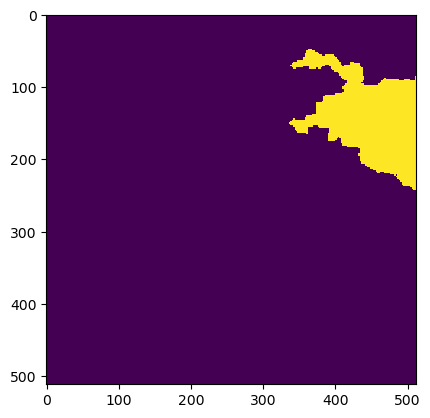

Wrote output/patches/mask/UU_S1_70-504374-4000-6285844-8000.tiff (512 x 512 pixels)


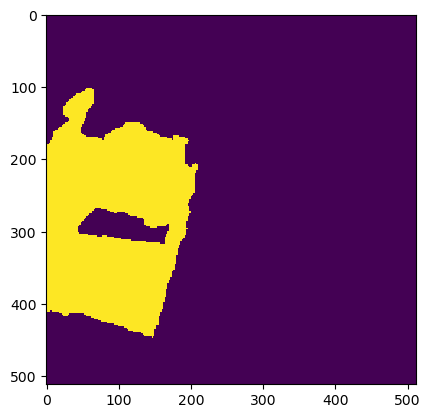

Wrote output/patches/mask/UU_S1_70-504374-4000-6285947-2000.tiff (512 x 512 pixels)


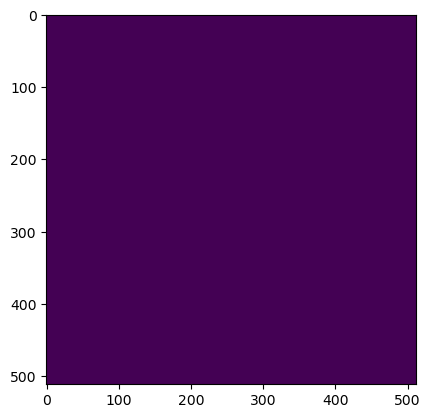

Wrote output/patches/mask/UU_S1_70-504374-4000-6286049-6000.tiff (512 x 512 pixels)
Zone UU_S1_71 Building Mask...


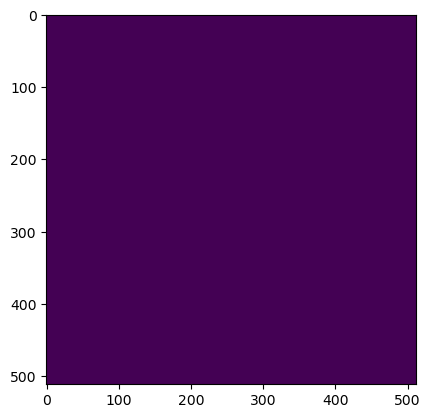

Wrote output/patches/mask/UU_S1_71-505040-0000-6286254-4000.tiff (512 x 512 pixels)


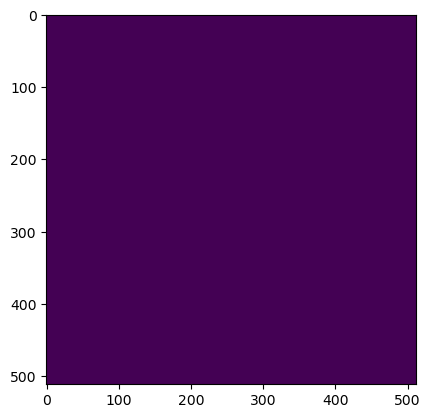

Wrote output/patches/mask/UU_S1_71-505040-0000-6286356-8000.tiff (512 x 512 pixels)


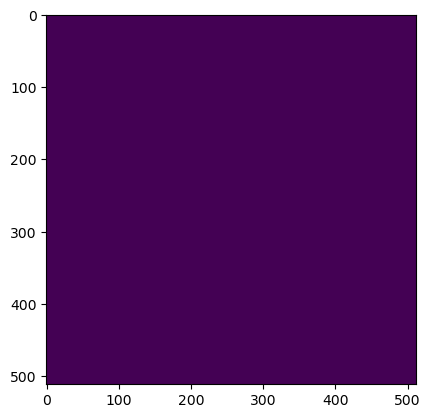

Wrote output/patches/mask/UU_S1_71-505142-4000-6286254-4000.tiff (512 x 512 pixels)


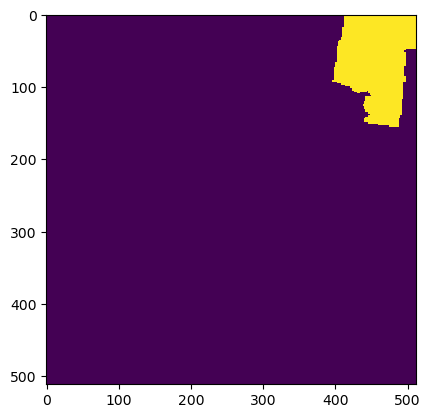

Wrote output/patches/mask/UU_S1_71-505142-4000-6286356-8000.tiff (512 x 512 pixels)
Zone UU_S1_72 Building Mask...


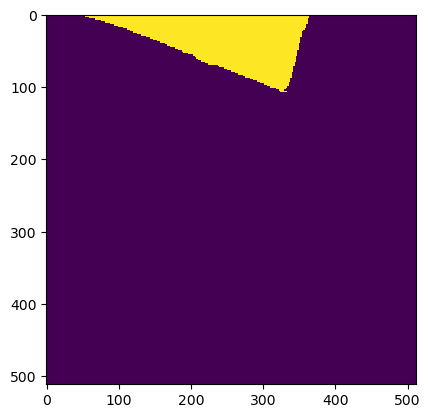

Wrote output/patches/mask/UU_S1_72-503504-0000-6286254-4000.tiff (512 x 512 pixels)


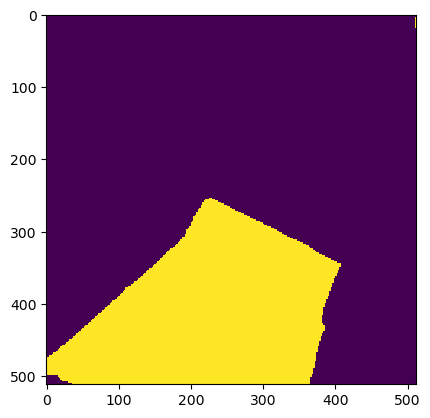

Wrote output/patches/mask/UU_S1_72-503504-0000-6286356-8000.tiff (512 x 512 pixels)


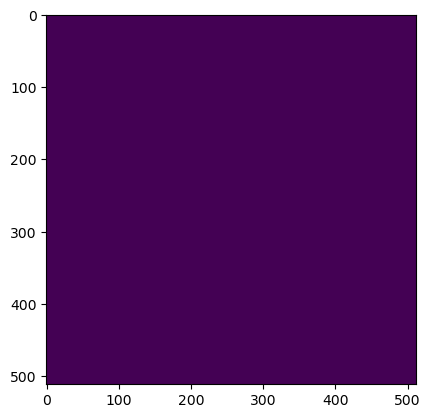

Wrote output/patches/mask/UU_S1_72-503504-0000-6286459-2000.tiff (512 x 512 pixels)


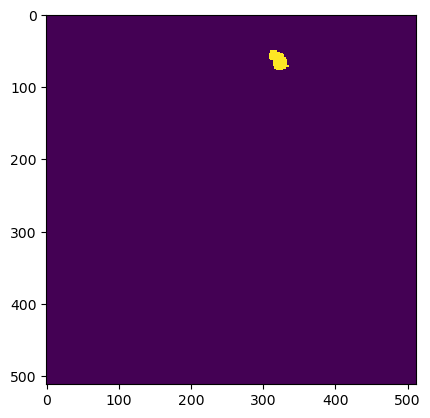

Wrote output/patches/mask/UU_S1_72-503504-0000-6286561-6000.tiff (512 x 512 pixels)


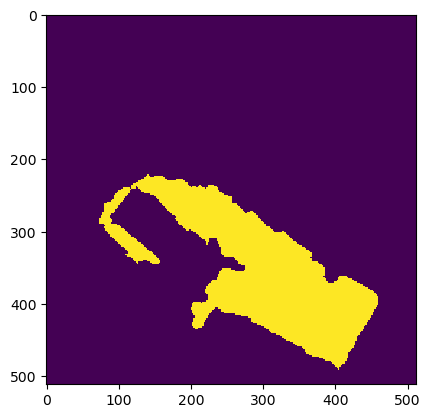

Wrote output/patches/mask/UU_S1_72-503606-4000-6286254-4000.tiff (512 x 512 pixels)


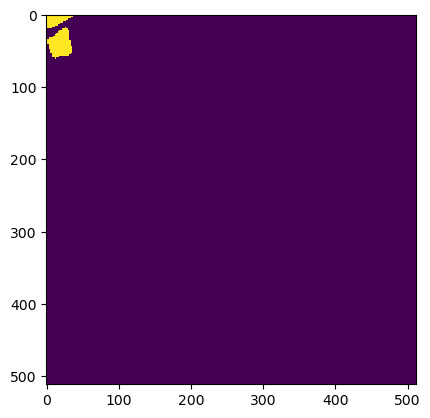

Wrote output/patches/mask/UU_S1_72-503606-4000-6286356-8000.tiff (512 x 512 pixels)


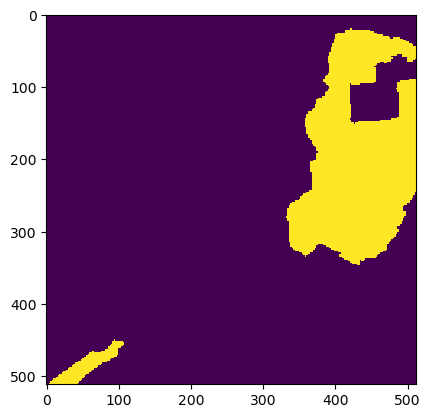

Wrote output/patches/mask/UU_S1_72-503606-4000-6286459-2000.tiff (512 x 512 pixels)


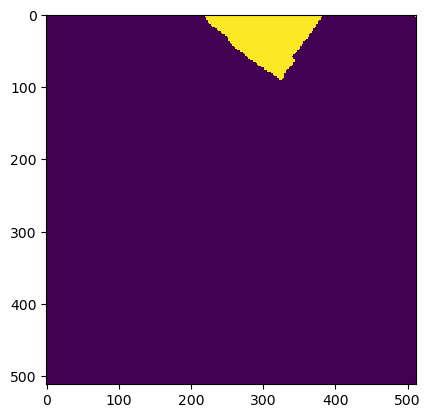

Wrote output/patches/mask/UU_S1_72-503606-4000-6286561-6000.tiff (512 x 512 pixels)
Zone NU_S1_73 Building Mask...


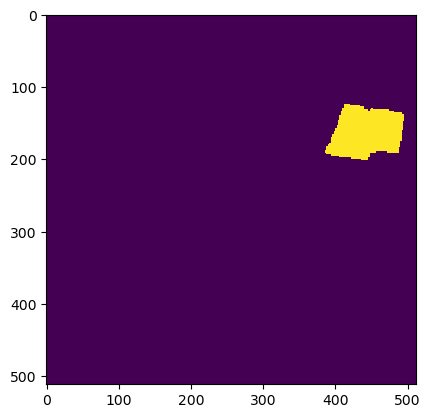

Wrote output/patches/mask/NU_S1_73-455632-0000-6286510-4000.tiff (512 x 512 pixels)


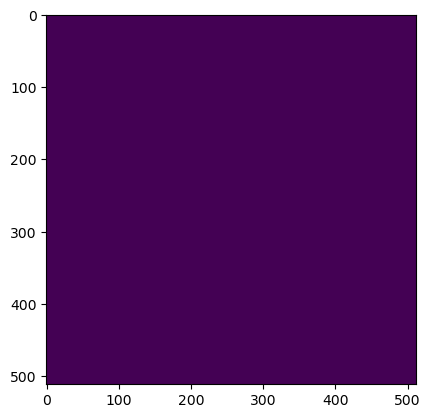

Wrote output/patches/mask/NU_S1_73-455632-0000-6286612-8000.tiff (512 x 512 pixels)


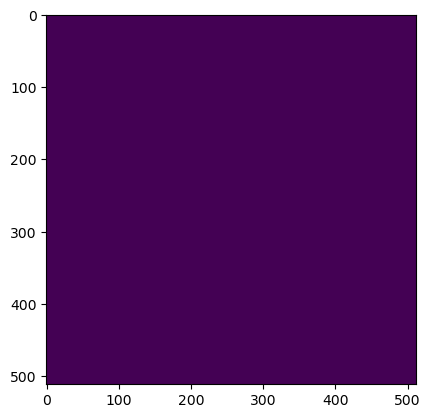

Wrote output/patches/mask/NU_S1_73-455632-0000-6286715-2000.tiff (512 x 512 pixels)


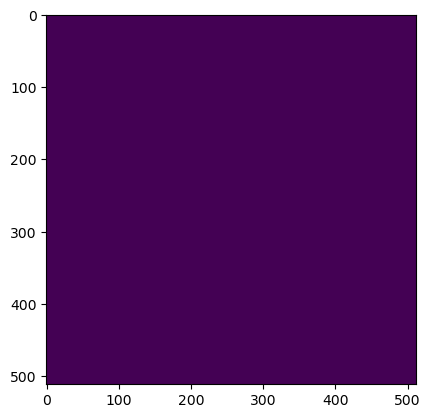

Wrote output/patches/mask/NU_S1_73-455632-0000-6286817-6000.tiff (512 x 512 pixels)


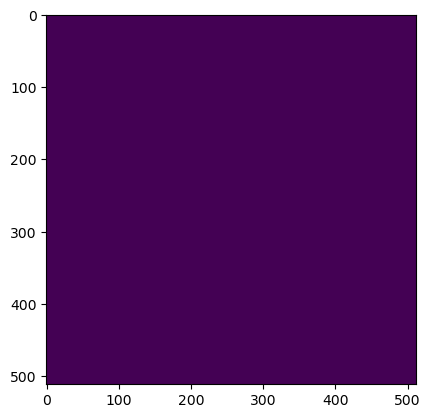

Wrote output/patches/mask/NU_S1_73-455632-0000-6286920-0000.tiff (512 x 512 pixels)


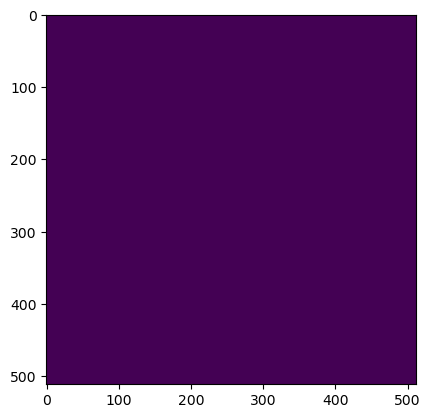

Wrote output/patches/mask/NU_S1_73-455632-0000-6287022-4000.tiff (512 x 512 pixels)


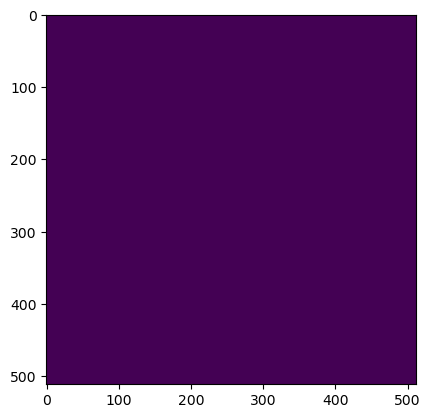

Wrote output/patches/mask/NU_S1_73-455632-0000-6287124-8000.tiff (512 x 512 pixels)


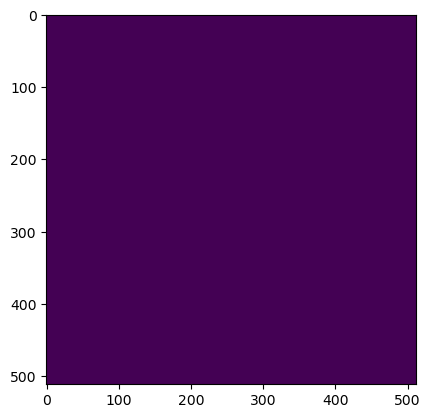

Wrote output/patches/mask/NU_S1_73-455632-0000-6287227-2000.tiff (512 x 512 pixels)


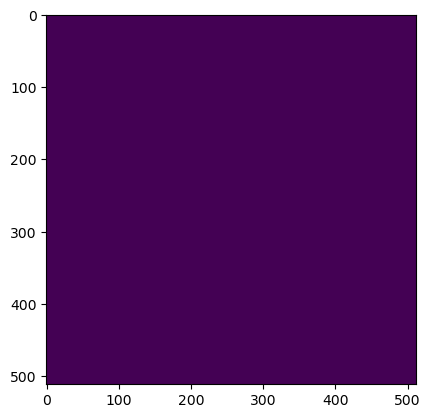

Wrote output/patches/mask/NU_S1_73-455632-0000-6287329-6000.tiff (512 x 512 pixels)


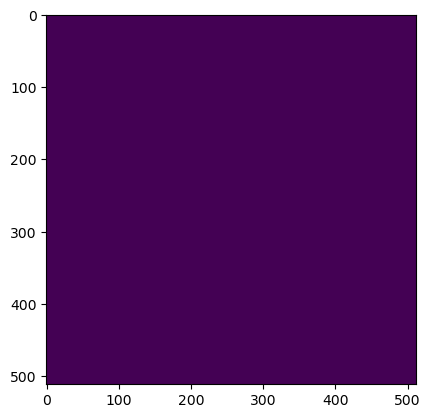

Wrote output/patches/mask/NU_S1_73-455632-0000-6287432-0000.tiff (512 x 512 pixels)


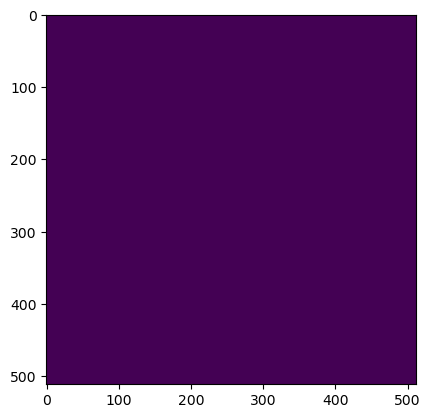

Wrote output/patches/mask/NU_S1_73-455632-0000-6287534-4000.tiff (512 x 512 pixels)


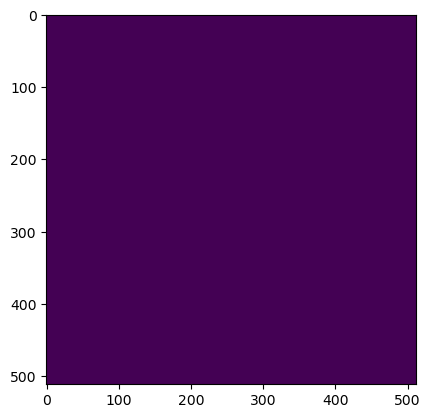

Wrote output/patches/mask/NU_S1_73-455632-0000-6287636-8000.tiff (512 x 512 pixels)


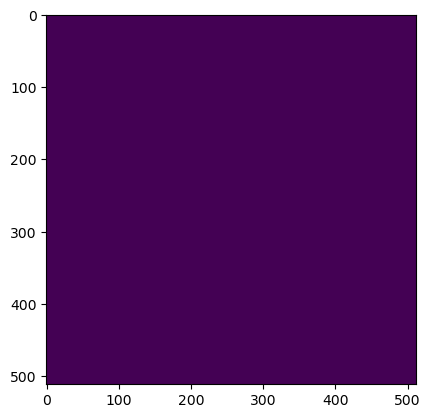

Wrote output/patches/mask/NU_S1_73-455632-0000-6287739-2000.tiff (512 x 512 pixels)


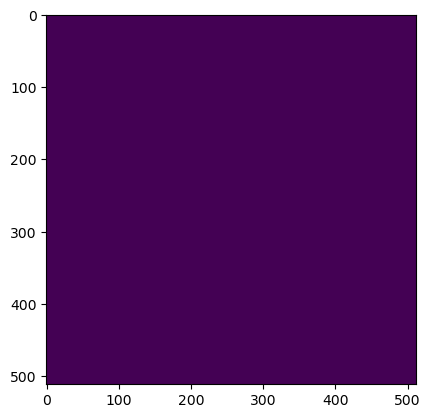

Wrote output/patches/mask/NU_S1_73-455632-0000-6287841-6000.tiff (512 x 512 pixels)


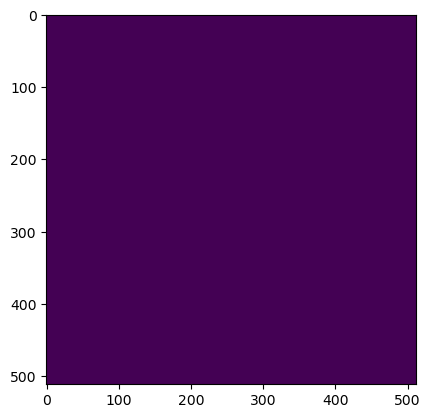

Wrote output/patches/mask/NU_S1_73-455734-4000-6286510-4000.tiff (512 x 512 pixels)


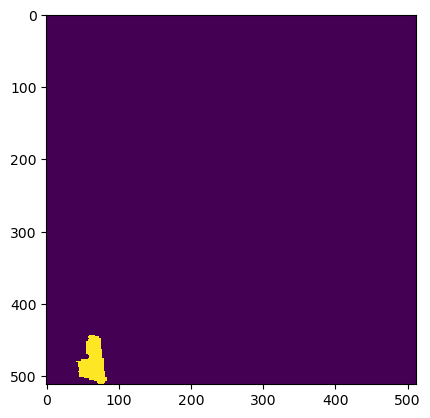

Wrote output/patches/mask/NU_S1_73-455734-4000-6286612-8000.tiff (512 x 512 pixels)


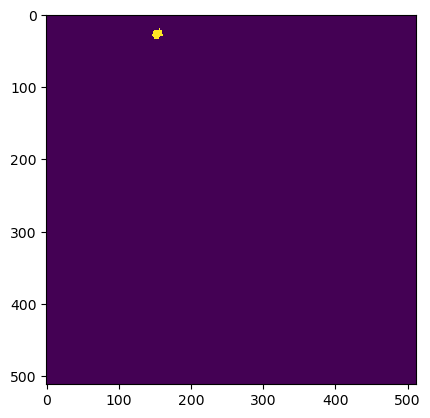

Wrote output/patches/mask/NU_S1_73-455734-4000-6286715-2000.tiff (512 x 512 pixels)


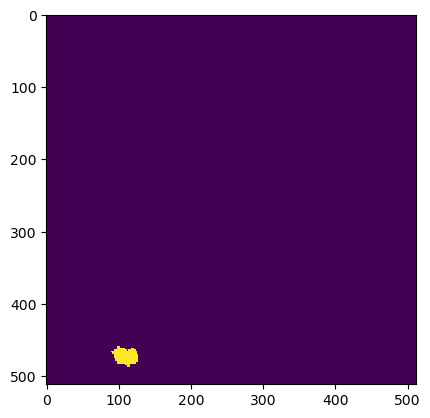

Wrote output/patches/mask/NU_S1_73-455734-4000-6286817-6000.tiff (512 x 512 pixels)


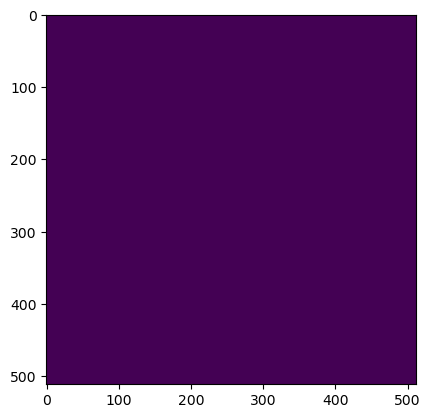

Wrote output/patches/mask/NU_S1_73-455734-4000-6286920-0000.tiff (512 x 512 pixels)


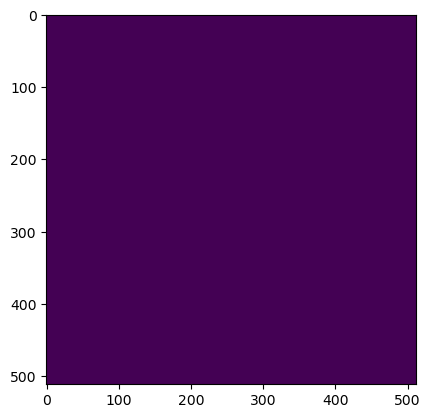

Wrote output/patches/mask/NU_S1_73-455734-4000-6287022-4000.tiff (512 x 512 pixels)


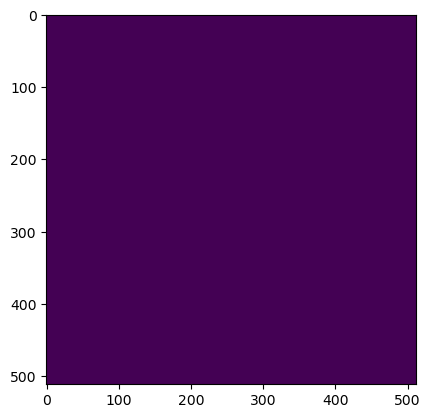

Wrote output/patches/mask/NU_S1_73-455734-4000-6287124-8000.tiff (512 x 512 pixels)


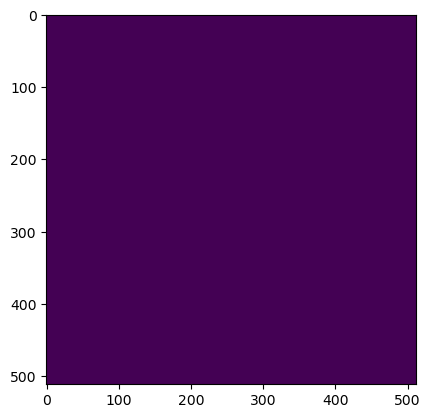

Wrote output/patches/mask/NU_S1_73-455734-4000-6287227-2000.tiff (512 x 512 pixels)


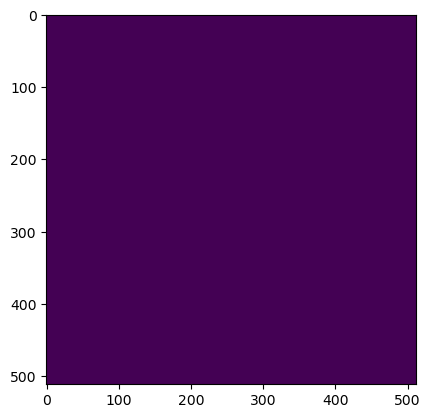

Wrote output/patches/mask/NU_S1_73-455734-4000-6287329-6000.tiff (512 x 512 pixels)


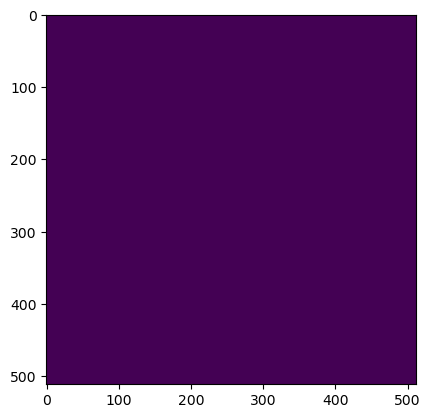

Wrote output/patches/mask/NU_S1_73-455734-4000-6287432-0000.tiff (512 x 512 pixels)


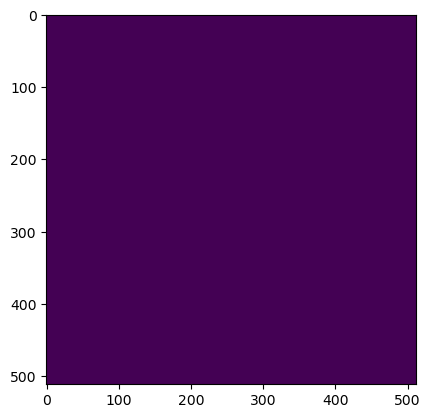

Wrote output/patches/mask/NU_S1_73-455734-4000-6287534-4000.tiff (512 x 512 pixels)


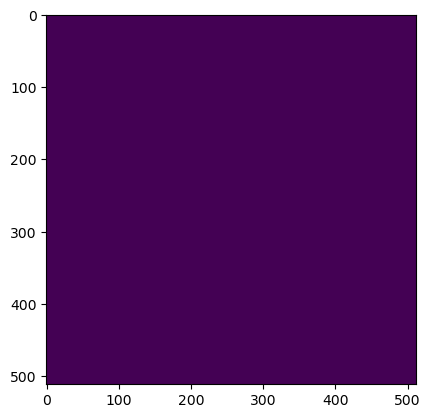

Wrote output/patches/mask/NU_S1_73-455734-4000-6287636-8000.tiff (512 x 512 pixels)


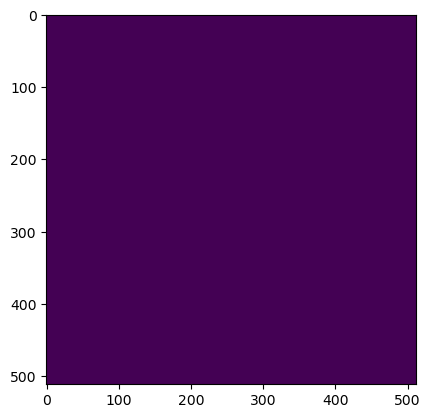

Wrote output/patches/mask/NU_S1_73-455734-4000-6287739-2000.tiff (512 x 512 pixels)


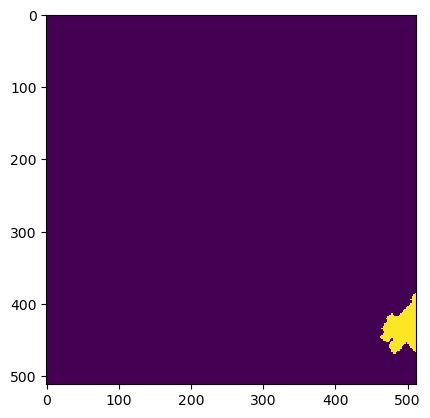

Wrote output/patches/mask/NU_S1_73-455734-4000-6287841-6000.tiff (512 x 512 pixels)


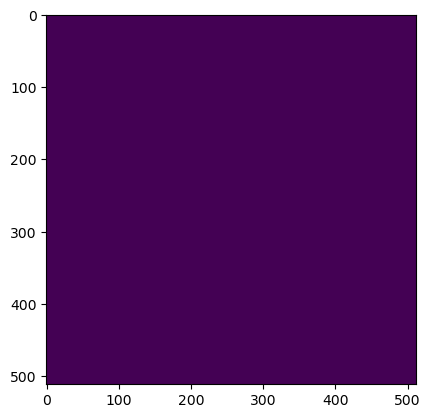

Wrote output/patches/mask/NU_S1_73-455836-8000-6286510-4000.tiff (512 x 512 pixels)


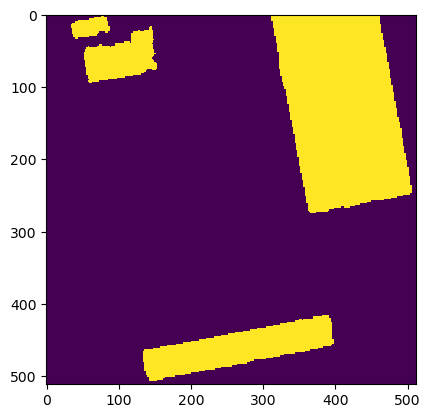

Wrote output/patches/mask/NU_S1_73-455836-8000-6286612-8000.tiff (512 x 512 pixels)


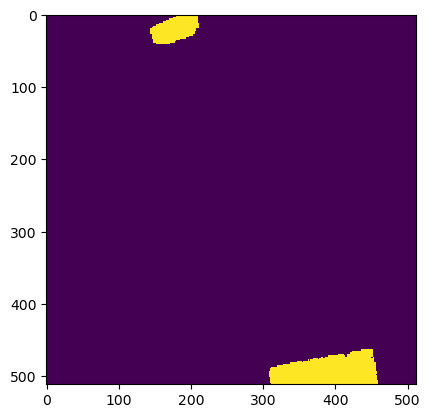

Wrote output/patches/mask/NU_S1_73-455836-8000-6286715-2000.tiff (512 x 512 pixels)


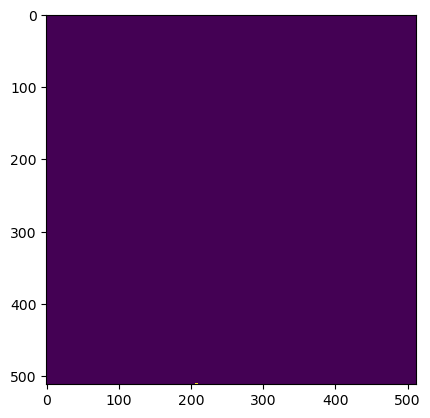

Wrote output/patches/mask/NU_S1_73-455836-8000-6286817-6000.tiff (512 x 512 pixels)


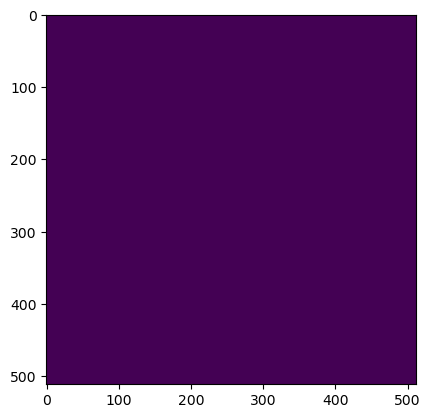

Wrote output/patches/mask/NU_S1_73-455836-8000-6286920-0000.tiff (512 x 512 pixels)


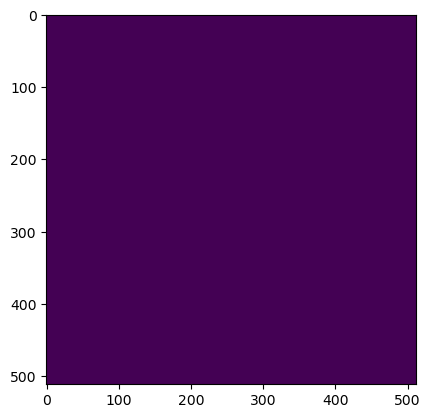

Wrote output/patches/mask/NU_S1_73-455836-8000-6287022-4000.tiff (512 x 512 pixels)


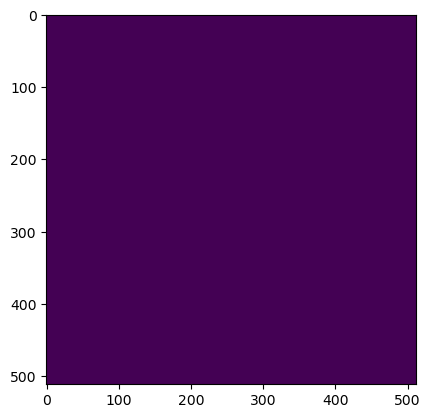

Wrote output/patches/mask/NU_S1_73-455836-8000-6287124-8000.tiff (512 x 512 pixels)


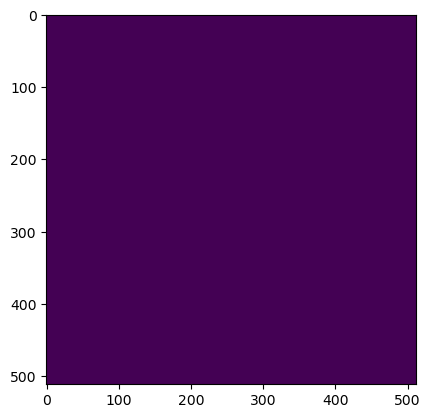

Wrote output/patches/mask/NU_S1_73-455836-8000-6287227-2000.tiff (512 x 512 pixels)


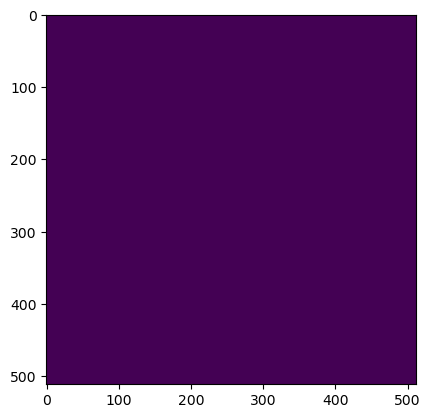

Wrote output/patches/mask/NU_S1_73-455836-8000-6287329-6000.tiff (512 x 512 pixels)


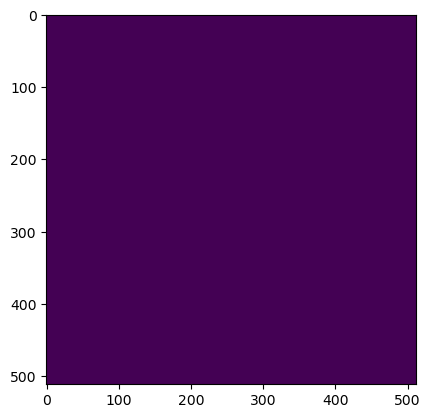

Wrote output/patches/mask/NU_S1_73-455836-8000-6287432-0000.tiff (512 x 512 pixels)


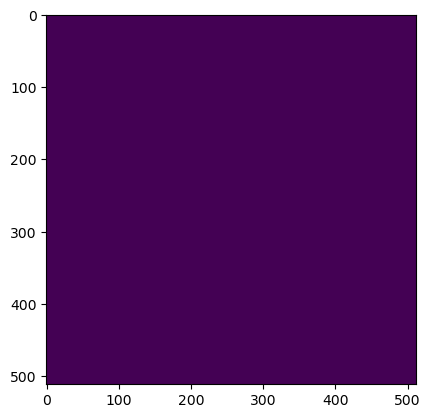

Wrote output/patches/mask/NU_S1_73-455836-8000-6287534-4000.tiff (512 x 512 pixels)


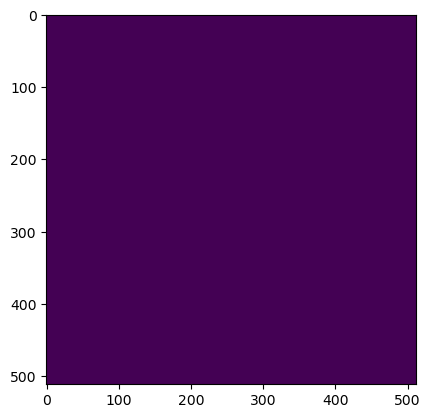

Wrote output/patches/mask/NU_S1_73-455836-8000-6287636-8000.tiff (512 x 512 pixels)


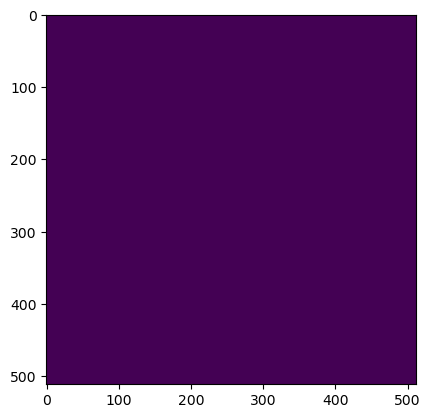

Wrote output/patches/mask/NU_S1_73-455836-8000-6287739-2000.tiff (512 x 512 pixels)


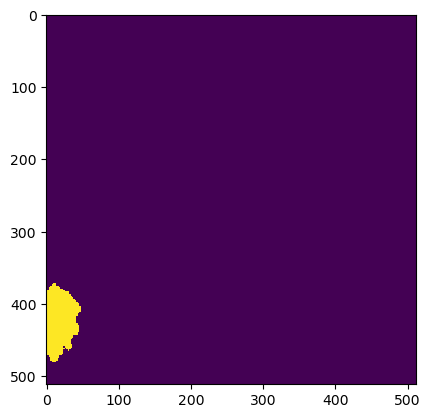

Wrote output/patches/mask/NU_S1_73-455836-8000-6287841-6000.tiff (512 x 512 pixels)


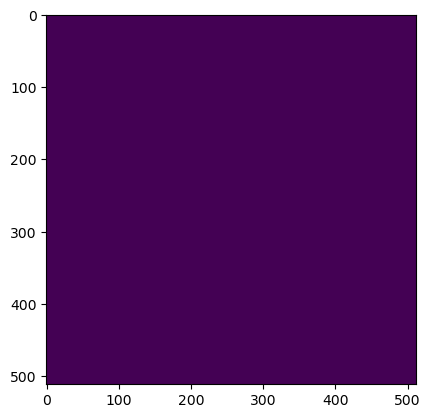

Wrote output/patches/mask/NU_S1_73-455939-2000-6286510-4000.tiff (512 x 512 pixels)


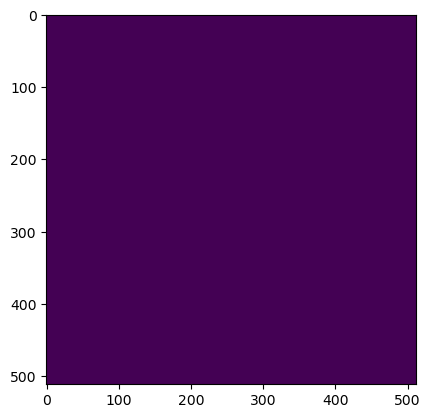

Wrote output/patches/mask/NU_S1_73-455939-2000-6286612-8000.tiff (512 x 512 pixels)


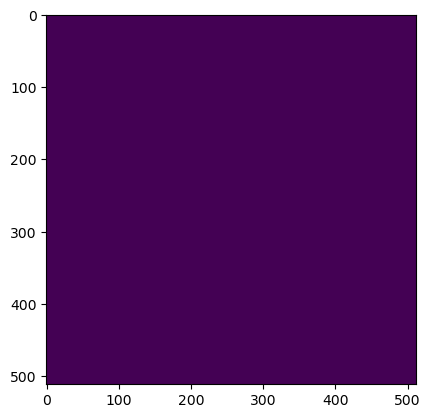

Wrote output/patches/mask/NU_S1_73-455939-2000-6286715-2000.tiff (512 x 512 pixels)


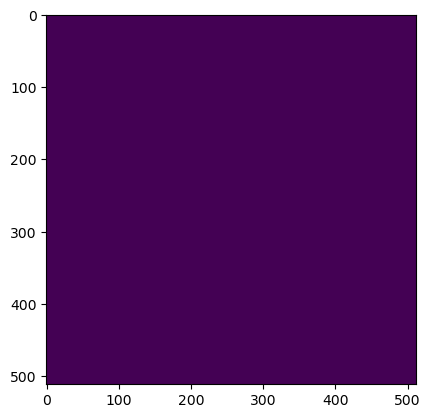

Wrote output/patches/mask/NU_S1_73-455939-2000-6286817-6000.tiff (512 x 512 pixels)


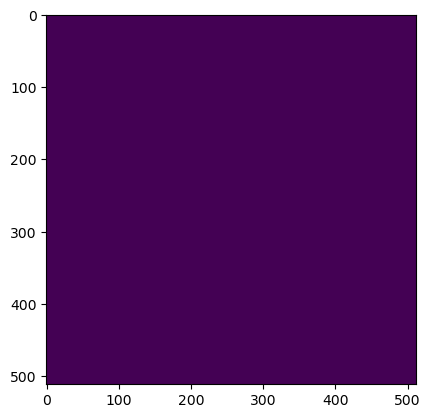

Wrote output/patches/mask/NU_S1_73-455939-2000-6286920-0000.tiff (512 x 512 pixels)


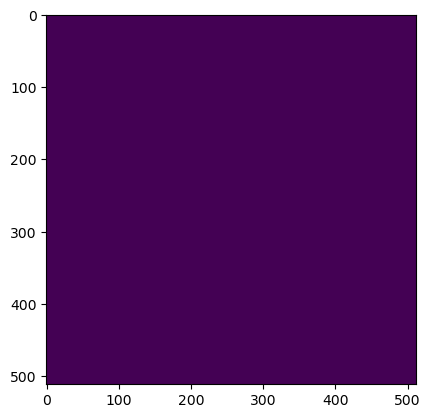

Wrote output/patches/mask/NU_S1_73-455939-2000-6287022-4000.tiff (512 x 512 pixels)


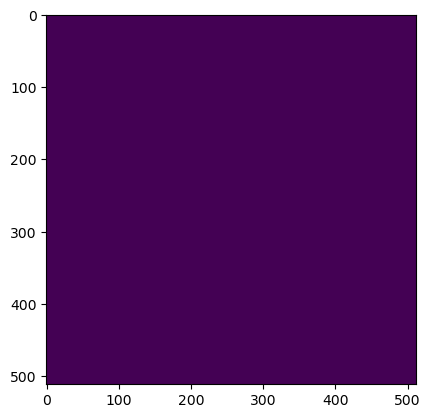

Wrote output/patches/mask/NU_S1_73-455939-2000-6287124-8000.tiff (512 x 512 pixels)


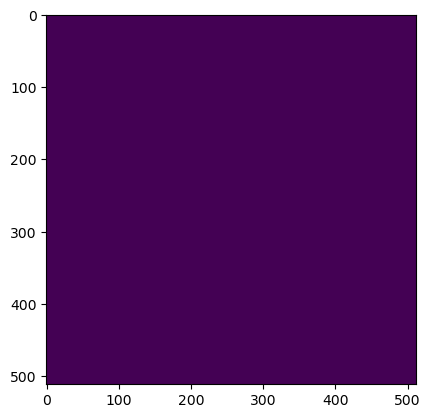

Wrote output/patches/mask/NU_S1_73-455939-2000-6287227-2000.tiff (512 x 512 pixels)


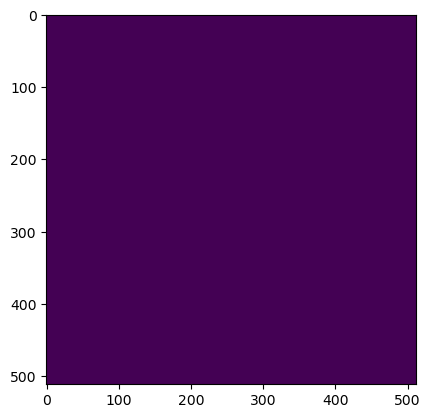

Wrote output/patches/mask/NU_S1_73-455939-2000-6287329-6000.tiff (512 x 512 pixels)


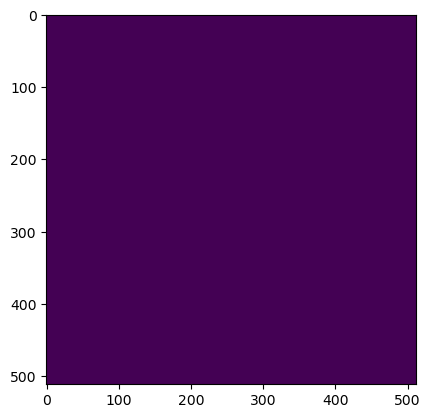

Wrote output/patches/mask/NU_S1_73-455939-2000-6287432-0000.tiff (512 x 512 pixels)


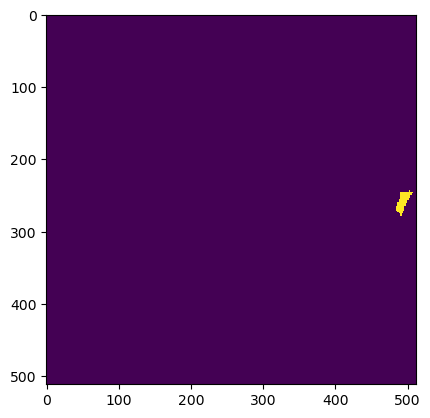

Wrote output/patches/mask/NU_S1_73-455939-2000-6287534-4000.tiff (512 x 512 pixels)


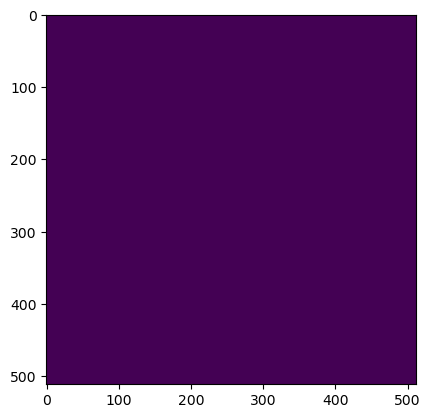

Wrote output/patches/mask/NU_S1_73-455939-2000-6287636-8000.tiff (512 x 512 pixels)


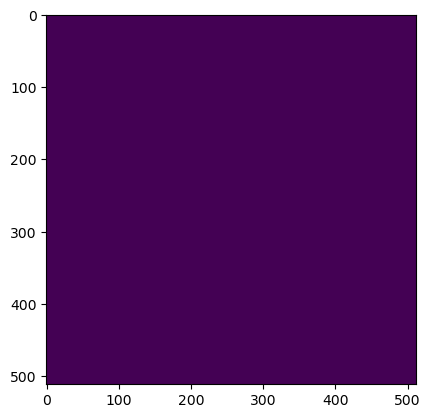

Wrote output/patches/mask/NU_S1_73-455939-2000-6287739-2000.tiff (512 x 512 pixels)


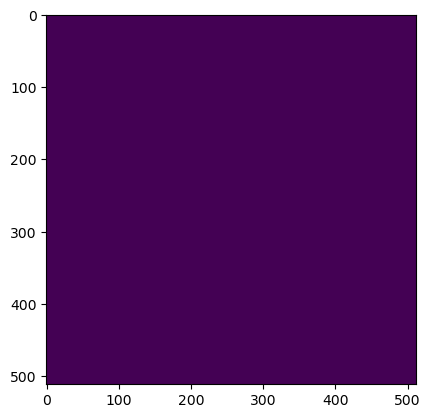

Wrote output/patches/mask/NU_S1_73-455939-2000-6287841-6000.tiff (512 x 512 pixels)


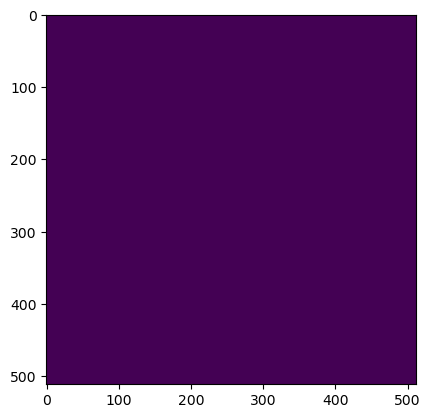

Wrote output/patches/mask/NU_S1_73-456041-6000-6286510-4000.tiff (512 x 512 pixels)


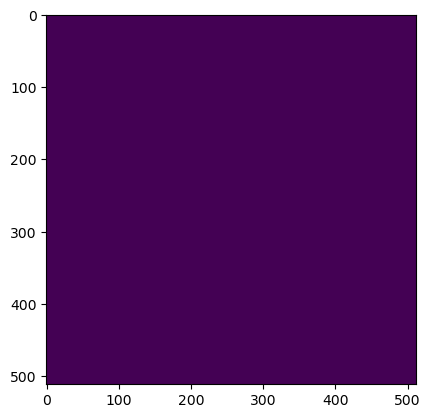

Wrote output/patches/mask/NU_S1_73-456041-6000-6286612-8000.tiff (512 x 512 pixels)


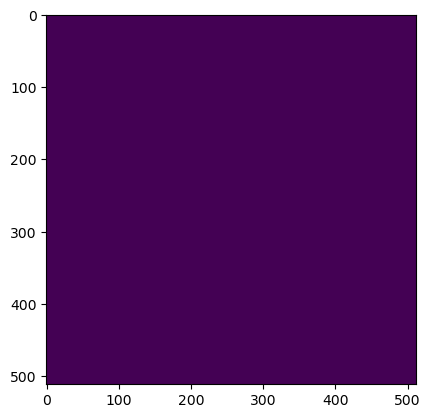

Wrote output/patches/mask/NU_S1_73-456041-6000-6286715-2000.tiff (512 x 512 pixels)


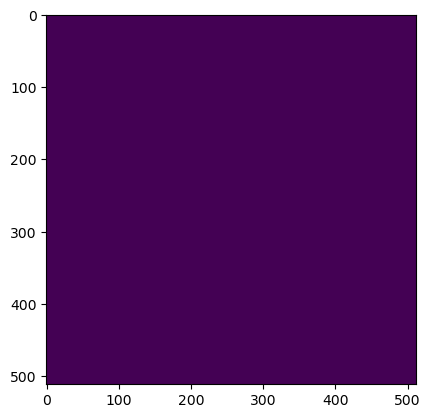

Wrote output/patches/mask/NU_S1_73-456041-6000-6286817-6000.tiff (512 x 512 pixels)


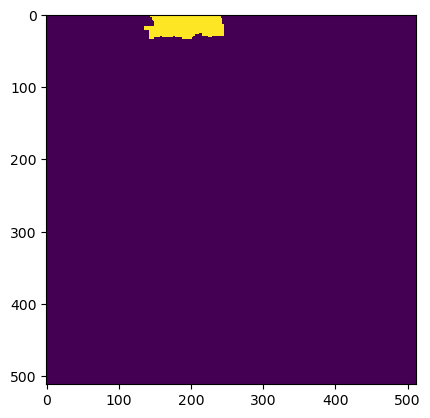

Wrote output/patches/mask/NU_S1_73-456041-6000-6286920-0000.tiff (512 x 512 pixels)


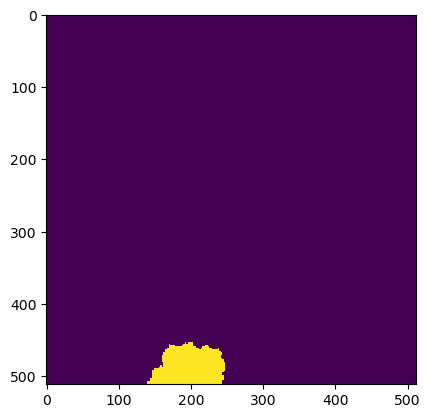

Wrote output/patches/mask/NU_S1_73-456041-6000-6287022-4000.tiff (512 x 512 pixels)


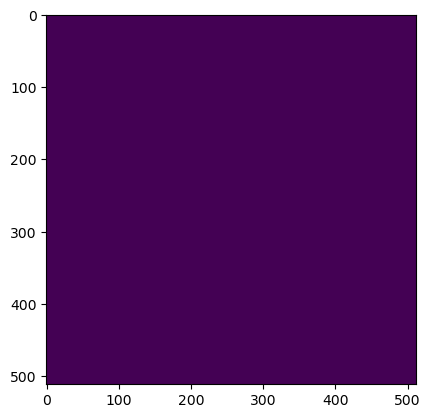

Wrote output/patches/mask/NU_S1_73-456041-6000-6287124-8000.tiff (512 x 512 pixels)


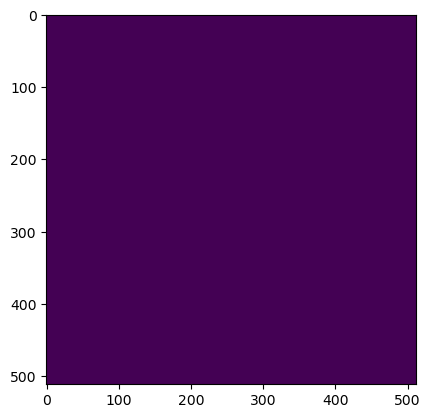

Wrote output/patches/mask/NU_S1_73-456041-6000-6287227-2000.tiff (512 x 512 pixels)


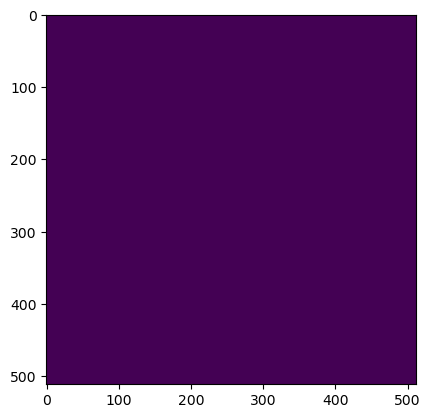

Wrote output/patches/mask/NU_S1_73-456041-6000-6287329-6000.tiff (512 x 512 pixels)


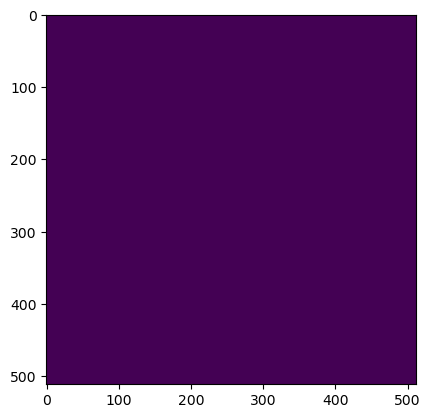

Wrote output/patches/mask/NU_S1_73-456041-6000-6287432-0000.tiff (512 x 512 pixels)


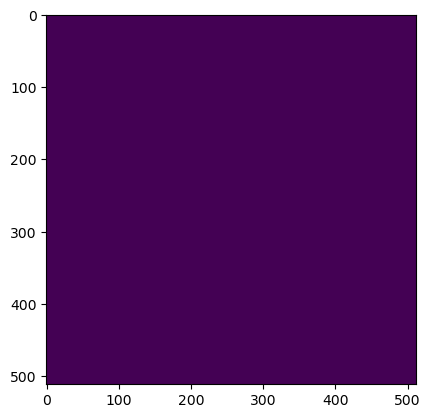

Wrote output/patches/mask/NU_S1_73-456041-6000-6287534-4000.tiff (512 x 512 pixels)


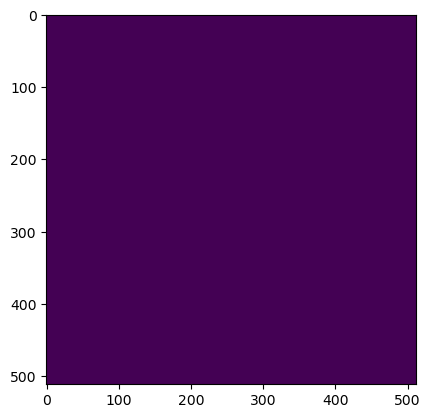

Wrote output/patches/mask/NU_S1_73-456041-6000-6287636-8000.tiff (512 x 512 pixels)


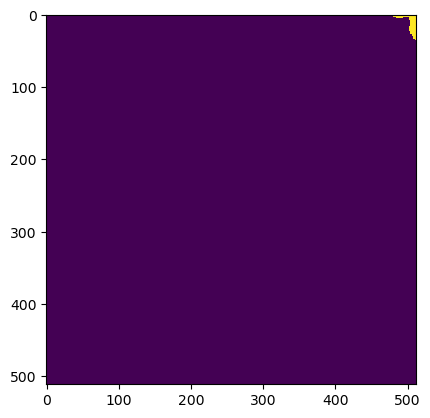

Wrote output/patches/mask/NU_S1_73-456041-6000-6287739-2000.tiff (512 x 512 pixels)


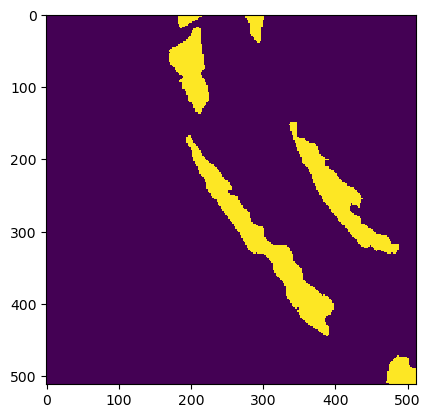

Wrote output/patches/mask/NU_S1_73-456041-6000-6287841-6000.tiff (512 x 512 pixels)


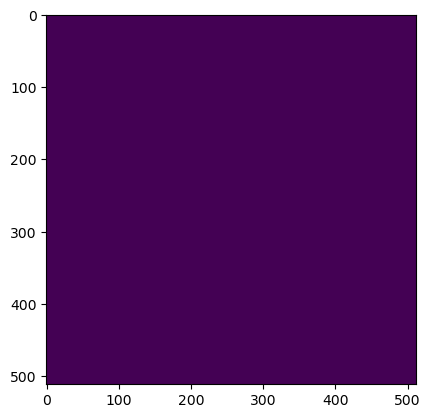

Wrote output/patches/mask/NU_S1_73-456144-0000-6286510-4000.tiff (512 x 512 pixels)


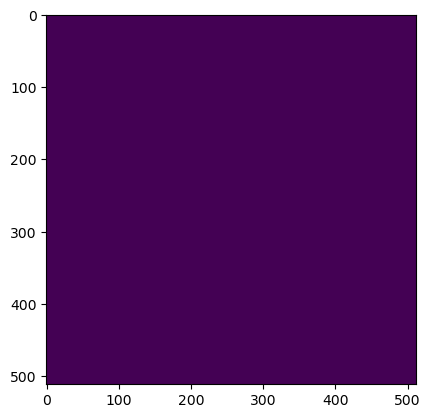

Wrote output/patches/mask/NU_S1_73-456144-0000-6286612-8000.tiff (512 x 512 pixels)


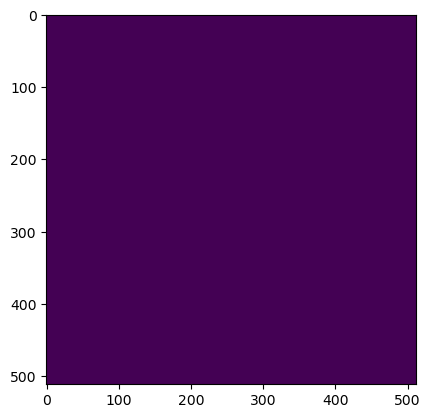

Wrote output/patches/mask/NU_S1_73-456144-0000-6286715-2000.tiff (512 x 512 pixels)


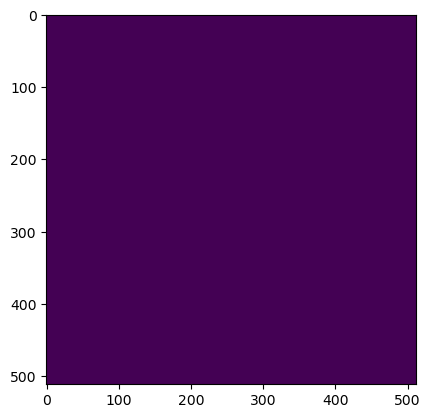

Wrote output/patches/mask/NU_S1_73-456144-0000-6286817-6000.tiff (512 x 512 pixels)


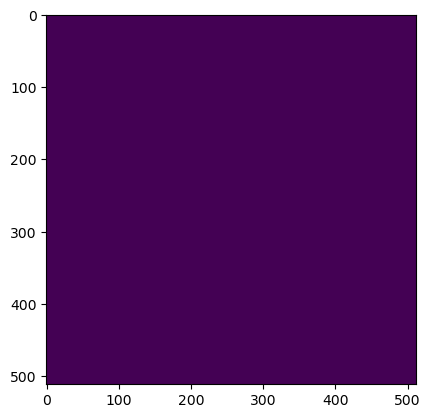

Wrote output/patches/mask/NU_S1_73-456144-0000-6286920-0000.tiff (512 x 512 pixels)


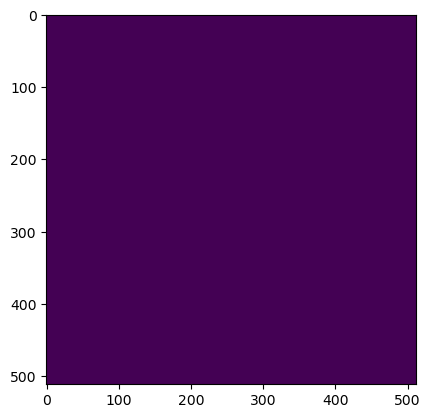

Wrote output/patches/mask/NU_S1_73-456144-0000-6287022-4000.tiff (512 x 512 pixels)


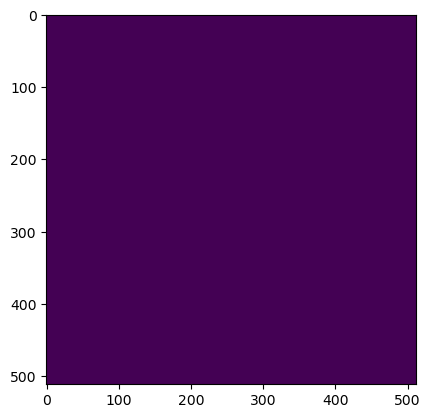

Wrote output/patches/mask/NU_S1_73-456144-0000-6287124-8000.tiff (512 x 512 pixels)


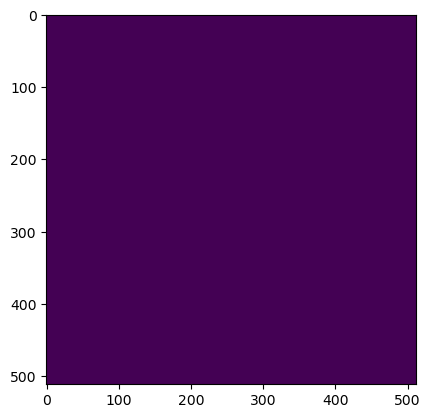

Wrote output/patches/mask/NU_S1_73-456144-0000-6287227-2000.tiff (512 x 512 pixels)


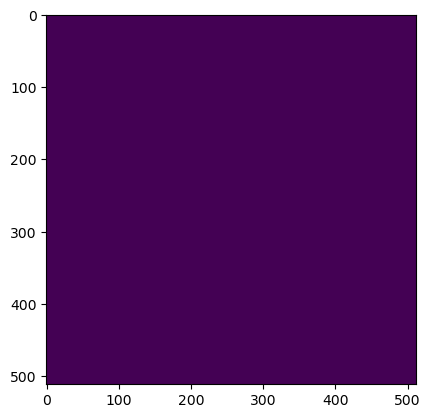

Wrote output/patches/mask/NU_S1_73-456144-0000-6287329-6000.tiff (512 x 512 pixels)


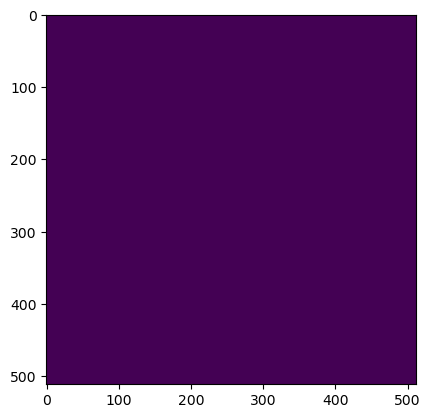

Wrote output/patches/mask/NU_S1_73-456144-0000-6287432-0000.tiff (512 x 512 pixels)


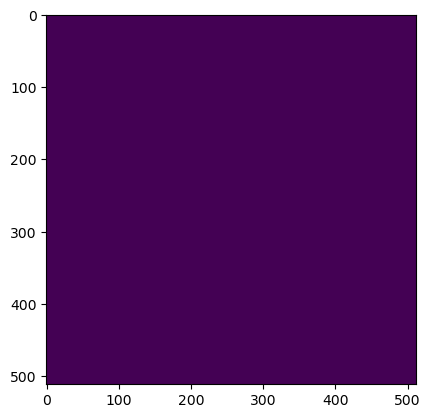

Wrote output/patches/mask/NU_S1_73-456144-0000-6287534-4000.tiff (512 x 512 pixels)


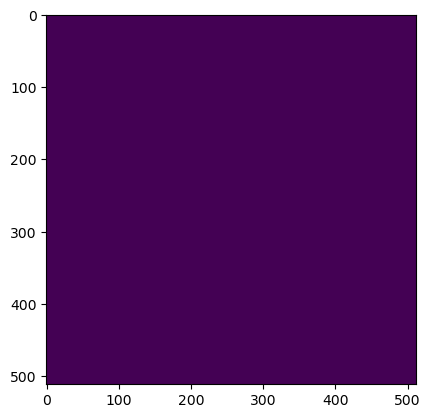

Wrote output/patches/mask/NU_S1_73-456144-0000-6287636-8000.tiff (512 x 512 pixels)


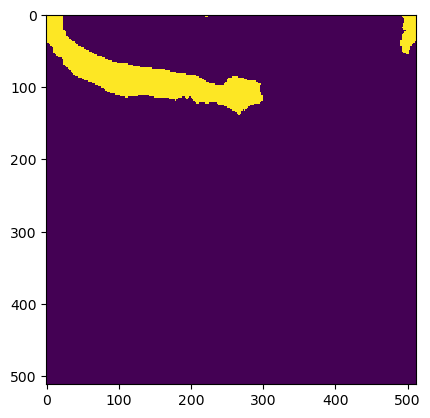

Wrote output/patches/mask/NU_S1_73-456144-0000-6287739-2000.tiff (512 x 512 pixels)


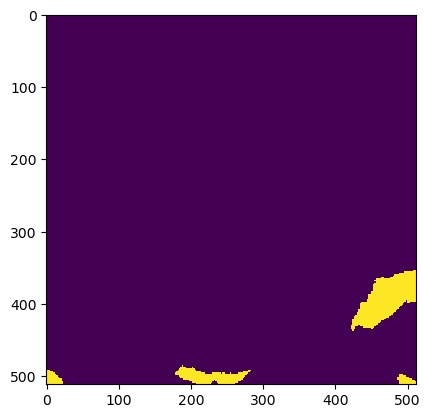

Wrote output/patches/mask/NU_S1_73-456144-0000-6287841-6000.tiff (512 x 512 pixels)


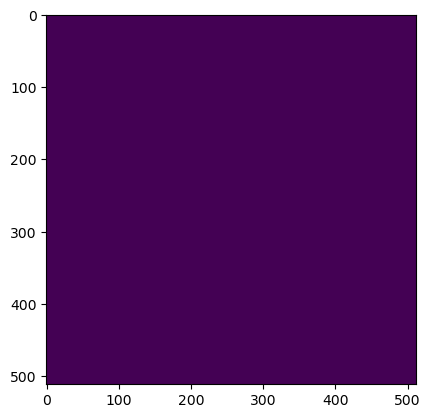

Wrote output/patches/mask/NU_S1_73-456246-4000-6286510-4000.tiff (512 x 512 pixels)


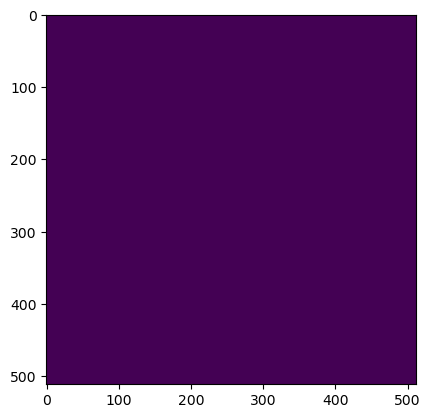

Wrote output/patches/mask/NU_S1_73-456246-4000-6286612-8000.tiff (512 x 512 pixels)


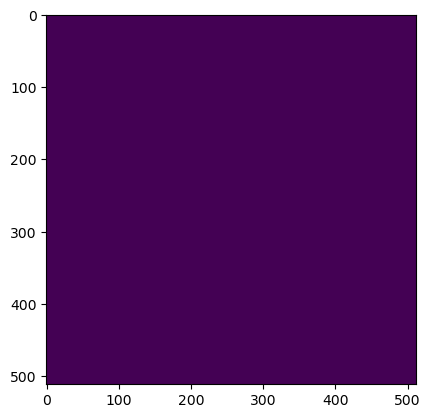

Wrote output/patches/mask/NU_S1_73-456246-4000-6286715-2000.tiff (512 x 512 pixels)


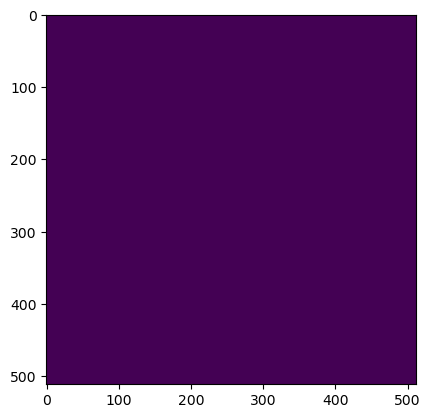

Wrote output/patches/mask/NU_S1_73-456246-4000-6286817-6000.tiff (512 x 512 pixels)


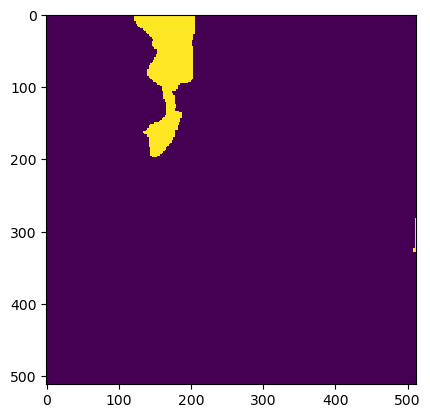

Wrote output/patches/mask/NU_S1_73-456246-4000-6286920-0000.tiff (512 x 512 pixels)


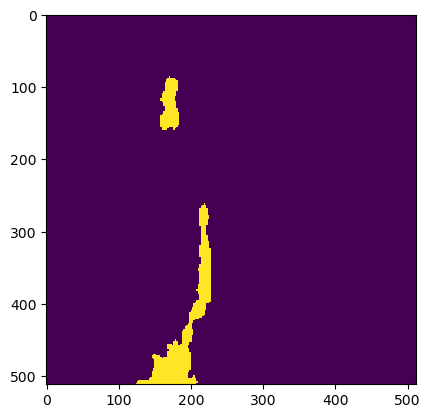

Wrote output/patches/mask/NU_S1_73-456246-4000-6287022-4000.tiff (512 x 512 pixels)


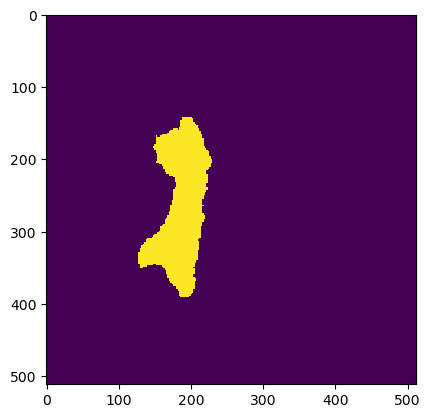

Wrote output/patches/mask/NU_S1_73-456246-4000-6287124-8000.tiff (512 x 512 pixels)


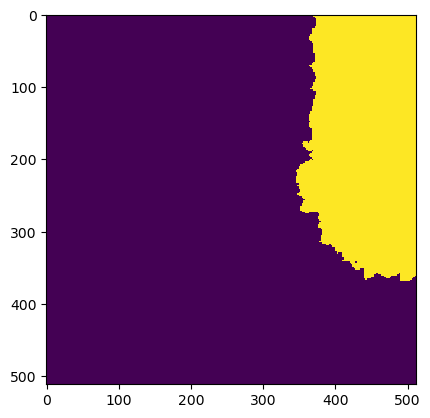

Wrote output/patches/mask/NU_S1_73-456246-4000-6287227-2000.tiff (512 x 512 pixels)


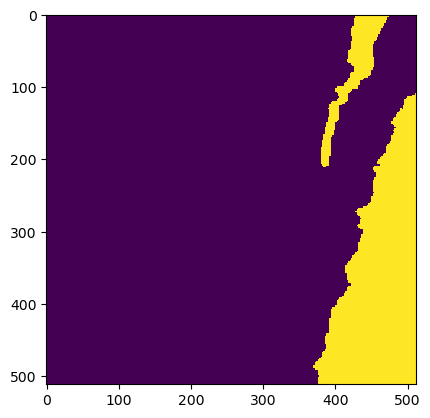

Wrote output/patches/mask/NU_S1_73-456246-4000-6287329-6000.tiff (512 x 512 pixels)


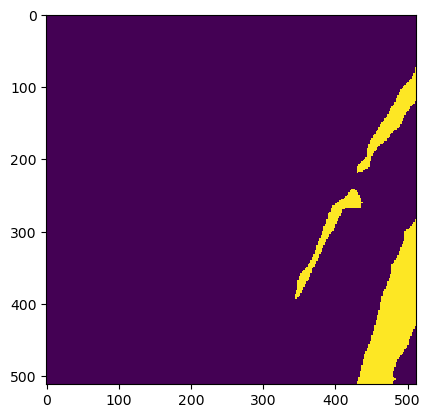

Wrote output/patches/mask/NU_S1_73-456246-4000-6287432-0000.tiff (512 x 512 pixels)


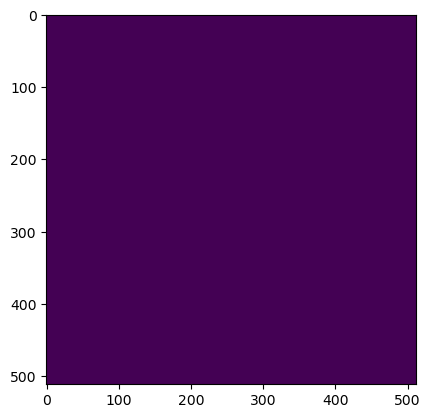

Wrote output/patches/mask/NU_S1_73-456246-4000-6287534-4000.tiff (512 x 512 pixels)


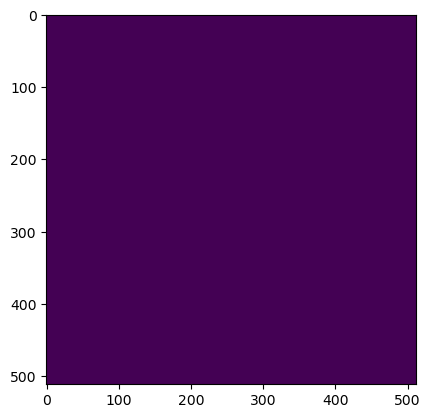

Wrote output/patches/mask/NU_S1_73-456246-4000-6287636-8000.tiff (512 x 512 pixels)


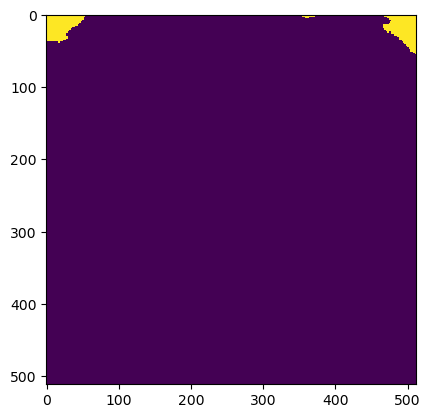

Wrote output/patches/mask/NU_S1_73-456246-4000-6287739-2000.tiff (512 x 512 pixels)


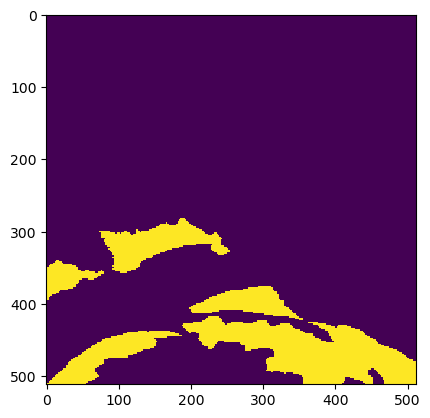

Wrote output/patches/mask/NU_S1_73-456246-4000-6287841-6000.tiff (512 x 512 pixels)


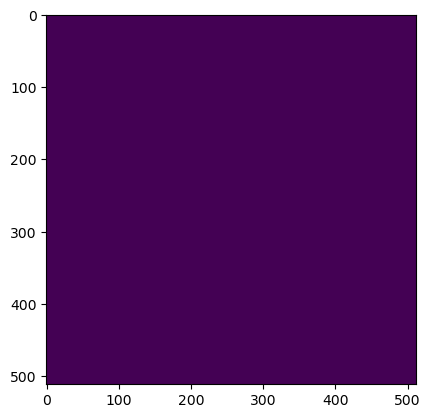

Wrote output/patches/mask/NU_S1_73-456348-8000-6286510-4000.tiff (512 x 512 pixels)


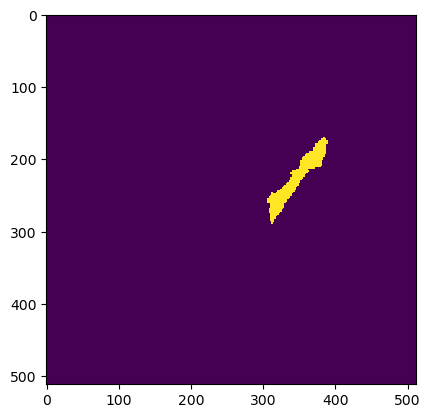

Wrote output/patches/mask/NU_S1_73-456348-8000-6286612-8000.tiff (512 x 512 pixels)


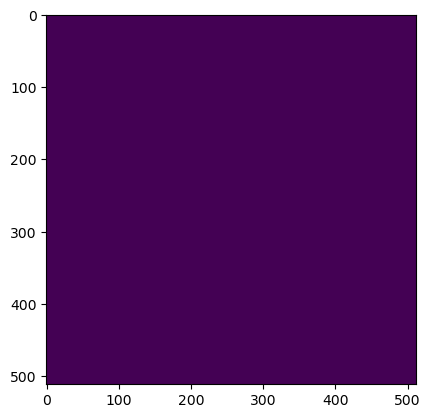

Wrote output/patches/mask/NU_S1_73-456348-8000-6286715-2000.tiff (512 x 512 pixels)


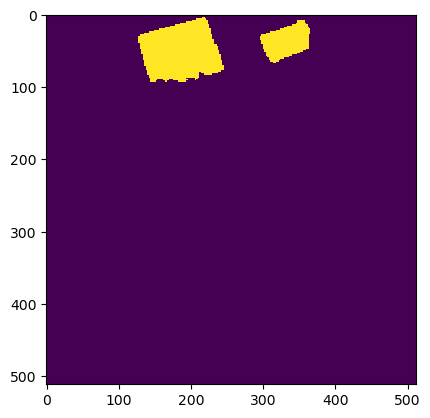

Wrote output/patches/mask/NU_S1_73-456348-8000-6286817-6000.tiff (512 x 512 pixels)


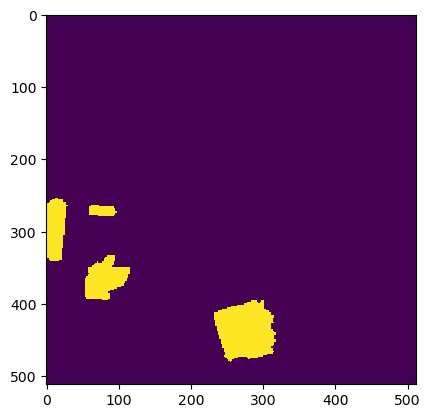

Wrote output/patches/mask/NU_S1_73-456348-8000-6286920-0000.tiff (512 x 512 pixels)


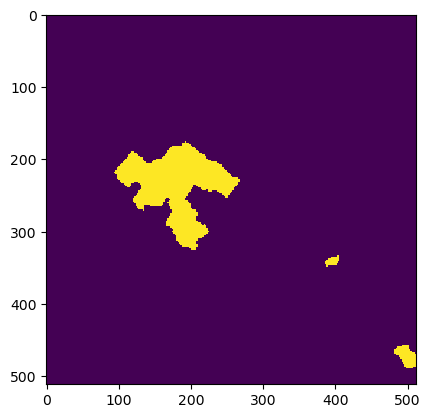

Wrote output/patches/mask/NU_S1_73-456348-8000-6287022-4000.tiff (512 x 512 pixels)


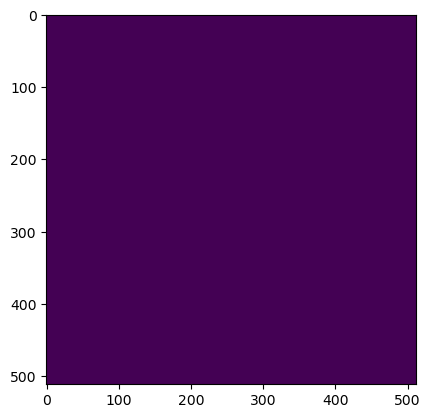

Wrote output/patches/mask/NU_S1_73-456348-8000-6287124-8000.tiff (512 x 512 pixels)


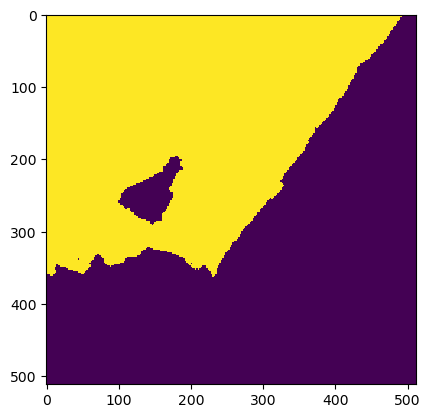

Wrote output/patches/mask/NU_S1_73-456348-8000-6287227-2000.tiff (512 x 512 pixels)


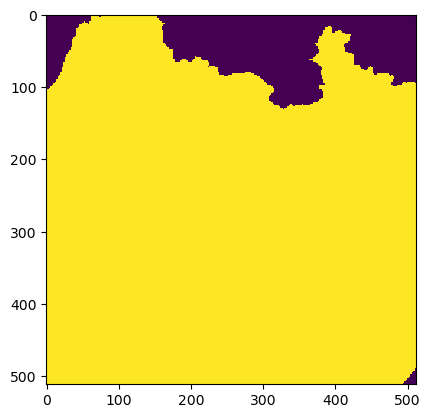

Wrote output/patches/mask/NU_S1_73-456348-8000-6287329-6000.tiff (512 x 512 pixels)


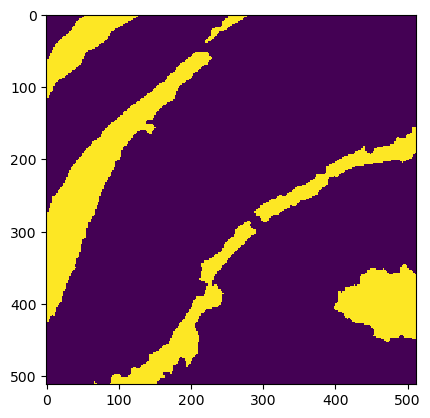

Wrote output/patches/mask/NU_S1_73-456348-8000-6287432-0000.tiff (512 x 512 pixels)


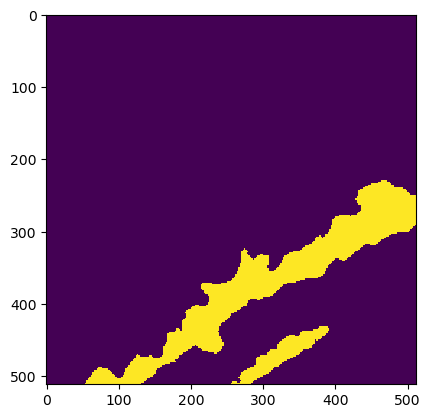

Wrote output/patches/mask/NU_S1_73-456348-8000-6287534-4000.tiff (512 x 512 pixels)


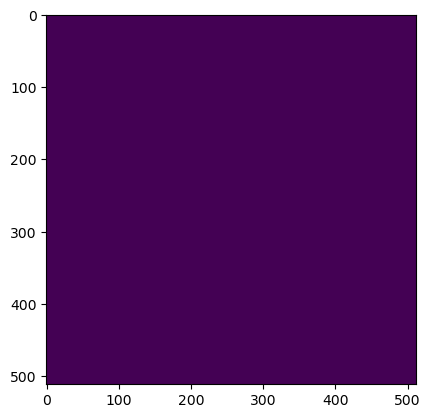

Wrote output/patches/mask/NU_S1_73-456348-8000-6287636-8000.tiff (512 x 512 pixels)


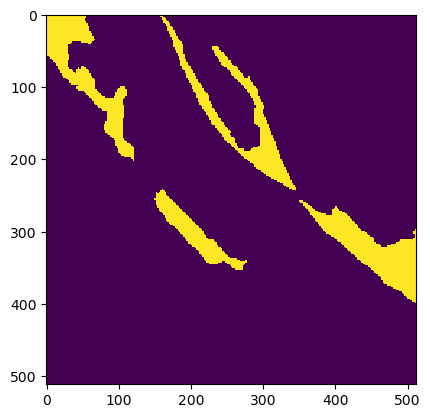

Wrote output/patches/mask/NU_S1_73-456348-8000-6287739-2000.tiff (512 x 512 pixels)


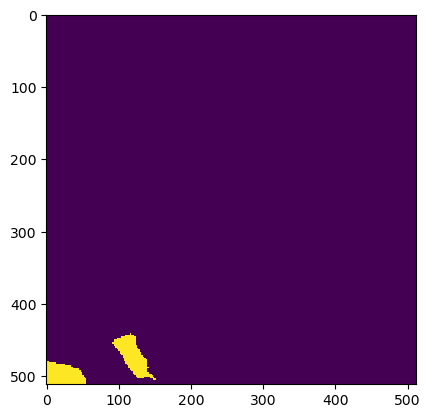

Wrote output/patches/mask/NU_S1_73-456348-8000-6287841-6000.tiff (512 x 512 pixels)


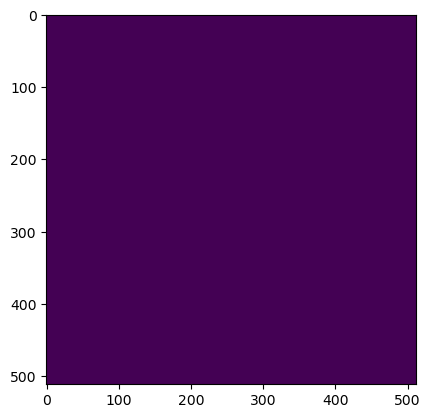

Wrote output/patches/mask/NU_S1_73-456451-2000-6286510-4000.tiff (512 x 512 pixels)


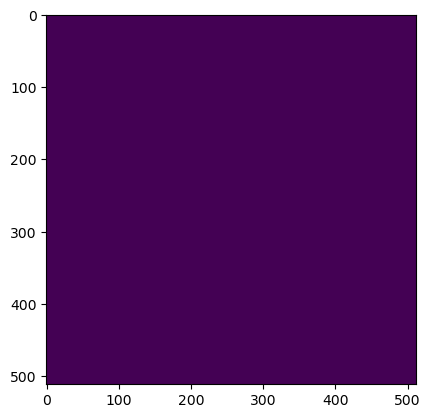

Wrote output/patches/mask/NU_S1_73-456451-2000-6286612-8000.tiff (512 x 512 pixels)


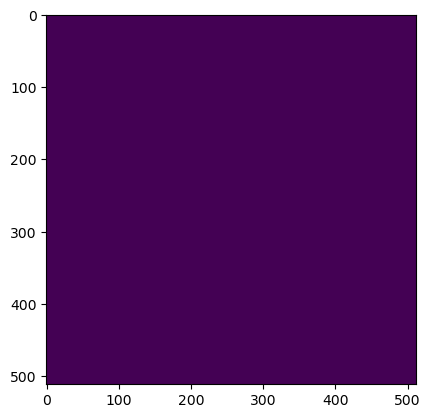

Wrote output/patches/mask/NU_S1_73-456451-2000-6286715-2000.tiff (512 x 512 pixels)


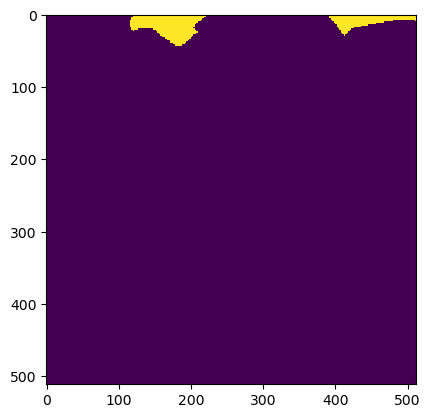

Wrote output/patches/mask/NU_S1_73-456451-2000-6286817-6000.tiff (512 x 512 pixels)


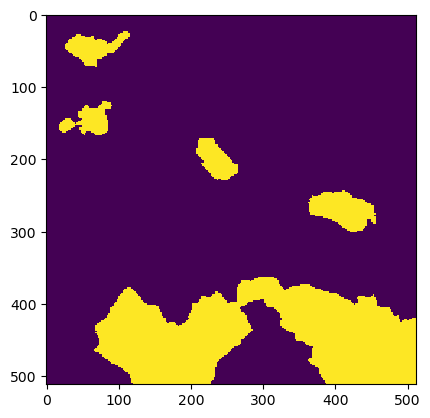

Wrote output/patches/mask/NU_S1_73-456451-2000-6286920-0000.tiff (512 x 512 pixels)


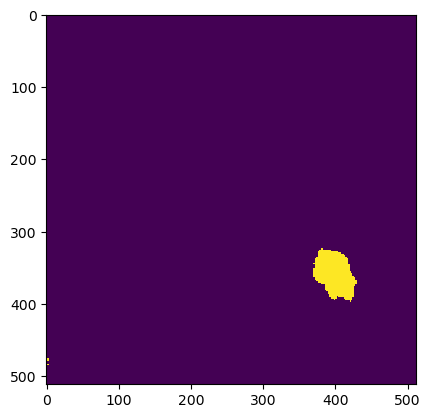

Wrote output/patches/mask/NU_S1_73-456451-2000-6287022-4000.tiff (512 x 512 pixels)


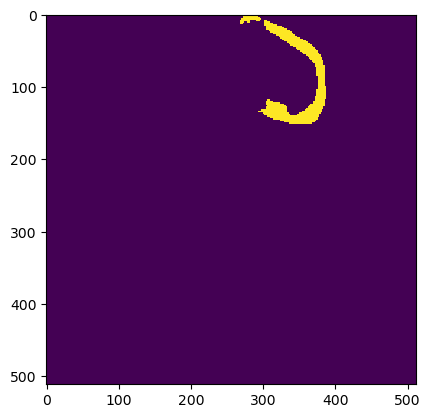

Wrote output/patches/mask/NU_S1_73-456451-2000-6287124-8000.tiff (512 x 512 pixels)


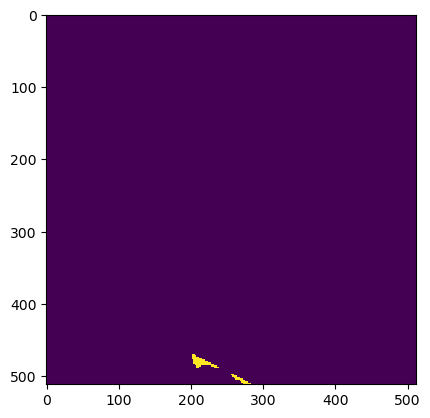

Wrote output/patches/mask/NU_S1_73-456451-2000-6287227-2000.tiff (512 x 512 pixels)


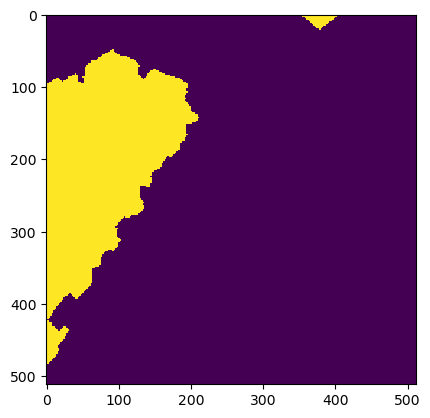

Wrote output/patches/mask/NU_S1_73-456451-2000-6287329-6000.tiff (512 x 512 pixels)


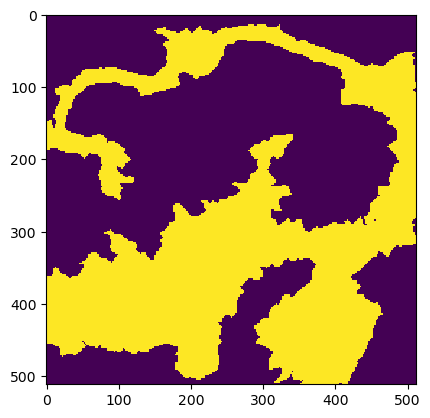

Wrote output/patches/mask/NU_S1_73-456451-2000-6287432-0000.tiff (512 x 512 pixels)


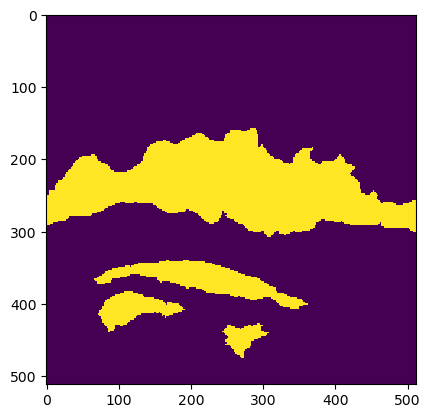

Wrote output/patches/mask/NU_S1_73-456451-2000-6287534-4000.tiff (512 x 512 pixels)


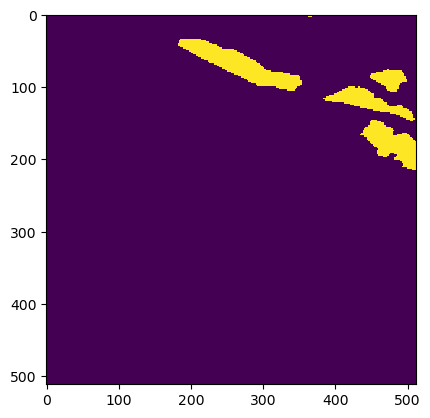

Wrote output/patches/mask/NU_S1_73-456451-2000-6287636-8000.tiff (512 x 512 pixels)


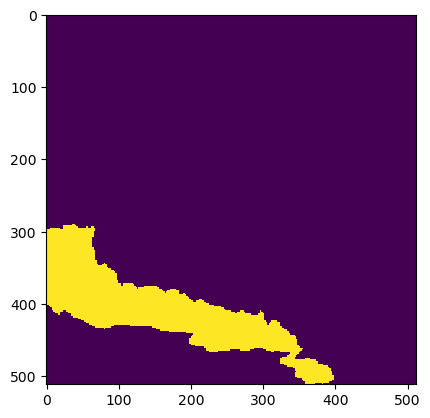

Wrote output/patches/mask/NU_S1_73-456451-2000-6287739-2000.tiff (512 x 512 pixels)


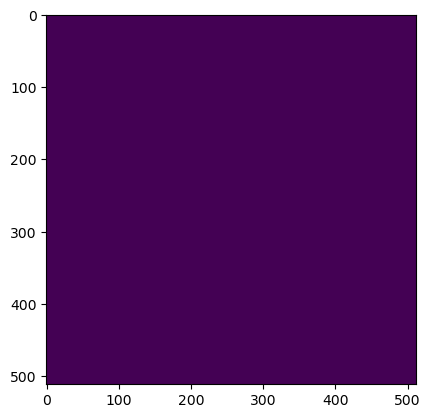

Wrote output/patches/mask/NU_S1_73-456451-2000-6287841-6000.tiff (512 x 512 pixels)
Zone UC_S1_74 Building Mask...


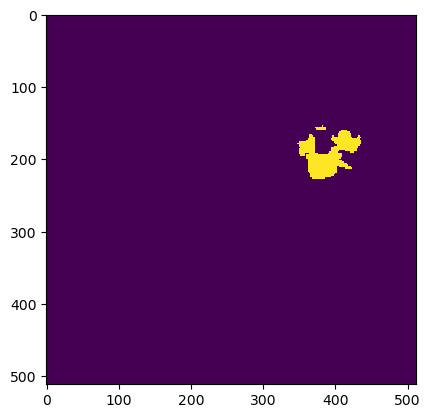

Wrote output/patches/mask/UC_S1_74-541392-0000-6286510-4000.tiff (512 x 512 pixels)


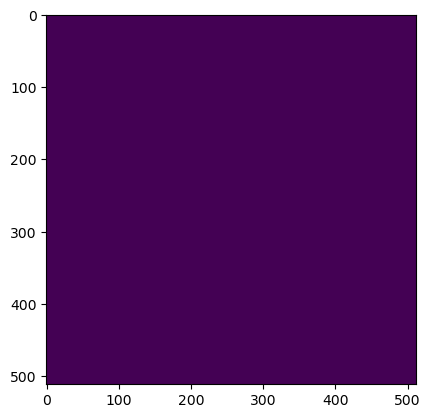

Wrote output/patches/mask/UC_S1_74-541392-0000-6286612-8000.tiff (512 x 512 pixels)


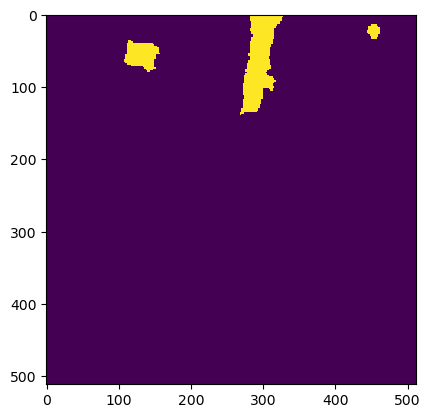

Wrote output/patches/mask/UC_S1_74-541494-4000-6286510-4000.tiff (512 x 512 pixels)


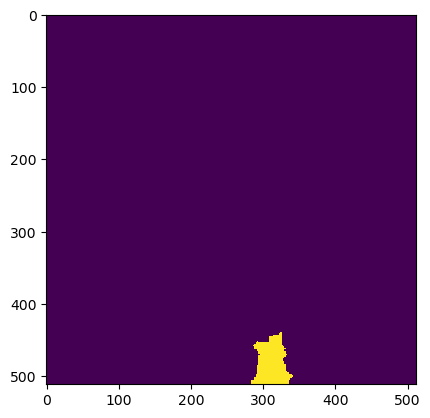

Wrote output/patches/mask/UC_S1_74-541494-4000-6286612-8000.tiff (512 x 512 pixels)
Zone CU_S1_75 Building Mask...


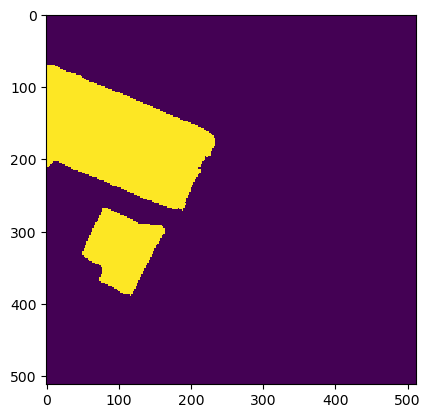

Wrote output/patches/mask/CU_S1_75-436176-0000-6286766-4000.tiff (512 x 512 pixels)


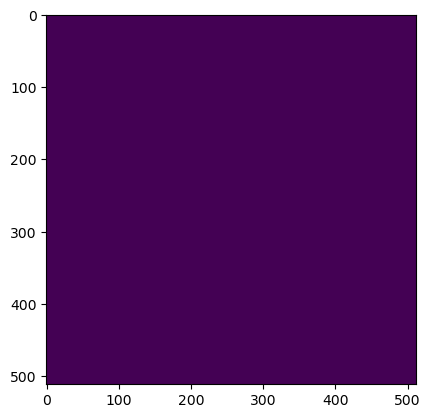

Wrote output/patches/mask/CU_S1_75-436176-0000-6286868-8000.tiff (512 x 512 pixels)


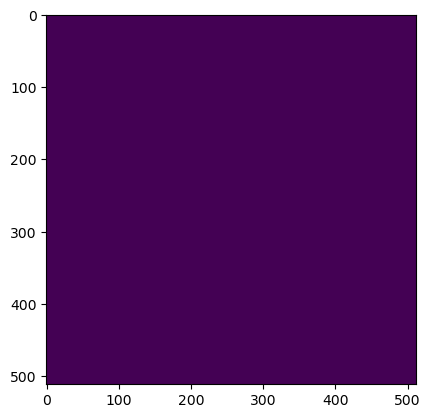

Wrote output/patches/mask/CU_S1_75-436278-4000-6286766-4000.tiff (512 x 512 pixels)


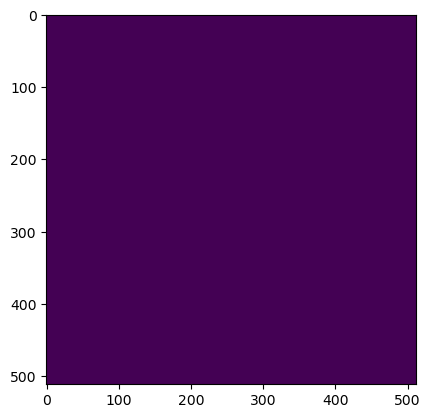

Wrote output/patches/mask/CU_S1_75-436278-4000-6286868-8000.tiff (512 x 512 pixels)
Zone UN_S1_76 Building Mask...


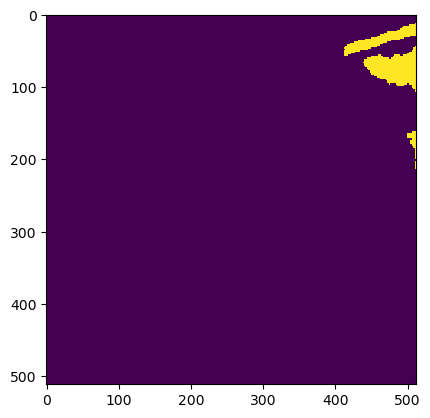

Wrote output/patches/mask/UN_S1_76-445136-0000-6286766-4000.tiff (512 x 512 pixels)


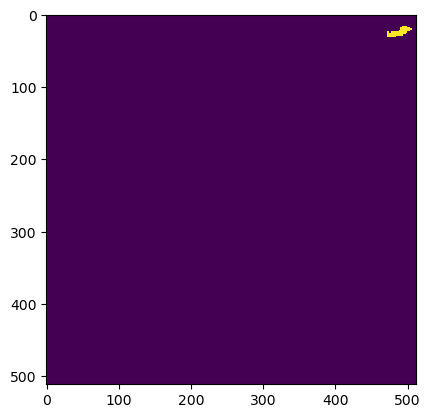

Wrote output/patches/mask/UN_S1_76-445136-0000-6286868-8000.tiff (512 x 512 pixels)


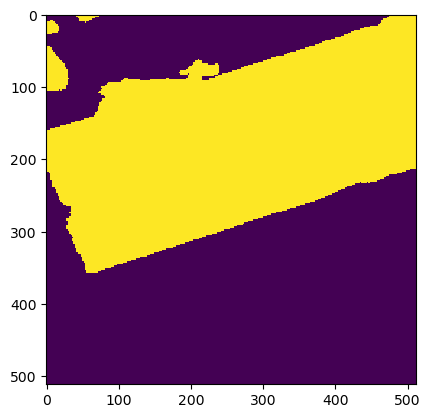

Wrote output/patches/mask/UN_S1_76-445238-4000-6286766-4000.tiff (512 x 512 pixels)


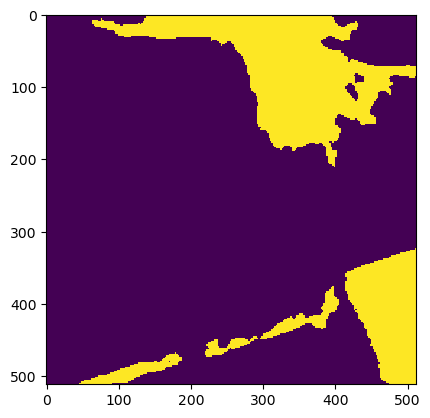

Wrote output/patches/mask/UN_S1_76-445238-4000-6286868-8000.tiff (512 x 512 pixels)


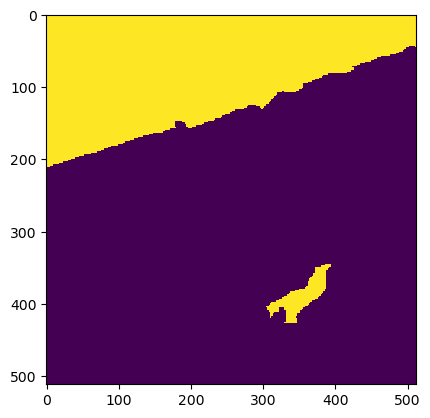

Wrote output/patches/mask/UN_S1_76-445340-8000-6286766-4000.tiff (512 x 512 pixels)


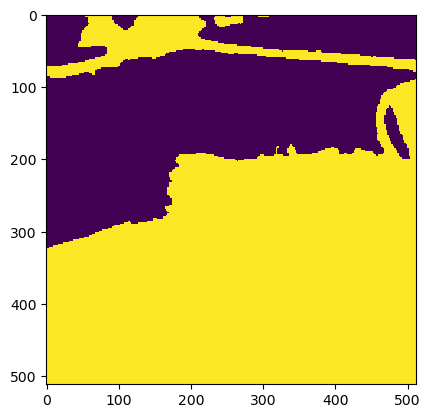

Wrote output/patches/mask/UN_S1_76-445340-8000-6286868-8000.tiff (512 x 512 pixels)


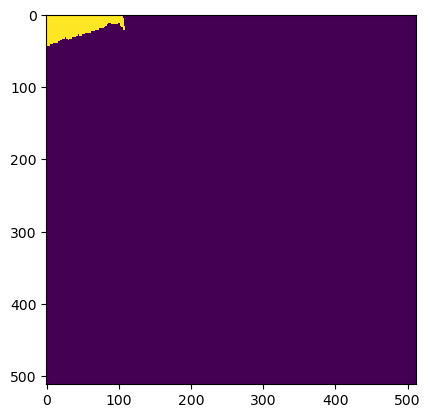

Wrote output/patches/mask/UN_S1_76-445443-2000-6286766-4000.tiff (512 x 512 pixels)


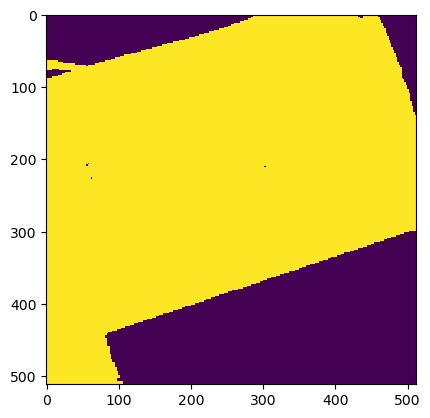

Wrote output/patches/mask/UN_S1_76-445443-2000-6286868-8000.tiff (512 x 512 pixels)
Zone UV_S1_77 Building Mask...


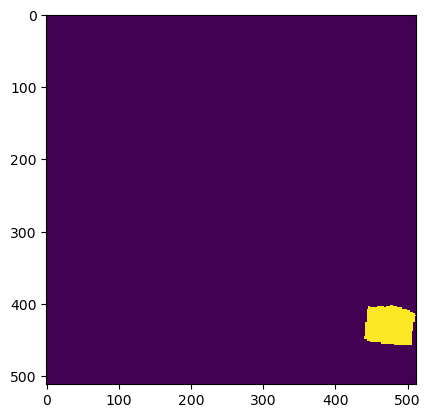

Wrote output/patches/mask/UV_S1_77-507344-0000-6287022-4000.tiff (512 x 512 pixels)


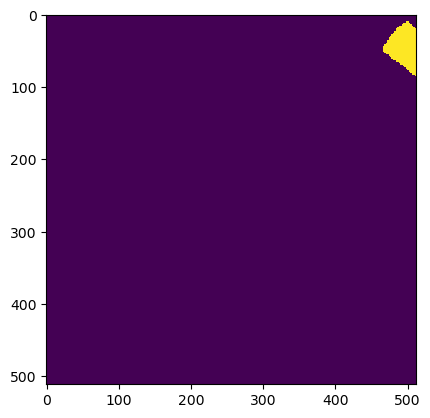

Wrote output/patches/mask/UV_S1_77-507344-0000-6287124-8000.tiff (512 x 512 pixels)


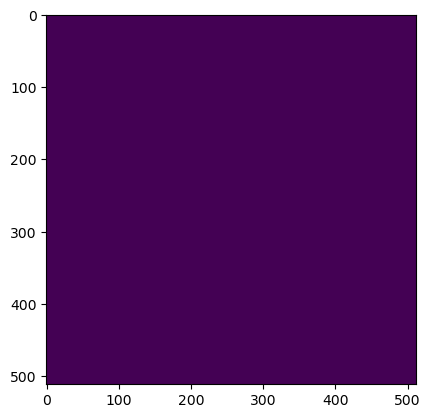

Wrote output/patches/mask/UV_S1_77-507446-4000-6287022-4000.tiff (512 x 512 pixels)


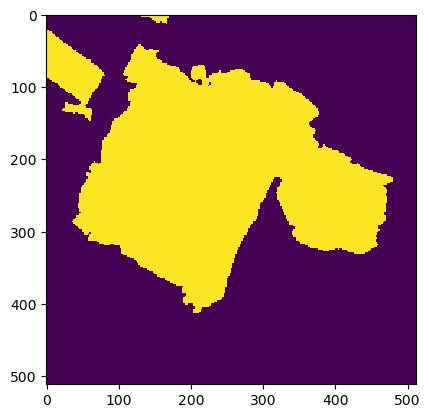

Wrote output/patches/mask/UV_S1_77-507446-4000-6287124-8000.tiff (512 x 512 pixels)
Zone CU_S1_78 Building Mask...


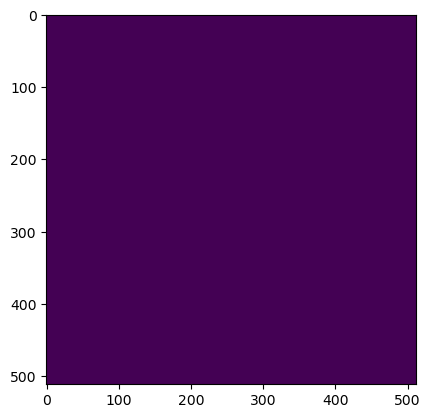

Wrote output/patches/mask/CU_S1_78-448976-0000-6287022-4000.tiff (512 x 512 pixels)


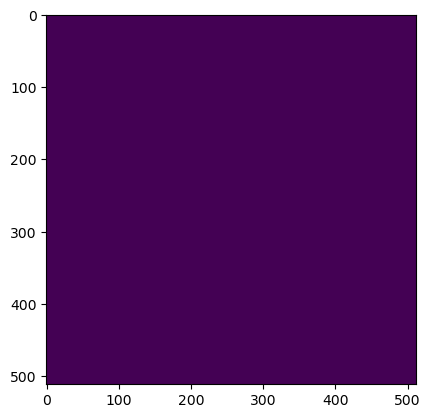

Wrote output/patches/mask/CU_S1_78-448976-0000-6287124-8000.tiff (512 x 512 pixels)


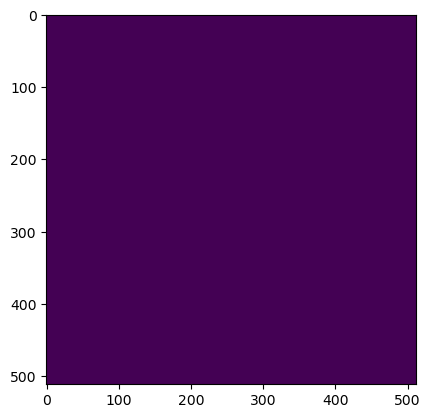

Wrote output/patches/mask/CU_S1_78-448976-0000-6287227-2000.tiff (512 x 512 pixels)


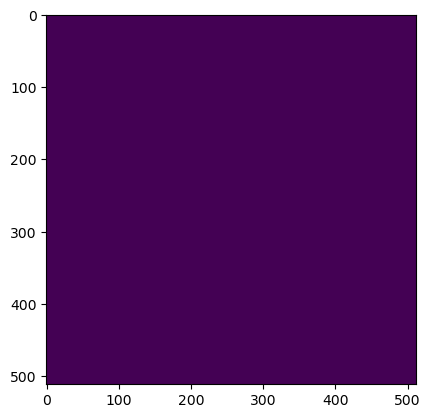

Wrote output/patches/mask/CU_S1_78-448976-0000-6287329-6000.tiff (512 x 512 pixels)


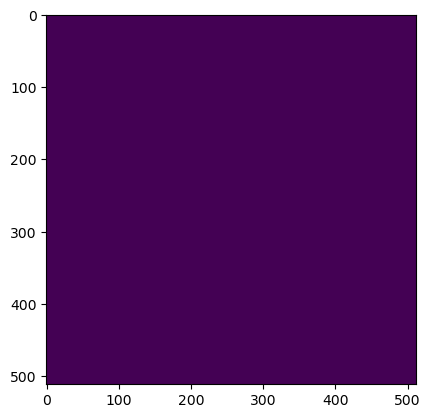

Wrote output/patches/mask/CU_S1_78-449078-4000-6287022-4000.tiff (512 x 512 pixels)


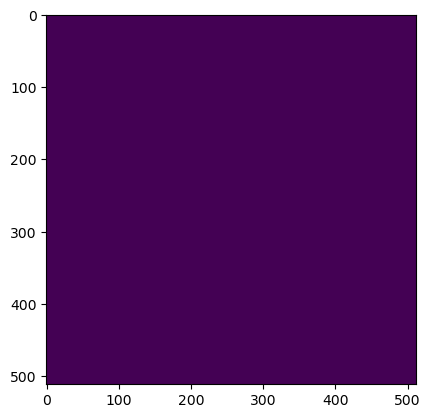

Wrote output/patches/mask/CU_S1_78-449078-4000-6287124-8000.tiff (512 x 512 pixels)


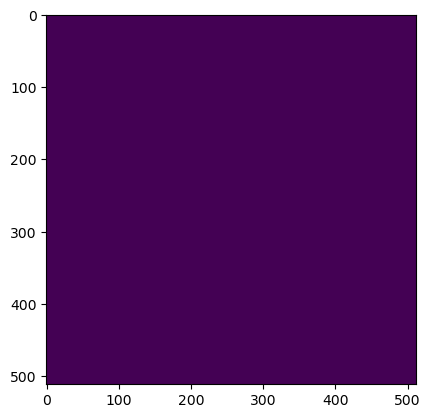

Wrote output/patches/mask/CU_S1_78-449078-4000-6287227-2000.tiff (512 x 512 pixels)


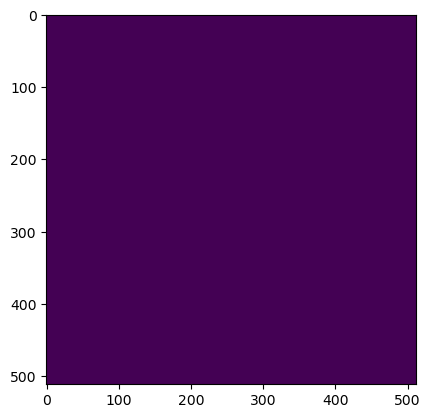

Wrote output/patches/mask/CU_S1_78-449078-4000-6287329-6000.tiff (512 x 512 pixels)


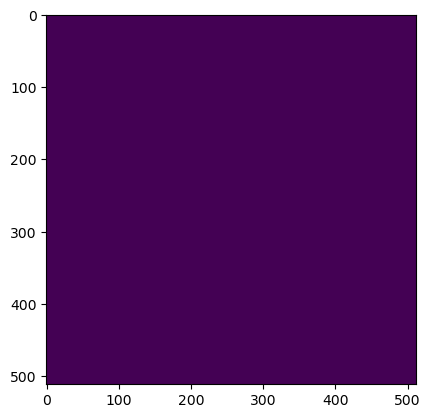

Wrote output/patches/mask/CU_S1_78-449180-8000-6287022-4000.tiff (512 x 512 pixels)


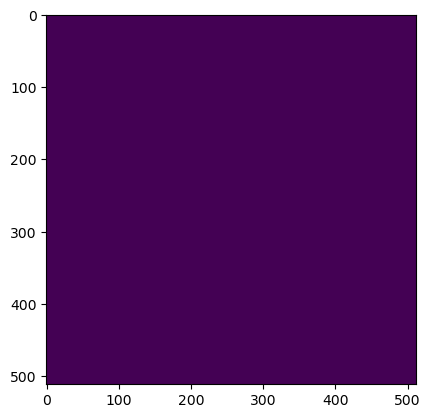

Wrote output/patches/mask/CU_S1_78-449180-8000-6287124-8000.tiff (512 x 512 pixels)


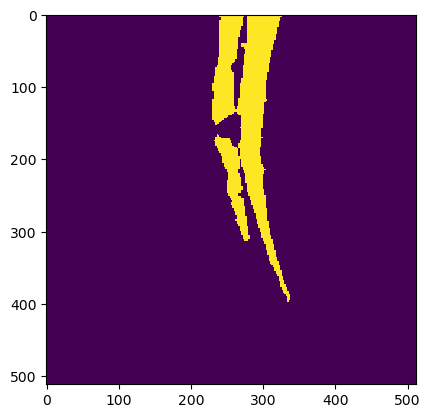

Wrote output/patches/mask/CU_S1_78-449180-8000-6287227-2000.tiff (512 x 512 pixels)


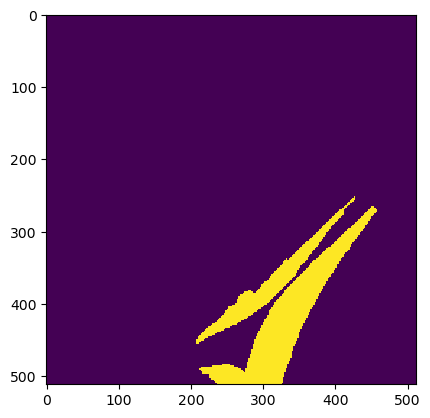

Wrote output/patches/mask/CU_S1_78-449180-8000-6287329-6000.tiff (512 x 512 pixels)


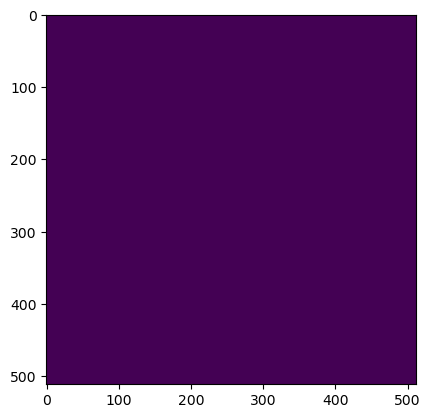

Wrote output/patches/mask/CU_S1_78-449283-2000-6287022-4000.tiff (512 x 512 pixels)


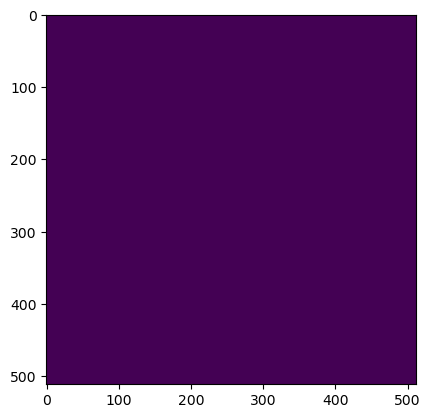

Wrote output/patches/mask/CU_S1_78-449283-2000-6287124-8000.tiff (512 x 512 pixels)


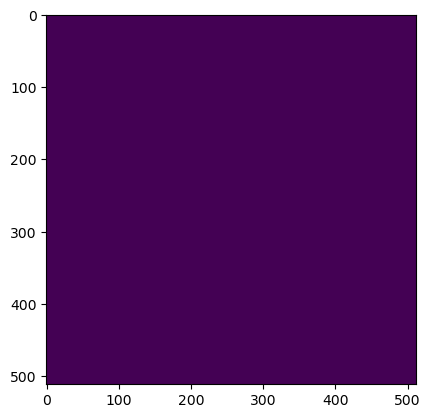

Wrote output/patches/mask/CU_S1_78-449283-2000-6287227-2000.tiff (512 x 512 pixels)


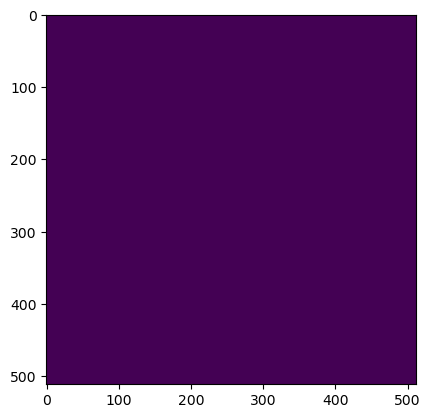

Wrote output/patches/mask/CU_S1_78-449283-2000-6287329-6000.tiff (512 x 512 pixels)
Zone CU_S1_79 Building Mask...


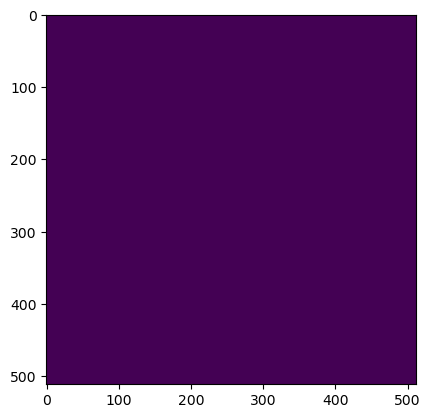

Wrote output/patches/mask/CU_S1_79-437200-0000-6287022-4000.tiff (512 x 512 pixels)


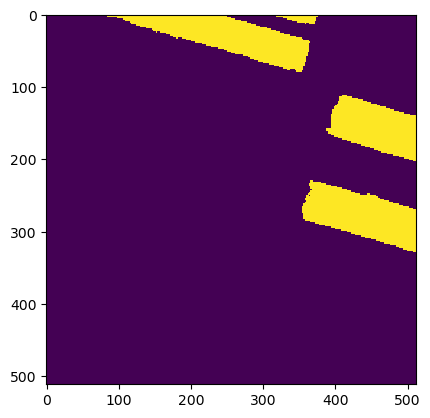

Wrote output/patches/mask/CU_S1_79-437200-0000-6287124-8000.tiff (512 x 512 pixels)


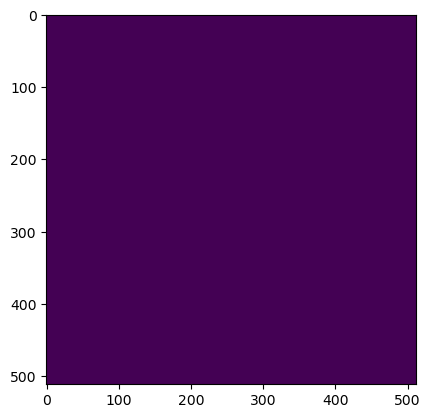

Wrote output/patches/mask/CU_S1_79-437302-4000-6287022-4000.tiff (512 x 512 pixels)


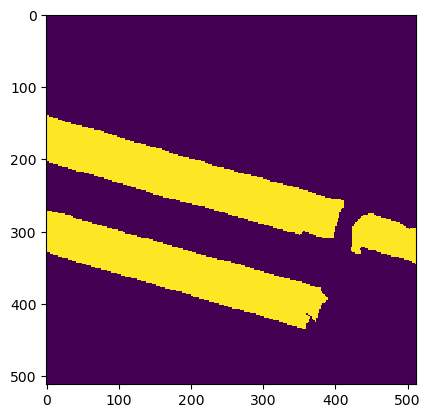

Wrote output/patches/mask/CU_S1_79-437302-4000-6287124-8000.tiff (512 x 512 pixels)
Zone UU_S1_80 Building Mask...


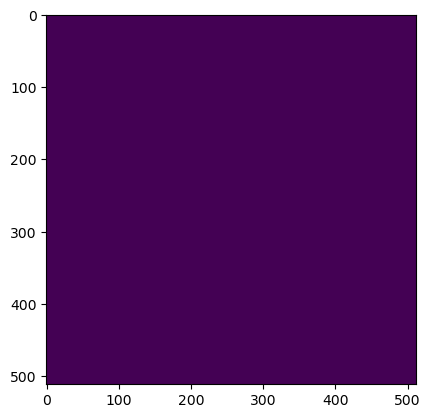

Wrote output/patches/mask/UU_S1_80-505552-0000-6287022-4000.tiff (512 x 512 pixels)


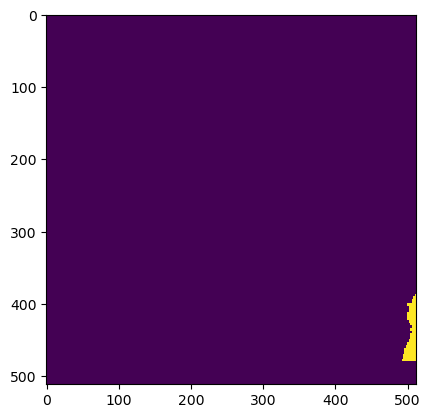

Wrote output/patches/mask/UU_S1_80-505552-0000-6287124-8000.tiff (512 x 512 pixels)


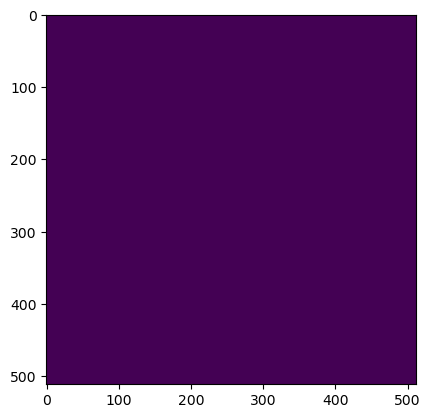

Wrote output/patches/mask/UU_S1_80-505654-4000-6287022-4000.tiff (512 x 512 pixels)


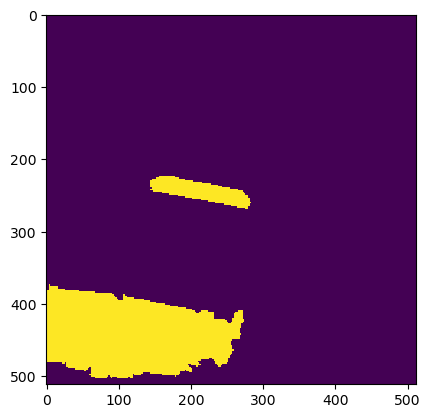

Wrote output/patches/mask/UU_S1_80-505654-4000-6287124-8000.tiff (512 x 512 pixels)
Zone UU_S1_81 Building Mask...


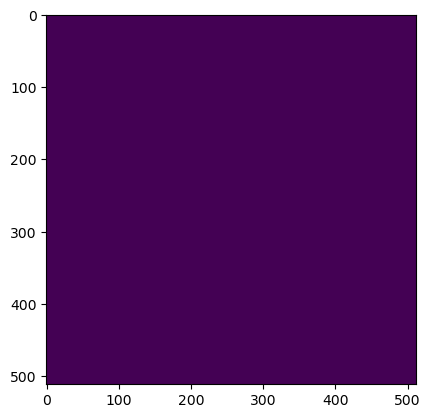

Wrote output/patches/mask/UU_S1_81-503248-0000-6287022-4000.tiff (512 x 512 pixels)


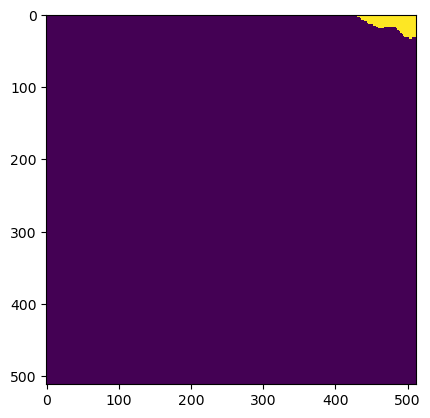

Wrote output/patches/mask/UU_S1_81-503248-0000-6287124-8000.tiff (512 x 512 pixels)


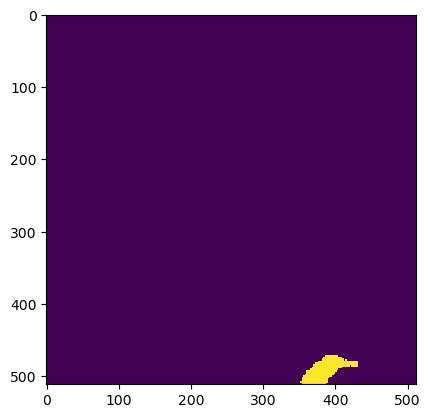

Wrote output/patches/mask/UU_S1_81-503350-4000-6287022-4000.tiff (512 x 512 pixels)


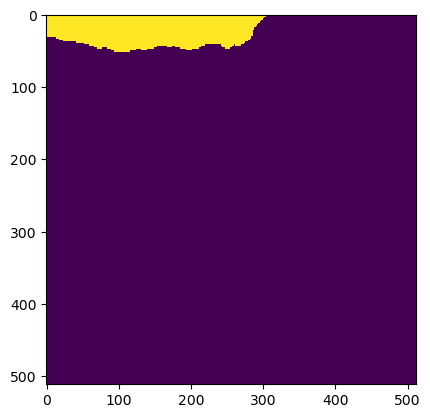

Wrote output/patches/mask/UU_S1_81-503350-4000-6287124-8000.tiff (512 x 512 pixels)


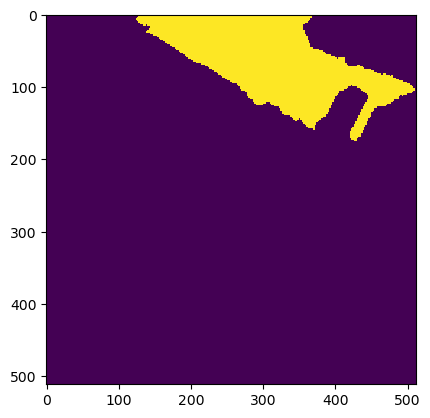

Wrote output/patches/mask/UU_S1_81-503452-8000-6287022-4000.tiff (512 x 512 pixels)


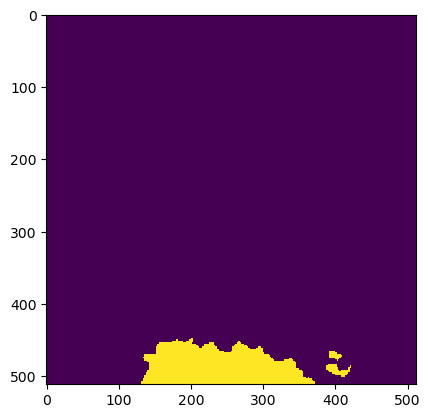

Wrote output/patches/mask/UU_S1_81-503452-8000-6287124-8000.tiff (512 x 512 pixels)


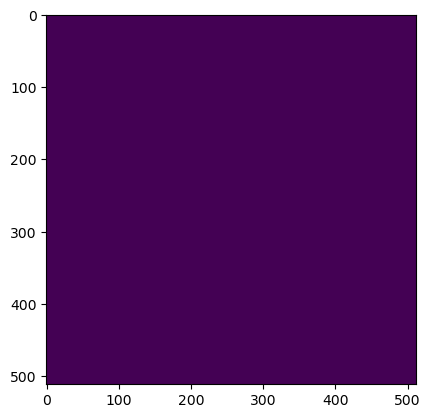

Wrote output/patches/mask/UU_S1_81-503555-2000-6287022-4000.tiff (512 x 512 pixels)


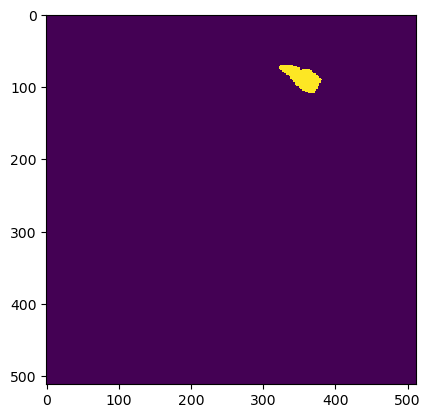

Wrote output/patches/mask/UU_S1_81-503555-2000-6287124-8000.tiff (512 x 512 pixels)
Zone UU_S1_82 Building Mask...


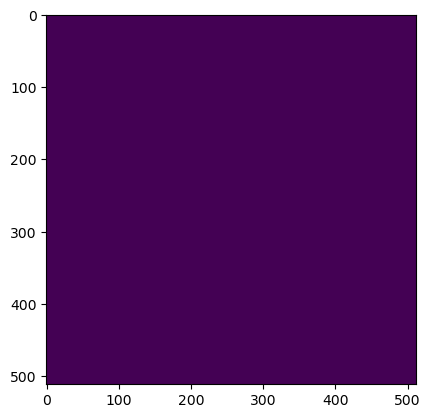

Wrote output/patches/mask/UU_S1_82-502992-0000-6287790-4000.tiff (512 x 512 pixels)


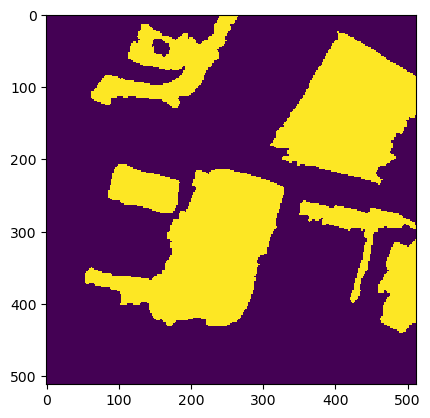

Wrote output/patches/mask/UU_S1_82-502992-0000-6287892-8000.tiff (512 x 512 pixels)


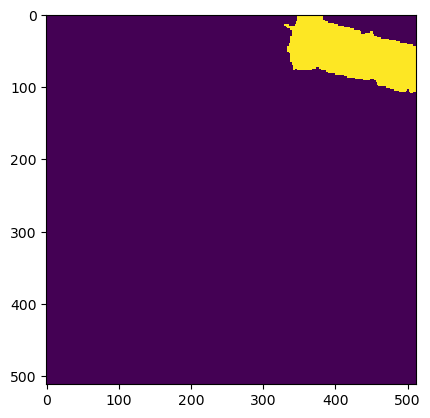

Wrote output/patches/mask/UU_S1_82-503094-4000-6287790-4000.tiff (512 x 512 pixels)


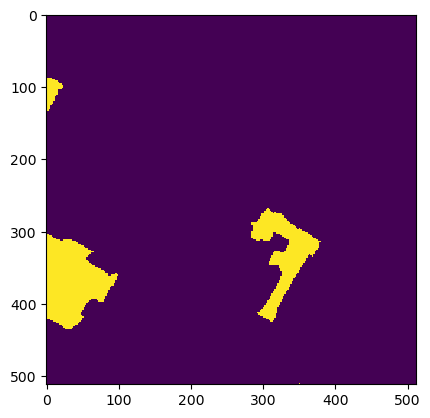

Wrote output/patches/mask/UU_S1_82-503094-4000-6287892-8000.tiff (512 x 512 pixels)
Zone UU_S1_83 Building Mask...


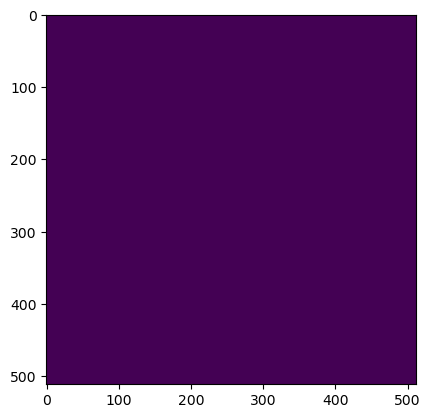

Wrote output/patches/mask/UU_S1_83-507088-0000-6287790-4000.tiff (512 x 512 pixels)


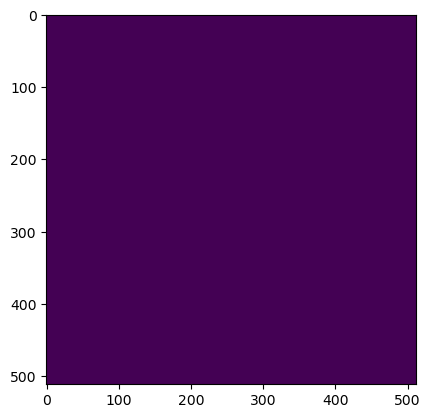

Wrote output/patches/mask/UU_S1_83-507088-0000-6287892-8000.tiff (512 x 512 pixels)


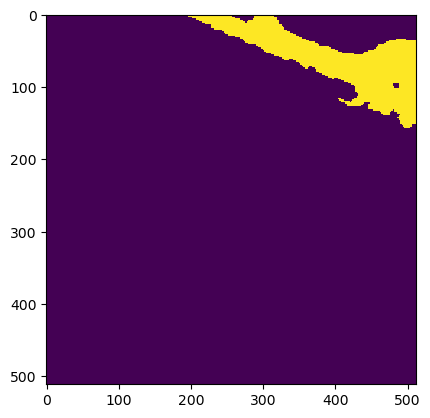

Wrote output/patches/mask/UU_S1_83-507088-0000-6287995-2000.tiff (512 x 512 pixels)


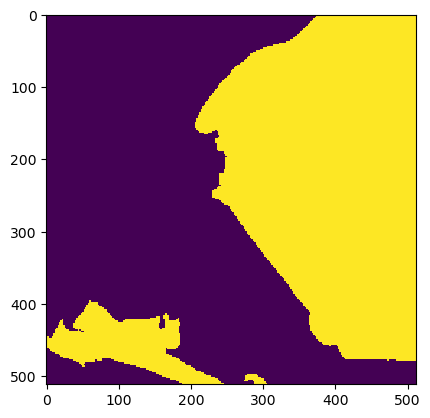

Wrote output/patches/mask/UU_S1_83-507088-0000-6288097-6000.tiff (512 x 512 pixels)


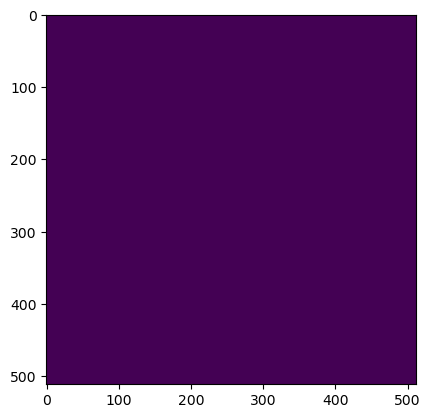

Wrote output/patches/mask/UU_S1_83-507190-4000-6287790-4000.tiff (512 x 512 pixels)


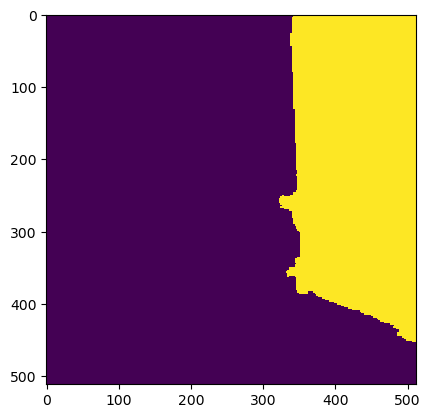

Wrote output/patches/mask/UU_S1_83-507190-4000-6287892-8000.tiff (512 x 512 pixels)


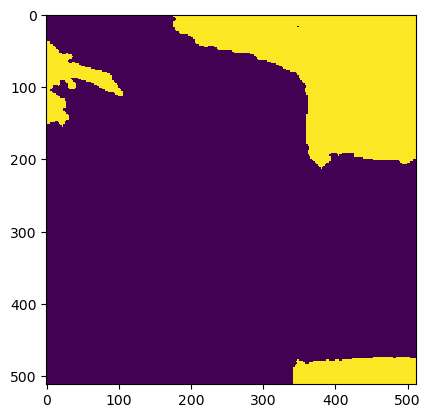

Wrote output/patches/mask/UU_S1_83-507190-4000-6287995-2000.tiff (512 x 512 pixels)


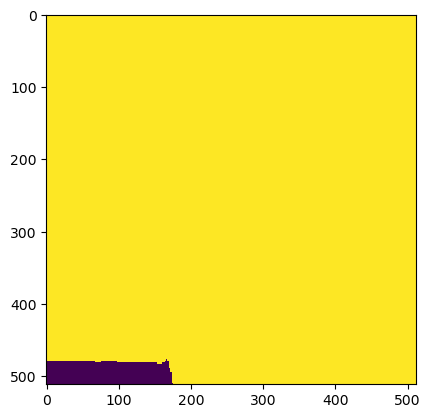

Wrote output/patches/mask/UU_S1_83-507190-4000-6288097-6000.tiff (512 x 512 pixels)


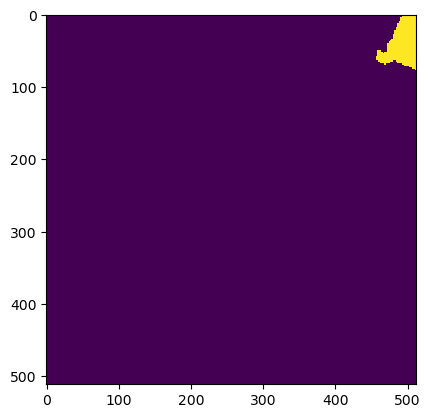

Wrote output/patches/mask/UU_S1_83-507292-8000-6287790-4000.tiff (512 x 512 pixels)


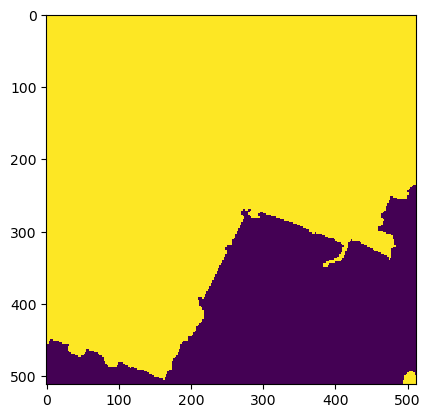

Wrote output/patches/mask/UU_S1_83-507292-8000-6287892-8000.tiff (512 x 512 pixels)


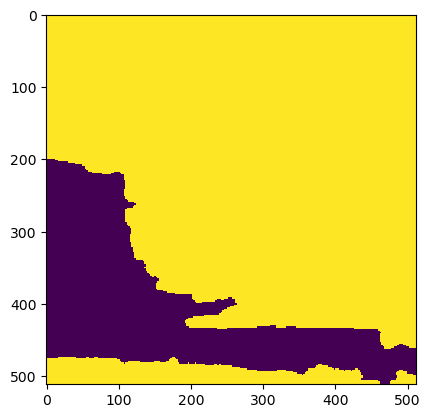

Wrote output/patches/mask/UU_S1_83-507292-8000-6287995-2000.tiff (512 x 512 pixels)


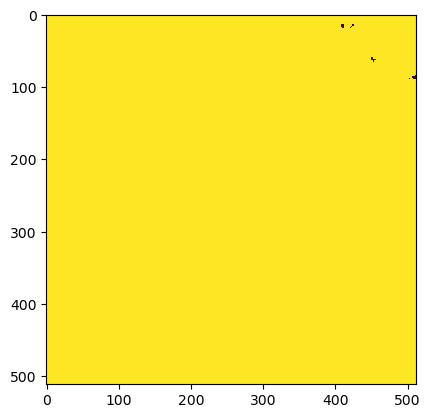

Wrote output/patches/mask/UU_S1_83-507292-8000-6288097-6000.tiff (512 x 512 pixels)


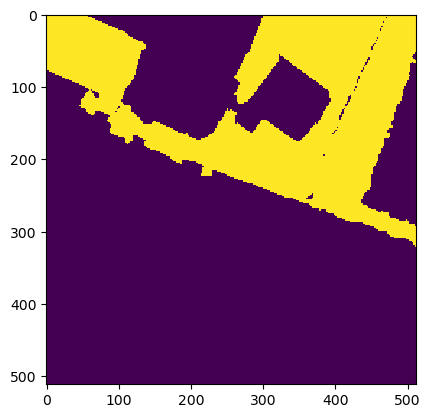

Wrote output/patches/mask/UU_S1_83-507395-2000-6287790-4000.tiff (512 x 512 pixels)


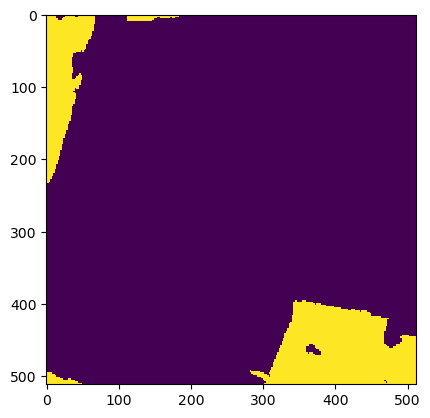

Wrote output/patches/mask/UU_S1_83-507395-2000-6287892-8000.tiff (512 x 512 pixels)


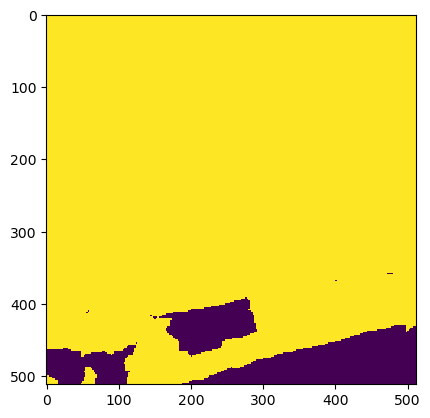

Wrote output/patches/mask/UU_S1_83-507395-2000-6287995-2000.tiff (512 x 512 pixels)


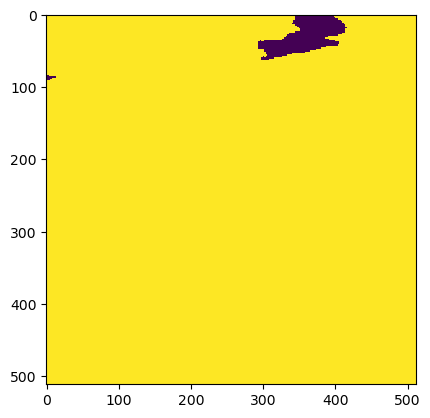

Wrote output/patches/mask/UU_S1_83-507395-2000-6288097-6000.tiff (512 x 512 pixels)


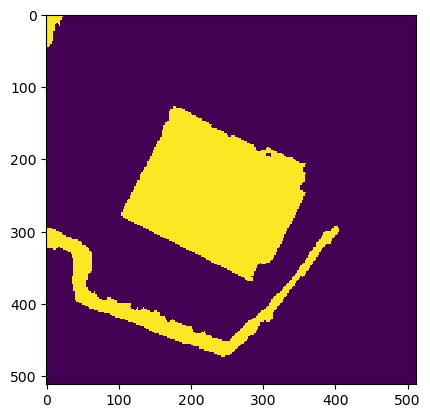

Wrote output/patches/mask/UU_S1_83-507497-6000-6287790-4000.tiff (512 x 512 pixels)


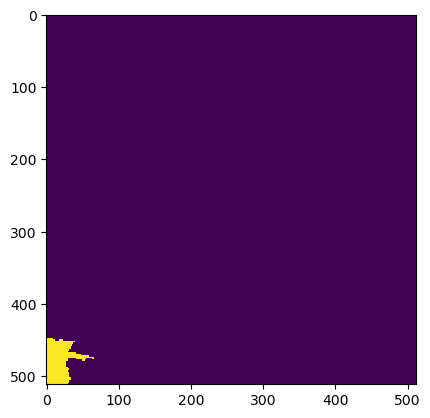

Wrote output/patches/mask/UU_S1_83-507497-6000-6287892-8000.tiff (512 x 512 pixels)


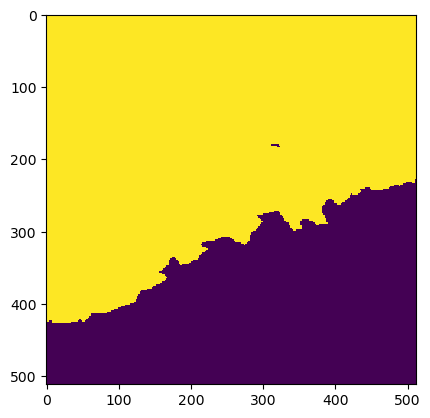

Wrote output/patches/mask/UU_S1_83-507497-6000-6287995-2000.tiff (512 x 512 pixels)


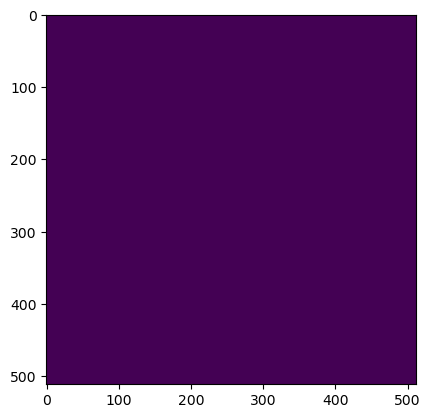

Wrote output/patches/mask/UU_S1_83-507497-6000-6288097-6000.tiff (512 x 512 pixels)


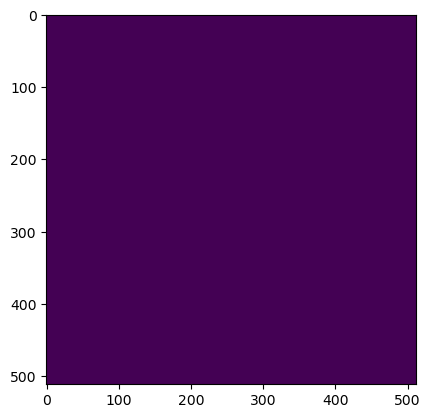

Wrote output/patches/mask/UU_S1_83-507600-0000-6287790-4000.tiff (512 x 512 pixels)


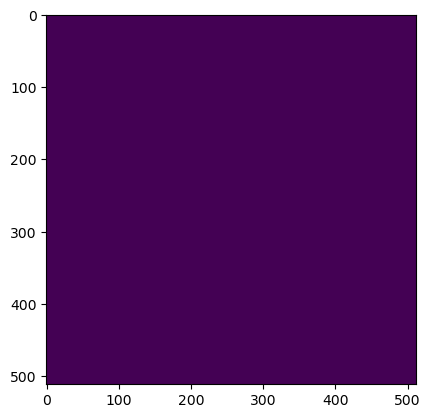

Wrote output/patches/mask/UU_S1_83-507600-0000-6287892-8000.tiff (512 x 512 pixels)


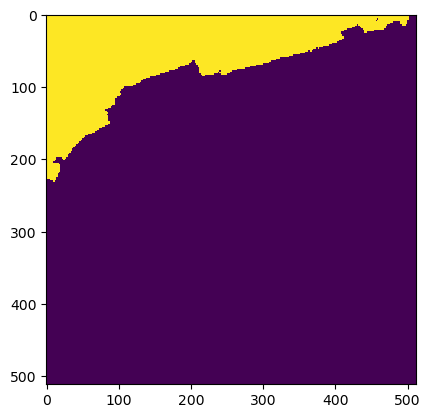

Wrote output/patches/mask/UU_S1_83-507600-0000-6287995-2000.tiff (512 x 512 pixels)


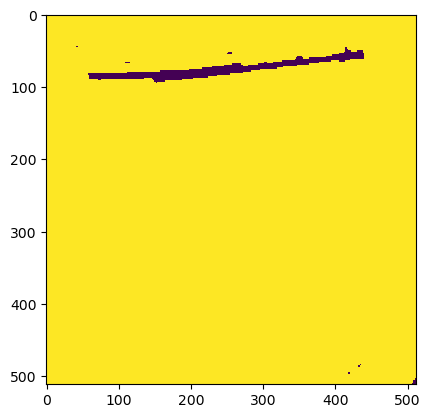

Wrote output/patches/mask/UU_S1_83-507600-0000-6288097-6000.tiff (512 x 512 pixels)


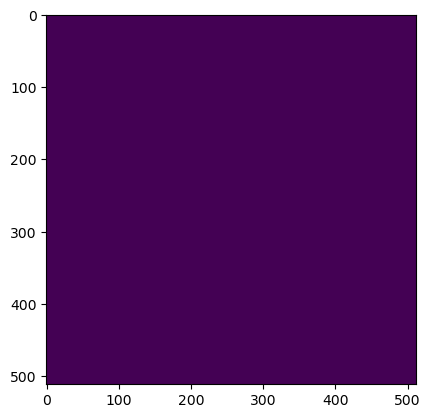

Wrote output/patches/mask/UU_S1_83-507702-4000-6287790-4000.tiff (512 x 512 pixels)


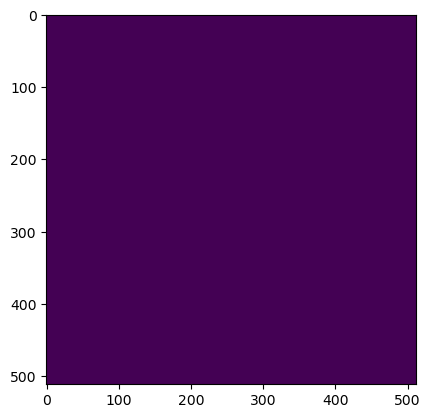

Wrote output/patches/mask/UU_S1_83-507702-4000-6287892-8000.tiff (512 x 512 pixels)


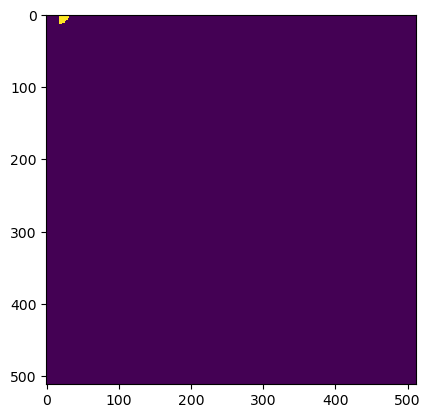

Wrote output/patches/mask/UU_S1_83-507702-4000-6287995-2000.tiff (512 x 512 pixels)


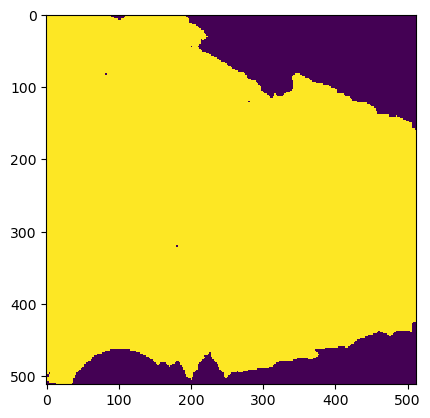

Wrote output/patches/mask/UU_S1_83-507702-4000-6288097-6000.tiff (512 x 512 pixels)


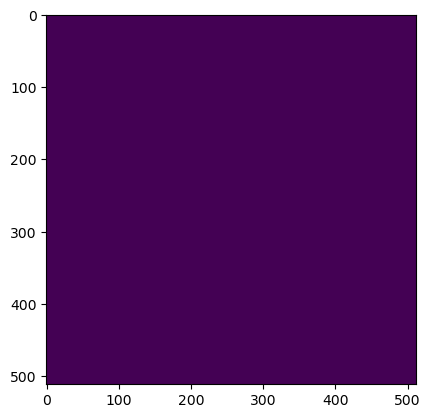

Wrote output/patches/mask/UU_S1_83-507804-8000-6287790-4000.tiff (512 x 512 pixels)


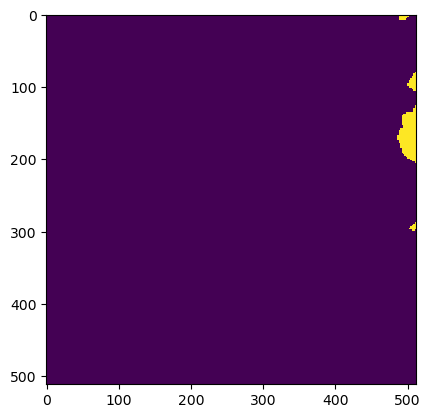

Wrote output/patches/mask/UU_S1_83-507804-8000-6287892-8000.tiff (512 x 512 pixels)


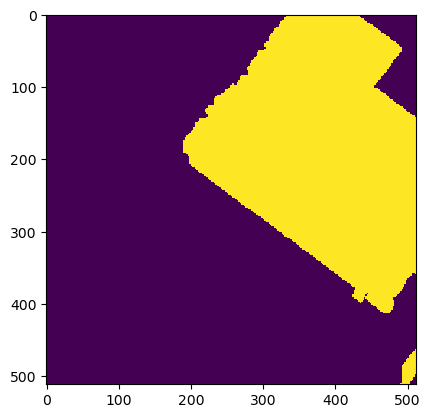

Wrote output/patches/mask/UU_S1_83-507804-8000-6287995-2000.tiff (512 x 512 pixels)


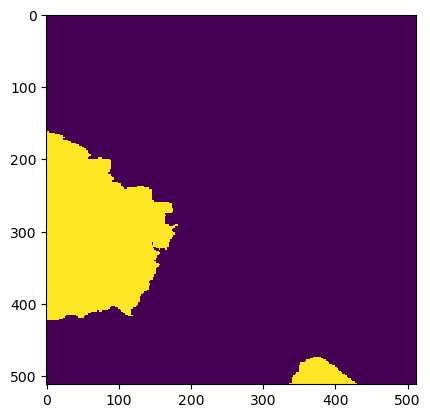

Wrote output/patches/mask/UU_S1_83-507804-8000-6288097-6000.tiff (512 x 512 pixels)


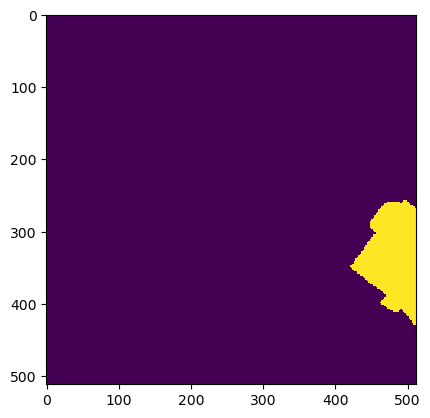

Wrote output/patches/mask/UU_S1_83-507907-2000-6287790-4000.tiff (512 x 512 pixels)


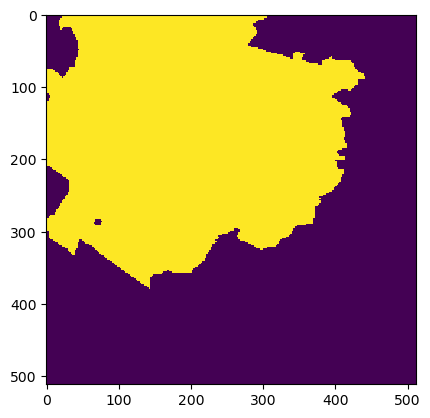

Wrote output/patches/mask/UU_S1_83-507907-2000-6287892-8000.tiff (512 x 512 pixels)


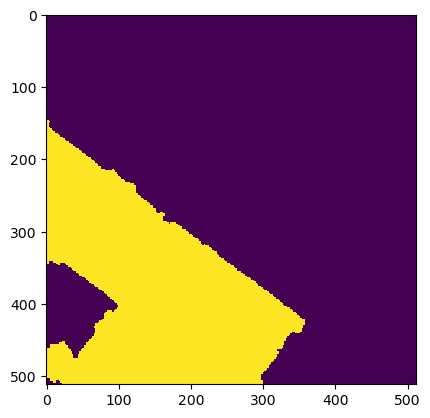

Wrote output/patches/mask/UU_S1_83-507907-2000-6287995-2000.tiff (512 x 512 pixels)


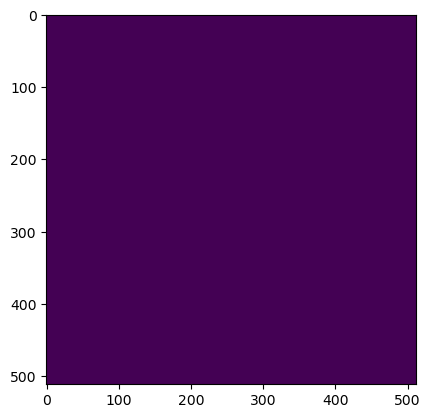

Wrote output/patches/mask/UU_S1_83-507907-2000-6288097-6000.tiff (512 x 512 pixels)
Zone UV_S1_84 Building Mask...


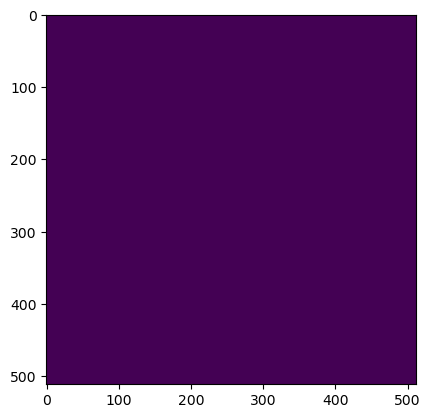

Wrote output/patches/mask/UV_S1_84-451536-0000-6288046-4000.tiff (512 x 512 pixels)


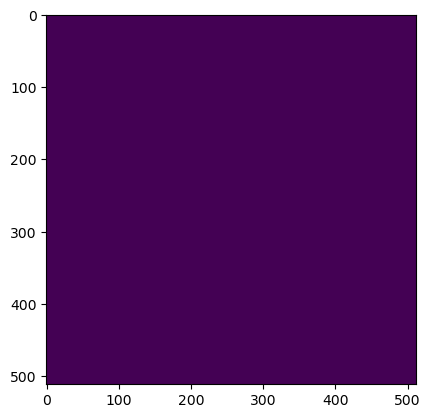

Wrote output/patches/mask/UV_S1_84-451536-0000-6288148-8000.tiff (512 x 512 pixels)


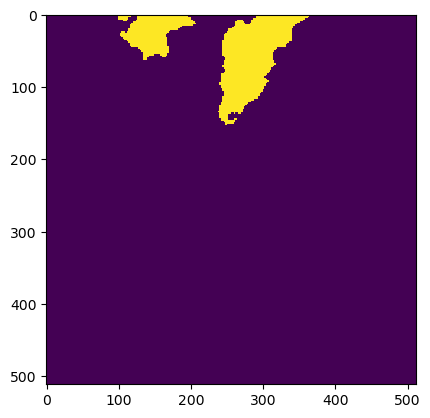

Wrote output/patches/mask/UV_S1_84-451638-4000-6288046-4000.tiff (512 x 512 pixels)


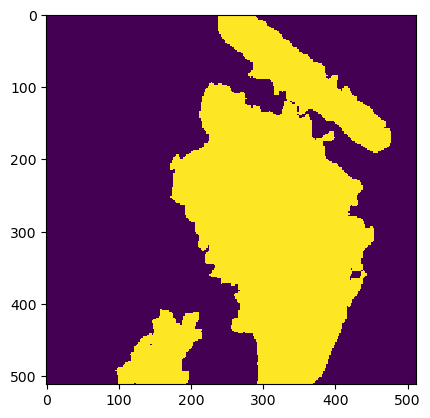

Wrote output/patches/mask/UV_S1_84-451638-4000-6288148-8000.tiff (512 x 512 pixels)
Zone CU_S1_85 Building Mask...


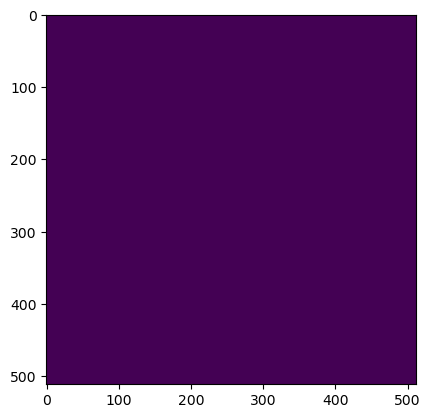

Wrote output/patches/mask/CU_S1_85-439504-0000-6288302-4000.tiff (512 x 512 pixels)


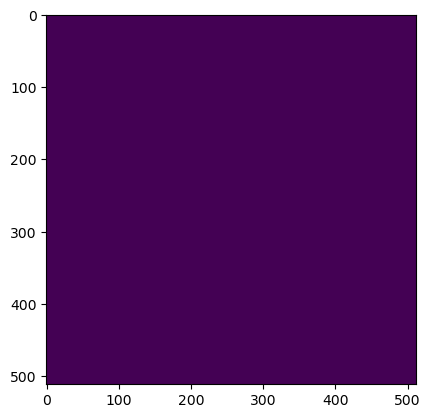

Wrote output/patches/mask/CU_S1_85-439504-0000-6288404-8000.tiff (512 x 512 pixels)


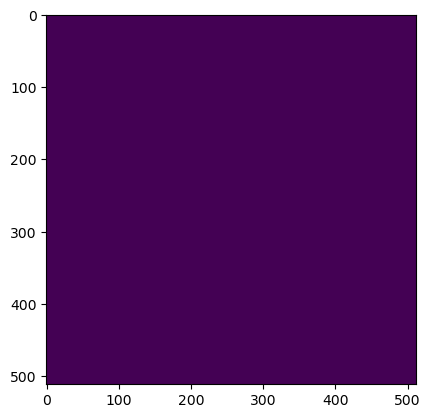

Wrote output/patches/mask/CU_S1_85-439504-0000-6288507-2000.tiff (512 x 512 pixels)


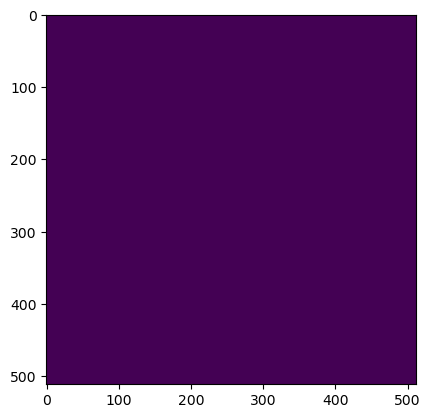

Wrote output/patches/mask/CU_S1_85-439504-0000-6288609-6000.tiff (512 x 512 pixels)


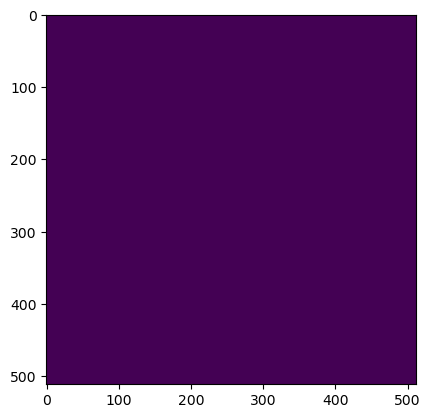

Wrote output/patches/mask/CU_S1_85-439504-0000-6288712-0000.tiff (512 x 512 pixels)


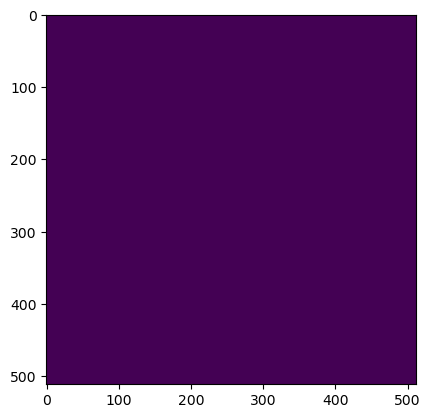

Wrote output/patches/mask/CU_S1_85-439504-0000-6288814-4000.tiff (512 x 512 pixels)


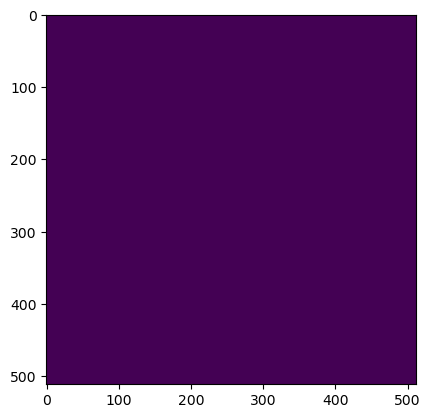

Wrote output/patches/mask/CU_S1_85-439504-0000-6288916-8000.tiff (512 x 512 pixels)


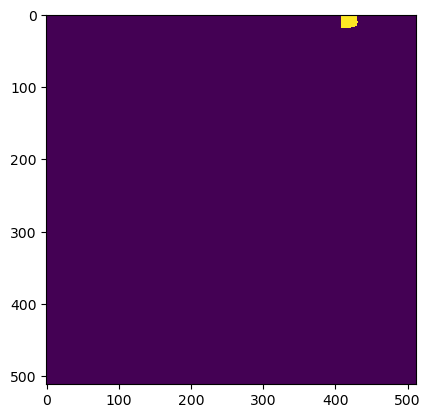

Wrote output/patches/mask/CU_S1_85-439606-4000-6288302-4000.tiff (512 x 512 pixels)


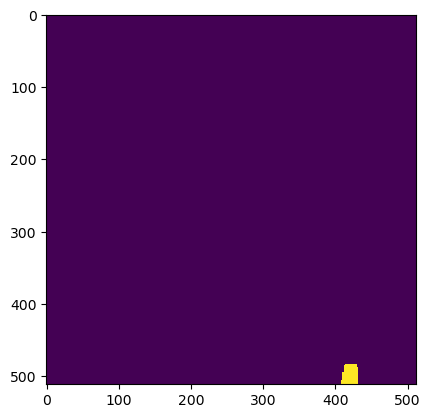

Wrote output/patches/mask/CU_S1_85-439606-4000-6288404-8000.tiff (512 x 512 pixels)


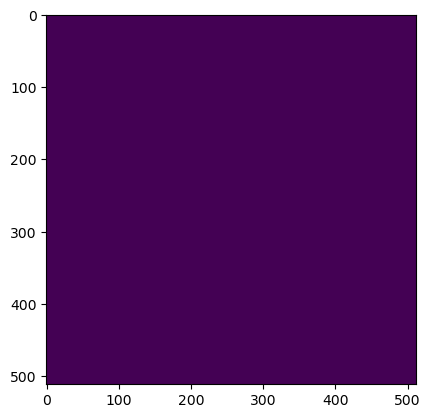

Wrote output/patches/mask/CU_S1_85-439606-4000-6288507-2000.tiff (512 x 512 pixels)


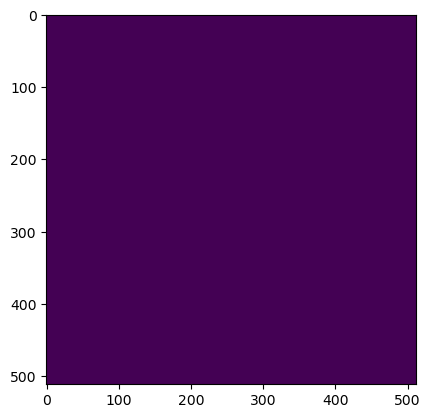

Wrote output/patches/mask/CU_S1_85-439606-4000-6288609-6000.tiff (512 x 512 pixels)


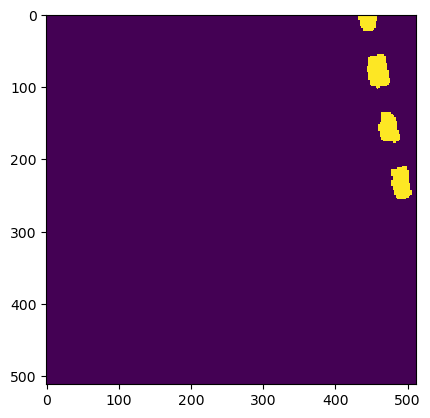

Wrote output/patches/mask/CU_S1_85-439606-4000-6288712-0000.tiff (512 x 512 pixels)


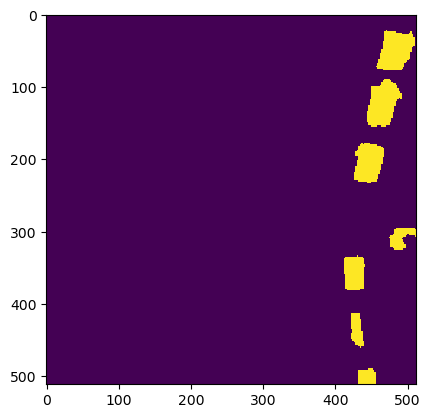

Wrote output/patches/mask/CU_S1_85-439606-4000-6288814-4000.tiff (512 x 512 pixels)


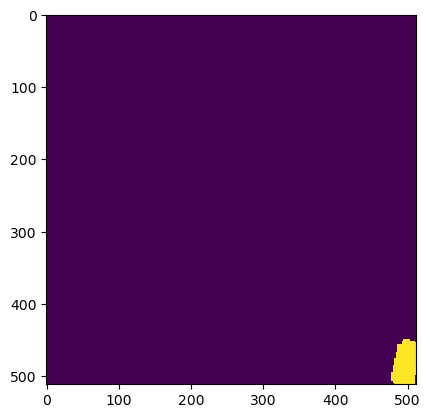

Wrote output/patches/mask/CU_S1_85-439606-4000-6288916-8000.tiff (512 x 512 pixels)


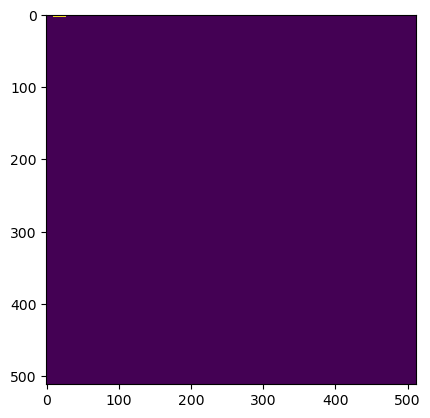

Wrote output/patches/mask/CU_S1_85-439708-8000-6288302-4000.tiff (512 x 512 pixels)


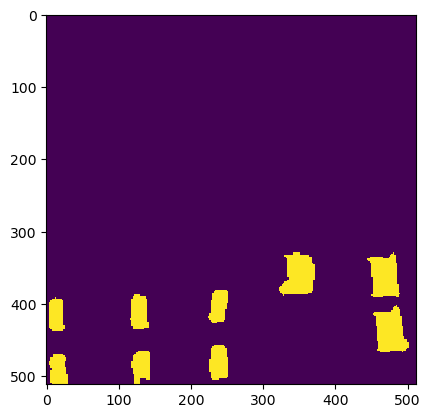

Wrote output/patches/mask/CU_S1_85-439708-8000-6288404-8000.tiff (512 x 512 pixels)


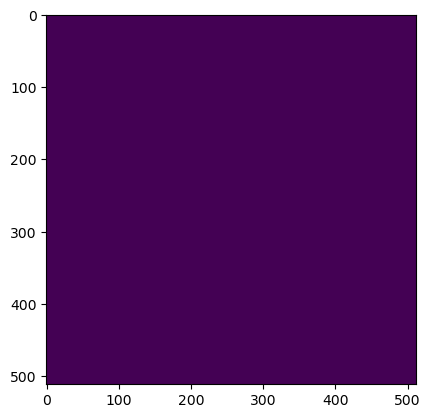

Wrote output/patches/mask/CU_S1_85-439708-8000-6288507-2000.tiff (512 x 512 pixels)


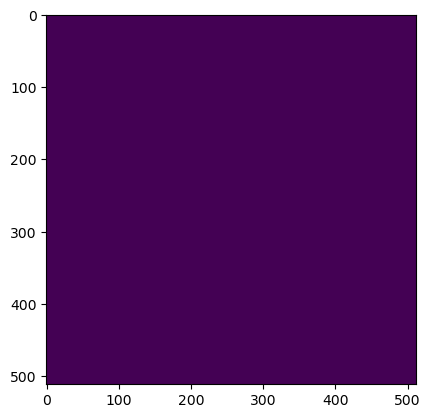

Wrote output/patches/mask/CU_S1_85-439708-8000-6288609-6000.tiff (512 x 512 pixels)


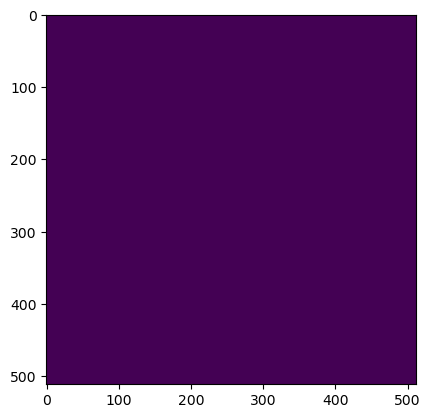

Wrote output/patches/mask/CU_S1_85-439708-8000-6288712-0000.tiff (512 x 512 pixels)


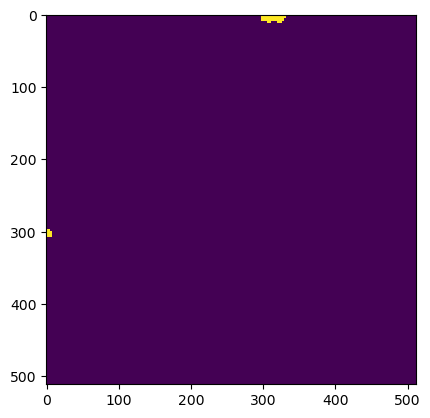

Wrote output/patches/mask/CU_S1_85-439708-8000-6288814-4000.tiff (512 x 512 pixels)


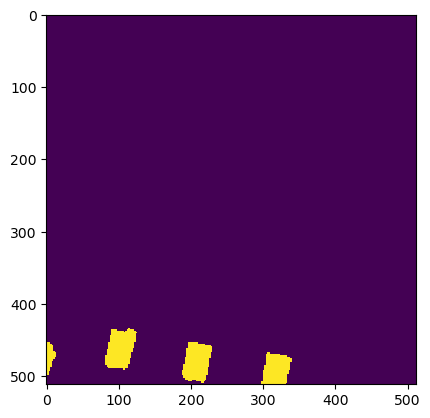

Wrote output/patches/mask/CU_S1_85-439708-8000-6288916-8000.tiff (512 x 512 pixels)


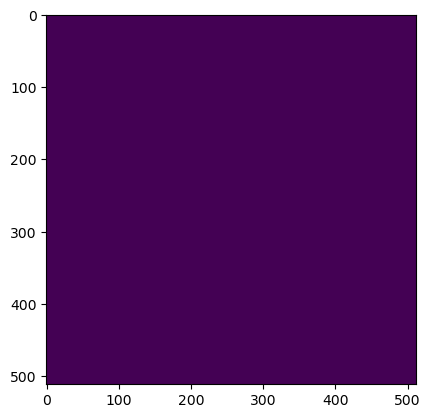

Wrote output/patches/mask/CU_S1_85-439811-2000-6288302-4000.tiff (512 x 512 pixels)


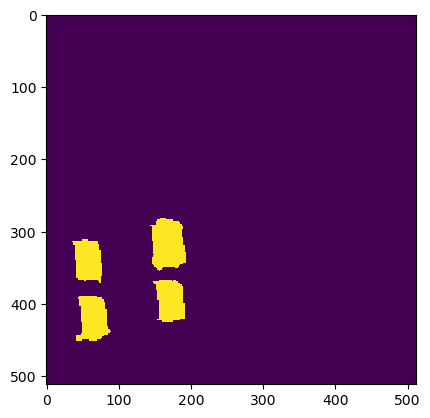

Wrote output/patches/mask/CU_S1_85-439811-2000-6288404-8000.tiff (512 x 512 pixels)


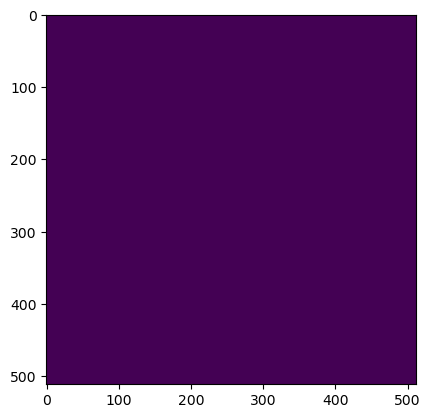

Wrote output/patches/mask/CU_S1_85-439811-2000-6288507-2000.tiff (512 x 512 pixels)


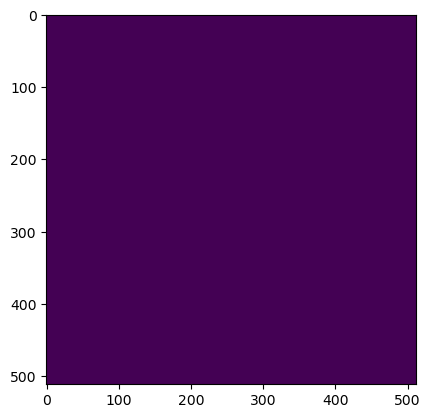

Wrote output/patches/mask/CU_S1_85-439811-2000-6288609-6000.tiff (512 x 512 pixels)


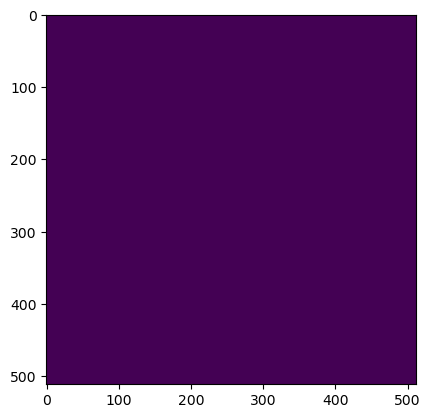

Wrote output/patches/mask/CU_S1_85-439811-2000-6288712-0000.tiff (512 x 512 pixels)


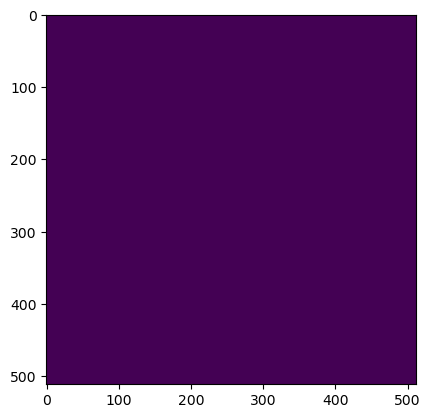

Wrote output/patches/mask/CU_S1_85-439811-2000-6288814-4000.tiff (512 x 512 pixels)


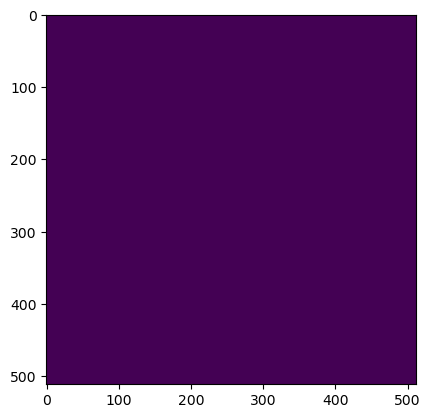

Wrote output/patches/mask/CU_S1_85-439811-2000-6288916-8000.tiff (512 x 512 pixels)
Zone NC_S1_86 Building Mask...


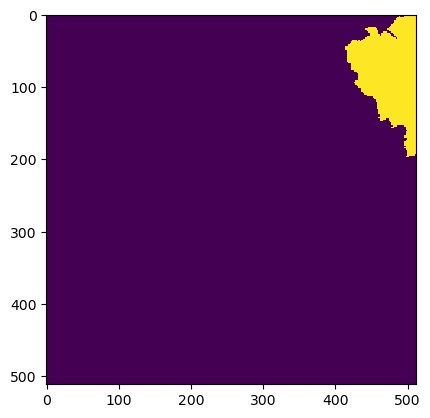

Wrote output/patches/mask/NC_S1_86-455888-0000-6288302-4000.tiff (512 x 512 pixels)


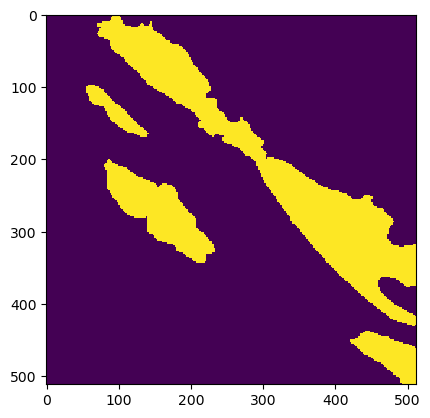

Wrote output/patches/mask/NC_S1_86-455888-0000-6288404-8000.tiff (512 x 512 pixels)


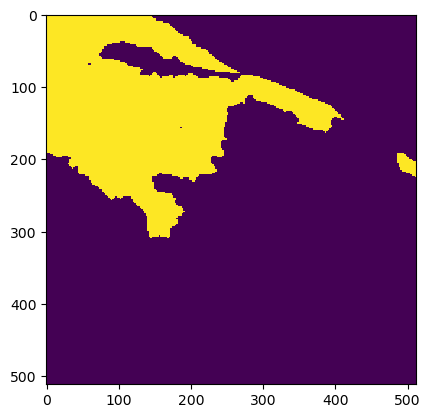

Wrote output/patches/mask/NC_S1_86-455990-4000-6288302-4000.tiff (512 x 512 pixels)


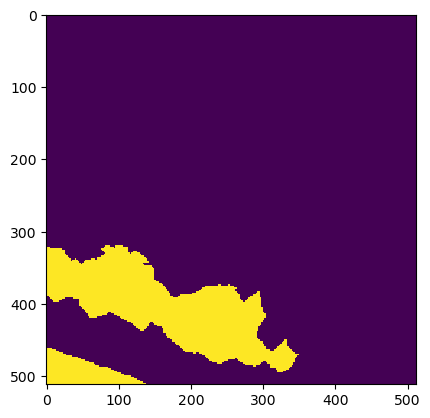

Wrote output/patches/mask/NC_S1_86-455990-4000-6288404-8000.tiff (512 x 512 pixels)
Zone CV_S1_87 Building Mask...


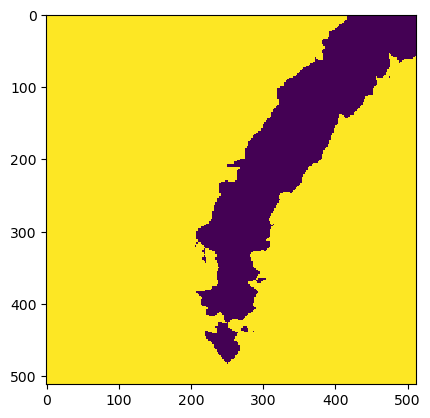

Wrote output/patches/mask/CV_S1_87-457680-0000-6288558-4000.tiff (512 x 512 pixels)


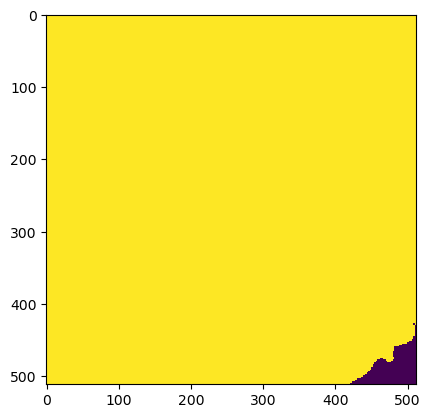

Wrote output/patches/mask/CV_S1_87-457680-0000-6288660-8000.tiff (512 x 512 pixels)


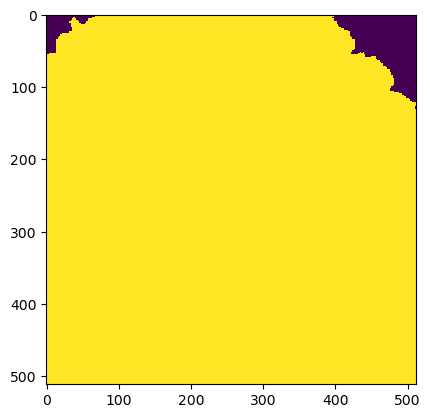

Wrote output/patches/mask/CV_S1_87-457782-4000-6288558-4000.tiff (512 x 512 pixels)


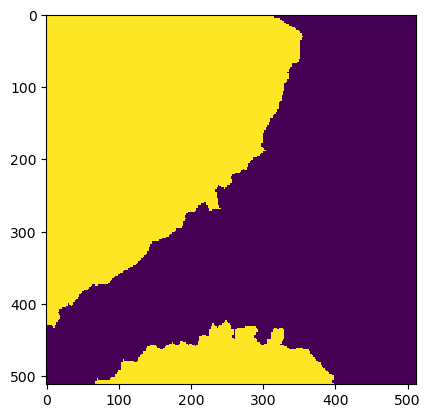

Wrote output/patches/mask/CV_S1_87-457782-4000-6288660-8000.tiff (512 x 512 pixels)
Zone NN_S1_88 Building Mask...


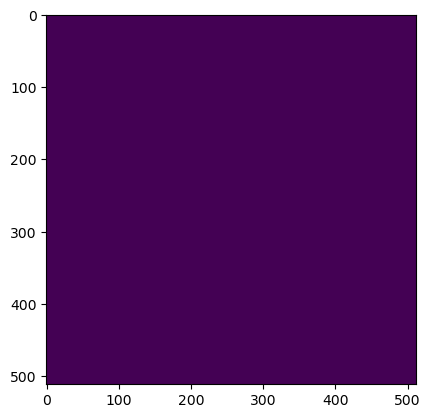

Wrote output/patches/mask/NN_S1_88-445136-0000-6288814-4000.tiff (512 x 512 pixels)


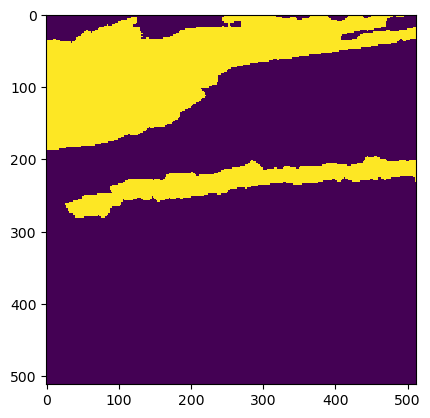

Wrote output/patches/mask/NN_S1_88-445136-0000-6288916-8000.tiff (512 x 512 pixels)


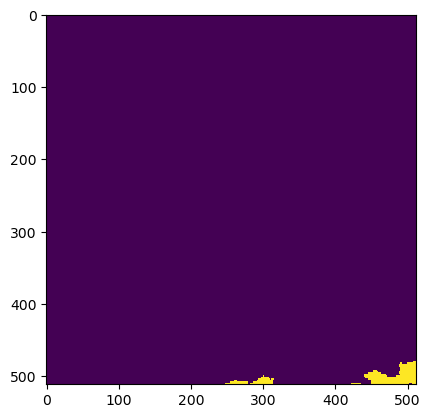

Wrote output/patches/mask/NN_S1_88-445136-0000-6289019-2000.tiff (512 x 512 pixels)


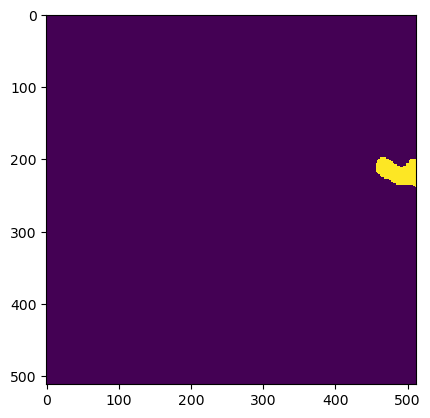

Wrote output/patches/mask/NN_S1_88-445136-0000-6289121-6000.tiff (512 x 512 pixels)


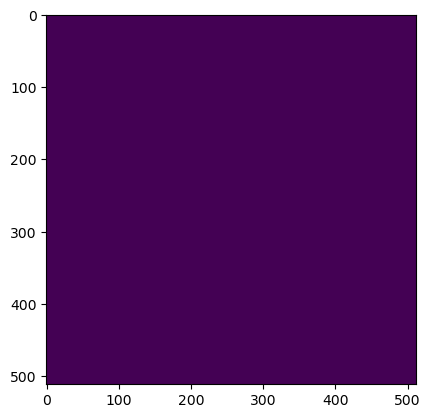

Wrote output/patches/mask/NN_S1_88-445238-4000-6288814-4000.tiff (512 x 512 pixels)


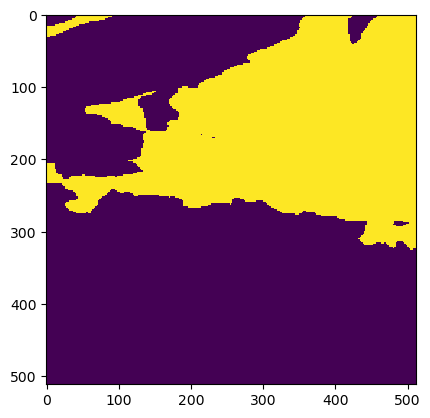

Wrote output/patches/mask/NN_S1_88-445238-4000-6288916-8000.tiff (512 x 512 pixels)


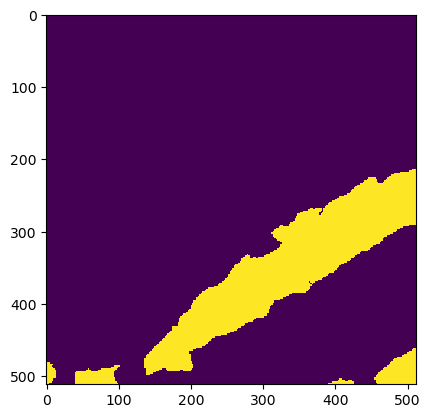

Wrote output/patches/mask/NN_S1_88-445238-4000-6289019-2000.tiff (512 x 512 pixels)


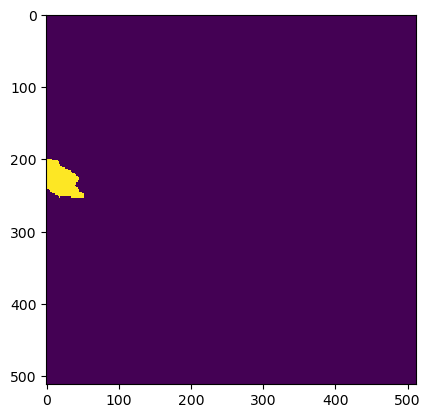

Wrote output/patches/mask/NN_S1_88-445238-4000-6289121-6000.tiff (512 x 512 pixels)


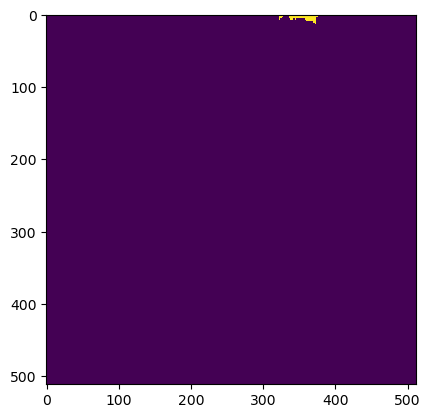

Wrote output/patches/mask/NN_S1_88-445340-8000-6288814-4000.tiff (512 x 512 pixels)


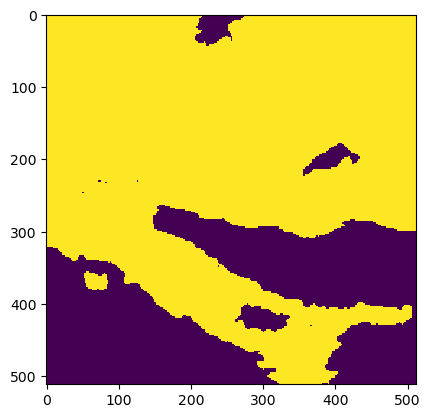

Wrote output/patches/mask/NN_S1_88-445340-8000-6288916-8000.tiff (512 x 512 pixels)


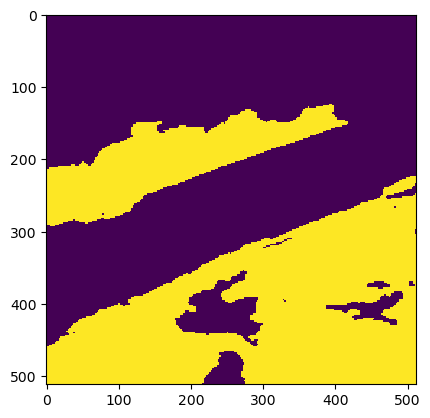

Wrote output/patches/mask/NN_S1_88-445340-8000-6289019-2000.tiff (512 x 512 pixels)


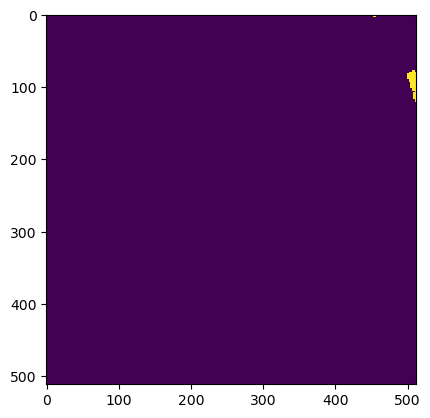

Wrote output/patches/mask/NN_S1_88-445340-8000-6289121-6000.tiff (512 x 512 pixels)


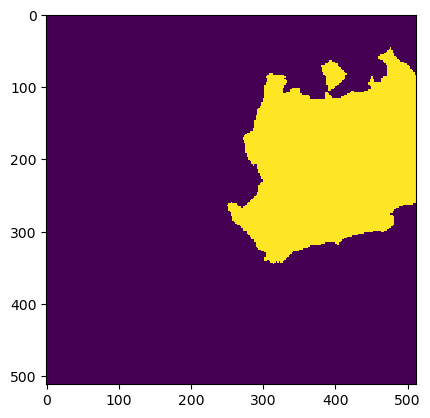

Wrote output/patches/mask/NN_S1_88-445443-2000-6288814-4000.tiff (512 x 512 pixels)


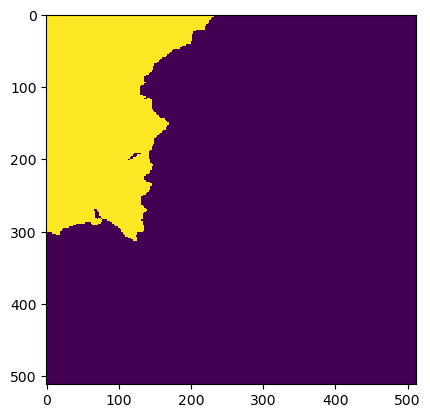

Wrote output/patches/mask/NN_S1_88-445443-2000-6288916-8000.tiff (512 x 512 pixels)


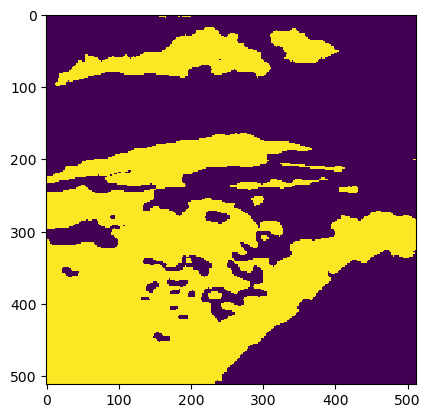

Wrote output/patches/mask/NN_S1_88-445443-2000-6289019-2000.tiff (512 x 512 pixels)


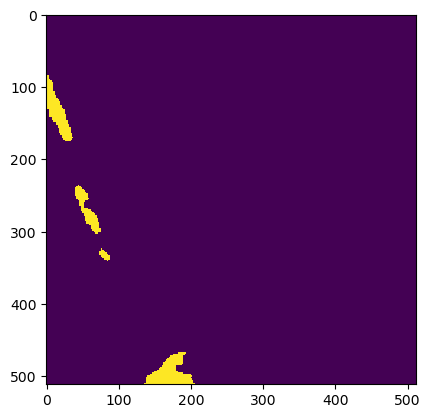

Wrote output/patches/mask/NN_S1_88-445443-2000-6289121-6000.tiff (512 x 512 pixels)


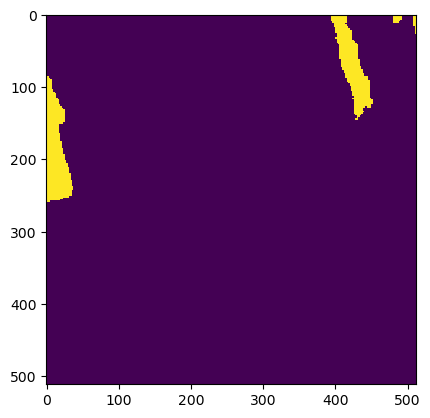

Wrote output/patches/mask/NN_S1_88-445545-6000-6288814-4000.tiff (512 x 512 pixels)


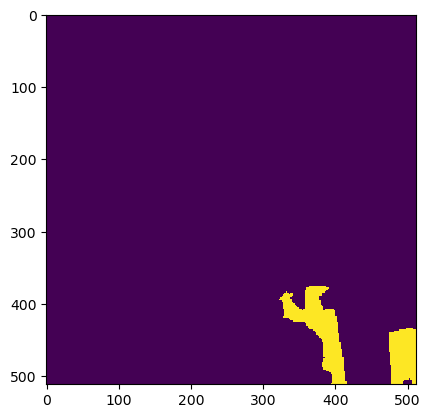

Wrote output/patches/mask/NN_S1_88-445545-6000-6288916-8000.tiff (512 x 512 pixels)


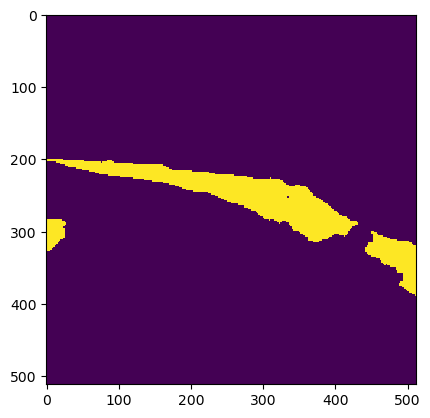

Wrote output/patches/mask/NN_S1_88-445545-6000-6289019-2000.tiff (512 x 512 pixels)


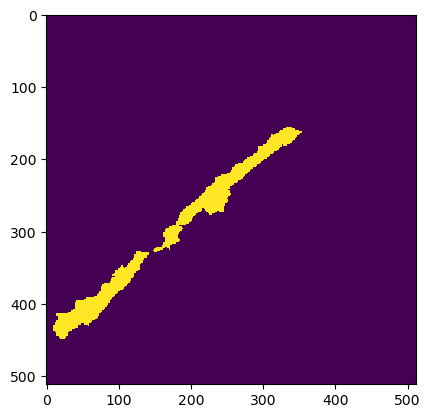

Wrote output/patches/mask/NN_S1_88-445545-6000-6289121-6000.tiff (512 x 512 pixels)


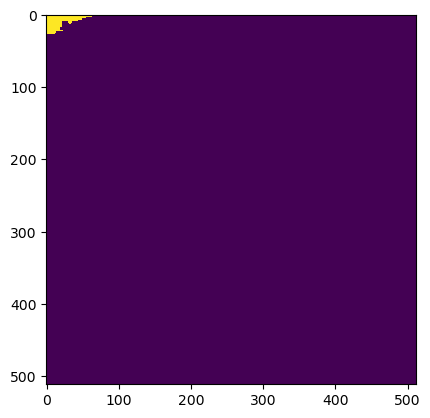

Wrote output/patches/mask/NN_S1_88-445648-0000-6288814-4000.tiff (512 x 512 pixels)


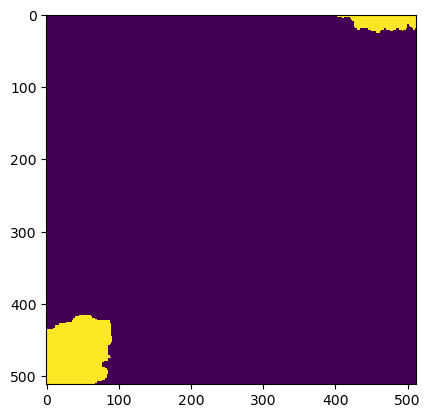

Wrote output/patches/mask/NN_S1_88-445648-0000-6288916-8000.tiff (512 x 512 pixels)


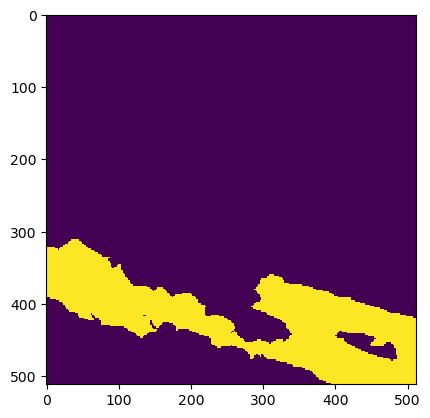

Wrote output/patches/mask/NN_S1_88-445648-0000-6289019-2000.tiff (512 x 512 pixels)


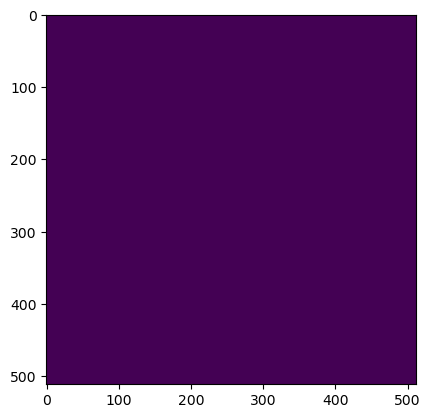

Wrote output/patches/mask/NN_S1_88-445648-0000-6289121-6000.tiff (512 x 512 pixels)


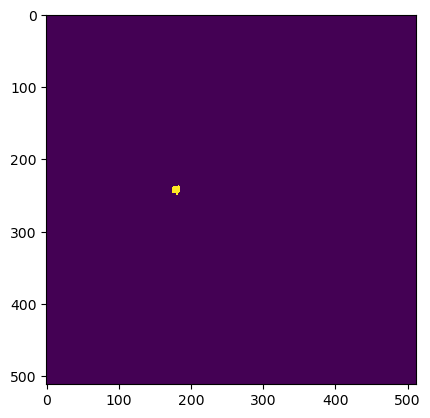

Wrote output/patches/mask/NN_S1_88-445750-4000-6288814-4000.tiff (512 x 512 pixels)


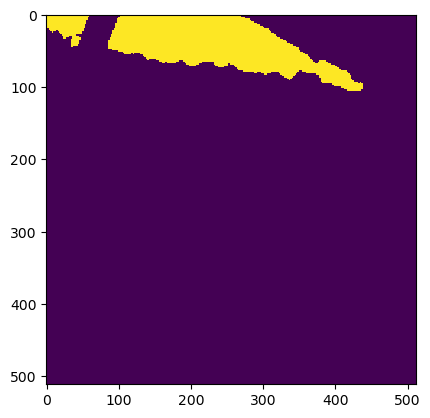

Wrote output/patches/mask/NN_S1_88-445750-4000-6288916-8000.tiff (512 x 512 pixels)


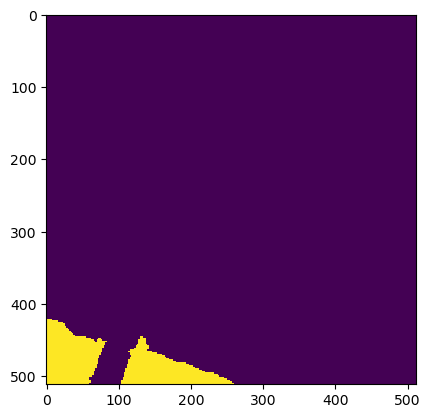

Wrote output/patches/mask/NN_S1_88-445750-4000-6289019-2000.tiff (512 x 512 pixels)


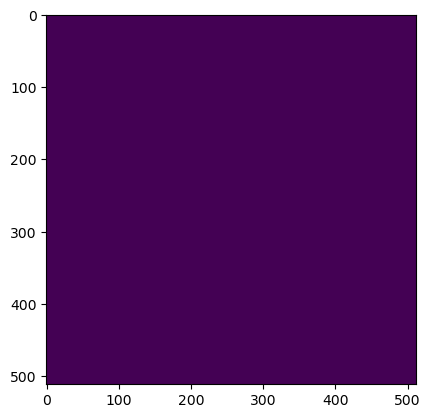

Wrote output/patches/mask/NN_S1_88-445750-4000-6289121-6000.tiff (512 x 512 pixels)


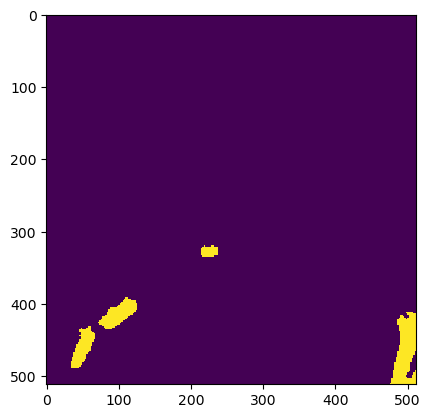

Wrote output/patches/mask/NN_S1_88-445852-8000-6288814-4000.tiff (512 x 512 pixels)


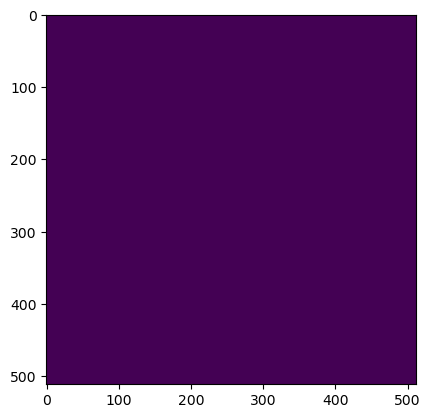

Wrote output/patches/mask/NN_S1_88-445852-8000-6288916-8000.tiff (512 x 512 pixels)


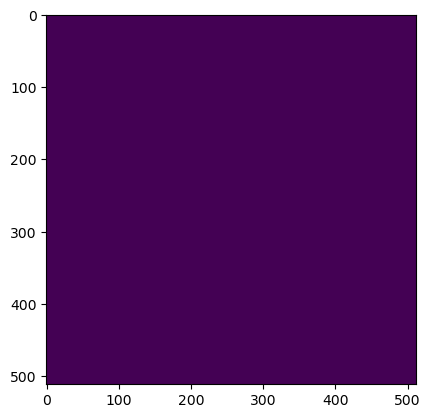

Wrote output/patches/mask/NN_S1_88-445852-8000-6289019-2000.tiff (512 x 512 pixels)


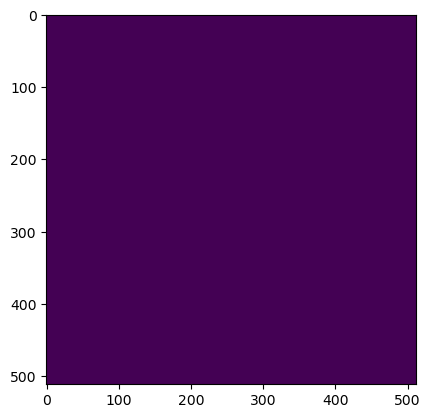

Wrote output/patches/mask/NN_S1_88-445852-8000-6289121-6000.tiff (512 x 512 pixels)


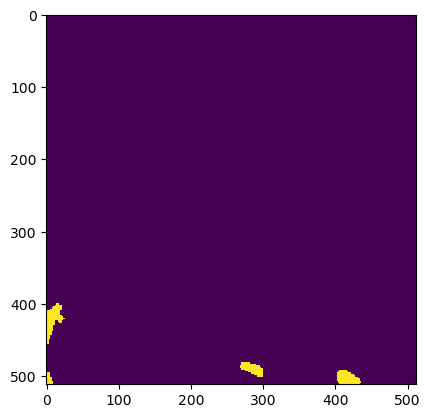

Wrote output/patches/mask/NN_S1_88-445955-2000-6288814-4000.tiff (512 x 512 pixels)


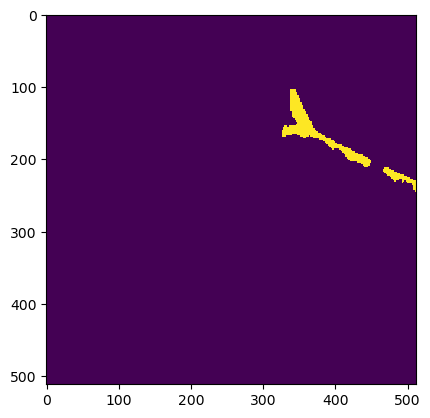

Wrote output/patches/mask/NN_S1_88-445955-2000-6288916-8000.tiff (512 x 512 pixels)


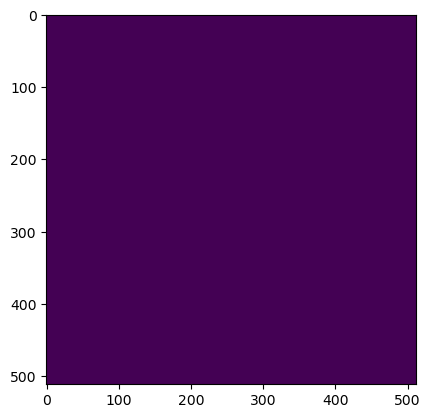

Wrote output/patches/mask/NN_S1_88-445955-2000-6289019-2000.tiff (512 x 512 pixels)


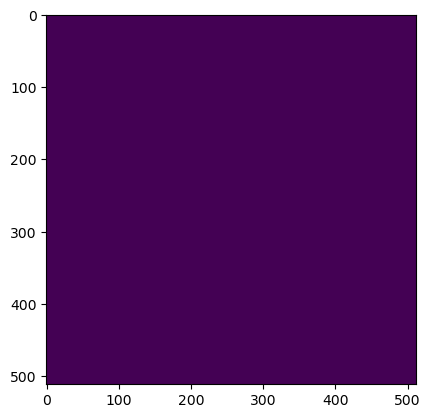

Wrote output/patches/mask/NN_S1_88-445955-2000-6289121-6000.tiff (512 x 512 pixels)


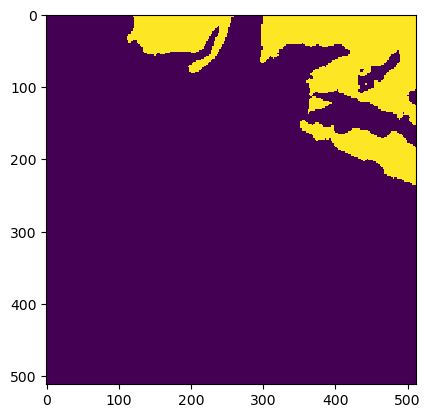

Wrote output/patches/mask/NN_S1_88-446057-6000-6288814-4000.tiff (512 x 512 pixels)


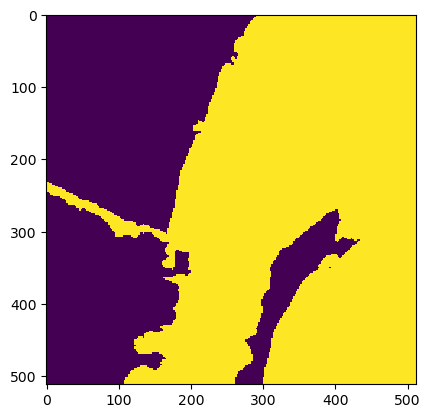

Wrote output/patches/mask/NN_S1_88-446057-6000-6288916-8000.tiff (512 x 512 pixels)


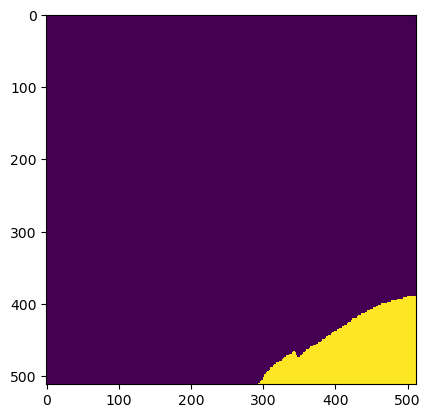

Wrote output/patches/mask/NN_S1_88-446057-6000-6289019-2000.tiff (512 x 512 pixels)


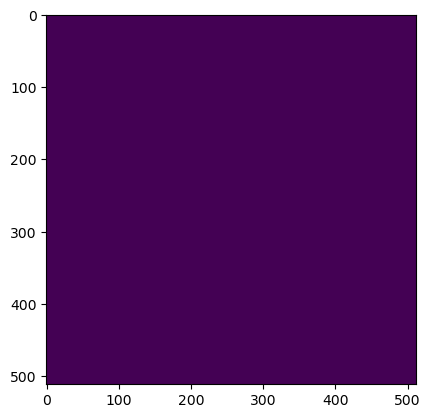

Wrote output/patches/mask/NN_S1_88-446057-6000-6289121-6000.tiff (512 x 512 pixels)


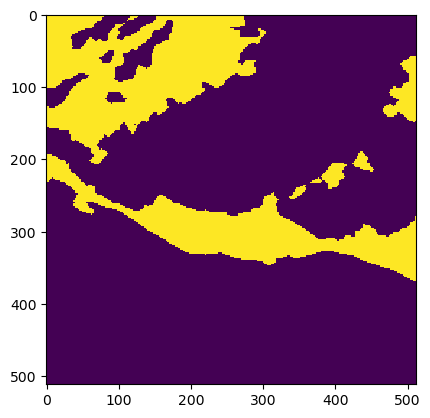

Wrote output/patches/mask/NN_S1_88-446160-0000-6288814-4000.tiff (512 x 512 pixels)


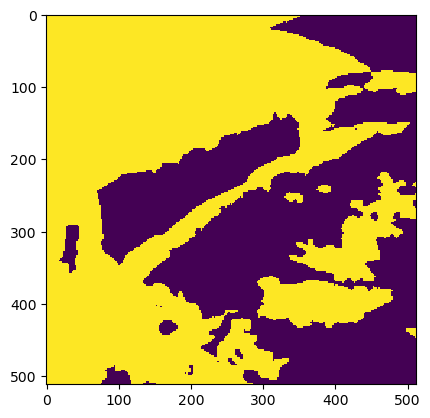

Wrote output/patches/mask/NN_S1_88-446160-0000-6288916-8000.tiff (512 x 512 pixels)


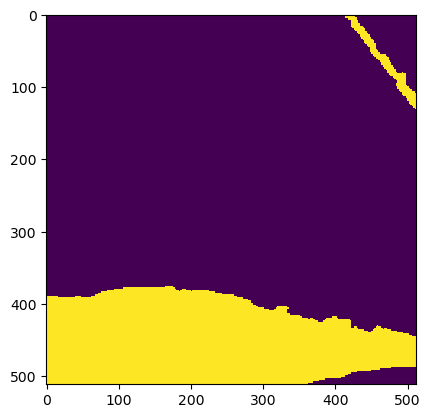

Wrote output/patches/mask/NN_S1_88-446160-0000-6289019-2000.tiff (512 x 512 pixels)


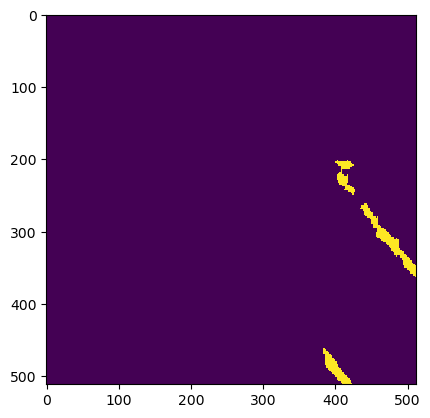

Wrote output/patches/mask/NN_S1_88-446160-0000-6289121-6000.tiff (512 x 512 pixels)


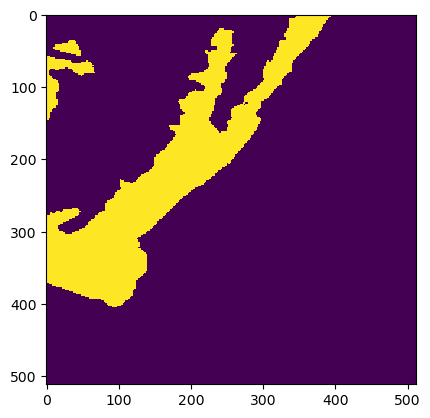

Wrote output/patches/mask/NN_S1_88-446262-4000-6288814-4000.tiff (512 x 512 pixels)


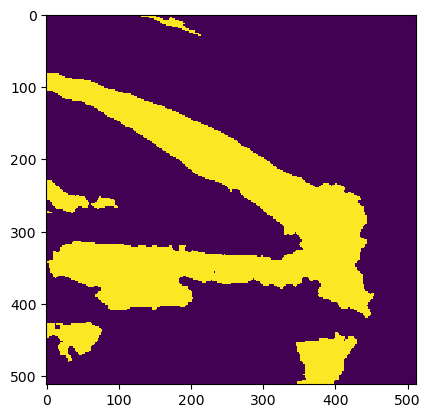

Wrote output/patches/mask/NN_S1_88-446262-4000-6288916-8000.tiff (512 x 512 pixels)


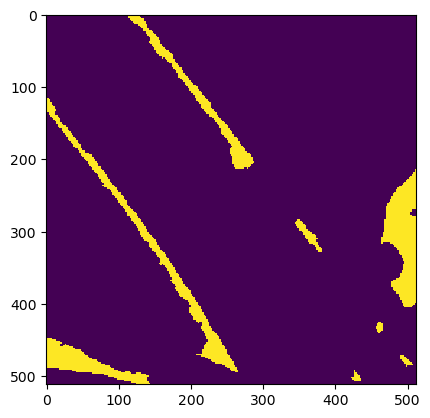

Wrote output/patches/mask/NN_S1_88-446262-4000-6289019-2000.tiff (512 x 512 pixels)


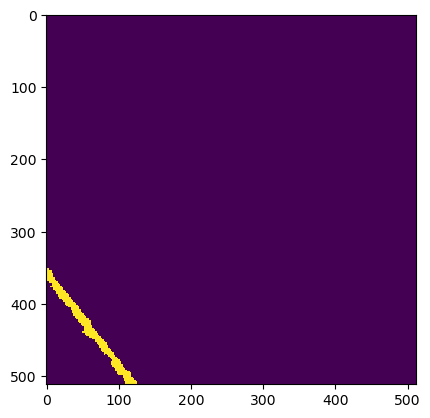

Wrote output/patches/mask/NN_S1_88-446262-4000-6289121-6000.tiff (512 x 512 pixels)
Zone NN_S1_89 Building Mask...


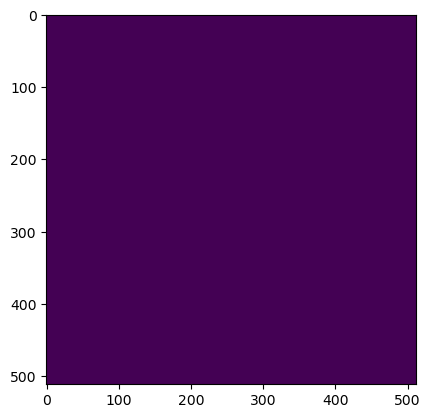

Wrote output/patches/mask/NN_S1_89-447184-0000-6288814-4000.tiff (512 x 512 pixels)


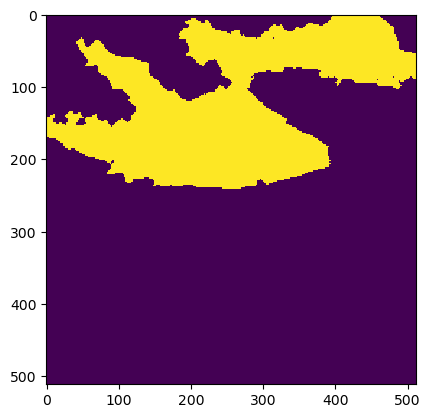

Wrote output/patches/mask/NN_S1_89-447184-0000-6288916-8000.tiff (512 x 512 pixels)


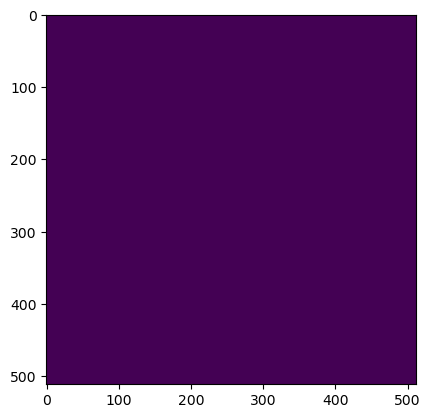

Wrote output/patches/mask/NN_S1_89-447286-4000-6288814-4000.tiff (512 x 512 pixels)


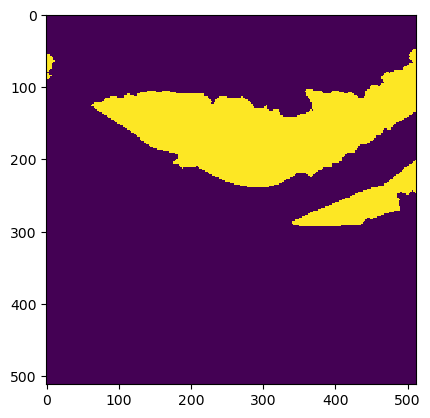

Wrote output/patches/mask/NN_S1_89-447286-4000-6288916-8000.tiff (512 x 512 pixels)


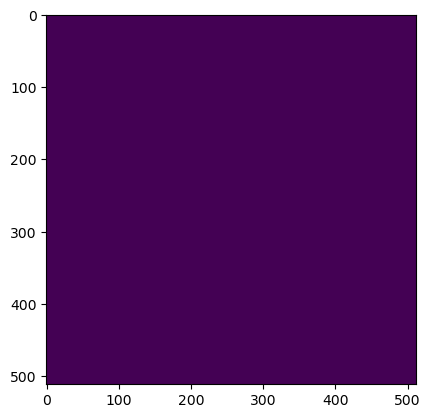

Wrote output/patches/mask/NN_S1_89-447388-8000-6288814-4000.tiff (512 x 512 pixels)


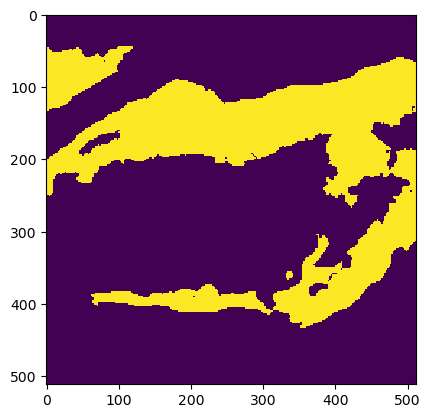

Wrote output/patches/mask/NN_S1_89-447388-8000-6288916-8000.tiff (512 x 512 pixels)


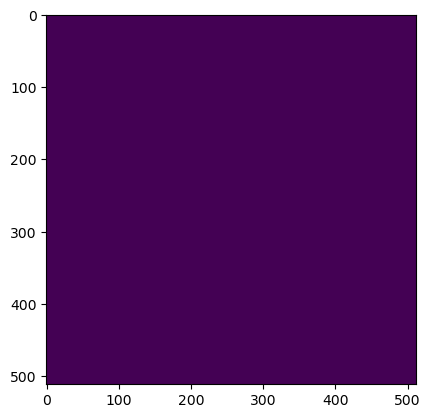

Wrote output/patches/mask/NN_S1_89-447491-2000-6288814-4000.tiff (512 x 512 pixels)


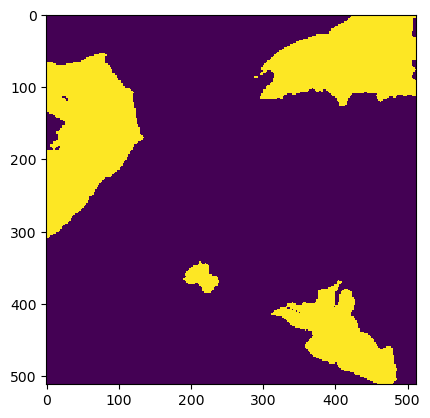

Wrote output/patches/mask/NN_S1_89-447491-2000-6288916-8000.tiff (512 x 512 pixels)
Zone CU_S1_90 Building Mask...


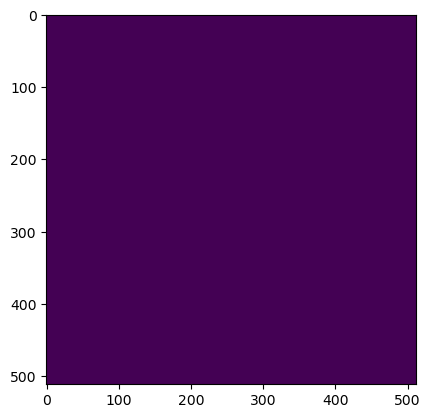

Wrote output/patches/mask/CU_S1_90-473296-0000-6289326-4000.tiff (512 x 512 pixels)


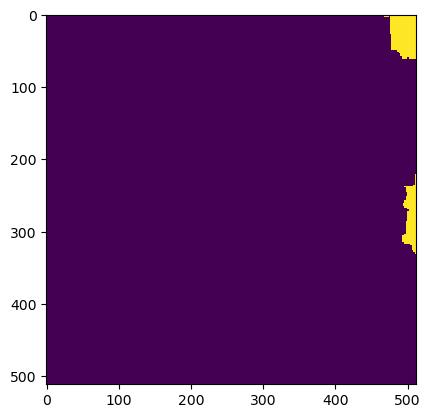

Wrote output/patches/mask/CU_S1_90-473296-0000-6289428-8000.tiff (512 x 512 pixels)


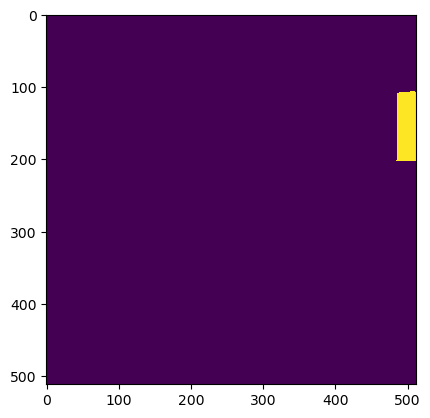

Wrote output/patches/mask/CU_S1_90-473398-4000-6289326-4000.tiff (512 x 512 pixels)


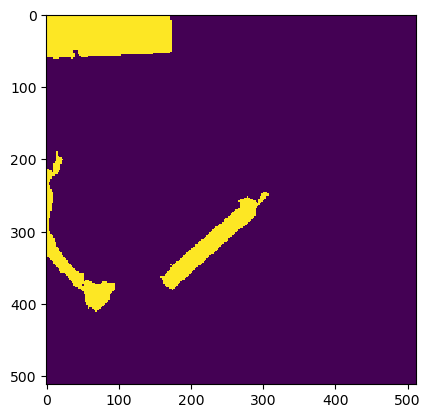

Wrote output/patches/mask/CU_S1_90-473398-4000-6289428-8000.tiff (512 x 512 pixels)


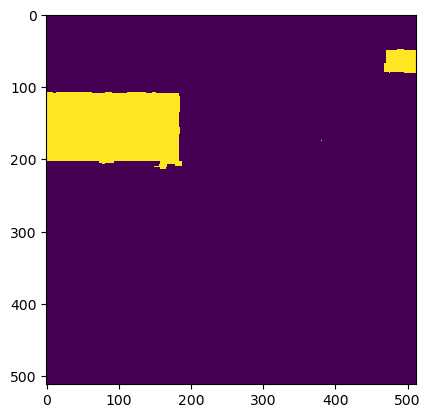

Wrote output/patches/mask/CU_S1_90-473500-8000-6289326-4000.tiff (512 x 512 pixels)


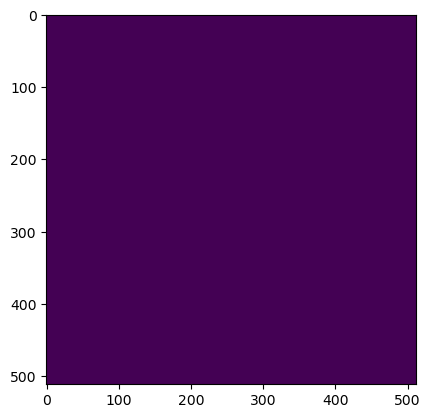

Wrote output/patches/mask/CU_S1_90-473500-8000-6289428-8000.tiff (512 x 512 pixels)


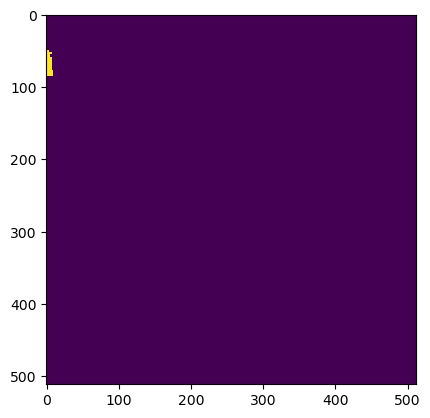

Wrote output/patches/mask/CU_S1_90-473603-2000-6289326-4000.tiff (512 x 512 pixels)


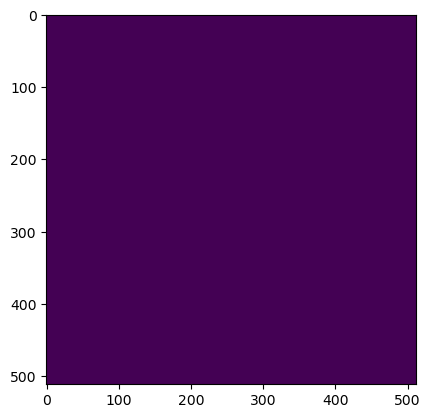

Wrote output/patches/mask/CU_S1_90-473603-2000-6289428-8000.tiff (512 x 512 pixels)
Zone UU_S1_91 Building Mask...


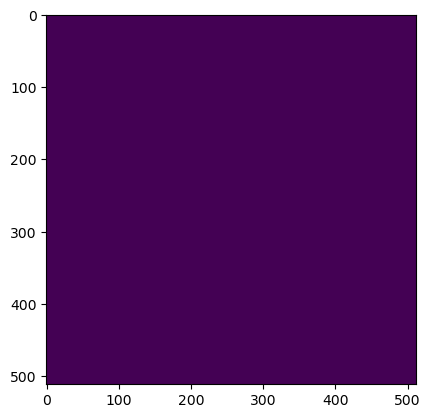

Wrote output/patches/mask/UU_S1_91-462288-0000-6289070-4000.tiff (512 x 512 pixels)


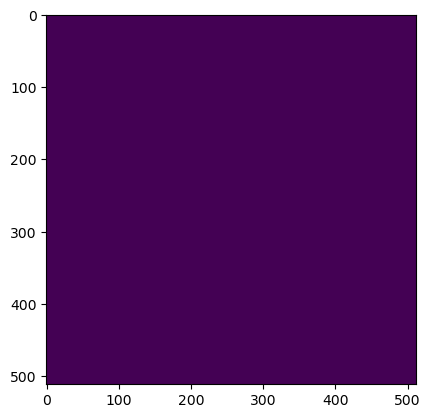

Wrote output/patches/mask/UU_S1_91-462288-0000-6289172-8000.tiff (512 x 512 pixels)


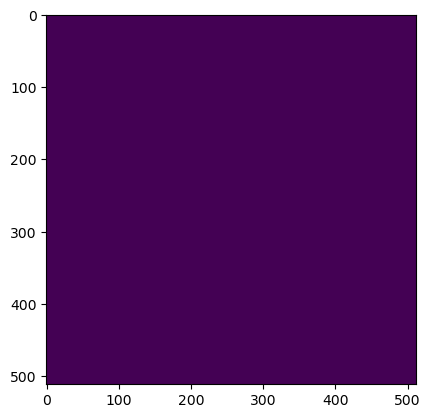

Wrote output/patches/mask/UU_S1_91-462390-4000-6289070-4000.tiff (512 x 512 pixels)


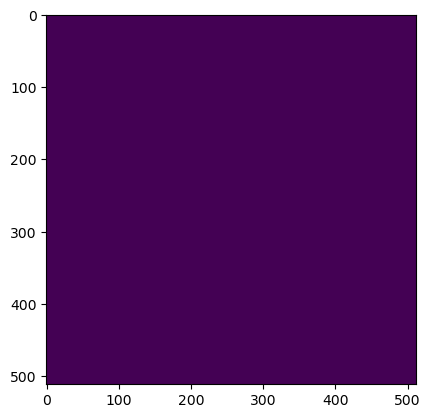

Wrote output/patches/mask/UU_S1_91-462390-4000-6289172-8000.tiff (512 x 512 pixels)
Zone VC_S1_92 Building Mask...


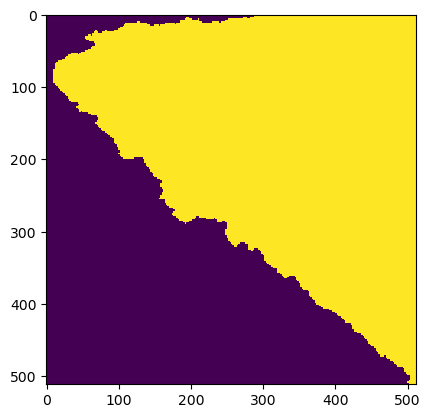

Wrote output/patches/mask/VC_S1_92-456656-0000-6289070-4000.tiff (512 x 512 pixels)


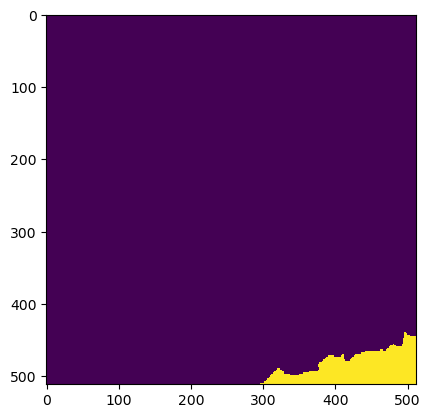

Wrote output/patches/mask/VC_S1_92-456656-0000-6289172-8000.tiff (512 x 512 pixels)


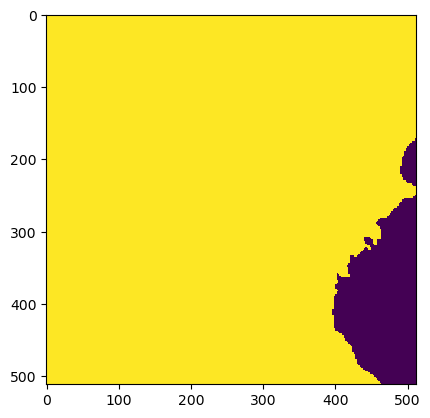

Wrote output/patches/mask/VC_S1_92-456758-4000-6289070-4000.tiff (512 x 512 pixels)


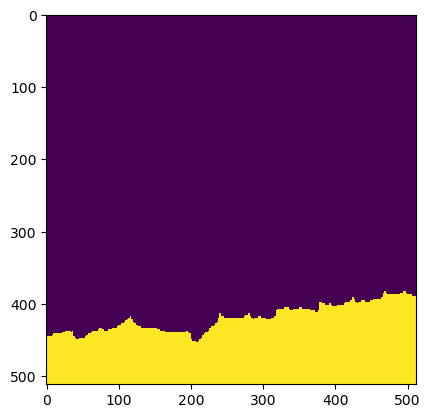

Wrote output/patches/mask/VC_S1_92-456758-4000-6289172-8000.tiff (512 x 512 pixels)
Zone NN_S1_93 Building Mask...


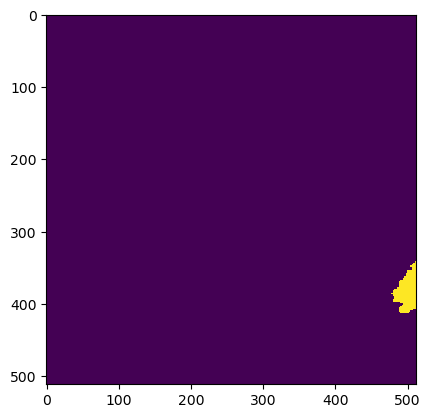

Wrote output/patches/mask/NN_S1_93-448208-0000-6289070-4000.tiff (512 x 512 pixels)


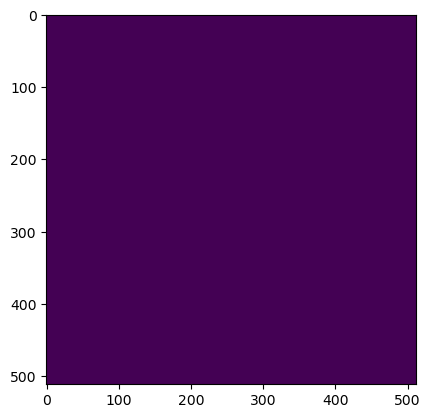

Wrote output/patches/mask/NN_S1_93-448208-0000-6289172-8000.tiff (512 x 512 pixels)


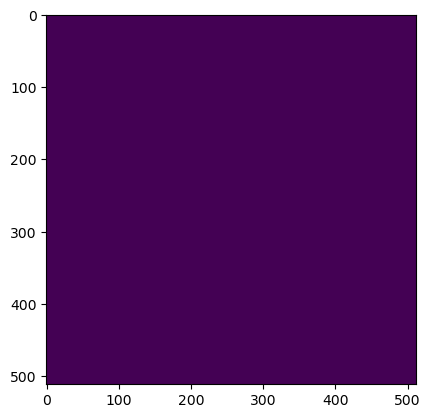

Wrote output/patches/mask/NN_S1_93-448208-0000-6289275-2000.tiff (512 x 512 pixels)


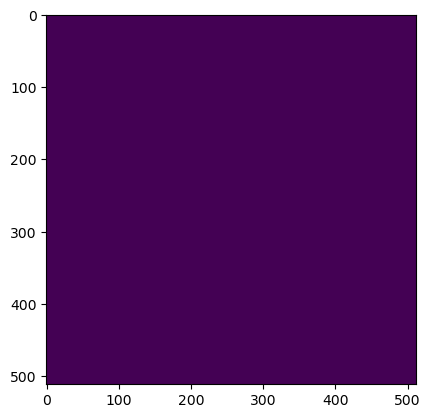

Wrote output/patches/mask/NN_S1_93-448208-0000-6289377-6000.tiff (512 x 512 pixels)


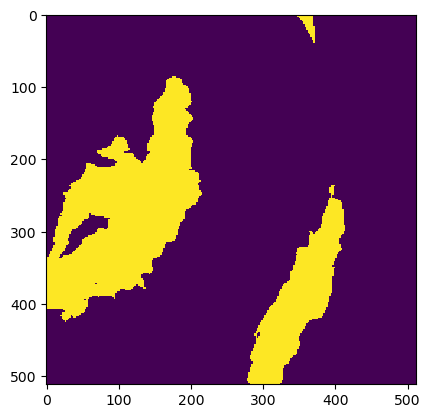

Wrote output/patches/mask/NN_S1_93-448310-4000-6289070-4000.tiff (512 x 512 pixels)


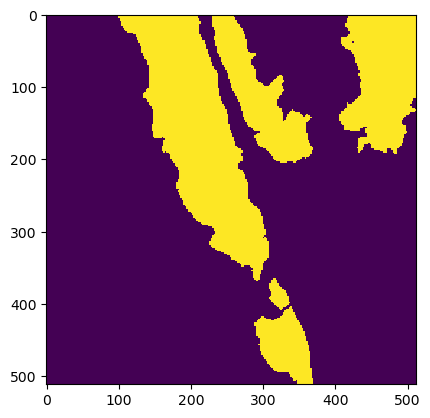

Wrote output/patches/mask/NN_S1_93-448310-4000-6289172-8000.tiff (512 x 512 pixels)


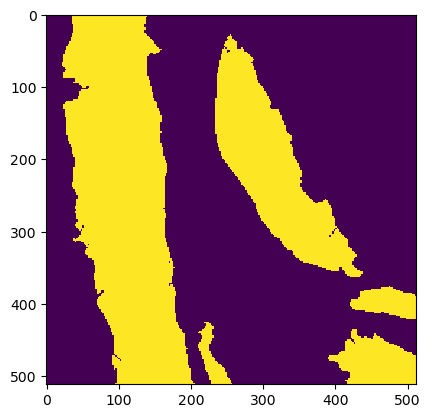

Wrote output/patches/mask/NN_S1_93-448310-4000-6289275-2000.tiff (512 x 512 pixels)


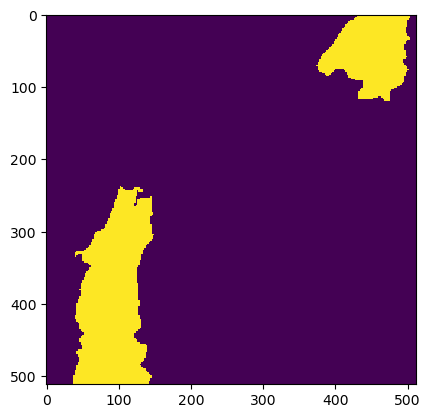

Wrote output/patches/mask/NN_S1_93-448310-4000-6289377-6000.tiff (512 x 512 pixels)
Zone NC_S1_94 Building Mask...


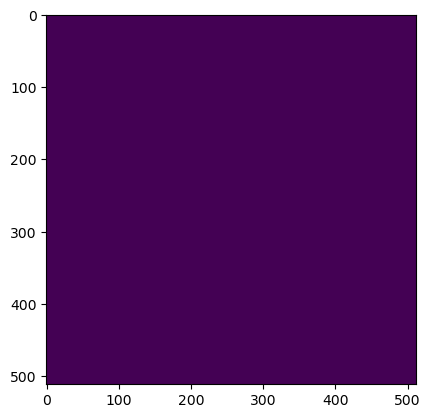

Wrote output/patches/mask/NC_S1_94-452048-0000-6289326-4000.tiff (512 x 512 pixels)


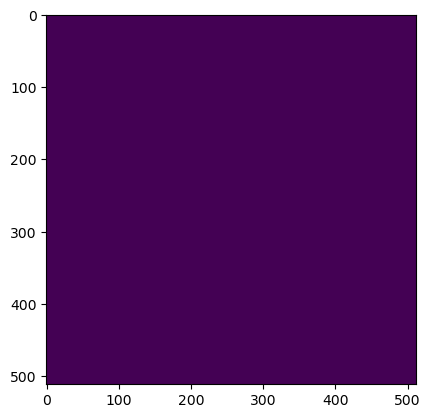

Wrote output/patches/mask/NC_S1_94-452048-0000-6289428-8000.tiff (512 x 512 pixels)


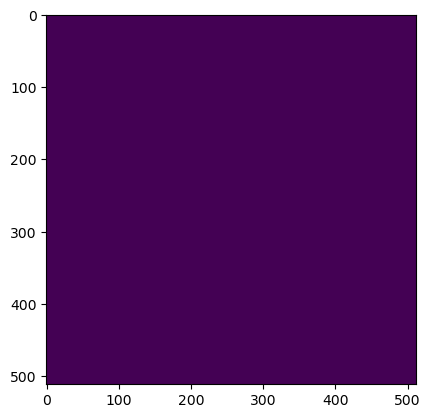

Wrote output/patches/mask/NC_S1_94-452150-4000-6289326-4000.tiff (512 x 512 pixels)


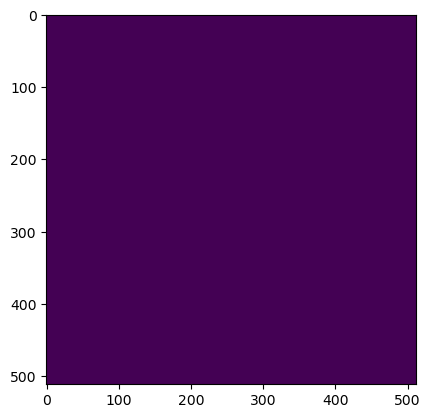

Wrote output/patches/mask/NC_S1_94-452150-4000-6289428-8000.tiff (512 x 512 pixels)
Zone NV_S1_95 Building Mask...


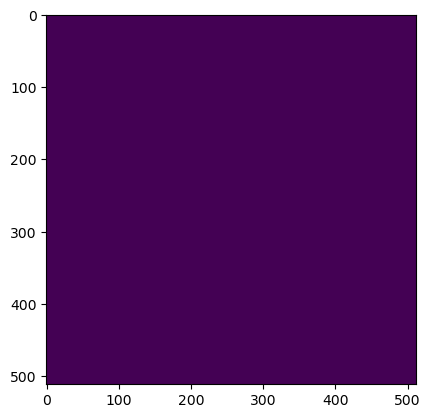

Wrote output/patches/mask/NV_S1_95-443088-0000-6289838-4000.tiff (512 x 512 pixels)


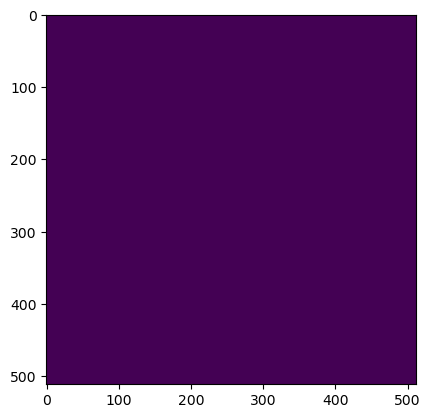

Wrote output/patches/mask/NV_S1_95-443088-0000-6289940-8000.tiff (512 x 512 pixels)


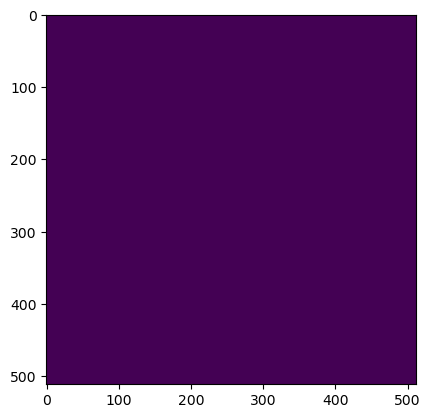

Wrote output/patches/mask/NV_S1_95-443088-0000-6290043-2000.tiff (512 x 512 pixels)


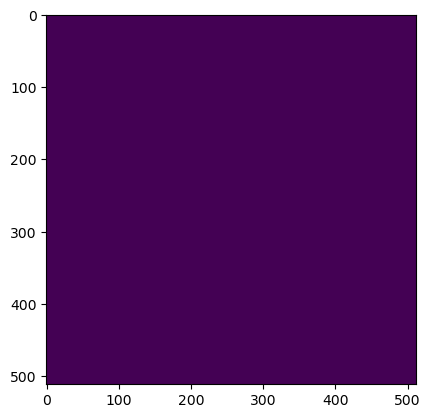

Wrote output/patches/mask/NV_S1_95-443088-0000-6290145-6000.tiff (512 x 512 pixels)


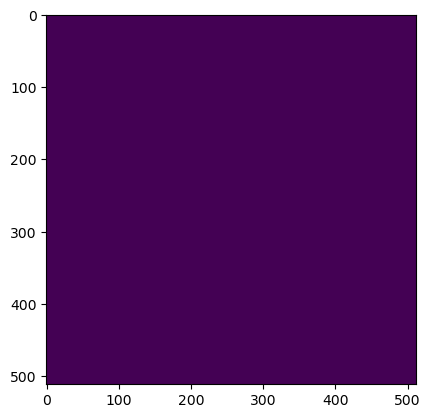

Wrote output/patches/mask/NV_S1_95-443088-0000-6290248-0000.tiff (512 x 512 pixels)


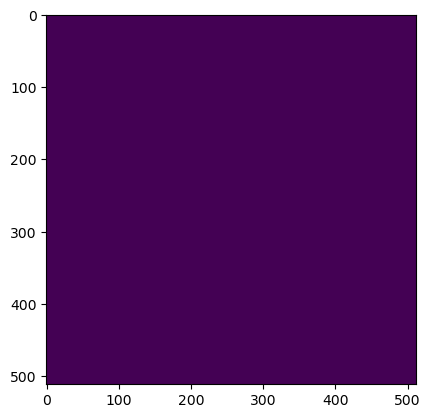

Wrote output/patches/mask/NV_S1_95-443088-0000-6290350-4000.tiff (512 x 512 pixels)


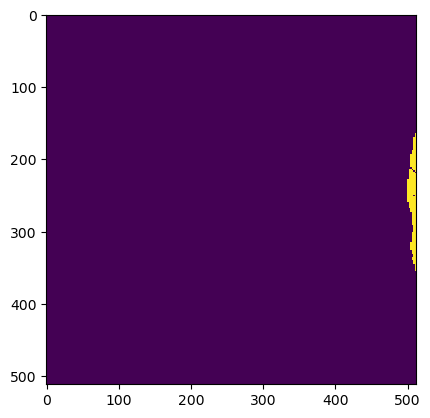

Wrote output/patches/mask/NV_S1_95-443088-0000-6290452-8000.tiff (512 x 512 pixels)


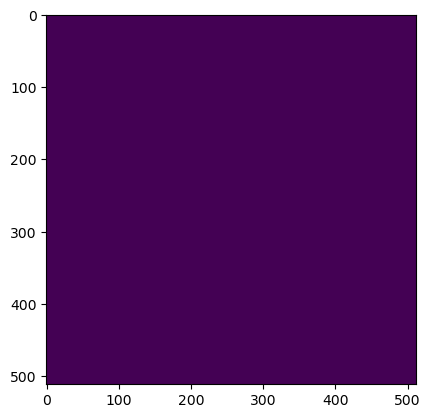

Wrote output/patches/mask/NV_S1_95-443190-4000-6289838-4000.tiff (512 x 512 pixels)


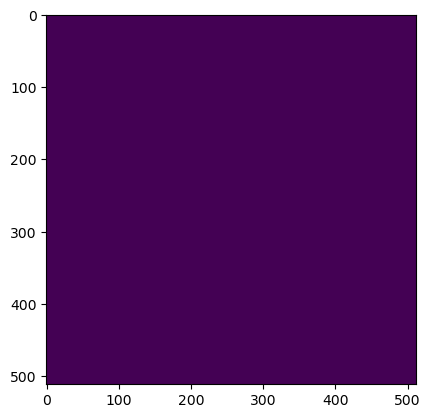

Wrote output/patches/mask/NV_S1_95-443190-4000-6289940-8000.tiff (512 x 512 pixels)


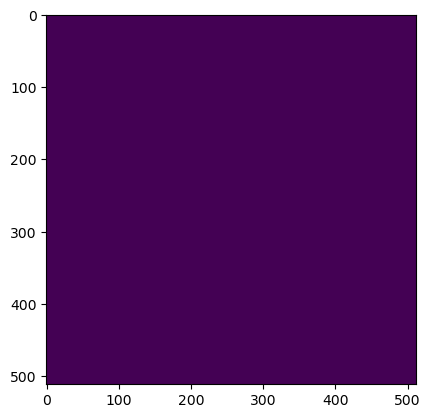

Wrote output/patches/mask/NV_S1_95-443190-4000-6290043-2000.tiff (512 x 512 pixels)


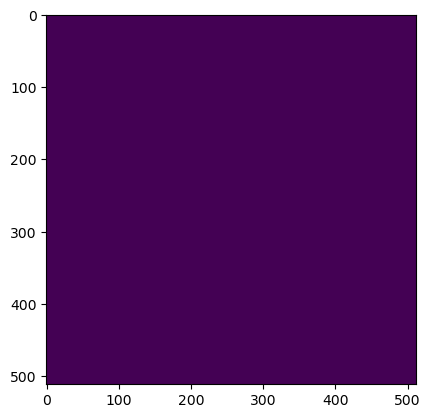

Wrote output/patches/mask/NV_S1_95-443190-4000-6290145-6000.tiff (512 x 512 pixels)


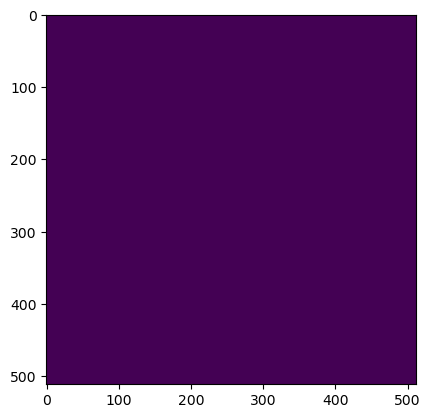

Wrote output/patches/mask/NV_S1_95-443190-4000-6290248-0000.tiff (512 x 512 pixels)


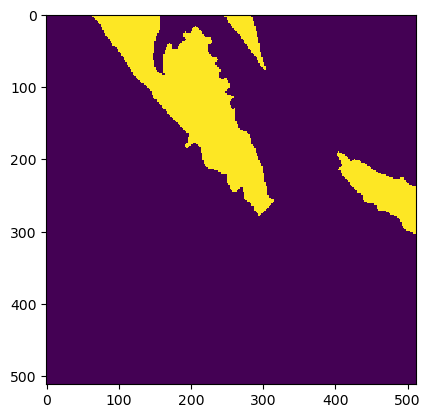

Wrote output/patches/mask/NV_S1_95-443190-4000-6290350-4000.tiff (512 x 512 pixels)


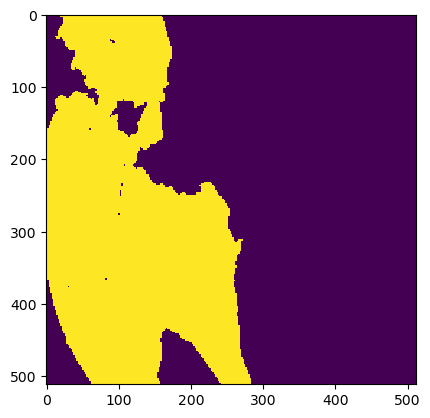

Wrote output/patches/mask/NV_S1_95-443190-4000-6290452-8000.tiff (512 x 512 pixels)


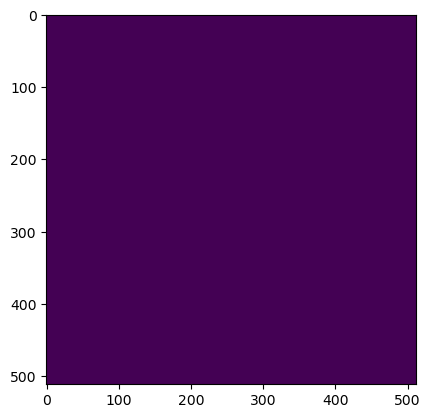

Wrote output/patches/mask/NV_S1_95-443292-8000-6289838-4000.tiff (512 x 512 pixels)


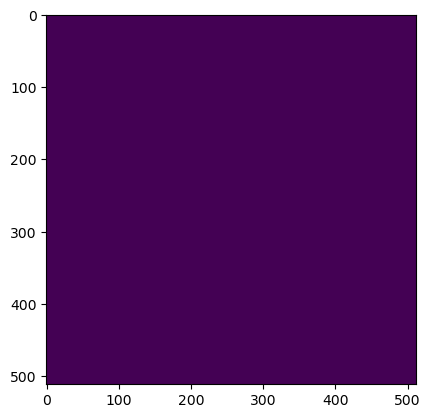

Wrote output/patches/mask/NV_S1_95-443292-8000-6289940-8000.tiff (512 x 512 pixels)


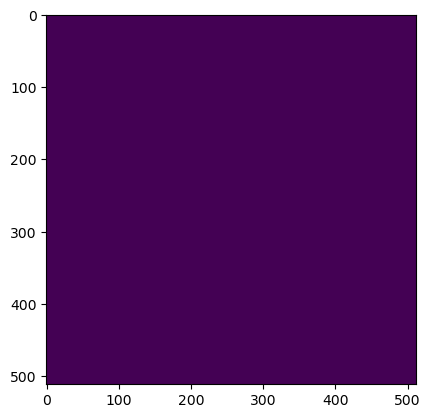

Wrote output/patches/mask/NV_S1_95-443292-8000-6290043-2000.tiff (512 x 512 pixels)


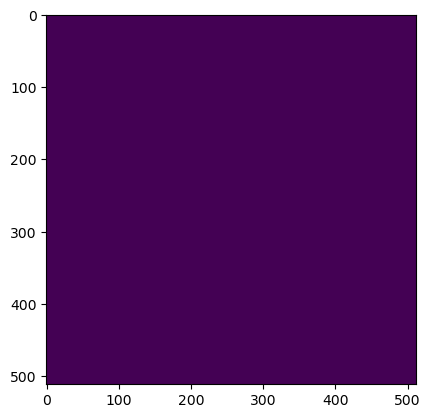

Wrote output/patches/mask/NV_S1_95-443292-8000-6290145-6000.tiff (512 x 512 pixels)


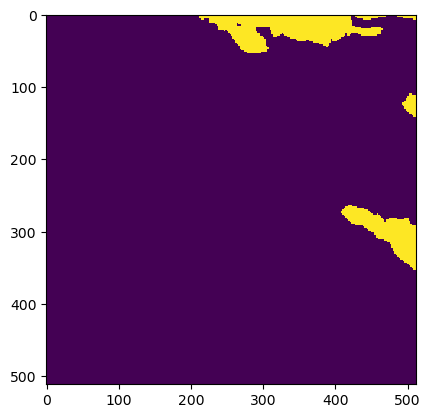

Wrote output/patches/mask/NV_S1_95-443292-8000-6290248-0000.tiff (512 x 512 pixels)


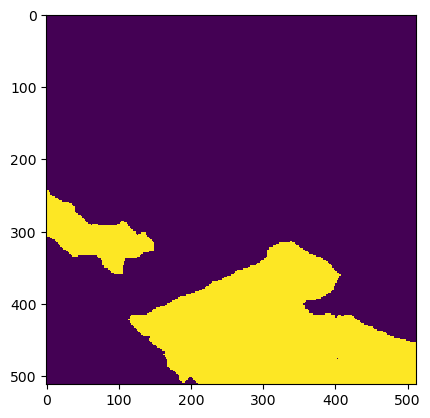

Wrote output/patches/mask/NV_S1_95-443292-8000-6290350-4000.tiff (512 x 512 pixels)


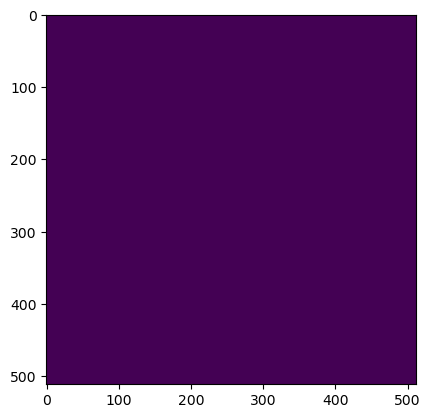

Wrote output/patches/mask/NV_S1_95-443292-8000-6290452-8000.tiff (512 x 512 pixels)


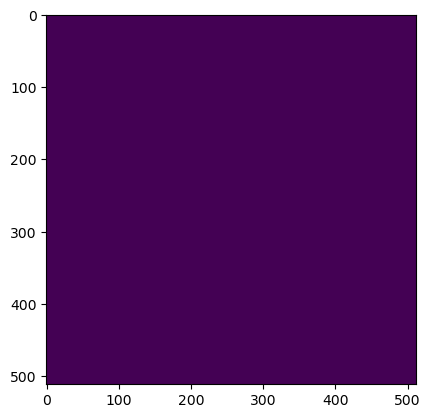

Wrote output/patches/mask/NV_S1_95-443395-2000-6289838-4000.tiff (512 x 512 pixels)


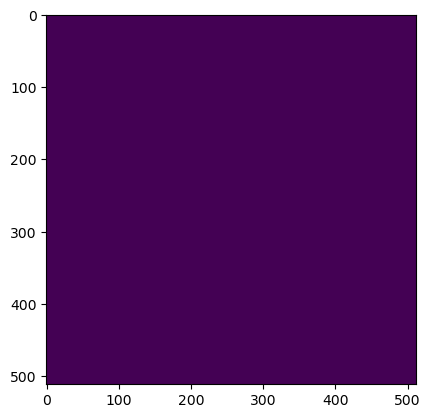

Wrote output/patches/mask/NV_S1_95-443395-2000-6289940-8000.tiff (512 x 512 pixels)


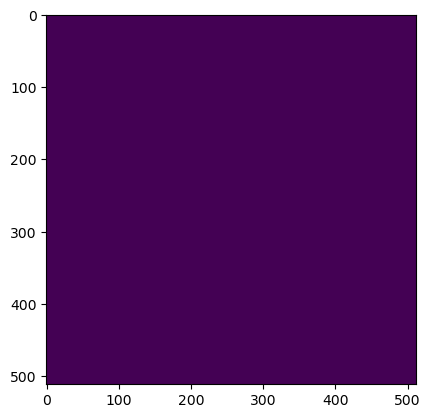

Wrote output/patches/mask/NV_S1_95-443395-2000-6290043-2000.tiff (512 x 512 pixels)


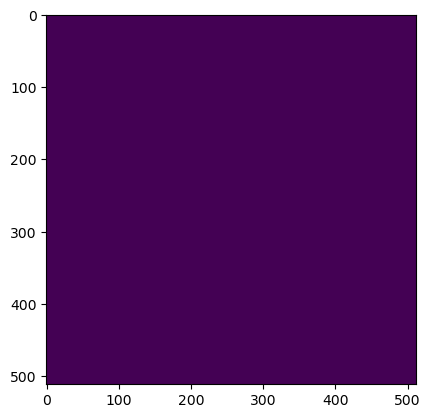

Wrote output/patches/mask/NV_S1_95-443395-2000-6290145-6000.tiff (512 x 512 pixels)


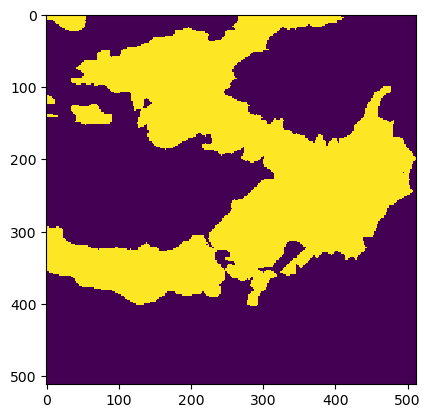

Wrote output/patches/mask/NV_S1_95-443395-2000-6290248-0000.tiff (512 x 512 pixels)


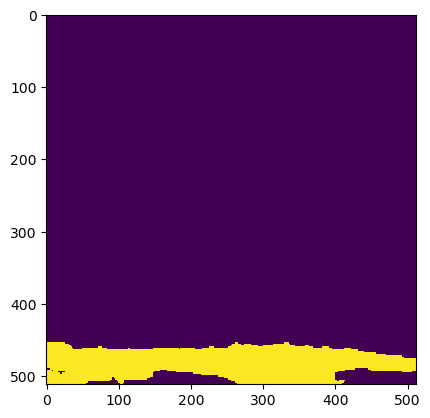

Wrote output/patches/mask/NV_S1_95-443395-2000-6290350-4000.tiff (512 x 512 pixels)


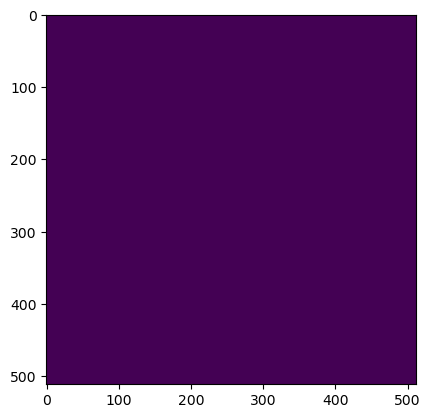

Wrote output/patches/mask/NV_S1_95-443395-2000-6290452-8000.tiff (512 x 512 pixels)


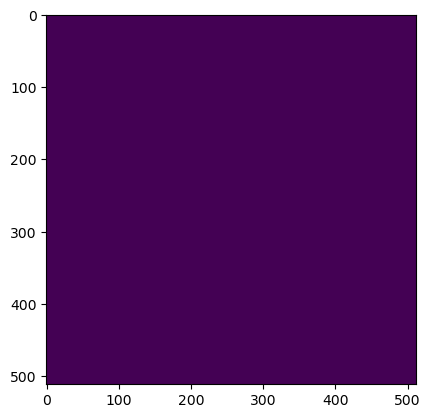

Wrote output/patches/mask/NV_S1_95-443497-6000-6289838-4000.tiff (512 x 512 pixels)


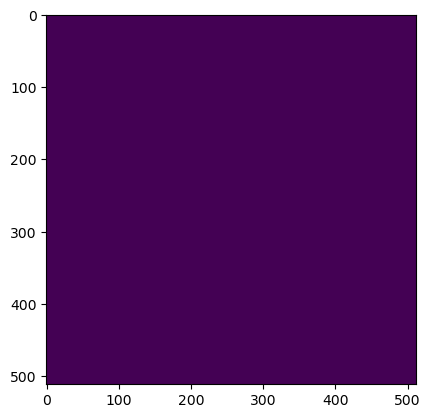

Wrote output/patches/mask/NV_S1_95-443497-6000-6289940-8000.tiff (512 x 512 pixels)


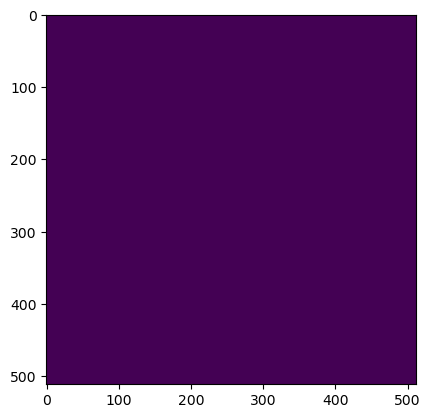

Wrote output/patches/mask/NV_S1_95-443497-6000-6290043-2000.tiff (512 x 512 pixels)


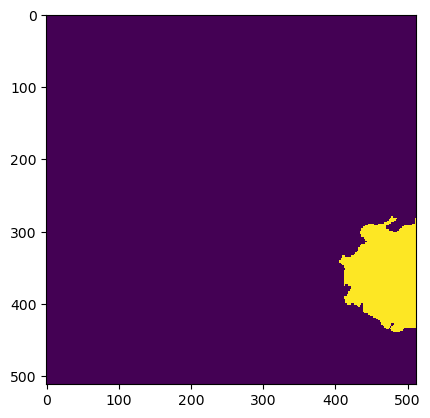

Wrote output/patches/mask/NV_S1_95-443497-6000-6290145-6000.tiff (512 x 512 pixels)


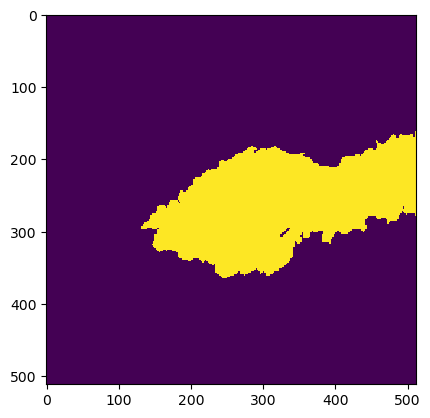

Wrote output/patches/mask/NV_S1_95-443497-6000-6290248-0000.tiff (512 x 512 pixels)


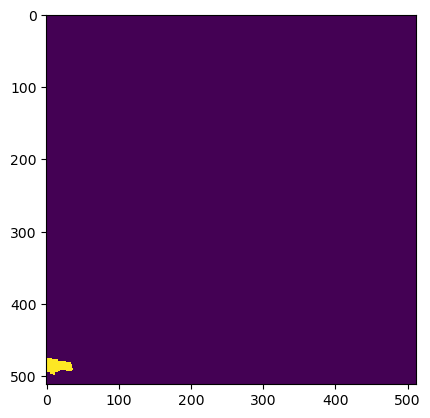

Wrote output/patches/mask/NV_S1_95-443497-6000-6290350-4000.tiff (512 x 512 pixels)


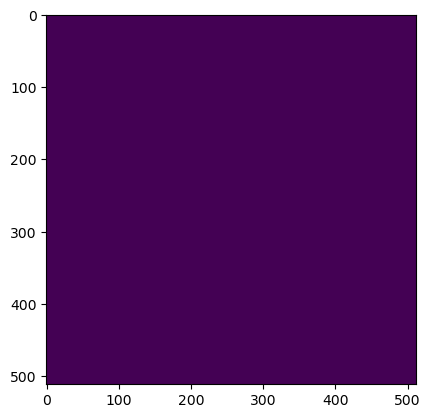

Wrote output/patches/mask/NV_S1_95-443497-6000-6290452-8000.tiff (512 x 512 pixels)


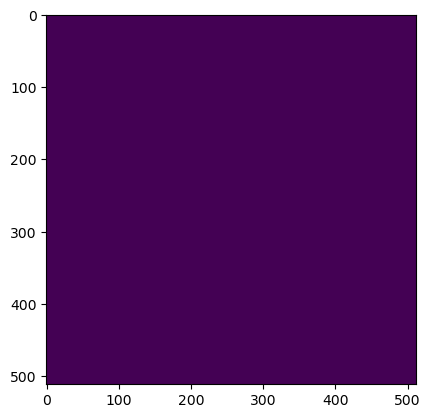

Wrote output/patches/mask/NV_S1_95-443600-0000-6289838-4000.tiff (512 x 512 pixels)


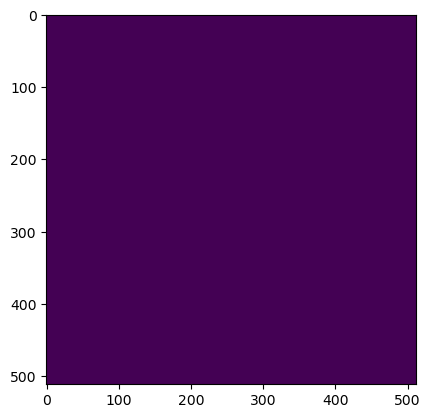

Wrote output/patches/mask/NV_S1_95-443600-0000-6289940-8000.tiff (512 x 512 pixels)


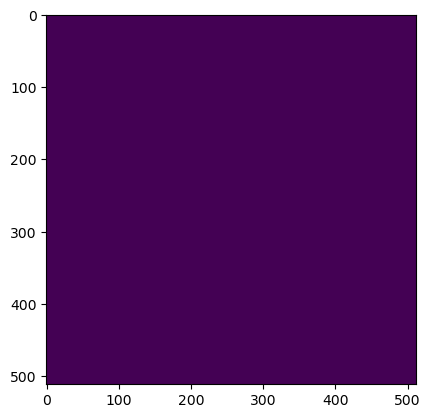

Wrote output/patches/mask/NV_S1_95-443600-0000-6290043-2000.tiff (512 x 512 pixels)


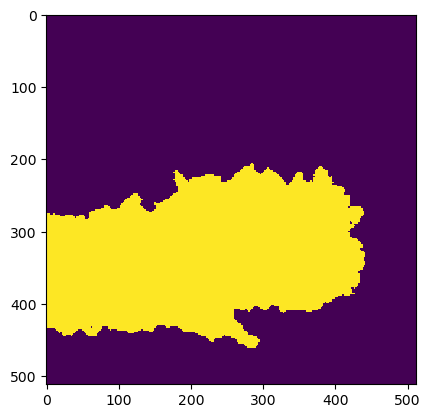

Wrote output/patches/mask/NV_S1_95-443600-0000-6290145-6000.tiff (512 x 512 pixels)


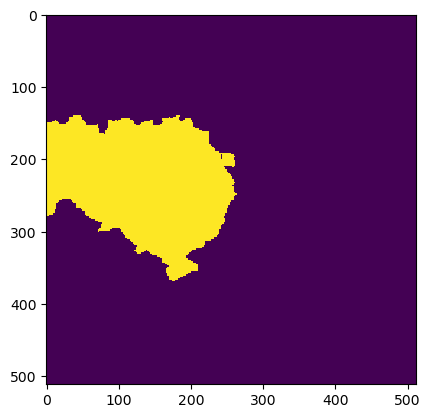

Wrote output/patches/mask/NV_S1_95-443600-0000-6290248-0000.tiff (512 x 512 pixels)


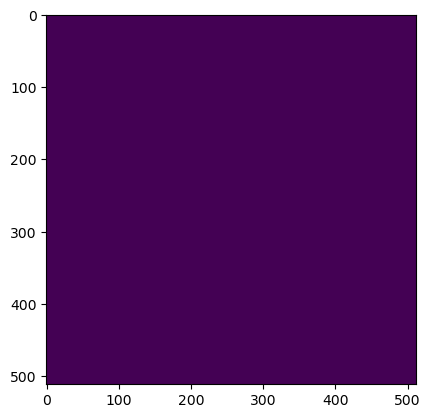

Wrote output/patches/mask/NV_S1_95-443600-0000-6290350-4000.tiff (512 x 512 pixels)


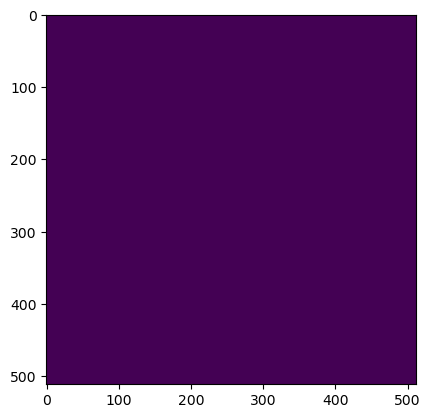

Wrote output/patches/mask/NV_S1_95-443600-0000-6290452-8000.tiff (512 x 512 pixels)


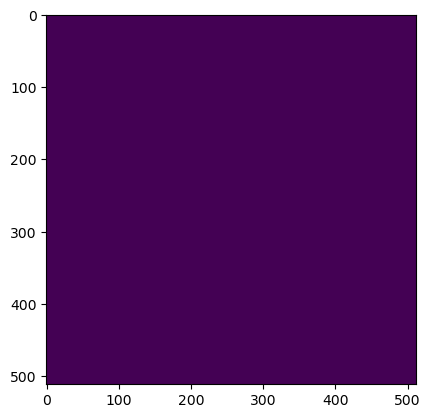

Wrote output/patches/mask/NV_S1_95-443702-4000-6289838-4000.tiff (512 x 512 pixels)


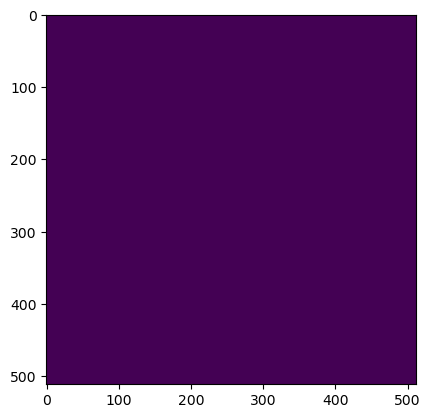

Wrote output/patches/mask/NV_S1_95-443702-4000-6289940-8000.tiff (512 x 512 pixels)


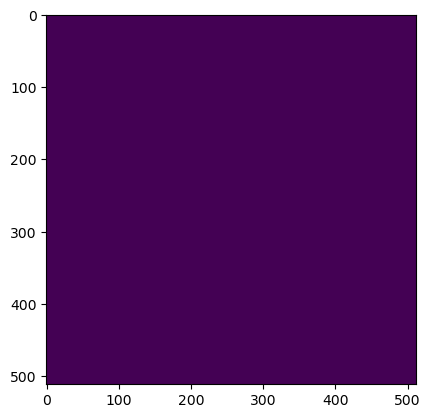

Wrote output/patches/mask/NV_S1_95-443702-4000-6290043-2000.tiff (512 x 512 pixels)


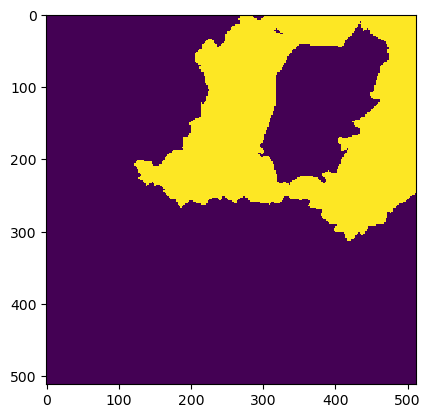

Wrote output/patches/mask/NV_S1_95-443702-4000-6290145-6000.tiff (512 x 512 pixels)


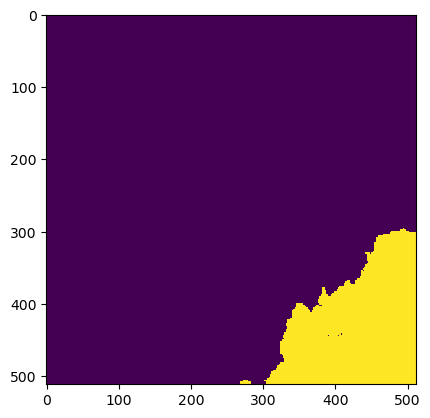

Wrote output/patches/mask/NV_S1_95-443702-4000-6290248-0000.tiff (512 x 512 pixels)


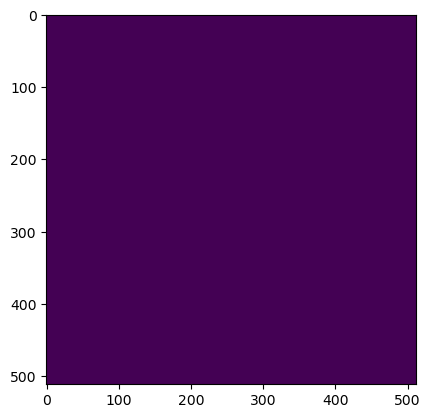

Wrote output/patches/mask/NV_S1_95-443702-4000-6290350-4000.tiff (512 x 512 pixels)


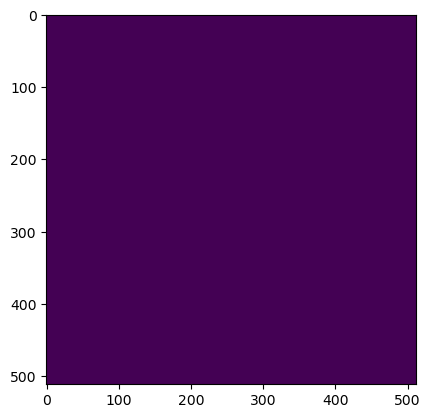

Wrote output/patches/mask/NV_S1_95-443702-4000-6290452-8000.tiff (512 x 512 pixels)
Zone UU_S1_96 Building Mask...


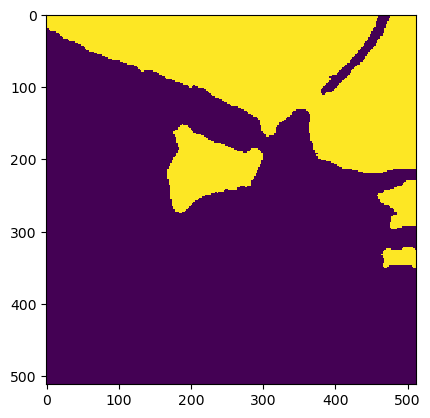

Wrote output/patches/mask/UU_S1_96-445648-0000-6289582-4000.tiff (512 x 512 pixels)


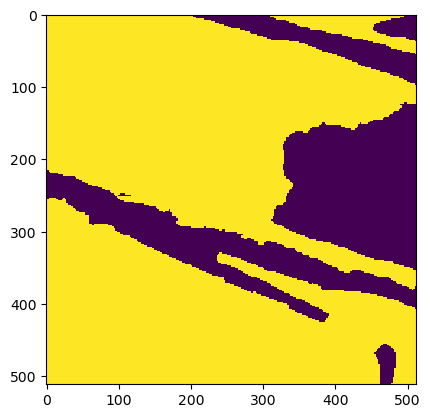

Wrote output/patches/mask/UU_S1_96-445648-0000-6289684-8000.tiff (512 x 512 pixels)


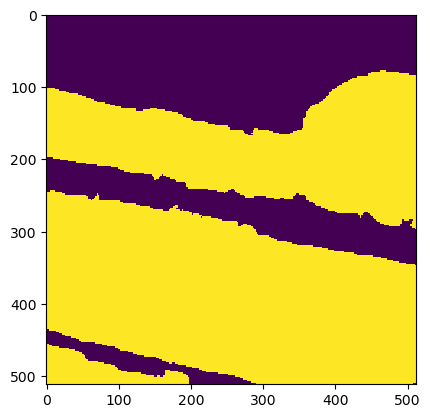

Wrote output/patches/mask/UU_S1_96-445648-0000-6289787-2000.tiff (512 x 512 pixels)


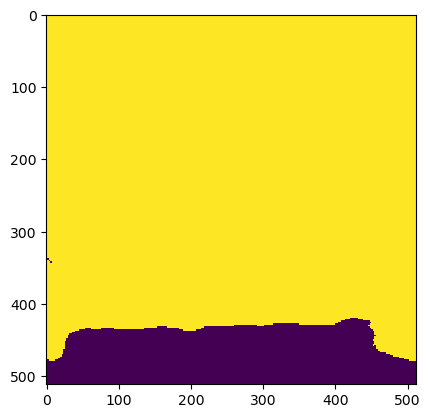

Wrote output/patches/mask/UU_S1_96-445648-0000-6289889-6000.tiff (512 x 512 pixels)


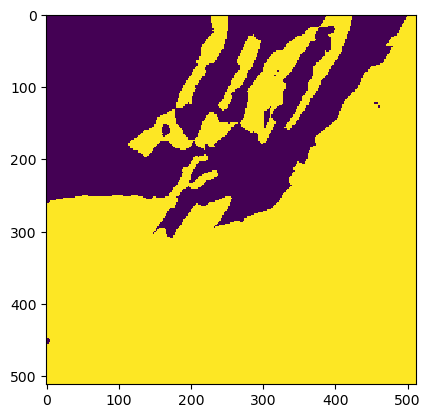

Wrote output/patches/mask/UU_S1_96-445648-0000-6289992-0000.tiff (512 x 512 pixels)


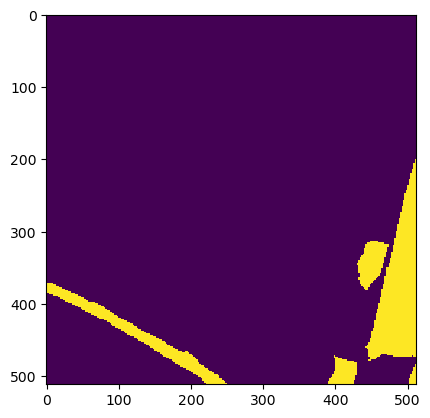

Wrote output/patches/mask/UU_S1_96-445648-0000-6290094-4000.tiff (512 x 512 pixels)


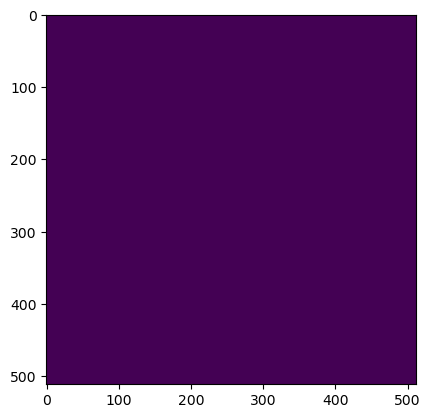

Wrote output/patches/mask/UU_S1_96-445648-0000-6290196-8000.tiff (512 x 512 pixels)


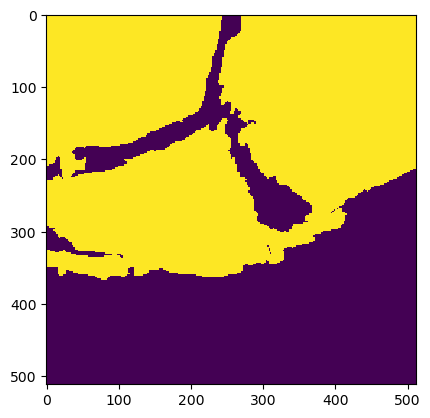

Wrote output/patches/mask/UU_S1_96-445750-4000-6289582-4000.tiff (512 x 512 pixels)


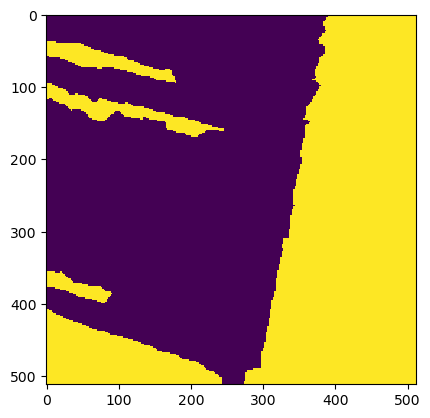

Wrote output/patches/mask/UU_S1_96-445750-4000-6289684-8000.tiff (512 x 512 pixels)


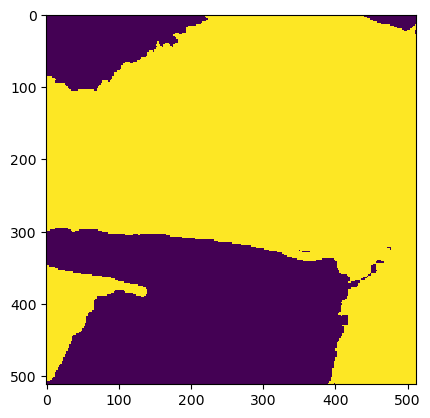

Wrote output/patches/mask/UU_S1_96-445750-4000-6289787-2000.tiff (512 x 512 pixels)


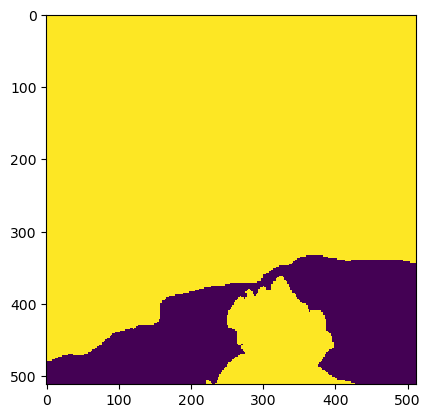

Wrote output/patches/mask/UU_S1_96-445750-4000-6289889-6000.tiff (512 x 512 pixels)


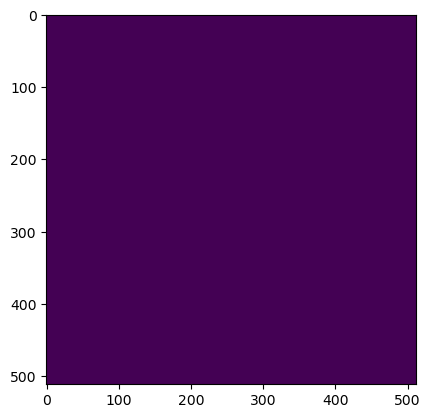

Wrote output/patches/mask/UU_S1_96-445750-4000-6289992-0000.tiff (512 x 512 pixels)


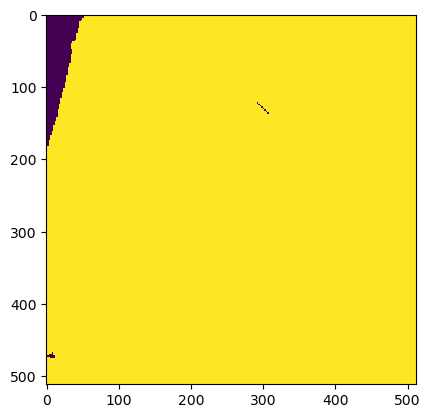

Wrote output/patches/mask/UU_S1_96-445750-4000-6290094-4000.tiff (512 x 512 pixels)


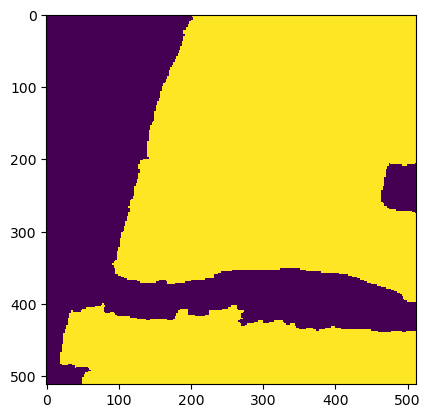

Wrote output/patches/mask/UU_S1_96-445750-4000-6290196-8000.tiff (512 x 512 pixels)


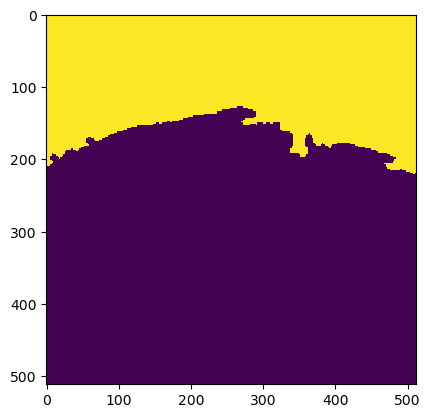

Wrote output/patches/mask/UU_S1_96-445852-8000-6289582-4000.tiff (512 x 512 pixels)


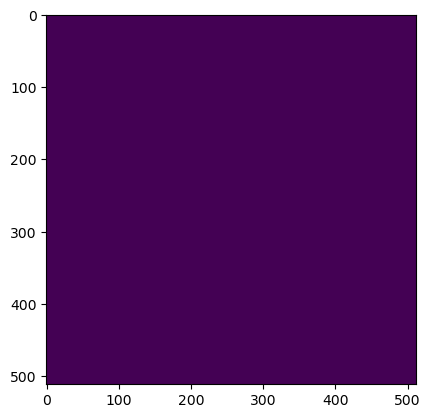

Wrote output/patches/mask/UU_S1_96-445852-8000-6289684-8000.tiff (512 x 512 pixels)


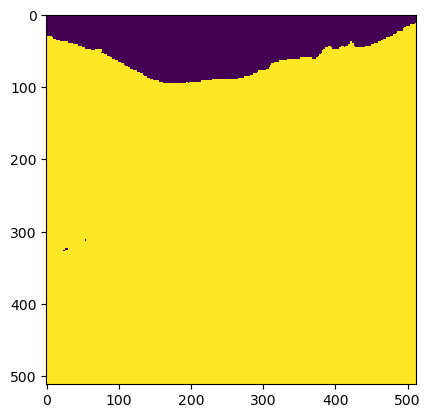

Wrote output/patches/mask/UU_S1_96-445852-8000-6289787-2000.tiff (512 x 512 pixels)


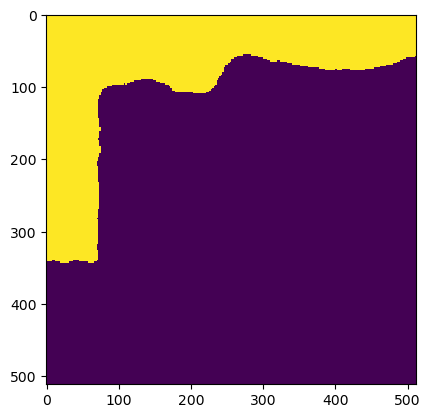

Wrote output/patches/mask/UU_S1_96-445852-8000-6289889-6000.tiff (512 x 512 pixels)


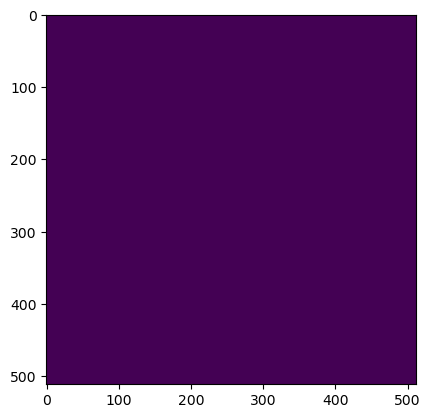

Wrote output/patches/mask/UU_S1_96-445852-8000-6289992-0000.tiff (512 x 512 pixels)


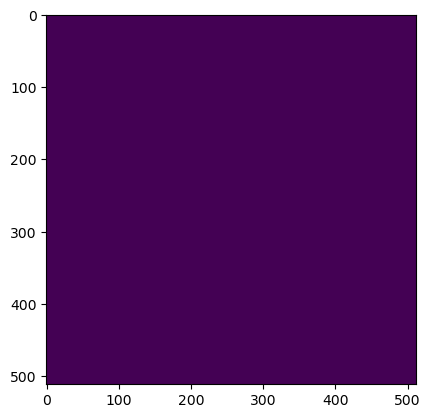

Wrote output/patches/mask/UU_S1_96-445852-8000-6290094-4000.tiff (512 x 512 pixels)


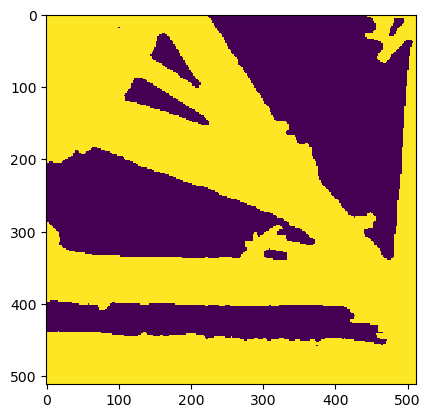

Wrote output/patches/mask/UU_S1_96-445852-8000-6290196-8000.tiff (512 x 512 pixels)


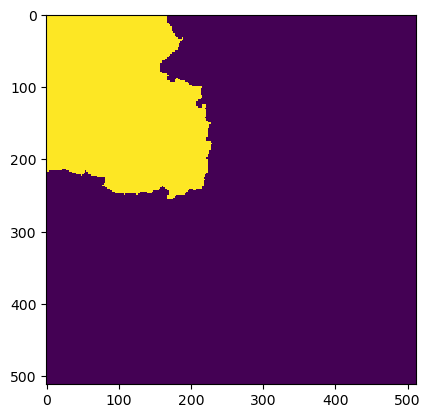

Wrote output/patches/mask/UU_S1_96-445955-2000-6289582-4000.tiff (512 x 512 pixels)


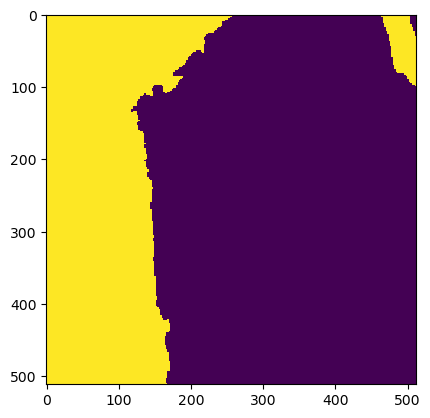

Wrote output/patches/mask/UU_S1_96-445955-2000-6289684-8000.tiff (512 x 512 pixels)


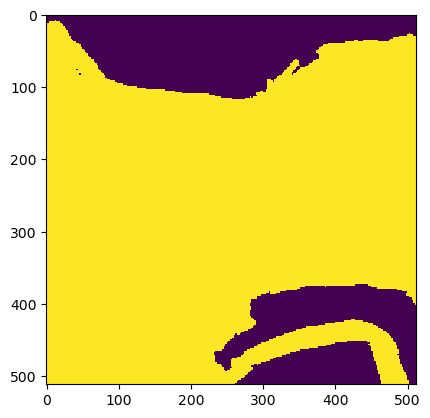

Wrote output/patches/mask/UU_S1_96-445955-2000-6289787-2000.tiff (512 x 512 pixels)


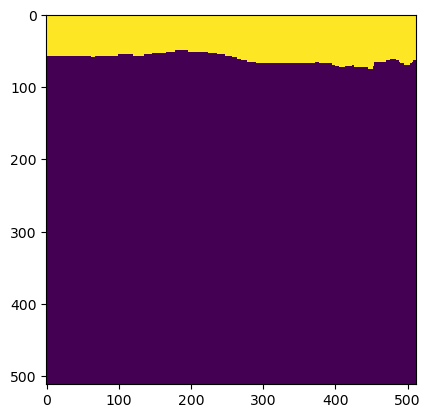

Wrote output/patches/mask/UU_S1_96-445955-2000-6289889-6000.tiff (512 x 512 pixels)


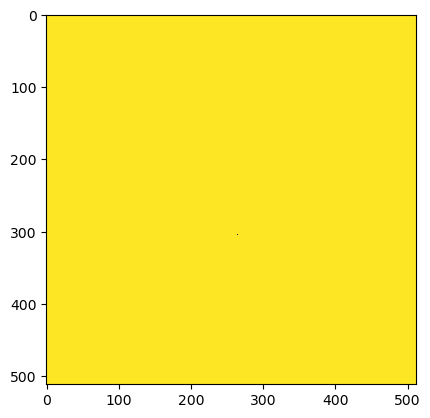

Wrote output/patches/mask/UU_S1_96-445955-2000-6289992-0000.tiff (512 x 512 pixels)


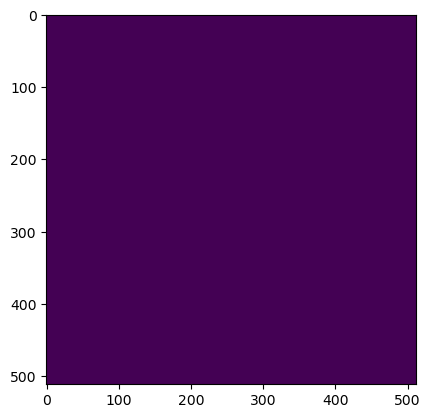

Wrote output/patches/mask/UU_S1_96-445955-2000-6290094-4000.tiff (512 x 512 pixels)


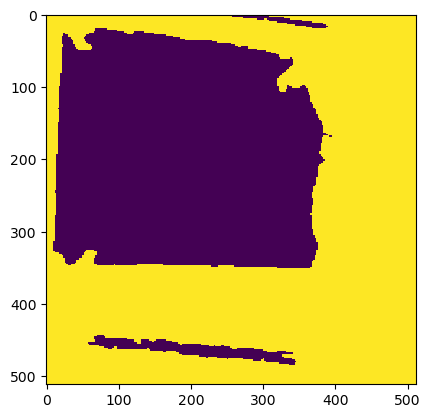

Wrote output/patches/mask/UU_S1_96-445955-2000-6290196-8000.tiff (512 x 512 pixels)
Zone CN_S1_97 Building Mask...


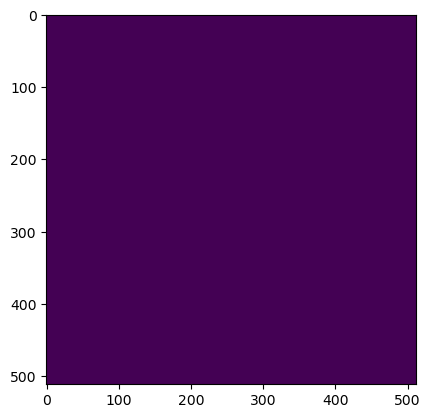

Wrote output/patches/mask/CN_S1_97-449232-0000-6289838-4000.tiff (512 x 512 pixels)


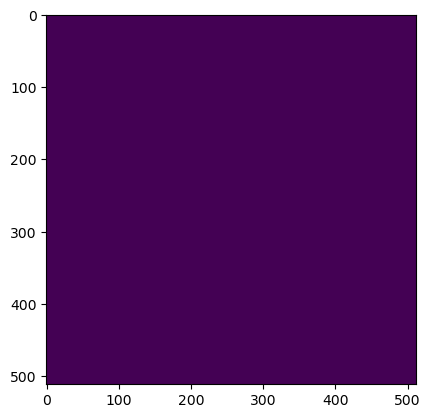

Wrote output/patches/mask/CN_S1_97-449232-0000-6289940-8000.tiff (512 x 512 pixels)


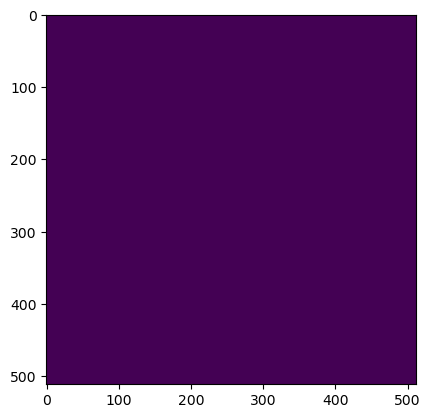

Wrote output/patches/mask/CN_S1_97-449232-0000-6290043-2000.tiff (512 x 512 pixels)


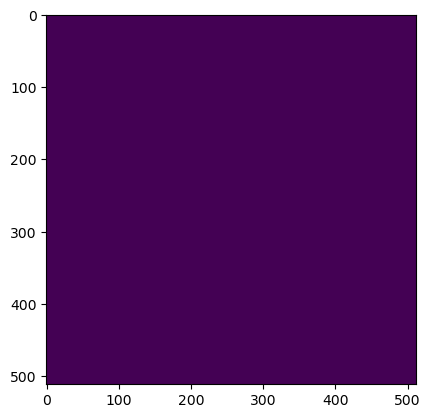

Wrote output/patches/mask/CN_S1_97-449232-0000-6290145-6000.tiff (512 x 512 pixels)


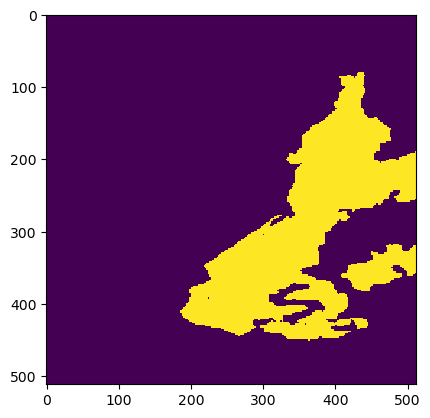

Wrote output/patches/mask/CN_S1_97-449334-4000-6289838-4000.tiff (512 x 512 pixels)


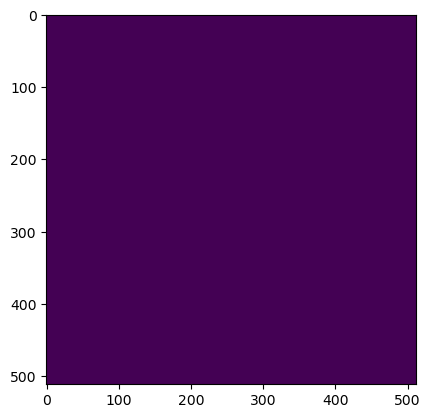

Wrote output/patches/mask/CN_S1_97-449334-4000-6289940-8000.tiff (512 x 512 pixels)


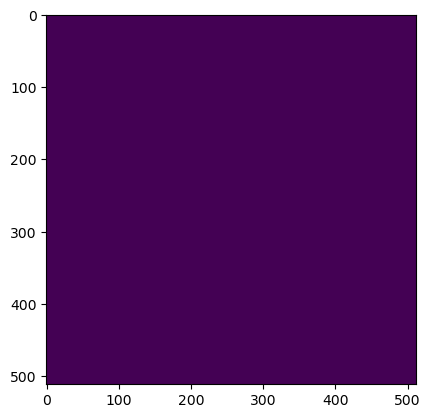

Wrote output/patches/mask/CN_S1_97-449334-4000-6290043-2000.tiff (512 x 512 pixels)


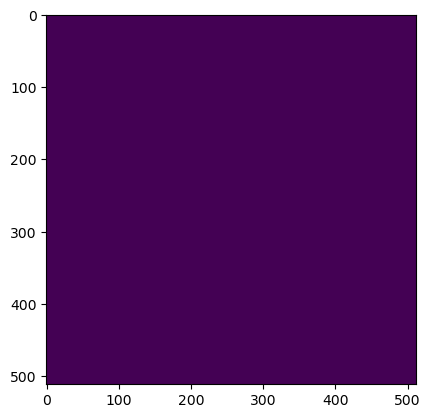

Wrote output/patches/mask/CN_S1_97-449334-4000-6290145-6000.tiff (512 x 512 pixels)


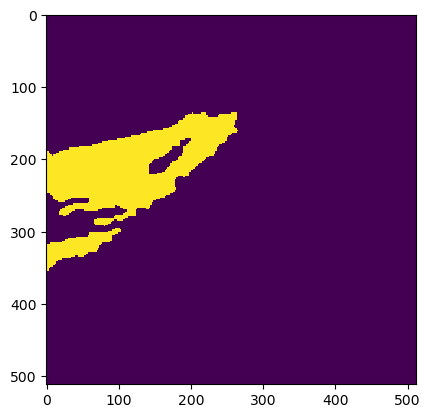

Wrote output/patches/mask/CN_S1_97-449436-8000-6289838-4000.tiff (512 x 512 pixels)


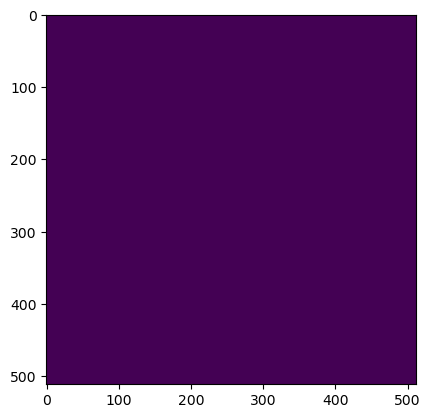

Wrote output/patches/mask/CN_S1_97-449436-8000-6289940-8000.tiff (512 x 512 pixels)


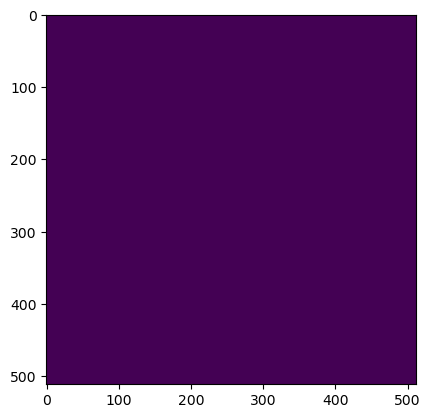

Wrote output/patches/mask/CN_S1_97-449436-8000-6290043-2000.tiff (512 x 512 pixels)


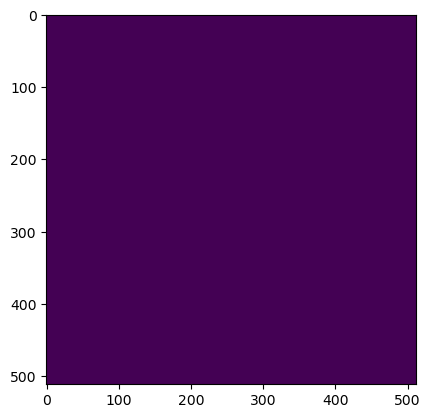

Wrote output/patches/mask/CN_S1_97-449436-8000-6290145-6000.tiff (512 x 512 pixels)


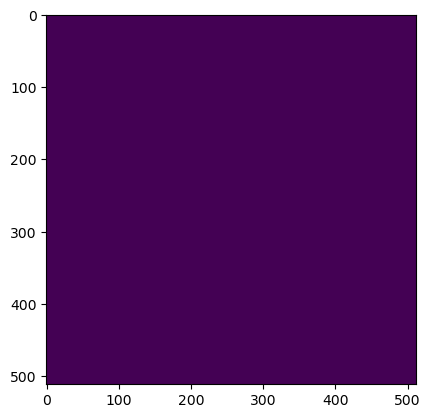

Wrote output/patches/mask/CN_S1_97-449539-2000-6289838-4000.tiff (512 x 512 pixels)


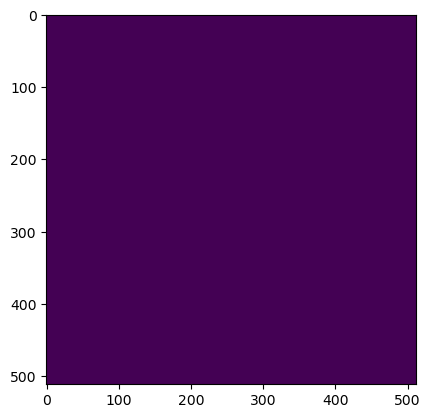

Wrote output/patches/mask/CN_S1_97-449539-2000-6289940-8000.tiff (512 x 512 pixels)


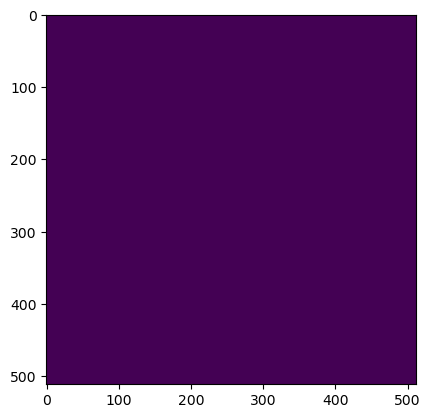

Wrote output/patches/mask/CN_S1_97-449539-2000-6290043-2000.tiff (512 x 512 pixels)


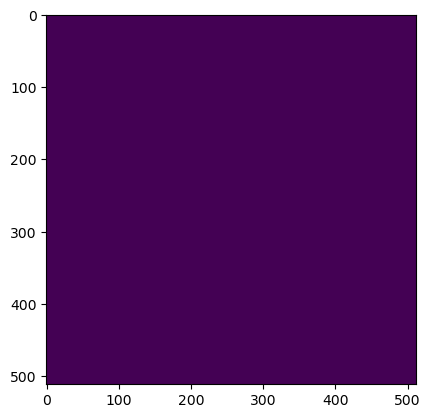

Wrote output/patches/mask/CN_S1_97-449539-2000-6290145-6000.tiff (512 x 512 pixels)
Zone CU_S1_98 Building Mask...


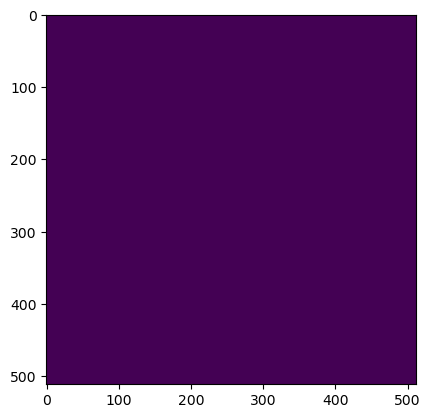

Wrote output/patches/mask/CU_S1_98-468176-0000-6290606-4000.tiff (512 x 512 pixels)


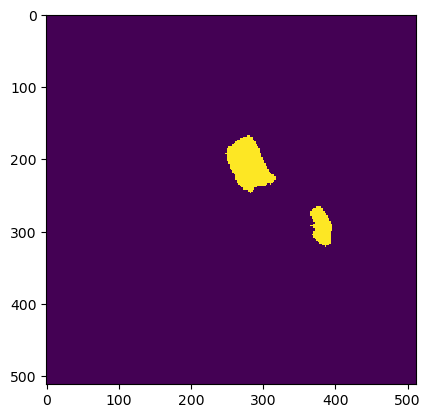

Wrote output/patches/mask/CU_S1_98-468176-0000-6290708-8000.tiff (512 x 512 pixels)


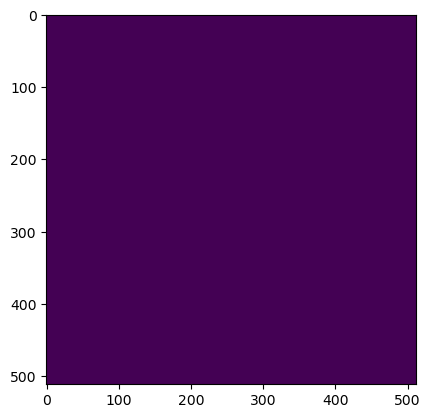

Wrote output/patches/mask/CU_S1_98-468278-4000-6290606-4000.tiff (512 x 512 pixels)


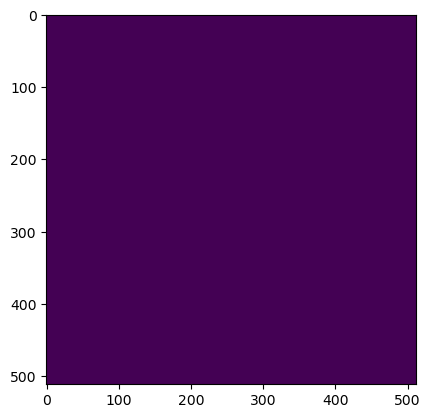

Wrote output/patches/mask/CU_S1_98-468278-4000-6290708-8000.tiff (512 x 512 pixels)
Zone NN_S1_99 Building Mask...


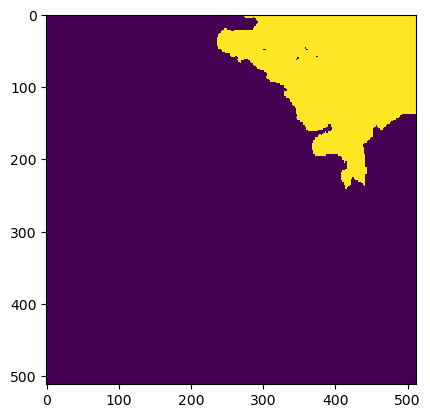

Wrote output/patches/mask/NN_S1_99-442320-0000-6290606-4000.tiff (512 x 512 pixels)


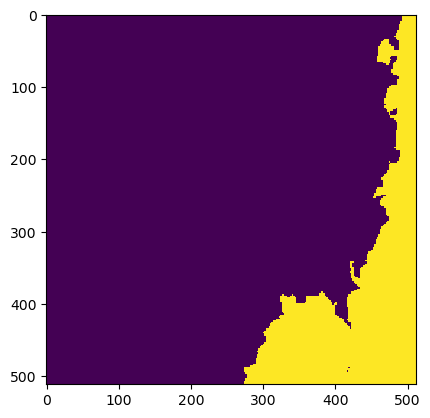

Wrote output/patches/mask/NN_S1_99-442320-0000-6290708-8000.tiff (512 x 512 pixels)


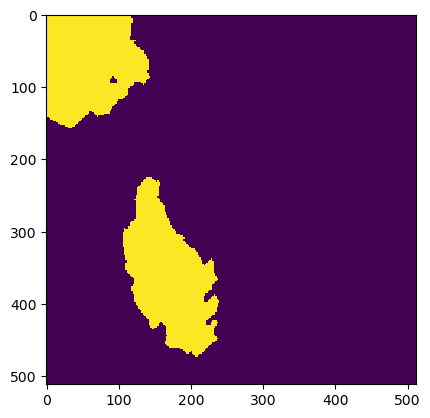

Wrote output/patches/mask/NN_S1_99-442422-4000-6290606-4000.tiff (512 x 512 pixels)


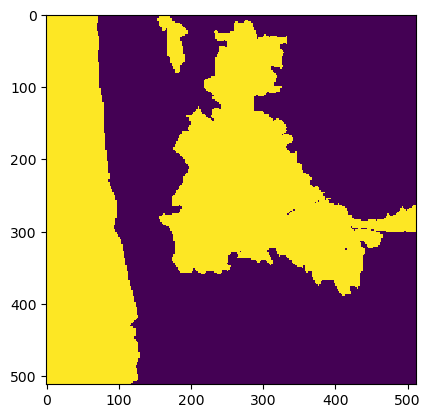

Wrote output/patches/mask/NN_S1_99-442422-4000-6290708-8000.tiff (512 x 512 pixels)


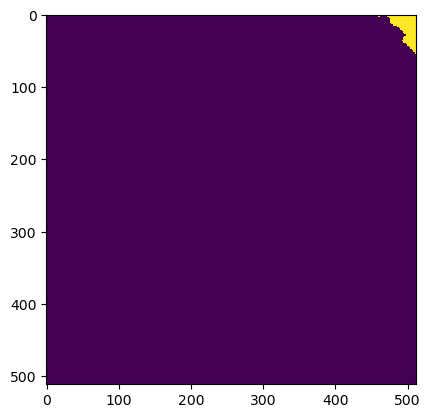

Wrote output/patches/mask/NN_S1_99-442524-8000-6290606-4000.tiff (512 x 512 pixels)


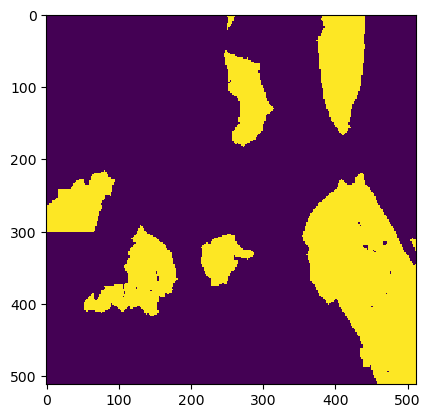

Wrote output/patches/mask/NN_S1_99-442524-8000-6290708-8000.tiff (512 x 512 pixels)


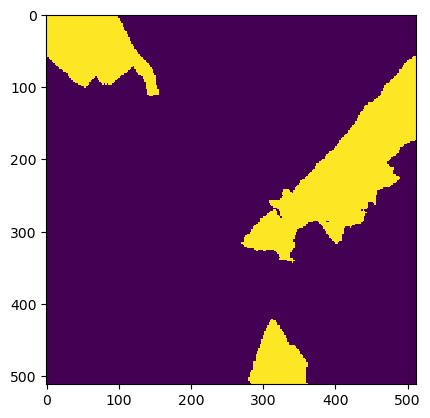

Wrote output/patches/mask/NN_S1_99-442627-2000-6290606-4000.tiff (512 x 512 pixels)


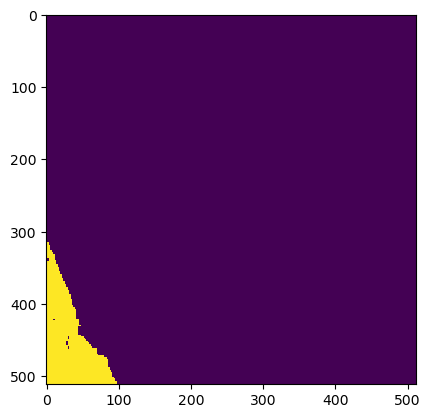

Wrote output/patches/mask/NN_S1_99-442627-2000-6290708-8000.tiff (512 x 512 pixels)
Zone VV_S1_100 Building Mask...


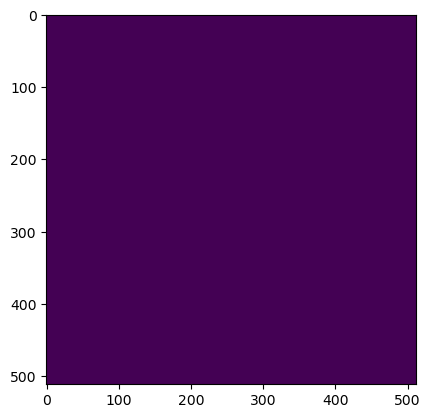

Wrote output/patches/mask/VV_S1_100-499920-0000-6290862-4000.tiff (512 x 512 pixels)


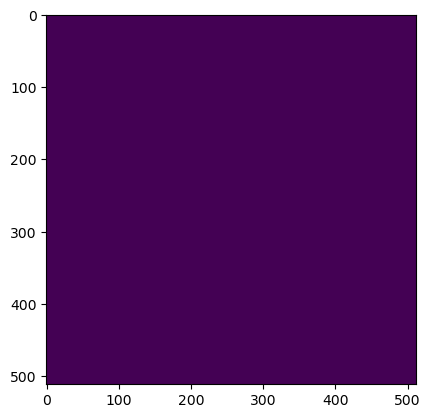

Wrote output/patches/mask/VV_S1_100-499920-0000-6290964-8000.tiff (512 x 512 pixels)


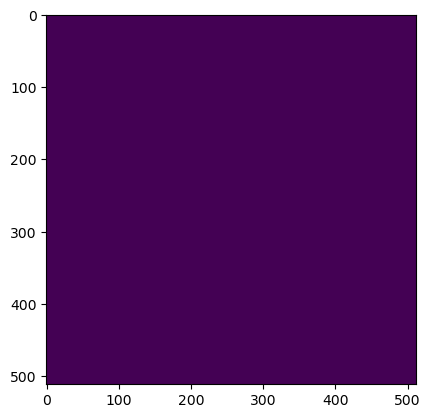

Wrote output/patches/mask/VV_S1_100-499920-0000-6291067-2000.tiff (512 x 512 pixels)


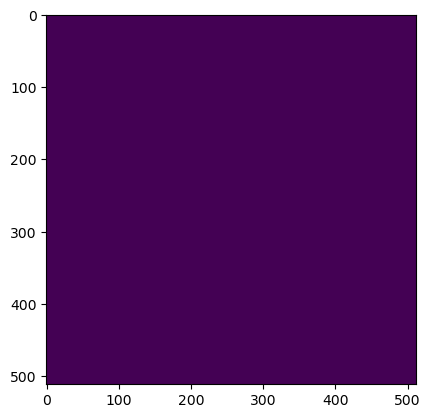

Wrote output/patches/mask/VV_S1_100-499920-0000-6291169-6000.tiff (512 x 512 pixels)


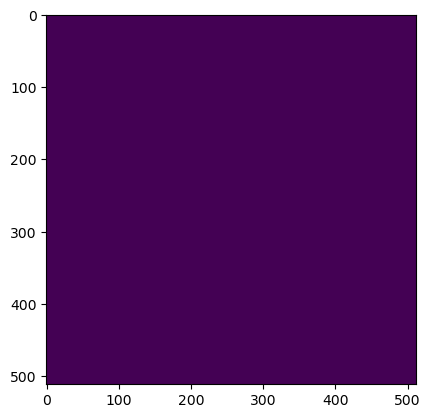

Wrote output/patches/mask/VV_S1_100-500022-4000-6290862-4000.tiff (512 x 512 pixels)


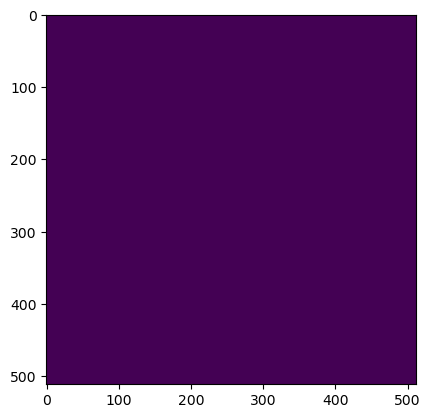

Wrote output/patches/mask/VV_S1_100-500022-4000-6290964-8000.tiff (512 x 512 pixels)


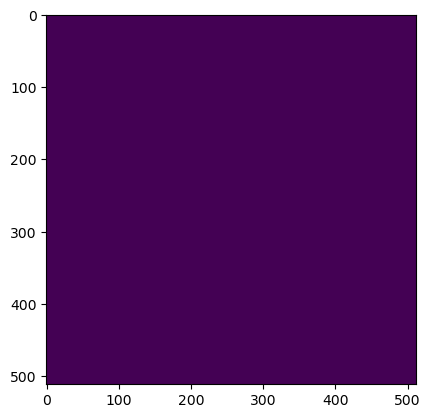

Wrote output/patches/mask/VV_S1_100-500022-4000-6291067-2000.tiff (512 x 512 pixels)


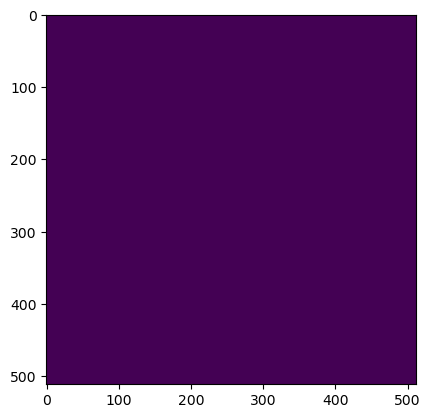

Wrote output/patches/mask/VV_S1_100-500022-4000-6291169-6000.tiff (512 x 512 pixels)
Zone UV_S1_101 Building Mask...


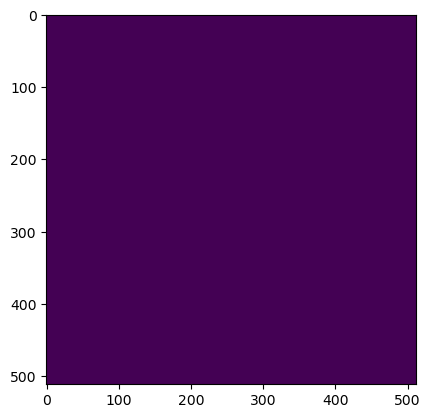

Wrote output/patches/mask/UV_S1_101-541392-0000-6291118-4000.tiff (512 x 512 pixels)


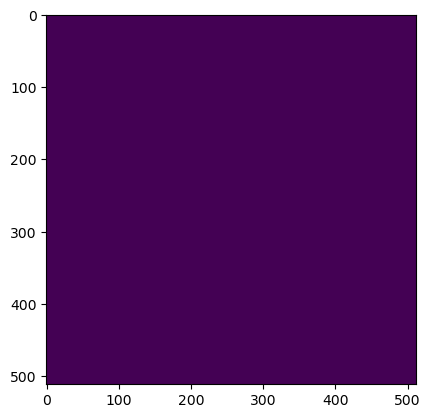

Wrote output/patches/mask/UV_S1_101-541392-0000-6291220-8000.tiff (512 x 512 pixels)


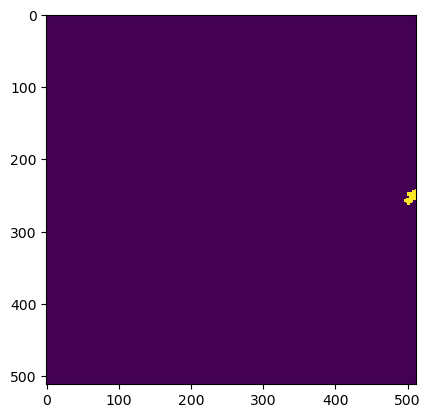

Wrote output/patches/mask/UV_S1_101-541392-0000-6291323-2000.tiff (512 x 512 pixels)


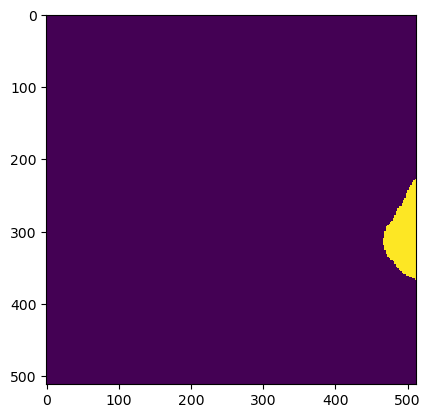

Wrote output/patches/mask/UV_S1_101-541392-0000-6291425-6000.tiff (512 x 512 pixels)


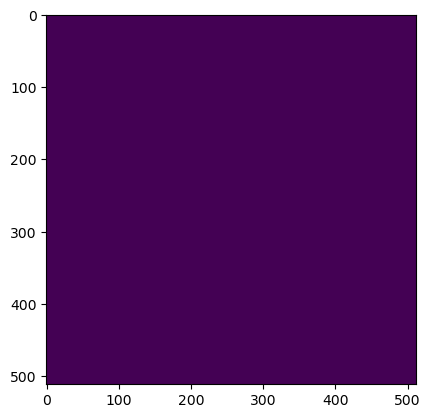

Wrote output/patches/mask/UV_S1_101-541494-4000-6291118-4000.tiff (512 x 512 pixels)


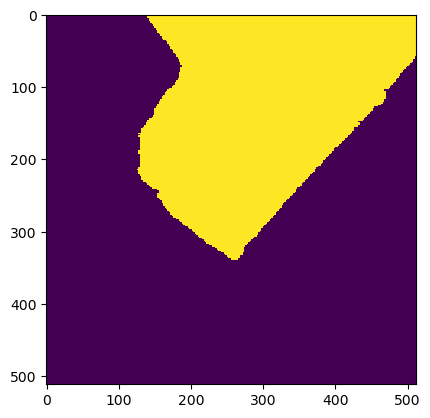

Wrote output/patches/mask/UV_S1_101-541494-4000-6291220-8000.tiff (512 x 512 pixels)


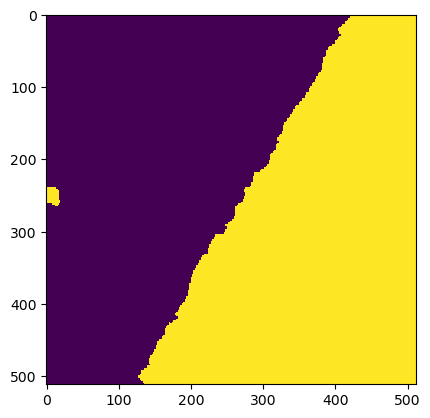

Wrote output/patches/mask/UV_S1_101-541494-4000-6291323-2000.tiff (512 x 512 pixels)


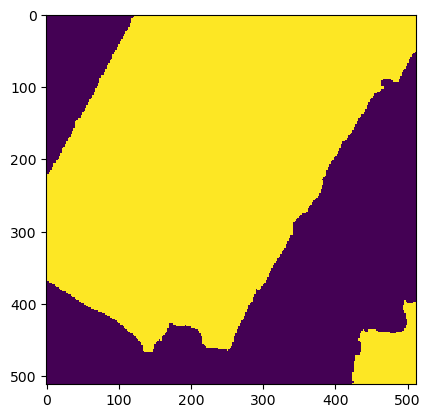

Wrote output/patches/mask/UV_S1_101-541494-4000-6291425-6000.tiff (512 x 512 pixels)


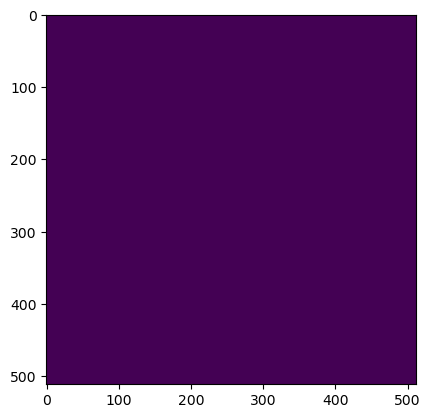

Wrote output/patches/mask/UV_S1_101-541596-8000-6291118-4000.tiff (512 x 512 pixels)


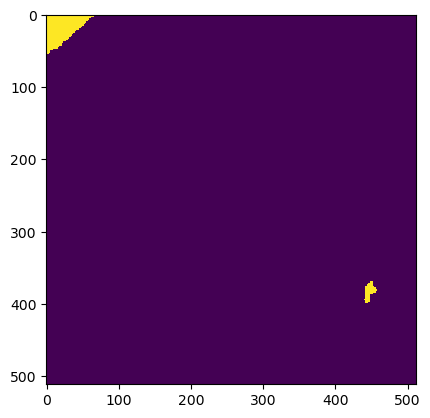

Wrote output/patches/mask/UV_S1_101-541596-8000-6291220-8000.tiff (512 x 512 pixels)


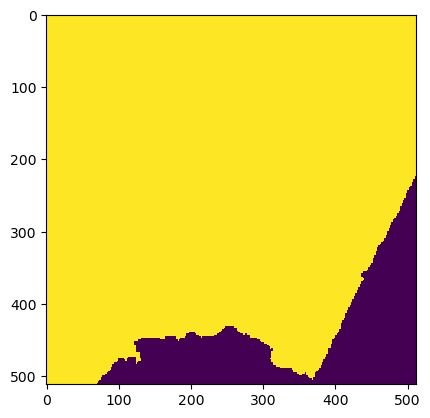

Wrote output/patches/mask/UV_S1_101-541596-8000-6291323-2000.tiff (512 x 512 pixels)


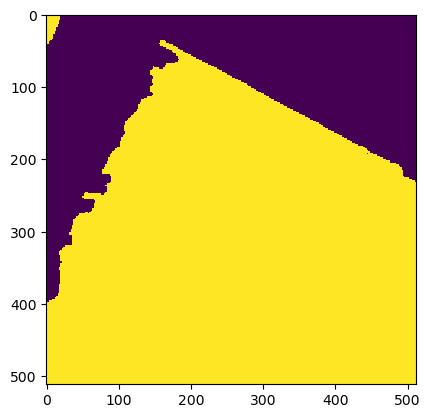

Wrote output/patches/mask/UV_S1_101-541596-8000-6291425-6000.tiff (512 x 512 pixels)


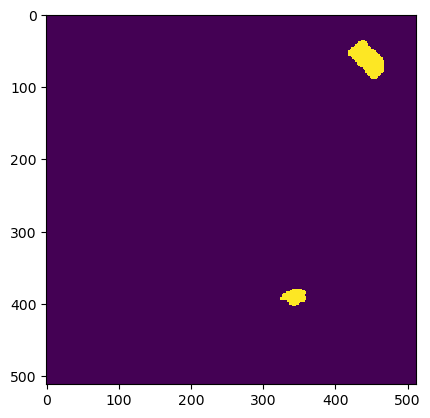

Wrote output/patches/mask/UV_S1_101-541699-2000-6291118-4000.tiff (512 x 512 pixels)


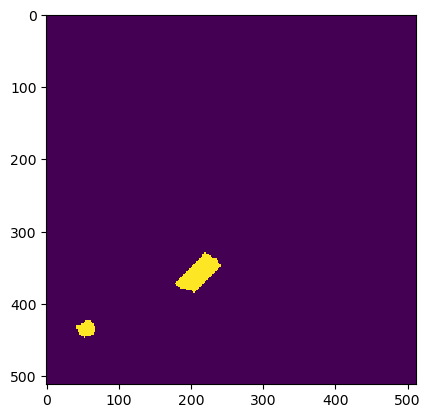

Wrote output/patches/mask/UV_S1_101-541699-2000-6291220-8000.tiff (512 x 512 pixels)


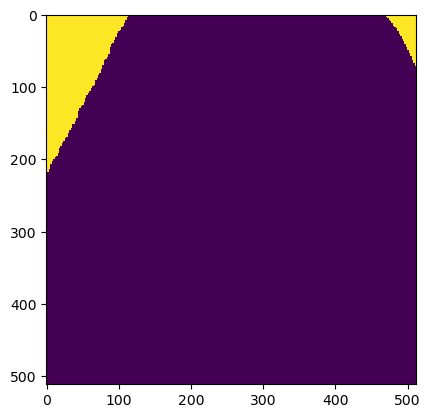

Wrote output/patches/mask/UV_S1_101-541699-2000-6291323-2000.tiff (512 x 512 pixels)


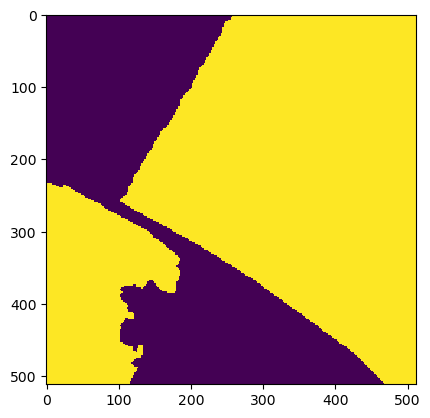

Wrote output/patches/mask/UV_S1_101-541699-2000-6291425-6000.tiff (512 x 512 pixels)
Zone VV_S1_102 Building Mask...


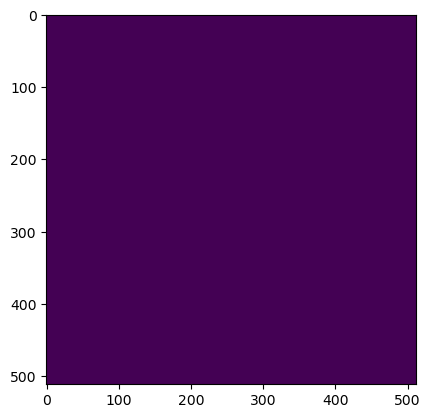

Wrote output/patches/mask/VV_S1_102-484816-0000-6291118-4000.tiff (512 x 512 pixels)


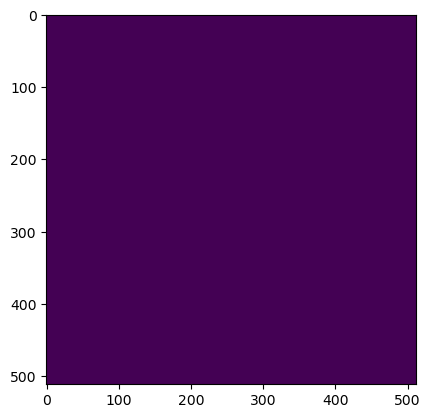

Wrote output/patches/mask/VV_S1_102-484816-0000-6291220-8000.tiff (512 x 512 pixels)


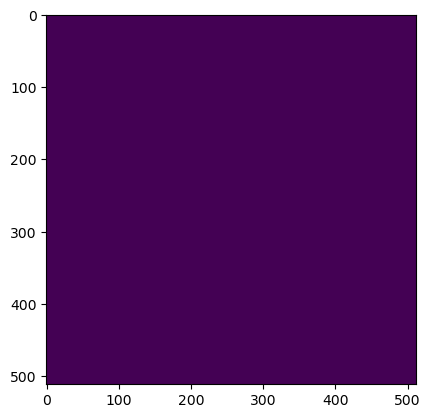

Wrote output/patches/mask/VV_S1_102-484918-4000-6291118-4000.tiff (512 x 512 pixels)


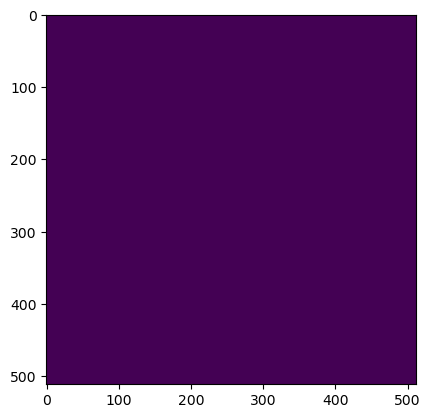

Wrote output/patches/mask/VV_S1_102-484918-4000-6291220-8000.tiff (512 x 512 pixels)
Zone CV_S1_103 Building Mask...


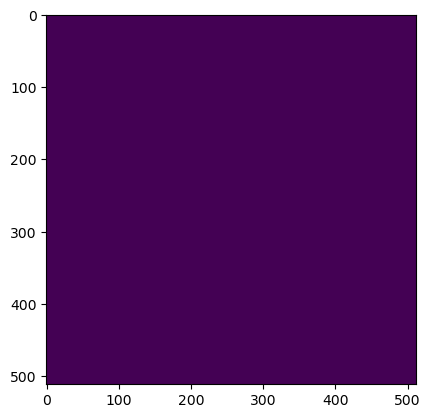

Wrote output/patches/mask/CV_S1_103-458960-0000-6291630-4000.tiff (512 x 512 pixels)


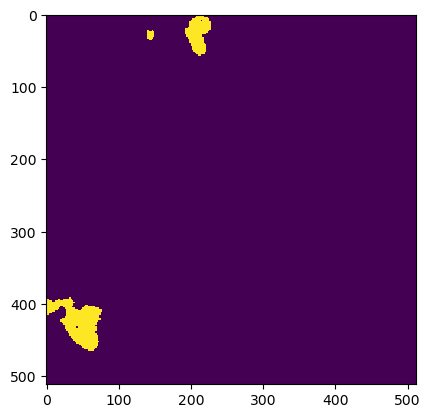

Wrote output/patches/mask/CV_S1_103-458960-0000-6291732-8000.tiff (512 x 512 pixels)


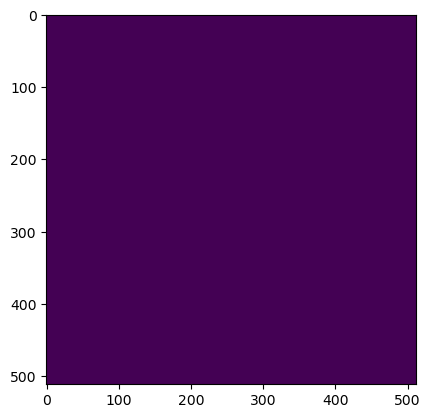

Wrote output/patches/mask/CV_S1_103-459062-4000-6291630-4000.tiff (512 x 512 pixels)


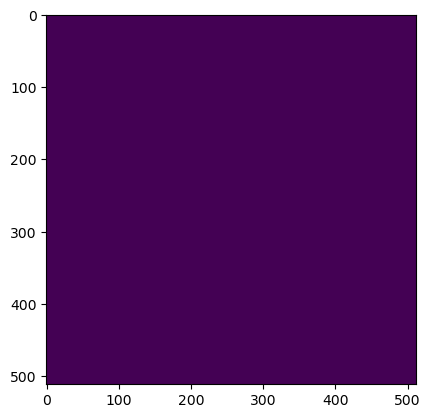

Wrote output/patches/mask/CV_S1_103-459062-4000-6291732-8000.tiff (512 x 512 pixels)
Zone VC_S1_104 Building Mask...


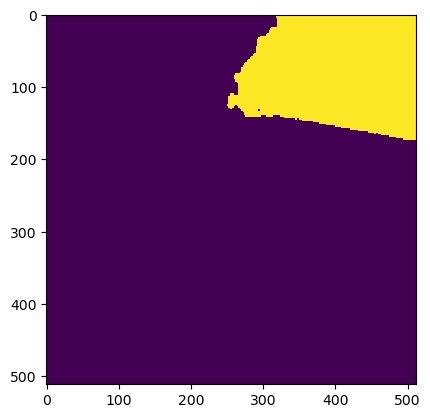

Wrote output/patches/mask/VC_S1_104-442064-0000-6291886-4000.tiff (512 x 512 pixels)


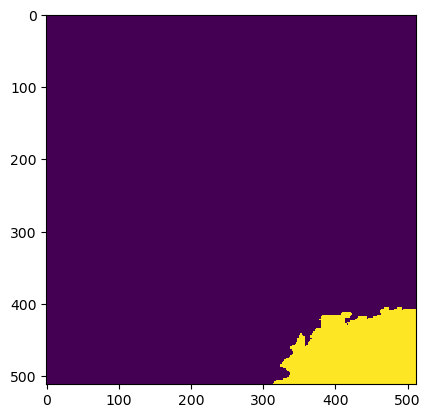

Wrote output/patches/mask/VC_S1_104-442064-0000-6291988-8000.tiff (512 x 512 pixels)


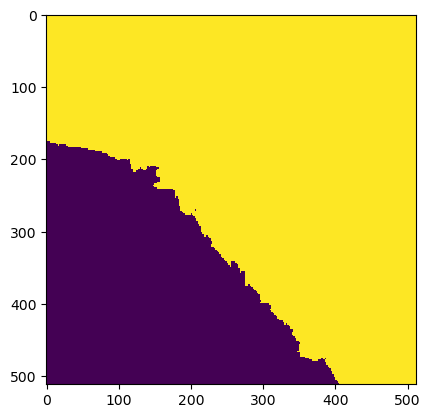

Wrote output/patches/mask/VC_S1_104-442166-4000-6291886-4000.tiff (512 x 512 pixels)


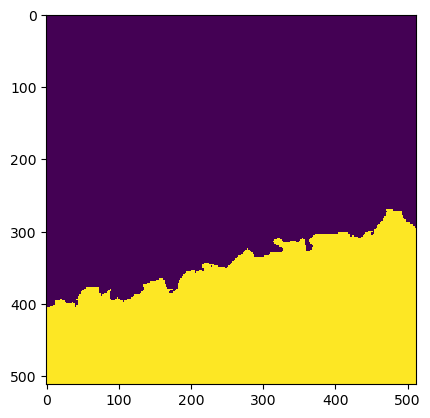

Wrote output/patches/mask/VC_S1_104-442166-4000-6291988-8000.tiff (512 x 512 pixels)


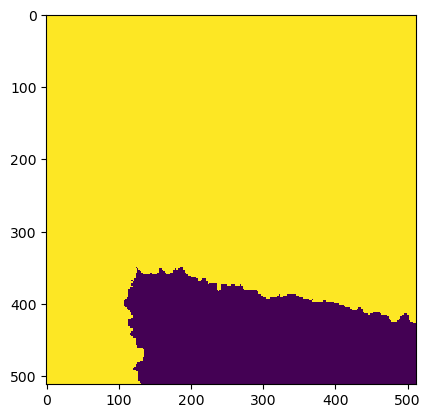

Wrote output/patches/mask/VC_S1_104-442268-8000-6291886-4000.tiff (512 x 512 pixels)


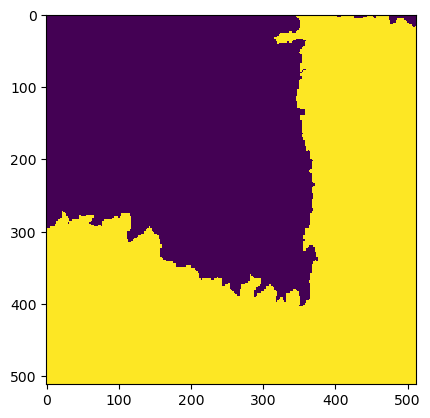

Wrote output/patches/mask/VC_S1_104-442268-8000-6291988-8000.tiff (512 x 512 pixels)


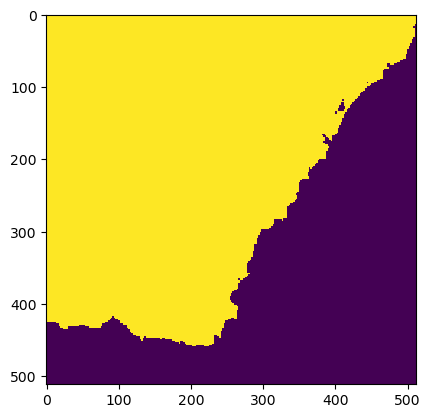

Wrote output/patches/mask/VC_S1_104-442371-2000-6291886-4000.tiff (512 x 512 pixels)


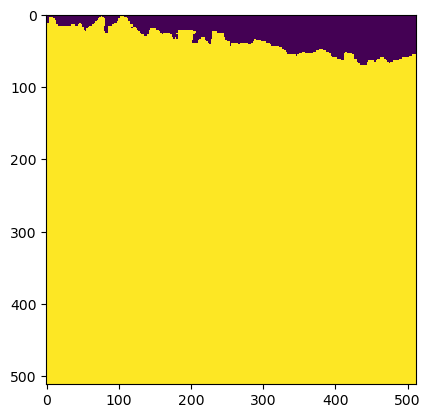

Wrote output/patches/mask/VC_S1_104-442371-2000-6291988-8000.tiff (512 x 512 pixels)
Zone UC_S1_105 Building Mask...


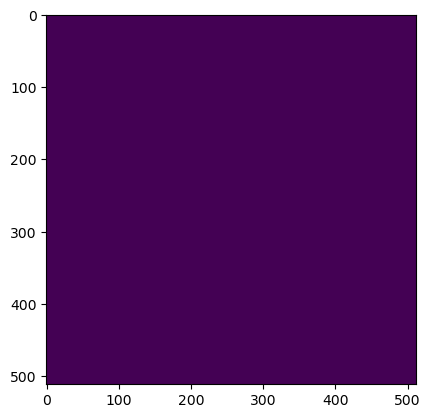

Wrote output/patches/mask/UC_S1_105-445648-0000-6292142-4000.tiff (512 x 512 pixels)


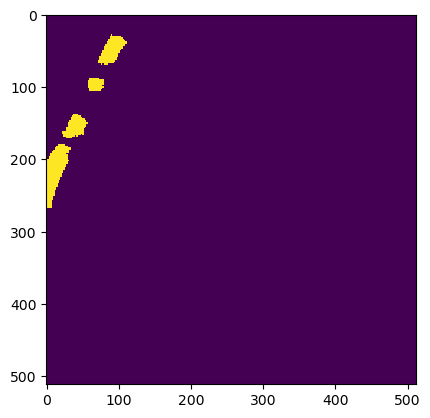

Wrote output/patches/mask/UC_S1_105-445648-0000-6292244-8000.tiff (512 x 512 pixels)


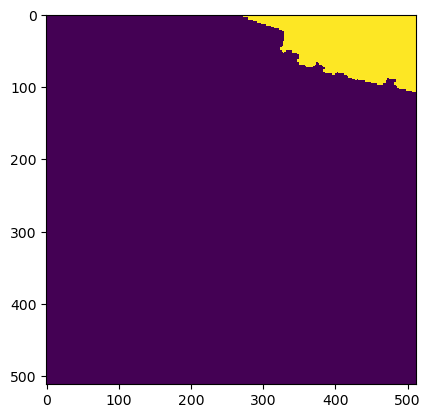

Wrote output/patches/mask/UC_S1_105-445750-4000-6292142-4000.tiff (512 x 512 pixels)


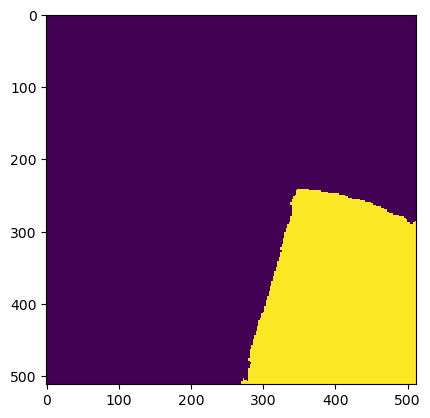

Wrote output/patches/mask/UC_S1_105-445750-4000-6292244-8000.tiff (512 x 512 pixels)


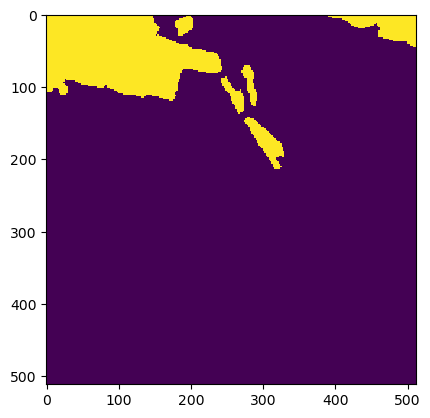

Wrote output/patches/mask/UC_S1_105-445852-8000-6292142-4000.tiff (512 x 512 pixels)


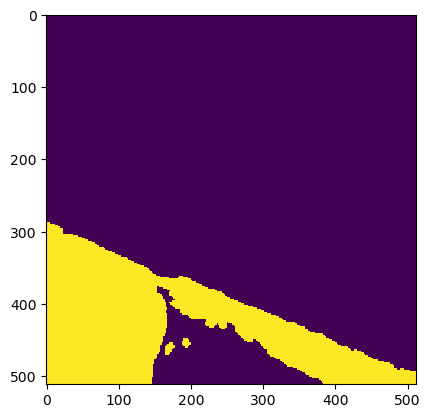

Wrote output/patches/mask/UC_S1_105-445852-8000-6292244-8000.tiff (512 x 512 pixels)


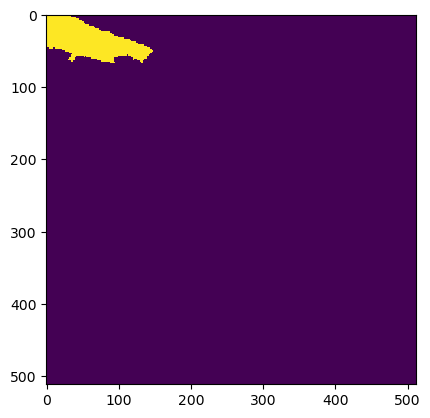

Wrote output/patches/mask/UC_S1_105-445955-2000-6292142-4000.tiff (512 x 512 pixels)


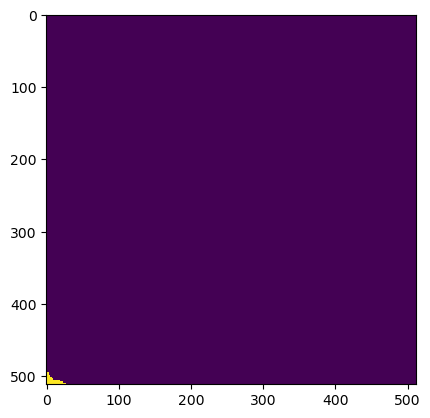

Wrote output/patches/mask/UC_S1_105-445955-2000-6292244-8000.tiff (512 x 512 pixels)
Zone CV_S1_106 Building Mask...


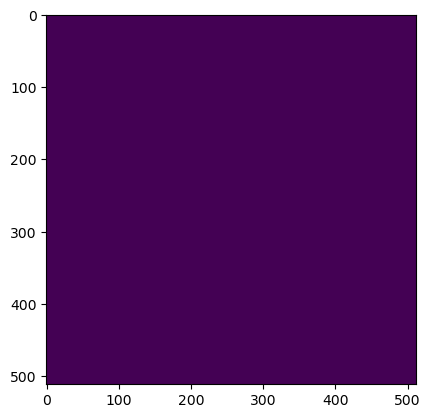

Wrote output/patches/mask/CV_S1_106-532688-0000-6292398-4000.tiff (512 x 512 pixels)


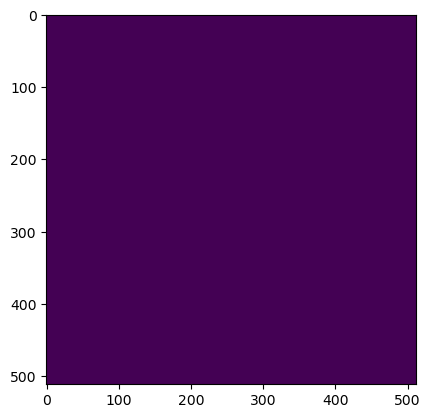

Wrote output/patches/mask/CV_S1_106-532688-0000-6292500-8000.tiff (512 x 512 pixels)


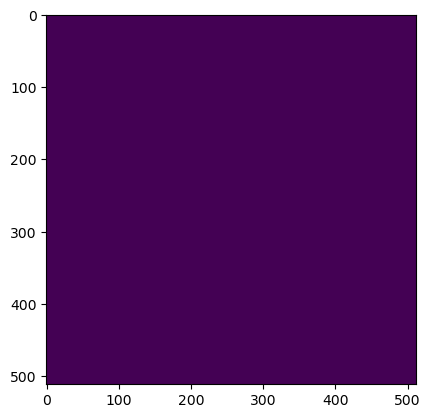

Wrote output/patches/mask/CV_S1_106-532790-4000-6292398-4000.tiff (512 x 512 pixels)


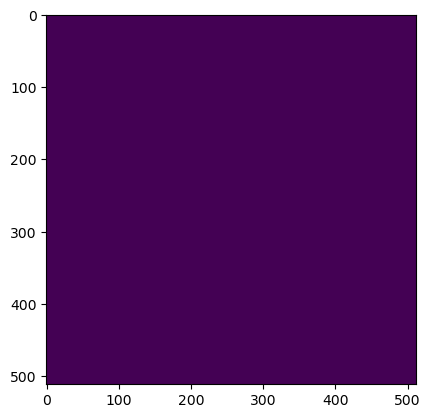

Wrote output/patches/mask/CV_S1_106-532790-4000-6292500-8000.tiff (512 x 512 pixels)
Zone CV_S1_107 Building Mask...


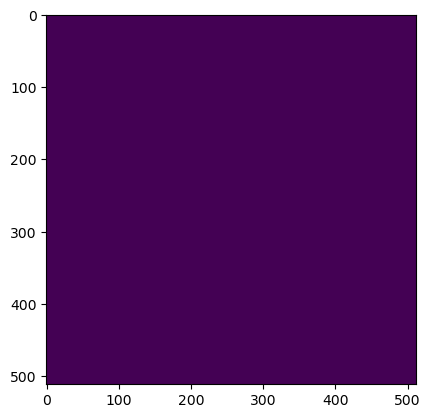

Wrote output/patches/mask/CV_S1_107-538064-0000-6292654-4000.tiff (512 x 512 pixels)


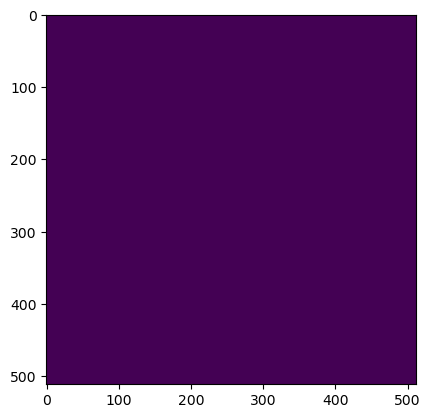

Wrote output/patches/mask/CV_S1_107-538064-0000-6292756-8000.tiff (512 x 512 pixels)


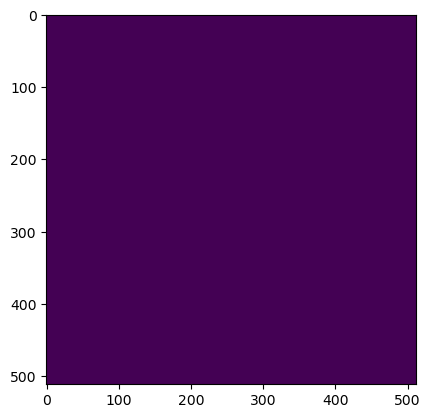

Wrote output/patches/mask/CV_S1_107-538064-0000-6292859-2000.tiff (512 x 512 pixels)


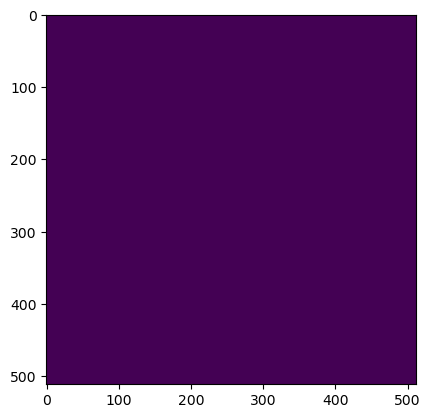

Wrote output/patches/mask/CV_S1_107-538064-0000-6292961-6000.tiff (512 x 512 pixels)


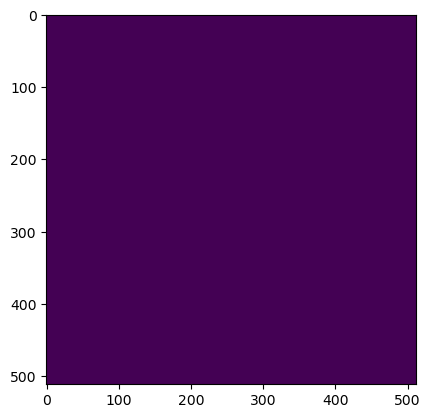

Wrote output/patches/mask/CV_S1_107-538166-4000-6292654-4000.tiff (512 x 512 pixels)


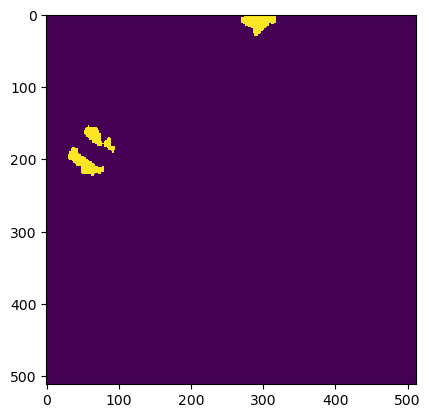

Wrote output/patches/mask/CV_S1_107-538166-4000-6292756-8000.tiff (512 x 512 pixels)


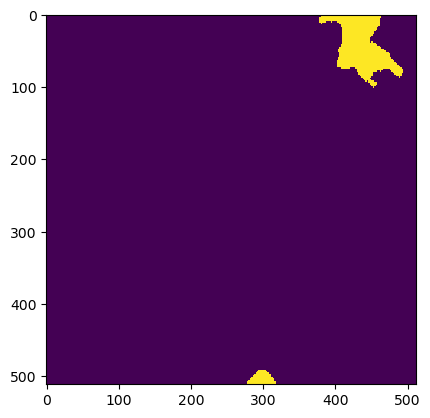

Wrote output/patches/mask/CV_S1_107-538166-4000-6292859-2000.tiff (512 x 512 pixels)


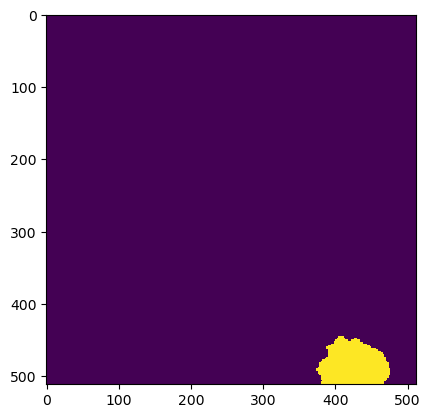

Wrote output/patches/mask/CV_S1_107-538166-4000-6292961-6000.tiff (512 x 512 pixels)
Zone CC_S1_108 Building Mask...


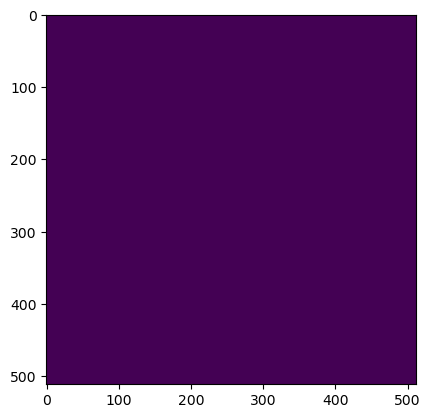

Wrote output/patches/mask/CC_S1_108-452816-0000-6292654-4000.tiff (512 x 512 pixels)


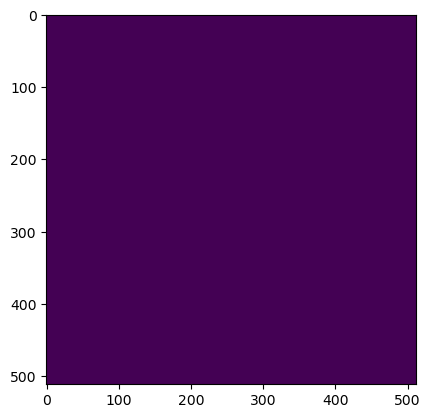

Wrote output/patches/mask/CC_S1_108-452816-0000-6292756-8000.tiff (512 x 512 pixels)


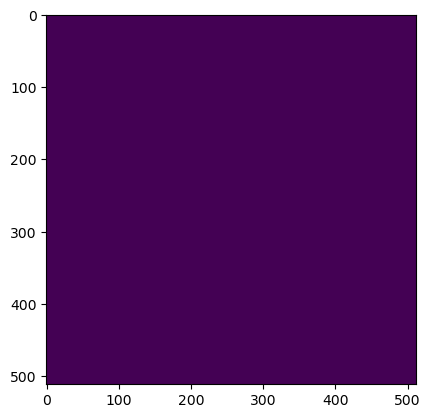

Wrote output/patches/mask/CC_S1_108-452816-0000-6292859-2000.tiff (512 x 512 pixels)


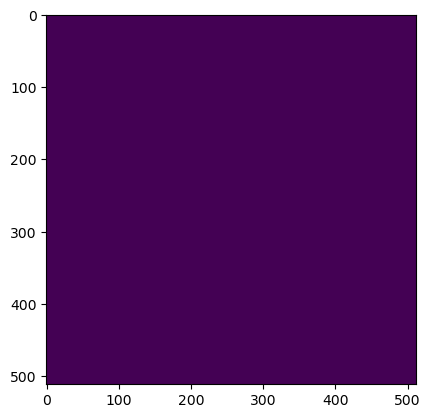

Wrote output/patches/mask/CC_S1_108-452816-0000-6292961-6000.tiff (512 x 512 pixels)


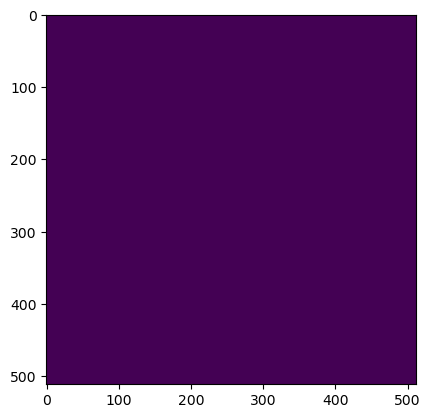

Wrote output/patches/mask/CC_S1_108-452918-4000-6292654-4000.tiff (512 x 512 pixels)


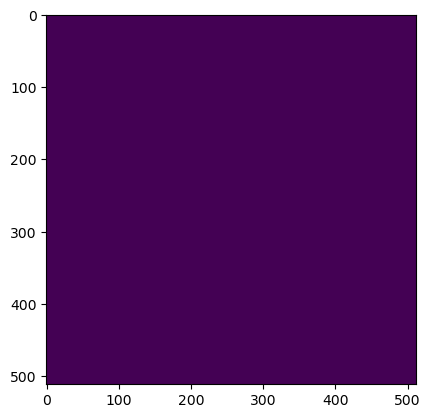

Wrote output/patches/mask/CC_S1_108-452918-4000-6292756-8000.tiff (512 x 512 pixels)


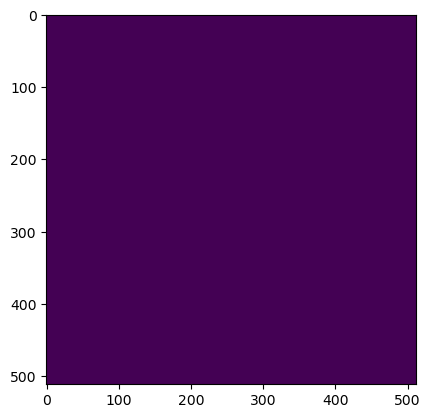

Wrote output/patches/mask/CC_S1_108-452918-4000-6292859-2000.tiff (512 x 512 pixels)


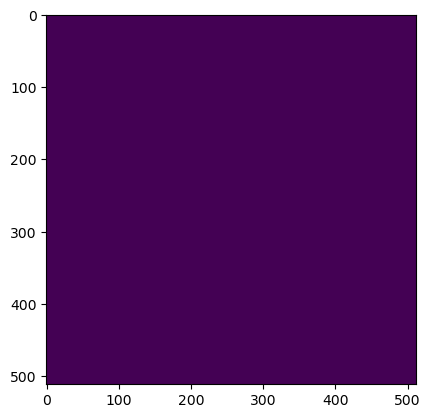

Wrote output/patches/mask/CC_S1_108-452918-4000-6292961-6000.tiff (512 x 512 pixels)


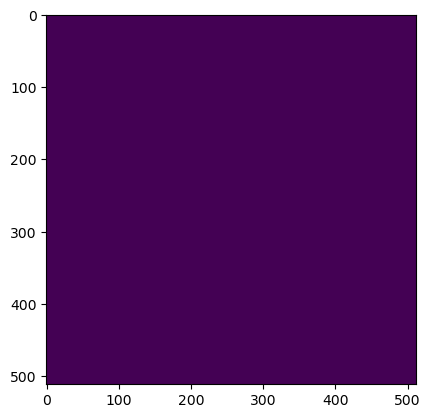

Wrote output/patches/mask/CC_S1_108-453020-8000-6292654-4000.tiff (512 x 512 pixels)


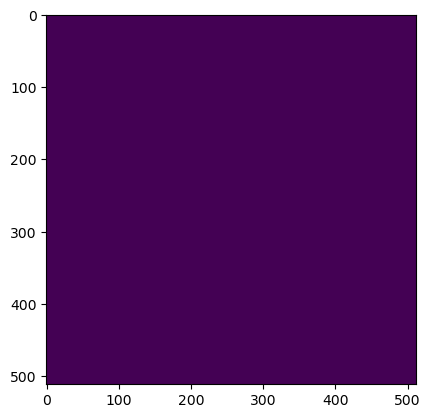

Wrote output/patches/mask/CC_S1_108-453020-8000-6292756-8000.tiff (512 x 512 pixels)


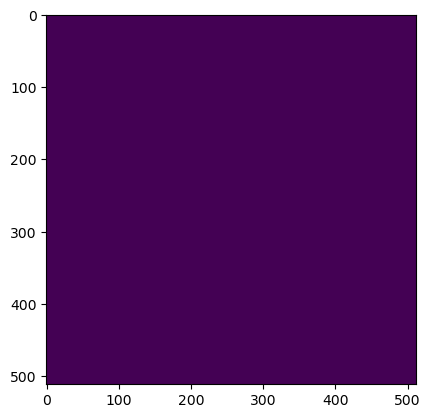

Wrote output/patches/mask/CC_S1_108-453020-8000-6292859-2000.tiff (512 x 512 pixels)


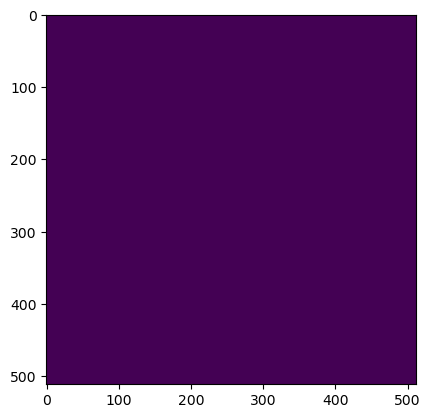

Wrote output/patches/mask/CC_S1_108-453020-8000-6292961-6000.tiff (512 x 512 pixels)


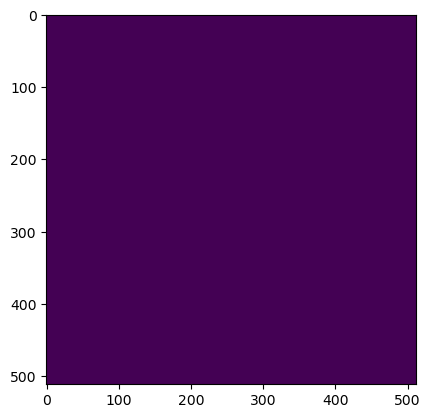

Wrote output/patches/mask/CC_S1_108-453123-2000-6292654-4000.tiff (512 x 512 pixels)


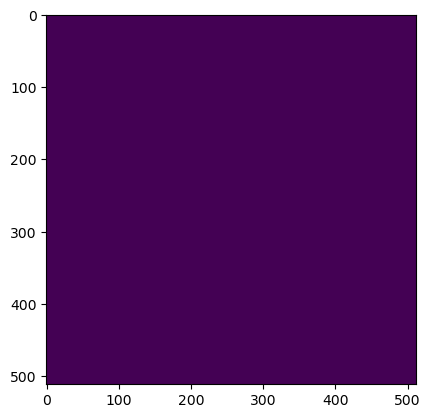

Wrote output/patches/mask/CC_S1_108-453123-2000-6292756-8000.tiff (512 x 512 pixels)


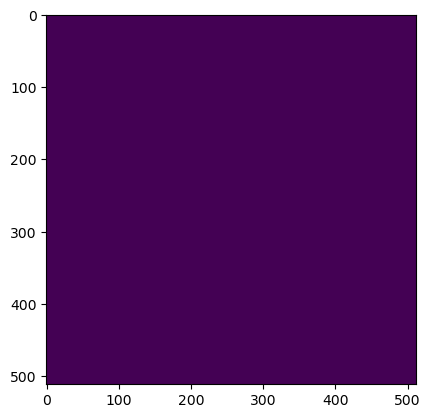

Wrote output/patches/mask/CC_S1_108-453123-2000-6292859-2000.tiff (512 x 512 pixels)


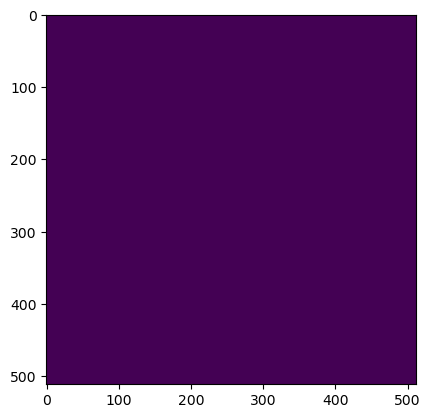

Wrote output/patches/mask/CC_S1_108-453123-2000-6292961-6000.tiff (512 x 512 pixels)


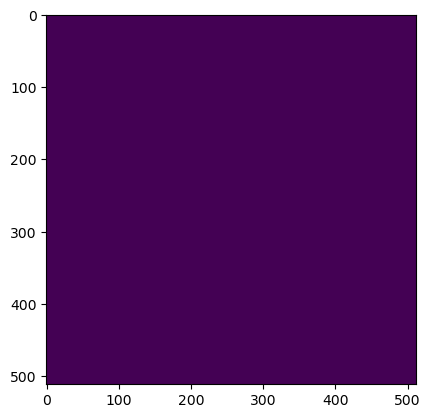

Wrote output/patches/mask/CC_S1_108-453225-6000-6292654-4000.tiff (512 x 512 pixels)


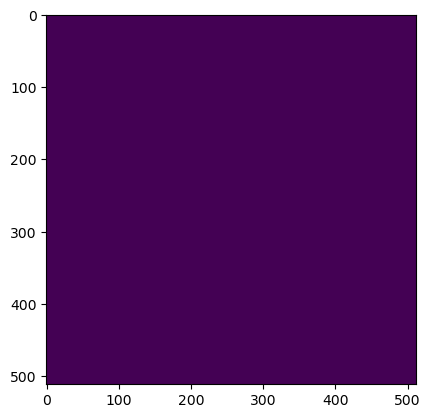

Wrote output/patches/mask/CC_S1_108-453225-6000-6292756-8000.tiff (512 x 512 pixels)


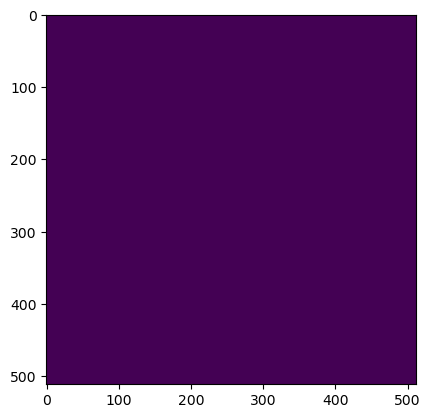

Wrote output/patches/mask/CC_S1_108-453225-6000-6292859-2000.tiff (512 x 512 pixels)


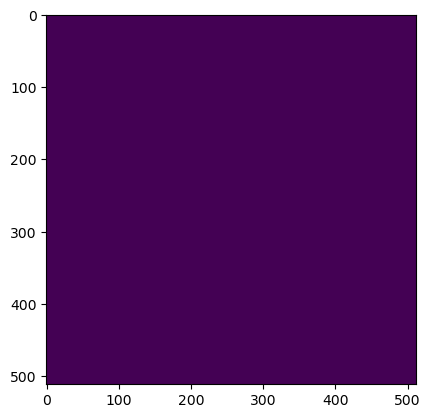

Wrote output/patches/mask/CC_S1_108-453225-6000-6292961-6000.tiff (512 x 512 pixels)


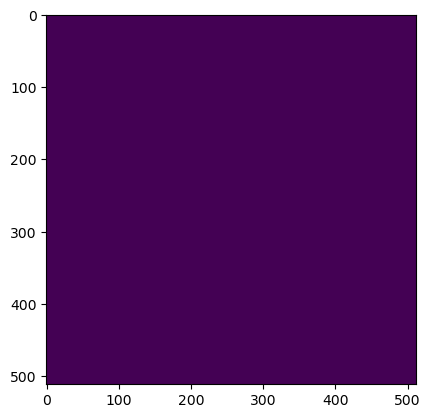

Wrote output/patches/mask/CC_S1_108-453328-0000-6292654-4000.tiff (512 x 512 pixels)


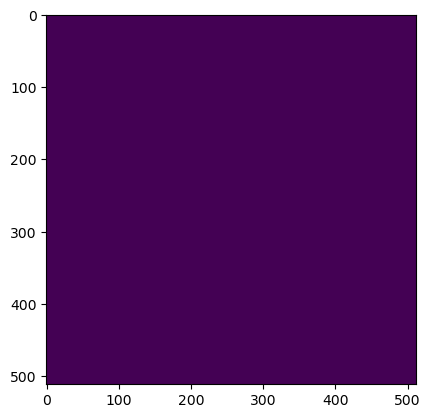

Wrote output/patches/mask/CC_S1_108-453328-0000-6292756-8000.tiff (512 x 512 pixels)


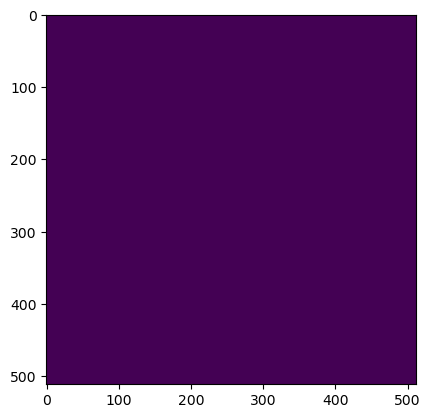

Wrote output/patches/mask/CC_S1_108-453328-0000-6292859-2000.tiff (512 x 512 pixels)


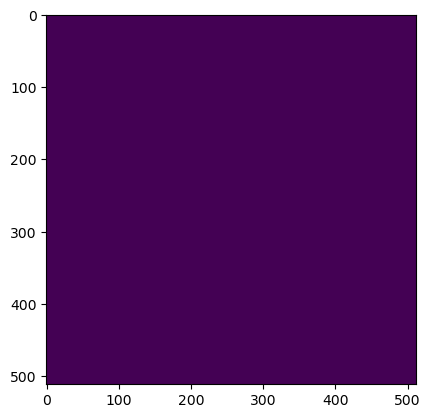

Wrote output/patches/mask/CC_S1_108-453328-0000-6292961-6000.tiff (512 x 512 pixels)


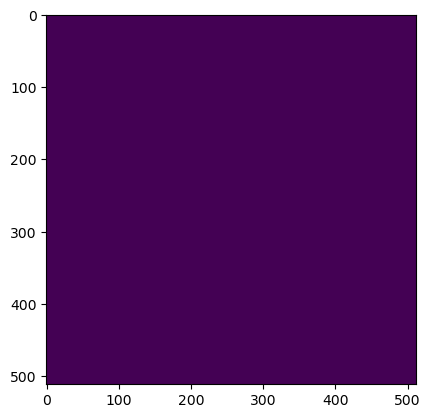

Wrote output/patches/mask/CC_S1_108-453430-4000-6292654-4000.tiff (512 x 512 pixels)


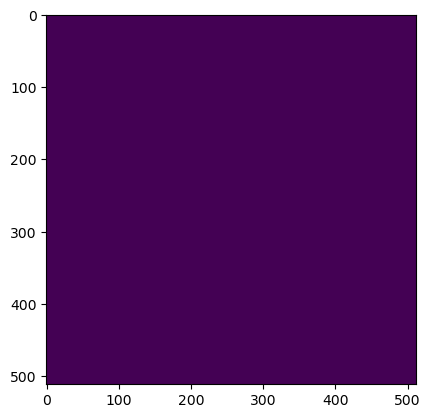

Wrote output/patches/mask/CC_S1_108-453430-4000-6292756-8000.tiff (512 x 512 pixels)


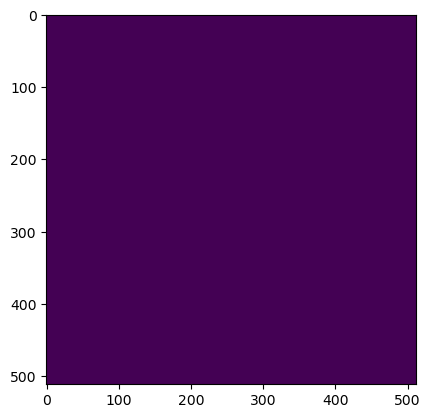

Wrote output/patches/mask/CC_S1_108-453430-4000-6292859-2000.tiff (512 x 512 pixels)


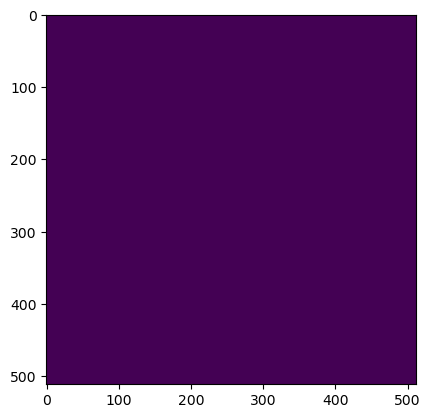

Wrote output/patches/mask/CC_S1_108-453430-4000-6292961-6000.tiff (512 x 512 pixels)
Zone UU_S1_109 Building Mask...


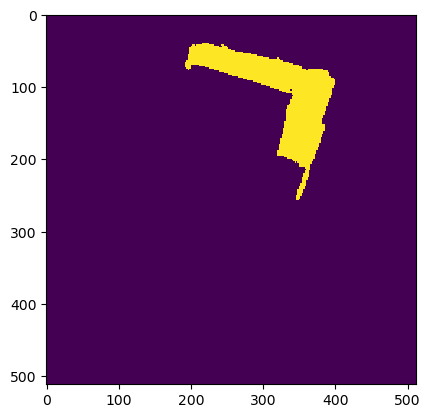

Wrote output/patches/mask/UU_S1_109-454608-0000-6292142-4000.tiff (512 x 512 pixels)


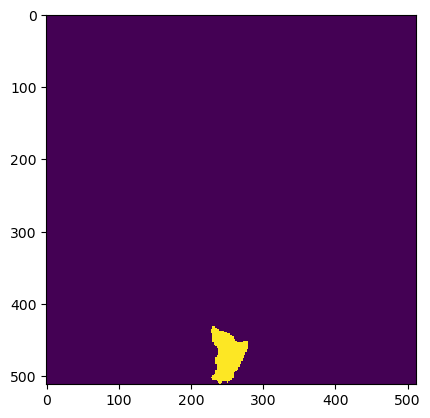

Wrote output/patches/mask/UU_S1_109-454608-0000-6292244-8000.tiff (512 x 512 pixels)


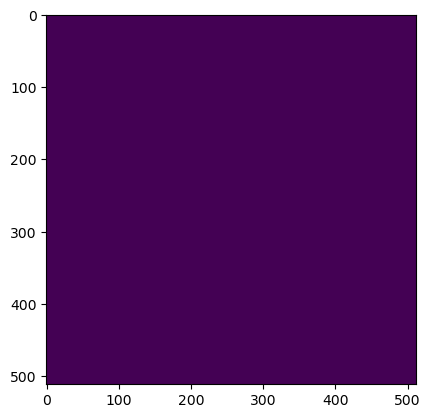

Wrote output/patches/mask/UU_S1_109-454710-4000-6292142-4000.tiff (512 x 512 pixels)


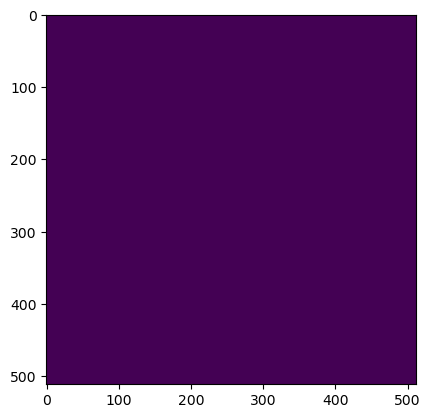

Wrote output/patches/mask/UU_S1_109-454710-4000-6292244-8000.tiff (512 x 512 pixels)
Zone CC_S1_110 Building Mask...


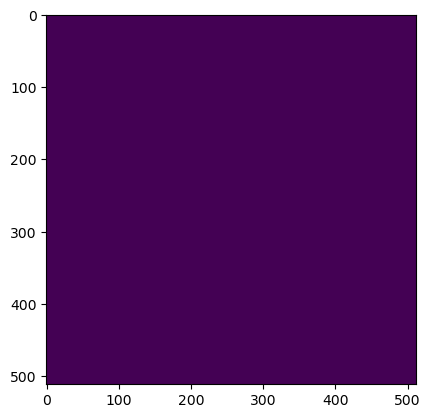

Wrote output/patches/mask/CC_S1_110-442576-0000-6293422-4000.tiff (512 x 512 pixels)


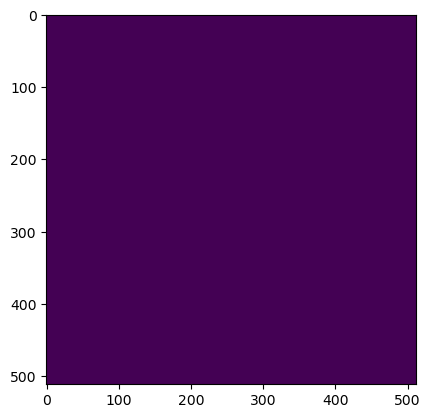

Wrote output/patches/mask/CC_S1_110-442576-0000-6293524-8000.tiff (512 x 512 pixels)


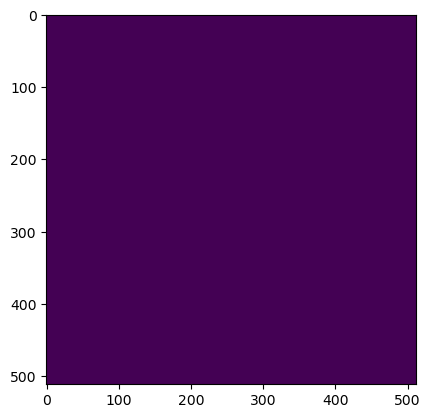

Wrote output/patches/mask/CC_S1_110-442678-4000-6293422-4000.tiff (512 x 512 pixels)


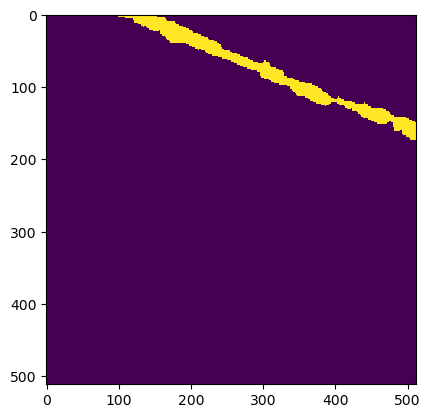

Wrote output/patches/mask/CC_S1_110-442678-4000-6293524-8000.tiff (512 x 512 pixels)


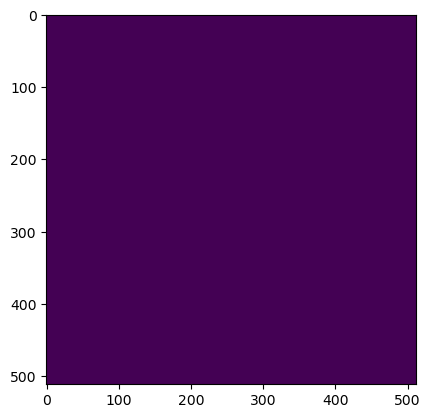

Wrote output/patches/mask/CC_S1_110-442780-8000-6293422-4000.tiff (512 x 512 pixels)


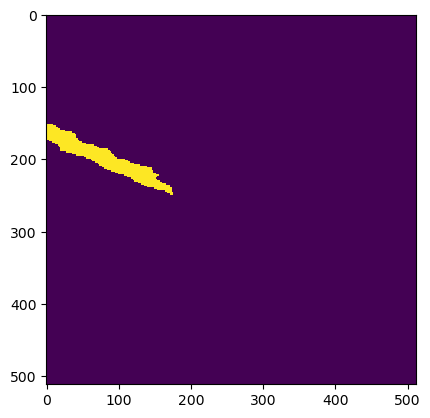

Wrote output/patches/mask/CC_S1_110-442780-8000-6293524-8000.tiff (512 x 512 pixels)


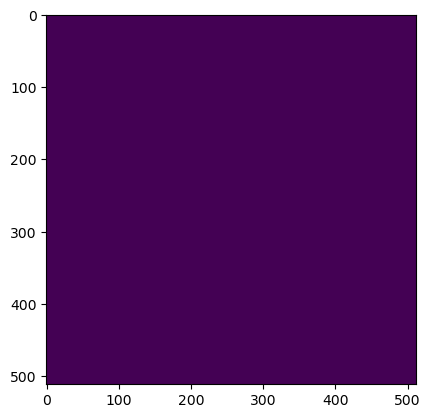

Wrote output/patches/mask/CC_S1_110-442883-2000-6293422-4000.tiff (512 x 512 pixels)


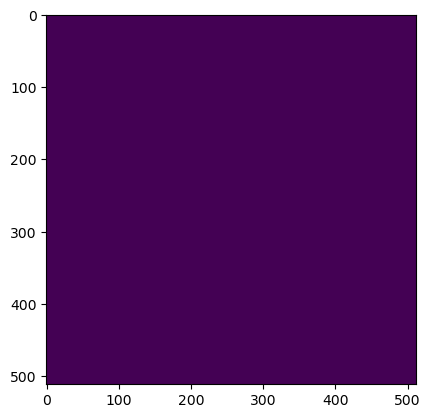

Wrote output/patches/mask/CC_S1_110-442883-2000-6293524-8000.tiff (512 x 512 pixels)
Zone UU_S1_111 Building Mask...


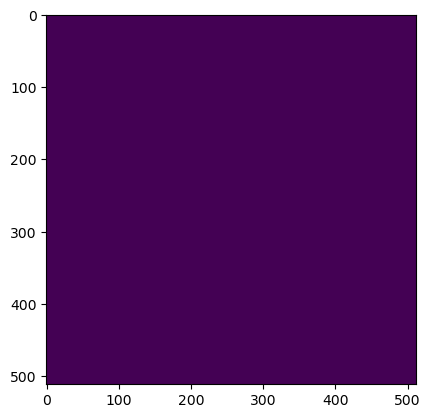

Wrote output/patches/mask/UU_S1_111-528336-0000-6293678-4000.tiff (512 x 512 pixels)


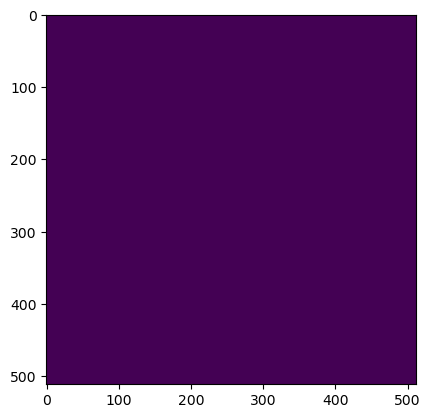

Wrote output/patches/mask/UU_S1_111-528336-0000-6293780-8000.tiff (512 x 512 pixels)


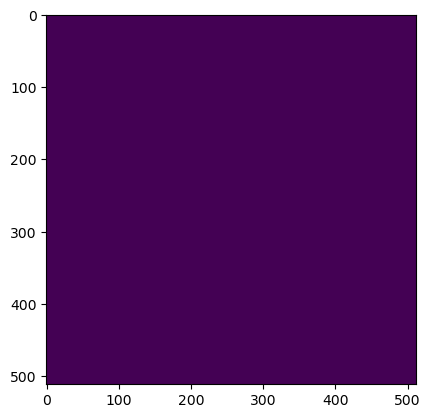

Wrote output/patches/mask/UU_S1_111-528336-0000-6293883-2000.tiff (512 x 512 pixels)


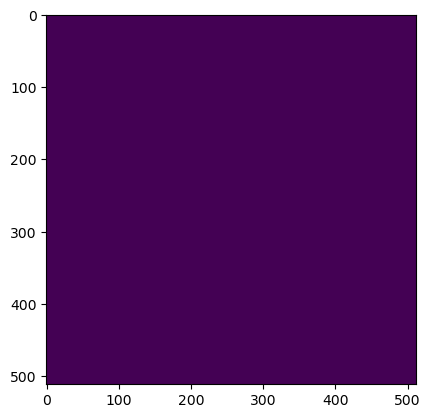

Wrote output/patches/mask/UU_S1_111-528336-0000-6293985-6000.tiff (512 x 512 pixels)


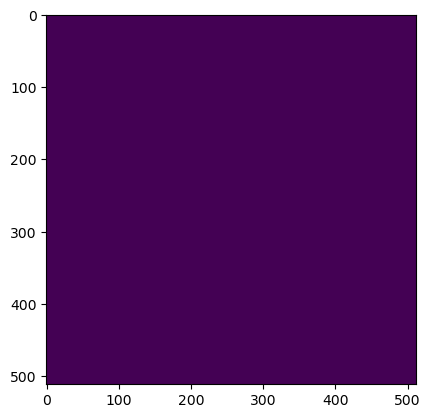

Wrote output/patches/mask/UU_S1_111-528336-0000-6294088-0000.tiff (512 x 512 pixels)


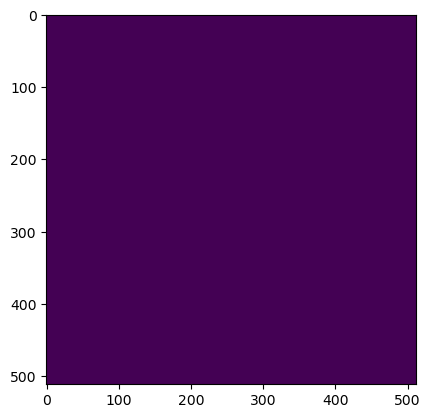

Wrote output/patches/mask/UU_S1_111-528336-0000-6294190-4000.tiff (512 x 512 pixels)


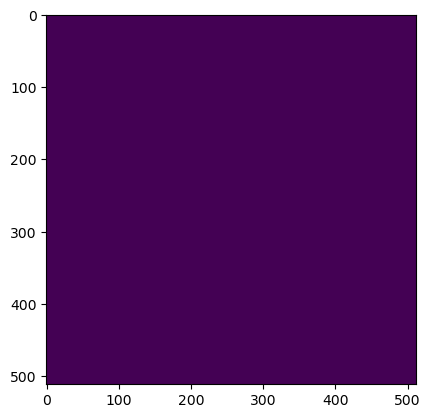

Wrote output/patches/mask/UU_S1_111-528336-0000-6294292-8000.tiff (512 x 512 pixels)


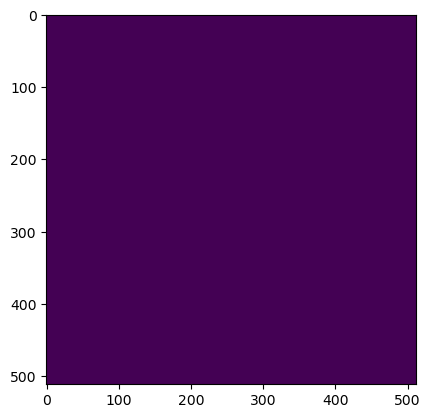

Wrote output/patches/mask/UU_S1_111-528336-0000-6294395-2000.tiff (512 x 512 pixels)


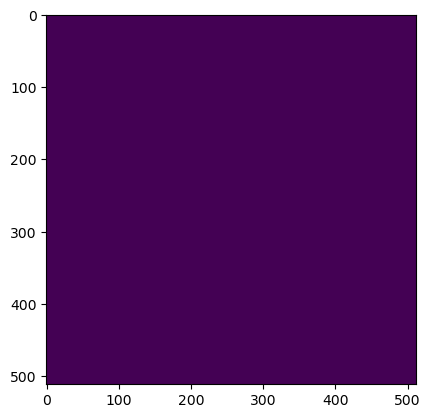

Wrote output/patches/mask/UU_S1_111-528336-0000-6294497-6000.tiff (512 x 512 pixels)


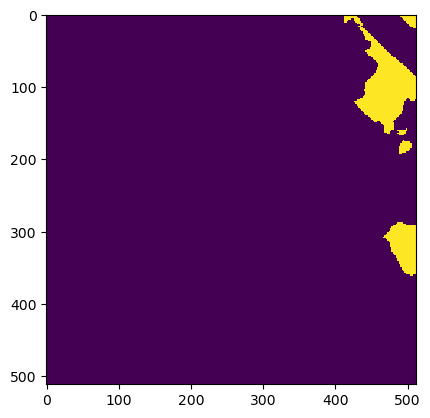

Wrote output/patches/mask/UU_S1_111-528438-4000-6293678-4000.tiff (512 x 512 pixels)


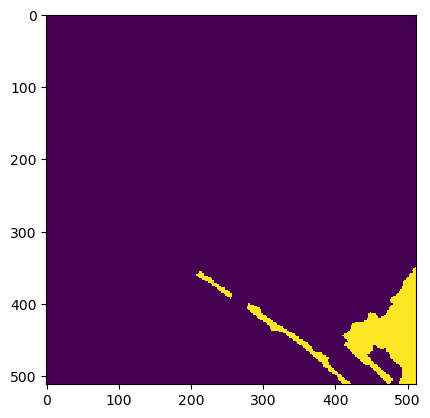

Wrote output/patches/mask/UU_S1_111-528438-4000-6293780-8000.tiff (512 x 512 pixels)


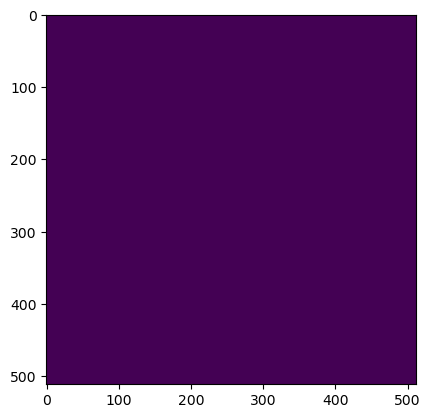

Wrote output/patches/mask/UU_S1_111-528438-4000-6293883-2000.tiff (512 x 512 pixels)


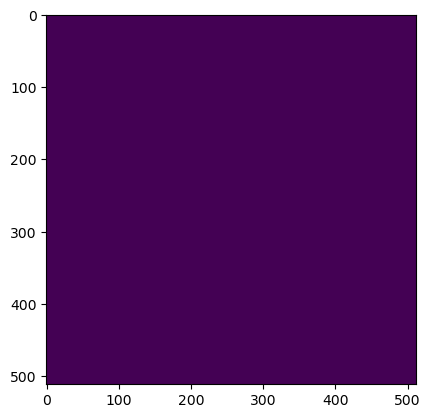

Wrote output/patches/mask/UU_S1_111-528438-4000-6293985-6000.tiff (512 x 512 pixels)


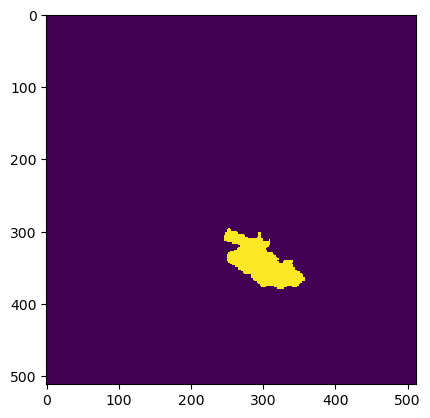

Wrote output/patches/mask/UU_S1_111-528438-4000-6294088-0000.tiff (512 x 512 pixels)


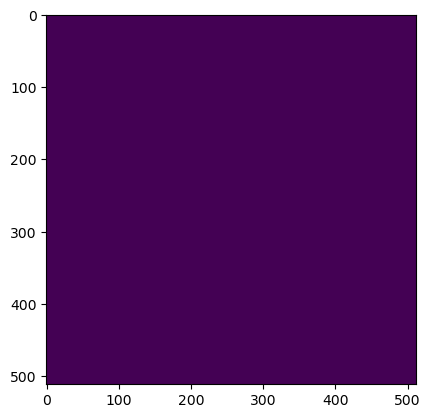

Wrote output/patches/mask/UU_S1_111-528438-4000-6294190-4000.tiff (512 x 512 pixels)


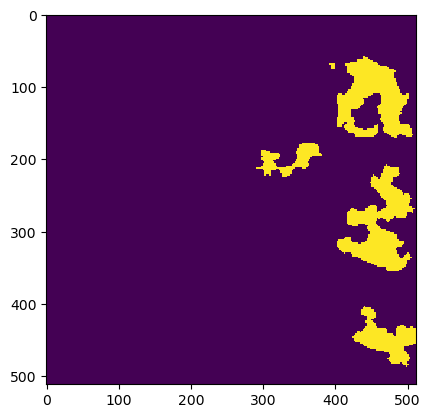

Wrote output/patches/mask/UU_S1_111-528438-4000-6294292-8000.tiff (512 x 512 pixels)


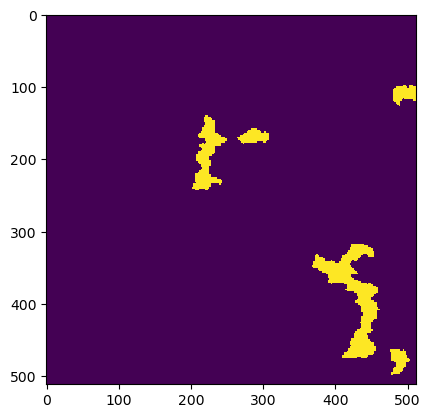

Wrote output/patches/mask/UU_S1_111-528438-4000-6294395-2000.tiff (512 x 512 pixels)


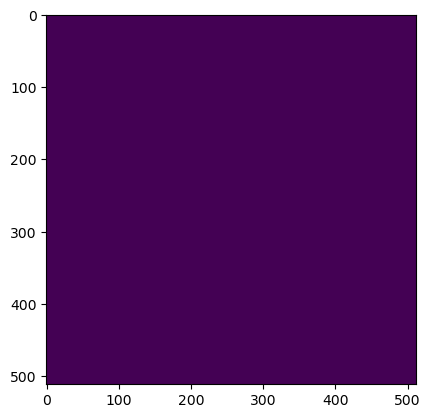

Wrote output/patches/mask/UU_S1_111-528438-4000-6294497-6000.tiff (512 x 512 pixels)


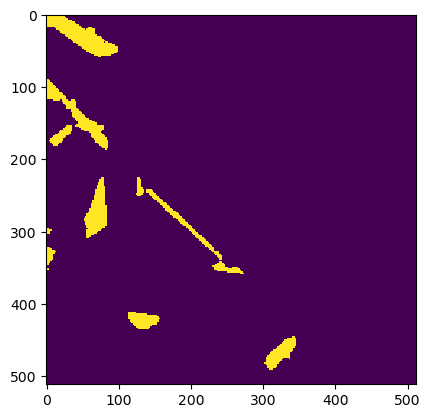

Wrote output/patches/mask/UU_S1_111-528540-8000-6293678-4000.tiff (512 x 512 pixels)


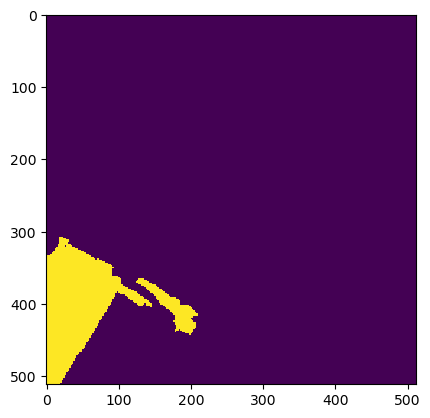

Wrote output/patches/mask/UU_S1_111-528540-8000-6293780-8000.tiff (512 x 512 pixels)


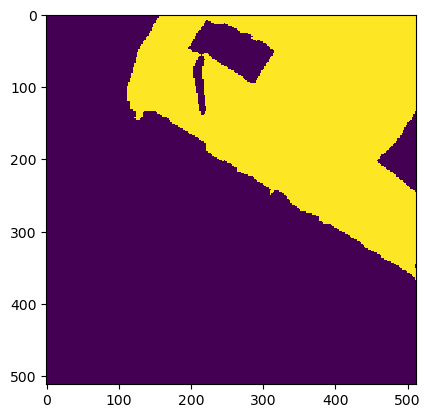

Wrote output/patches/mask/UU_S1_111-528540-8000-6293883-2000.tiff (512 x 512 pixels)


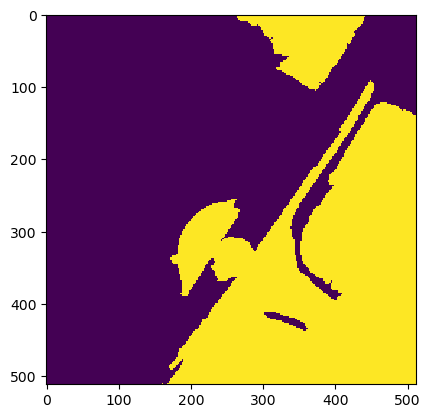

Wrote output/patches/mask/UU_S1_111-528540-8000-6293985-6000.tiff (512 x 512 pixels)


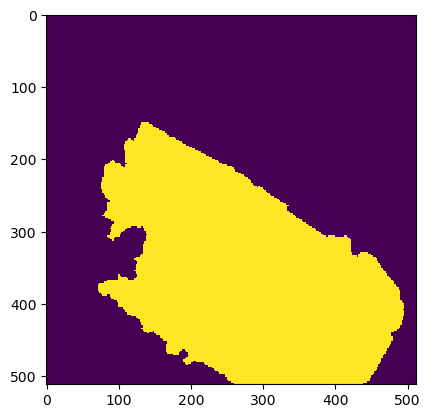

Wrote output/patches/mask/UU_S1_111-528540-8000-6294088-0000.tiff (512 x 512 pixels)


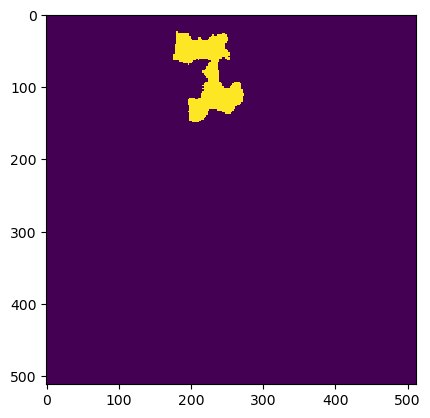

Wrote output/patches/mask/UU_S1_111-528540-8000-6294190-4000.tiff (512 x 512 pixels)


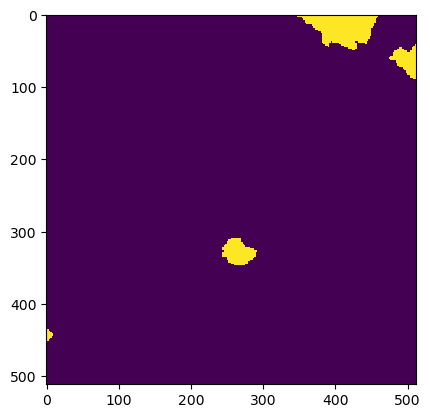

Wrote output/patches/mask/UU_S1_111-528540-8000-6294292-8000.tiff (512 x 512 pixels)


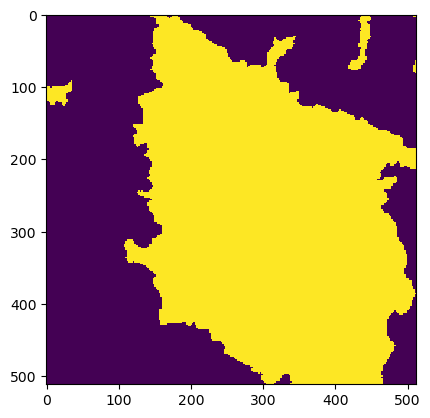

Wrote output/patches/mask/UU_S1_111-528540-8000-6294395-2000.tiff (512 x 512 pixels)


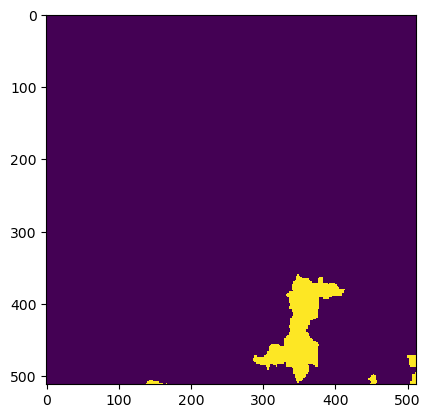

Wrote output/patches/mask/UU_S1_111-528540-8000-6294497-6000.tiff (512 x 512 pixels)


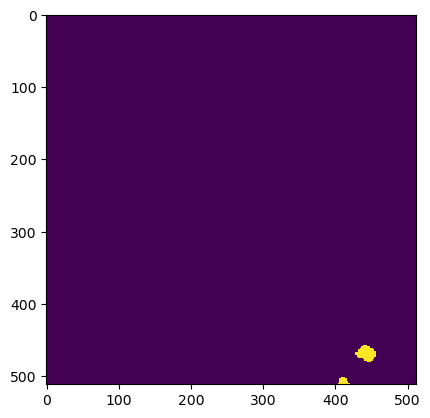

Wrote output/patches/mask/UU_S1_111-528643-2000-6293678-4000.tiff (512 x 512 pixels)


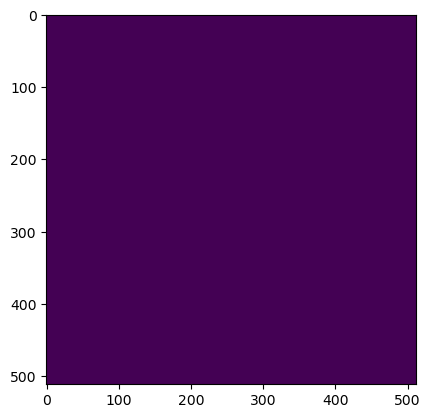

Wrote output/patches/mask/UU_S1_111-528643-2000-6293780-8000.tiff (512 x 512 pixels)


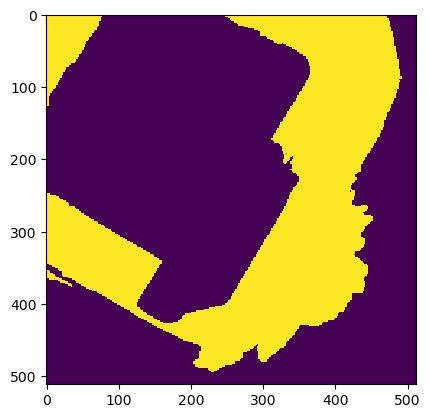

Wrote output/patches/mask/UU_S1_111-528643-2000-6293883-2000.tiff (512 x 512 pixels)


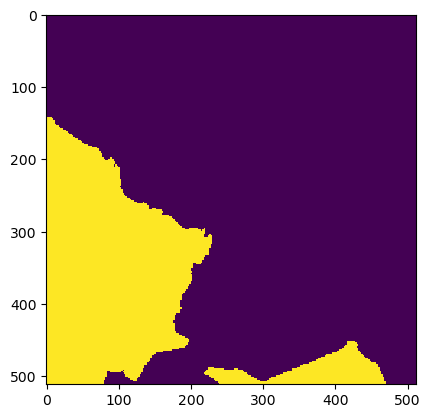

Wrote output/patches/mask/UU_S1_111-528643-2000-6293985-6000.tiff (512 x 512 pixels)


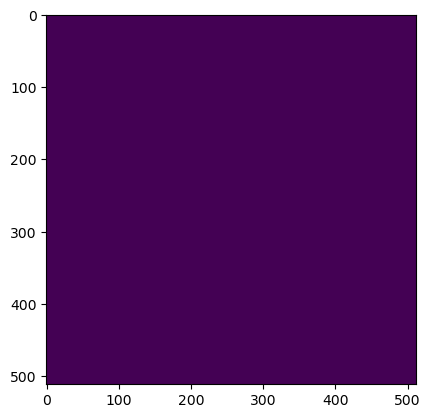

Wrote output/patches/mask/UU_S1_111-528643-2000-6294088-0000.tiff (512 x 512 pixels)


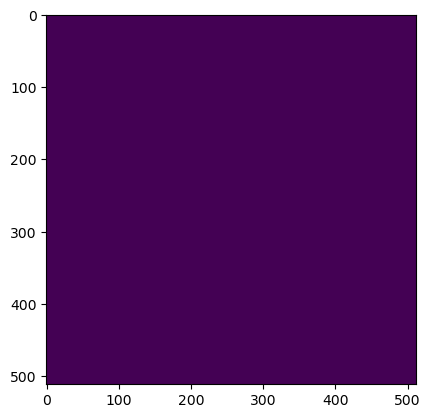

Wrote output/patches/mask/UU_S1_111-528643-2000-6294190-4000.tiff (512 x 512 pixels)


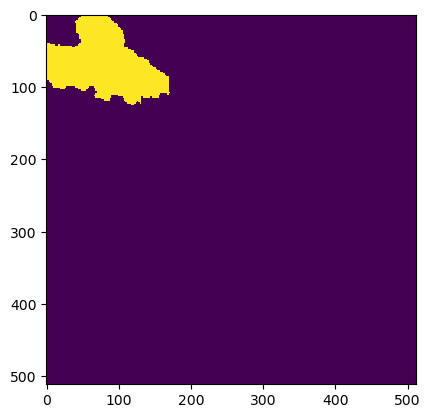

Wrote output/patches/mask/UU_S1_111-528643-2000-6294292-8000.tiff (512 x 512 pixels)


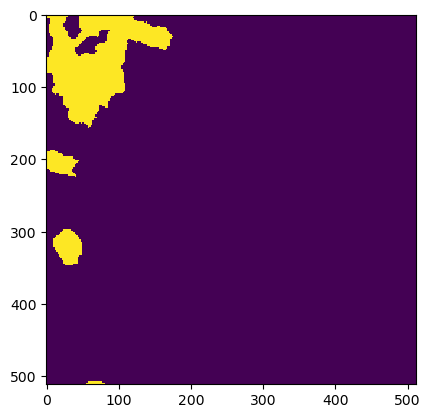

Wrote output/patches/mask/UU_S1_111-528643-2000-6294395-2000.tiff (512 x 512 pixels)


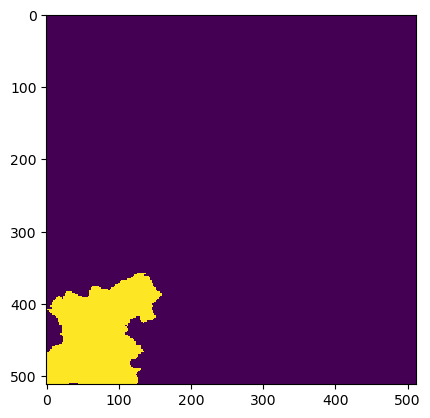

Wrote output/patches/mask/UU_S1_111-528643-2000-6294497-6000.tiff (512 x 512 pixels)


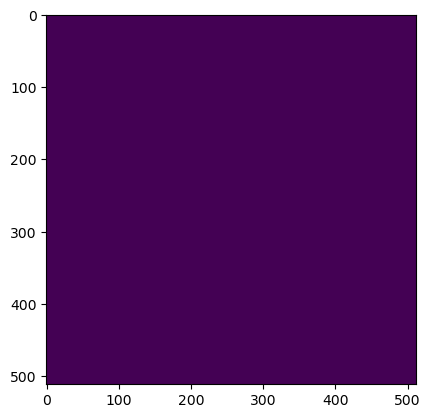

Wrote output/patches/mask/UU_S1_111-528745-6000-6293678-4000.tiff (512 x 512 pixels)


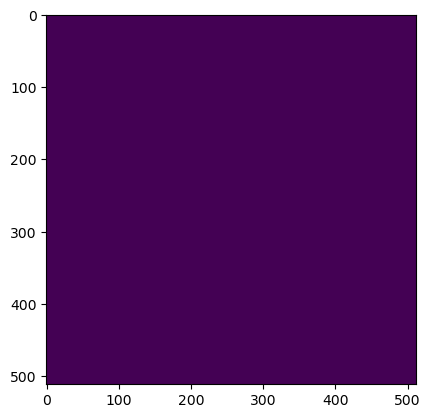

Wrote output/patches/mask/UU_S1_111-528745-6000-6293780-8000.tiff (512 x 512 pixels)


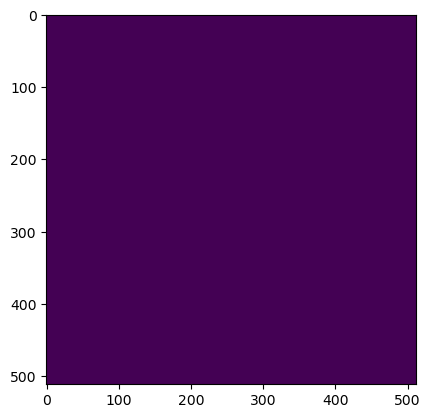

Wrote output/patches/mask/UU_S1_111-528745-6000-6293883-2000.tiff (512 x 512 pixels)


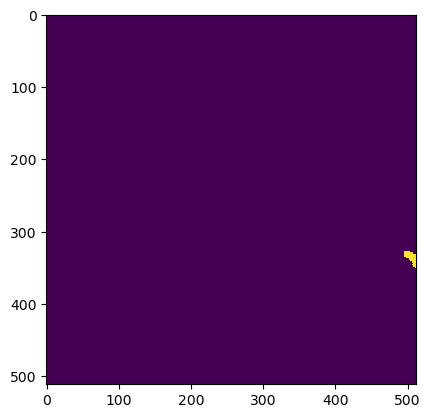

Wrote output/patches/mask/UU_S1_111-528745-6000-6293985-6000.tiff (512 x 512 pixels)


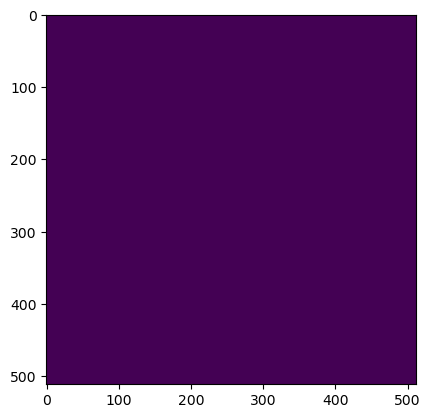

Wrote output/patches/mask/UU_S1_111-528745-6000-6294088-0000.tiff (512 x 512 pixels)


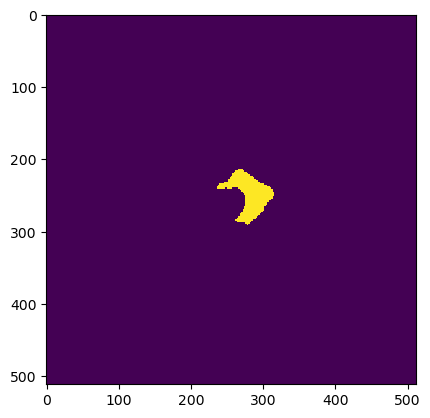

Wrote output/patches/mask/UU_S1_111-528745-6000-6294190-4000.tiff (512 x 512 pixels)


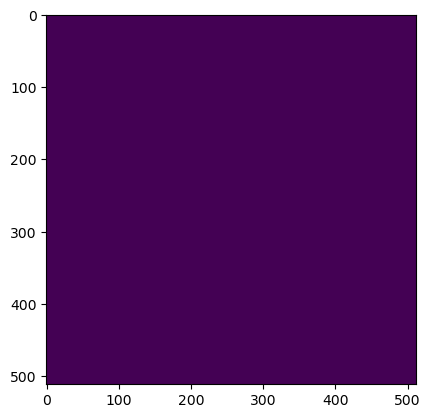

Wrote output/patches/mask/UU_S1_111-528745-6000-6294292-8000.tiff (512 x 512 pixels)


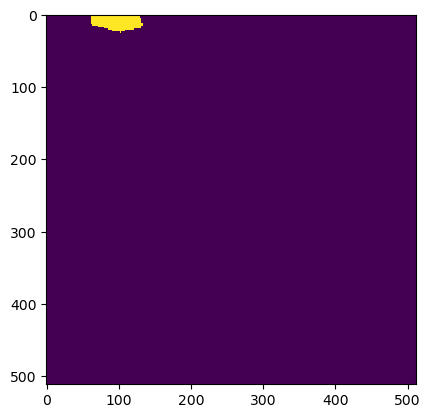

Wrote output/patches/mask/UU_S1_111-528745-6000-6294395-2000.tiff (512 x 512 pixels)


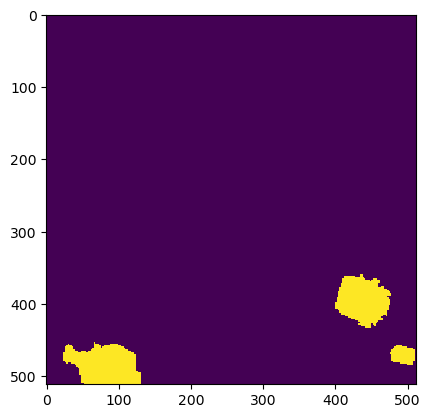

Wrote output/patches/mask/UU_S1_111-528745-6000-6294497-6000.tiff (512 x 512 pixels)


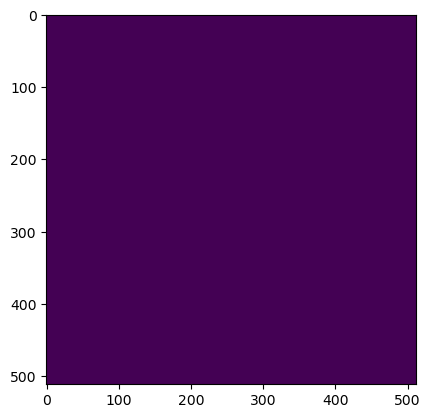

Wrote output/patches/mask/UU_S1_111-528848-0000-6293678-4000.tiff (512 x 512 pixels)


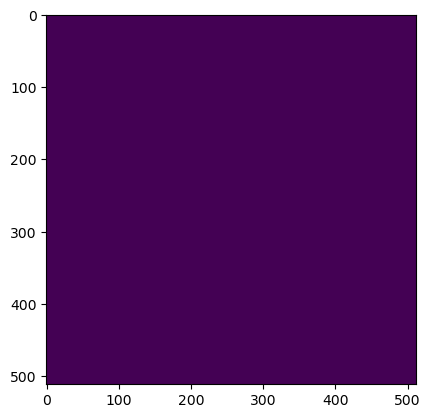

Wrote output/patches/mask/UU_S1_111-528848-0000-6293780-8000.tiff (512 x 512 pixels)


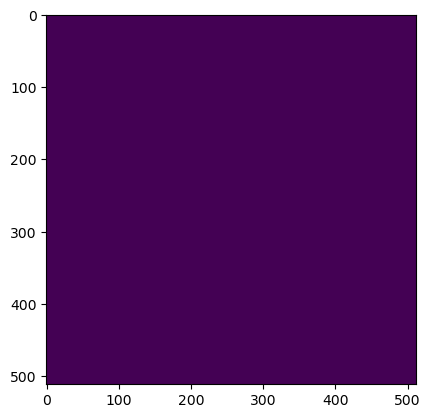

Wrote output/patches/mask/UU_S1_111-528848-0000-6293883-2000.tiff (512 x 512 pixels)


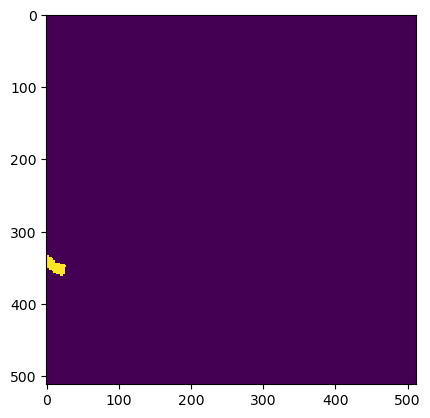

Wrote output/patches/mask/UU_S1_111-528848-0000-6293985-6000.tiff (512 x 512 pixels)


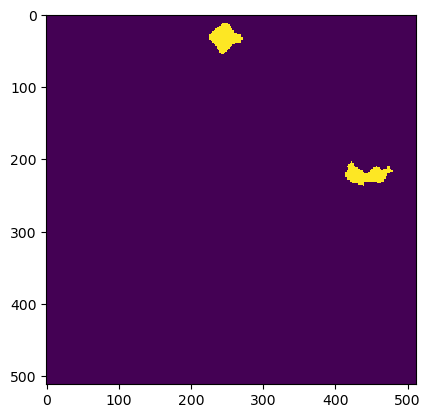

Wrote output/patches/mask/UU_S1_111-528848-0000-6294088-0000.tiff (512 x 512 pixels)


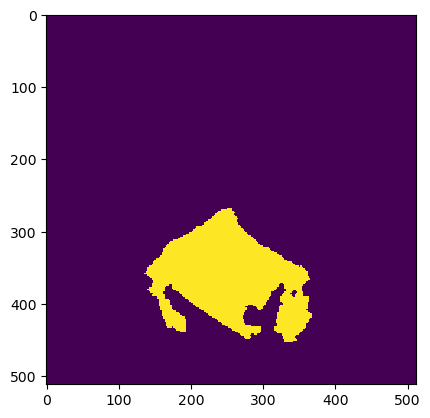

Wrote output/patches/mask/UU_S1_111-528848-0000-6294190-4000.tiff (512 x 512 pixels)


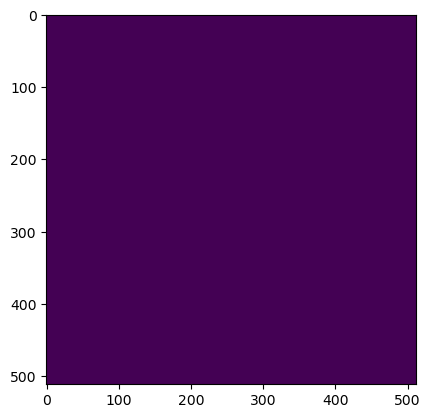

Wrote output/patches/mask/UU_S1_111-528848-0000-6294292-8000.tiff (512 x 512 pixels)


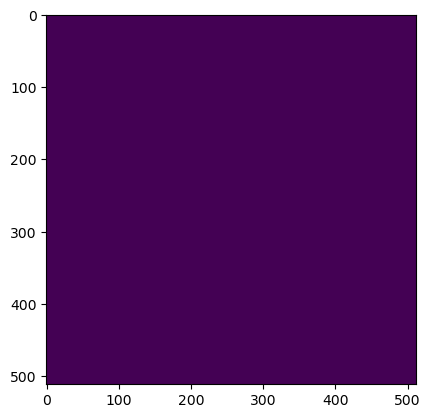

Wrote output/patches/mask/UU_S1_111-528848-0000-6294395-2000.tiff (512 x 512 pixels)


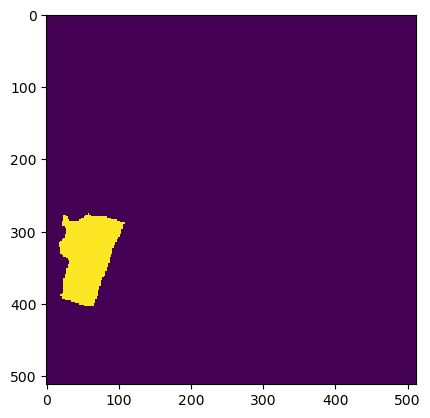

Wrote output/patches/mask/UU_S1_111-528848-0000-6294497-6000.tiff (512 x 512 pixels)


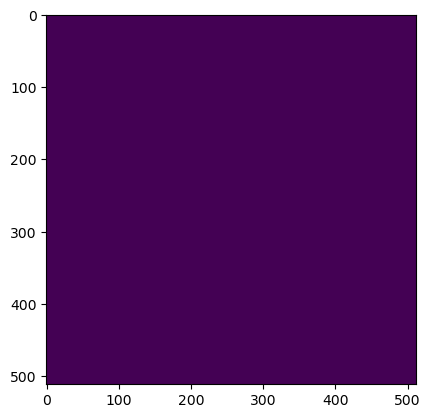

Wrote output/patches/mask/UU_S1_111-528950-4000-6293678-4000.tiff (512 x 512 pixels)


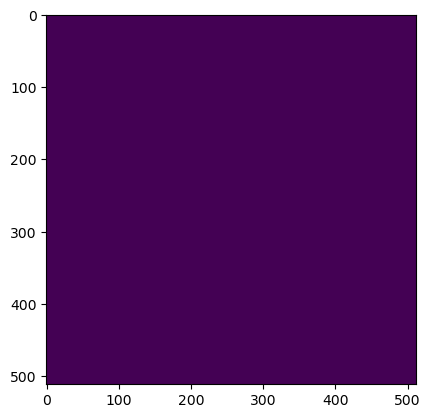

Wrote output/patches/mask/UU_S1_111-528950-4000-6293780-8000.tiff (512 x 512 pixels)


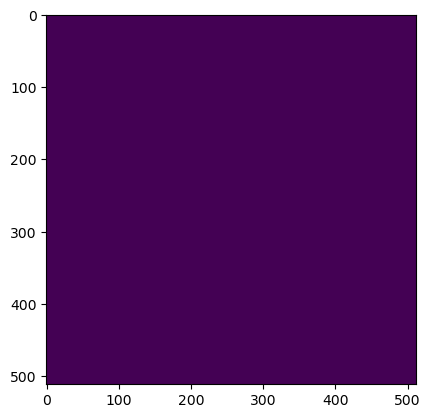

Wrote output/patches/mask/UU_S1_111-528950-4000-6293883-2000.tiff (512 x 512 pixels)


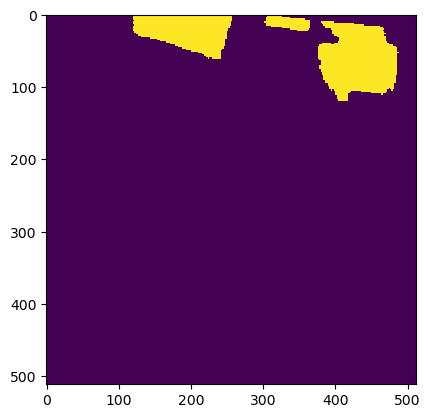

Wrote output/patches/mask/UU_S1_111-528950-4000-6293985-6000.tiff (512 x 512 pixels)


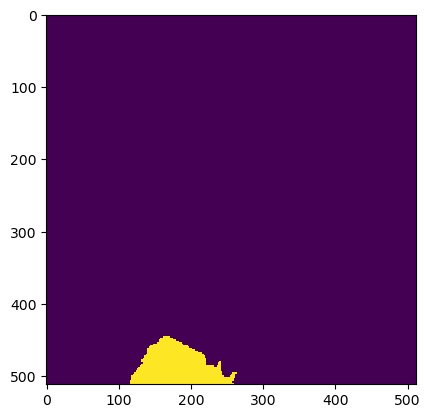

Wrote output/patches/mask/UU_S1_111-528950-4000-6294088-0000.tiff (512 x 512 pixels)


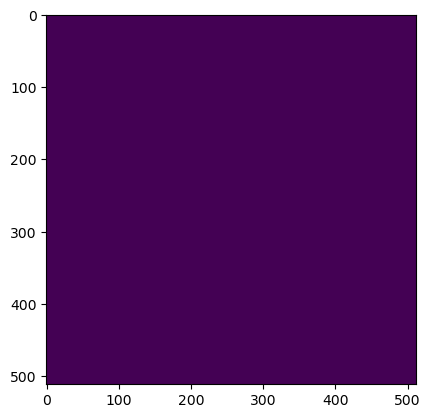

Wrote output/patches/mask/UU_S1_111-528950-4000-6294190-4000.tiff (512 x 512 pixels)


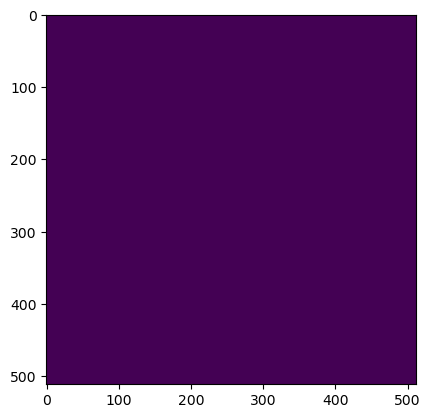

Wrote output/patches/mask/UU_S1_111-528950-4000-6294292-8000.tiff (512 x 512 pixels)


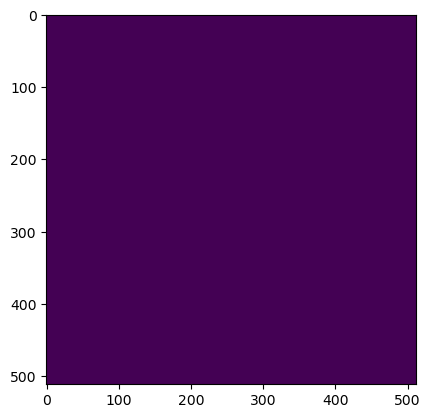

Wrote output/patches/mask/UU_S1_111-528950-4000-6294395-2000.tiff (512 x 512 pixels)


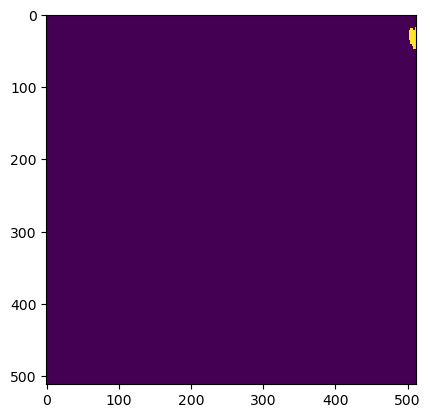

Wrote output/patches/mask/UU_S1_111-528950-4000-6294497-6000.tiff (512 x 512 pixels)


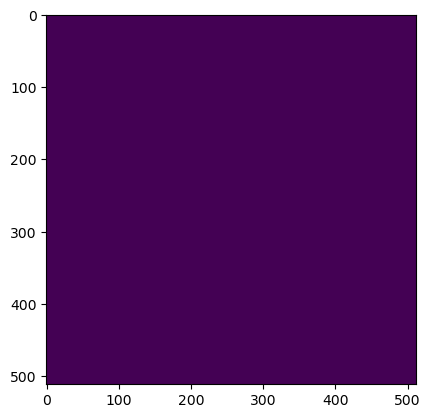

Wrote output/patches/mask/UU_S1_111-529052-8000-6293678-4000.tiff (512 x 512 pixels)


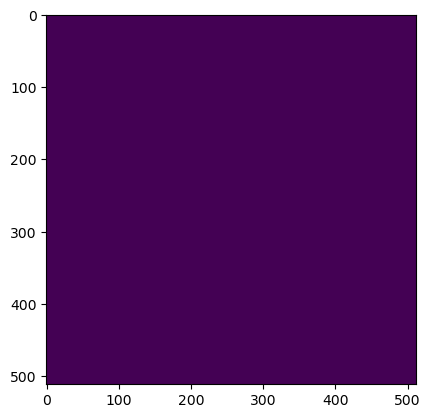

Wrote output/patches/mask/UU_S1_111-529052-8000-6293780-8000.tiff (512 x 512 pixels)


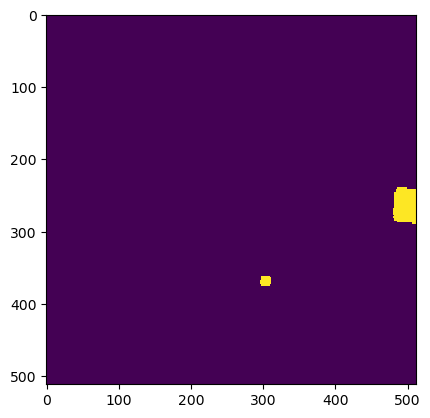

Wrote output/patches/mask/UU_S1_111-529052-8000-6293883-2000.tiff (512 x 512 pixels)


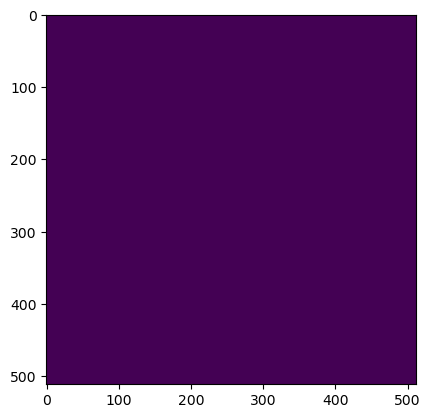

Wrote output/patches/mask/UU_S1_111-529052-8000-6293985-6000.tiff (512 x 512 pixels)


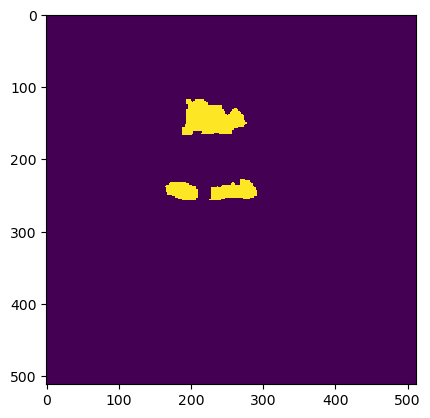

Wrote output/patches/mask/UU_S1_111-529052-8000-6294088-0000.tiff (512 x 512 pixels)


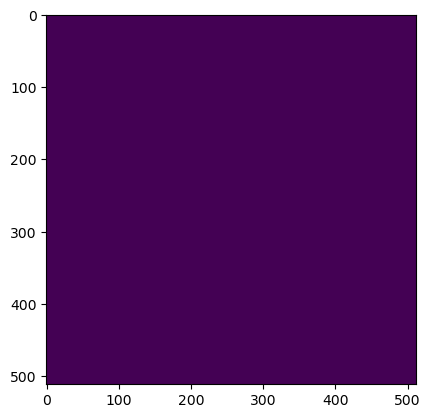

Wrote output/patches/mask/UU_S1_111-529052-8000-6294190-4000.tiff (512 x 512 pixels)


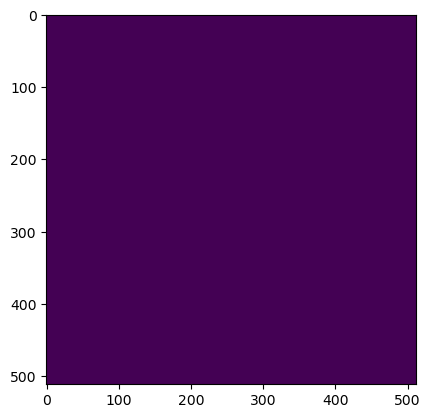

Wrote output/patches/mask/UU_S1_111-529052-8000-6294292-8000.tiff (512 x 512 pixels)


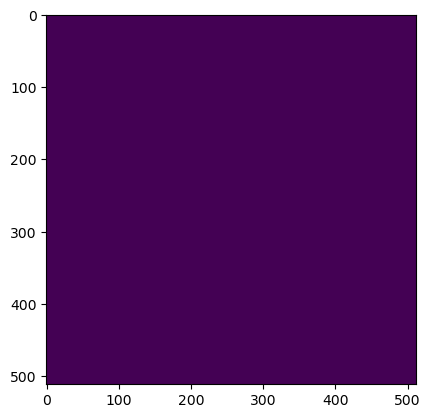

Wrote output/patches/mask/UU_S1_111-529052-8000-6294395-2000.tiff (512 x 512 pixels)


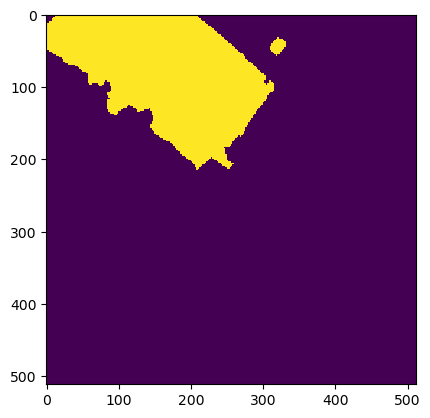

Wrote output/patches/mask/UU_S1_111-529052-8000-6294497-6000.tiff (512 x 512 pixels)


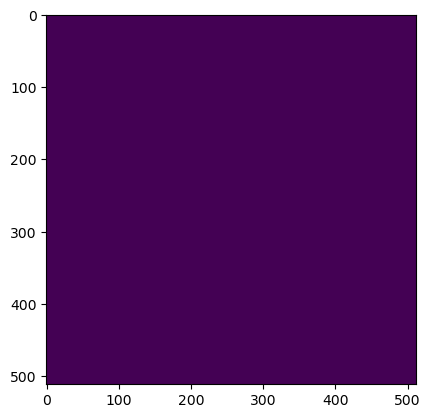

Wrote output/patches/mask/UU_S1_111-529155-2000-6293678-4000.tiff (512 x 512 pixels)


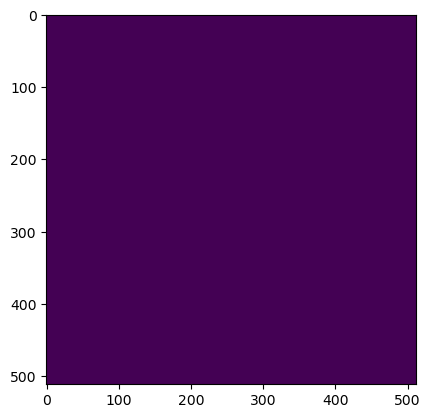

Wrote output/patches/mask/UU_S1_111-529155-2000-6293780-8000.tiff (512 x 512 pixels)


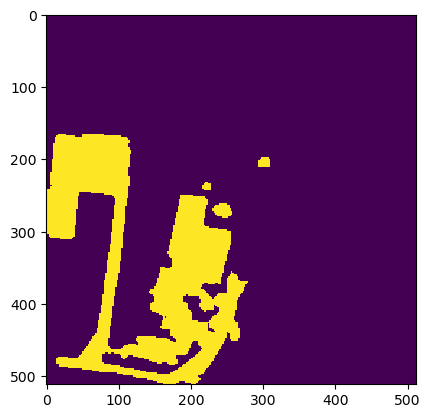

Wrote output/patches/mask/UU_S1_111-529155-2000-6293883-2000.tiff (512 x 512 pixels)


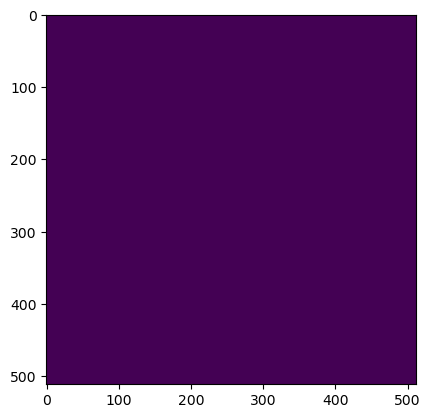

Wrote output/patches/mask/UU_S1_111-529155-2000-6293985-6000.tiff (512 x 512 pixels)


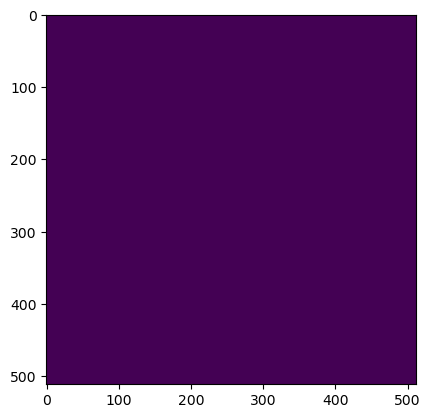

Wrote output/patches/mask/UU_S1_111-529155-2000-6294088-0000.tiff (512 x 512 pixels)


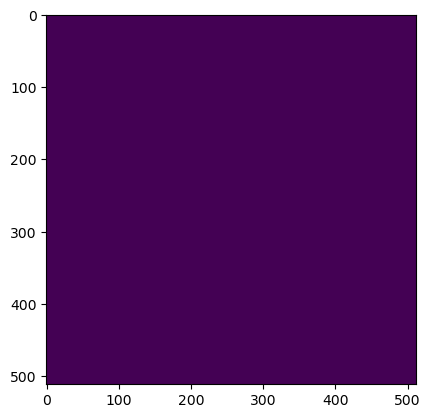

Wrote output/patches/mask/UU_S1_111-529155-2000-6294190-4000.tiff (512 x 512 pixels)


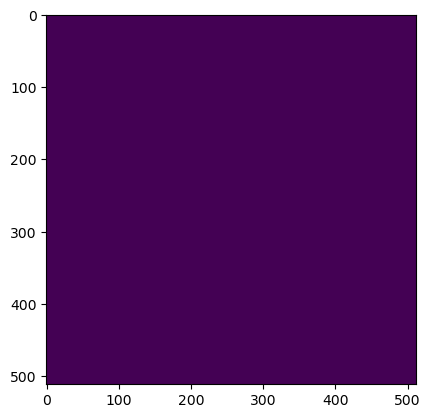

Wrote output/patches/mask/UU_S1_111-529155-2000-6294292-8000.tiff (512 x 512 pixels)


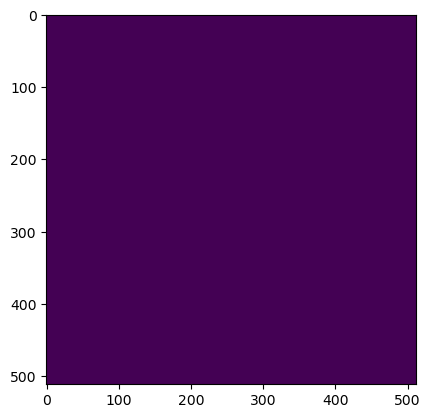

Wrote output/patches/mask/UU_S1_111-529155-2000-6294395-2000.tiff (512 x 512 pixels)


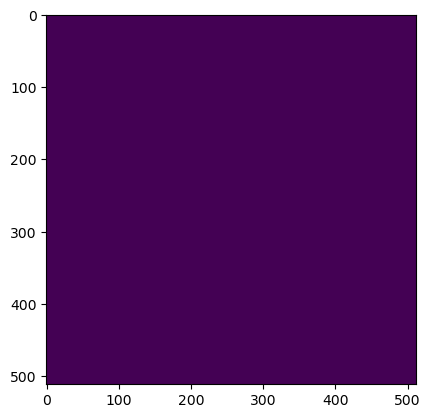

Wrote output/patches/mask/UU_S1_111-529155-2000-6294497-6000.tiff (512 x 512 pixels)
Zone CC_S1_112 Building Mask...


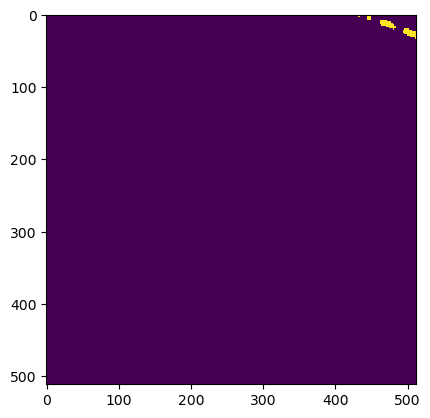

Wrote output/patches/mask/CC_S1_112-441552-0000-6293678-4000.tiff (512 x 512 pixels)


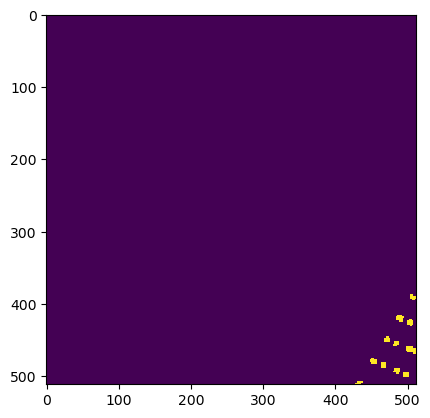

Wrote output/patches/mask/CC_S1_112-441552-0000-6293780-8000.tiff (512 x 512 pixels)


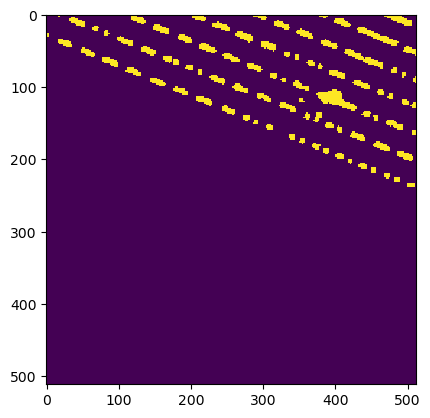

Wrote output/patches/mask/CC_S1_112-441654-4000-6293678-4000.tiff (512 x 512 pixels)


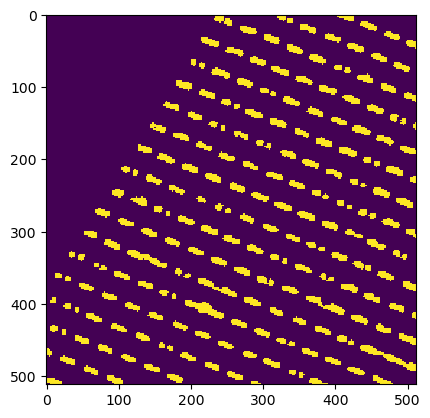

Wrote output/patches/mask/CC_S1_112-441654-4000-6293780-8000.tiff (512 x 512 pixels)


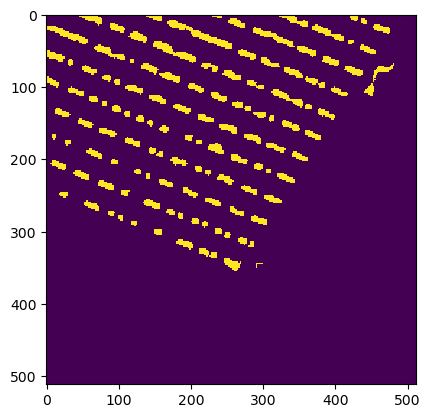

Wrote output/patches/mask/CC_S1_112-441756-8000-6293678-4000.tiff (512 x 512 pixels)


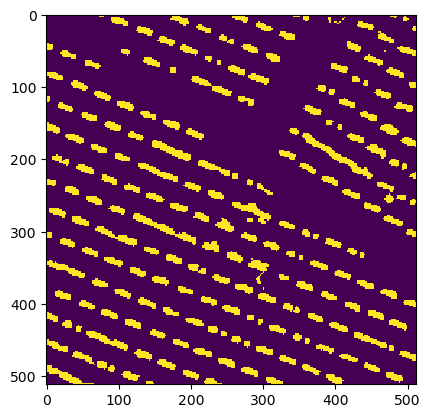

Wrote output/patches/mask/CC_S1_112-441756-8000-6293780-8000.tiff (512 x 512 pixels)


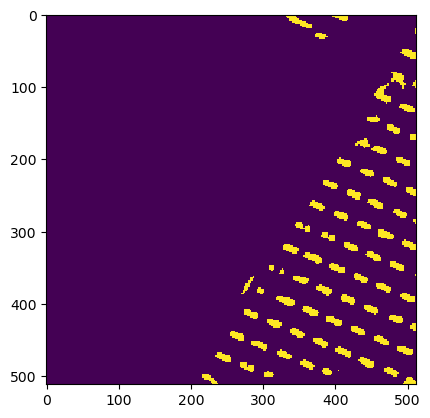

Wrote output/patches/mask/CC_S1_112-441859-2000-6293678-4000.tiff (512 x 512 pixels)


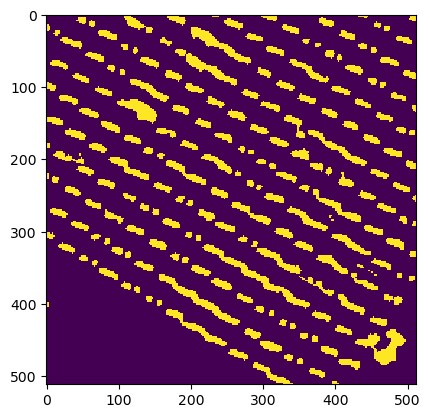

Wrote output/patches/mask/CC_S1_112-441859-2000-6293780-8000.tiff (512 x 512 pixels)
Zone CU_S1_113 Building Mask...


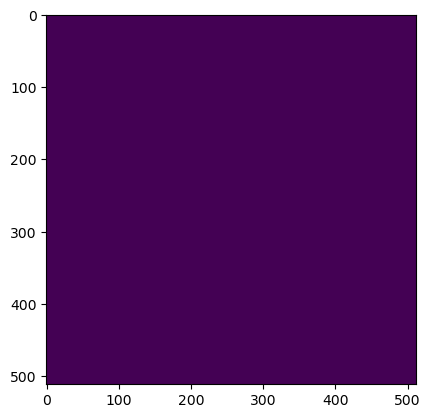

Wrote output/patches/mask/CU_S1_113-448208-0000-6293934-4000.tiff (512 x 512 pixels)


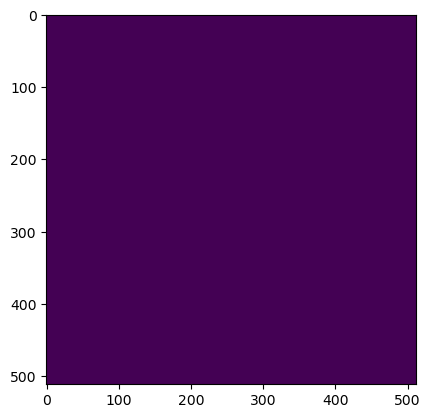

Wrote output/patches/mask/CU_S1_113-448208-0000-6294036-8000.tiff (512 x 512 pixels)


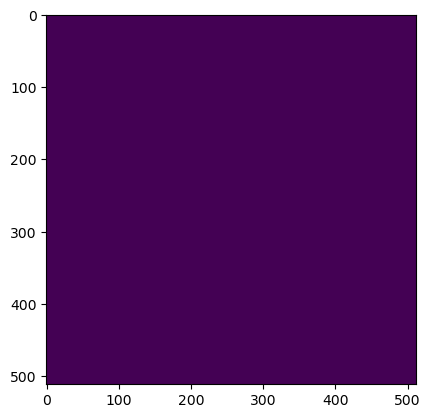

Wrote output/patches/mask/CU_S1_113-448310-4000-6293934-4000.tiff (512 x 512 pixels)


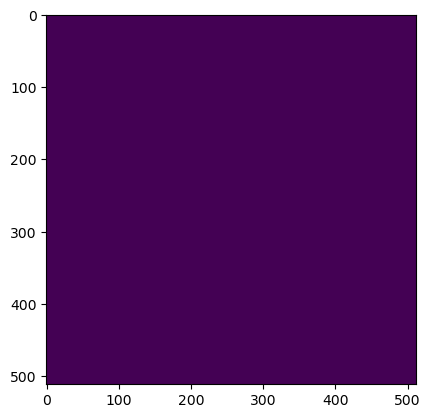

Wrote output/patches/mask/CU_S1_113-448310-4000-6294036-8000.tiff (512 x 512 pixels)


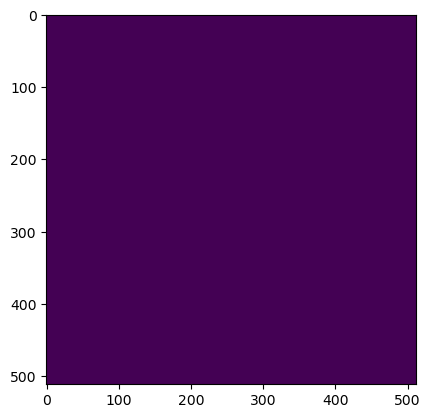

Wrote output/patches/mask/CU_S1_113-448412-8000-6293934-4000.tiff (512 x 512 pixels)


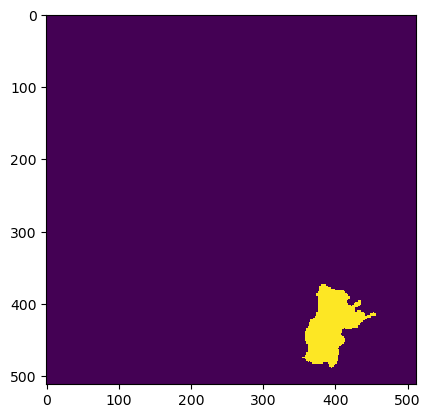

Wrote output/patches/mask/CU_S1_113-448412-8000-6294036-8000.tiff (512 x 512 pixels)


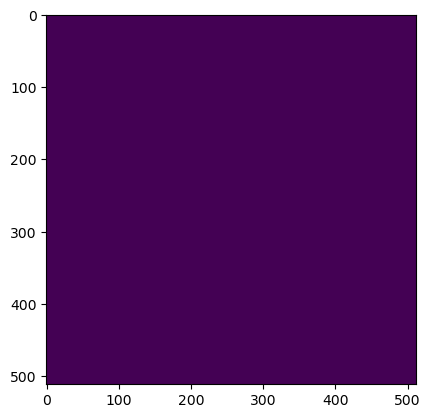

Wrote output/patches/mask/CU_S1_113-448515-2000-6293934-4000.tiff (512 x 512 pixels)


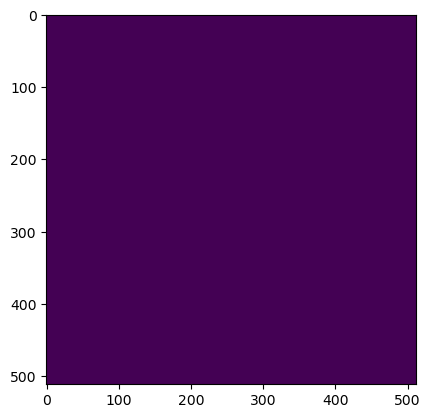

Wrote output/patches/mask/CU_S1_113-448515-2000-6294036-8000.tiff (512 x 512 pixels)
Zone VC_S1_114 Building Mask...


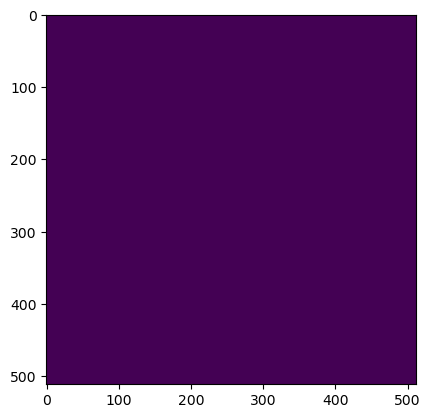

Wrote output/patches/mask/VC_S1_114-455888-0000-6294190-4000.tiff (512 x 512 pixels)


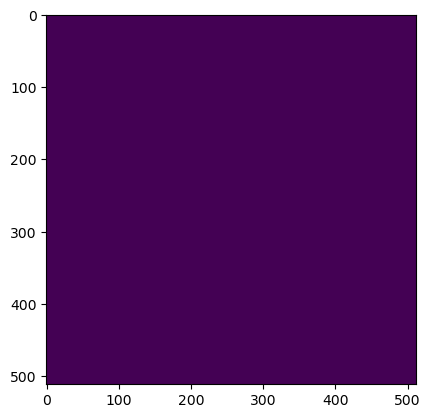

Wrote output/patches/mask/VC_S1_114-455888-0000-6294292-8000.tiff (512 x 512 pixels)


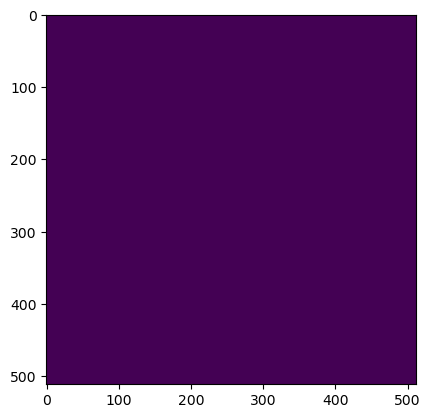

Wrote output/patches/mask/VC_S1_114-455990-4000-6294190-4000.tiff (512 x 512 pixels)


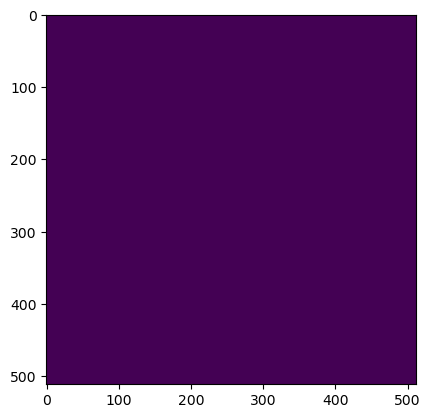

Wrote output/patches/mask/VC_S1_114-455990-4000-6294292-8000.tiff (512 x 512 pixels)
Zone UC_S1_115 Building Mask...


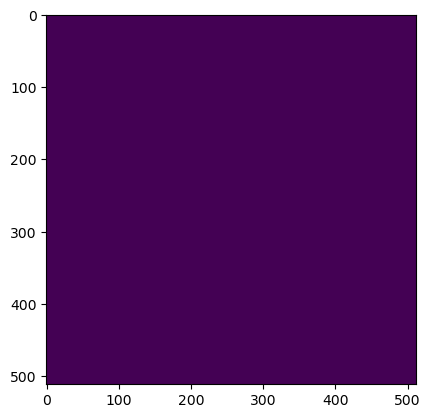

Wrote output/patches/mask/UC_S1_115-482256-0000-6294958-4000.tiff (512 x 512 pixels)


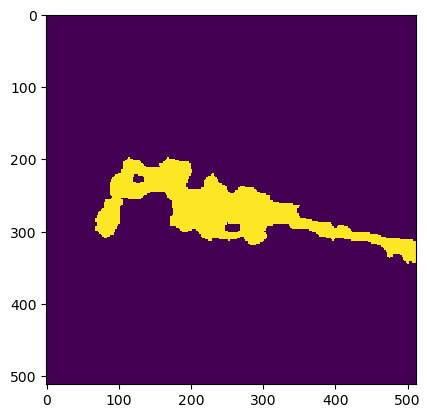

Wrote output/patches/mask/UC_S1_115-482256-0000-6295060-8000.tiff (512 x 512 pixels)


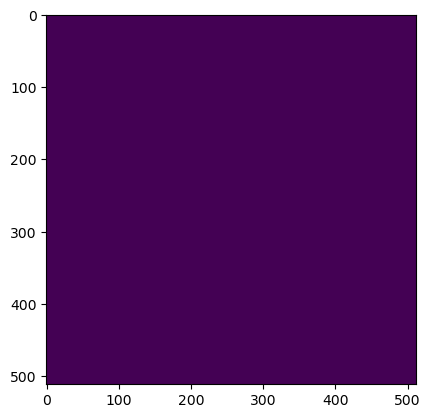

Wrote output/patches/mask/UC_S1_115-482358-4000-6294958-4000.tiff (512 x 512 pixels)


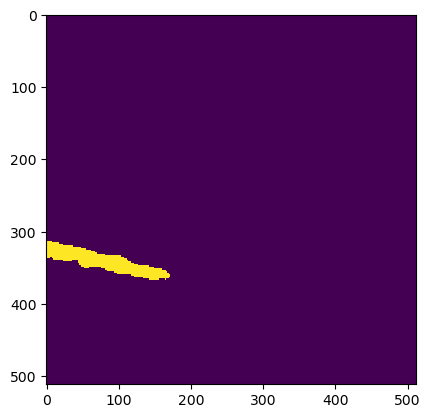

Wrote output/patches/mask/UC_S1_115-482358-4000-6295060-8000.tiff (512 x 512 pixels)


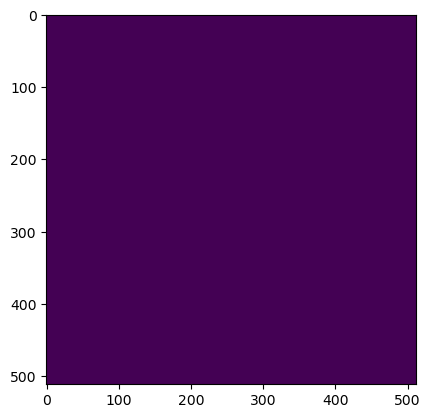

Wrote output/patches/mask/UC_S1_115-482460-8000-6294958-4000.tiff (512 x 512 pixels)


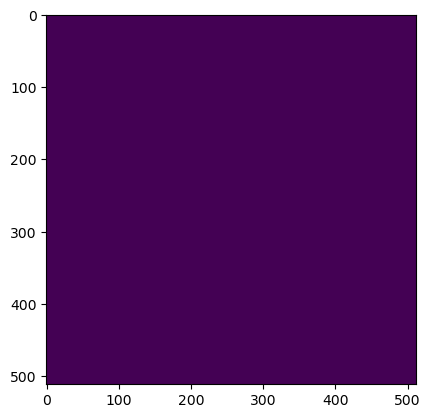

Wrote output/patches/mask/UC_S1_115-482460-8000-6295060-8000.tiff (512 x 512 pixels)


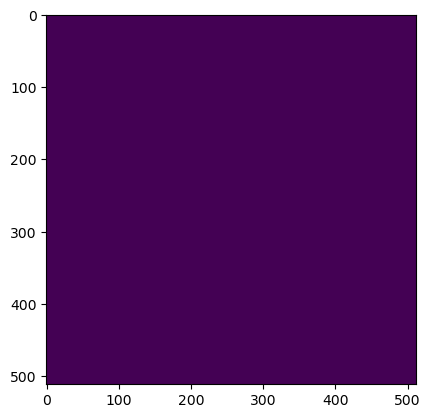

Wrote output/patches/mask/UC_S1_115-482563-2000-6294958-4000.tiff (512 x 512 pixels)


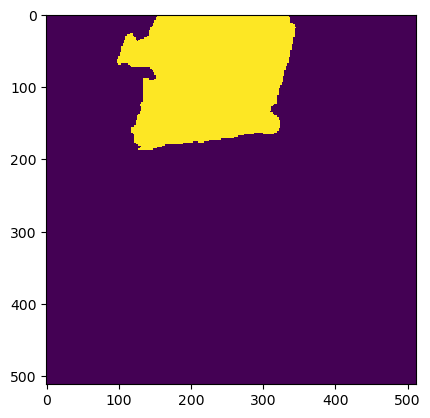

Wrote output/patches/mask/UC_S1_115-482563-2000-6295060-8000.tiff (512 x 512 pixels)
Zone UC_S1_116 Building Mask...


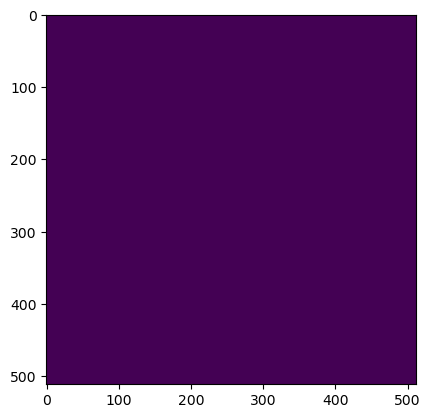

Wrote output/patches/mask/UC_S1_116-452048-0000-6295214-4000.tiff (512 x 512 pixels)


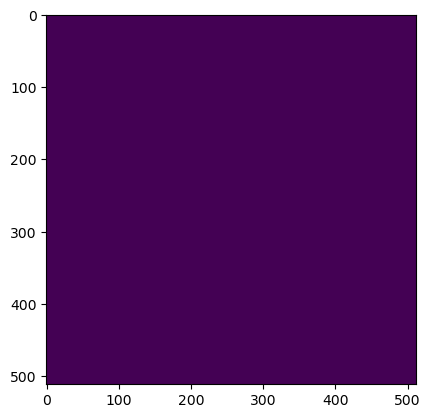

Wrote output/patches/mask/UC_S1_116-452048-0000-6295316-8000.tiff (512 x 512 pixels)


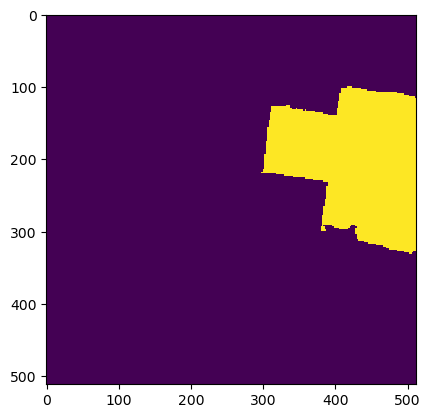

Wrote output/patches/mask/UC_S1_116-452150-4000-6295214-4000.tiff (512 x 512 pixels)


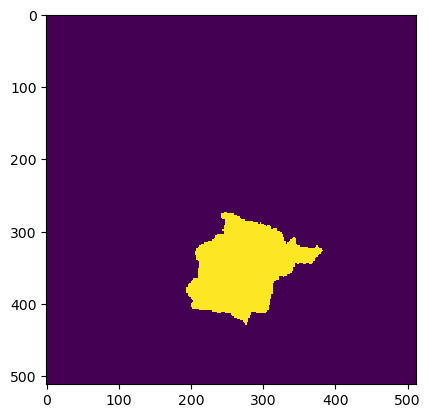

Wrote output/patches/mask/UC_S1_116-452150-4000-6295316-8000.tiff (512 x 512 pixels)
Zone CU_S1_117 Building Mask...


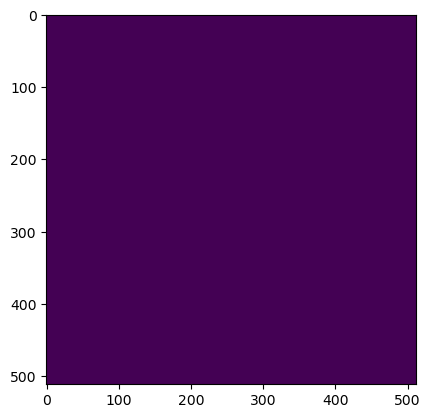

Wrote output/patches/mask/CU_S1_117-455632-0000-6295214-4000.tiff (512 x 512 pixels)


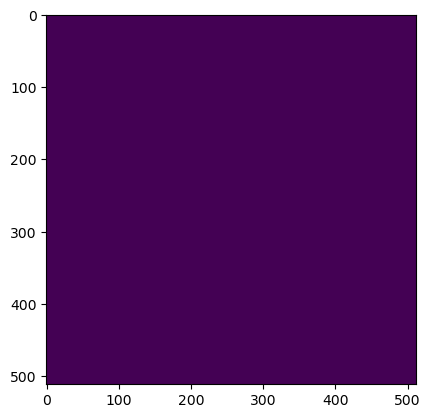

Wrote output/patches/mask/CU_S1_117-455632-0000-6295316-8000.tiff (512 x 512 pixels)


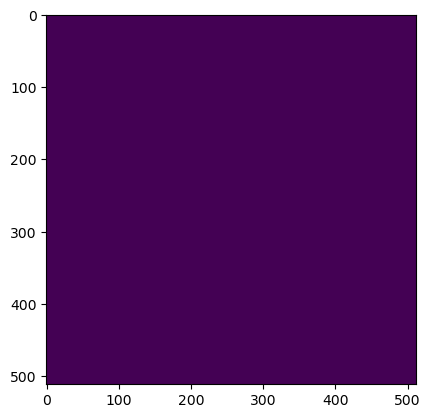

Wrote output/patches/mask/CU_S1_117-455734-4000-6295214-4000.tiff (512 x 512 pixels)


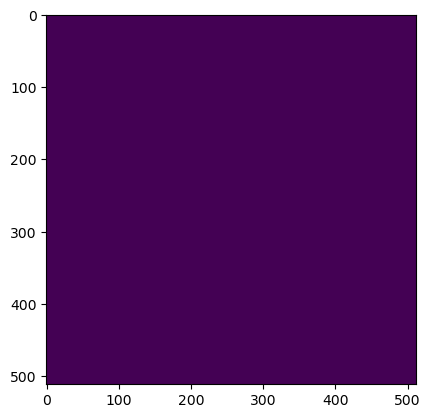

Wrote output/patches/mask/CU_S1_117-455734-4000-6295316-8000.tiff (512 x 512 pixels)


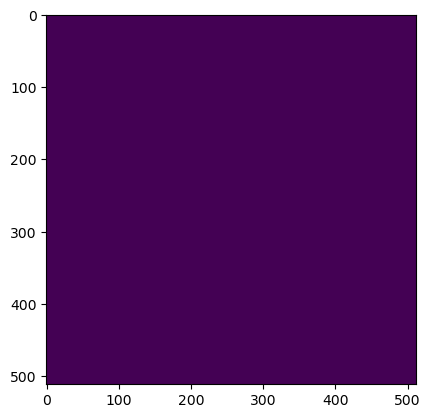

Wrote output/patches/mask/CU_S1_117-455836-8000-6295214-4000.tiff (512 x 512 pixels)


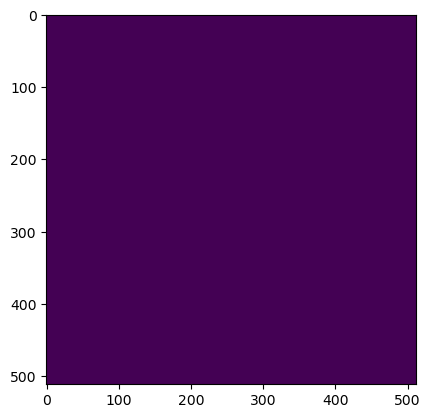

Wrote output/patches/mask/CU_S1_117-455836-8000-6295316-8000.tiff (512 x 512 pixels)


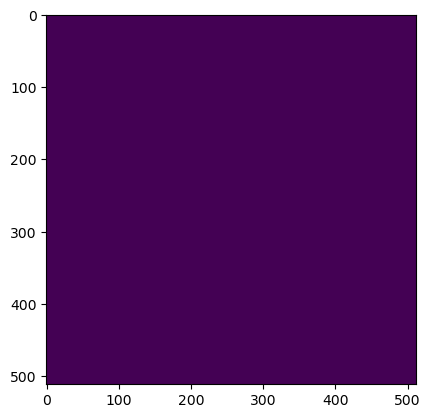

Wrote output/patches/mask/CU_S1_117-455939-2000-6295214-4000.tiff (512 x 512 pixels)


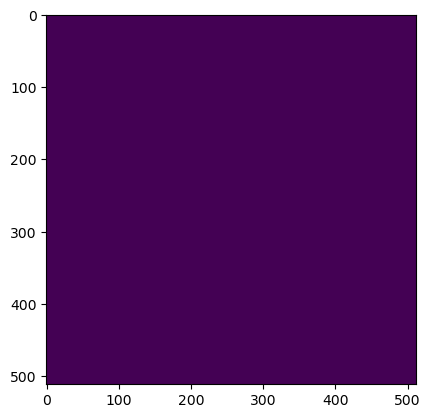

Wrote output/patches/mask/CU_S1_117-455939-2000-6295316-8000.tiff (512 x 512 pixels)


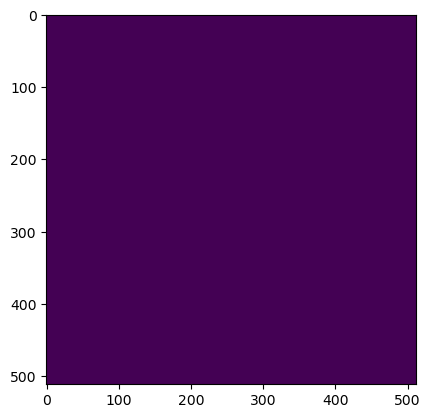

Wrote output/patches/mask/CU_S1_117-456041-6000-6295214-4000.tiff (512 x 512 pixels)


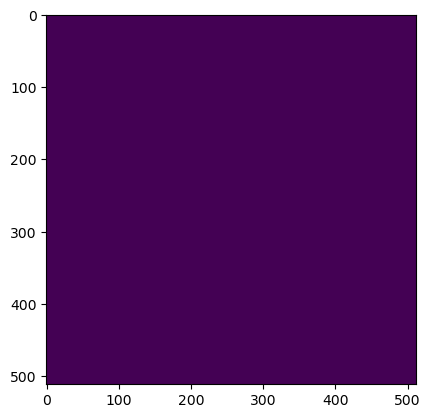

Wrote output/patches/mask/CU_S1_117-456041-6000-6295316-8000.tiff (512 x 512 pixels)


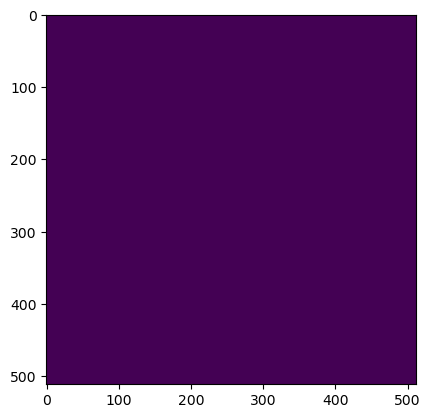

Wrote output/patches/mask/CU_S1_117-456144-0000-6295214-4000.tiff (512 x 512 pixels)


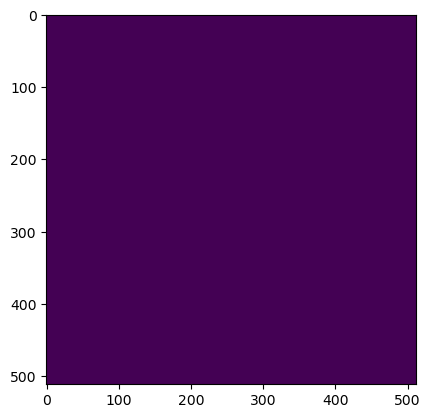

Wrote output/patches/mask/CU_S1_117-456144-0000-6295316-8000.tiff (512 x 512 pixels)


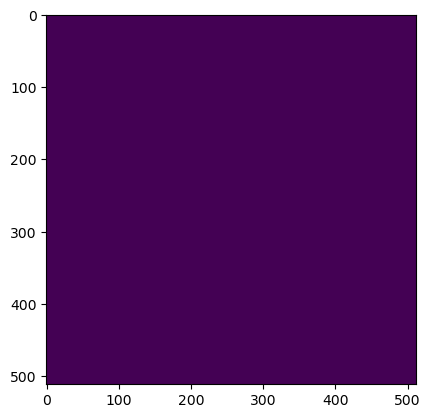

Wrote output/patches/mask/CU_S1_117-456246-4000-6295214-4000.tiff (512 x 512 pixels)


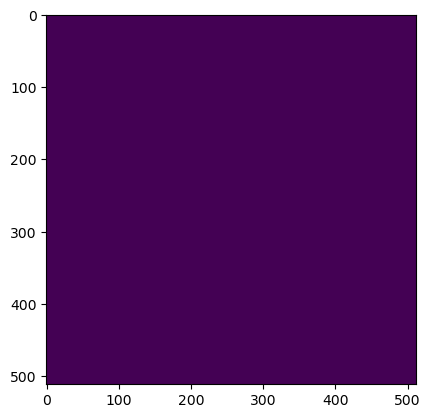

Wrote output/patches/mask/CU_S1_117-456246-4000-6295316-8000.tiff (512 x 512 pixels)
Zone UC_S1_118 Building Mask...


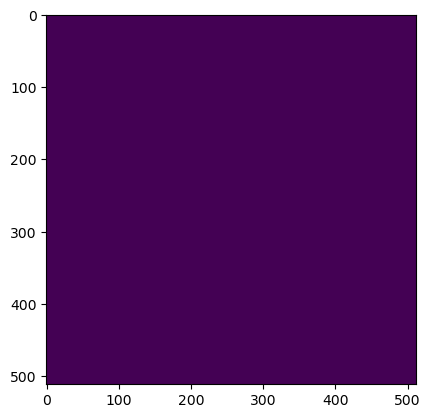

Wrote output/patches/mask/UC_S1_118-484048-0000-6295470-4000.tiff (512 x 512 pixels)


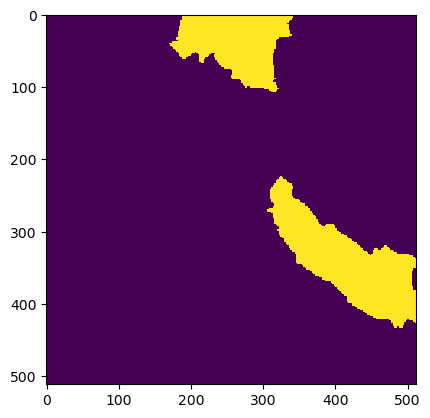

Wrote output/patches/mask/UC_S1_118-484048-0000-6295572-8000.tiff (512 x 512 pixels)


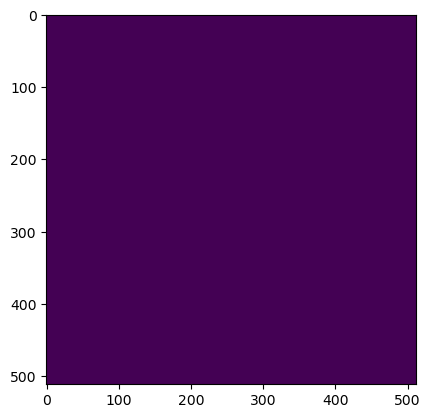

Wrote output/patches/mask/UC_S1_118-484150-4000-6295470-4000.tiff (512 x 512 pixels)


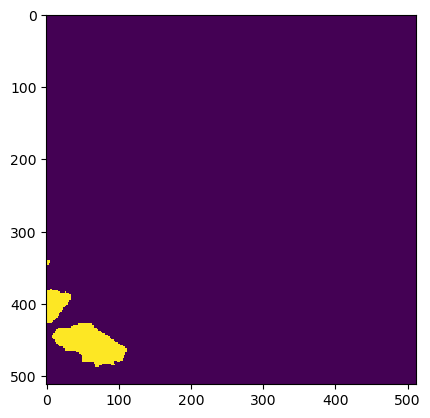

Wrote output/patches/mask/UC_S1_118-484150-4000-6295572-8000.tiff (512 x 512 pixels)
Zone UC_S1_119 Building Mask...


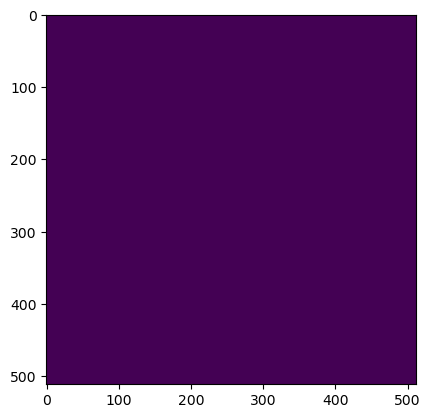

Wrote output/patches/mask/UC_S1_119-456912-0000-6296238-4000.tiff (512 x 512 pixels)


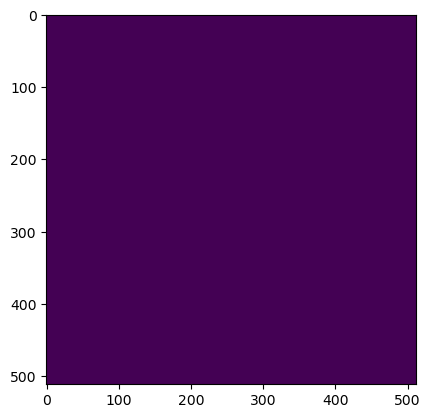

Wrote output/patches/mask/UC_S1_119-456912-0000-6296340-8000.tiff (512 x 512 pixels)


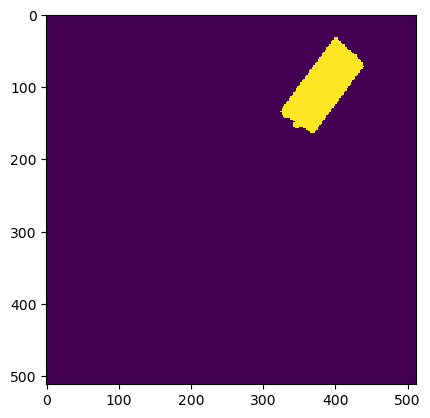

Wrote output/patches/mask/UC_S1_119-457014-4000-6296238-4000.tiff (512 x 512 pixels)


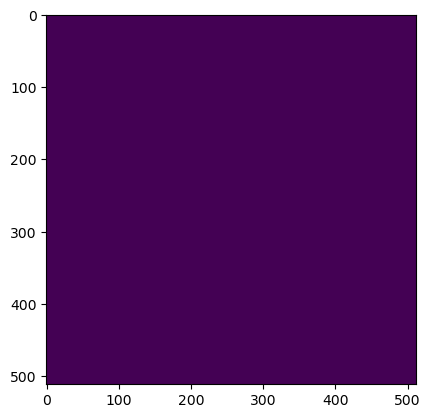

Wrote output/patches/mask/UC_S1_119-457014-4000-6296340-8000.tiff (512 x 512 pixels)
Zone UV_S1_120 Building Mask...


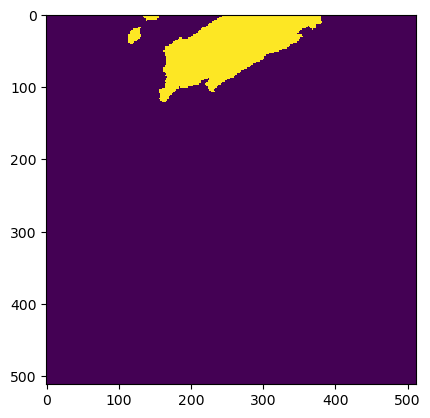

Wrote output/patches/mask/UV_S1_120-506832-0000-6296750-4000.tiff (512 x 512 pixels)


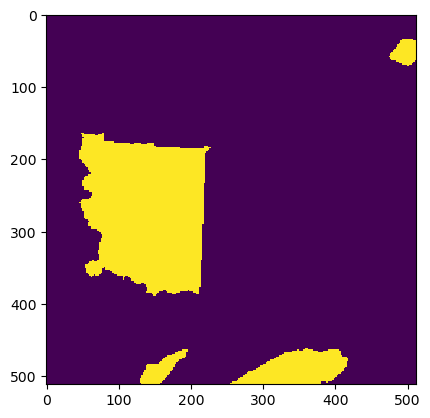

Wrote output/patches/mask/UV_S1_120-506832-0000-6296852-8000.tiff (512 x 512 pixels)


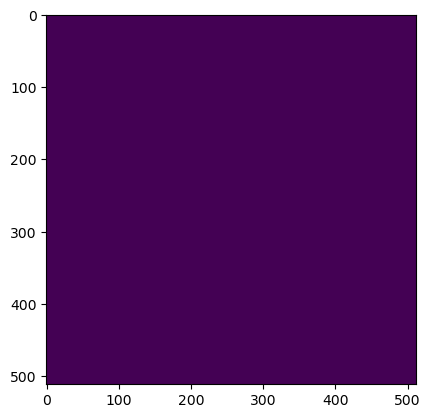

Wrote output/patches/mask/UV_S1_120-506934-4000-6296750-4000.tiff (512 x 512 pixels)


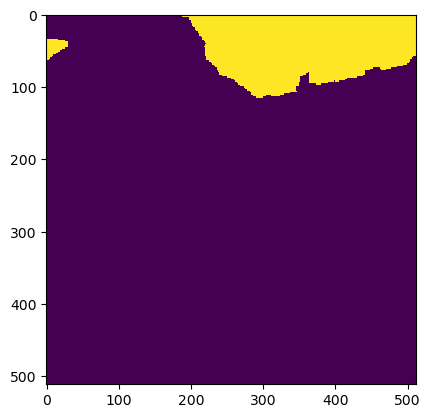

Wrote output/patches/mask/UV_S1_120-506934-4000-6296852-8000.tiff (512 x 512 pixels)
Zone CC_S1_121 Building Mask...


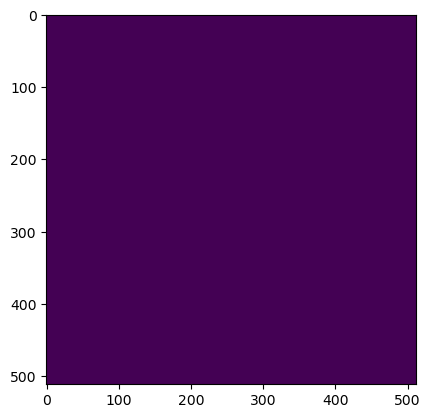

Wrote output/patches/mask/CC_S1_121-451024-0000-6297262-4000.tiff (512 x 512 pixels)


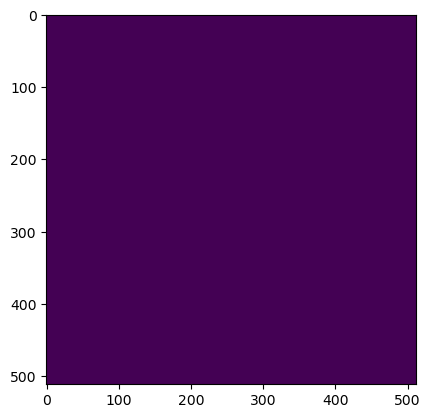

Wrote output/patches/mask/CC_S1_121-451024-0000-6297364-8000.tiff (512 x 512 pixels)


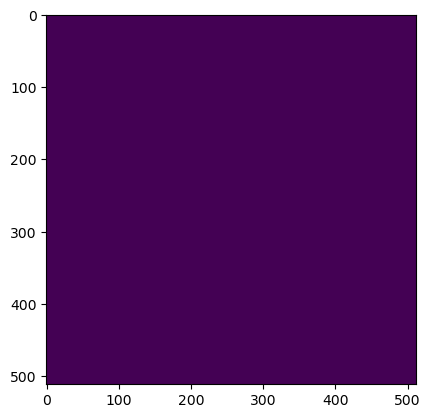

Wrote output/patches/mask/CC_S1_121-451126-4000-6297262-4000.tiff (512 x 512 pixels)


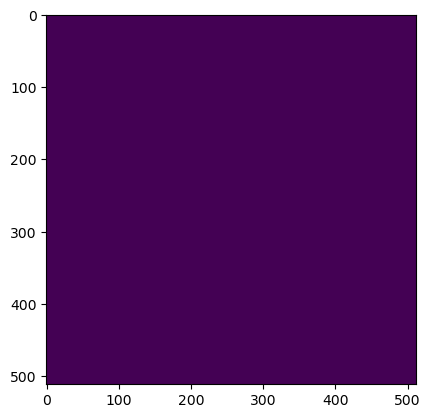

Wrote output/patches/mask/CC_S1_121-451126-4000-6297364-8000.tiff (512 x 512 pixels)
Zone CC_S1_122 Building Mask...


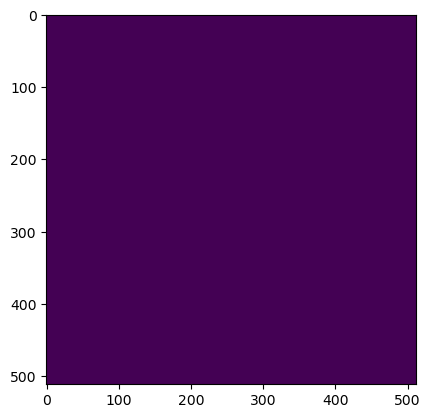

Wrote output/patches/mask/CC_S1_122-454864-0000-6297774-4000.tiff (512 x 512 pixels)


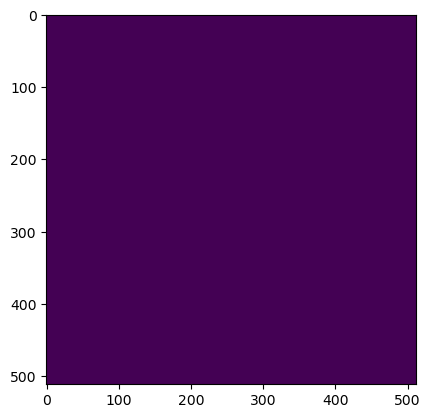

Wrote output/patches/mask/CC_S1_122-454864-0000-6297876-8000.tiff (512 x 512 pixels)


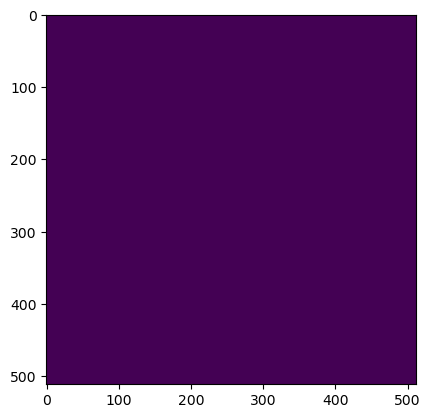

Wrote output/patches/mask/CC_S1_122-454966-4000-6297774-4000.tiff (512 x 512 pixels)


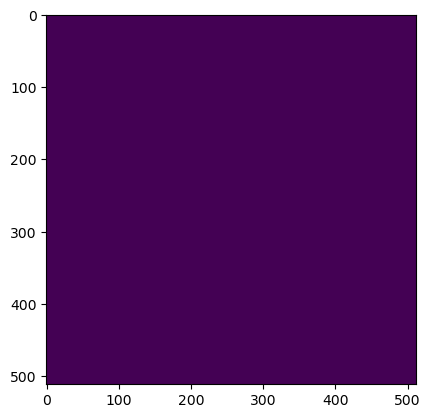

Wrote output/patches/mask/CC_S1_122-454966-4000-6297876-8000.tiff (512 x 512 pixels)
Zone VV_S1_123 Building Mask...


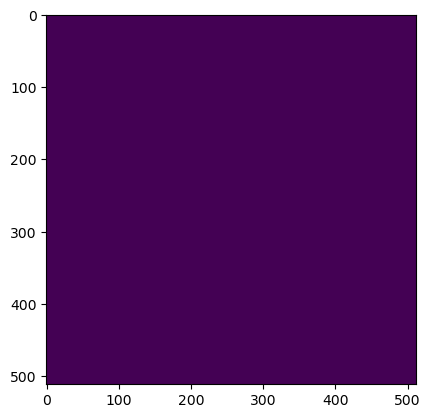

Wrote output/patches/mask/VV_S1_123-460496-0000-6297774-4000.tiff (512 x 512 pixels)


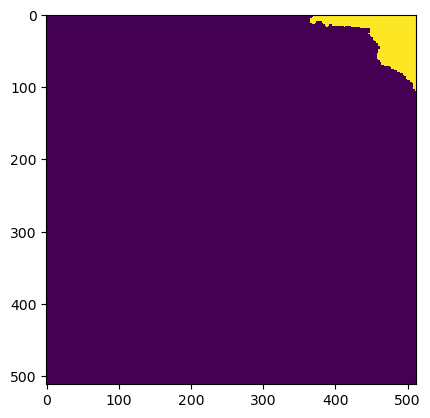

Wrote output/patches/mask/VV_S1_123-460496-0000-6297876-8000.tiff (512 x 512 pixels)


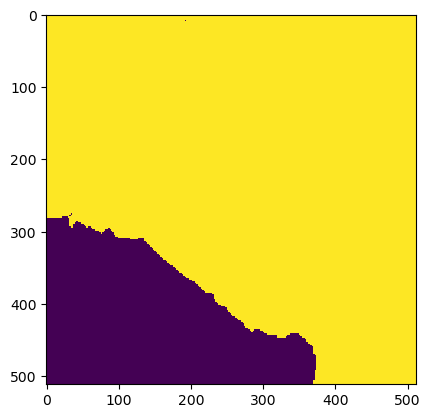

Wrote output/patches/mask/VV_S1_123-460496-0000-6297979-2000.tiff (512 x 512 pixels)


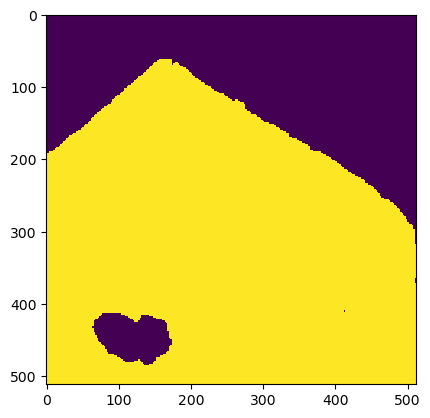

Wrote output/patches/mask/VV_S1_123-460496-0000-6298081-6000.tiff (512 x 512 pixels)


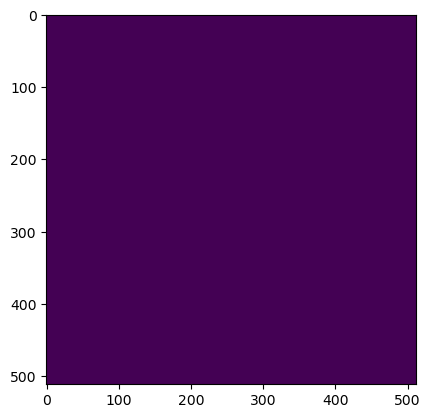

Wrote output/patches/mask/VV_S1_123-460598-4000-6297774-4000.tiff (512 x 512 pixels)


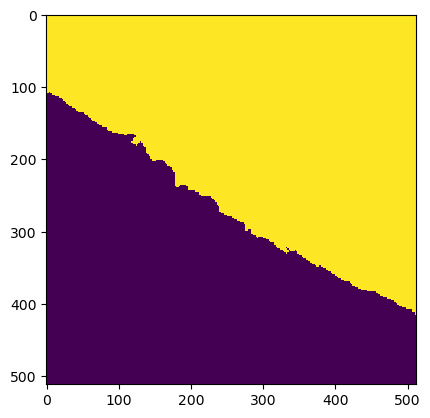

Wrote output/patches/mask/VV_S1_123-460598-4000-6297876-8000.tiff (512 x 512 pixels)


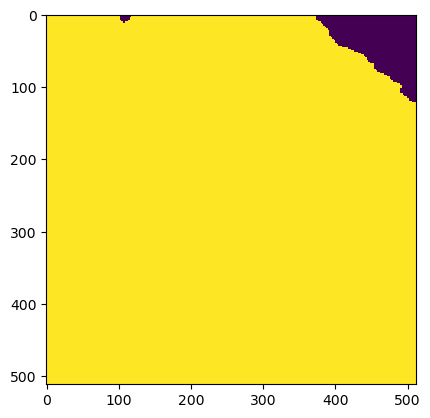

Wrote output/patches/mask/VV_S1_123-460598-4000-6297979-2000.tiff (512 x 512 pixels)


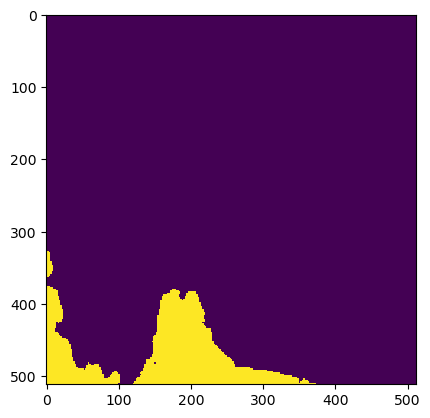

Wrote output/patches/mask/VV_S1_123-460598-4000-6298081-6000.tiff (512 x 512 pixels)
Zone UU_S1_124 Building Mask...


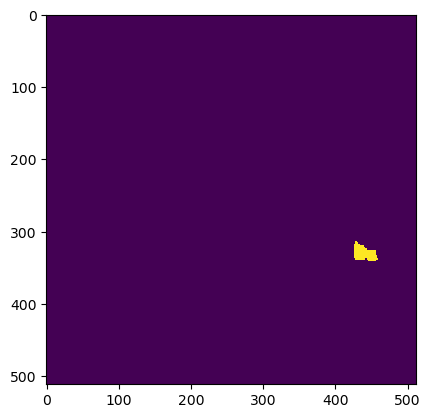

Wrote output/patches/mask/UU_S1_124-509392-0000-6298542-4000.tiff (512 x 512 pixels)


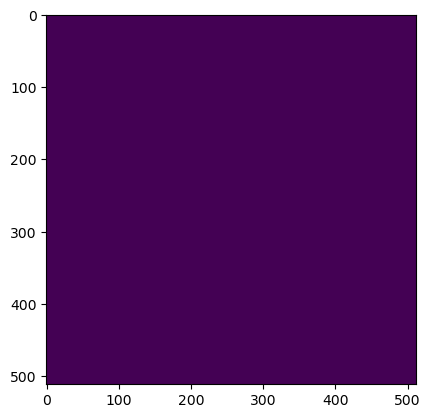

Wrote output/patches/mask/UU_S1_124-509392-0000-6298644-8000.tiff (512 x 512 pixels)


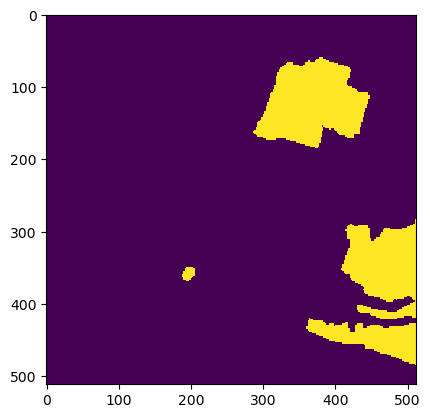

Wrote output/patches/mask/UU_S1_124-509494-4000-6298542-4000.tiff (512 x 512 pixels)


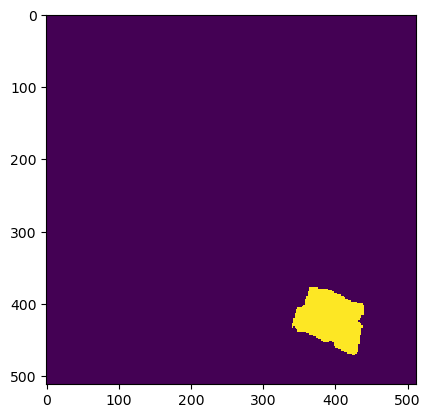

Wrote output/patches/mask/UU_S1_124-509494-4000-6298644-8000.tiff (512 x 512 pixels)
Zone UU_S1_125 Building Mask...


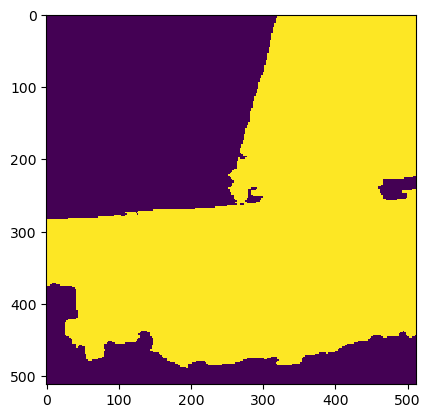

Wrote output/patches/mask/UU_S1_125-445648-0000-6299054-4000.tiff (512 x 512 pixels)


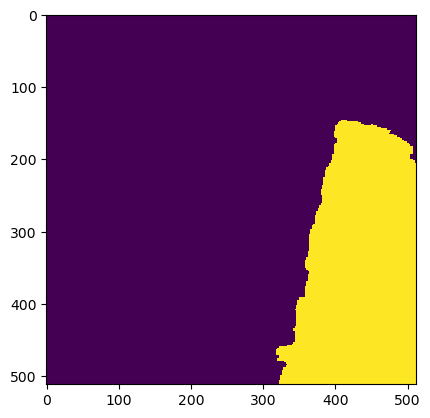

Wrote output/patches/mask/UU_S1_125-445648-0000-6299156-8000.tiff (512 x 512 pixels)


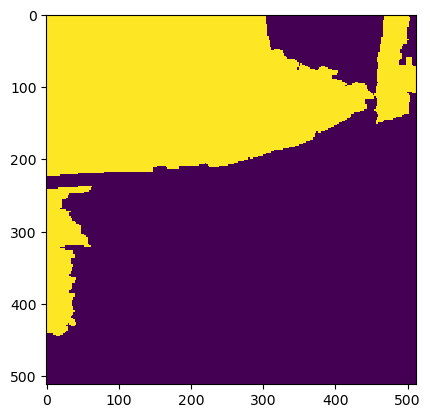

Wrote output/patches/mask/UU_S1_125-445750-4000-6299054-4000.tiff (512 x 512 pixels)


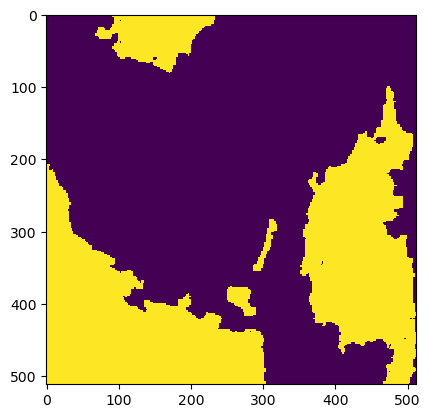

Wrote output/patches/mask/UU_S1_125-445750-4000-6299156-8000.tiff (512 x 512 pixels)
Zone CC_S1_126 Building Mask...


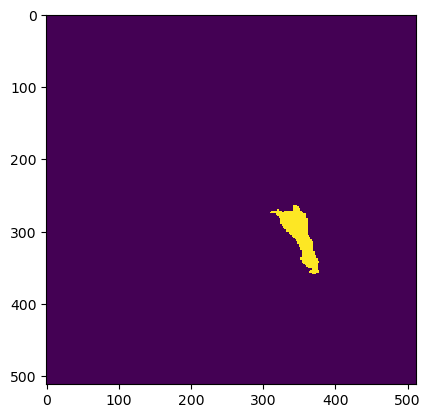

Wrote output/patches/mask/CC_S1_126-456912-0000-6298286-4000.tiff (512 x 512 pixels)


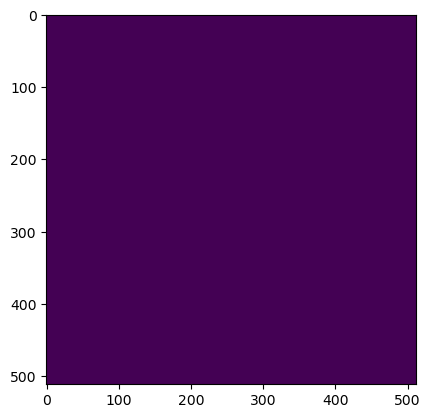

Wrote output/patches/mask/CC_S1_126-456912-0000-6298388-8000.tiff (512 x 512 pixels)


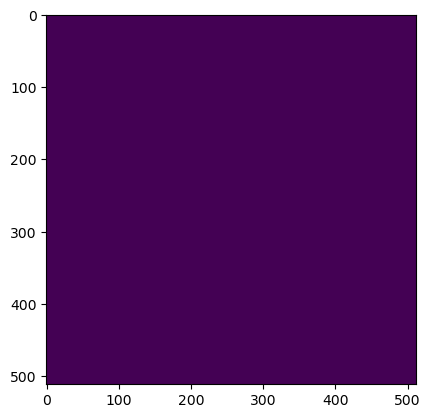

Wrote output/patches/mask/CC_S1_126-457014-4000-6298286-4000.tiff (512 x 512 pixels)


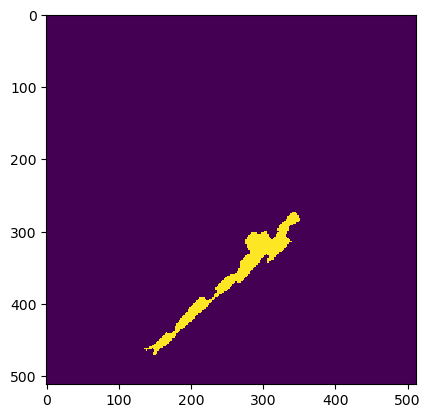

Wrote output/patches/mask/CC_S1_126-457014-4000-6298388-8000.tiff (512 x 512 pixels)
Zone VC_S1_127 Building Mask...


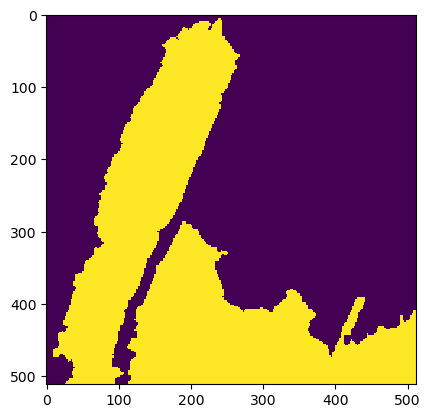

Wrote output/patches/mask/VC_S1_127-460752-0000-6299566-4000.tiff (512 x 512 pixels)


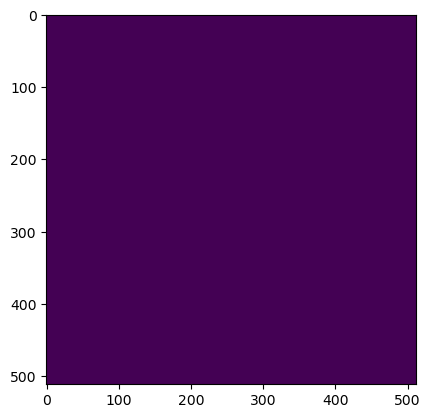

Wrote output/patches/mask/VC_S1_127-460752-0000-6299668-8000.tiff (512 x 512 pixels)


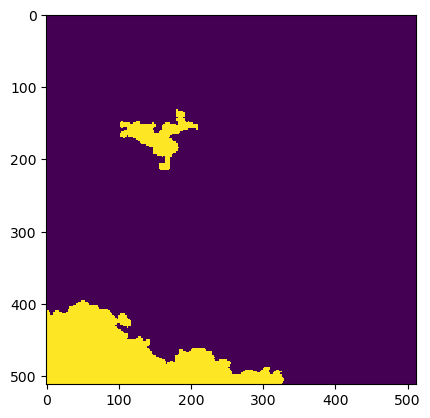

Wrote output/patches/mask/VC_S1_127-460854-4000-6299566-4000.tiff (512 x 512 pixels)


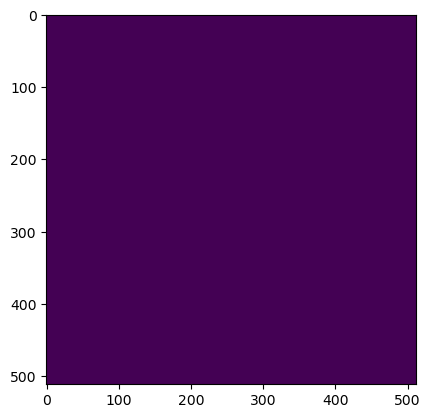

Wrote output/patches/mask/VC_S1_127-460854-4000-6299668-8000.tiff (512 x 512 pixels)
Zone VC_S1_128 Building Mask...


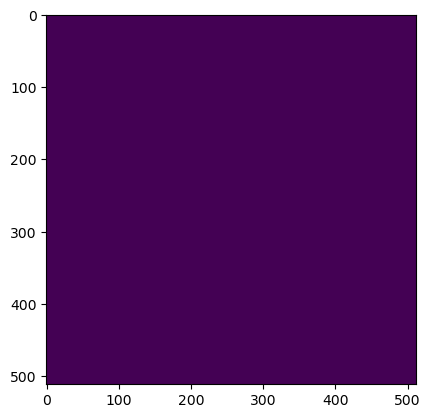

Wrote output/patches/mask/VC_S1_128-472784-0000-6299566-4000.tiff (512 x 512 pixels)


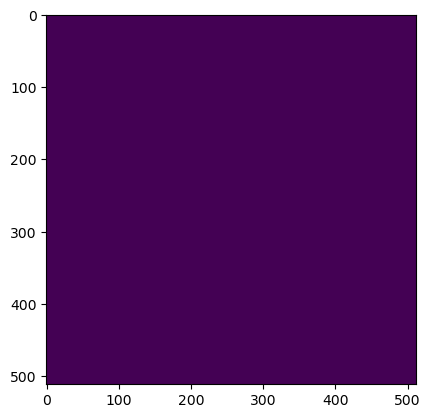

Wrote output/patches/mask/VC_S1_128-472784-0000-6299668-8000.tiff (512 x 512 pixels)


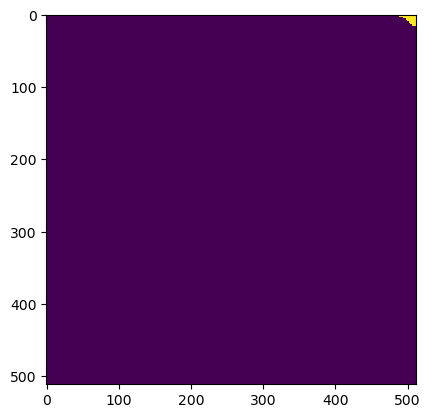

Wrote output/patches/mask/VC_S1_128-472784-0000-6299771-2000.tiff (512 x 512 pixels)


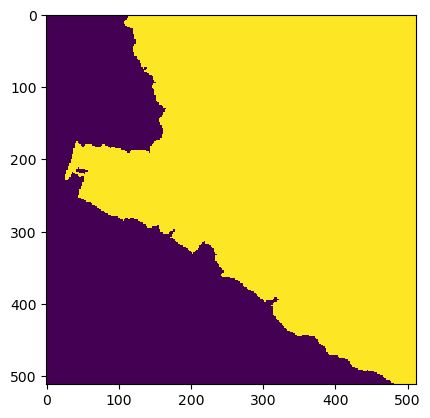

Wrote output/patches/mask/VC_S1_128-472784-0000-6299873-6000.tiff (512 x 512 pixels)


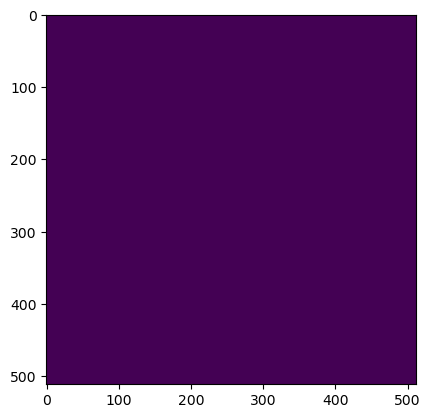

Wrote output/patches/mask/VC_S1_128-472886-4000-6299566-4000.tiff (512 x 512 pixels)


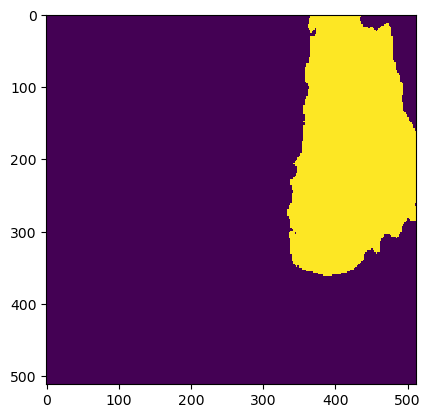

Wrote output/patches/mask/VC_S1_128-472886-4000-6299668-8000.tiff (512 x 512 pixels)


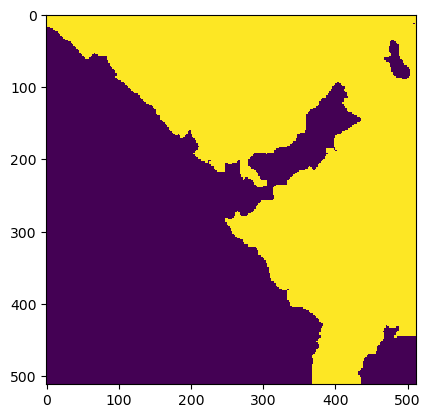

Wrote output/patches/mask/VC_S1_128-472886-4000-6299771-2000.tiff (512 x 512 pixels)


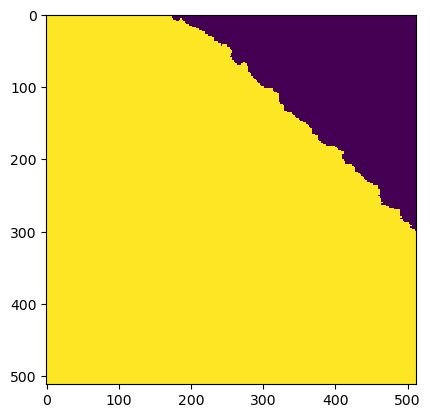

Wrote output/patches/mask/VC_S1_128-472886-4000-6299873-6000.tiff (512 x 512 pixels)
Zone CC_S1_129 Building Mask...


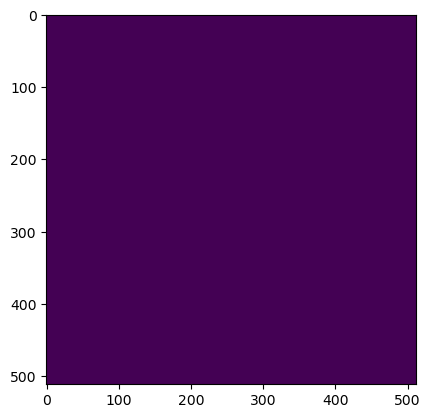

Wrote output/patches/mask/CC_S1_129-463312-0000-6299822-4000.tiff (512 x 512 pixels)


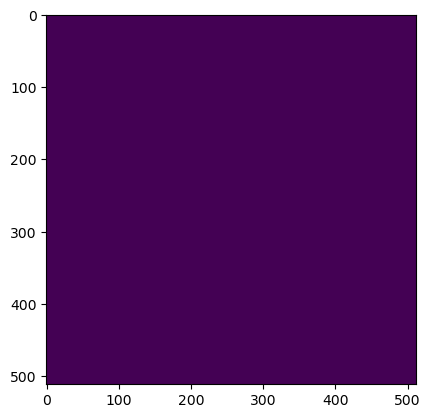

Wrote output/patches/mask/CC_S1_129-463312-0000-6299924-8000.tiff (512 x 512 pixels)


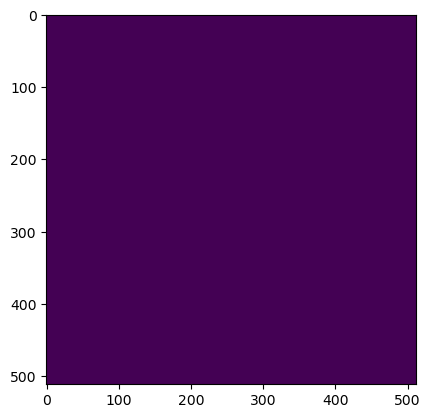

Wrote output/patches/mask/CC_S1_129-463312-0000-6300027-2000.tiff (512 x 512 pixels)


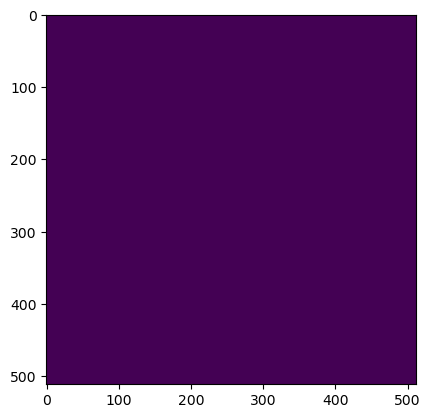

Wrote output/patches/mask/CC_S1_129-463312-0000-6300129-6000.tiff (512 x 512 pixels)


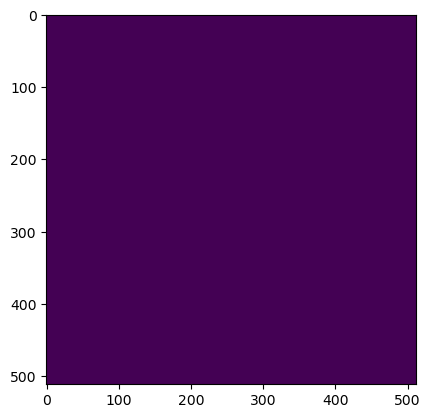

Wrote output/patches/mask/CC_S1_129-463414-4000-6299822-4000.tiff (512 x 512 pixels)


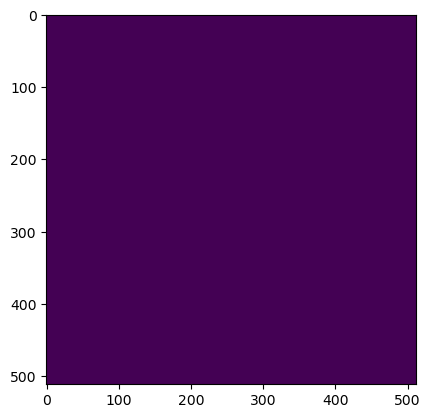

Wrote output/patches/mask/CC_S1_129-463414-4000-6299924-8000.tiff (512 x 512 pixels)


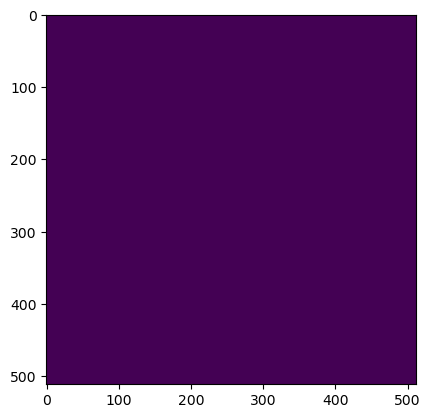

Wrote output/patches/mask/CC_S1_129-463414-4000-6300027-2000.tiff (512 x 512 pixels)


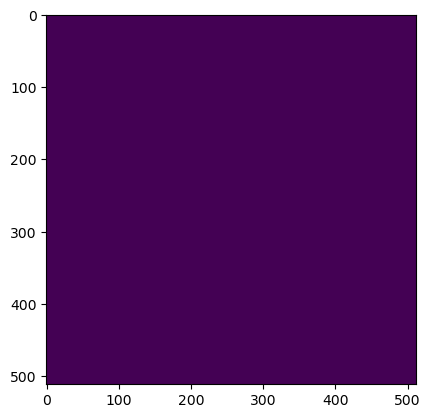

Wrote output/patches/mask/CC_S1_129-463414-4000-6300129-6000.tiff (512 x 512 pixels)
Zone UC_S1_130 Building Mask...


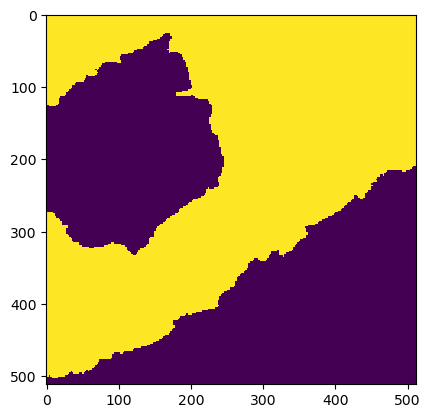

Wrote output/patches/mask/UC_S1_130-493520-0000-6299822-4000.tiff (512 x 512 pixels)


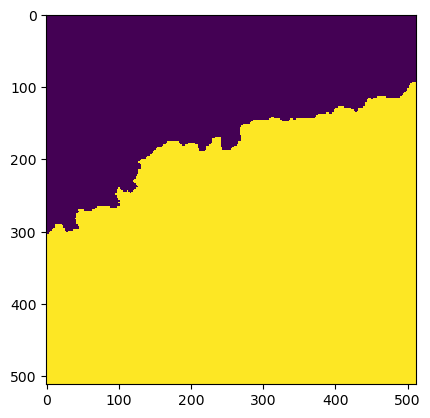

Wrote output/patches/mask/UC_S1_130-493520-0000-6299924-8000.tiff (512 x 512 pixels)


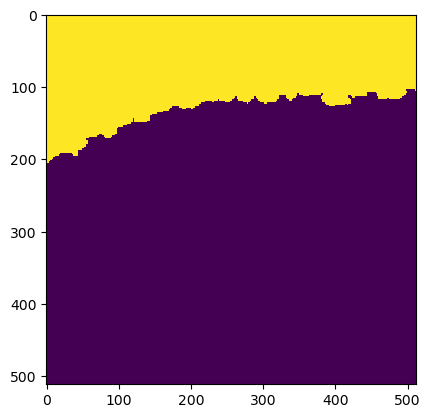

Wrote output/patches/mask/UC_S1_130-493622-4000-6299822-4000.tiff (512 x 512 pixels)


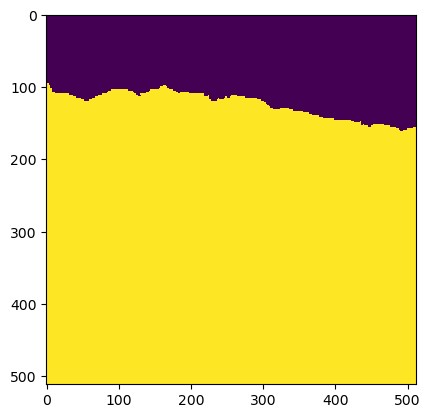

Wrote output/patches/mask/UC_S1_130-493622-4000-6299924-8000.tiff (512 x 512 pixels)


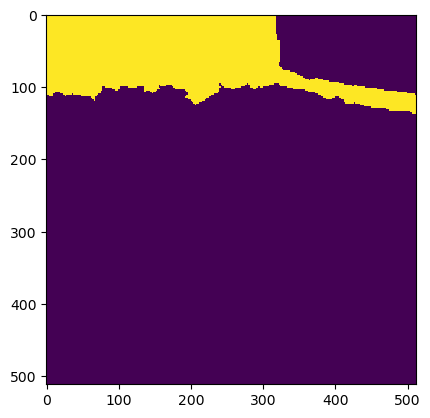

Wrote output/patches/mask/UC_S1_130-493724-8000-6299822-4000.tiff (512 x 512 pixels)


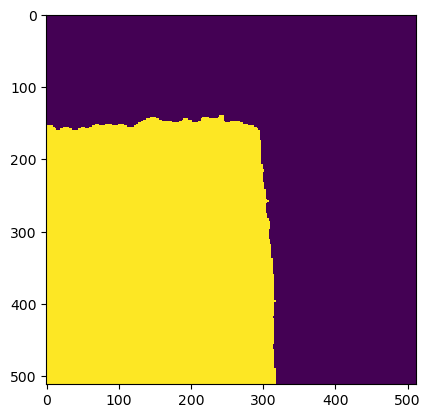

Wrote output/patches/mask/UC_S1_130-493724-8000-6299924-8000.tiff (512 x 512 pixels)


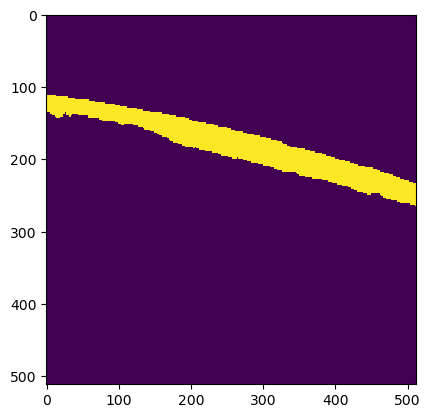

Wrote output/patches/mask/UC_S1_130-493827-2000-6299822-4000.tiff (512 x 512 pixels)


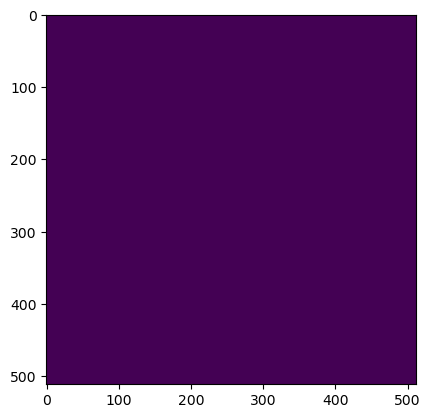

Wrote output/patches/mask/UC_S1_130-493827-2000-6299924-8000.tiff (512 x 512 pixels)
Zone UC_S1_131 Building Mask...


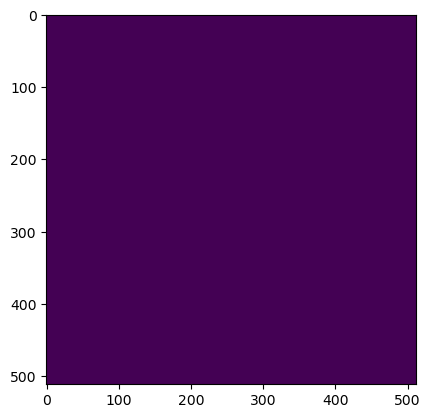

Wrote output/patches/mask/UC_S1_131-483536-0000-6300078-4000.tiff (512 x 512 pixels)


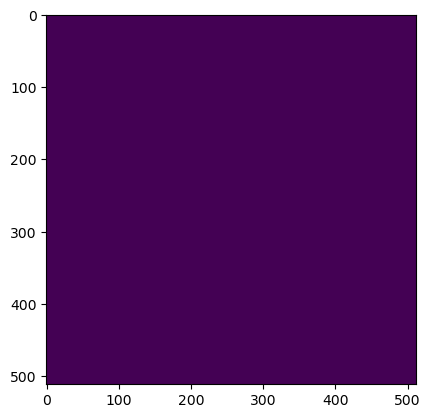

Wrote output/patches/mask/UC_S1_131-483536-0000-6300180-8000.tiff (512 x 512 pixels)


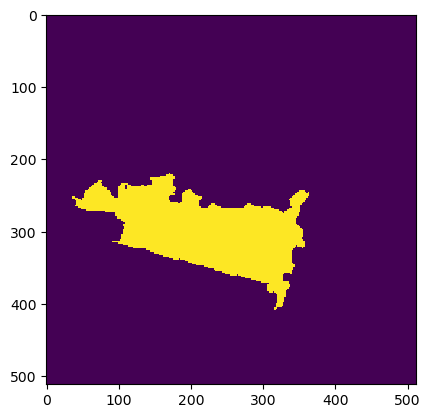

Wrote output/patches/mask/UC_S1_131-483536-0000-6300283-2000.tiff (512 x 512 pixels)


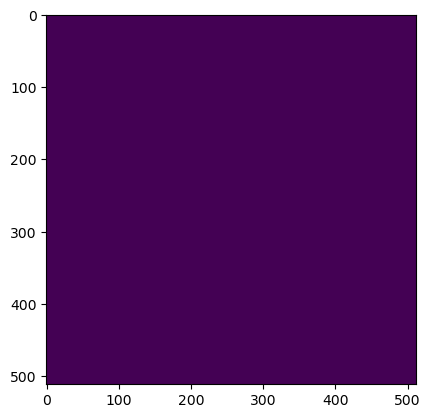

Wrote output/patches/mask/UC_S1_131-483536-0000-6300385-6000.tiff (512 x 512 pixels)


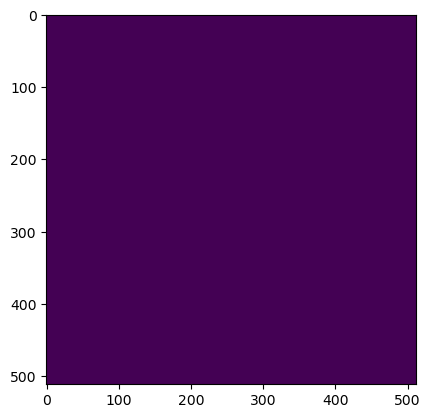

Wrote output/patches/mask/UC_S1_131-483638-4000-6300078-4000.tiff (512 x 512 pixels)


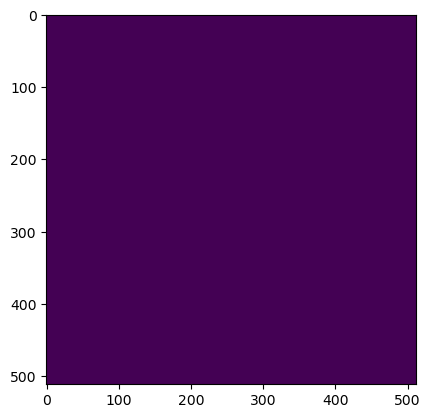

Wrote output/patches/mask/UC_S1_131-483638-4000-6300180-8000.tiff (512 x 512 pixels)


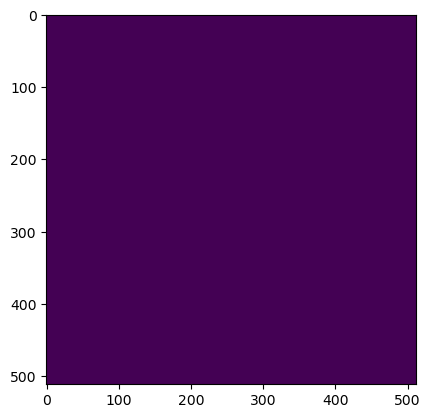

Wrote output/patches/mask/UC_S1_131-483638-4000-6300283-2000.tiff (512 x 512 pixels)


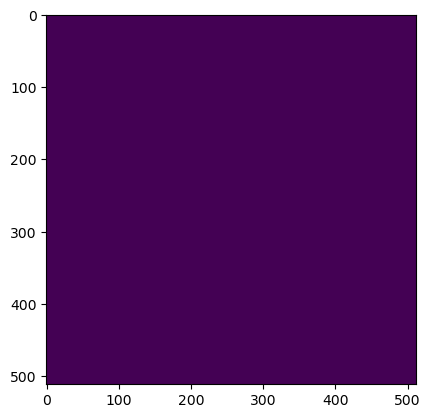

Wrote output/patches/mask/UC_S1_131-483638-4000-6300385-6000.tiff (512 x 512 pixels)
Zone VC_S1_132 Building Mask...


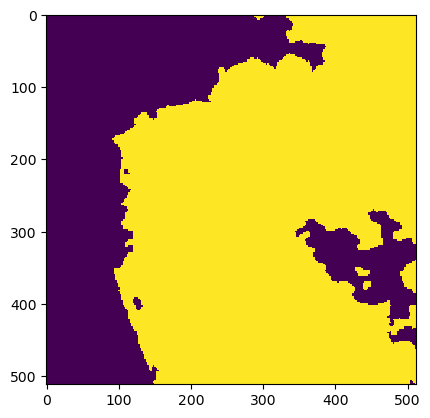

Wrote output/patches/mask/VC_S1_132-456144-0000-6300334-4000.tiff (512 x 512 pixels)


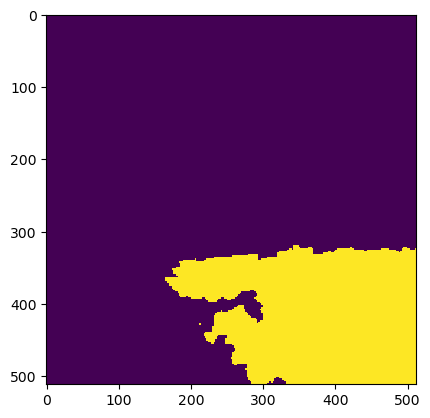

Wrote output/patches/mask/VC_S1_132-456144-0000-6300436-8000.tiff (512 x 512 pixels)


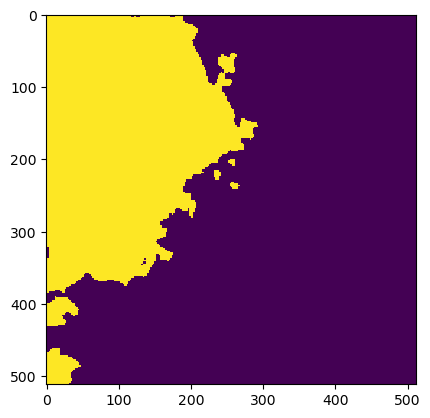

Wrote output/patches/mask/VC_S1_132-456246-4000-6300334-4000.tiff (512 x 512 pixels)


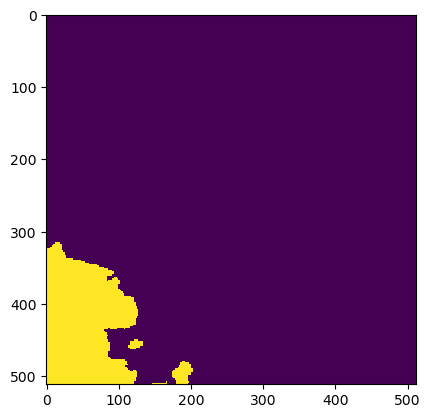

Wrote output/patches/mask/VC_S1_132-456246-4000-6300436-8000.tiff (512 x 512 pixels)
Zone UC_S1_133 Building Mask...


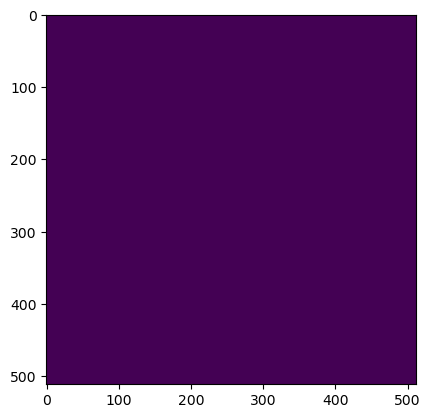

Wrote output/patches/mask/UC_S1_133-470736-0000-6300334-4000.tiff (512 x 512 pixels)


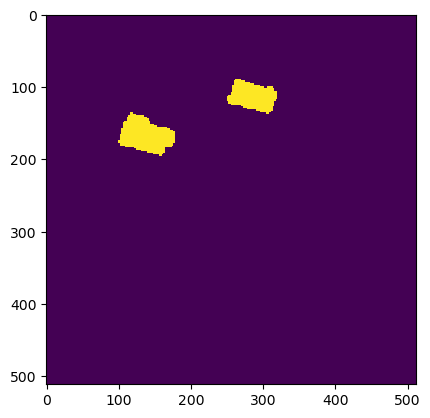

Wrote output/patches/mask/UC_S1_133-470736-0000-6300436-8000.tiff (512 x 512 pixels)


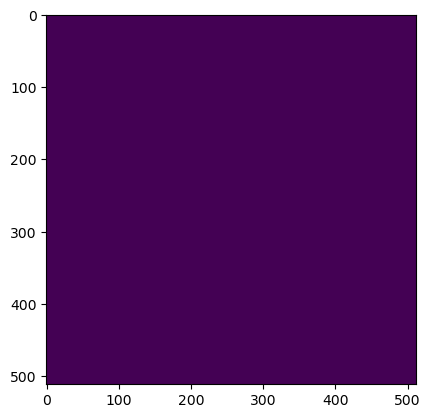

Wrote output/patches/mask/UC_S1_133-470736-0000-6300539-2000.tiff (512 x 512 pixels)


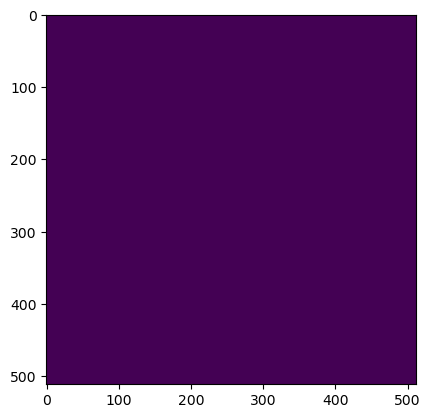

Wrote output/patches/mask/UC_S1_133-470736-0000-6300641-6000.tiff (512 x 512 pixels)


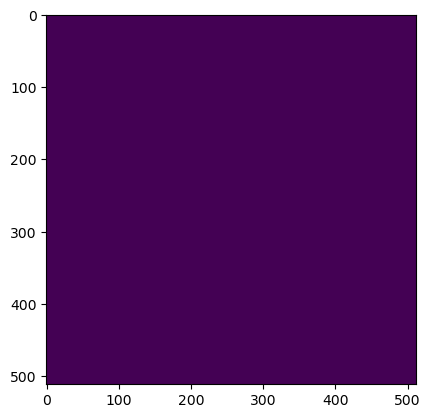

Wrote output/patches/mask/UC_S1_133-470736-0000-6300744-0000.tiff (512 x 512 pixels)


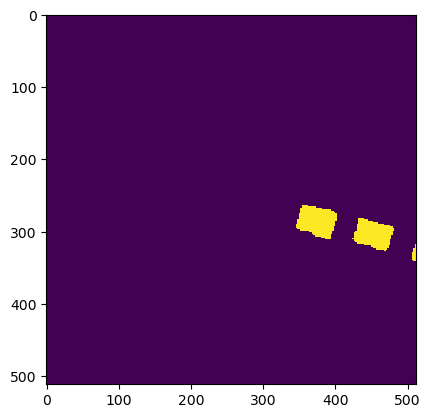

Wrote output/patches/mask/UC_S1_133-470736-0000-6300846-4000.tiff (512 x 512 pixels)


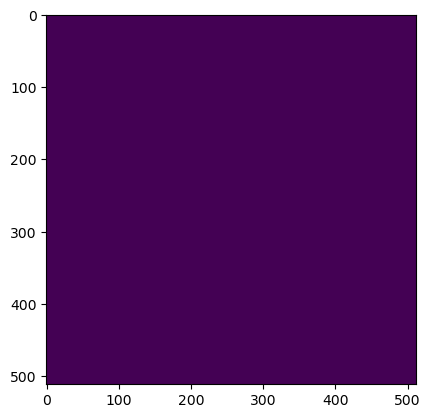

Wrote output/patches/mask/UC_S1_133-470736-0000-6300948-8000.tiff (512 x 512 pixels)


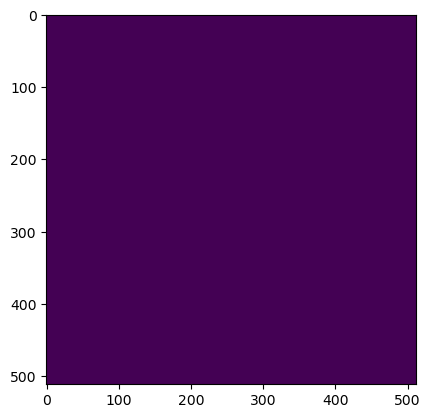

Wrote output/patches/mask/UC_S1_133-470838-4000-6300334-4000.tiff (512 x 512 pixels)


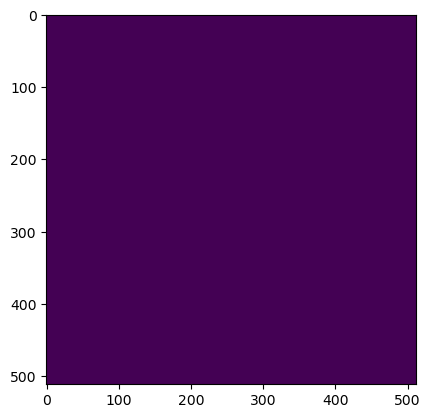

Wrote output/patches/mask/UC_S1_133-470838-4000-6300436-8000.tiff (512 x 512 pixels)


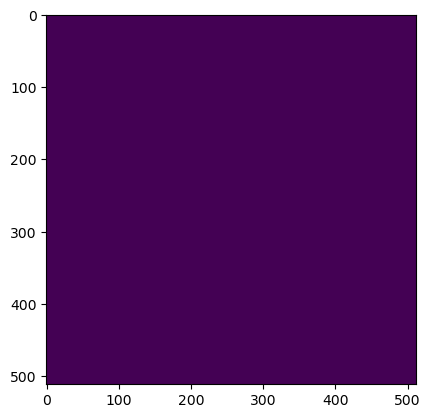

Wrote output/patches/mask/UC_S1_133-470838-4000-6300539-2000.tiff (512 x 512 pixels)


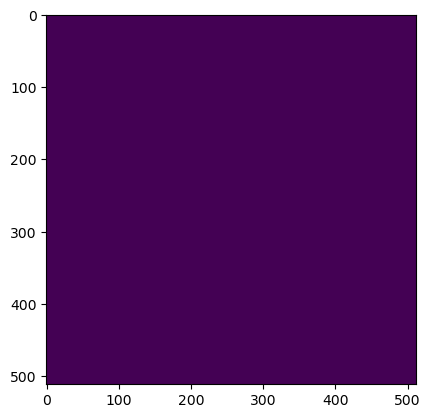

Wrote output/patches/mask/UC_S1_133-470838-4000-6300641-6000.tiff (512 x 512 pixels)


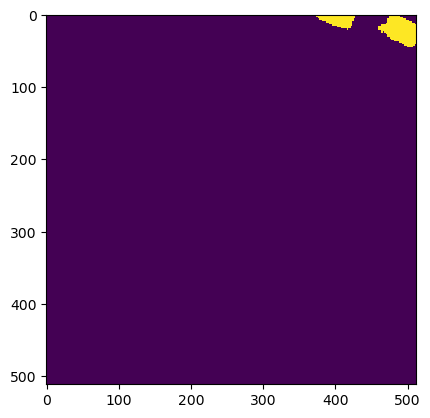

Wrote output/patches/mask/UC_S1_133-470838-4000-6300744-0000.tiff (512 x 512 pixels)


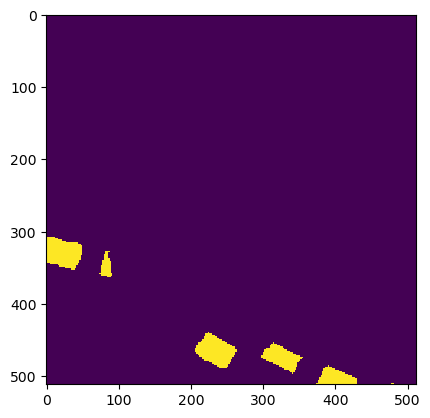

Wrote output/patches/mask/UC_S1_133-470838-4000-6300846-4000.tiff (512 x 512 pixels)


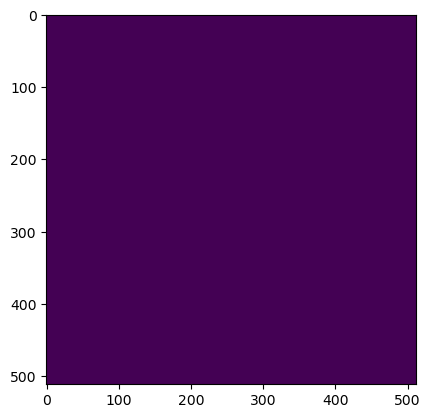

Wrote output/patches/mask/UC_S1_133-470838-4000-6300948-8000.tiff (512 x 512 pixels)
Zone CV_S1_134 Building Mask...


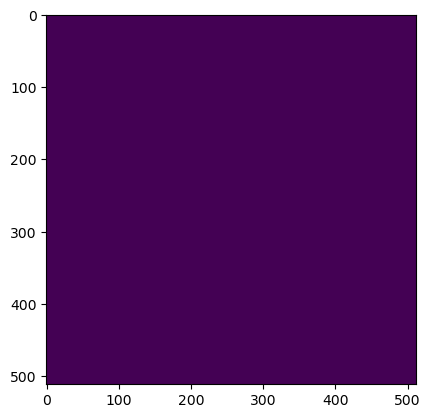

Wrote output/patches/mask/CV_S1_134-443088-0000-6300846-4000.tiff (512 x 512 pixels)


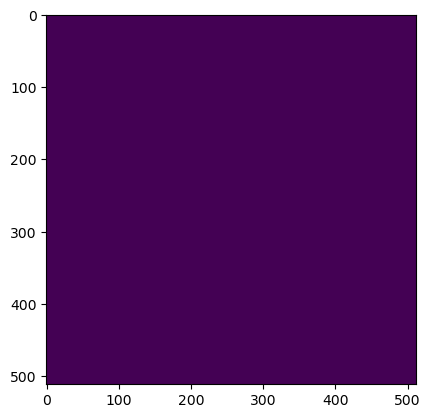

Wrote output/patches/mask/CV_S1_134-443088-0000-6300948-8000.tiff (512 x 512 pixels)


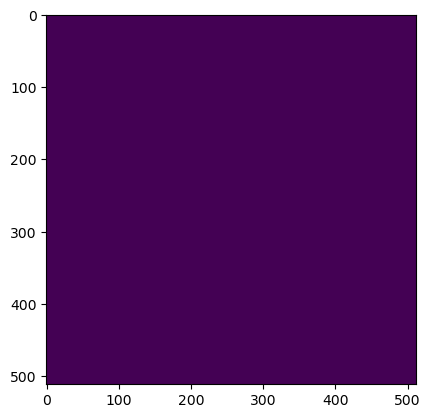

Wrote output/patches/mask/CV_S1_134-443190-4000-6300846-4000.tiff (512 x 512 pixels)


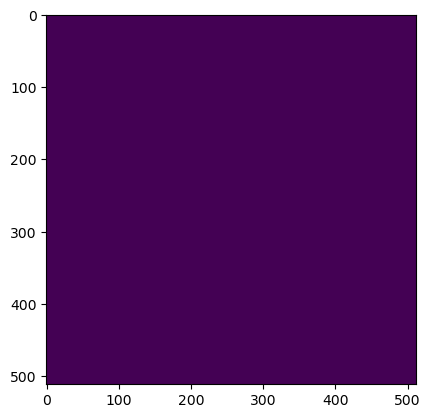

Wrote output/patches/mask/CV_S1_134-443190-4000-6300948-8000.tiff (512 x 512 pixels)
Zone VV_S1_135 Building Mask...


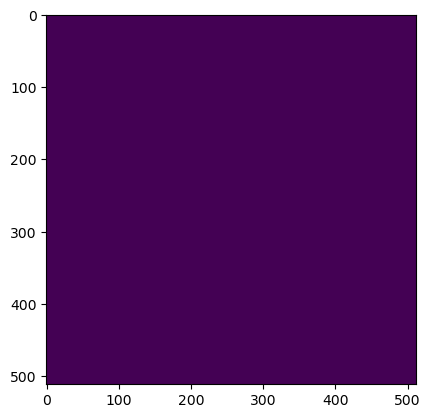

Wrote output/patches/mask/VV_S1_135-465104-0000-6301358-4000.tiff (512 x 512 pixels)


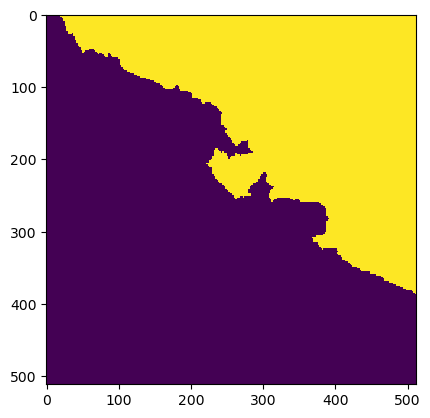

Wrote output/patches/mask/VV_S1_135-465104-0000-6301460-8000.tiff (512 x 512 pixels)


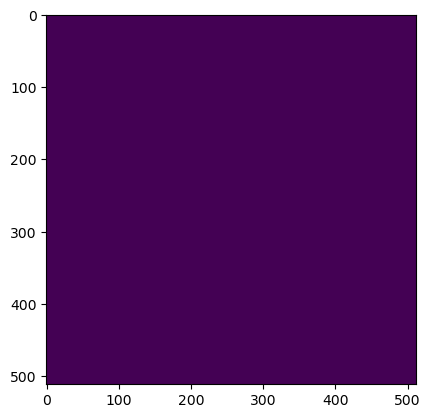

Wrote output/patches/mask/VV_S1_135-465206-4000-6301358-4000.tiff (512 x 512 pixels)


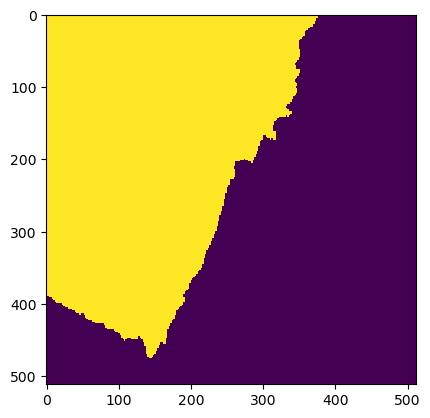

Wrote output/patches/mask/VV_S1_135-465206-4000-6301460-8000.tiff (512 x 512 pixels)
Zone VU_S1_136 Building Mask...


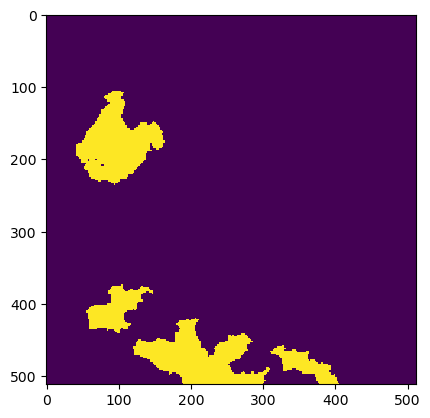

Wrote output/patches/mask/VU_S1_136-448464-0000-6301358-4000.tiff (512 x 512 pixels)


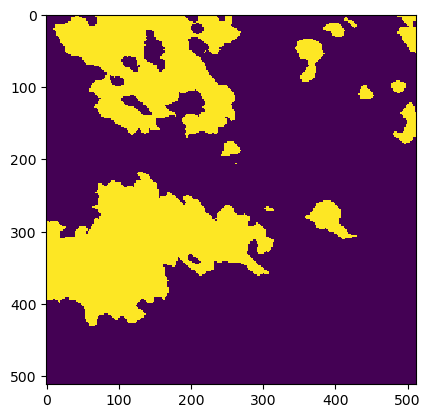

Wrote output/patches/mask/VU_S1_136-448464-0000-6301460-8000.tiff (512 x 512 pixels)


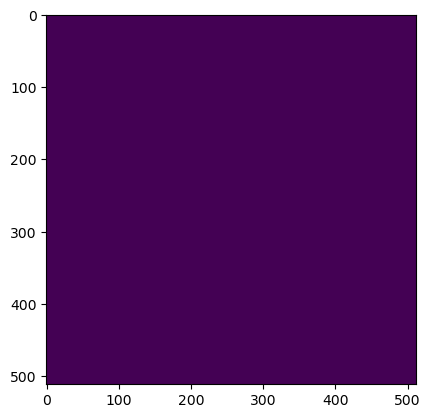

Wrote output/patches/mask/VU_S1_136-448566-4000-6301358-4000.tiff (512 x 512 pixels)


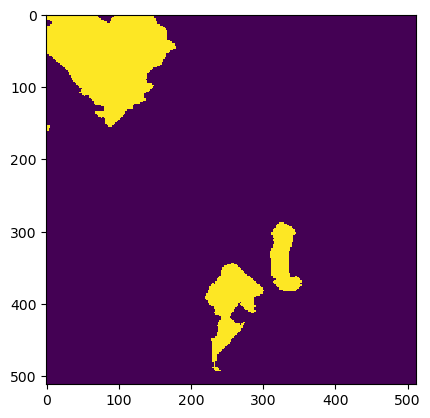

Wrote output/patches/mask/VU_S1_136-448566-4000-6301460-8000.tiff (512 x 512 pixels)
Zone UC_S1_137 Building Mask...


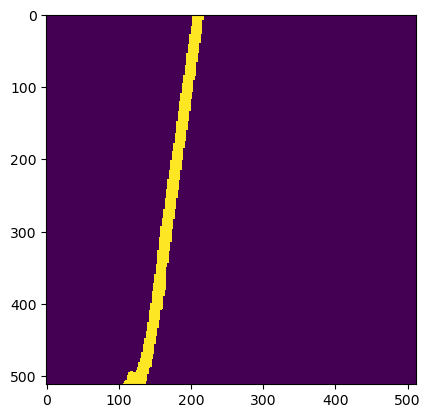

Wrote output/patches/mask/UC_S1_137-523984-0000-6302126-4000.tiff (512 x 512 pixels)


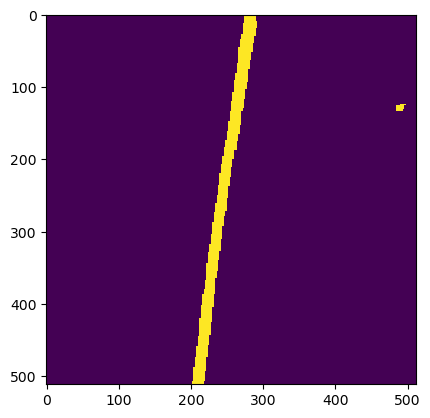

Wrote output/patches/mask/UC_S1_137-523984-0000-6302228-8000.tiff (512 x 512 pixels)


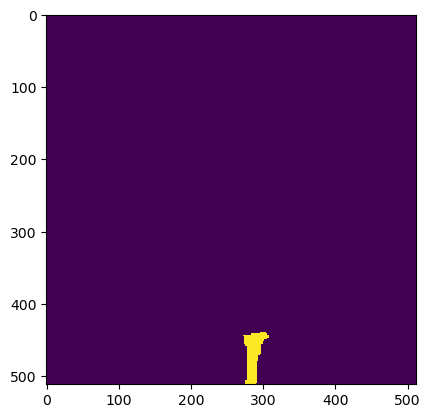

Wrote output/patches/mask/UC_S1_137-523984-0000-6302331-2000.tiff (512 x 512 pixels)


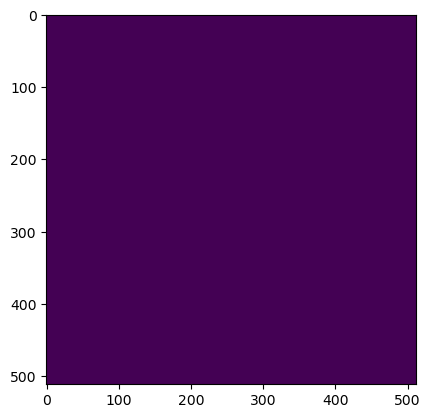

Wrote output/patches/mask/UC_S1_137-523984-0000-6302433-6000.tiff (512 x 512 pixels)


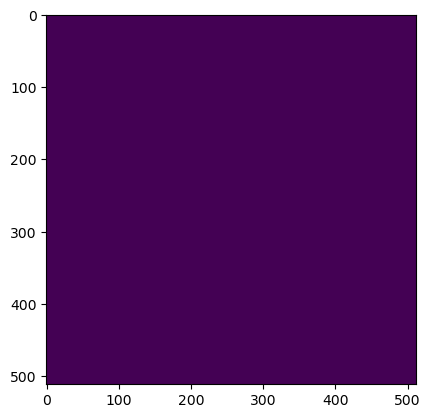

Wrote output/patches/mask/UC_S1_137-524086-4000-6302126-4000.tiff (512 x 512 pixels)


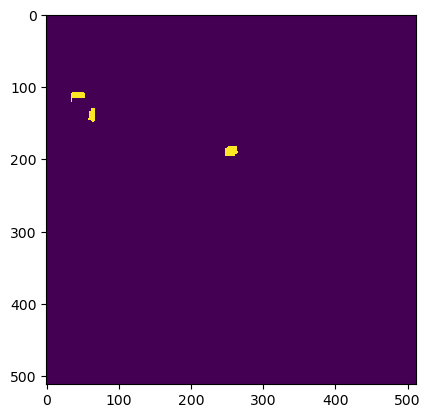

Wrote output/patches/mask/UC_S1_137-524086-4000-6302228-8000.tiff (512 x 512 pixels)


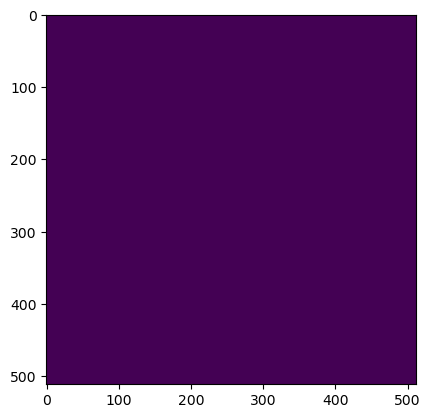

Wrote output/patches/mask/UC_S1_137-524086-4000-6302331-2000.tiff (512 x 512 pixels)


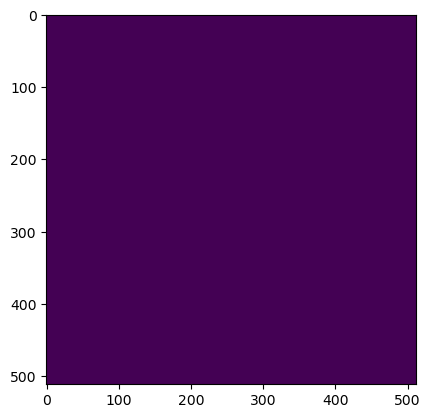

Wrote output/patches/mask/UC_S1_137-524086-4000-6302433-6000.tiff (512 x 512 pixels)


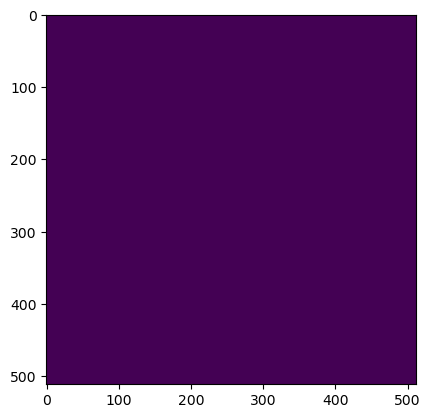

Wrote output/patches/mask/UC_S1_137-524188-8000-6302126-4000.tiff (512 x 512 pixels)


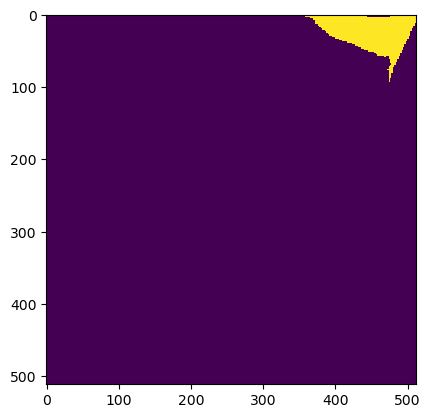

Wrote output/patches/mask/UC_S1_137-524188-8000-6302228-8000.tiff (512 x 512 pixels)


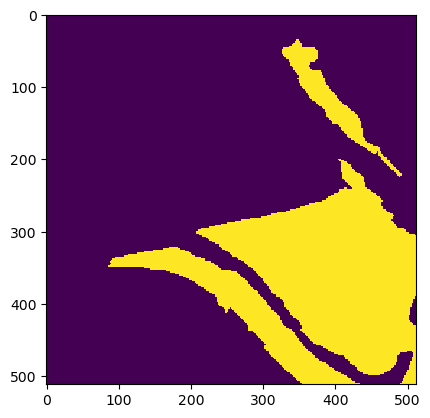

Wrote output/patches/mask/UC_S1_137-524188-8000-6302331-2000.tiff (512 x 512 pixels)


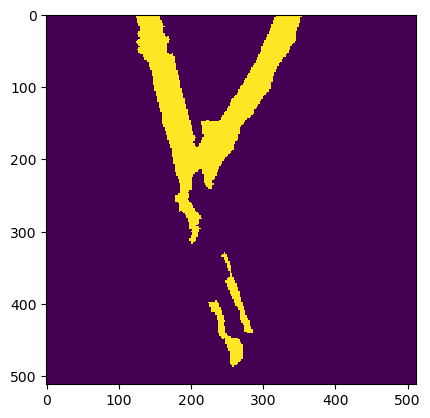

Wrote output/patches/mask/UC_S1_137-524188-8000-6302433-6000.tiff (512 x 512 pixels)


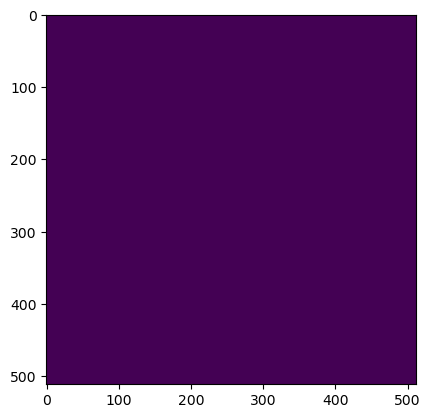

Wrote output/patches/mask/UC_S1_137-524291-2000-6302126-4000.tiff (512 x 512 pixels)


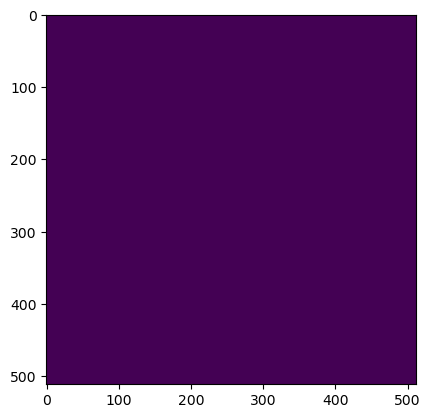

Wrote output/patches/mask/UC_S1_137-524291-2000-6302228-8000.tiff (512 x 512 pixels)


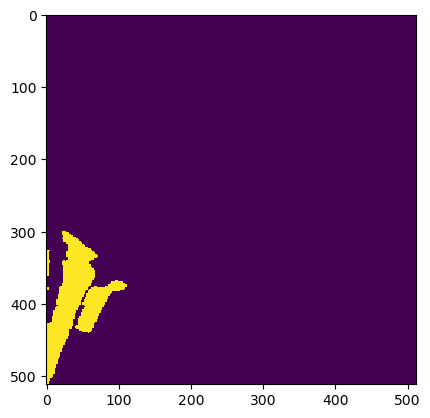

Wrote output/patches/mask/UC_S1_137-524291-2000-6302331-2000.tiff (512 x 512 pixels)


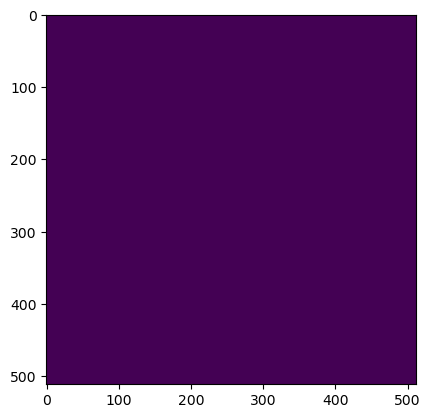

Wrote output/patches/mask/UC_S1_137-524291-2000-6302433-6000.tiff (512 x 512 pixels)
Zone UU_S1_138 Building Mask...


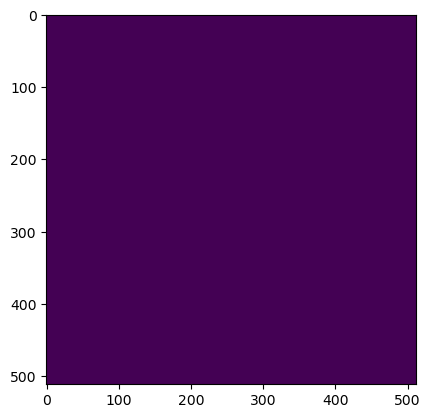

Wrote output/patches/mask/UU_S1_138-485840-0000-6302894-4000.tiff (512 x 512 pixels)


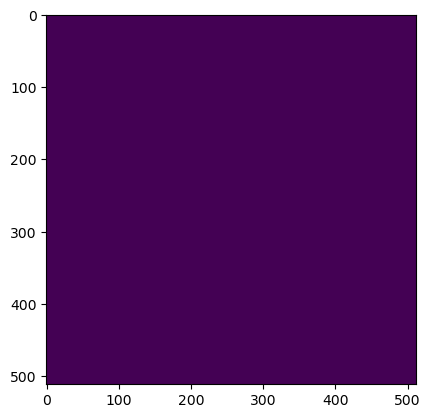

Wrote output/patches/mask/UU_S1_138-485840-0000-6302996-8000.tiff (512 x 512 pixels)


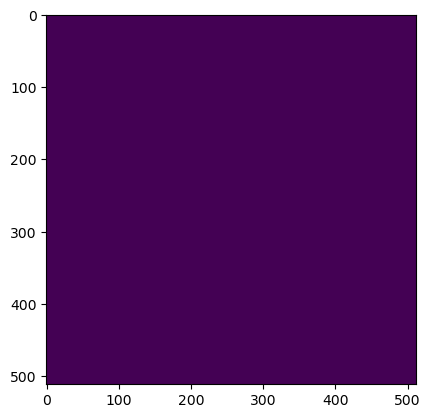

Wrote output/patches/mask/UU_S1_138-485942-4000-6302894-4000.tiff (512 x 512 pixels)


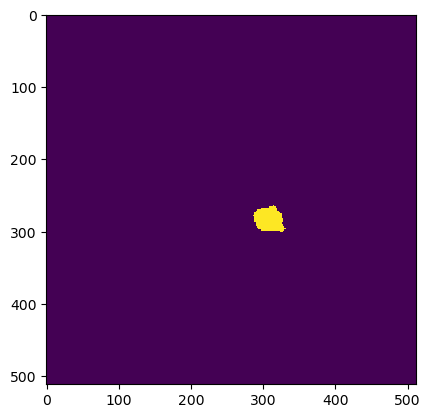

Wrote output/patches/mask/UU_S1_138-485942-4000-6302996-8000.tiff (512 x 512 pixels)


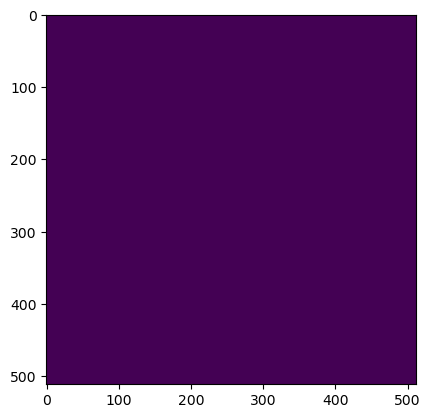

Wrote output/patches/mask/UU_S1_138-486044-8000-6302894-4000.tiff (512 x 512 pixels)


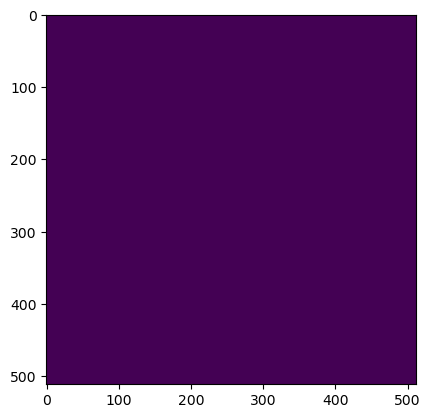

Wrote output/patches/mask/UU_S1_138-486044-8000-6302996-8000.tiff (512 x 512 pixels)


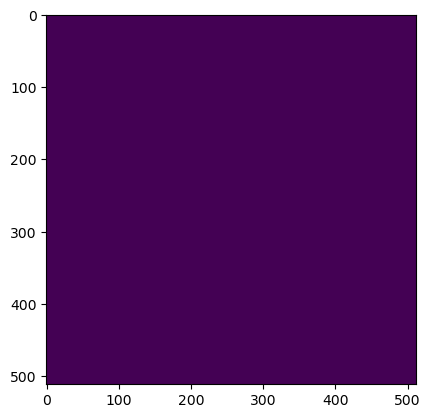

Wrote output/patches/mask/UU_S1_138-486147-2000-6302894-4000.tiff (512 x 512 pixels)


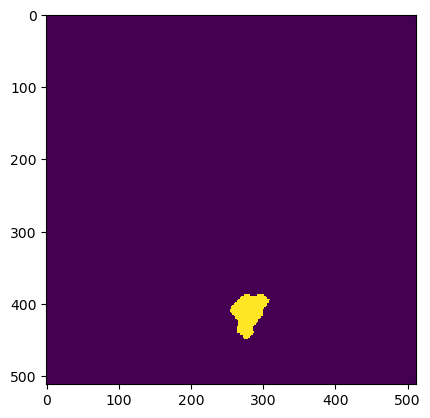

Wrote output/patches/mask/UU_S1_138-486147-2000-6302996-8000.tiff (512 x 512 pixels)
Zone VU_S1_139 Building Mask...


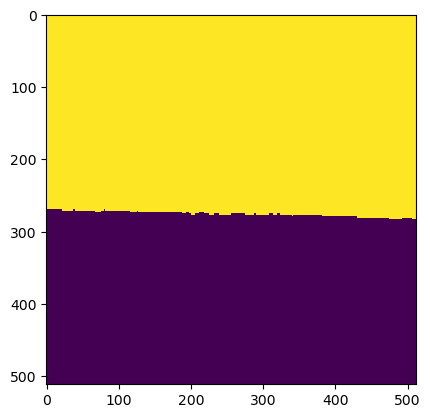

Wrote output/patches/mask/VU_S1_139-462544-0000-6303406-4000.tiff (512 x 512 pixels)


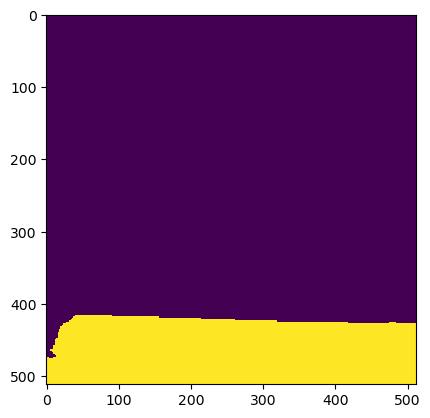

Wrote output/patches/mask/VU_S1_139-462544-0000-6303508-8000.tiff (512 x 512 pixels)


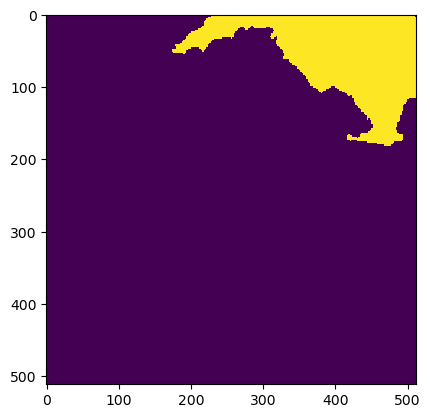

Wrote output/patches/mask/VU_S1_139-462544-0000-6303611-2000.tiff (512 x 512 pixels)


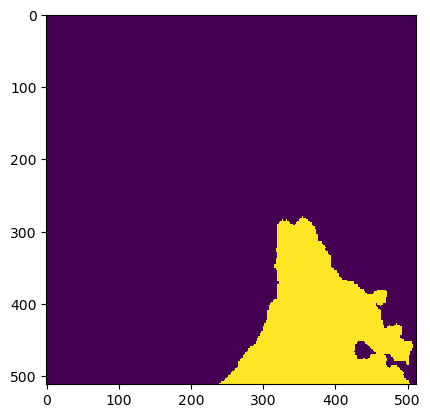

Wrote output/patches/mask/VU_S1_139-462544-0000-6303713-6000.tiff (512 x 512 pixels)


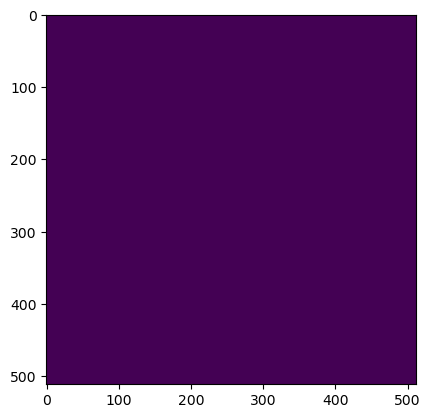

Wrote output/patches/mask/VU_S1_139-462544-0000-6303816-0000.tiff (512 x 512 pixels)


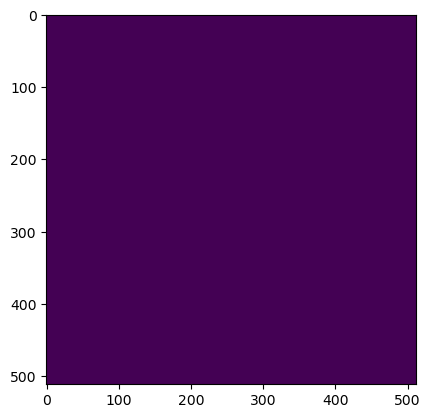

Wrote output/patches/mask/VU_S1_139-462544-0000-6303918-4000.tiff (512 x 512 pixels)


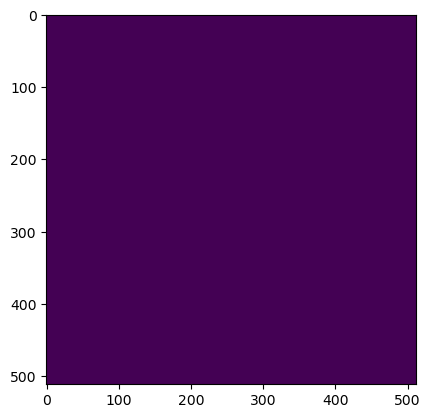

Wrote output/patches/mask/VU_S1_139-462544-0000-6304020-8000.tiff (512 x 512 pixels)


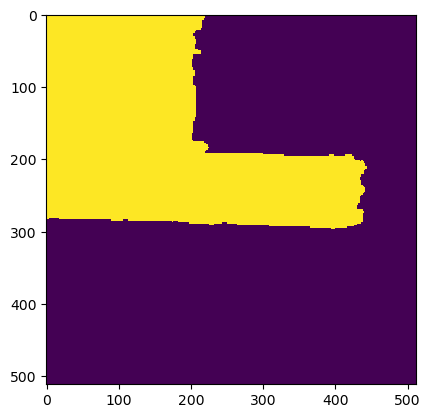

Wrote output/patches/mask/VU_S1_139-462646-4000-6303406-4000.tiff (512 x 512 pixels)


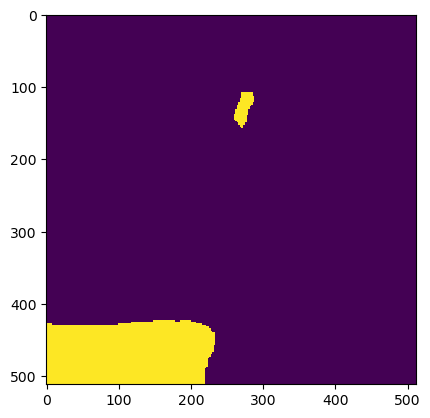

Wrote output/patches/mask/VU_S1_139-462646-4000-6303508-8000.tiff (512 x 512 pixels)


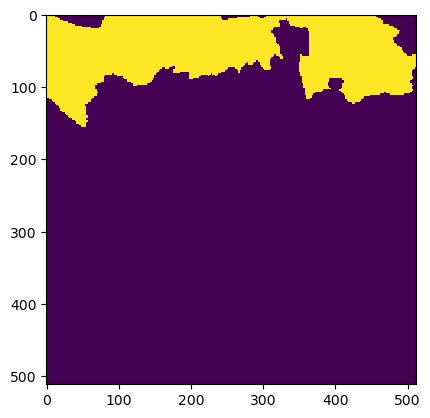

Wrote output/patches/mask/VU_S1_139-462646-4000-6303611-2000.tiff (512 x 512 pixels)


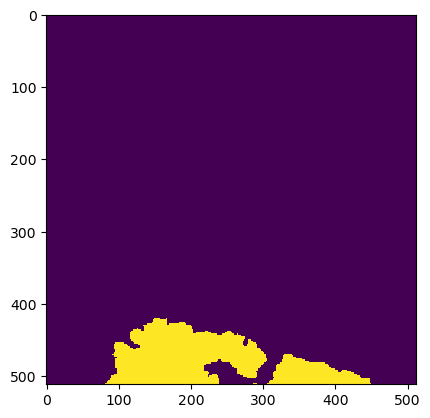

Wrote output/patches/mask/VU_S1_139-462646-4000-6303713-6000.tiff (512 x 512 pixels)


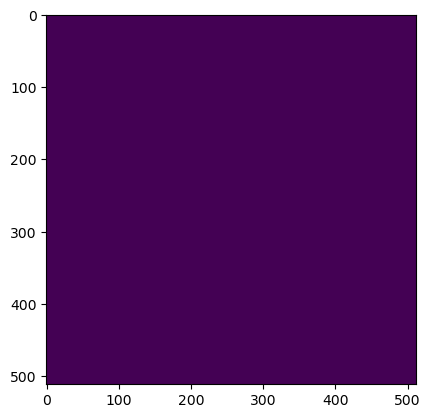

Wrote output/patches/mask/VU_S1_139-462646-4000-6303816-0000.tiff (512 x 512 pixels)


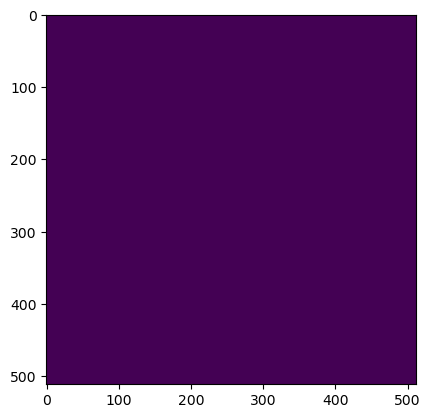

Wrote output/patches/mask/VU_S1_139-462646-4000-6303918-4000.tiff (512 x 512 pixels)


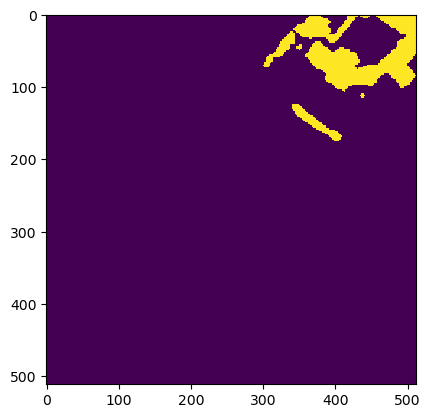

Wrote output/patches/mask/VU_S1_139-462646-4000-6304020-8000.tiff (512 x 512 pixels)


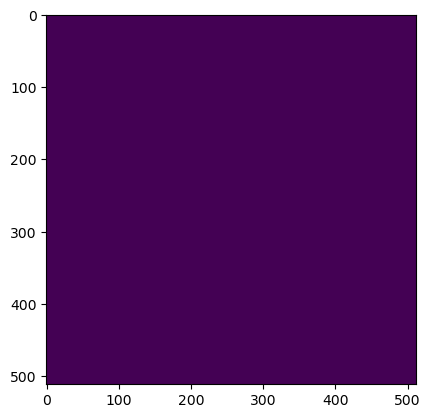

Wrote output/patches/mask/VU_S1_139-462748-8000-6303406-4000.tiff (512 x 512 pixels)


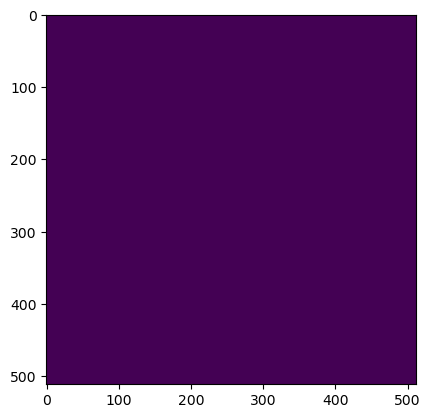

Wrote output/patches/mask/VU_S1_139-462748-8000-6303508-8000.tiff (512 x 512 pixels)


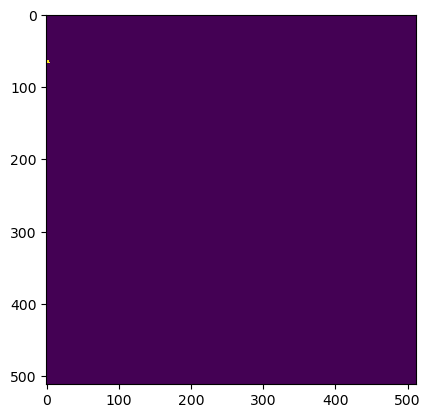

Wrote output/patches/mask/VU_S1_139-462748-8000-6303611-2000.tiff (512 x 512 pixels)


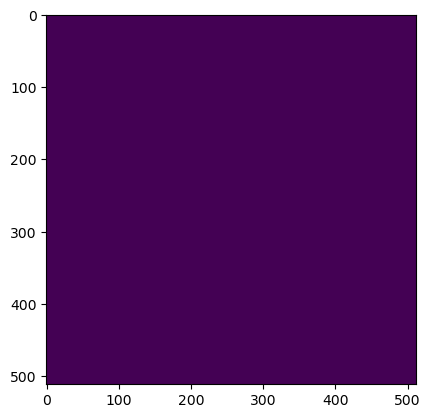

Wrote output/patches/mask/VU_S1_139-462748-8000-6303713-6000.tiff (512 x 512 pixels)


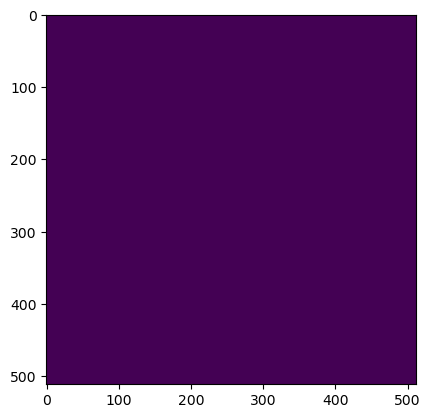

Wrote output/patches/mask/VU_S1_139-462748-8000-6303816-0000.tiff (512 x 512 pixels)


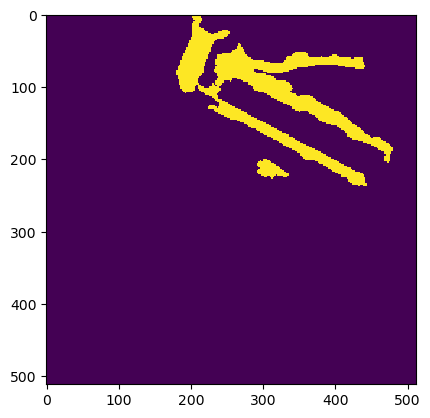

Wrote output/patches/mask/VU_S1_139-462748-8000-6303918-4000.tiff (512 x 512 pixels)


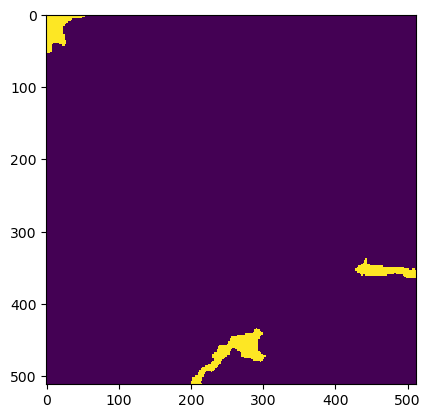

Wrote output/patches/mask/VU_S1_139-462748-8000-6304020-8000.tiff (512 x 512 pixels)


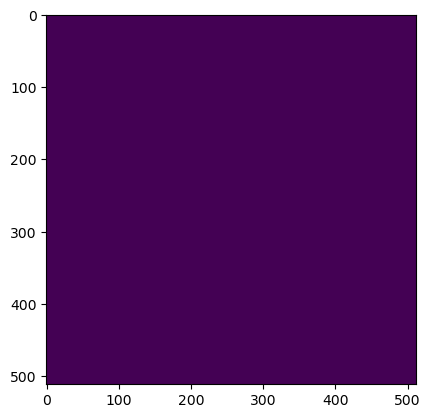

Wrote output/patches/mask/VU_S1_139-462851-2000-6303406-4000.tiff (512 x 512 pixels)


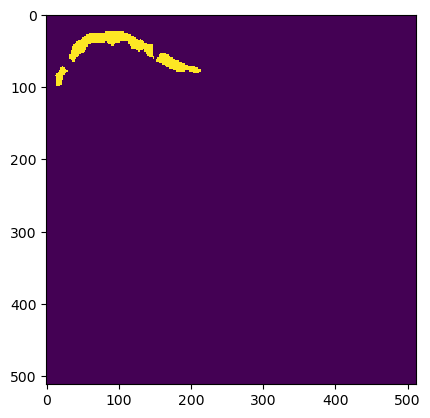

Wrote output/patches/mask/VU_S1_139-462851-2000-6303508-8000.tiff (512 x 512 pixels)


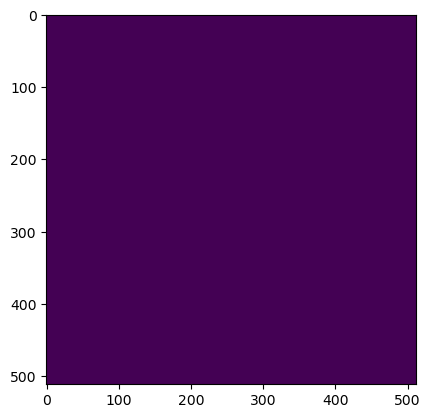

Wrote output/patches/mask/VU_S1_139-462851-2000-6303611-2000.tiff (512 x 512 pixels)


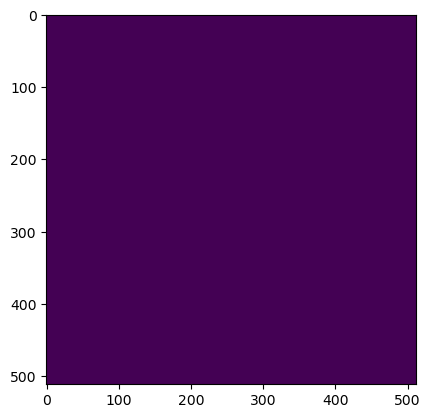

Wrote output/patches/mask/VU_S1_139-462851-2000-6303713-6000.tiff (512 x 512 pixels)


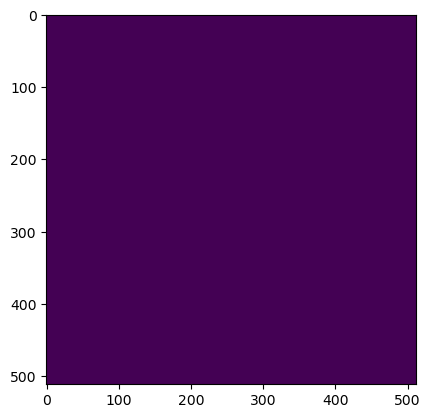

Wrote output/patches/mask/VU_S1_139-462851-2000-6303816-0000.tiff (512 x 512 pixels)


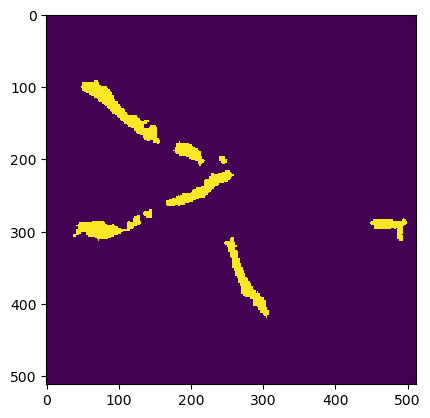

Wrote output/patches/mask/VU_S1_139-462851-2000-6303918-4000.tiff (512 x 512 pixels)


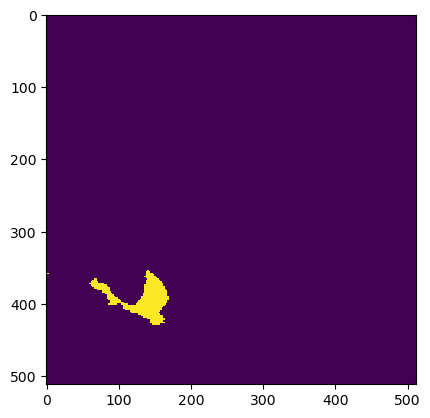

Wrote output/patches/mask/VU_S1_139-462851-2000-6304020-8000.tiff (512 x 512 pixels)
Zone UU_S1_140 Building Mask...


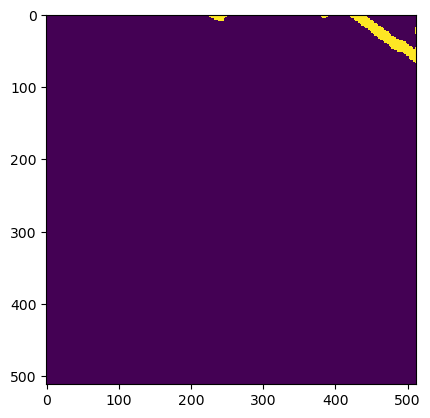

Wrote output/patches/mask/UU_S1_140-463824-0000-6302382-4000.tiff (512 x 512 pixels)


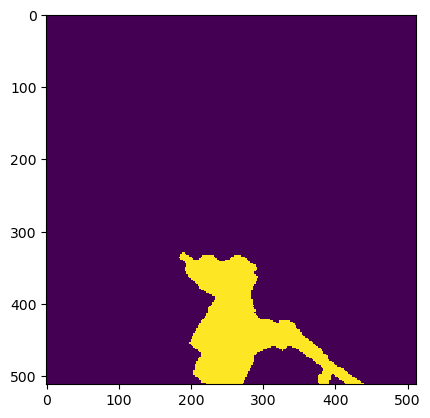

Wrote output/patches/mask/UU_S1_140-463824-0000-6302484-8000.tiff (512 x 512 pixels)


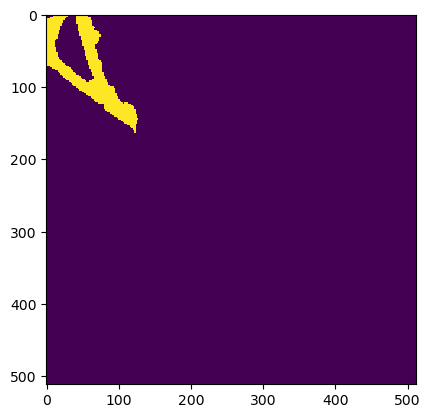

Wrote output/patches/mask/UU_S1_140-463926-4000-6302382-4000.tiff (512 x 512 pixels)


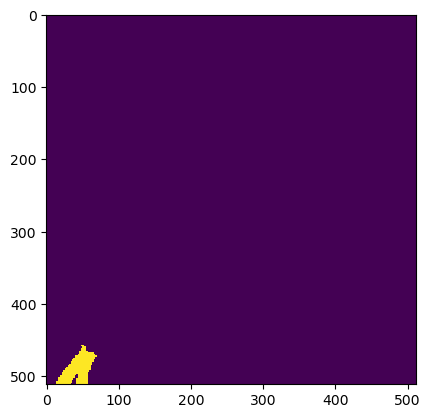

Wrote output/patches/mask/UU_S1_140-463926-4000-6302484-8000.tiff (512 x 512 pixels)


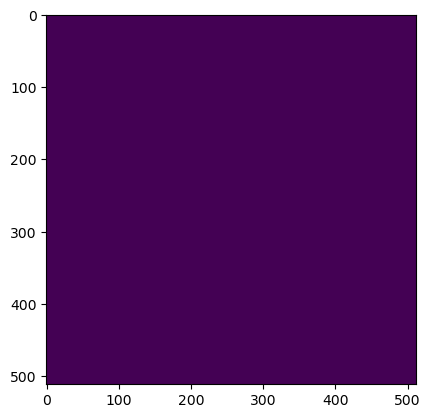

Wrote output/patches/mask/UU_S1_140-464028-8000-6302382-4000.tiff (512 x 512 pixels)


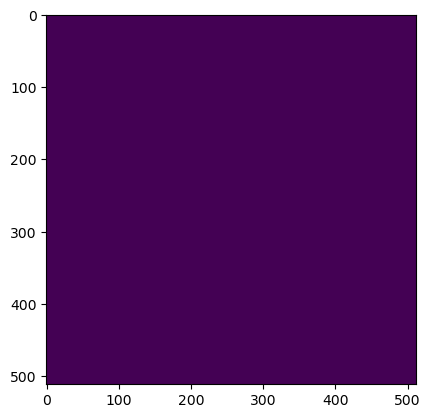

Wrote output/patches/mask/UU_S1_140-464028-8000-6302484-8000.tiff (512 x 512 pixels)


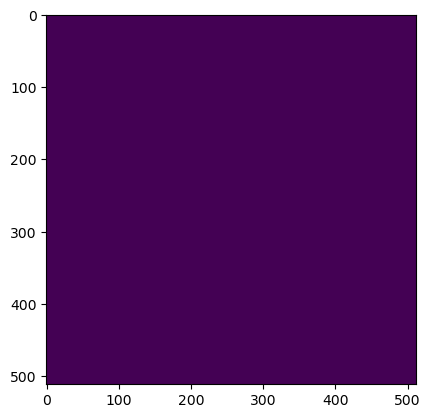

Wrote output/patches/mask/UU_S1_140-464131-2000-6302382-4000.tiff (512 x 512 pixels)


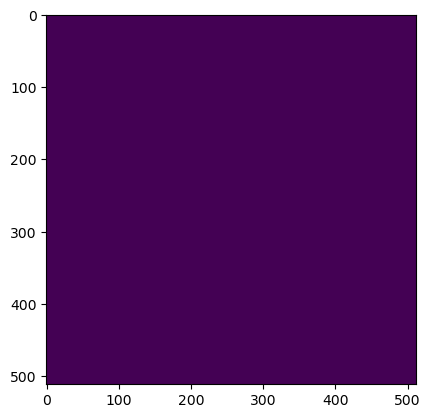

Wrote output/patches/mask/UU_S1_140-464131-2000-6302484-8000.tiff (512 x 512 pixels)


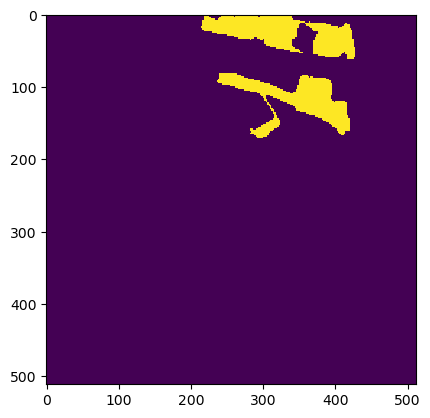

Wrote output/patches/mask/UU_S1_140-464233-6000-6302382-4000.tiff (512 x 512 pixels)


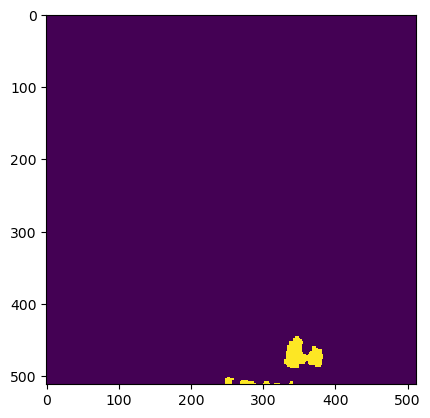

Wrote output/patches/mask/UU_S1_140-464233-6000-6302484-8000.tiff (512 x 512 pixels)


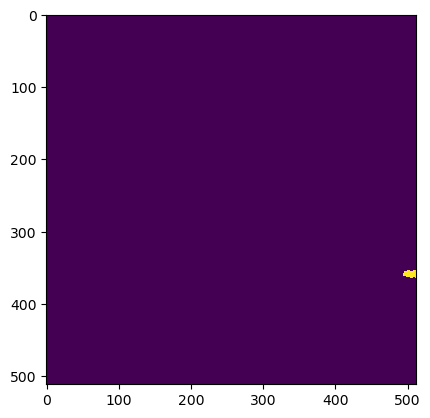

Wrote output/patches/mask/UU_S1_140-464336-0000-6302382-4000.tiff (512 x 512 pixels)


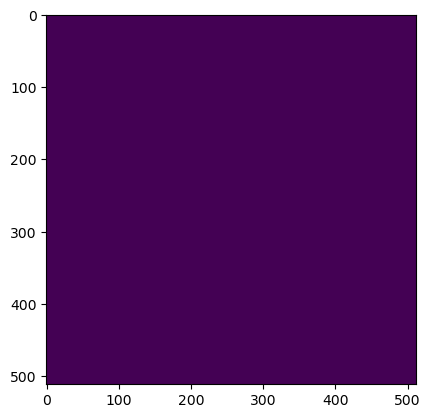

Wrote output/patches/mask/UU_S1_140-464336-0000-6302484-8000.tiff (512 x 512 pixels)


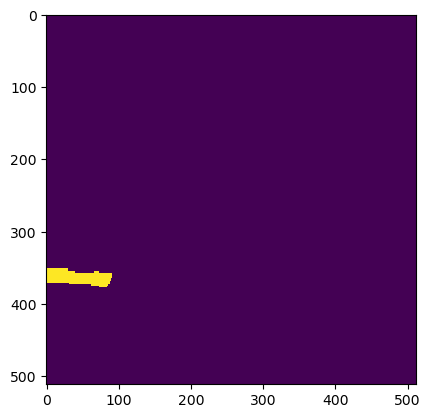

Wrote output/patches/mask/UU_S1_140-464438-4000-6302382-4000.tiff (512 x 512 pixels)


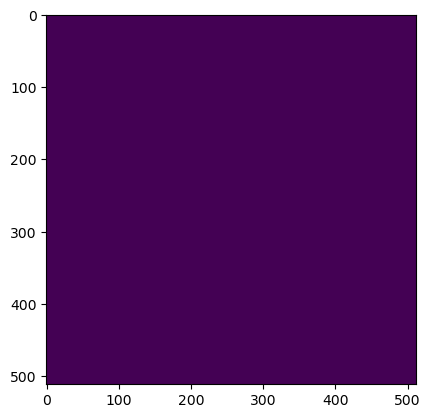

Wrote output/patches/mask/UU_S1_140-464438-4000-6302484-8000.tiff (512 x 512 pixels)
Zone UC_S1_141 Building Mask...


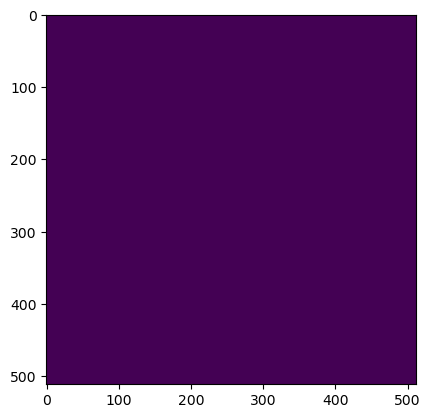

Wrote output/patches/mask/UC_S1_141-456656-0000-6302382-4000.tiff (512 x 512 pixels)


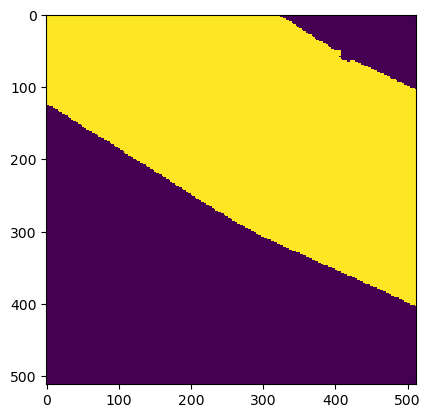

Wrote output/patches/mask/UC_S1_141-456656-0000-6302484-8000.tiff (512 x 512 pixels)


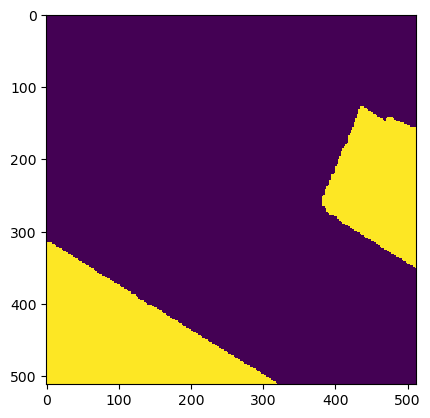

Wrote output/patches/mask/UC_S1_141-456656-0000-6302587-2000.tiff (512 x 512 pixels)


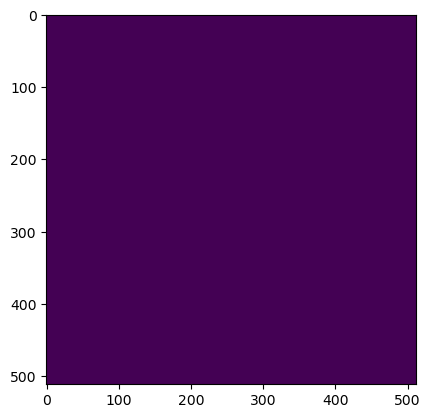

Wrote output/patches/mask/UC_S1_141-456656-0000-6302689-6000.tiff (512 x 512 pixels)


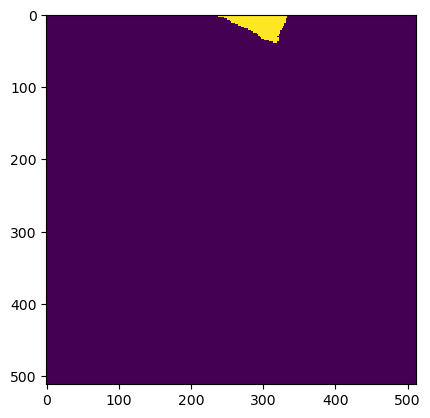

Wrote output/patches/mask/UC_S1_141-456758-4000-6302382-4000.tiff (512 x 512 pixels)


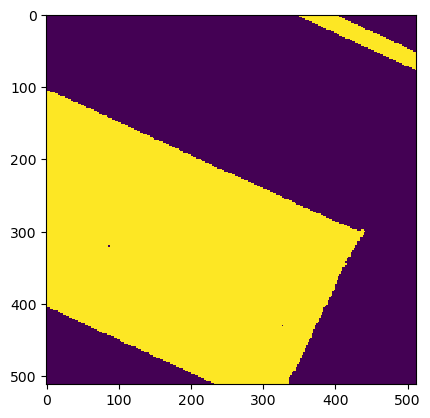

Wrote output/patches/mask/UC_S1_141-456758-4000-6302484-8000.tiff (512 x 512 pixels)


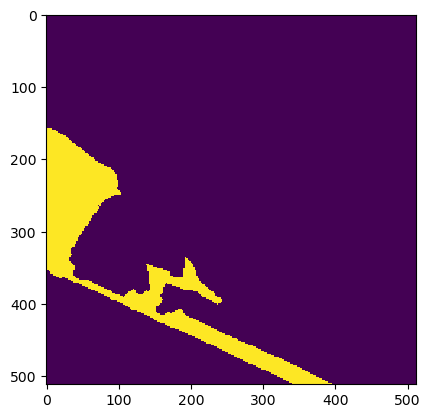

Wrote output/patches/mask/UC_S1_141-456758-4000-6302587-2000.tiff (512 x 512 pixels)


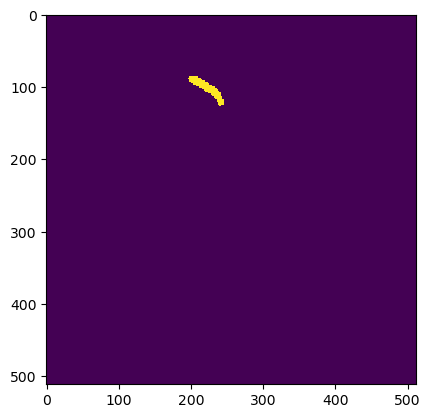

Wrote output/patches/mask/UC_S1_141-456758-4000-6302689-6000.tiff (512 x 512 pixels)
Zone UU_S1_142 Building Mask...


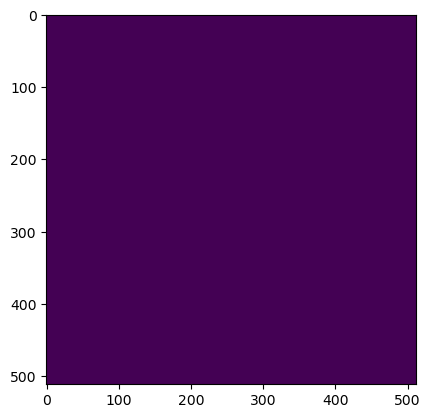

Wrote output/patches/mask/UU_S1_142-513488-0000-6302382-4000.tiff (512 x 512 pixels)


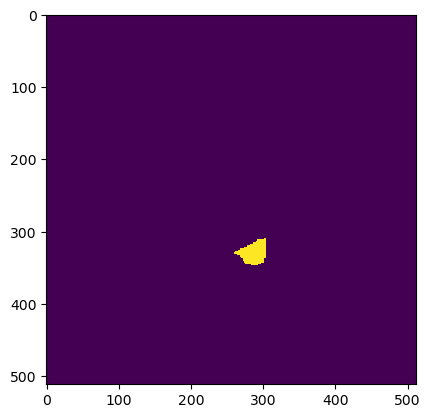

Wrote output/patches/mask/UU_S1_142-513488-0000-6302484-8000.tiff (512 x 512 pixels)


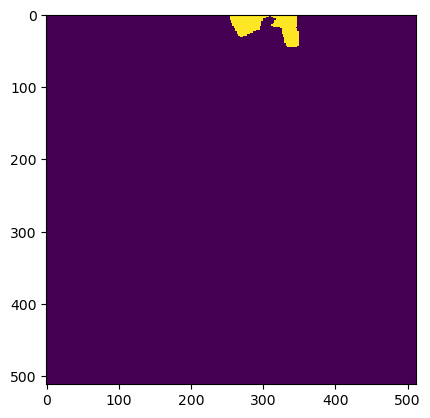

Wrote output/patches/mask/UU_S1_142-513590-4000-6302382-4000.tiff (512 x 512 pixels)


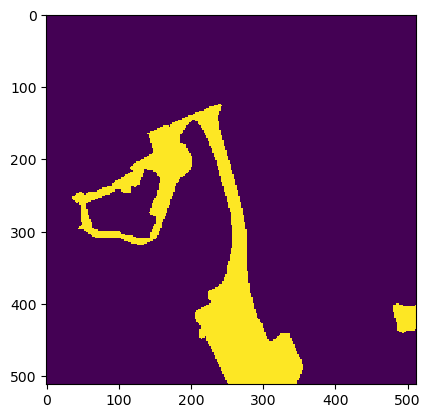

Wrote output/patches/mask/UU_S1_142-513590-4000-6302484-8000.tiff (512 x 512 pixels)
Zone UU_S1_143 Building Mask...


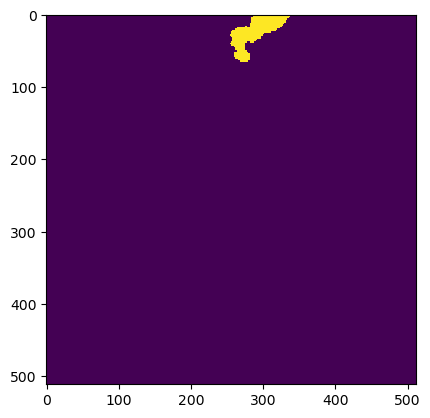

Wrote output/patches/mask/UU_S1_143-454096-0000-6302638-4000.tiff (512 x 512 pixels)


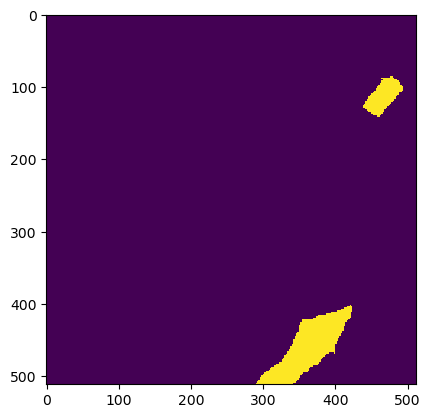

Wrote output/patches/mask/UU_S1_143-454096-0000-6302740-8000.tiff (512 x 512 pixels)


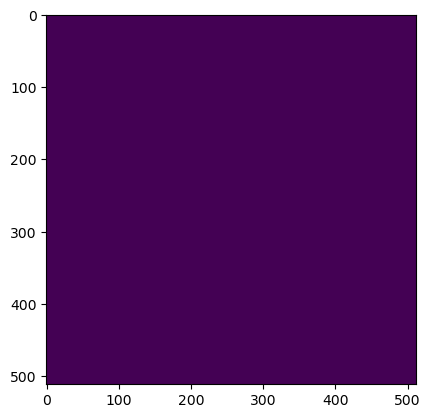

Wrote output/patches/mask/UU_S1_143-454096-0000-6302843-2000.tiff (512 x 512 pixels)


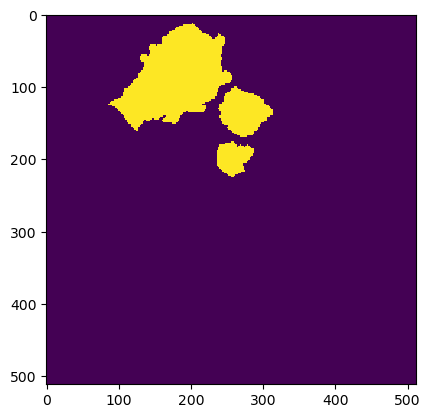

Wrote output/patches/mask/UU_S1_143-454096-0000-6302945-6000.tiff (512 x 512 pixels)


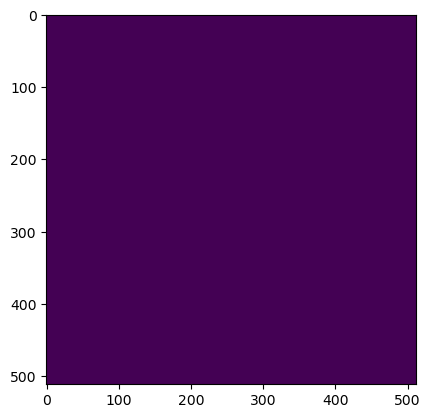

Wrote output/patches/mask/UU_S1_143-454198-4000-6302638-4000.tiff (512 x 512 pixels)


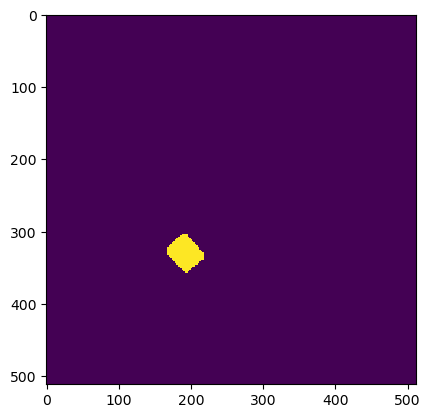

Wrote output/patches/mask/UU_S1_143-454198-4000-6302740-8000.tiff (512 x 512 pixels)


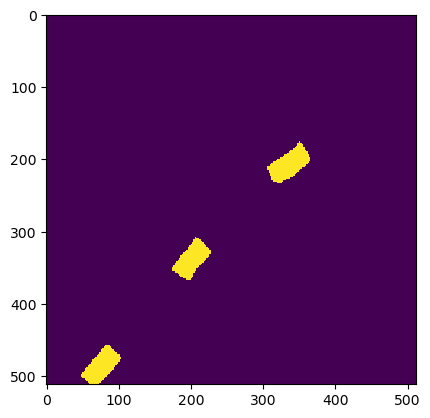

Wrote output/patches/mask/UU_S1_143-454198-4000-6302843-2000.tiff (512 x 512 pixels)


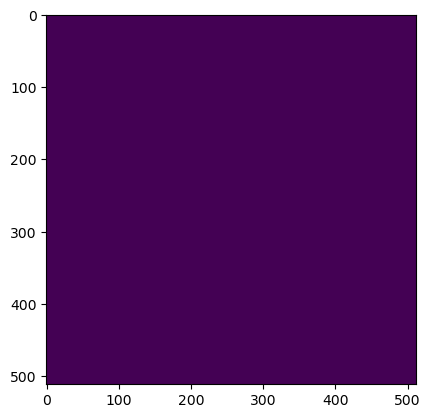

Wrote output/patches/mask/UU_S1_143-454198-4000-6302945-6000.tiff (512 x 512 pixels)


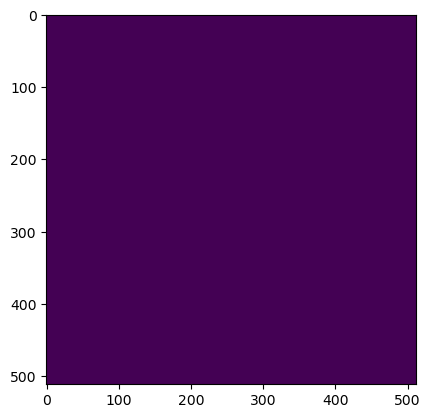

Wrote output/patches/mask/UU_S1_143-454300-8000-6302638-4000.tiff (512 x 512 pixels)


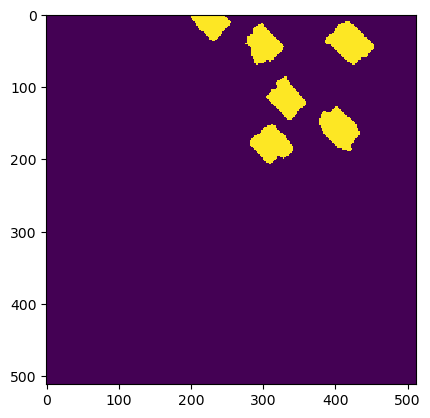

Wrote output/patches/mask/UU_S1_143-454300-8000-6302740-8000.tiff (512 x 512 pixels)


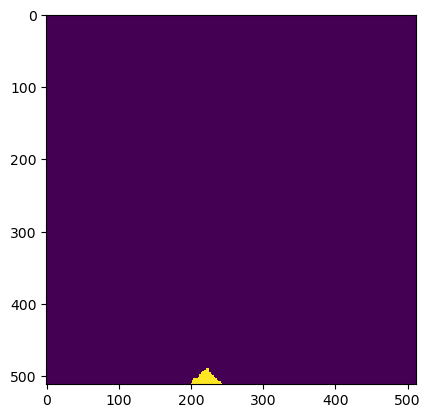

Wrote output/patches/mask/UU_S1_143-454300-8000-6302843-2000.tiff (512 x 512 pixels)


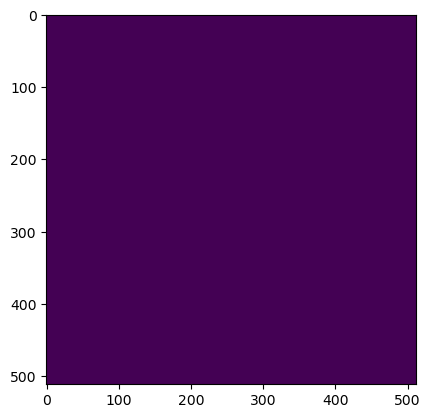

Wrote output/patches/mask/UU_S1_143-454300-8000-6302945-6000.tiff (512 x 512 pixels)


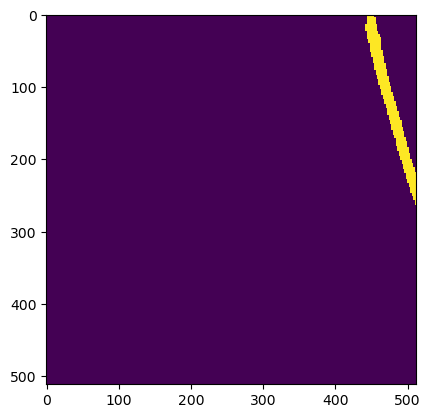

Wrote output/patches/mask/UU_S1_143-454403-2000-6302638-4000.tiff (512 x 512 pixels)


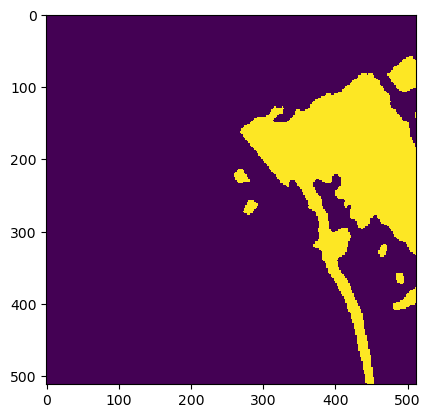

Wrote output/patches/mask/UU_S1_143-454403-2000-6302740-8000.tiff (512 x 512 pixels)


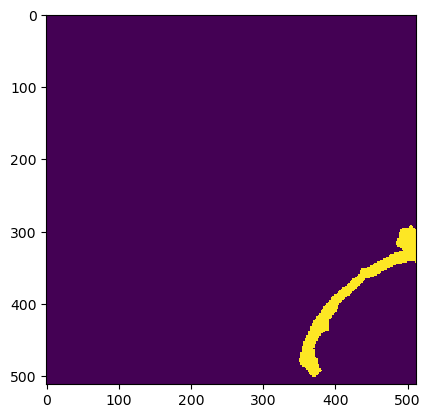

Wrote output/patches/mask/UU_S1_143-454403-2000-6302843-2000.tiff (512 x 512 pixels)


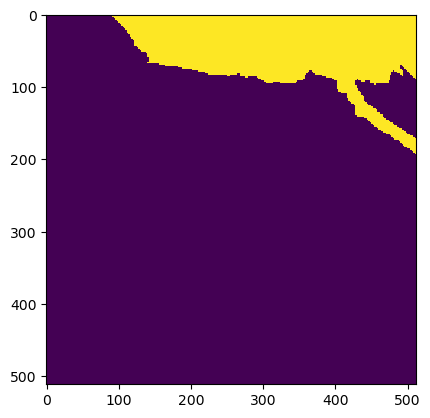

Wrote output/patches/mask/UU_S1_143-454403-2000-6302945-6000.tiff (512 x 512 pixels)


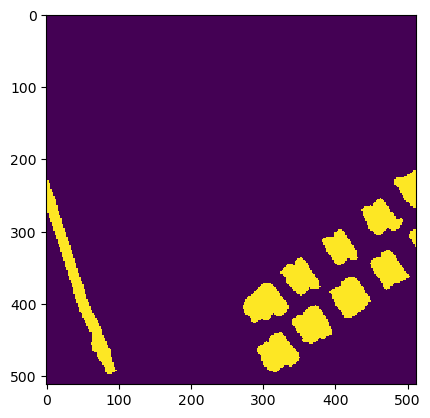

Wrote output/patches/mask/UU_S1_143-454505-6000-6302638-4000.tiff (512 x 512 pixels)


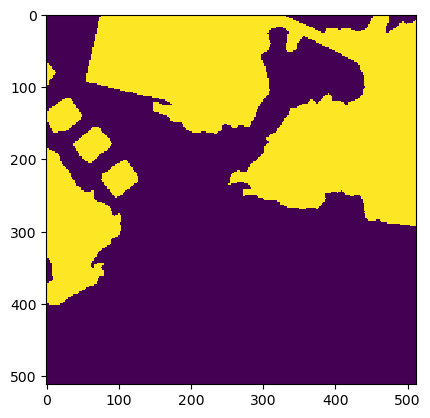

Wrote output/patches/mask/UU_S1_143-454505-6000-6302740-8000.tiff (512 x 512 pixels)


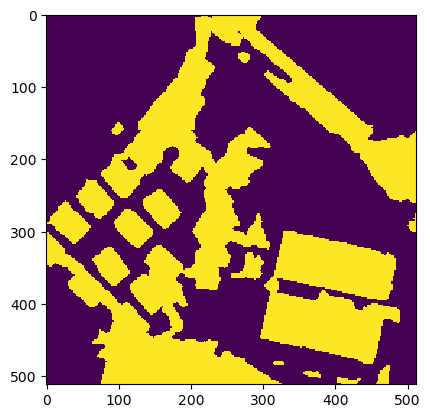

Wrote output/patches/mask/UU_S1_143-454505-6000-6302843-2000.tiff (512 x 512 pixels)


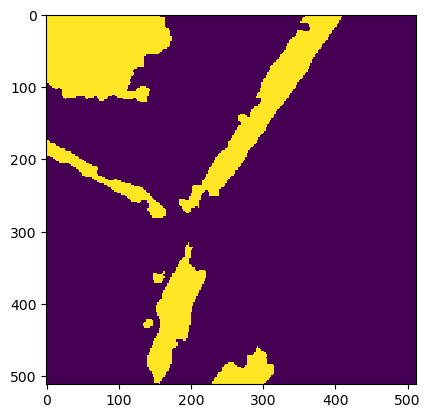

Wrote output/patches/mask/UU_S1_143-454505-6000-6302945-6000.tiff (512 x 512 pixels)


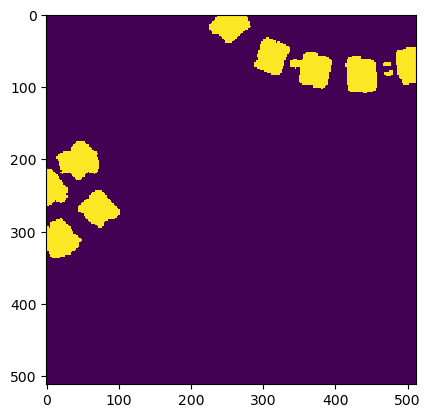

Wrote output/patches/mask/UU_S1_143-454608-0000-6302638-4000.tiff (512 x 512 pixels)


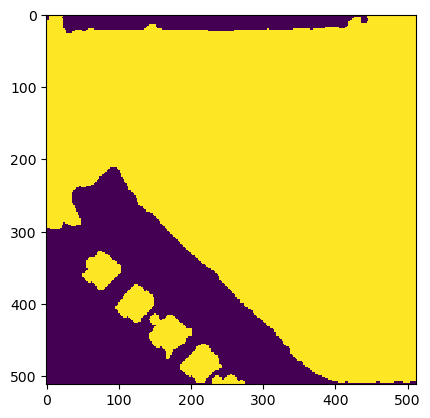

Wrote output/patches/mask/UU_S1_143-454608-0000-6302740-8000.tiff (512 x 512 pixels)


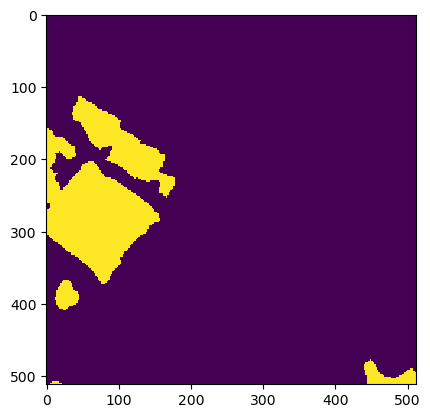

Wrote output/patches/mask/UU_S1_143-454608-0000-6302843-2000.tiff (512 x 512 pixels)


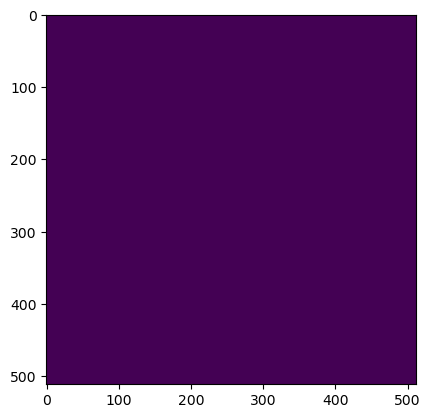

Wrote output/patches/mask/UU_S1_143-454608-0000-6302945-6000.tiff (512 x 512 pixels)


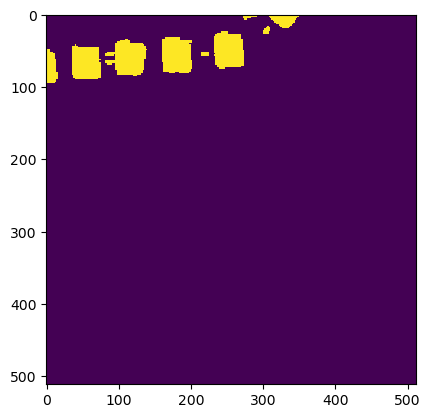

Wrote output/patches/mask/UU_S1_143-454710-4000-6302638-4000.tiff (512 x 512 pixels)


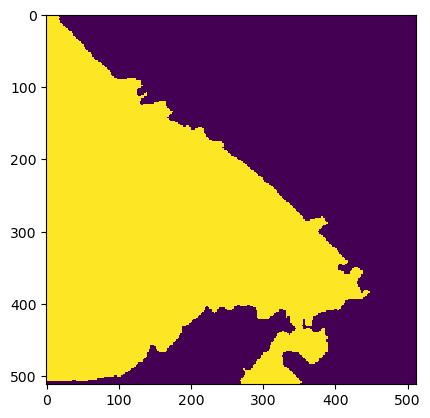

Wrote output/patches/mask/UU_S1_143-454710-4000-6302740-8000.tiff (512 x 512 pixels)


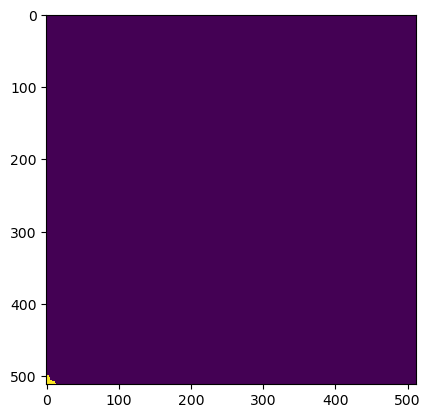

Wrote output/patches/mask/UU_S1_143-454710-4000-6302843-2000.tiff (512 x 512 pixels)


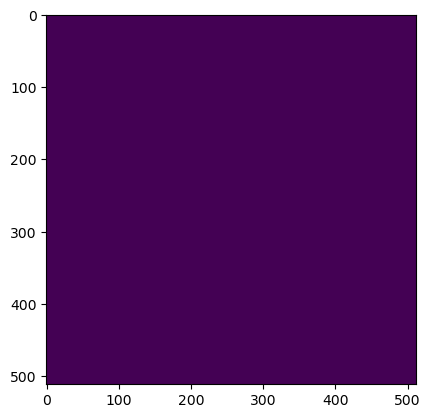

Wrote output/patches/mask/UU_S1_143-454710-4000-6302945-6000.tiff (512 x 512 pixels)
Zone UC_S1_144 Building Mask...


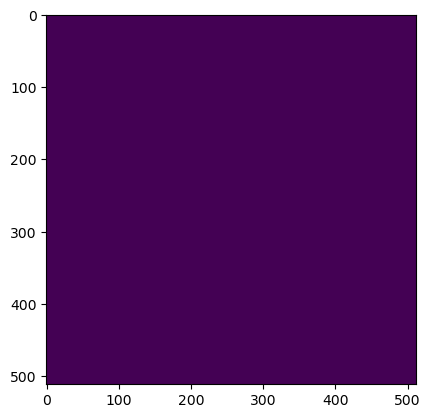

Wrote output/patches/mask/UC_S1_144-467152-0000-6303406-4000.tiff (512 x 512 pixels)


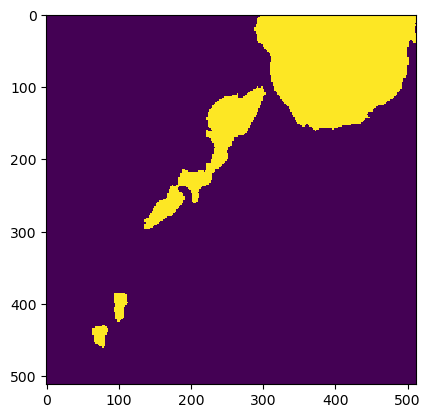

Wrote output/patches/mask/UC_S1_144-467152-0000-6303508-8000.tiff (512 x 512 pixels)


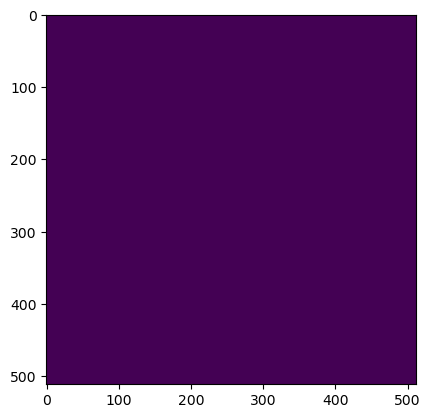

Wrote output/patches/mask/UC_S1_144-467254-4000-6303406-4000.tiff (512 x 512 pixels)


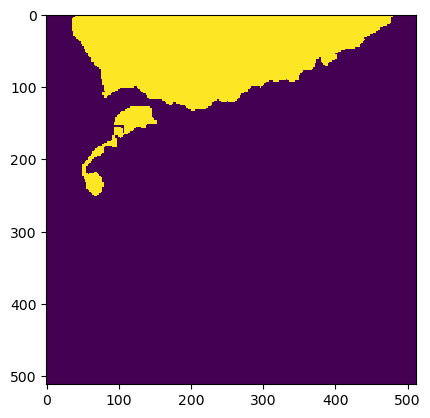

Wrote output/patches/mask/UC_S1_144-467254-4000-6303508-8000.tiff (512 x 512 pixels)
Zone UU_S1_145 Building Mask...


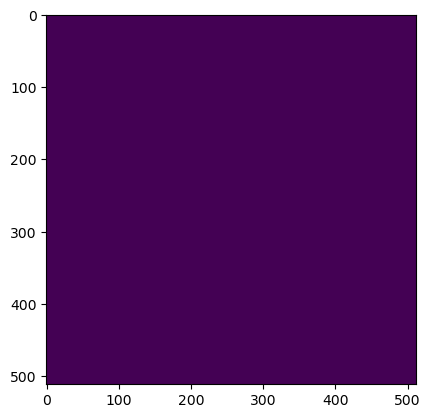

Wrote output/patches/mask/UU_S1_145-492240-0000-6303918-4000.tiff (512 x 512 pixels)


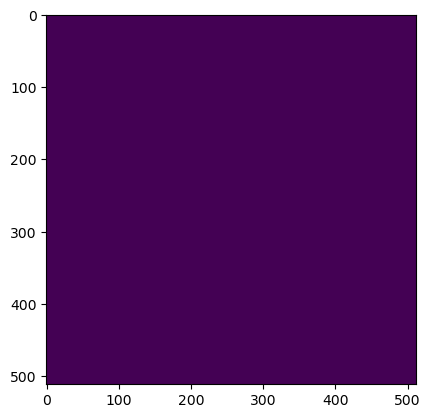

Wrote output/patches/mask/UU_S1_145-492240-0000-6304020-8000.tiff (512 x 512 pixels)


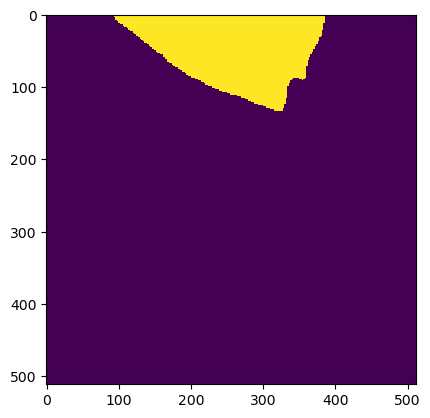

Wrote output/patches/mask/UU_S1_145-492240-0000-6304123-2000.tiff (512 x 512 pixels)


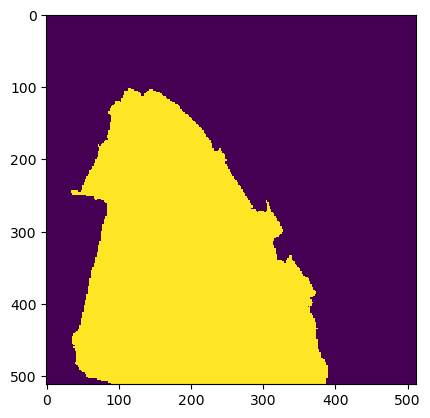

Wrote output/patches/mask/UU_S1_145-492240-0000-6304225-6000.tiff (512 x 512 pixels)


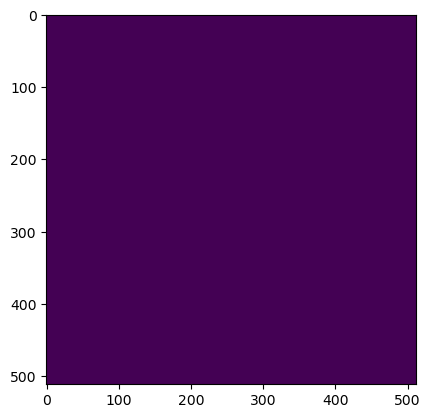

Wrote output/patches/mask/UU_S1_145-492342-4000-6303918-4000.tiff (512 x 512 pixels)


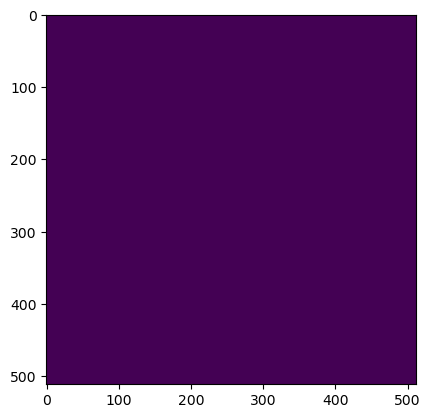

Wrote output/patches/mask/UU_S1_145-492342-4000-6304020-8000.tiff (512 x 512 pixels)


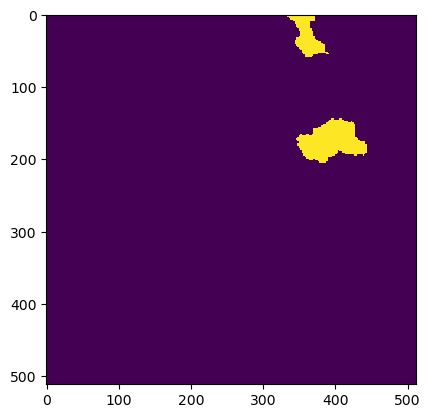

Wrote output/patches/mask/UU_S1_145-492342-4000-6304123-2000.tiff (512 x 512 pixels)


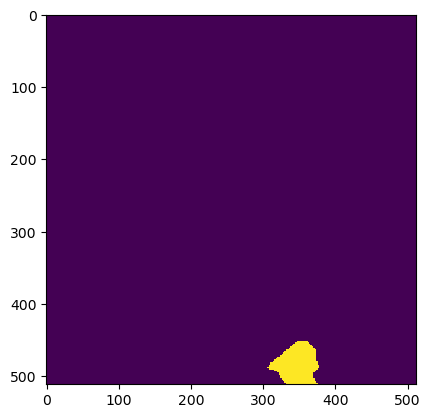

Wrote output/patches/mask/UU_S1_145-492342-4000-6304225-6000.tiff (512 x 512 pixels)


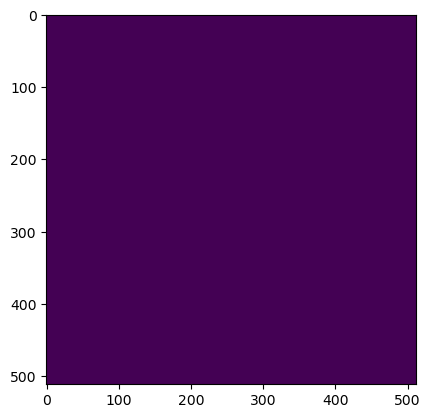

Wrote output/patches/mask/UU_S1_145-492444-8000-6303918-4000.tiff (512 x 512 pixels)


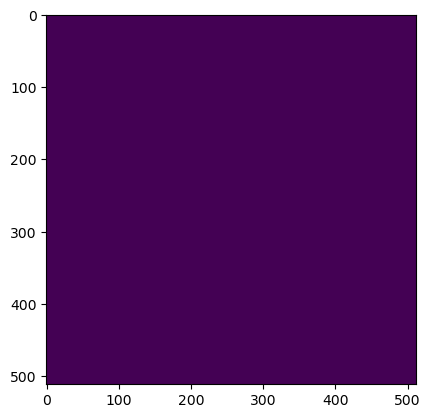

Wrote output/patches/mask/UU_S1_145-492444-8000-6304020-8000.tiff (512 x 512 pixels)


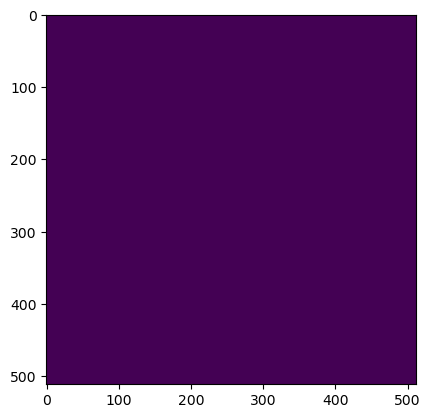

Wrote output/patches/mask/UU_S1_145-492444-8000-6304123-2000.tiff (512 x 512 pixels)


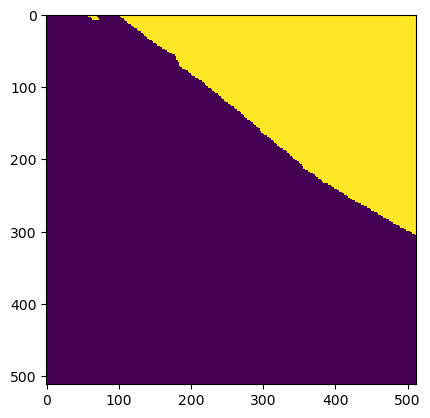

Wrote output/patches/mask/UU_S1_145-492444-8000-6304225-6000.tiff (512 x 512 pixels)


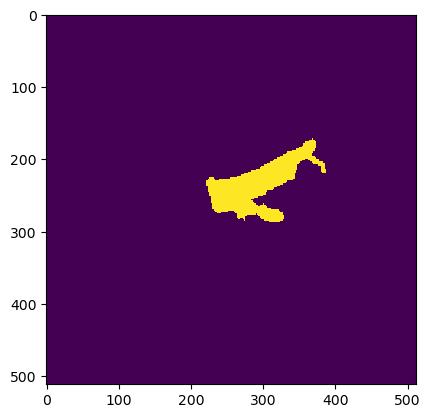

Wrote output/patches/mask/UU_S1_145-492547-2000-6303918-4000.tiff (512 x 512 pixels)


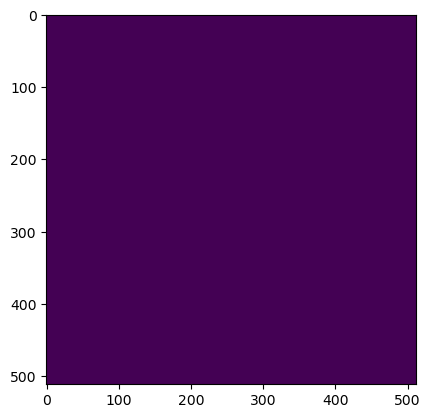

Wrote output/patches/mask/UU_S1_145-492547-2000-6304020-8000.tiff (512 x 512 pixels)


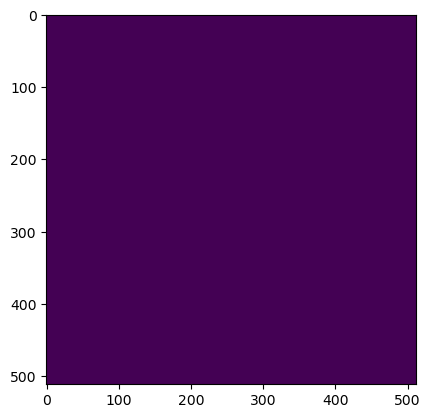

Wrote output/patches/mask/UU_S1_145-492547-2000-6304123-2000.tiff (512 x 512 pixels)


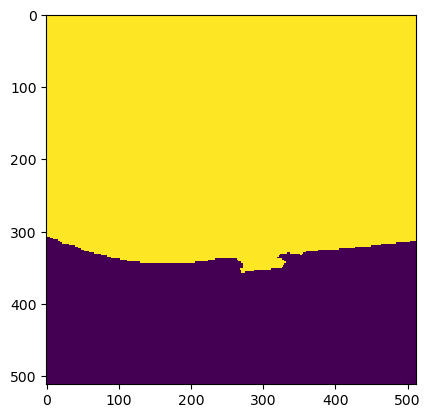

Wrote output/patches/mask/UU_S1_145-492547-2000-6304225-6000.tiff (512 x 512 pixels)


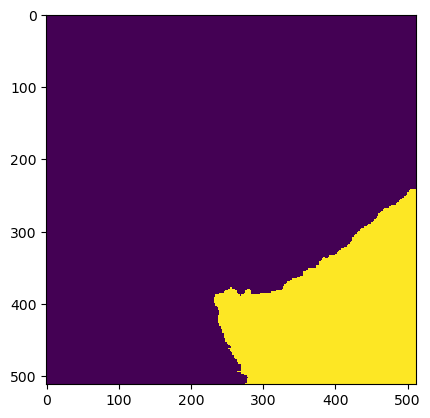

Wrote output/patches/mask/UU_S1_145-492649-6000-6303918-4000.tiff (512 x 512 pixels)


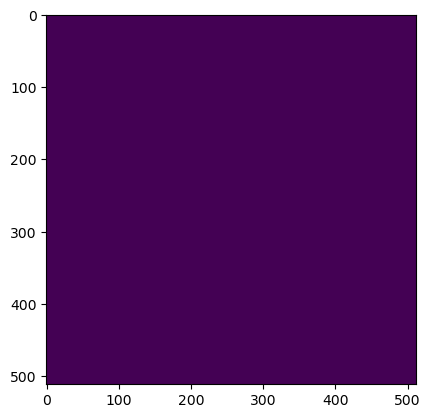

Wrote output/patches/mask/UU_S1_145-492649-6000-6304020-8000.tiff (512 x 512 pixels)


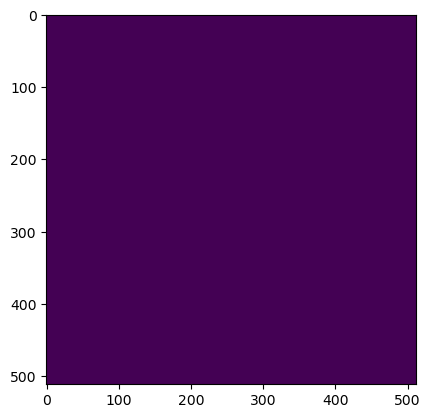

Wrote output/patches/mask/UU_S1_145-492649-6000-6304123-2000.tiff (512 x 512 pixels)


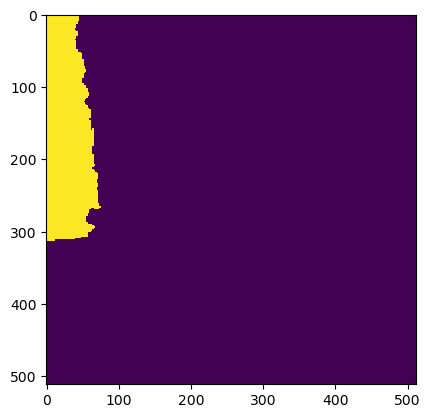

Wrote output/patches/mask/UU_S1_145-492649-6000-6304225-6000.tiff (512 x 512 pixels)


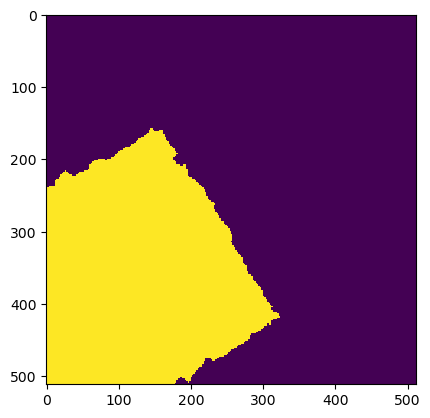

Wrote output/patches/mask/UU_S1_145-492752-0000-6303918-4000.tiff (512 x 512 pixels)


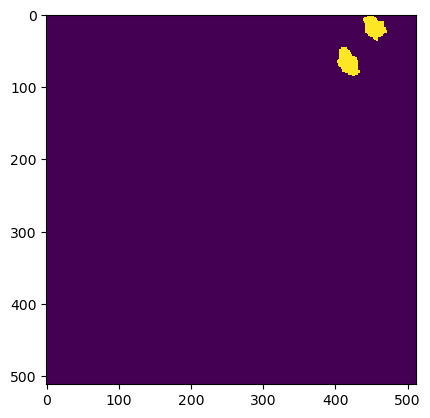

Wrote output/patches/mask/UU_S1_145-492752-0000-6304020-8000.tiff (512 x 512 pixels)


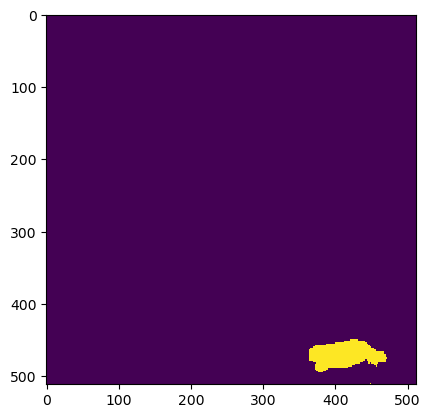

Wrote output/patches/mask/UU_S1_145-492752-0000-6304123-2000.tiff (512 x 512 pixels)


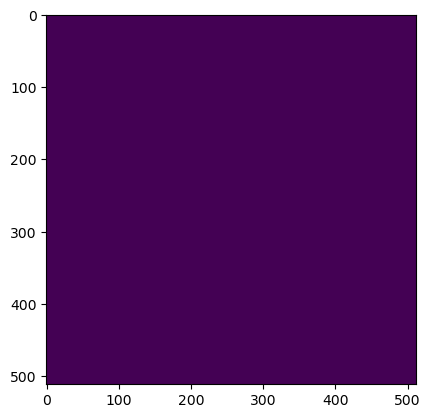

Wrote output/patches/mask/UU_S1_145-492752-0000-6304225-6000.tiff (512 x 512 pixels)


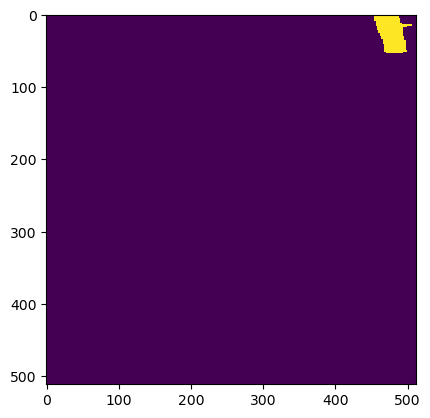

Wrote output/patches/mask/UU_S1_145-492854-4000-6303918-4000.tiff (512 x 512 pixels)


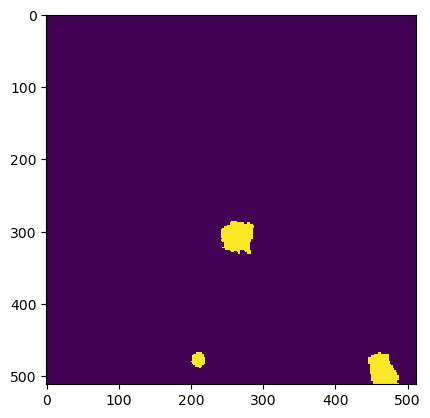

Wrote output/patches/mask/UU_S1_145-492854-4000-6304020-8000.tiff (512 x 512 pixels)


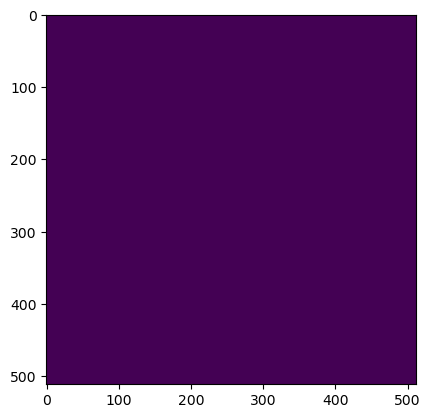

Wrote output/patches/mask/UU_S1_145-492854-4000-6304123-2000.tiff (512 x 512 pixels)


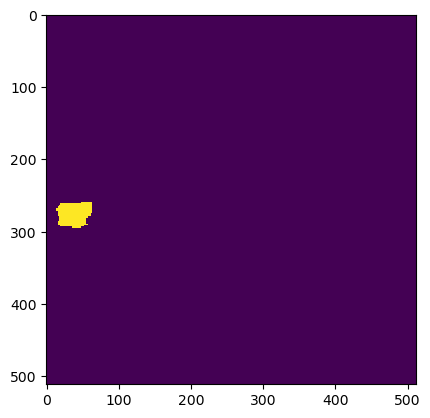

Wrote output/patches/mask/UU_S1_145-492854-4000-6304225-6000.tiff (512 x 512 pixels)
Zone CV_S1_146 Building Mask...


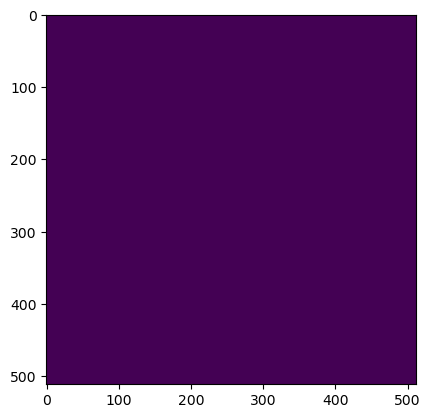

Wrote output/patches/mask/CV_S1_146-469456-0000-6304174-4000.tiff (512 x 512 pixels)


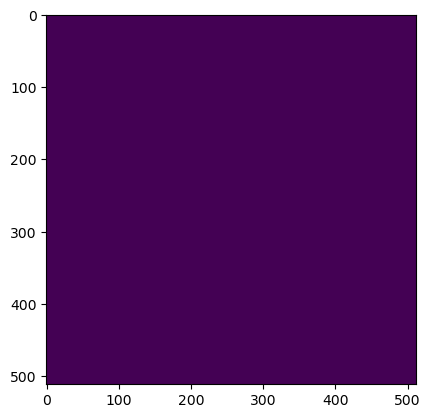

Wrote output/patches/mask/CV_S1_146-469456-0000-6304276-8000.tiff (512 x 512 pixels)


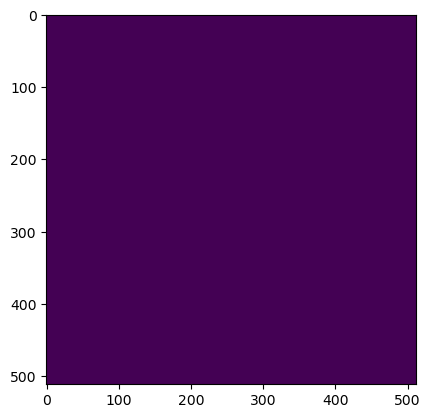

Wrote output/patches/mask/CV_S1_146-469456-0000-6304379-2000.tiff (512 x 512 pixels)


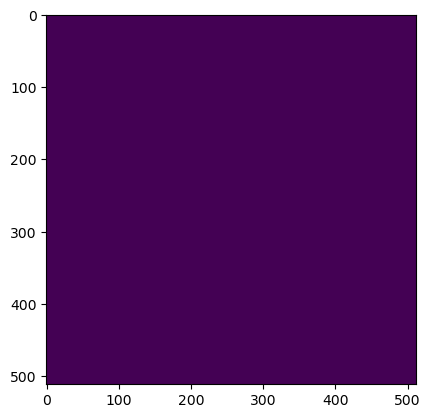

Wrote output/patches/mask/CV_S1_146-469456-0000-6304481-6000.tiff (512 x 512 pixels)


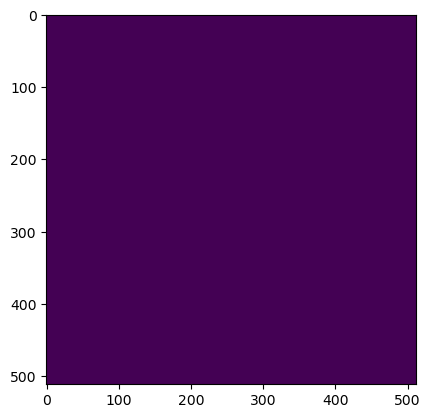

Wrote output/patches/mask/CV_S1_146-469456-0000-6304584-0000.tiff (512 x 512 pixels)


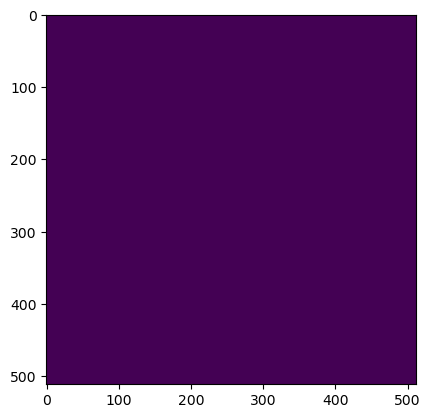

Wrote output/patches/mask/CV_S1_146-469456-0000-6304686-4000.tiff (512 x 512 pixels)


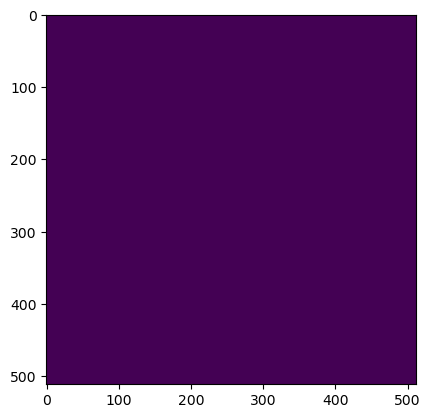

Wrote output/patches/mask/CV_S1_146-469456-0000-6304788-8000.tiff (512 x 512 pixels)


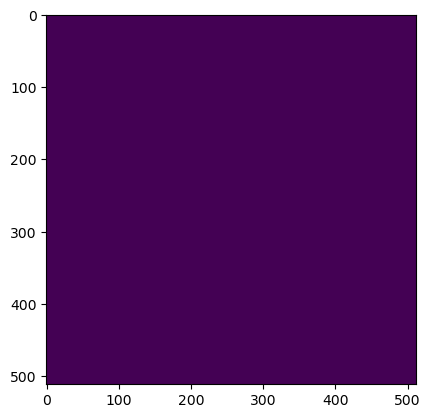

Wrote output/patches/mask/CV_S1_146-469558-4000-6304174-4000.tiff (512 x 512 pixels)


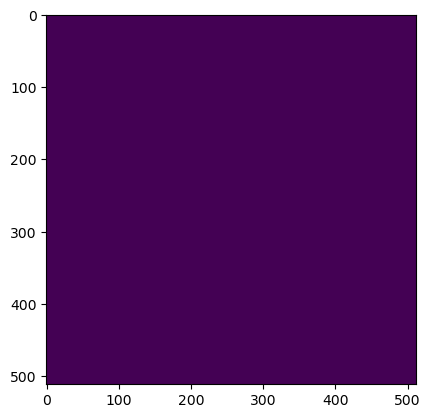

Wrote output/patches/mask/CV_S1_146-469558-4000-6304276-8000.tiff (512 x 512 pixels)


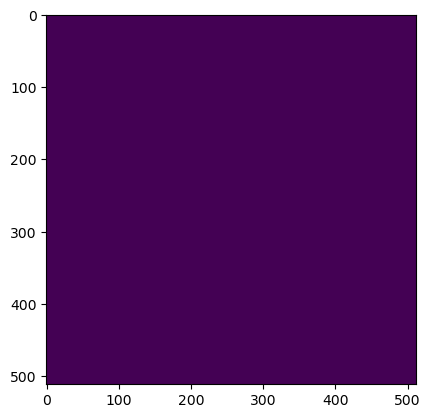

Wrote output/patches/mask/CV_S1_146-469558-4000-6304379-2000.tiff (512 x 512 pixels)


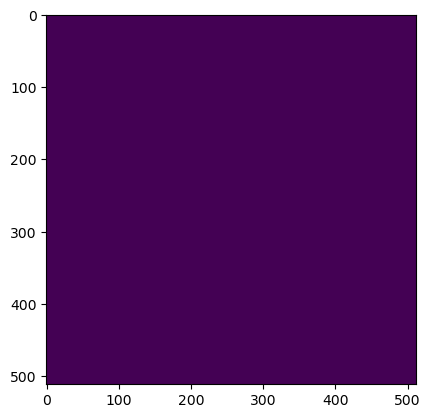

Wrote output/patches/mask/CV_S1_146-469558-4000-6304481-6000.tiff (512 x 512 pixels)


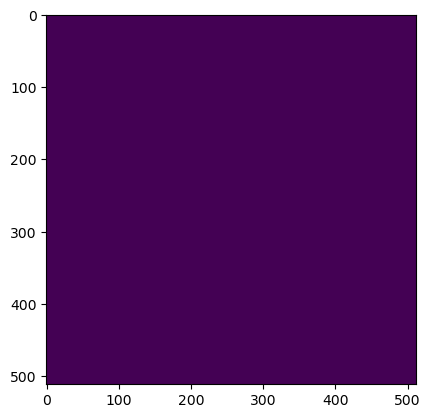

Wrote output/patches/mask/CV_S1_146-469558-4000-6304584-0000.tiff (512 x 512 pixels)


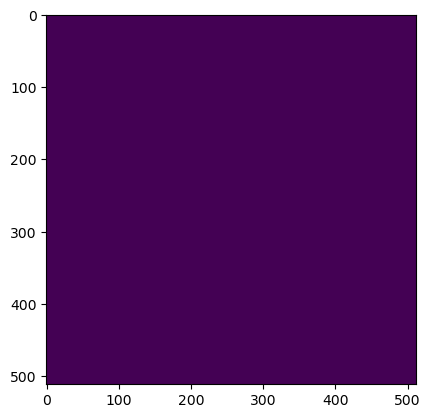

Wrote output/patches/mask/CV_S1_146-469558-4000-6304686-4000.tiff (512 x 512 pixels)


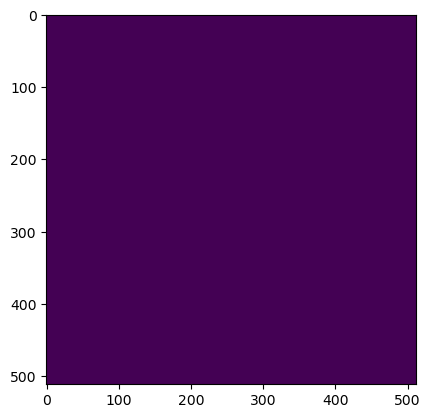

Wrote output/patches/mask/CV_S1_146-469558-4000-6304788-8000.tiff (512 x 512 pixels)


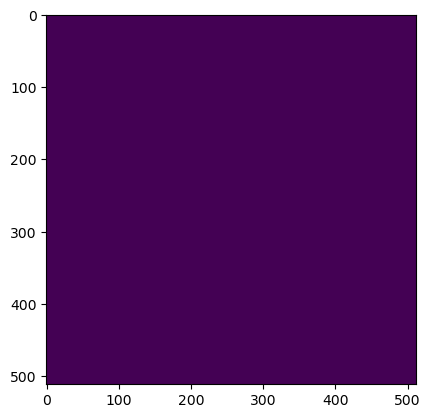

Wrote output/patches/mask/CV_S1_146-469660-8000-6304174-4000.tiff (512 x 512 pixels)


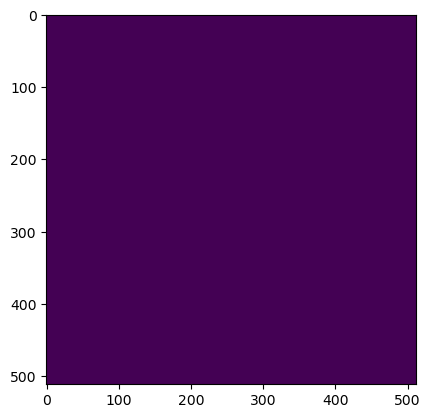

Wrote output/patches/mask/CV_S1_146-469660-8000-6304276-8000.tiff (512 x 512 pixels)


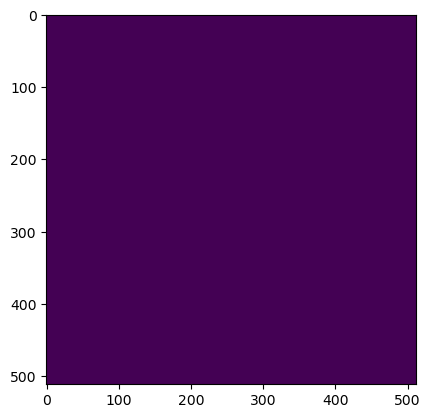

Wrote output/patches/mask/CV_S1_146-469660-8000-6304379-2000.tiff (512 x 512 pixels)


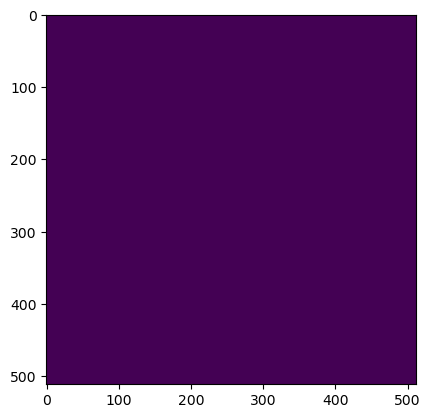

Wrote output/patches/mask/CV_S1_146-469660-8000-6304481-6000.tiff (512 x 512 pixels)


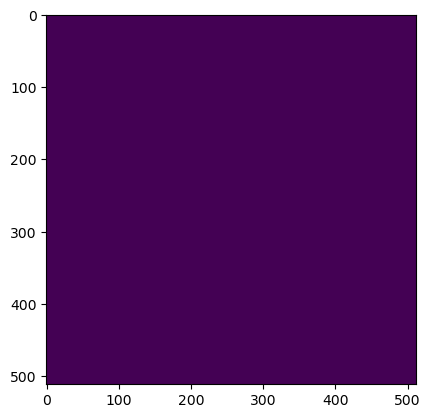

Wrote output/patches/mask/CV_S1_146-469660-8000-6304584-0000.tiff (512 x 512 pixels)


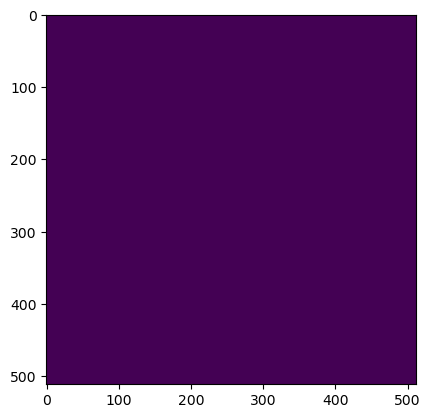

Wrote output/patches/mask/CV_S1_146-469660-8000-6304686-4000.tiff (512 x 512 pixels)


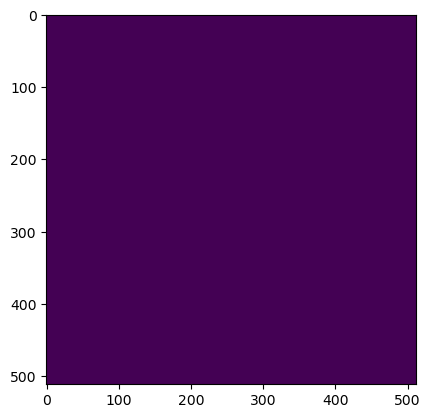

Wrote output/patches/mask/CV_S1_146-469660-8000-6304788-8000.tiff (512 x 512 pixels)


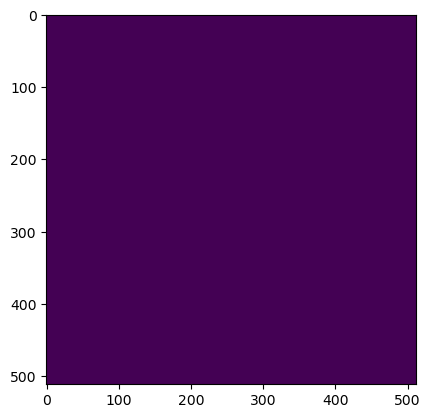

Wrote output/patches/mask/CV_S1_146-469763-2000-6304174-4000.tiff (512 x 512 pixels)


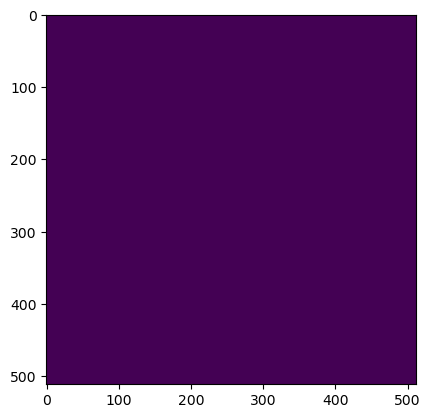

Wrote output/patches/mask/CV_S1_146-469763-2000-6304276-8000.tiff (512 x 512 pixels)


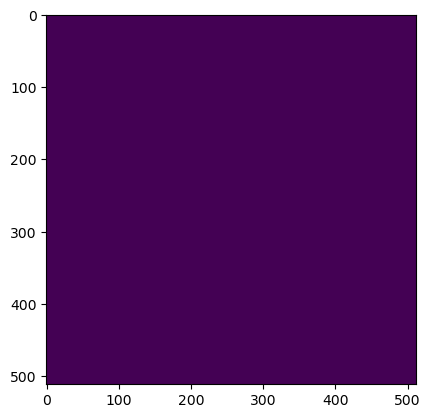

Wrote output/patches/mask/CV_S1_146-469763-2000-6304379-2000.tiff (512 x 512 pixels)


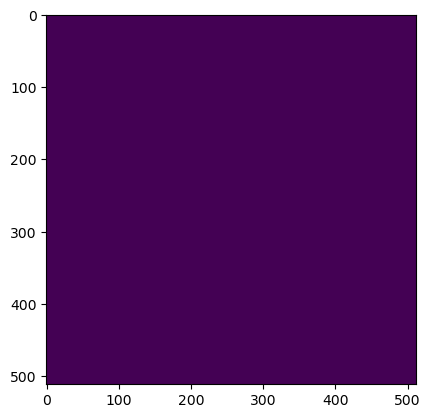

Wrote output/patches/mask/CV_S1_146-469763-2000-6304481-6000.tiff (512 x 512 pixels)


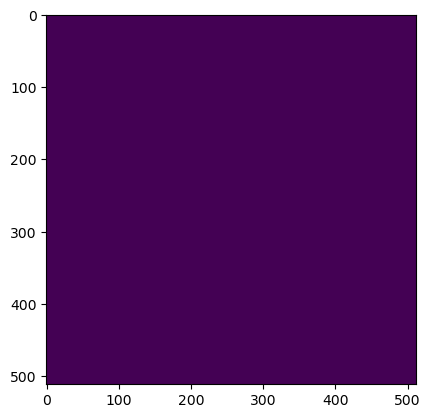

Wrote output/patches/mask/CV_S1_146-469763-2000-6304584-0000.tiff (512 x 512 pixels)


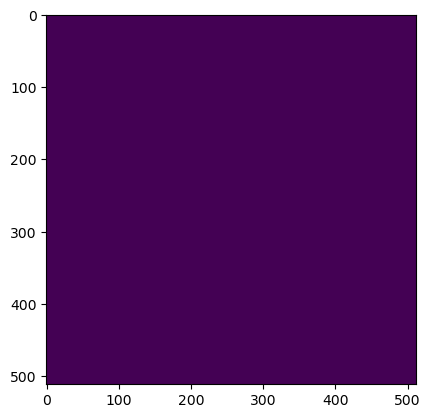

Wrote output/patches/mask/CV_S1_146-469763-2000-6304686-4000.tiff (512 x 512 pixels)


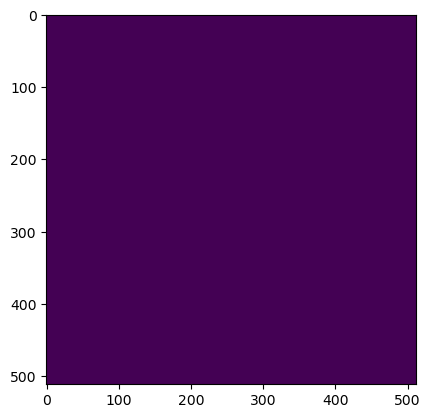

Wrote output/patches/mask/CV_S1_146-469763-2000-6304788-8000.tiff (512 x 512 pixels)


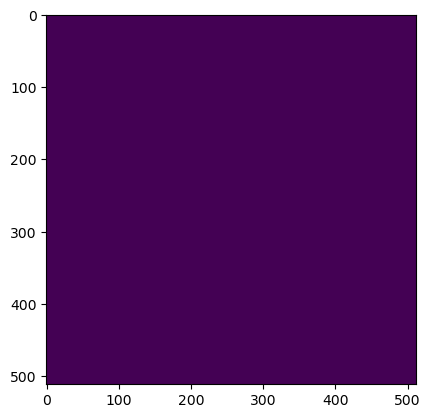

Wrote output/patches/mask/CV_S1_146-469865-6000-6304174-4000.tiff (512 x 512 pixels)


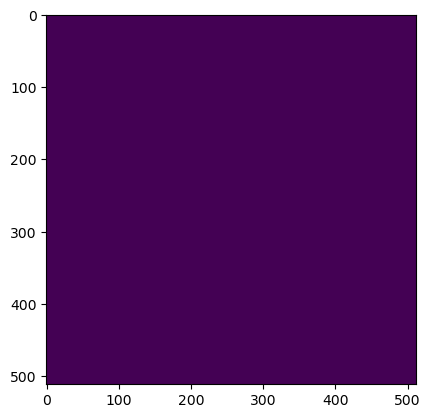

Wrote output/patches/mask/CV_S1_146-469865-6000-6304276-8000.tiff (512 x 512 pixels)


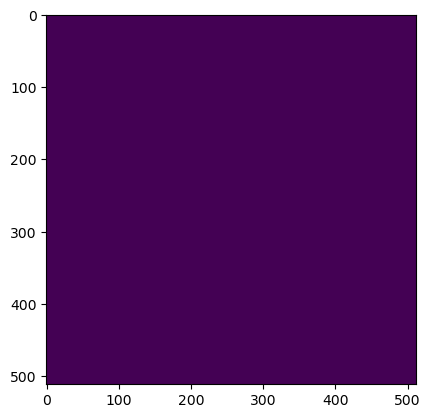

Wrote output/patches/mask/CV_S1_146-469865-6000-6304379-2000.tiff (512 x 512 pixels)


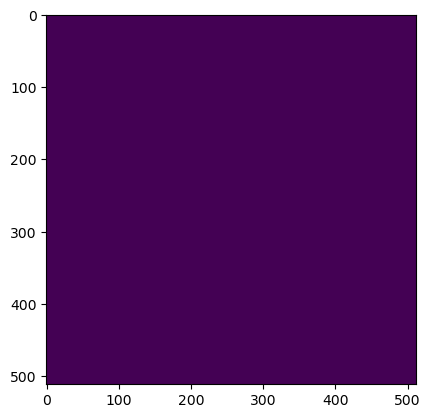

Wrote output/patches/mask/CV_S1_146-469865-6000-6304481-6000.tiff (512 x 512 pixels)


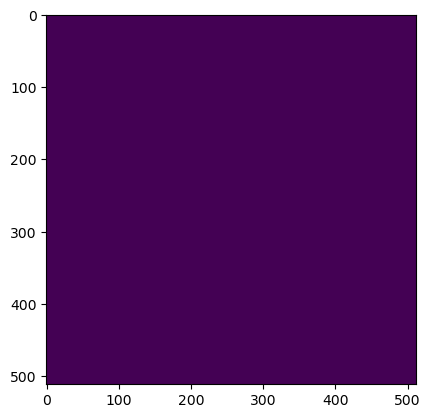

Wrote output/patches/mask/CV_S1_146-469865-6000-6304584-0000.tiff (512 x 512 pixels)


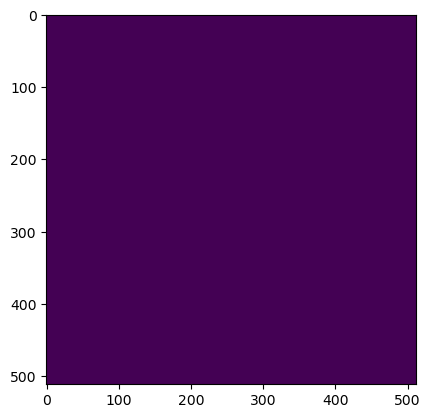

Wrote output/patches/mask/CV_S1_146-469865-6000-6304686-4000.tiff (512 x 512 pixels)


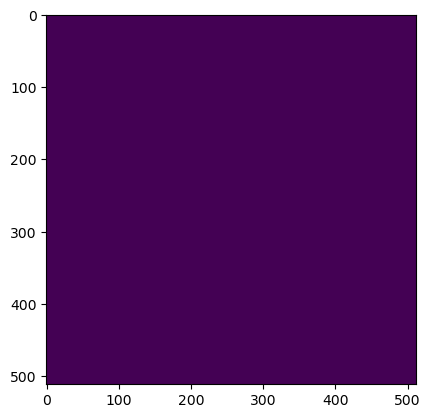

Wrote output/patches/mask/CV_S1_146-469865-6000-6304788-8000.tiff (512 x 512 pixels)


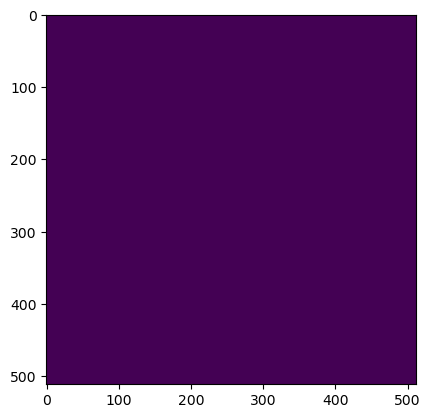

Wrote output/patches/mask/CV_S1_146-469968-0000-6304174-4000.tiff (512 x 512 pixels)


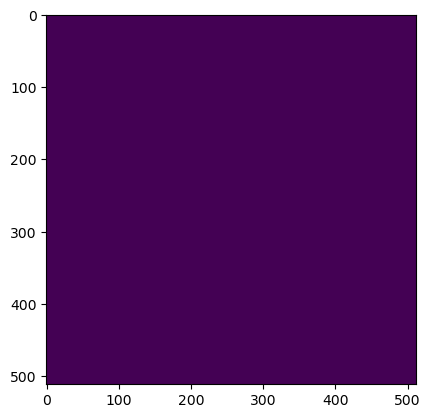

Wrote output/patches/mask/CV_S1_146-469968-0000-6304276-8000.tiff (512 x 512 pixels)


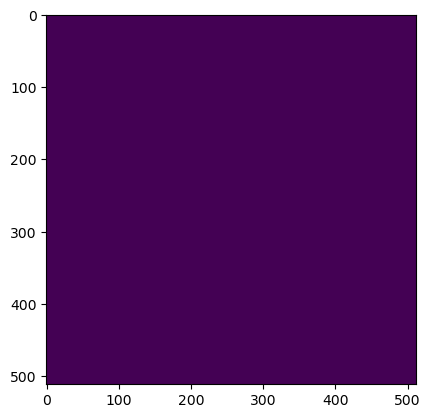

Wrote output/patches/mask/CV_S1_146-469968-0000-6304379-2000.tiff (512 x 512 pixels)


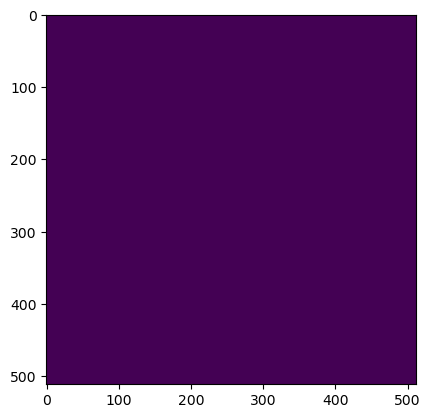

Wrote output/patches/mask/CV_S1_146-469968-0000-6304481-6000.tiff (512 x 512 pixels)


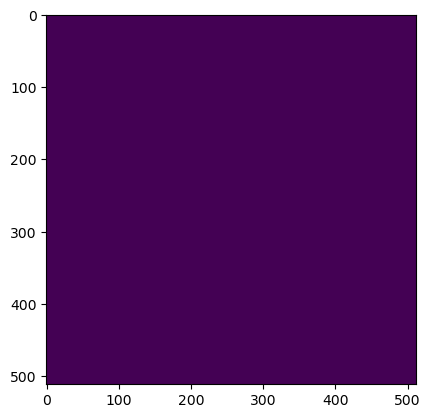

Wrote output/patches/mask/CV_S1_146-469968-0000-6304584-0000.tiff (512 x 512 pixels)


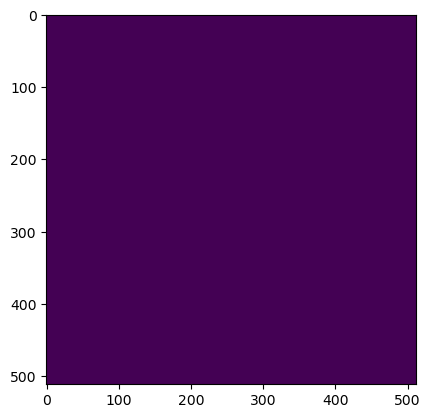

Wrote output/patches/mask/CV_S1_146-469968-0000-6304686-4000.tiff (512 x 512 pixels)


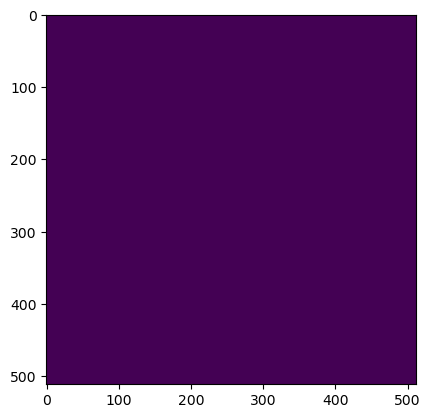

Wrote output/patches/mask/CV_S1_146-469968-0000-6304788-8000.tiff (512 x 512 pixels)


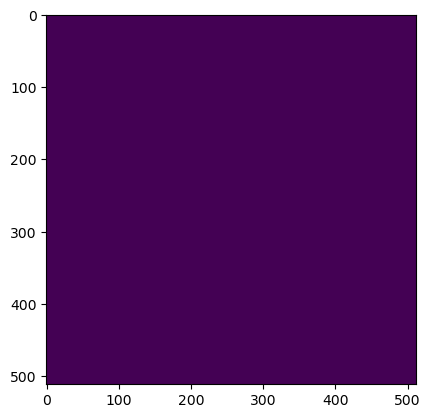

Wrote output/patches/mask/CV_S1_146-470070-4000-6304174-4000.tiff (512 x 512 pixels)


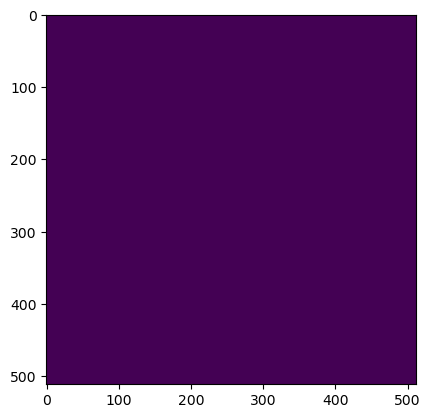

Wrote output/patches/mask/CV_S1_146-470070-4000-6304276-8000.tiff (512 x 512 pixels)


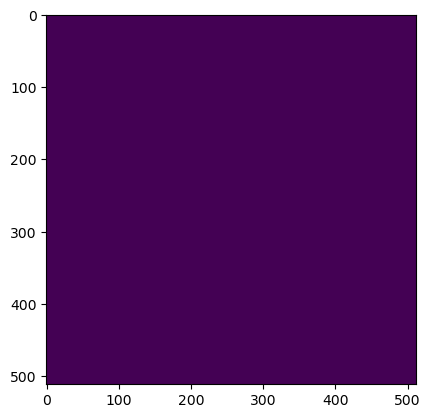

Wrote output/patches/mask/CV_S1_146-470070-4000-6304379-2000.tiff (512 x 512 pixels)


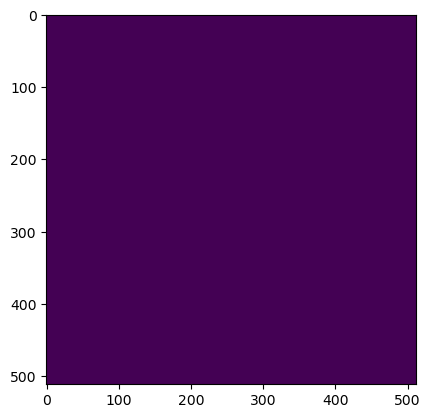

Wrote output/patches/mask/CV_S1_146-470070-4000-6304481-6000.tiff (512 x 512 pixels)


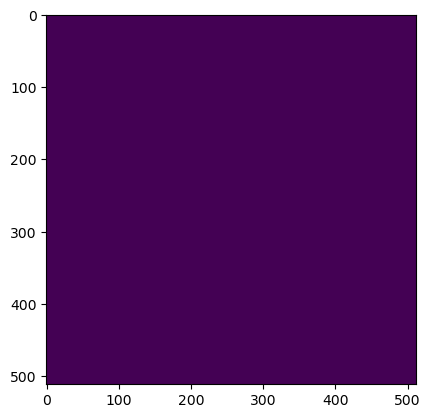

Wrote output/patches/mask/CV_S1_146-470070-4000-6304584-0000.tiff (512 x 512 pixels)


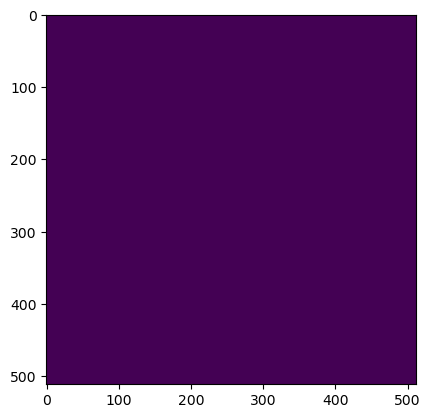

Wrote output/patches/mask/CV_S1_146-470070-4000-6304686-4000.tiff (512 x 512 pixels)


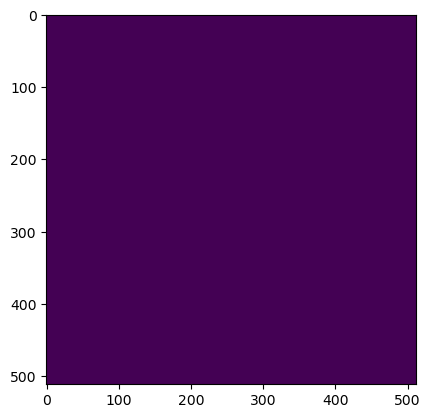

Wrote output/patches/mask/CV_S1_146-470070-4000-6304788-8000.tiff (512 x 512 pixels)


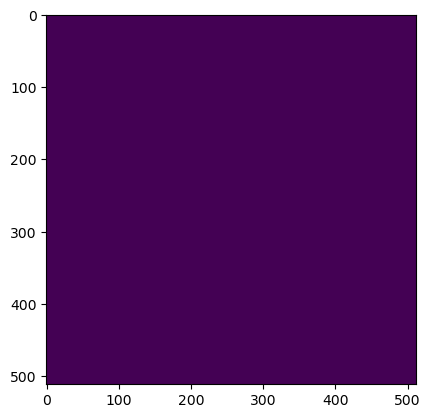

Wrote output/patches/mask/CV_S1_146-470172-8000-6304174-4000.tiff (512 x 512 pixels)


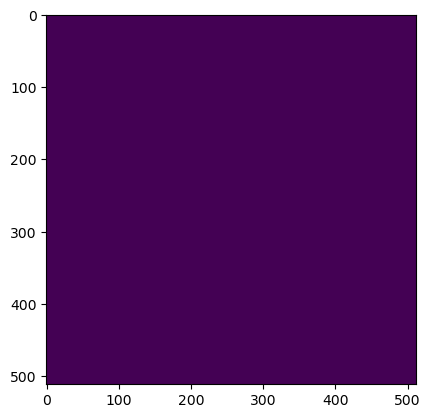

Wrote output/patches/mask/CV_S1_146-470172-8000-6304276-8000.tiff (512 x 512 pixels)


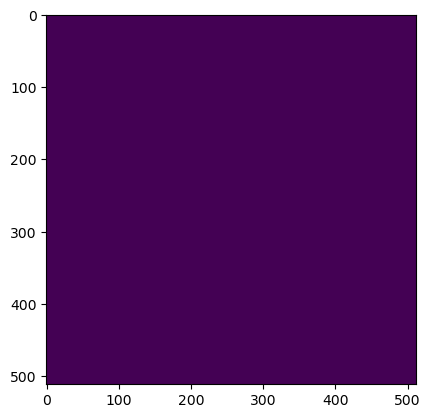

Wrote output/patches/mask/CV_S1_146-470172-8000-6304379-2000.tiff (512 x 512 pixels)


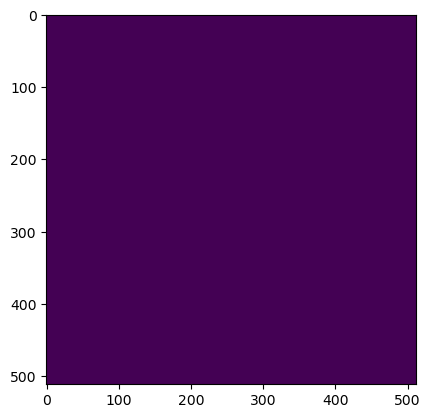

Wrote output/patches/mask/CV_S1_146-470172-8000-6304481-6000.tiff (512 x 512 pixels)


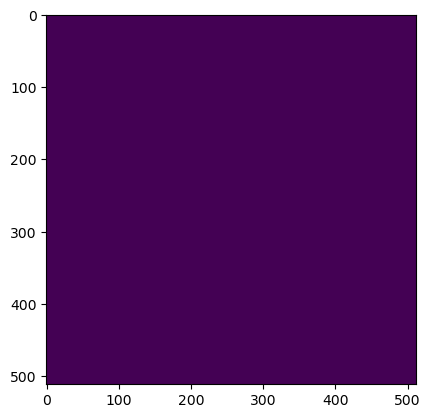

Wrote output/patches/mask/CV_S1_146-470172-8000-6304584-0000.tiff (512 x 512 pixels)


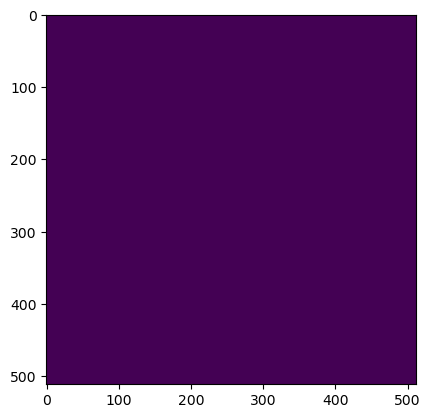

Wrote output/patches/mask/CV_S1_146-470172-8000-6304686-4000.tiff (512 x 512 pixels)


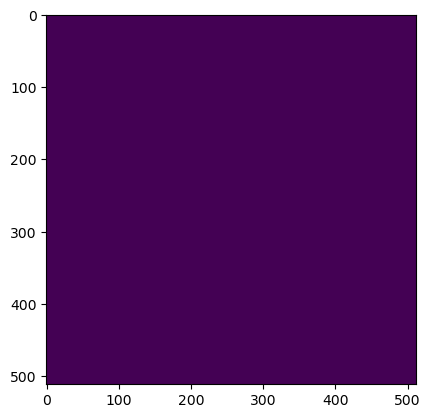

Wrote output/patches/mask/CV_S1_146-470172-8000-6304788-8000.tiff (512 x 512 pixels)


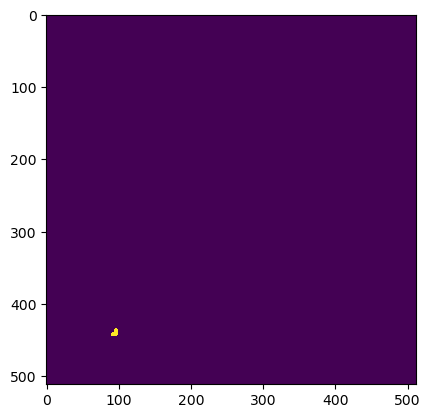

Wrote output/patches/mask/CV_S1_146-470275-2000-6304174-4000.tiff (512 x 512 pixels)


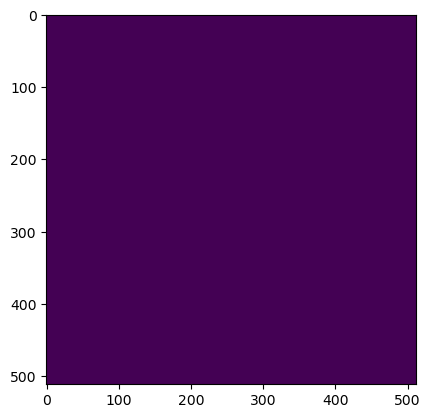

Wrote output/patches/mask/CV_S1_146-470275-2000-6304276-8000.tiff (512 x 512 pixels)


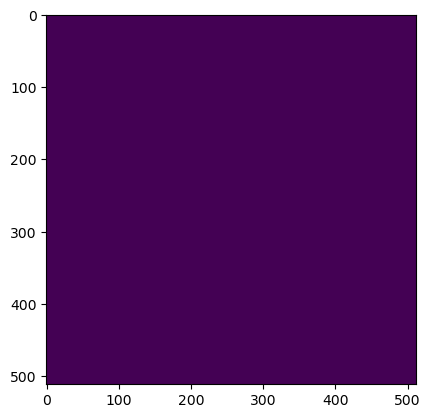

Wrote output/patches/mask/CV_S1_146-470275-2000-6304379-2000.tiff (512 x 512 pixels)


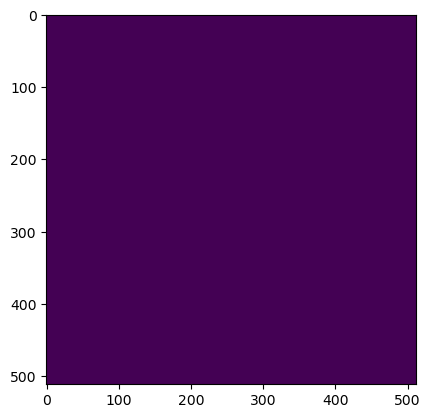

Wrote output/patches/mask/CV_S1_146-470275-2000-6304481-6000.tiff (512 x 512 pixels)


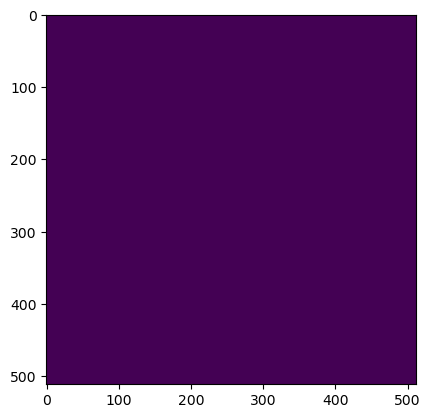

Wrote output/patches/mask/CV_S1_146-470275-2000-6304584-0000.tiff (512 x 512 pixels)


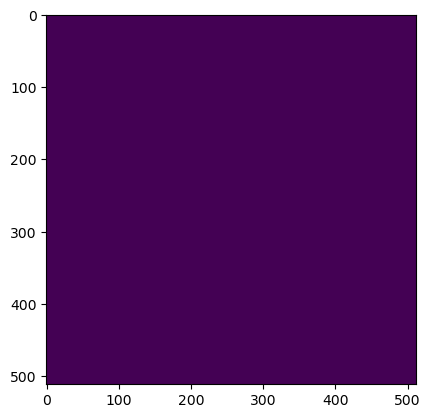

Wrote output/patches/mask/CV_S1_146-470275-2000-6304686-4000.tiff (512 x 512 pixels)


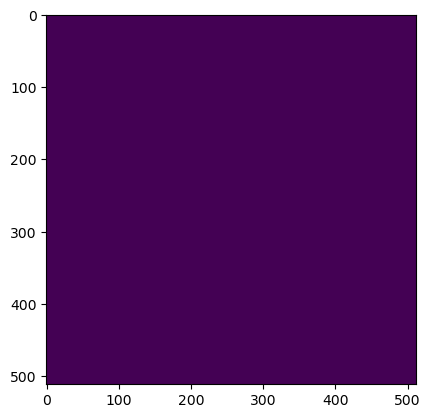

Wrote output/patches/mask/CV_S1_146-470275-2000-6304788-8000.tiff (512 x 512 pixels)


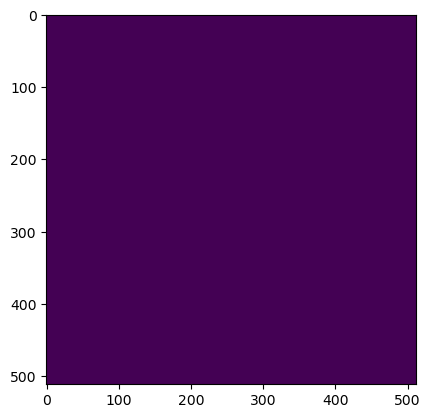

Wrote output/patches/mask/CV_S1_146-470377-6000-6304174-4000.tiff (512 x 512 pixels)


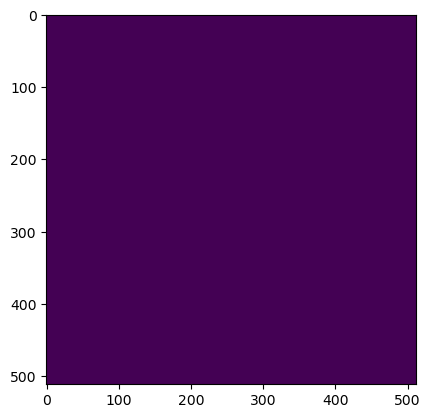

Wrote output/patches/mask/CV_S1_146-470377-6000-6304276-8000.tiff (512 x 512 pixels)


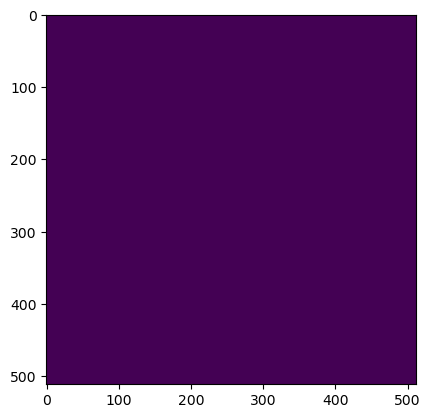

Wrote output/patches/mask/CV_S1_146-470377-6000-6304379-2000.tiff (512 x 512 pixels)


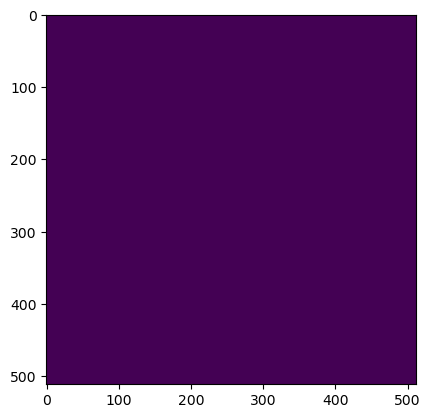

Wrote output/patches/mask/CV_S1_146-470377-6000-6304481-6000.tiff (512 x 512 pixels)


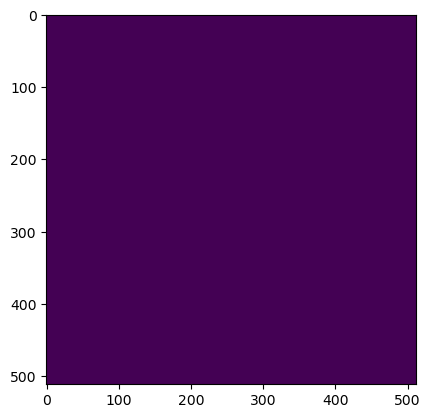

Wrote output/patches/mask/CV_S1_146-470377-6000-6304584-0000.tiff (512 x 512 pixels)


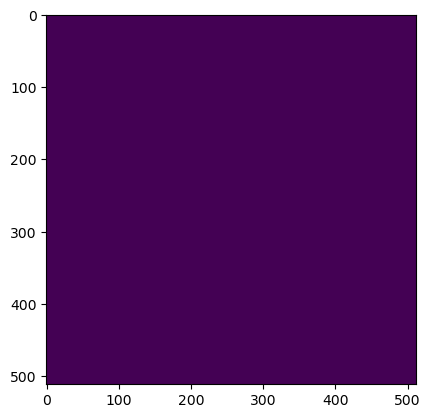

Wrote output/patches/mask/CV_S1_146-470377-6000-6304686-4000.tiff (512 x 512 pixels)


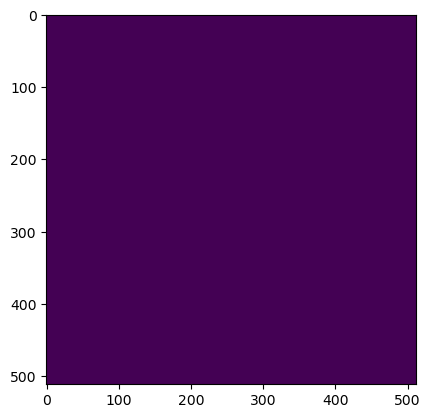

Wrote output/patches/mask/CV_S1_146-470377-6000-6304788-8000.tiff (512 x 512 pixels)


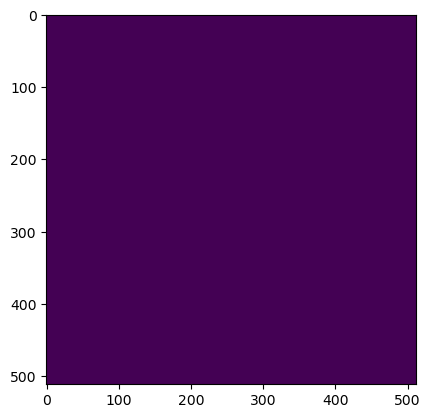

Wrote output/patches/mask/CV_S1_146-470480-0000-6304174-4000.tiff (512 x 512 pixels)


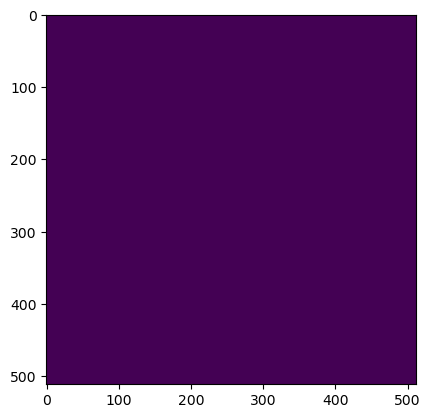

Wrote output/patches/mask/CV_S1_146-470480-0000-6304276-8000.tiff (512 x 512 pixels)


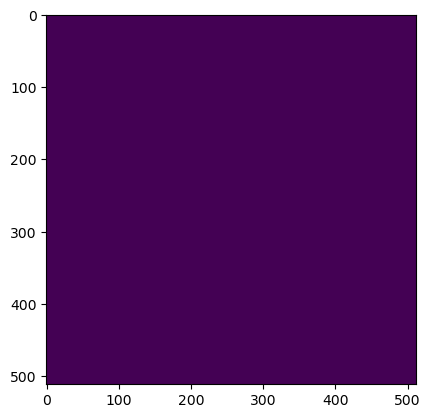

Wrote output/patches/mask/CV_S1_146-470480-0000-6304379-2000.tiff (512 x 512 pixels)


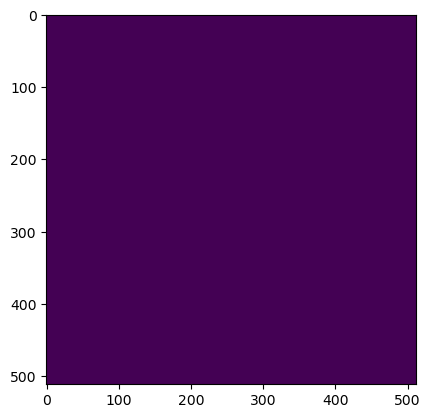

Wrote output/patches/mask/CV_S1_146-470480-0000-6304481-6000.tiff (512 x 512 pixels)


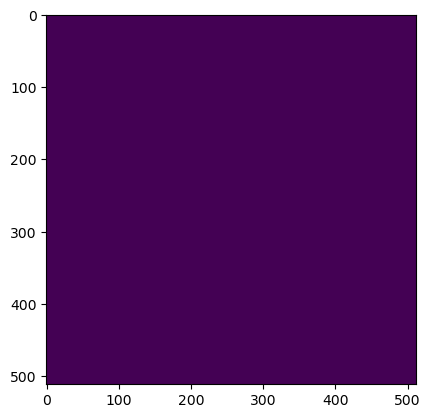

Wrote output/patches/mask/CV_S1_146-470480-0000-6304584-0000.tiff (512 x 512 pixels)


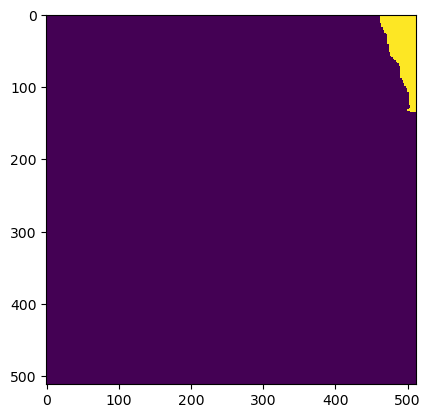

Wrote output/patches/mask/CV_S1_146-470480-0000-6304686-4000.tiff (512 x 512 pixels)


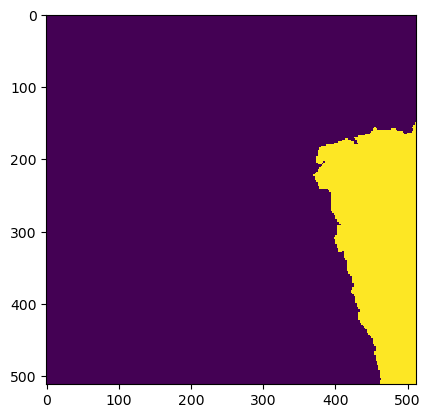

Wrote output/patches/mask/CV_S1_146-470480-0000-6304788-8000.tiff (512 x 512 pixels)


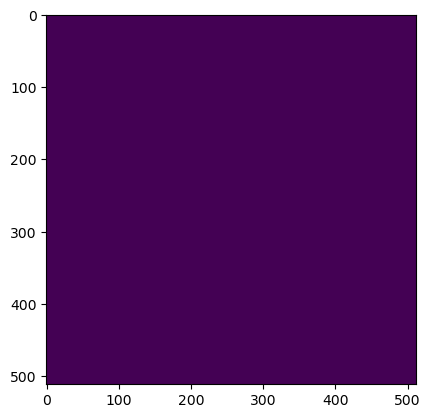

Wrote output/patches/mask/CV_S1_146-470582-4000-6304174-4000.tiff (512 x 512 pixels)


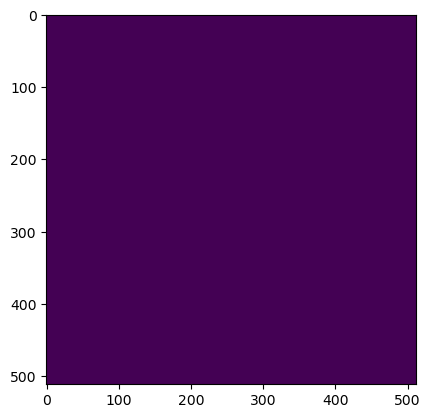

Wrote output/patches/mask/CV_S1_146-470582-4000-6304276-8000.tiff (512 x 512 pixels)


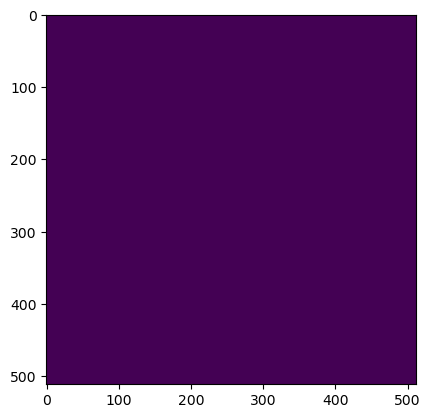

Wrote output/patches/mask/CV_S1_146-470582-4000-6304379-2000.tiff (512 x 512 pixels)


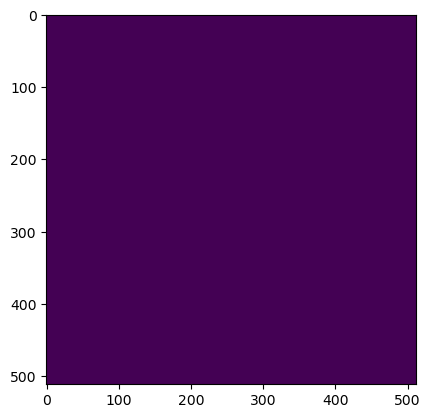

Wrote output/patches/mask/CV_S1_146-470582-4000-6304481-6000.tiff (512 x 512 pixels)


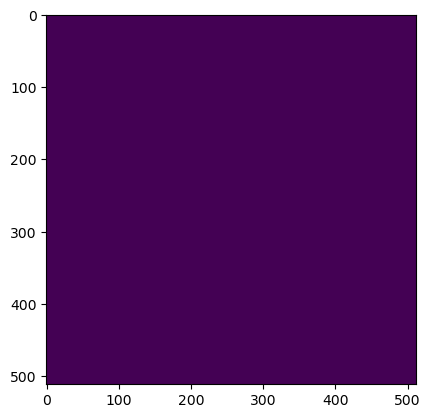

Wrote output/patches/mask/CV_S1_146-470582-4000-6304584-0000.tiff (512 x 512 pixels)


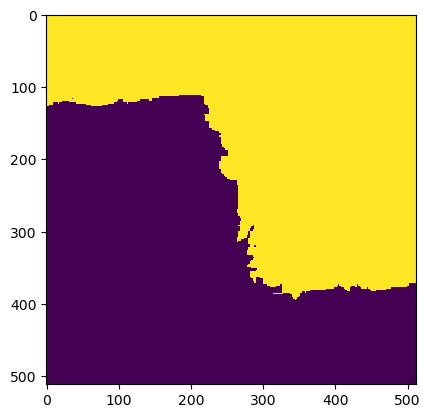

Wrote output/patches/mask/CV_S1_146-470582-4000-6304686-4000.tiff (512 x 512 pixels)


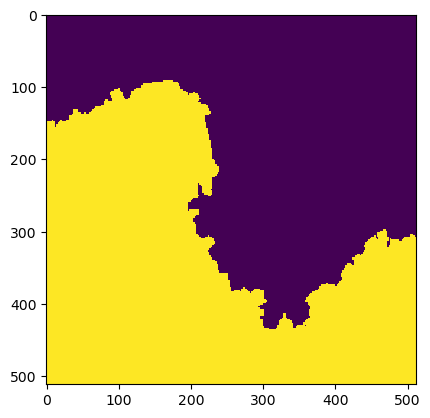

Wrote output/patches/mask/CV_S1_146-470582-4000-6304788-8000.tiff (512 x 512 pixels)
Zone UC_S1_147 Building Mask...


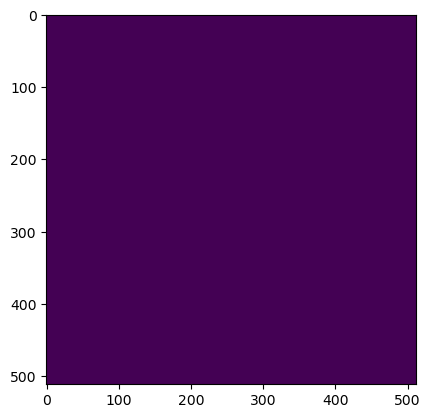

Wrote output/patches/mask/UC_S1_147-488656-0000-6304174-4000.tiff (512 x 512 pixels)


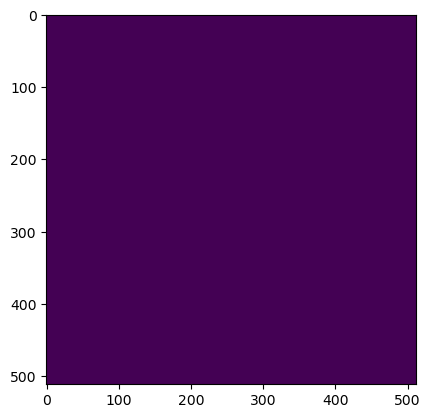

Wrote output/patches/mask/UC_S1_147-488656-0000-6304276-8000.tiff (512 x 512 pixels)


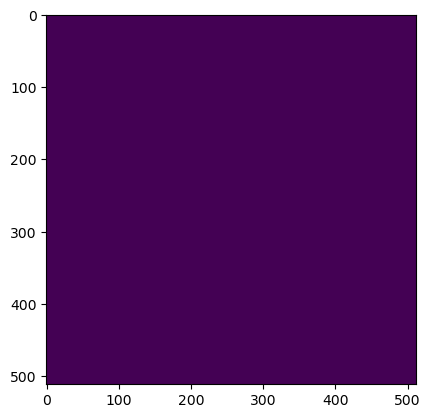

Wrote output/patches/mask/UC_S1_147-488656-0000-6304379-2000.tiff (512 x 512 pixels)


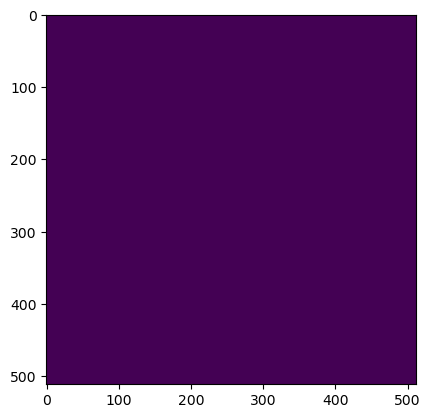

Wrote output/patches/mask/UC_S1_147-488656-0000-6304481-6000.tiff (512 x 512 pixels)


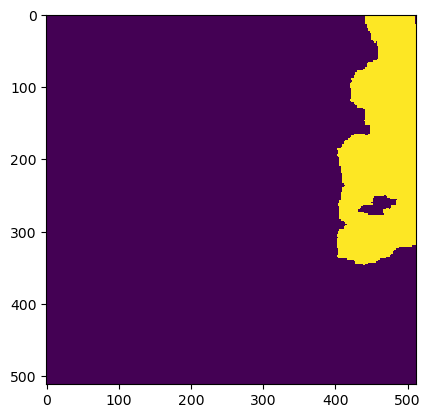

Wrote output/patches/mask/UC_S1_147-488758-4000-6304174-4000.tiff (512 x 512 pixels)


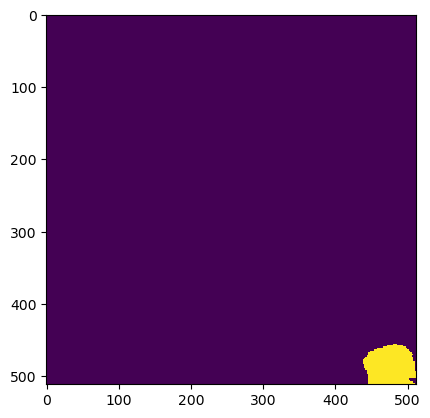

Wrote output/patches/mask/UC_S1_147-488758-4000-6304276-8000.tiff (512 x 512 pixels)


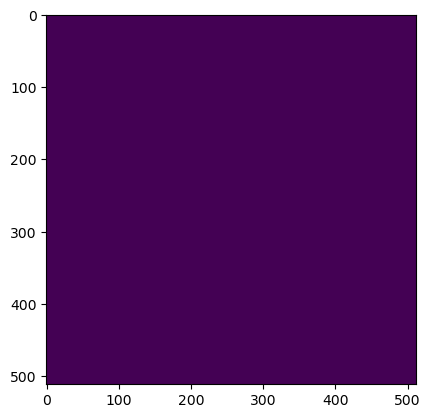

Wrote output/patches/mask/UC_S1_147-488758-4000-6304379-2000.tiff (512 x 512 pixels)


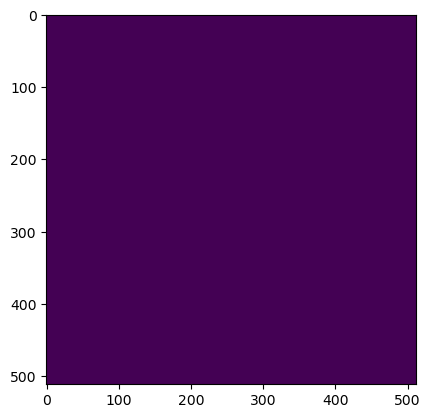

Wrote output/patches/mask/UC_S1_147-488758-4000-6304481-6000.tiff (512 x 512 pixels)
Zone VU_S1_148 Building Mask...


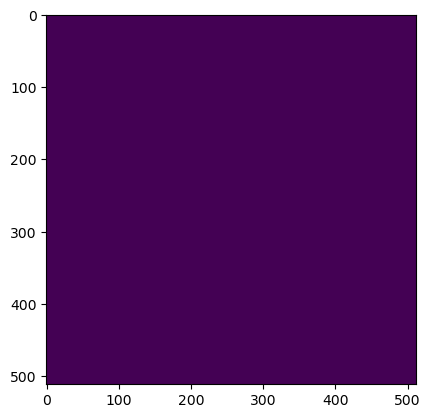

Wrote output/patches/mask/VU_S1_148-465616-0000-6304430-4000.tiff (512 x 512 pixels)


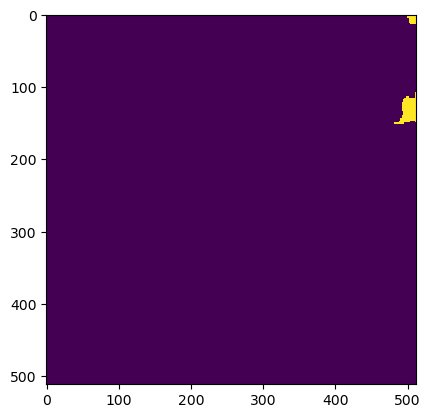

Wrote output/patches/mask/VU_S1_148-465616-0000-6304532-8000.tiff (512 x 512 pixels)


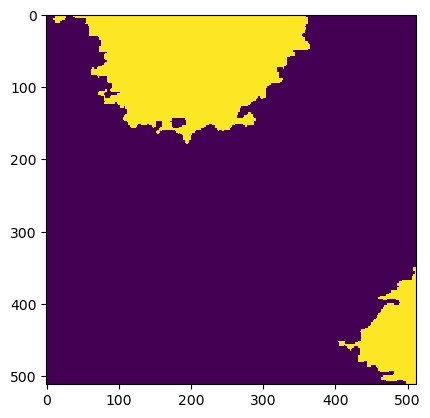

Wrote output/patches/mask/VU_S1_148-465616-0000-6304635-2000.tiff (512 x 512 pixels)


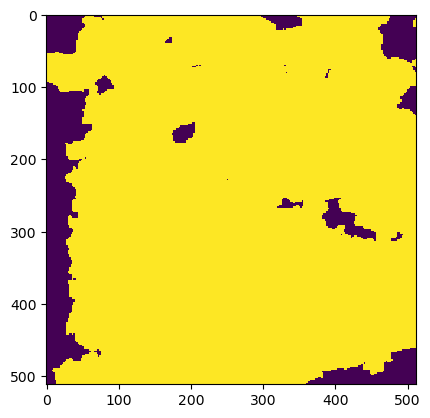

Wrote output/patches/mask/VU_S1_148-465616-0000-6304737-6000.tiff (512 x 512 pixels)


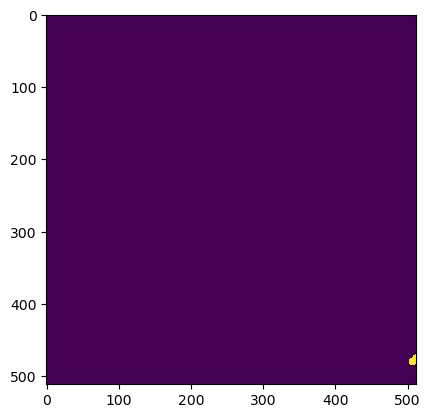

Wrote output/patches/mask/VU_S1_148-465718-4000-6304430-4000.tiff (512 x 512 pixels)


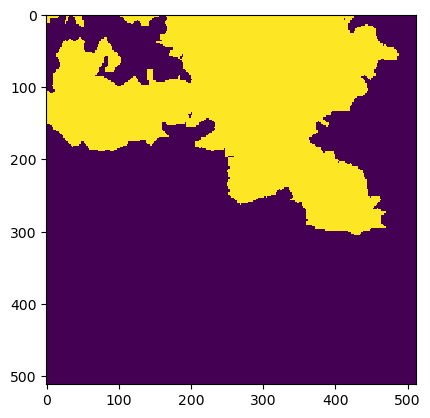

Wrote output/patches/mask/VU_S1_148-465718-4000-6304532-8000.tiff (512 x 512 pixels)


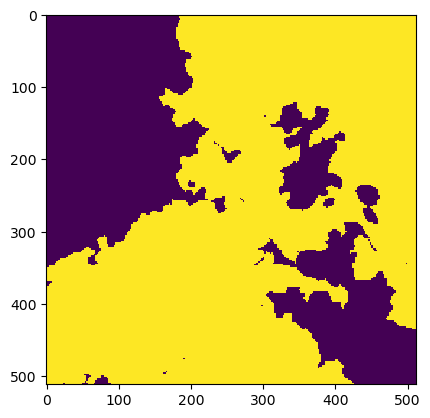

Wrote output/patches/mask/VU_S1_148-465718-4000-6304635-2000.tiff (512 x 512 pixels)


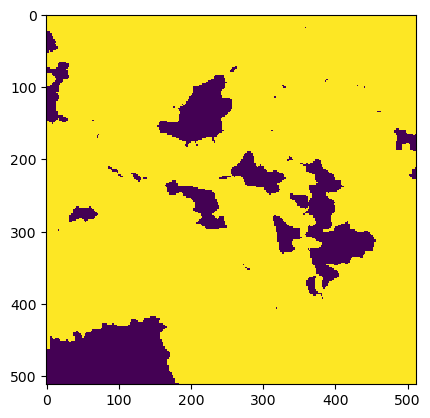

Wrote output/patches/mask/VU_S1_148-465718-4000-6304737-6000.tiff (512 x 512 pixels)


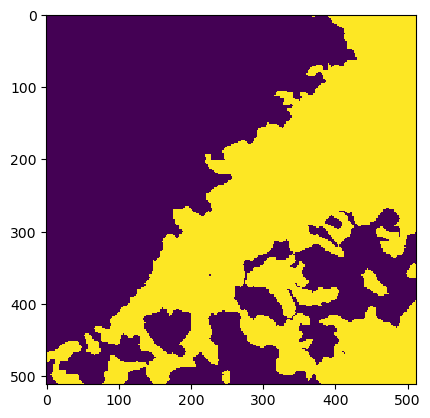

Wrote output/patches/mask/VU_S1_148-465820-8000-6304430-4000.tiff (512 x 512 pixels)


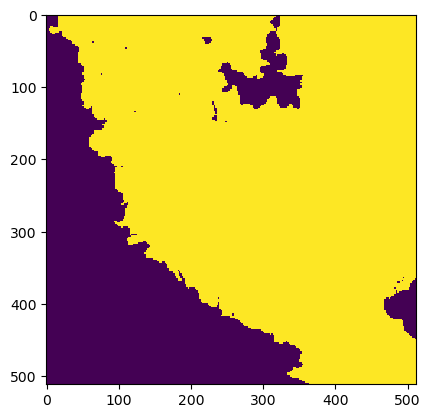

Wrote output/patches/mask/VU_S1_148-465820-8000-6304532-8000.tiff (512 x 512 pixels)


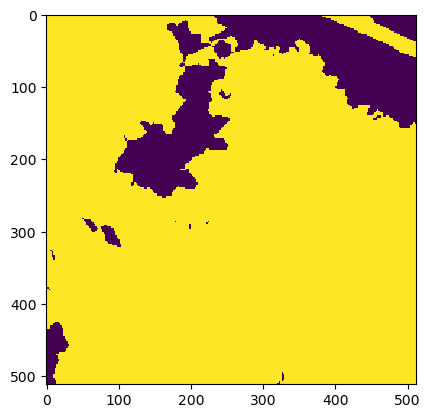

Wrote output/patches/mask/VU_S1_148-465820-8000-6304635-2000.tiff (512 x 512 pixels)


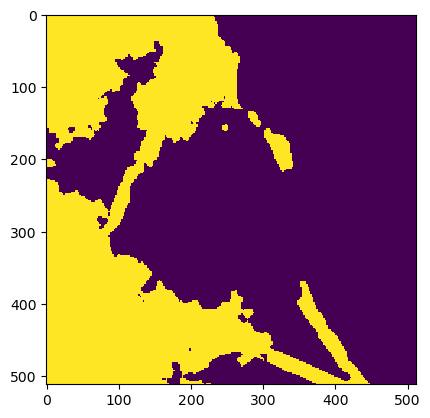

Wrote output/patches/mask/VU_S1_148-465820-8000-6304737-6000.tiff (512 x 512 pixels)


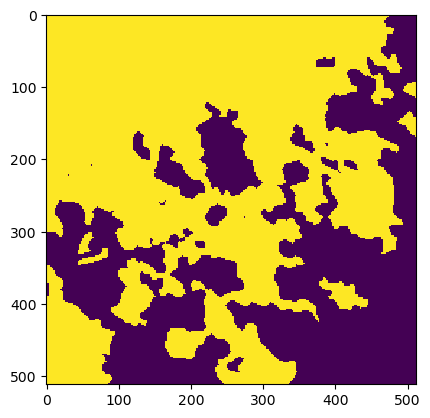

Wrote output/patches/mask/VU_S1_148-465923-2000-6304430-4000.tiff (512 x 512 pixels)


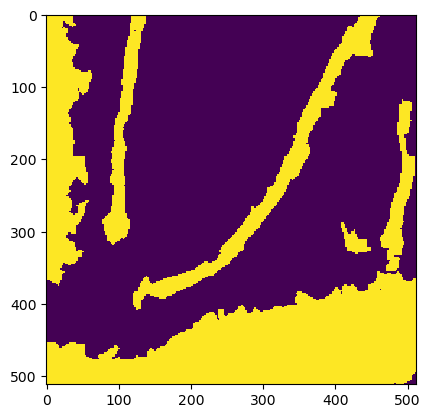

Wrote output/patches/mask/VU_S1_148-465923-2000-6304532-8000.tiff (512 x 512 pixels)


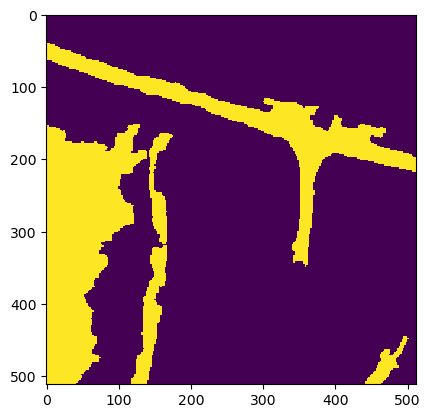

Wrote output/patches/mask/VU_S1_148-465923-2000-6304635-2000.tiff (512 x 512 pixels)


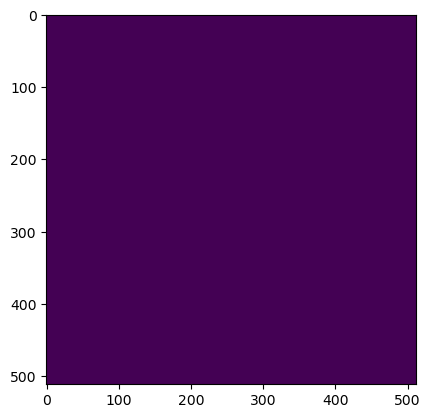

Wrote output/patches/mask/VU_S1_148-465923-2000-6304737-6000.tiff (512 x 512 pixels)
Zone VC_S1_149 Building Mask...


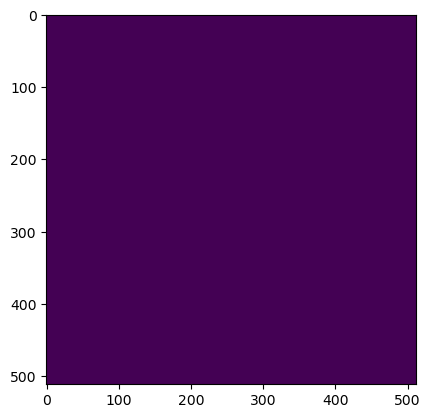

Wrote output/patches/mask/VC_S1_149-447440-0000-6304430-4000.tiff (512 x 512 pixels)


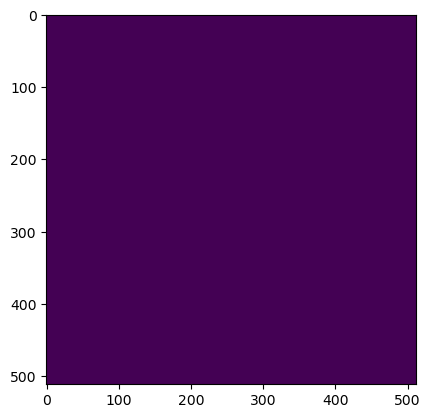

Wrote output/patches/mask/VC_S1_149-447440-0000-6304532-8000.tiff (512 x 512 pixels)


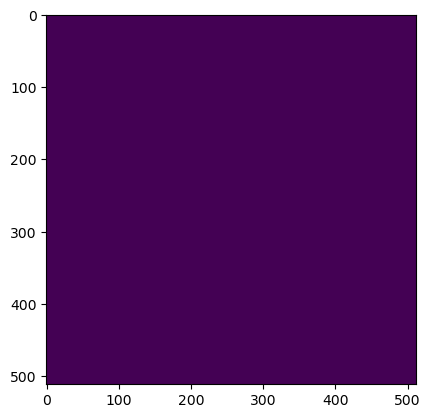

Wrote output/patches/mask/VC_S1_149-447542-4000-6304430-4000.tiff (512 x 512 pixels)


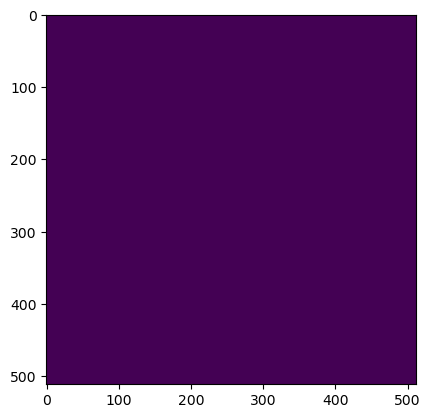

Wrote output/patches/mask/VC_S1_149-447542-4000-6304532-8000.tiff (512 x 512 pixels)
Zone CU_S1_150 Building Mask...


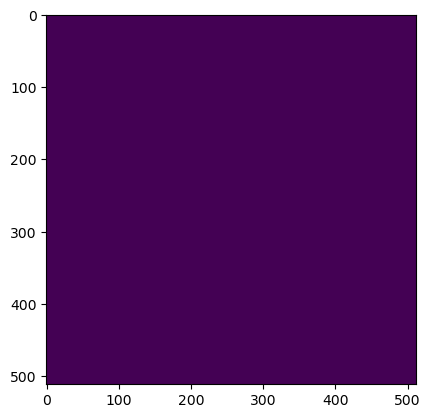

Wrote output/patches/mask/CU_S1_150-448464-0000-6304686-4000.tiff (512 x 512 pixels)


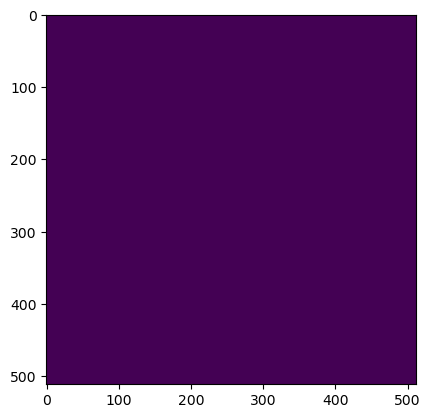

Wrote output/patches/mask/CU_S1_150-448464-0000-6304788-8000.tiff (512 x 512 pixels)


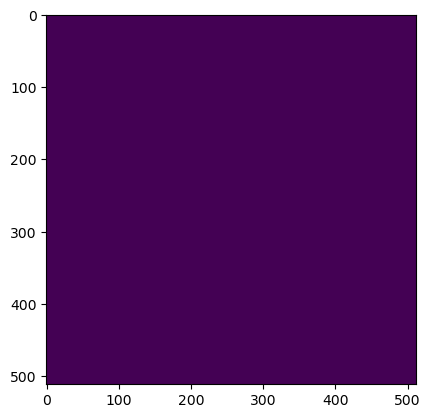

Wrote output/patches/mask/CU_S1_150-448566-4000-6304686-4000.tiff (512 x 512 pixels)


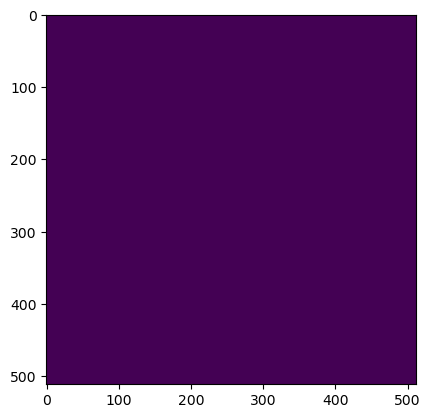

Wrote output/patches/mask/CU_S1_150-448566-4000-6304788-8000.tiff (512 x 512 pixels)


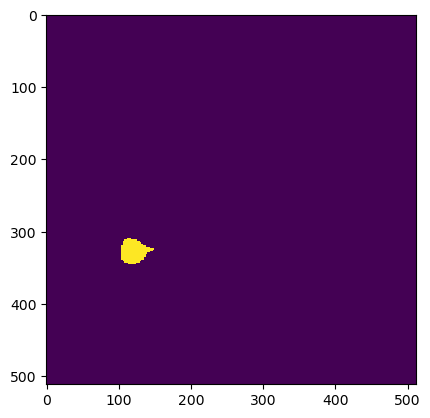

Wrote output/patches/mask/CU_S1_150-448668-8000-6304686-4000.tiff (512 x 512 pixels)


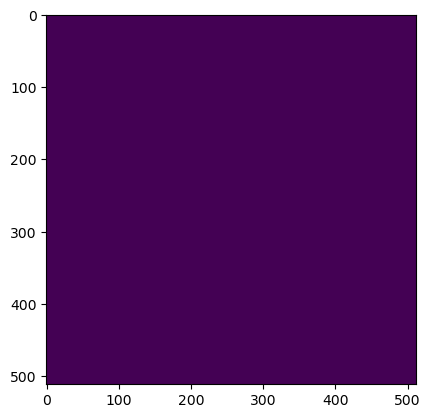

Wrote output/patches/mask/CU_S1_150-448668-8000-6304788-8000.tiff (512 x 512 pixels)


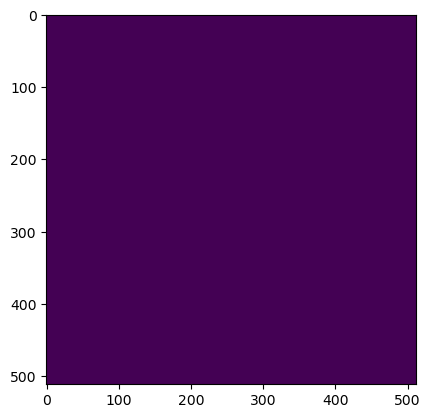

Wrote output/patches/mask/CU_S1_150-448771-2000-6304686-4000.tiff (512 x 512 pixels)


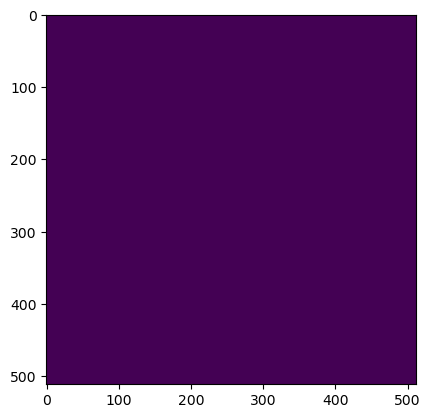

Wrote output/patches/mask/CU_S1_150-448771-2000-6304788-8000.tiff (512 x 512 pixels)
Zone NV_S1_151 Building Mask...


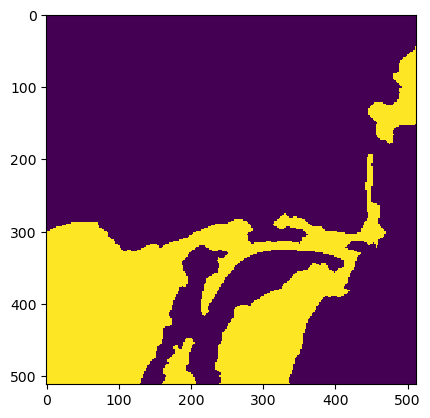

Wrote output/patches/mask/NV_S1_151-458960-0000-6304942-4000.tiff (512 x 512 pixels)


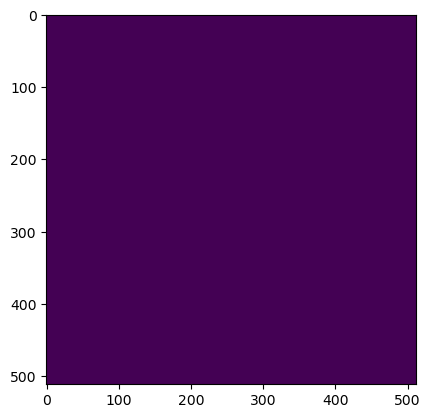

Wrote output/patches/mask/NV_S1_151-458960-0000-6305044-8000.tiff (512 x 512 pixels)


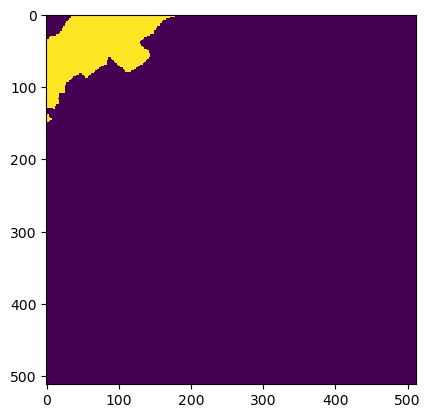

Wrote output/patches/mask/NV_S1_151-459062-4000-6304942-4000.tiff (512 x 512 pixels)


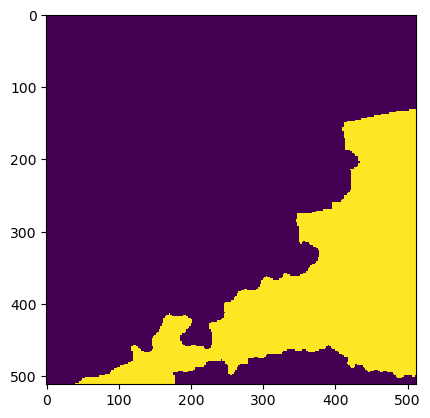

Wrote output/patches/mask/NV_S1_151-459062-4000-6305044-8000.tiff (512 x 512 pixels)


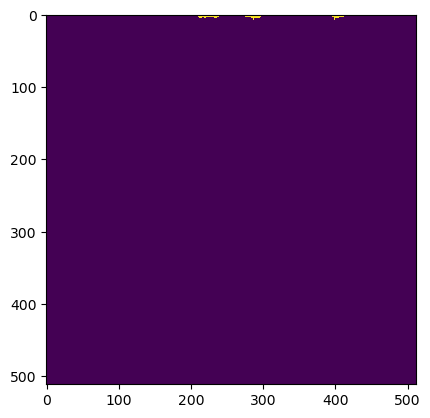

Wrote output/patches/mask/NV_S1_151-459164-8000-6304942-4000.tiff (512 x 512 pixels)


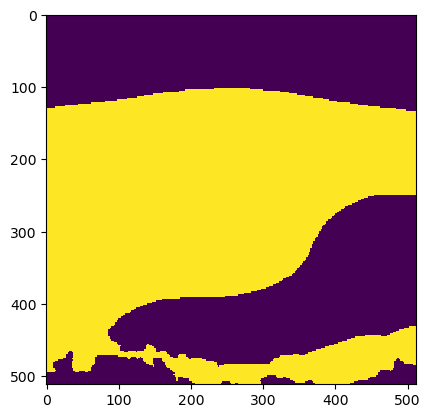

Wrote output/patches/mask/NV_S1_151-459164-8000-6305044-8000.tiff (512 x 512 pixels)


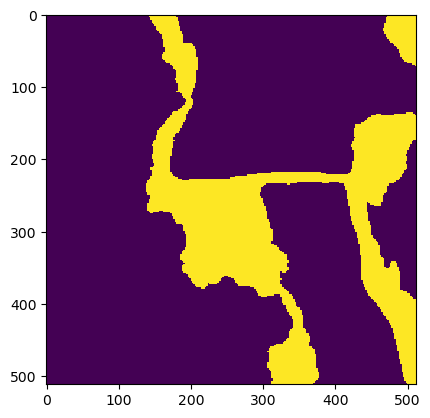

Wrote output/patches/mask/NV_S1_151-459267-2000-6304942-4000.tiff (512 x 512 pixels)


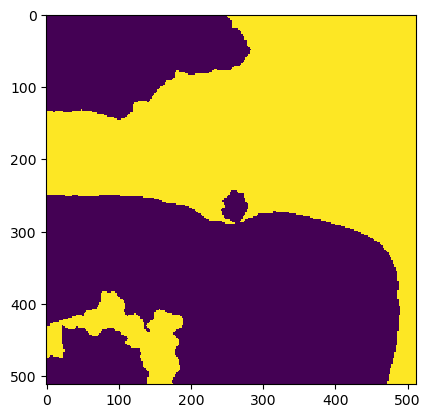

Wrote output/patches/mask/NV_S1_151-459267-2000-6305044-8000.tiff (512 x 512 pixels)
Zone CU_S1_152 Building Mask...


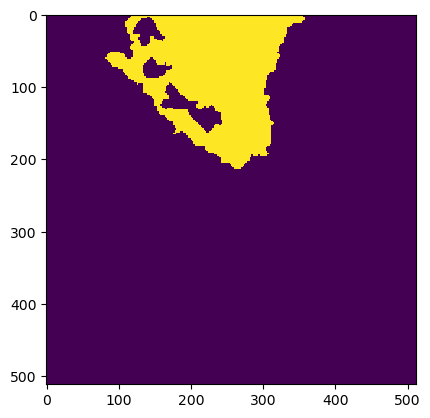

Wrote output/patches/mask/CU_S1_152-456144-0000-6304942-4000.tiff (512 x 512 pixels)


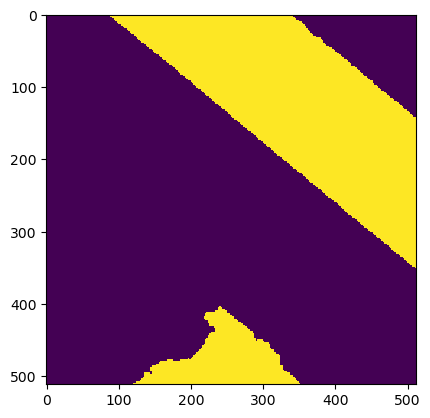

Wrote output/patches/mask/CU_S1_152-456144-0000-6305044-8000.tiff (512 x 512 pixels)


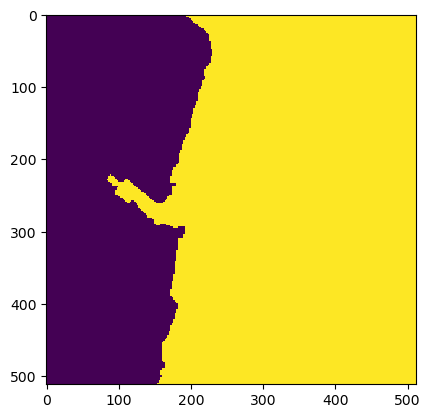

Wrote output/patches/mask/CU_S1_152-456246-4000-6304942-4000.tiff (512 x 512 pixels)


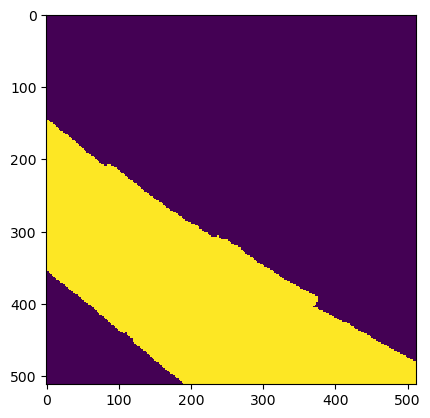

Wrote output/patches/mask/CU_S1_152-456246-4000-6305044-8000.tiff (512 x 512 pixels)
Zone CU_S1_153 Building Mask...


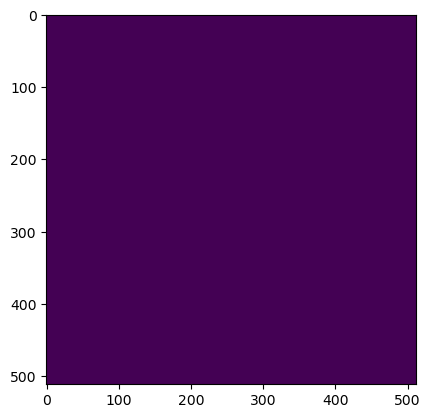

Wrote output/patches/mask/CU_S1_153-514000-0000-6305198-4000.tiff (512 x 512 pixels)


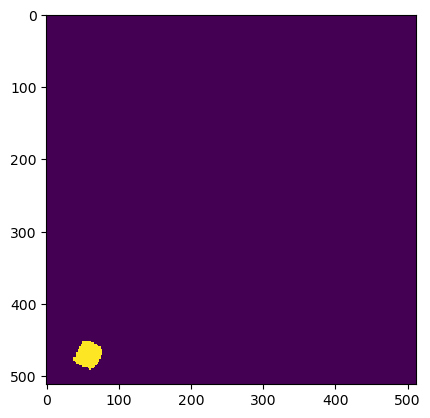

Wrote output/patches/mask/CU_S1_153-514000-0000-6305300-8000.tiff (512 x 512 pixels)


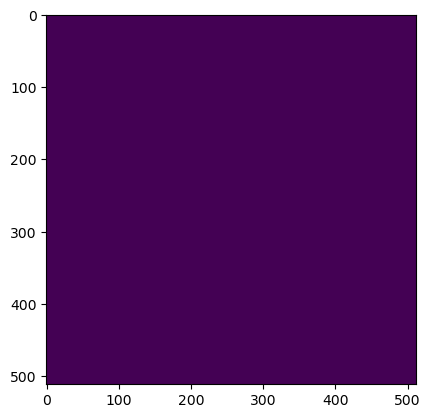

Wrote output/patches/mask/CU_S1_153-514000-0000-6305403-2000.tiff (512 x 512 pixels)


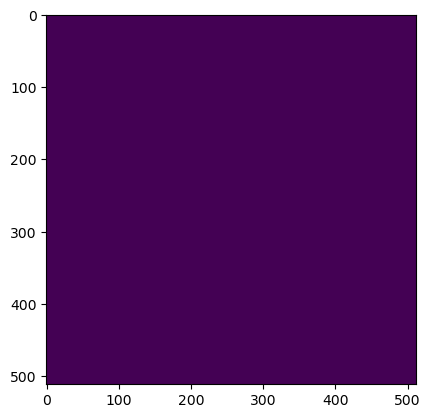

Wrote output/patches/mask/CU_S1_153-514000-0000-6305505-6000.tiff (512 x 512 pixels)


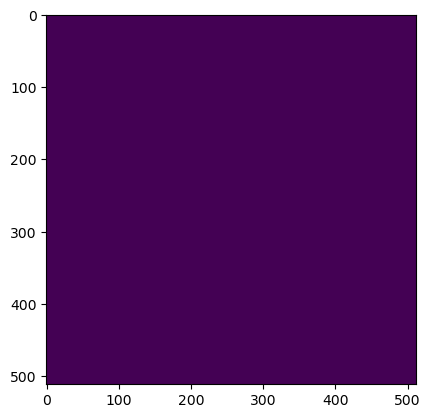

Wrote output/patches/mask/CU_S1_153-514102-4000-6305198-4000.tiff (512 x 512 pixels)


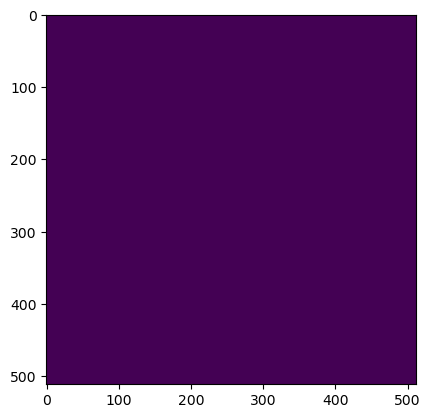

Wrote output/patches/mask/CU_S1_153-514102-4000-6305300-8000.tiff (512 x 512 pixels)


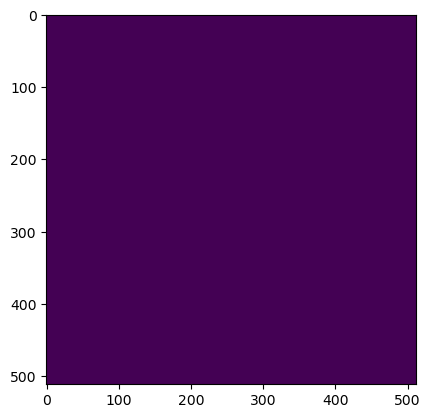

Wrote output/patches/mask/CU_S1_153-514102-4000-6305403-2000.tiff (512 x 512 pixels)


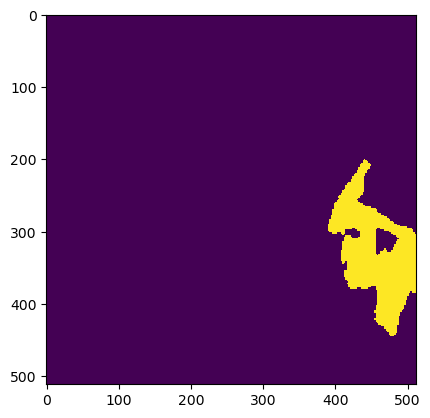

Wrote output/patches/mask/CU_S1_153-514102-4000-6305505-6000.tiff (512 x 512 pixels)


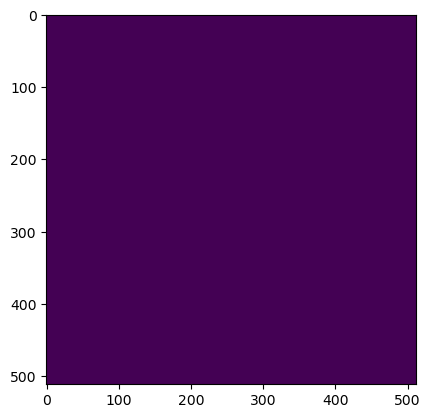

Wrote output/patches/mask/CU_S1_153-514204-8000-6305198-4000.tiff (512 x 512 pixels)


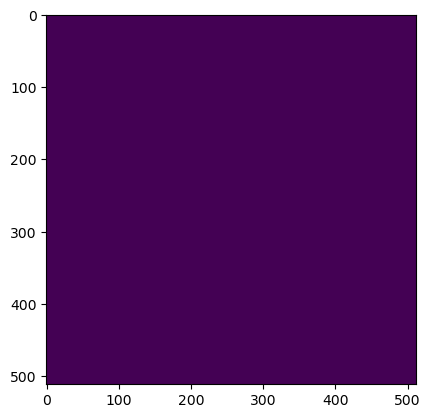

Wrote output/patches/mask/CU_S1_153-514204-8000-6305300-8000.tiff (512 x 512 pixels)


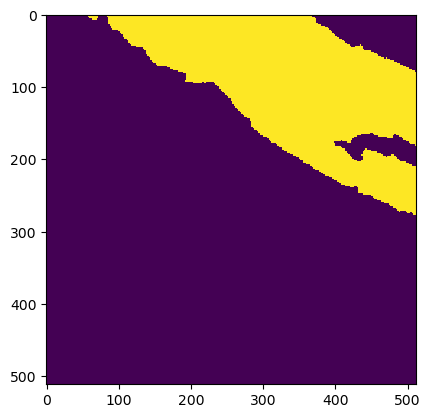

Wrote output/patches/mask/CU_S1_153-514204-8000-6305403-2000.tiff (512 x 512 pixels)


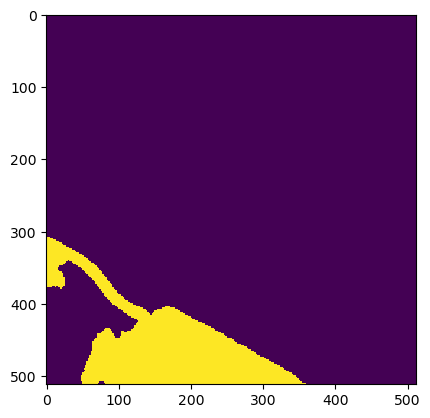

Wrote output/patches/mask/CU_S1_153-514204-8000-6305505-6000.tiff (512 x 512 pixels)


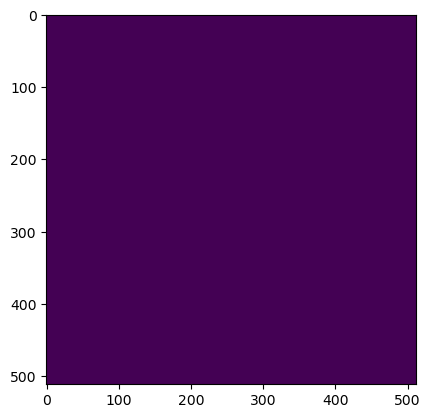

Wrote output/patches/mask/CU_S1_153-514307-2000-6305198-4000.tiff (512 x 512 pixels)


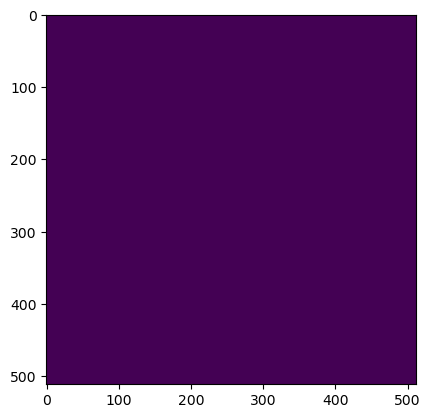

Wrote output/patches/mask/CU_S1_153-514307-2000-6305300-8000.tiff (512 x 512 pixels)


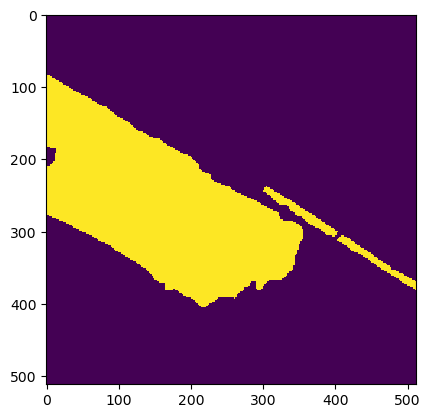

Wrote output/patches/mask/CU_S1_153-514307-2000-6305403-2000.tiff (512 x 512 pixels)


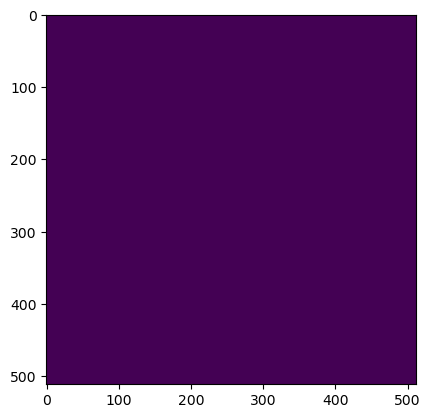

Wrote output/patches/mask/CU_S1_153-514307-2000-6305505-6000.tiff (512 x 512 pixels)
Zone VC_S1_154 Building Mask...


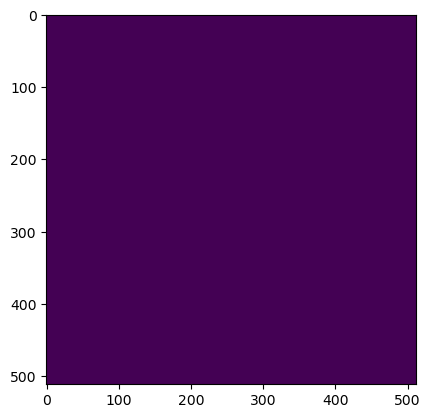

Wrote output/patches/mask/VC_S1_154-453328-0000-6305454-4000.tiff (512 x 512 pixels)


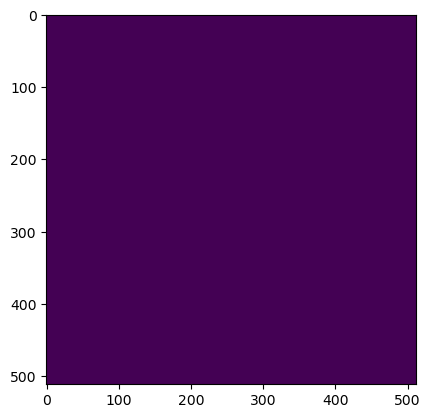

Wrote output/patches/mask/VC_S1_154-453328-0000-6305556-8000.tiff (512 x 512 pixels)


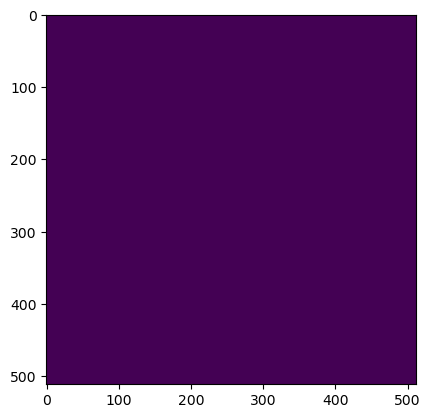

Wrote output/patches/mask/VC_S1_154-453430-4000-6305454-4000.tiff (512 x 512 pixels)


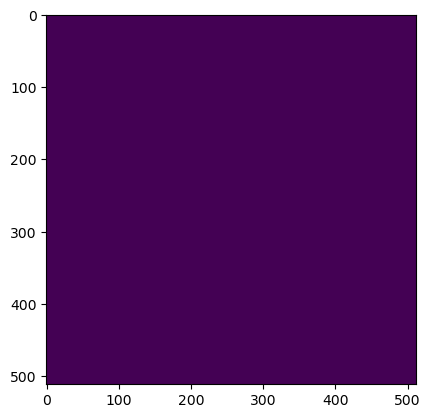

Wrote output/patches/mask/VC_S1_154-453430-4000-6305556-8000.tiff (512 x 512 pixels)
Zone UV_S1_155 Building Mask...


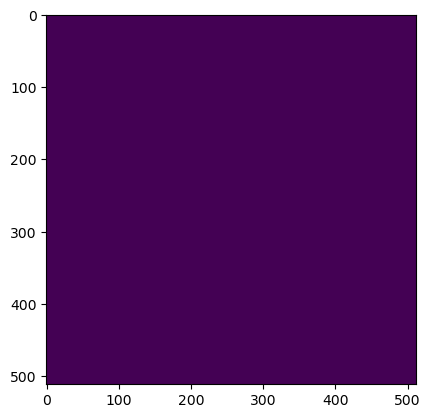

Wrote output/patches/mask/UV_S1_155-509904-0000-6305454-4000.tiff (512 x 512 pixels)


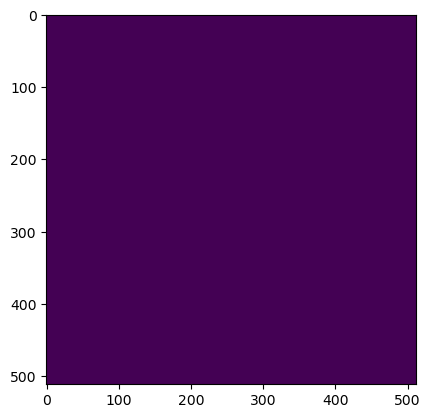

Wrote output/patches/mask/UV_S1_155-509904-0000-6305556-8000.tiff (512 x 512 pixels)


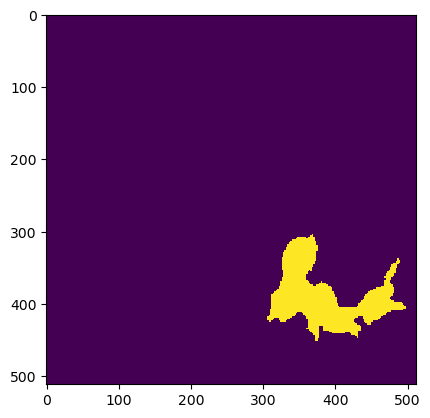

Wrote output/patches/mask/UV_S1_155-509904-0000-6305659-2000.tiff (512 x 512 pixels)


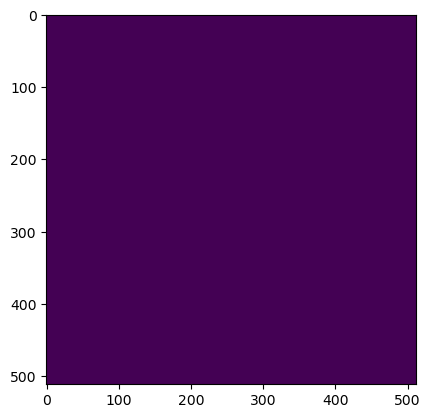

Wrote output/patches/mask/UV_S1_155-509904-0000-6305761-6000.tiff (512 x 512 pixels)


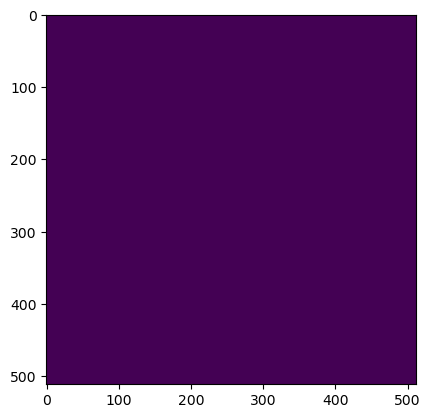

Wrote output/patches/mask/UV_S1_155-510006-4000-6305454-4000.tiff (512 x 512 pixels)


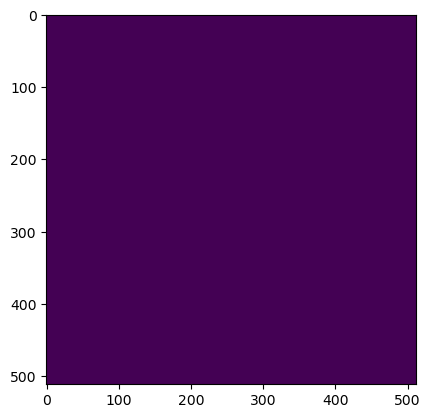

Wrote output/patches/mask/UV_S1_155-510006-4000-6305556-8000.tiff (512 x 512 pixels)


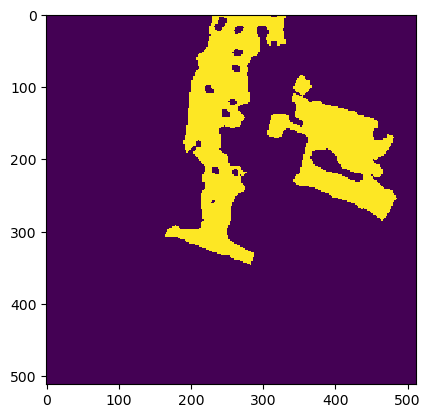

Wrote output/patches/mask/UV_S1_155-510006-4000-6305659-2000.tiff (512 x 512 pixels)


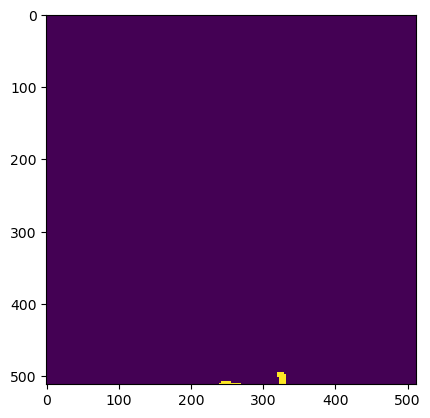

Wrote output/patches/mask/UV_S1_155-510006-4000-6305761-6000.tiff (512 x 512 pixels)
Zone CN_S1_156 Building Mask...


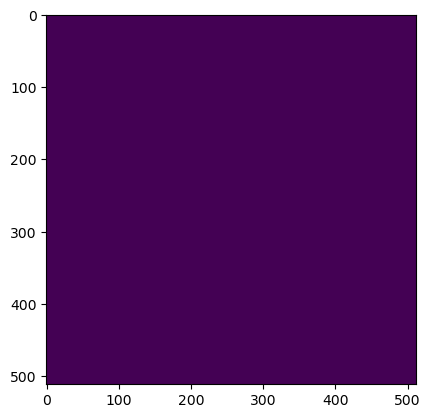

Wrote output/patches/mask/CN_S1_156-455376-0000-6307246-4000.tiff (512 x 512 pixels)


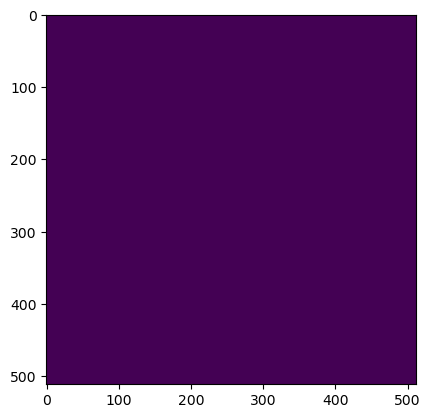

Wrote output/patches/mask/CN_S1_156-455376-0000-6307348-8000.tiff (512 x 512 pixels)


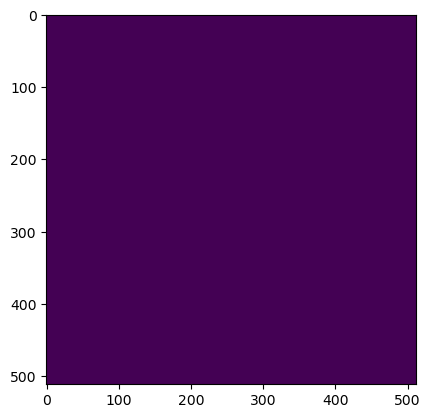

Wrote output/patches/mask/CN_S1_156-455478-4000-6307246-4000.tiff (512 x 512 pixels)


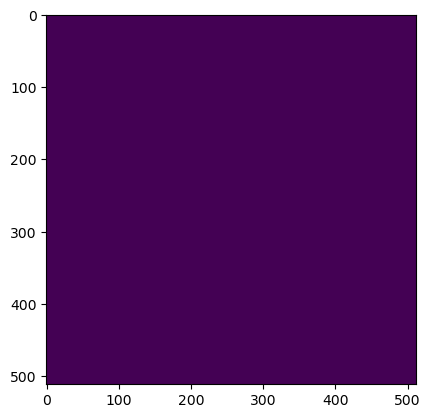

Wrote output/patches/mask/CN_S1_156-455478-4000-6307348-8000.tiff (512 x 512 pixels)
Zone CV_S1_157 Building Mask...


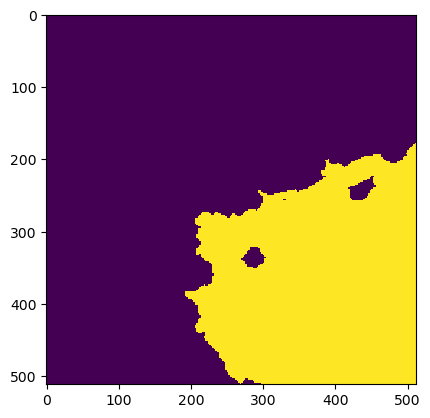

Wrote output/patches/mask/CV_S1_157-466384-0000-6307758-4000.tiff (512 x 512 pixels)


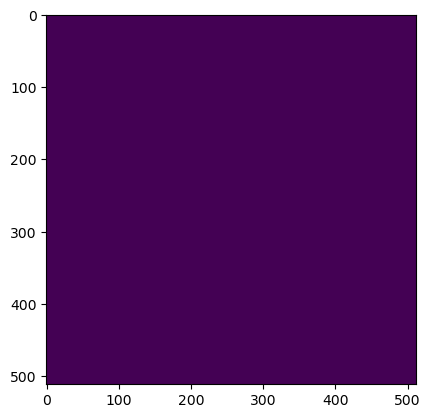

Wrote output/patches/mask/CV_S1_157-466384-0000-6307860-8000.tiff (512 x 512 pixels)


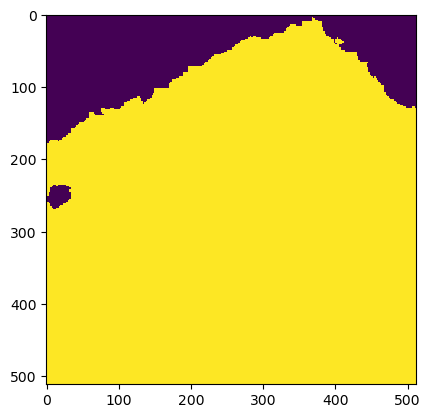

Wrote output/patches/mask/CV_S1_157-466486-4000-6307758-4000.tiff (512 x 512 pixels)


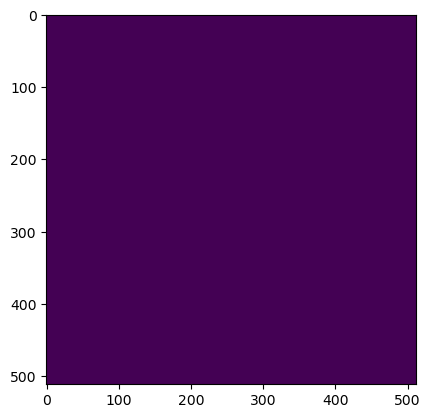

Wrote output/patches/mask/CV_S1_157-466486-4000-6307860-8000.tiff (512 x 512 pixels)
Zone CC_S1_158 Building Mask...


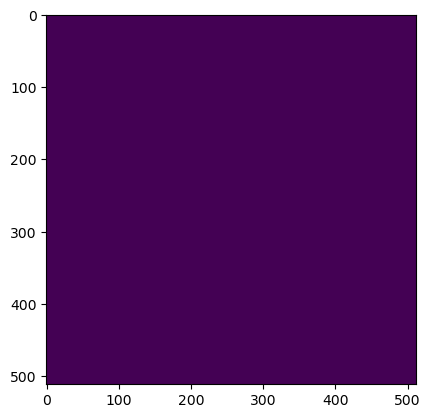

Wrote output/patches/mask/CC_S1_158-443088-0000-6308014-4000.tiff (512 x 512 pixels)


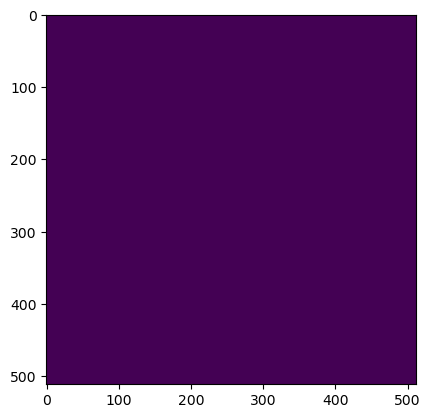

Wrote output/patches/mask/CC_S1_158-443088-0000-6308116-8000.tiff (512 x 512 pixels)


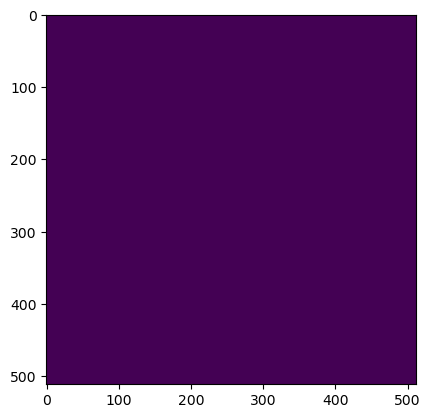

Wrote output/patches/mask/CC_S1_158-443190-4000-6308014-4000.tiff (512 x 512 pixels)


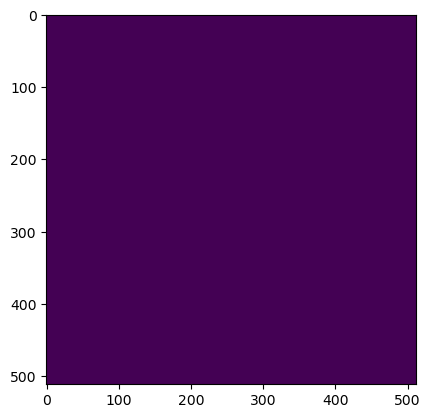

Wrote output/patches/mask/CC_S1_158-443190-4000-6308116-8000.tiff (512 x 512 pixels)


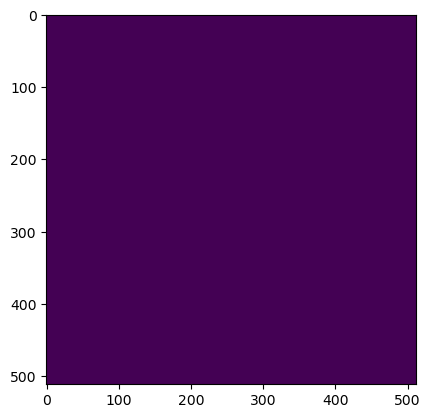

Wrote output/patches/mask/CC_S1_158-443292-8000-6308014-4000.tiff (512 x 512 pixels)


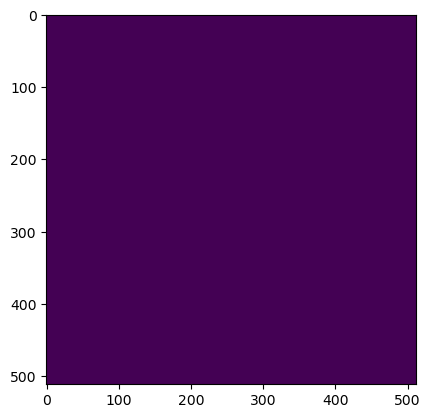

Wrote output/patches/mask/CC_S1_158-443292-8000-6308116-8000.tiff (512 x 512 pixels)


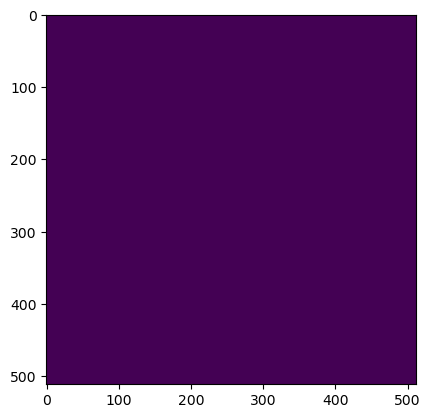

Wrote output/patches/mask/CC_S1_158-443395-2000-6308014-4000.tiff (512 x 512 pixels)


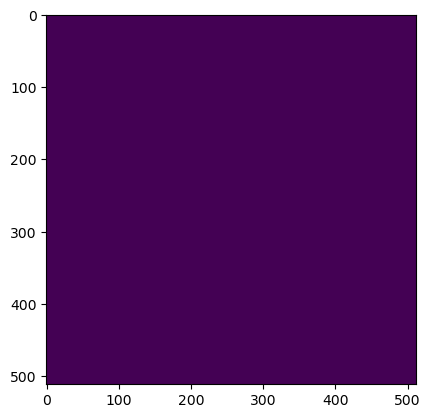

Wrote output/patches/mask/CC_S1_158-443395-2000-6308116-8000.tiff (512 x 512 pixels)
Zone UV_S1_159 Building Mask...


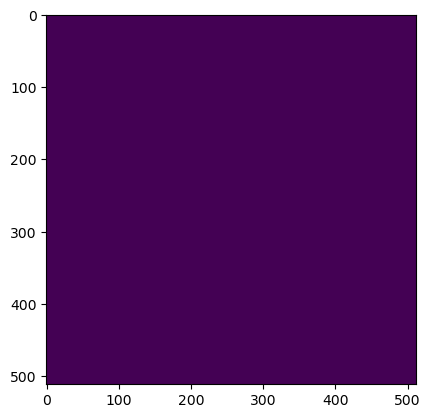

Wrote output/patches/mask/UV_S1_159-457424-0000-6308270-4000.tiff (512 x 512 pixels)


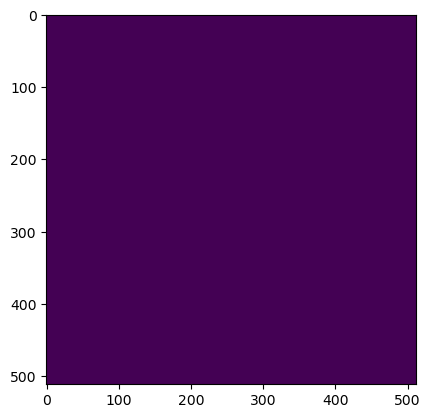

Wrote output/patches/mask/UV_S1_159-457424-0000-6308372-8000.tiff (512 x 512 pixels)


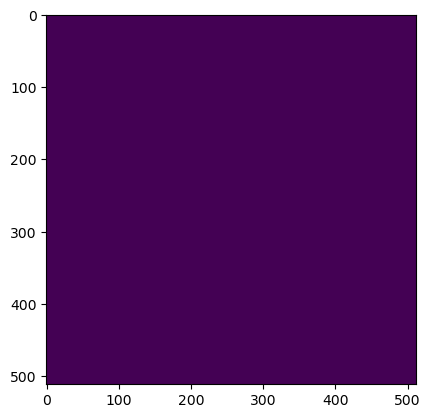

Wrote output/patches/mask/UV_S1_159-457424-0000-6308475-2000.tiff (512 x 512 pixels)


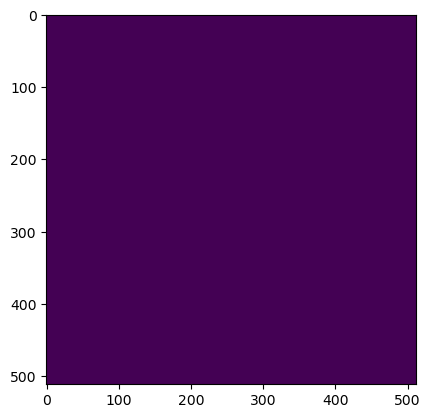

Wrote output/patches/mask/UV_S1_159-457424-0000-6308577-6000.tiff (512 x 512 pixels)


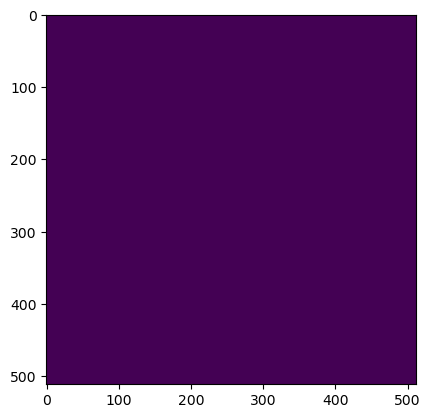

Wrote output/patches/mask/UV_S1_159-457526-4000-6308270-4000.tiff (512 x 512 pixels)


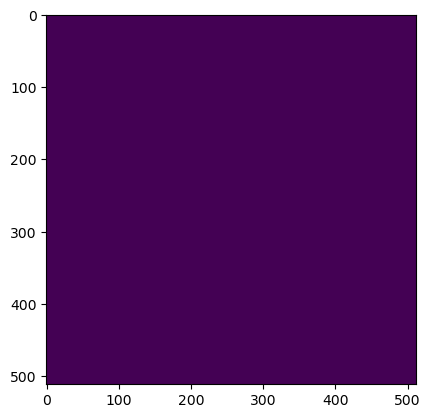

Wrote output/patches/mask/UV_S1_159-457526-4000-6308372-8000.tiff (512 x 512 pixels)


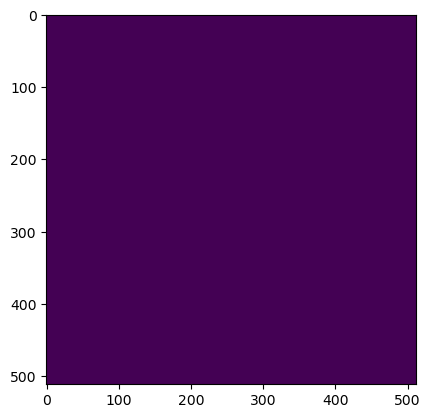

Wrote output/patches/mask/UV_S1_159-457526-4000-6308475-2000.tiff (512 x 512 pixels)


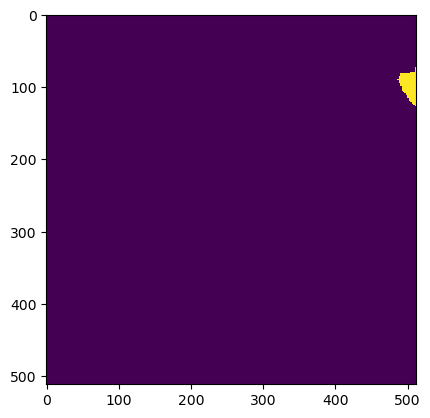

Wrote output/patches/mask/UV_S1_159-457526-4000-6308577-6000.tiff (512 x 512 pixels)


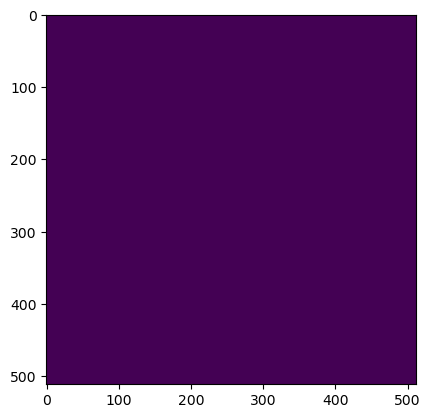

Wrote output/patches/mask/UV_S1_159-457628-8000-6308270-4000.tiff (512 x 512 pixels)


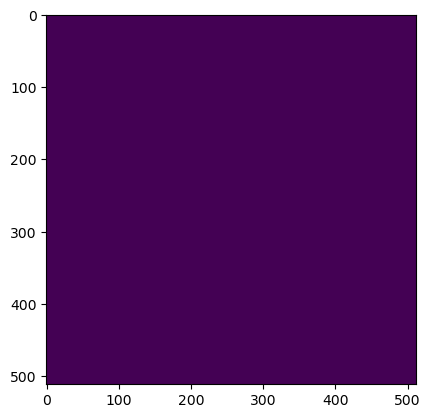

Wrote output/patches/mask/UV_S1_159-457628-8000-6308372-8000.tiff (512 x 512 pixels)


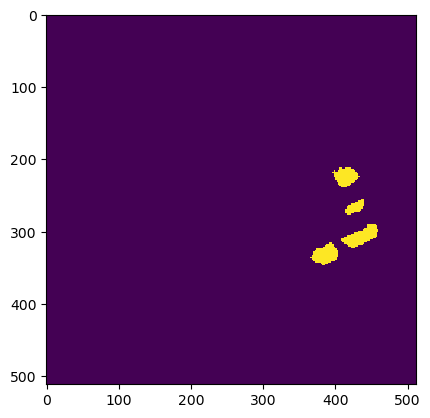

Wrote output/patches/mask/UV_S1_159-457628-8000-6308475-2000.tiff (512 x 512 pixels)


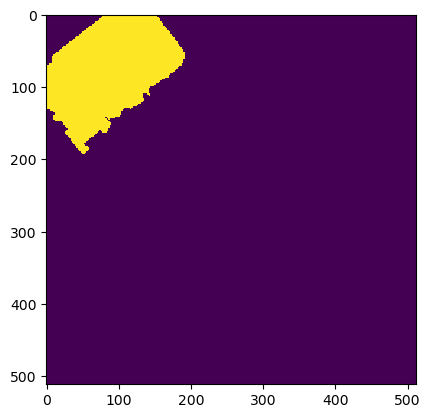

Wrote output/patches/mask/UV_S1_159-457628-8000-6308577-6000.tiff (512 x 512 pixels)


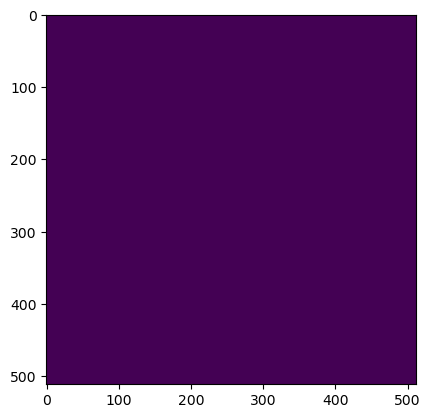

Wrote output/patches/mask/UV_S1_159-457731-2000-6308270-4000.tiff (512 x 512 pixels)


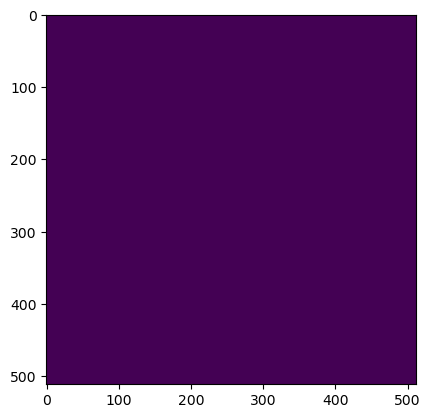

Wrote output/patches/mask/UV_S1_159-457731-2000-6308372-8000.tiff (512 x 512 pixels)


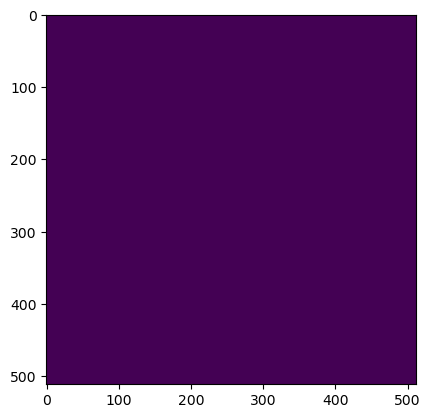

Wrote output/patches/mask/UV_S1_159-457731-2000-6308475-2000.tiff (512 x 512 pixels)


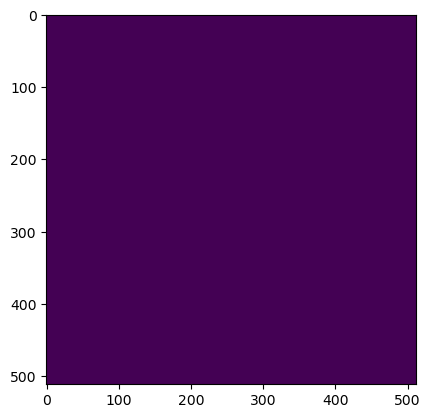

Wrote output/patches/mask/UV_S1_159-457731-2000-6308577-6000.tiff (512 x 512 pixels)


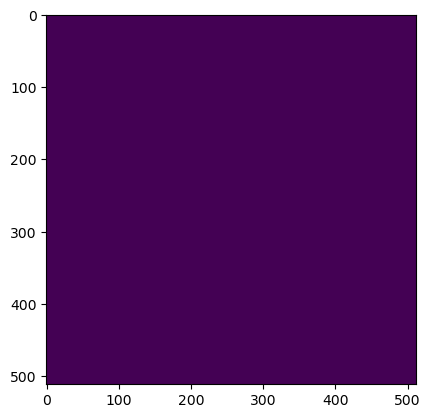

Wrote output/patches/mask/UV_S1_159-457833-6000-6308270-4000.tiff (512 x 512 pixels)


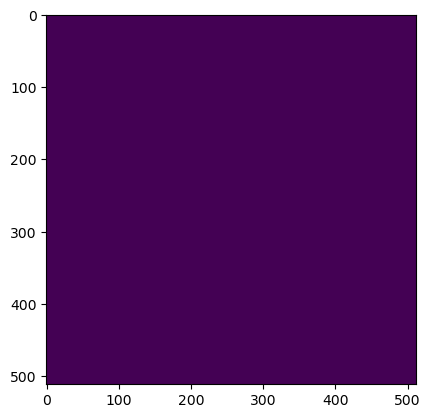

Wrote output/patches/mask/UV_S1_159-457833-6000-6308372-8000.tiff (512 x 512 pixels)


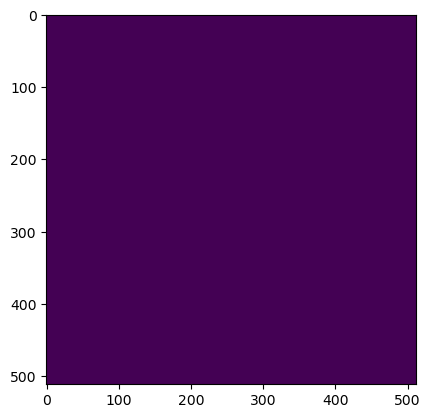

Wrote output/patches/mask/UV_S1_159-457833-6000-6308475-2000.tiff (512 x 512 pixels)


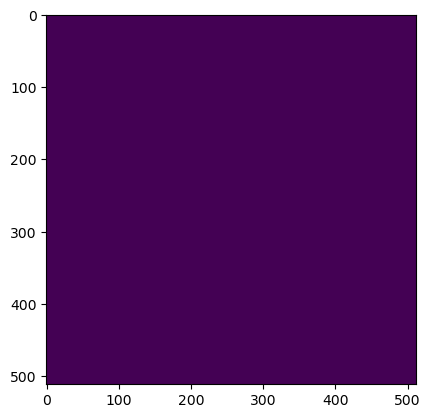

Wrote output/patches/mask/UV_S1_159-457833-6000-6308577-6000.tiff (512 x 512 pixels)


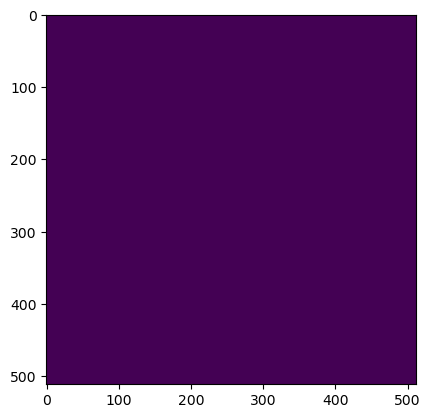

Wrote output/patches/mask/UV_S1_159-457936-0000-6308270-4000.tiff (512 x 512 pixels)


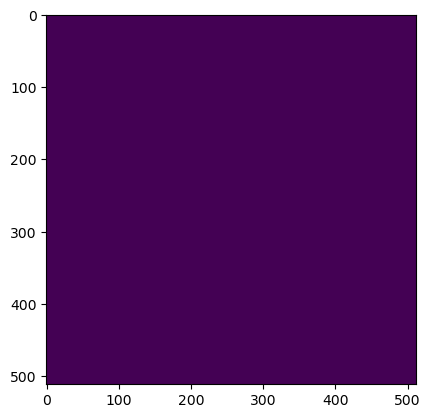

Wrote output/patches/mask/UV_S1_159-457936-0000-6308372-8000.tiff (512 x 512 pixels)


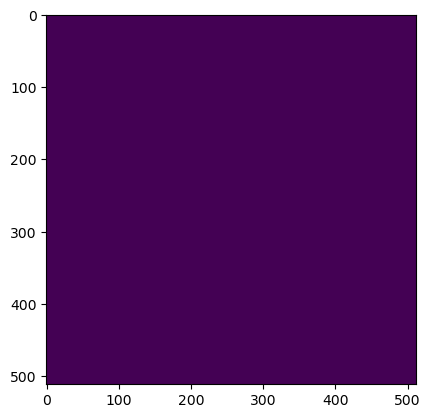

Wrote output/patches/mask/UV_S1_159-457936-0000-6308475-2000.tiff (512 x 512 pixels)


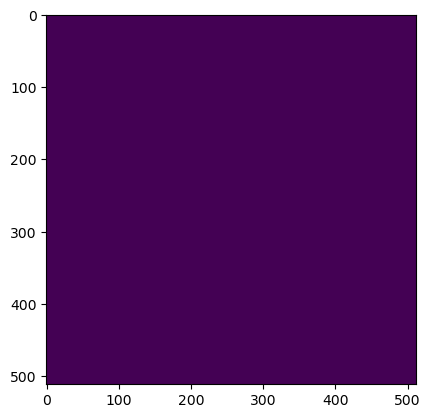

Wrote output/patches/mask/UV_S1_159-457936-0000-6308577-6000.tiff (512 x 512 pixels)


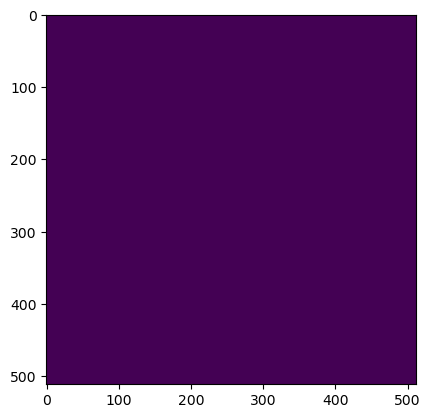

Wrote output/patches/mask/UV_S1_159-458038-4000-6308270-4000.tiff (512 x 512 pixels)


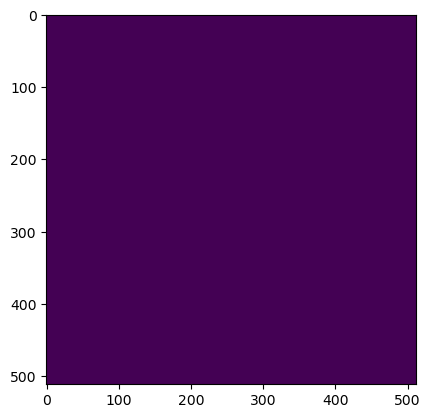

Wrote output/patches/mask/UV_S1_159-458038-4000-6308372-8000.tiff (512 x 512 pixels)


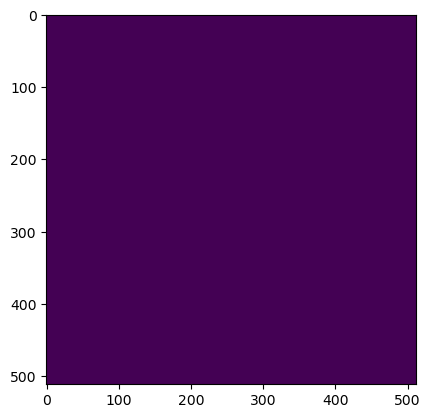

Wrote output/patches/mask/UV_S1_159-458038-4000-6308475-2000.tiff (512 x 512 pixels)


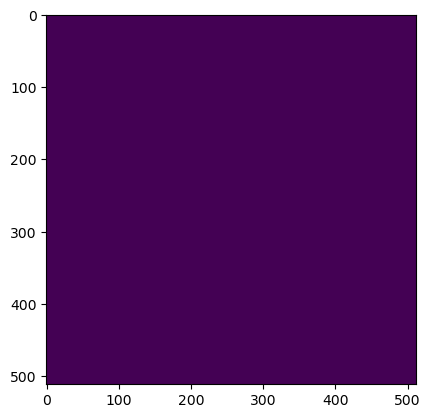

Wrote output/patches/mask/UV_S1_159-458038-4000-6308577-6000.tiff (512 x 512 pixels)


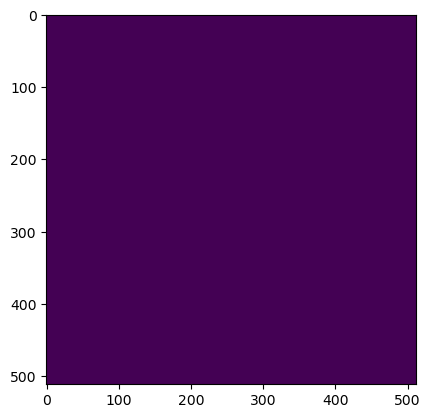

Wrote output/patches/mask/UV_S1_159-458140-8000-6308270-4000.tiff (512 x 512 pixels)


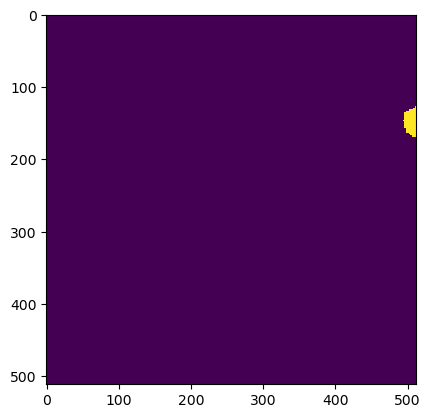

Wrote output/patches/mask/UV_S1_159-458140-8000-6308372-8000.tiff (512 x 512 pixels)


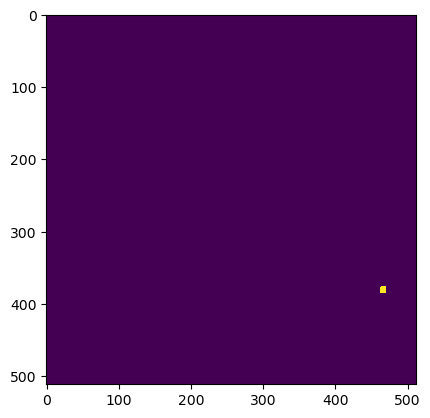

Wrote output/patches/mask/UV_S1_159-458140-8000-6308475-2000.tiff (512 x 512 pixels)


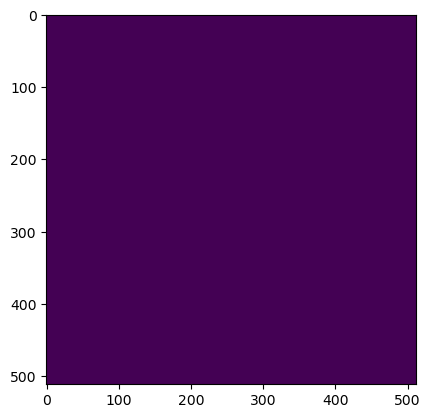

Wrote output/patches/mask/UV_S1_159-458140-8000-6308577-6000.tiff (512 x 512 pixels)


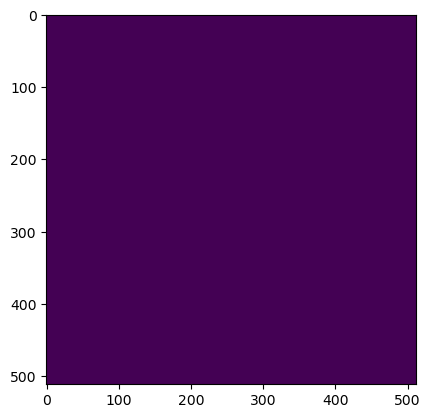

Wrote output/patches/mask/UV_S1_159-458243-2000-6308270-4000.tiff (512 x 512 pixels)


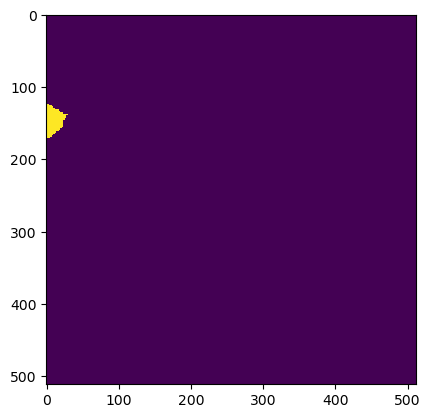

Wrote output/patches/mask/UV_S1_159-458243-2000-6308372-8000.tiff (512 x 512 pixels)


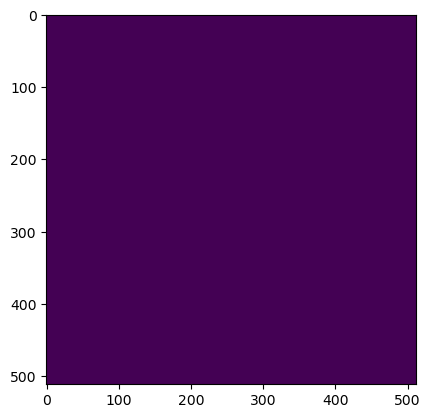

Wrote output/patches/mask/UV_S1_159-458243-2000-6308475-2000.tiff (512 x 512 pixels)


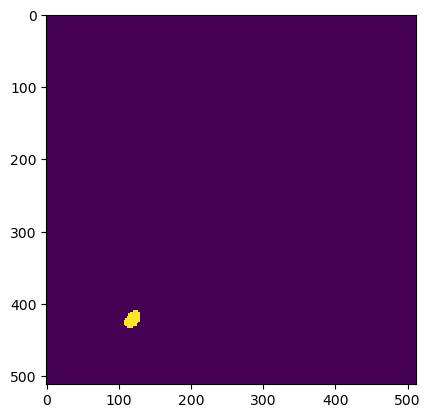

Wrote output/patches/mask/UV_S1_159-458243-2000-6308577-6000.tiff (512 x 512 pixels)
Zone VV_S1_160 Building Mask...


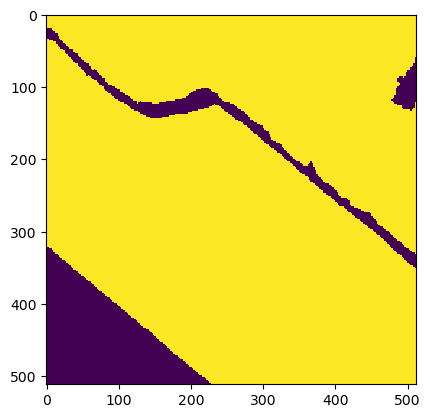

Wrote output/patches/mask/VV_S1_160-463312-0000-6308782-4000.tiff (512 x 512 pixels)


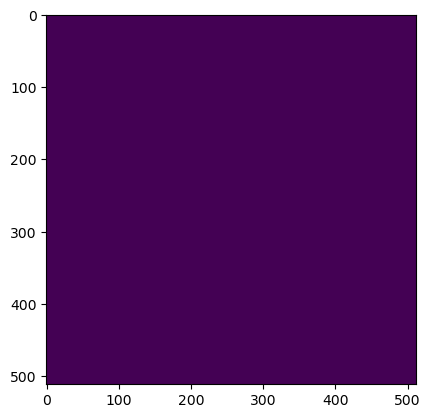

Wrote output/patches/mask/VV_S1_160-463312-0000-6308884-8000.tiff (512 x 512 pixels)


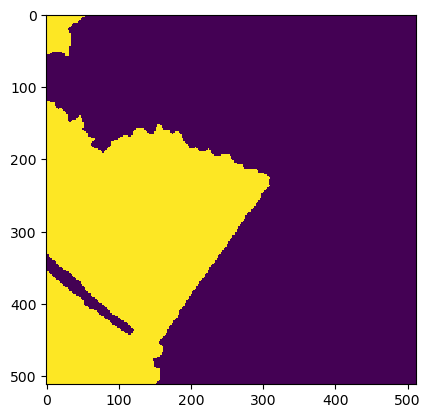

Wrote output/patches/mask/VV_S1_160-463414-4000-6308782-4000.tiff (512 x 512 pixels)


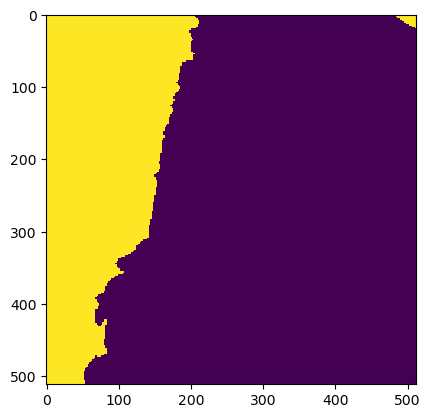

Wrote output/patches/mask/VV_S1_160-463414-4000-6308884-8000.tiff (512 x 512 pixels)
Zone UU_S1_161 Building Mask...


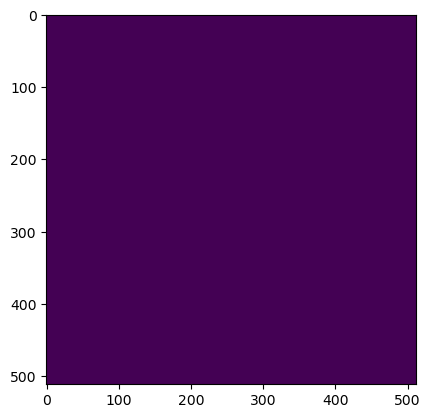

Wrote output/patches/mask/UU_S1_161-511696-0000-6309294-4000.tiff (512 x 512 pixels)


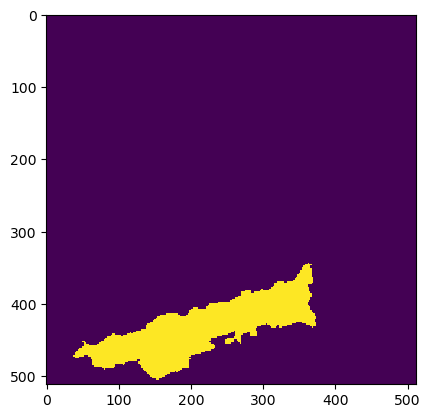

Wrote output/patches/mask/UU_S1_161-511696-0000-6309396-8000.tiff (512 x 512 pixels)


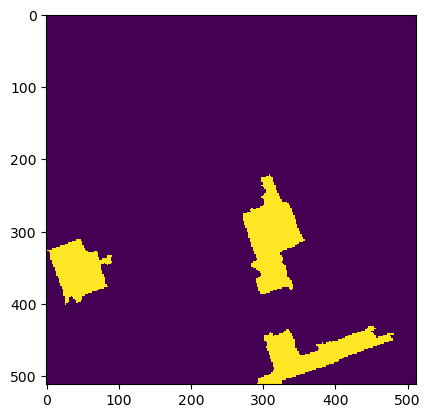

Wrote output/patches/mask/UU_S1_161-511798-4000-6309294-4000.tiff (512 x 512 pixels)


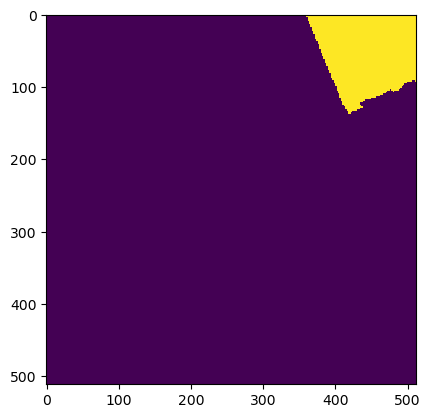

Wrote output/patches/mask/UU_S1_161-511798-4000-6309396-8000.tiff (512 x 512 pixels)
Zone VU_S1_162 Building Mask...


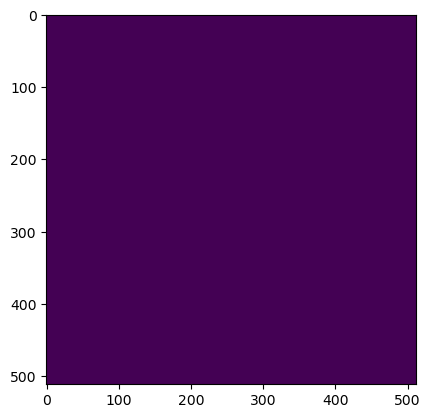

Wrote output/patches/mask/VU_S1_162-457168-0000-6309294-4000.tiff (512 x 512 pixels)


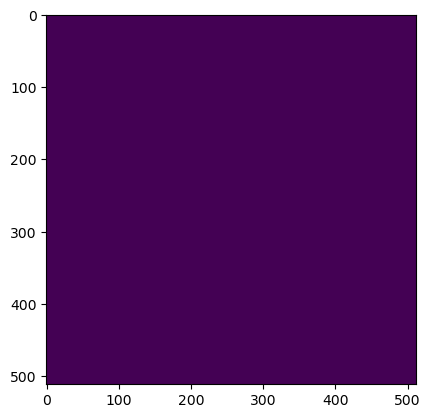

Wrote output/patches/mask/VU_S1_162-457168-0000-6309396-8000.tiff (512 x 512 pixels)


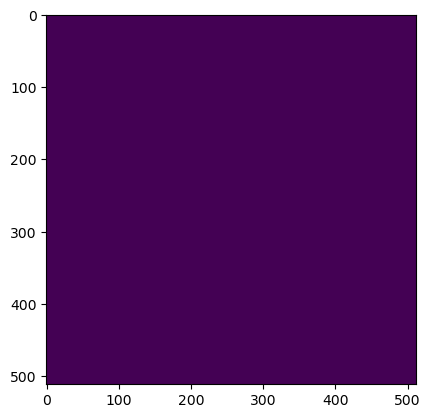

Wrote output/patches/mask/VU_S1_162-457168-0000-6309499-2000.tiff (512 x 512 pixels)


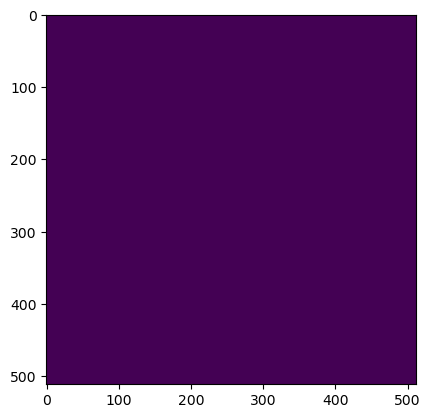

Wrote output/patches/mask/VU_S1_162-457168-0000-6309601-6000.tiff (512 x 512 pixels)


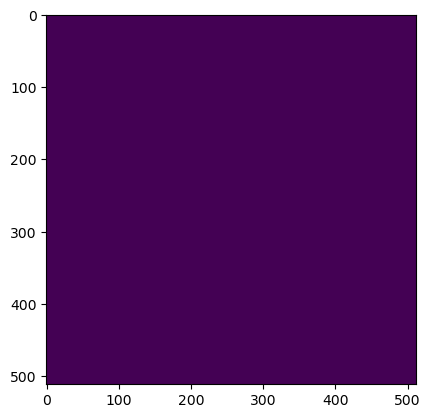

Wrote output/patches/mask/VU_S1_162-457270-4000-6309294-4000.tiff (512 x 512 pixels)


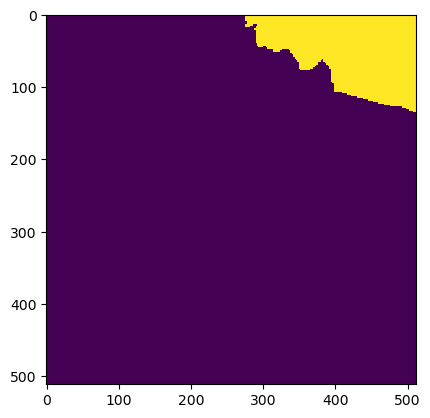

Wrote output/patches/mask/VU_S1_162-457270-4000-6309396-8000.tiff (512 x 512 pixels)


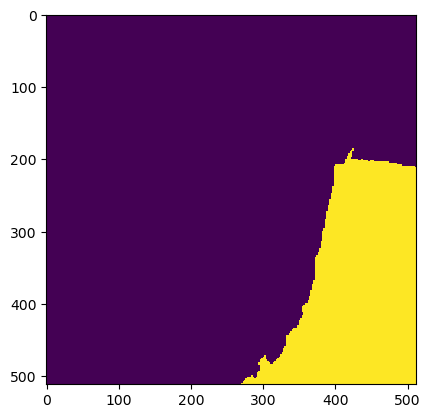

Wrote output/patches/mask/VU_S1_162-457270-4000-6309499-2000.tiff (512 x 512 pixels)


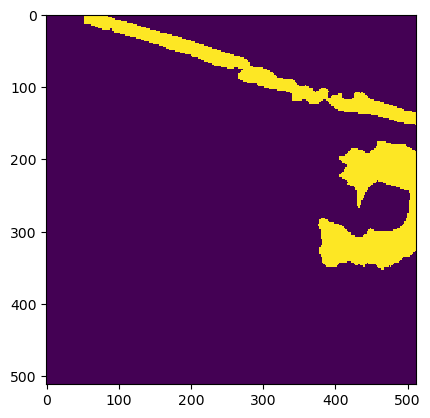

Wrote output/patches/mask/VU_S1_162-457270-4000-6309601-6000.tiff (512 x 512 pixels)


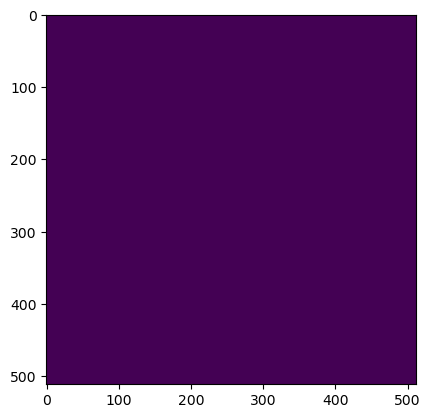

Wrote output/patches/mask/VU_S1_162-457372-8000-6309294-4000.tiff (512 x 512 pixels)


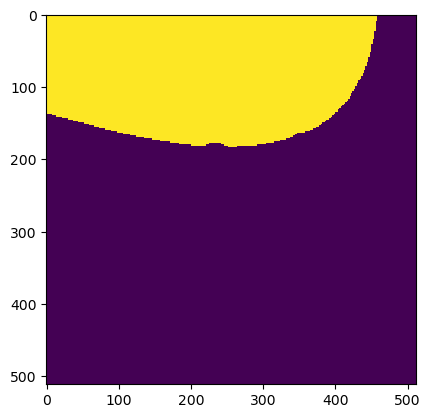

Wrote output/patches/mask/VU_S1_162-457372-8000-6309396-8000.tiff (512 x 512 pixels)


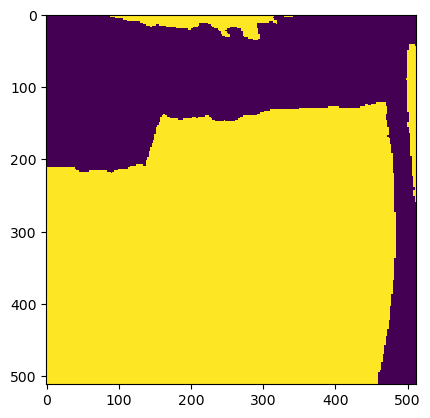

Wrote output/patches/mask/VU_S1_162-457372-8000-6309499-2000.tiff (512 x 512 pixels)


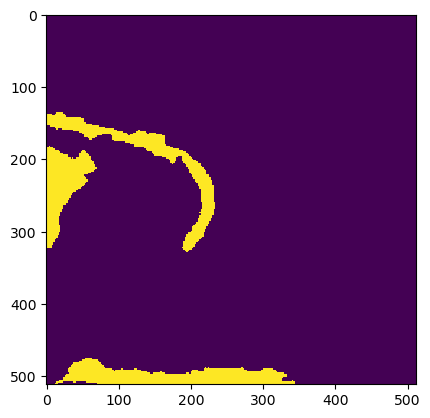

Wrote output/patches/mask/VU_S1_162-457372-8000-6309601-6000.tiff (512 x 512 pixels)


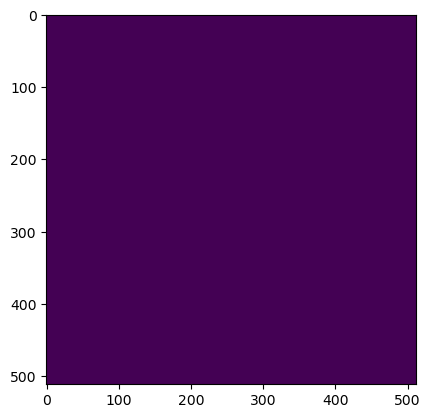

Wrote output/patches/mask/VU_S1_162-457475-2000-6309294-4000.tiff (512 x 512 pixels)


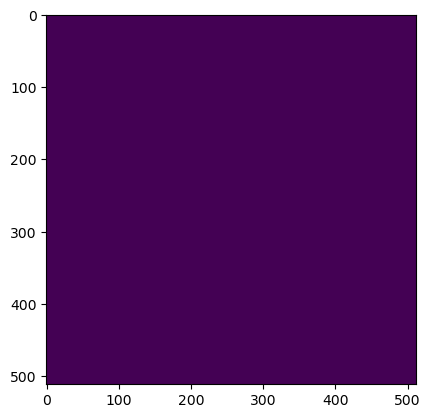

Wrote output/patches/mask/VU_S1_162-457475-2000-6309396-8000.tiff (512 x 512 pixels)


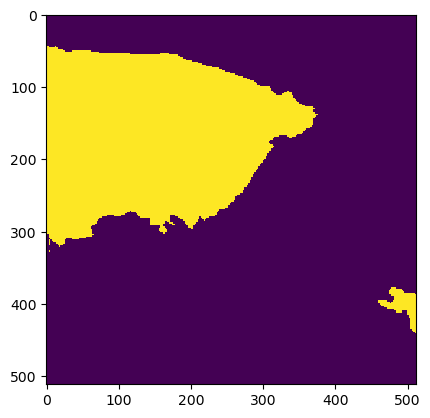

Wrote output/patches/mask/VU_S1_162-457475-2000-6309499-2000.tiff (512 x 512 pixels)


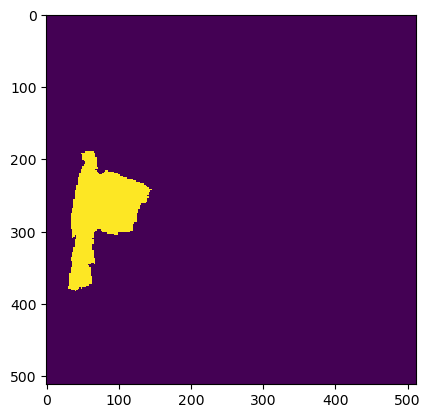

Wrote output/patches/mask/VU_S1_162-457475-2000-6309601-6000.tiff (512 x 512 pixels)


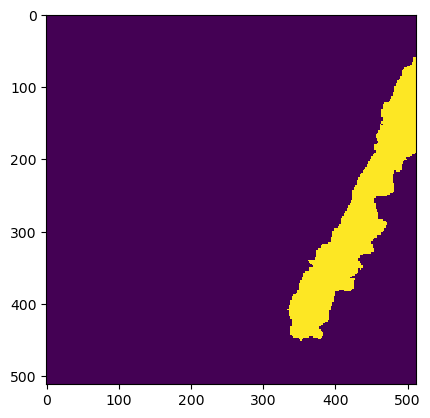

Wrote output/patches/mask/VU_S1_162-457577-6000-6309294-4000.tiff (512 x 512 pixels)


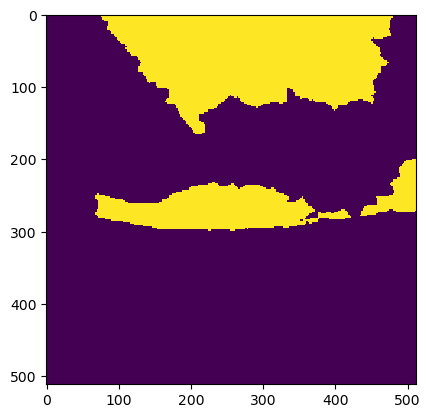

Wrote output/patches/mask/VU_S1_162-457577-6000-6309396-8000.tiff (512 x 512 pixels)


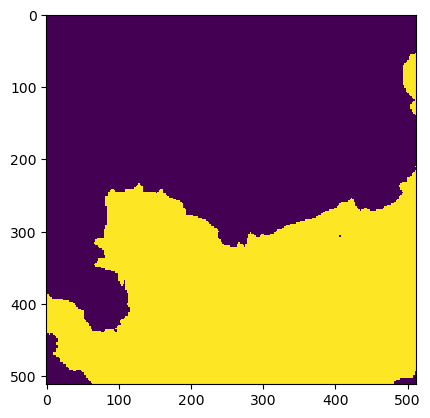

Wrote output/patches/mask/VU_S1_162-457577-6000-6309499-2000.tiff (512 x 512 pixels)


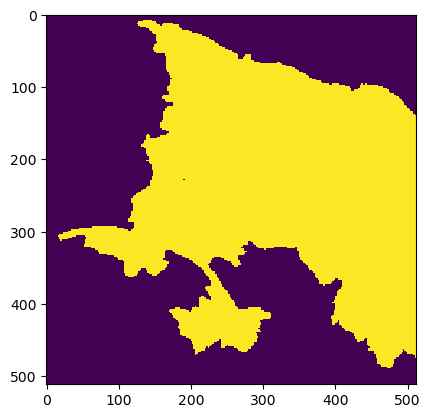

Wrote output/patches/mask/VU_S1_162-457577-6000-6309601-6000.tiff (512 x 512 pixels)


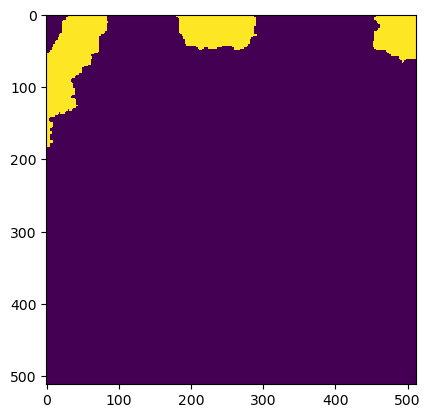

Wrote output/patches/mask/VU_S1_162-457680-0000-6309294-4000.tiff (512 x 512 pixels)


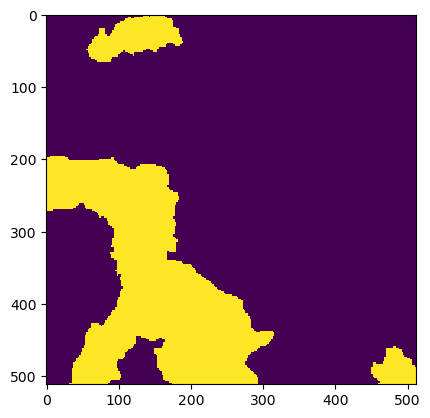

Wrote output/patches/mask/VU_S1_162-457680-0000-6309396-8000.tiff (512 x 512 pixels)


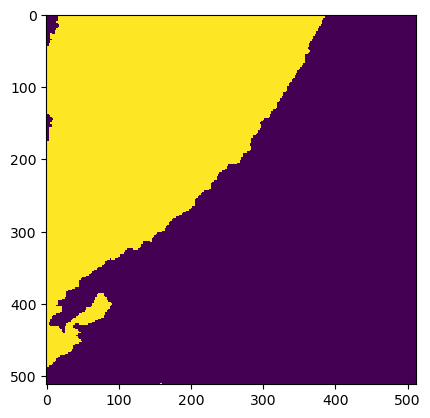

Wrote output/patches/mask/VU_S1_162-457680-0000-6309499-2000.tiff (512 x 512 pixels)


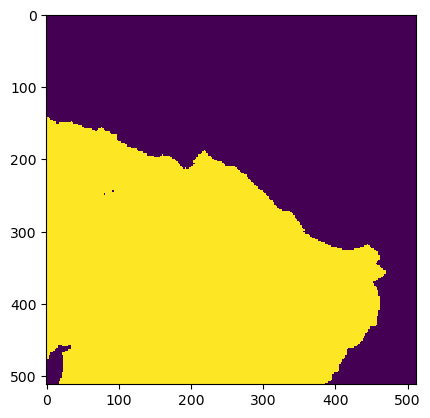

Wrote output/patches/mask/VU_S1_162-457680-0000-6309601-6000.tiff (512 x 512 pixels)


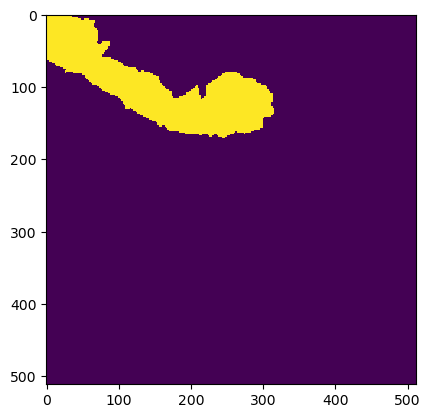

Wrote output/patches/mask/VU_S1_162-457782-4000-6309294-4000.tiff (512 x 512 pixels)


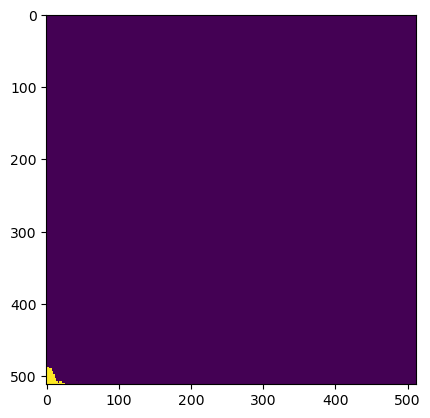

Wrote output/patches/mask/VU_S1_162-457782-4000-6309396-8000.tiff (512 x 512 pixels)


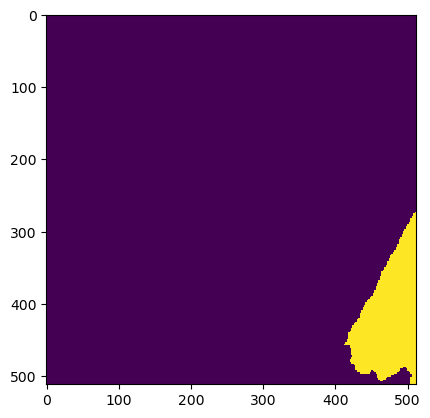

Wrote output/patches/mask/VU_S1_162-457782-4000-6309499-2000.tiff (512 x 512 pixels)


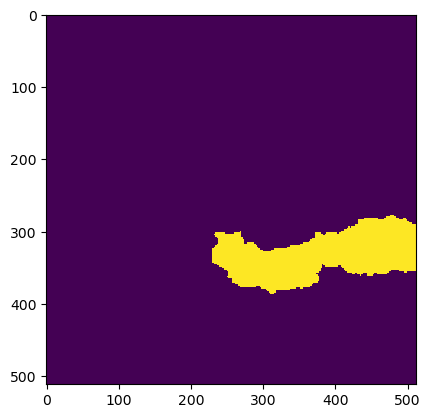

Wrote output/patches/mask/VU_S1_162-457782-4000-6309601-6000.tiff (512 x 512 pixels)
Zone UV_S1_163 Building Mask...


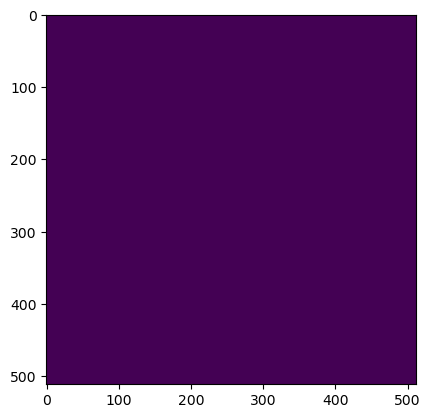

Wrote output/patches/mask/UV_S1_163-471760-0000-6309550-4000.tiff (512 x 512 pixels)


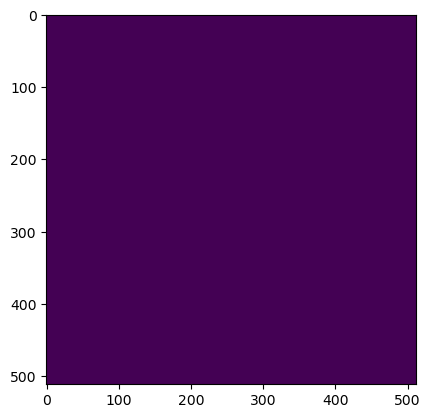

Wrote output/patches/mask/UV_S1_163-471760-0000-6309652-8000.tiff (512 x 512 pixels)


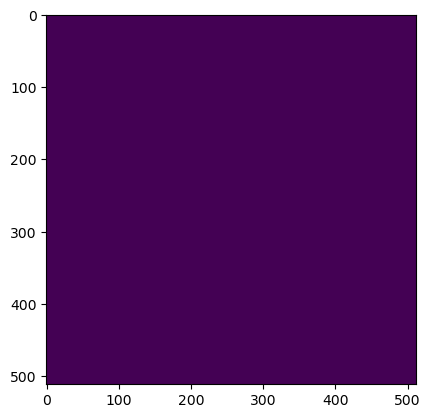

Wrote output/patches/mask/UV_S1_163-471760-0000-6309755-2000.tiff (512 x 512 pixels)


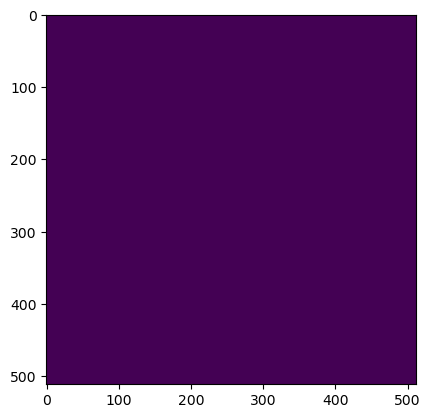

Wrote output/patches/mask/UV_S1_163-471760-0000-6309857-6000.tiff (512 x 512 pixels)


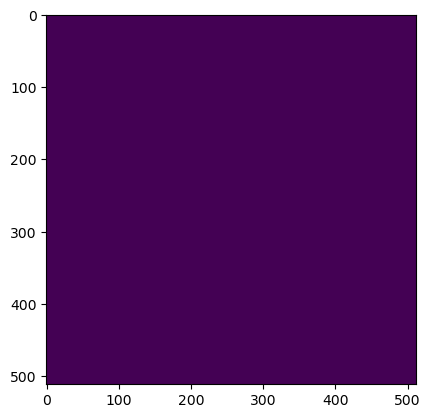

Wrote output/patches/mask/UV_S1_163-471760-0000-6309960-0000.tiff (512 x 512 pixels)


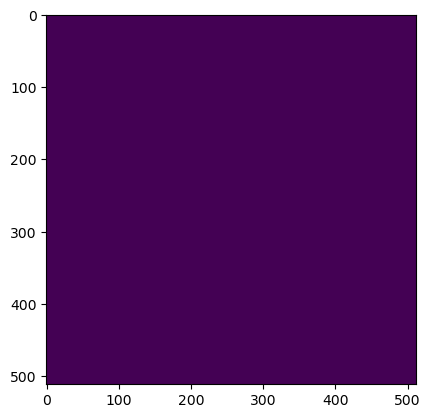

Wrote output/patches/mask/UV_S1_163-471760-0000-6310062-4000.tiff (512 x 512 pixels)


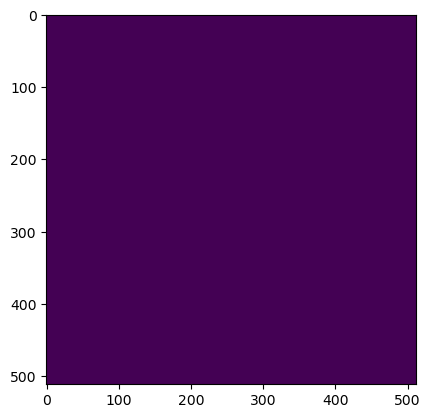

Wrote output/patches/mask/UV_S1_163-471760-0000-6310164-8000.tiff (512 x 512 pixels)


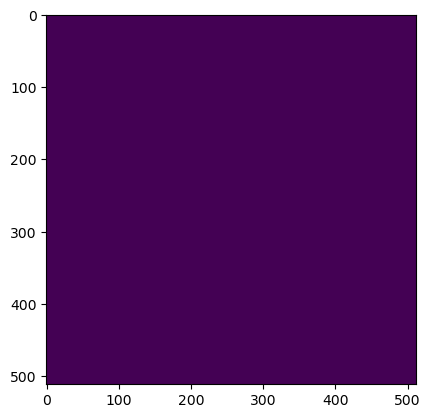

Wrote output/patches/mask/UV_S1_163-471862-4000-6309550-4000.tiff (512 x 512 pixels)


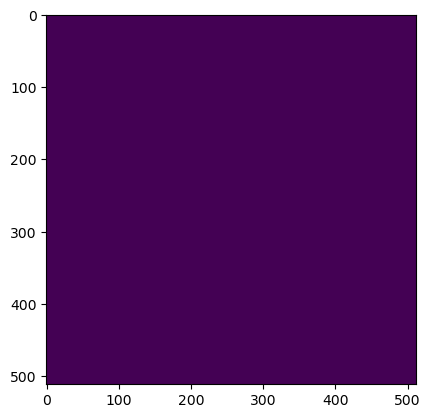

Wrote output/patches/mask/UV_S1_163-471862-4000-6309652-8000.tiff (512 x 512 pixels)


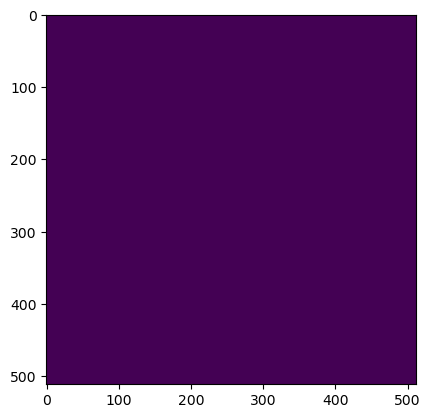

Wrote output/patches/mask/UV_S1_163-471862-4000-6309755-2000.tiff (512 x 512 pixels)


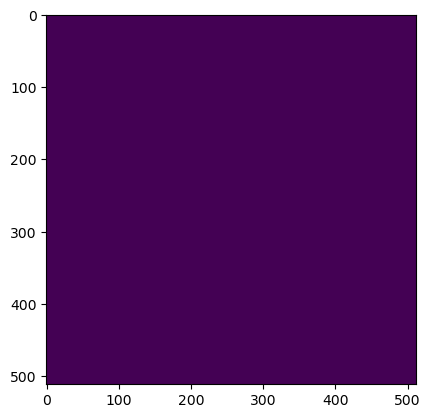

Wrote output/patches/mask/UV_S1_163-471862-4000-6309857-6000.tiff (512 x 512 pixels)


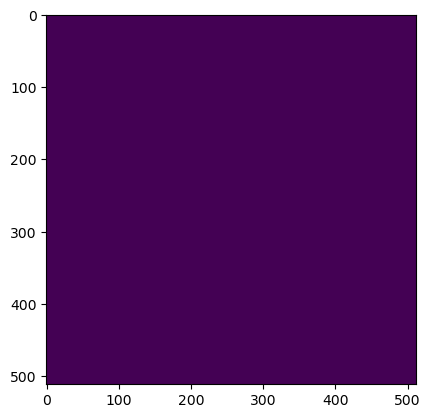

Wrote output/patches/mask/UV_S1_163-471862-4000-6309960-0000.tiff (512 x 512 pixels)


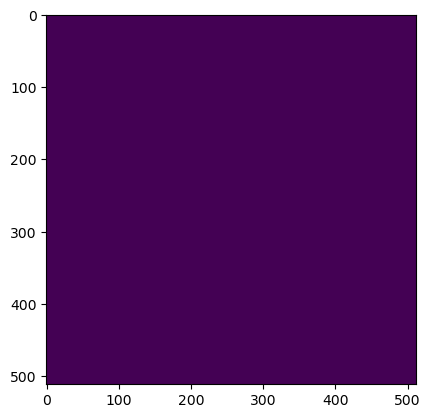

Wrote output/patches/mask/UV_S1_163-471862-4000-6310062-4000.tiff (512 x 512 pixels)


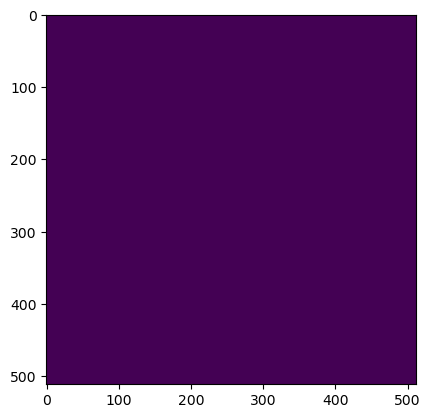

Wrote output/patches/mask/UV_S1_163-471862-4000-6310164-8000.tiff (512 x 512 pixels)


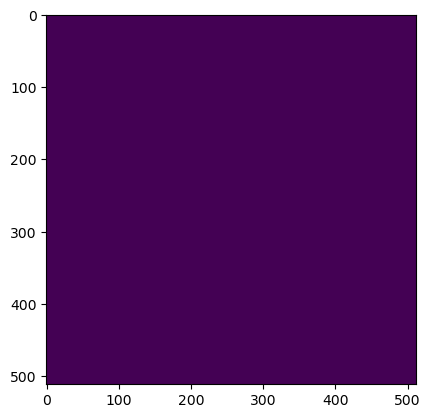

Wrote output/patches/mask/UV_S1_163-471964-8000-6309550-4000.tiff (512 x 512 pixels)


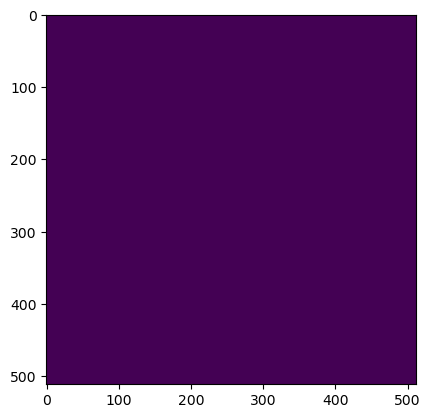

Wrote output/patches/mask/UV_S1_163-471964-8000-6309652-8000.tiff (512 x 512 pixels)


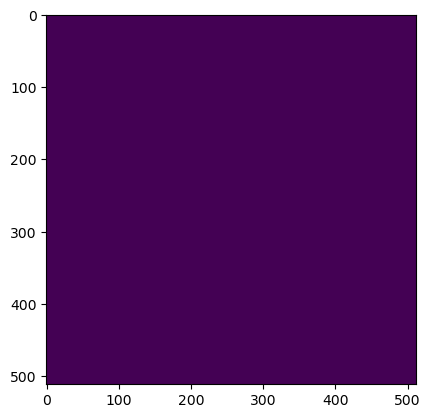

Wrote output/patches/mask/UV_S1_163-471964-8000-6309755-2000.tiff (512 x 512 pixels)


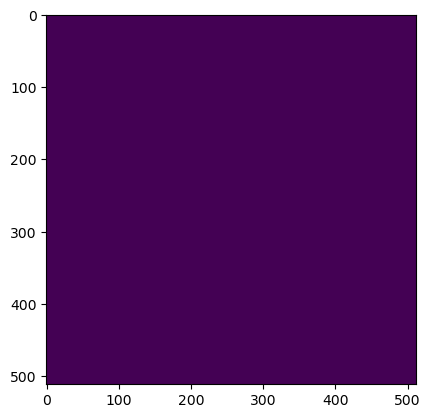

Wrote output/patches/mask/UV_S1_163-471964-8000-6309857-6000.tiff (512 x 512 pixels)


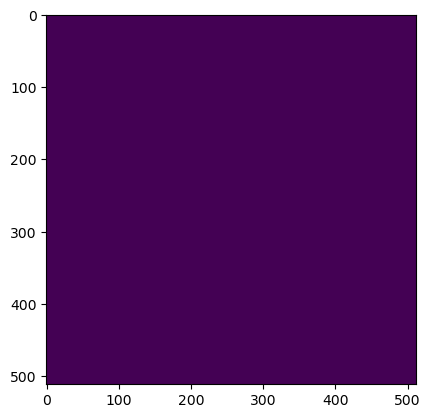

Wrote output/patches/mask/UV_S1_163-471964-8000-6309960-0000.tiff (512 x 512 pixels)


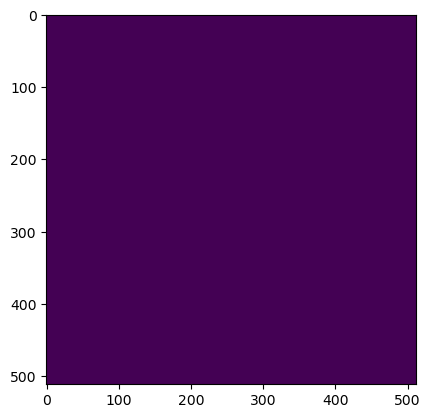

Wrote output/patches/mask/UV_S1_163-471964-8000-6310062-4000.tiff (512 x 512 pixels)


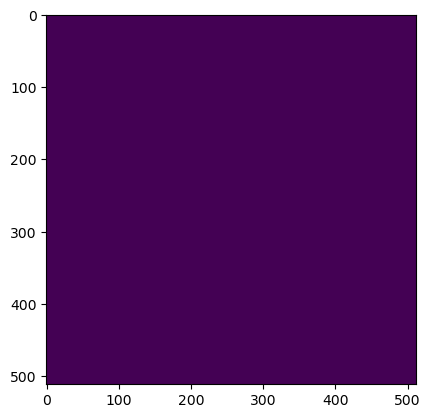

Wrote output/patches/mask/UV_S1_163-471964-8000-6310164-8000.tiff (512 x 512 pixels)


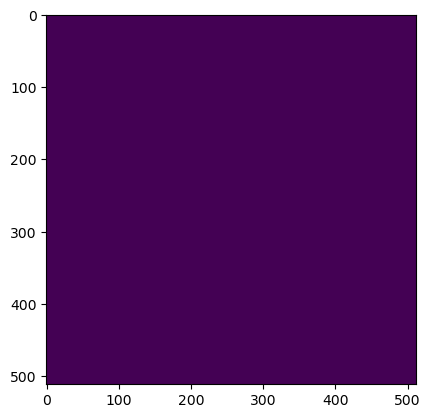

Wrote output/patches/mask/UV_S1_163-472067-2000-6309550-4000.tiff (512 x 512 pixels)


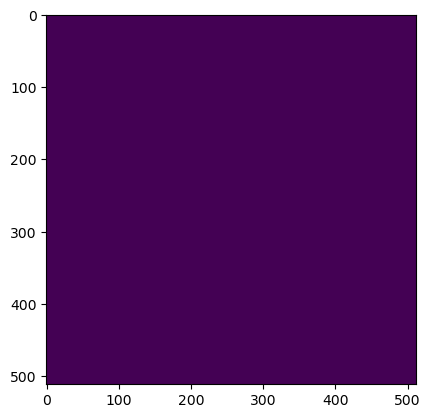

Wrote output/patches/mask/UV_S1_163-472067-2000-6309652-8000.tiff (512 x 512 pixels)


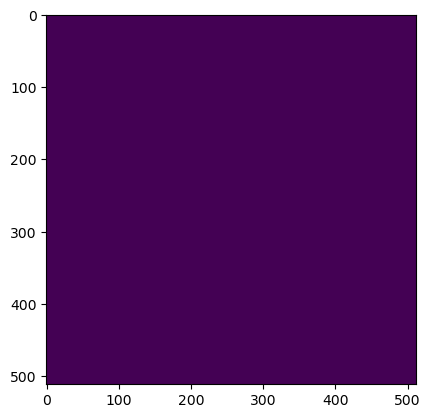

Wrote output/patches/mask/UV_S1_163-472067-2000-6309755-2000.tiff (512 x 512 pixels)


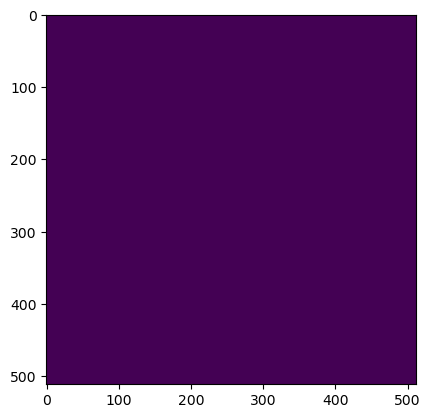

Wrote output/patches/mask/UV_S1_163-472067-2000-6309857-6000.tiff (512 x 512 pixels)


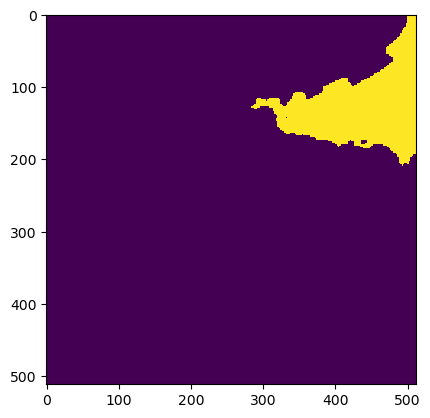

Wrote output/patches/mask/UV_S1_163-472067-2000-6309960-0000.tiff (512 x 512 pixels)


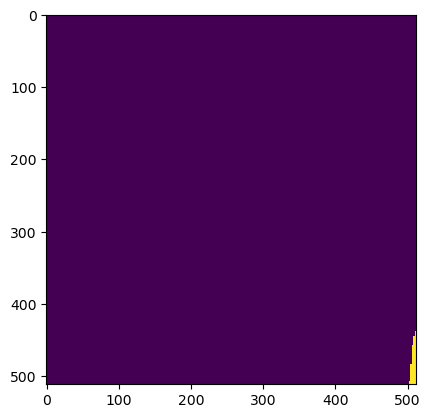

Wrote output/patches/mask/UV_S1_163-472067-2000-6310062-4000.tiff (512 x 512 pixels)


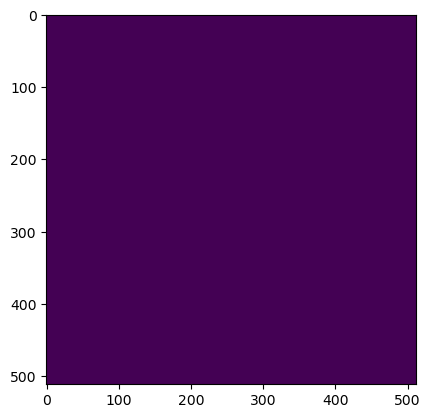

Wrote output/patches/mask/UV_S1_163-472067-2000-6310164-8000.tiff (512 x 512 pixels)


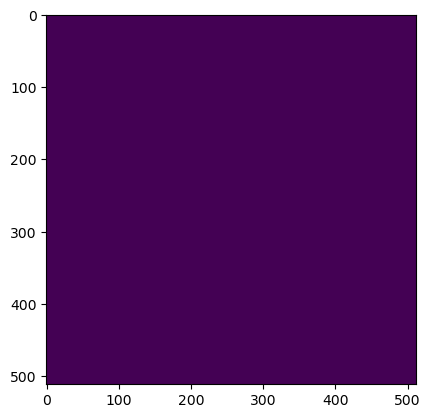

Wrote output/patches/mask/UV_S1_163-472169-6000-6309550-4000.tiff (512 x 512 pixels)


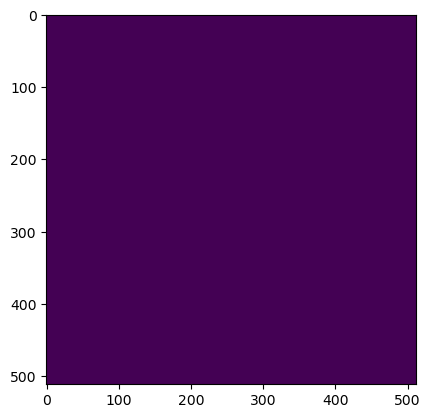

Wrote output/patches/mask/UV_S1_163-472169-6000-6309652-8000.tiff (512 x 512 pixels)


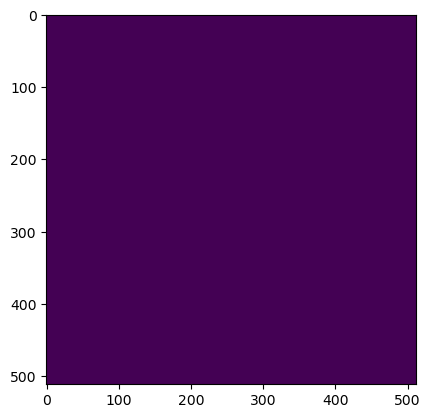

Wrote output/patches/mask/UV_S1_163-472169-6000-6309755-2000.tiff (512 x 512 pixels)


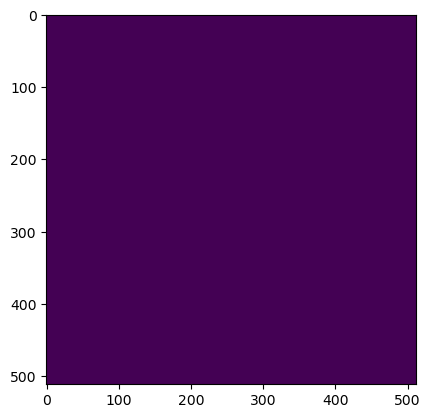

Wrote output/patches/mask/UV_S1_163-472169-6000-6309857-6000.tiff (512 x 512 pixels)


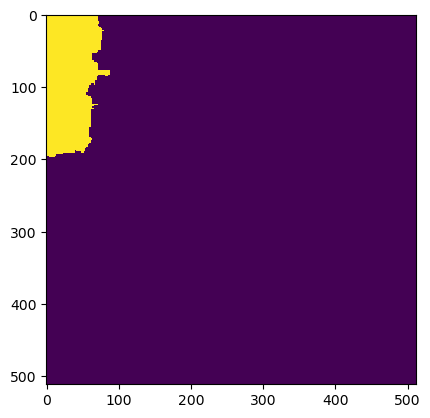

Wrote output/patches/mask/UV_S1_163-472169-6000-6309960-0000.tiff (512 x 512 pixels)


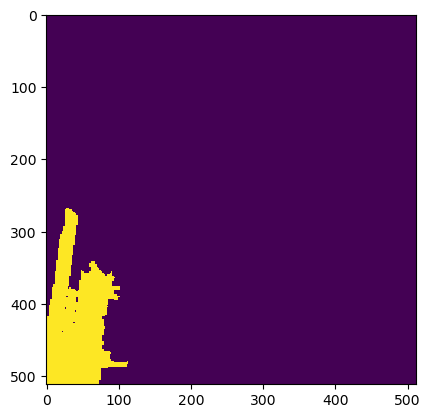

Wrote output/patches/mask/UV_S1_163-472169-6000-6310062-4000.tiff (512 x 512 pixels)


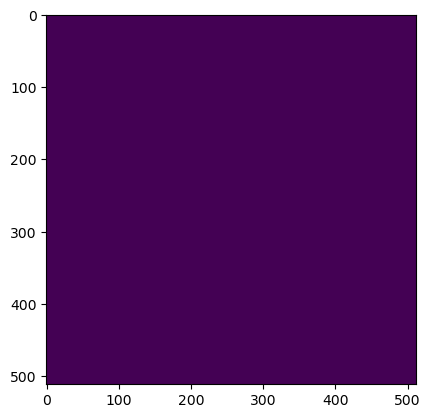

Wrote output/patches/mask/UV_S1_163-472169-6000-6310164-8000.tiff (512 x 512 pixels)


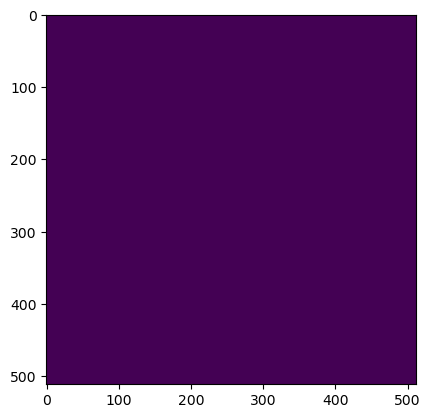

Wrote output/patches/mask/UV_S1_163-472272-0000-6309550-4000.tiff (512 x 512 pixels)


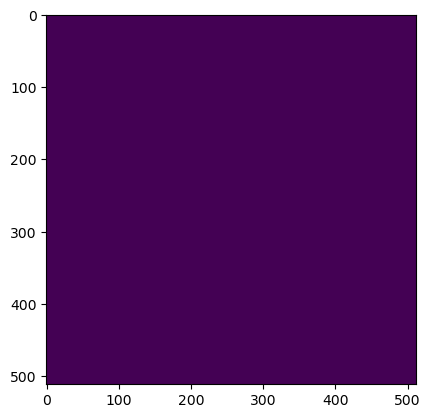

Wrote output/patches/mask/UV_S1_163-472272-0000-6309652-8000.tiff (512 x 512 pixels)


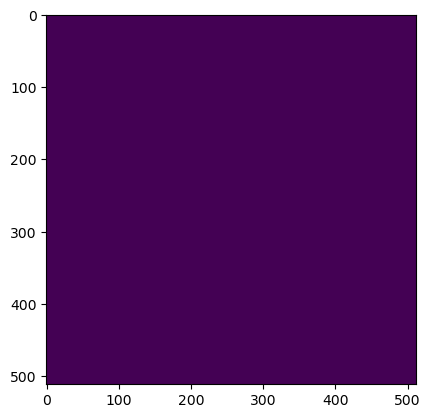

Wrote output/patches/mask/UV_S1_163-472272-0000-6309755-2000.tiff (512 x 512 pixels)


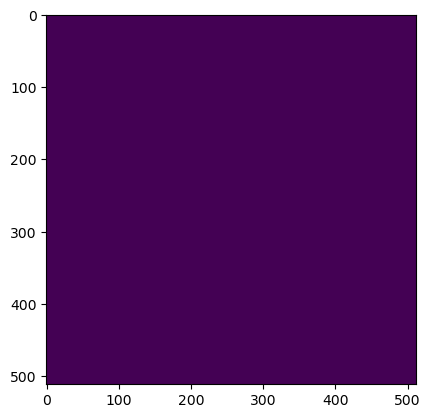

Wrote output/patches/mask/UV_S1_163-472272-0000-6309857-6000.tiff (512 x 512 pixels)


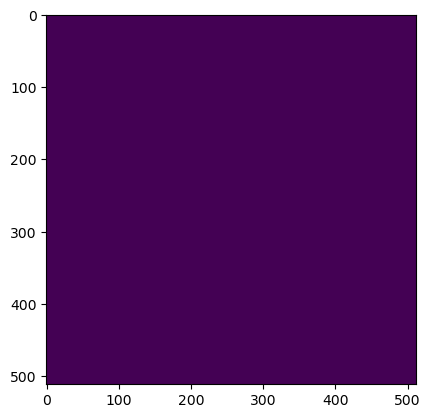

Wrote output/patches/mask/UV_S1_163-472272-0000-6309960-0000.tiff (512 x 512 pixels)


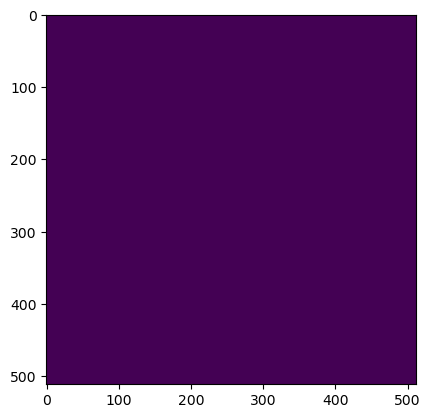

Wrote output/patches/mask/UV_S1_163-472272-0000-6310062-4000.tiff (512 x 512 pixels)


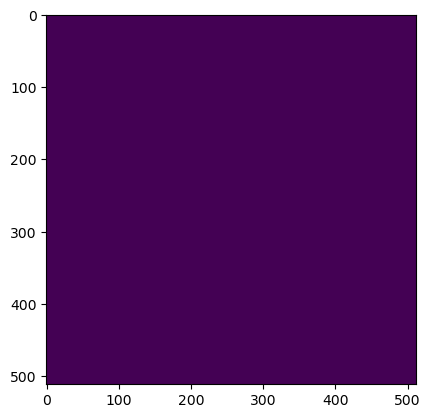

Wrote output/patches/mask/UV_S1_163-472272-0000-6310164-8000.tiff (512 x 512 pixels)


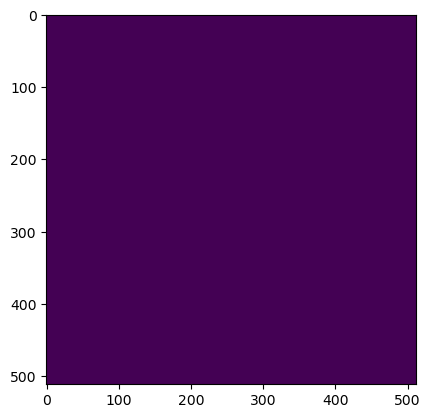

Wrote output/patches/mask/UV_S1_163-472374-4000-6309550-4000.tiff (512 x 512 pixels)


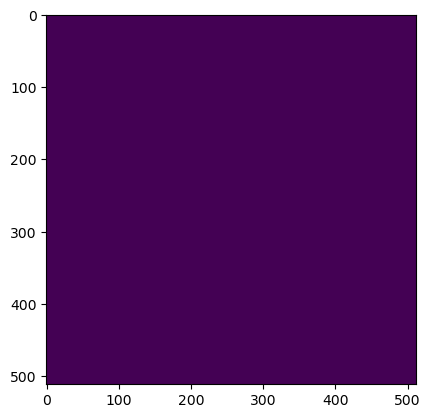

Wrote output/patches/mask/UV_S1_163-472374-4000-6309652-8000.tiff (512 x 512 pixels)


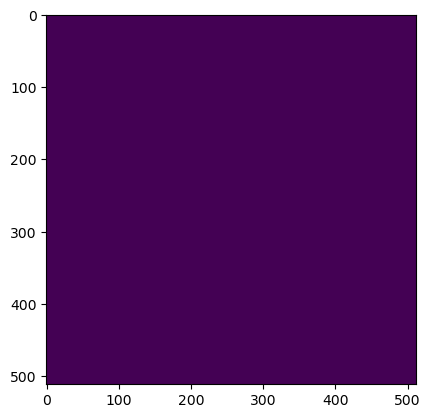

Wrote output/patches/mask/UV_S1_163-472374-4000-6309755-2000.tiff (512 x 512 pixels)


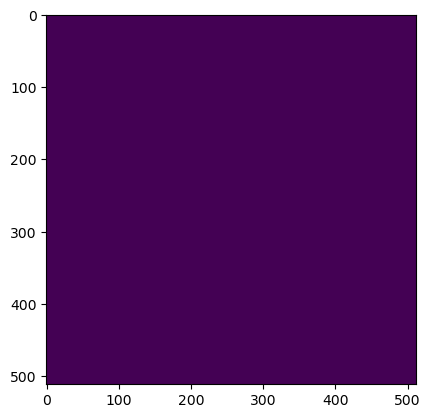

Wrote output/patches/mask/UV_S1_163-472374-4000-6309857-6000.tiff (512 x 512 pixels)


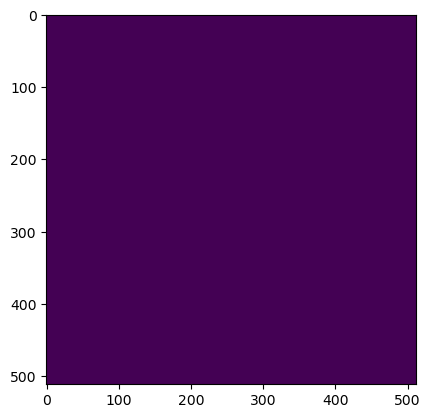

Wrote output/patches/mask/UV_S1_163-472374-4000-6309960-0000.tiff (512 x 512 pixels)


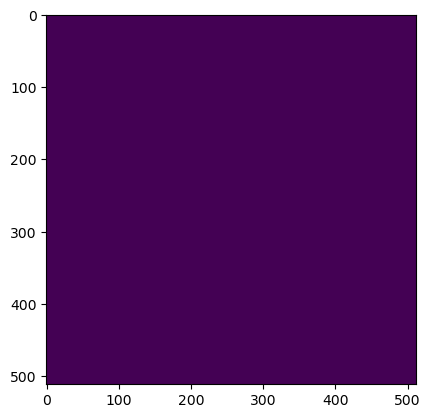

Wrote output/patches/mask/UV_S1_163-472374-4000-6310062-4000.tiff (512 x 512 pixels)


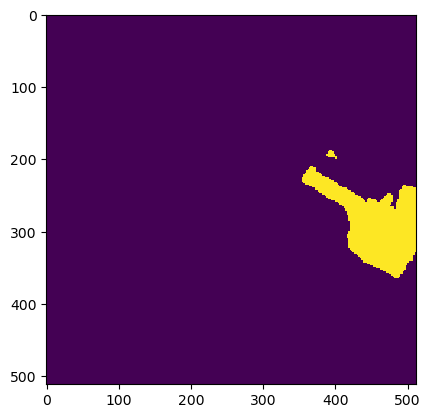

Wrote output/patches/mask/UV_S1_163-472374-4000-6310164-8000.tiff (512 x 512 pixels)


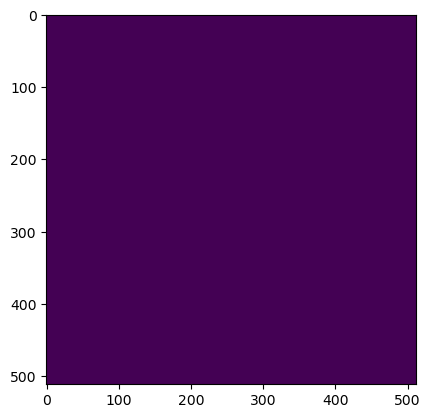

Wrote output/patches/mask/UV_S1_163-472476-8000-6309550-4000.tiff (512 x 512 pixels)


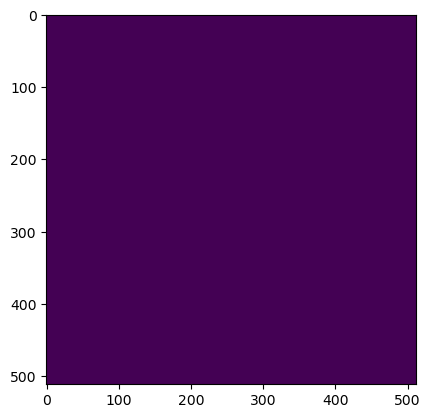

Wrote output/patches/mask/UV_S1_163-472476-8000-6309652-8000.tiff (512 x 512 pixels)


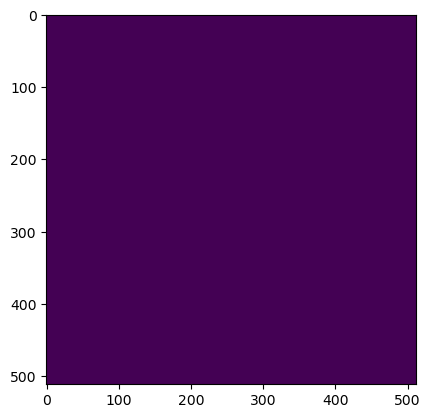

Wrote output/patches/mask/UV_S1_163-472476-8000-6309755-2000.tiff (512 x 512 pixels)


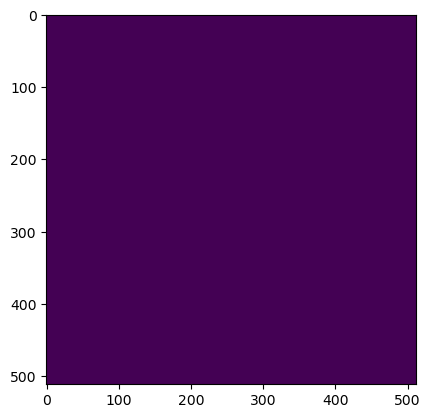

Wrote output/patches/mask/UV_S1_163-472476-8000-6309857-6000.tiff (512 x 512 pixels)


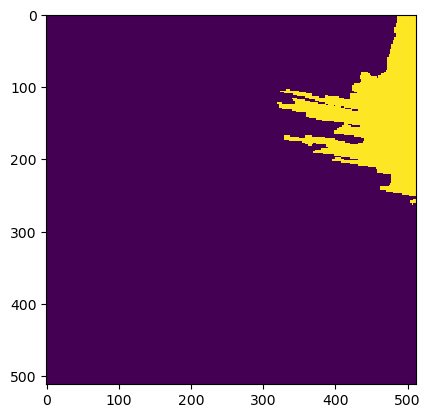

Wrote output/patches/mask/UV_S1_163-472476-8000-6309960-0000.tiff (512 x 512 pixels)


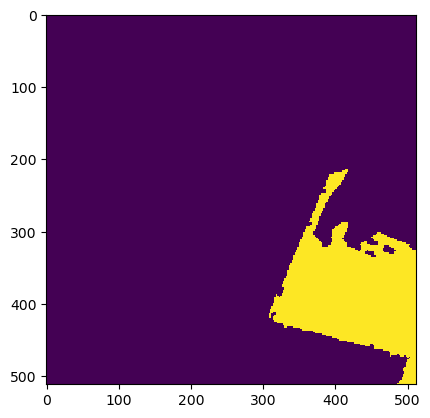

Wrote output/patches/mask/UV_S1_163-472476-8000-6310062-4000.tiff (512 x 512 pixels)


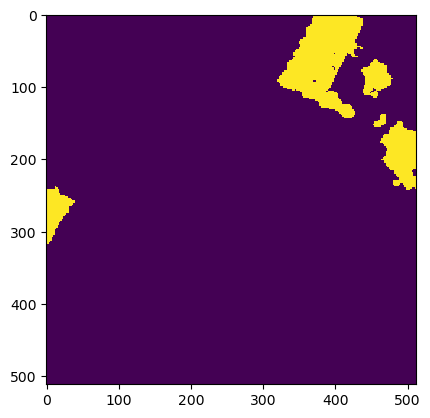

Wrote output/patches/mask/UV_S1_163-472476-8000-6310164-8000.tiff (512 x 512 pixels)


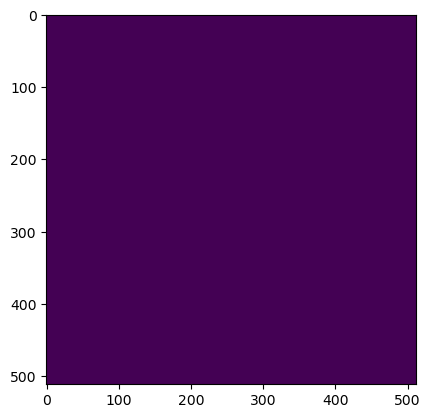

Wrote output/patches/mask/UV_S1_163-472579-2000-6309550-4000.tiff (512 x 512 pixels)


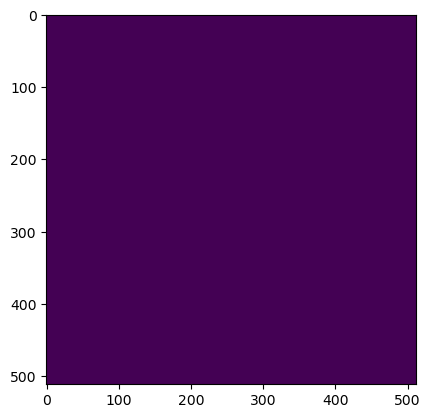

Wrote output/patches/mask/UV_S1_163-472579-2000-6309652-8000.tiff (512 x 512 pixels)


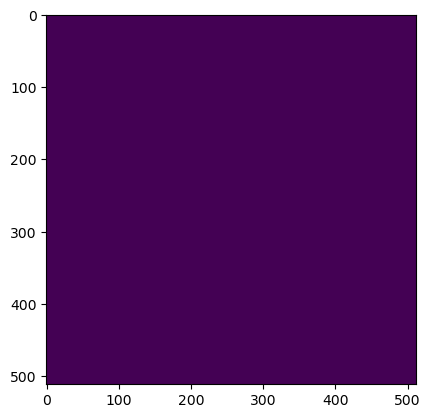

Wrote output/patches/mask/UV_S1_163-472579-2000-6309755-2000.tiff (512 x 512 pixels)


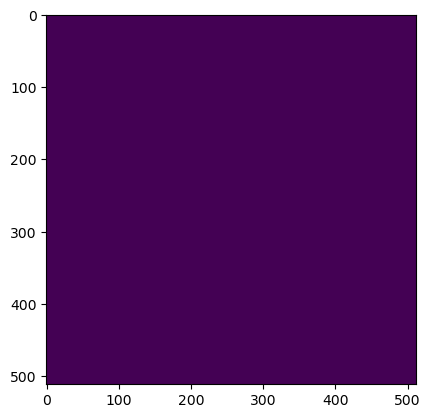

Wrote output/patches/mask/UV_S1_163-472579-2000-6309857-6000.tiff (512 x 512 pixels)


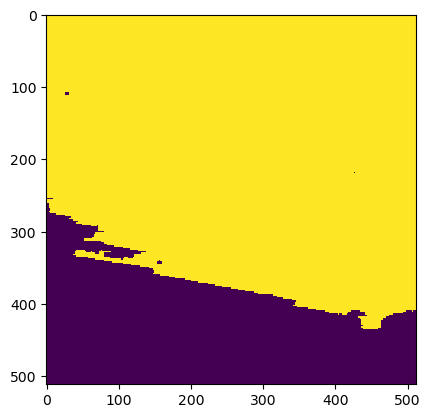

Wrote output/patches/mask/UV_S1_163-472579-2000-6309960-0000.tiff (512 x 512 pixels)


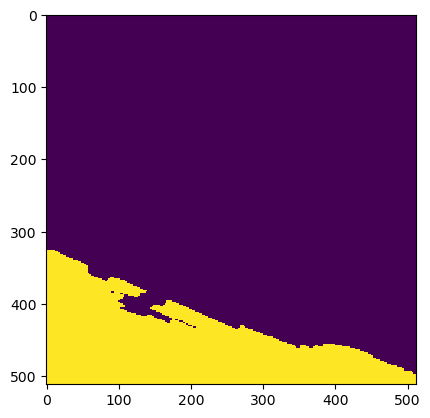

Wrote output/patches/mask/UV_S1_163-472579-2000-6310062-4000.tiff (512 x 512 pixels)


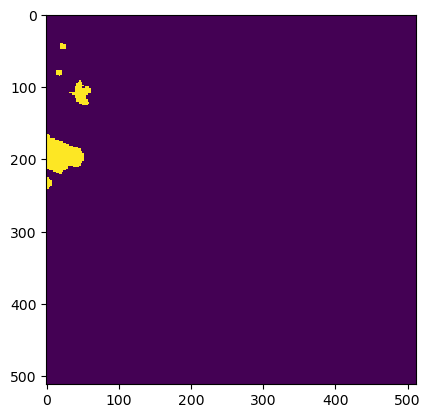

Wrote output/patches/mask/UV_S1_163-472579-2000-6310164-8000.tiff (512 x 512 pixels)
Zone VC_S1_164 Building Mask...


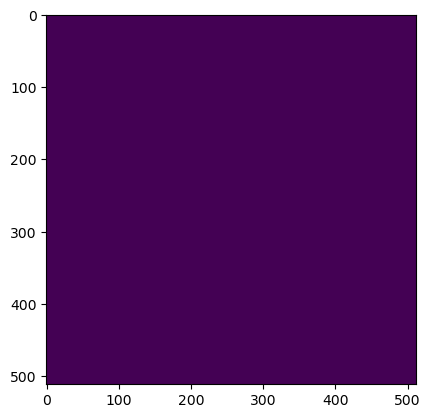

Wrote output/patches/mask/VC_S1_164-453584-0000-6310062-4000.tiff (512 x 512 pixels)


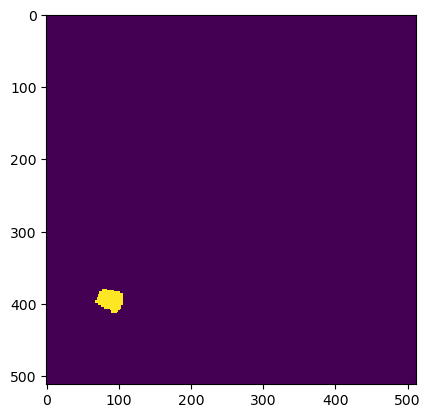

Wrote output/patches/mask/VC_S1_164-453584-0000-6310164-8000.tiff (512 x 512 pixels)


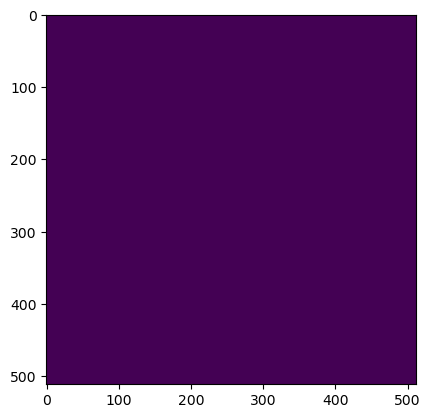

Wrote output/patches/mask/VC_S1_164-453686-4000-6310062-4000.tiff (512 x 512 pixels)


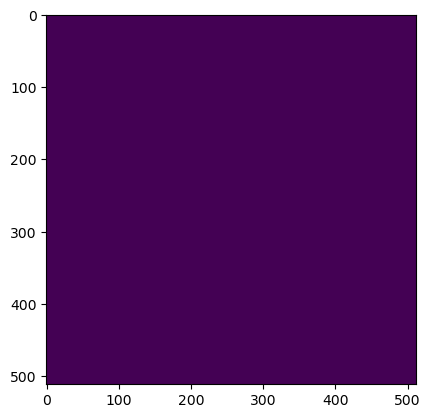

Wrote output/patches/mask/VC_S1_164-453686-4000-6310164-8000.tiff (512 x 512 pixels)


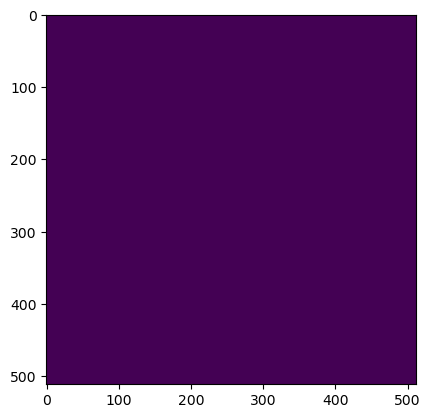

Wrote output/patches/mask/VC_S1_164-453788-8000-6310062-4000.tiff (512 x 512 pixels)


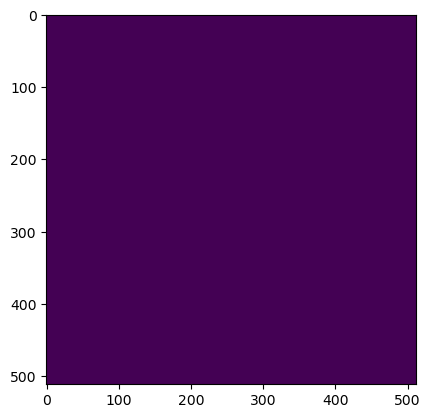

Wrote output/patches/mask/VC_S1_164-453788-8000-6310164-8000.tiff (512 x 512 pixels)


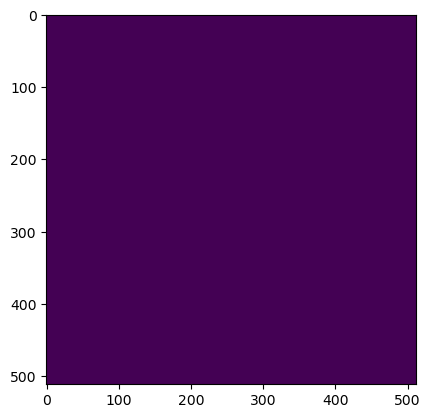

Wrote output/patches/mask/VC_S1_164-453891-2000-6310062-4000.tiff (512 x 512 pixels)


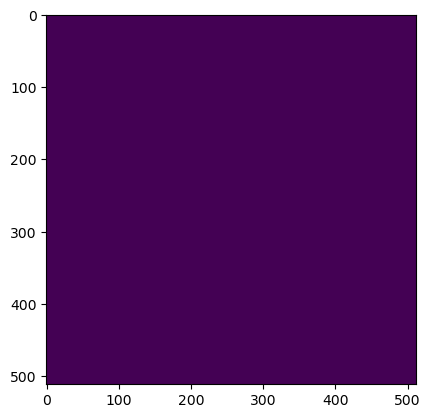

Wrote output/patches/mask/VC_S1_164-453891-2000-6310164-8000.tiff (512 x 512 pixels)
Zone VU_S1_165 Building Mask...


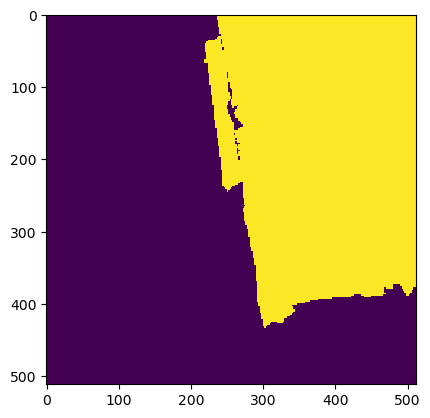

Wrote output/patches/mask/VU_S1_165-469712-0000-6310830-4000.tiff (512 x 512 pixels)


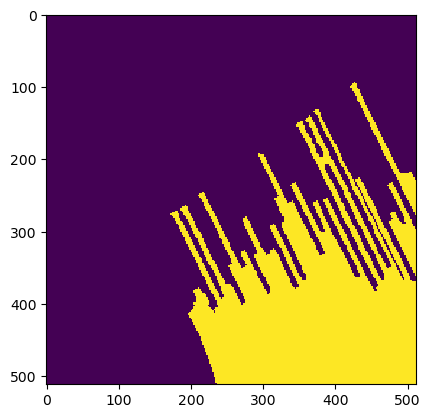

Wrote output/patches/mask/VU_S1_165-469712-0000-6310932-8000.tiff (512 x 512 pixels)


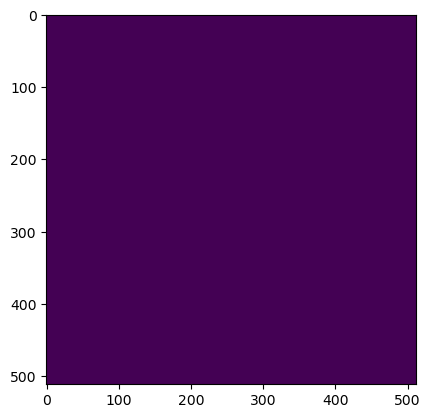

Wrote output/patches/mask/VU_S1_165-469712-0000-6311035-2000.tiff (512 x 512 pixels)


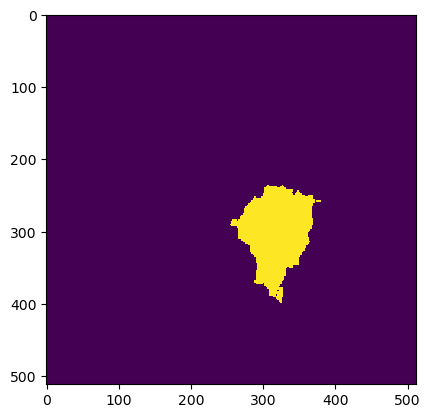

Wrote output/patches/mask/VU_S1_165-469712-0000-6311137-6000.tiff (512 x 512 pixels)


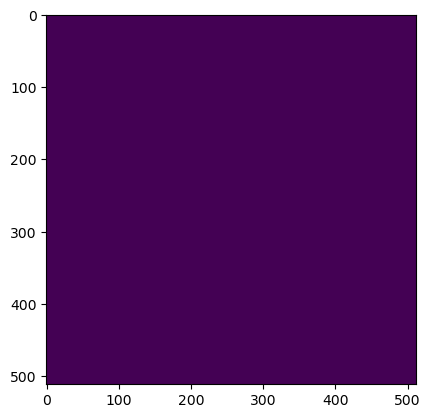

Wrote output/patches/mask/VU_S1_165-469712-0000-6311240-0000.tiff (512 x 512 pixels)


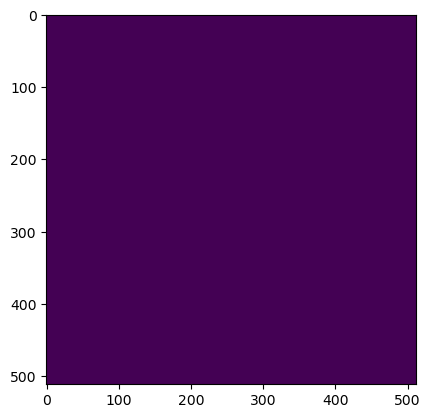

Wrote output/patches/mask/VU_S1_165-469712-0000-6311342-4000.tiff (512 x 512 pixels)


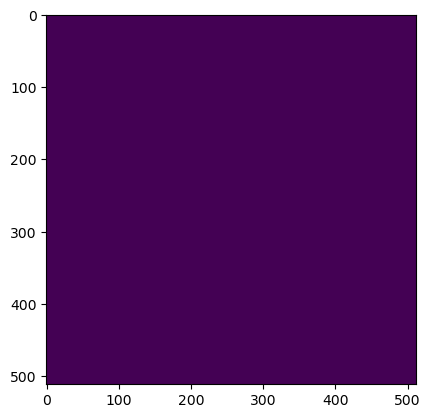

Wrote output/patches/mask/VU_S1_165-469712-0000-6311444-8000.tiff (512 x 512 pixels)


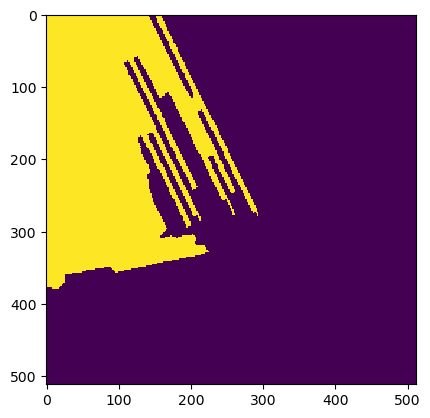

Wrote output/patches/mask/VU_S1_165-469814-4000-6310830-4000.tiff (512 x 512 pixels)


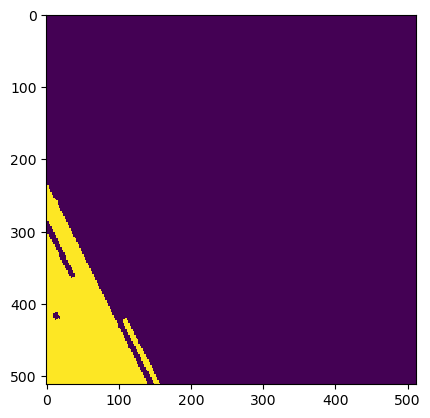

Wrote output/patches/mask/VU_S1_165-469814-4000-6310932-8000.tiff (512 x 512 pixels)


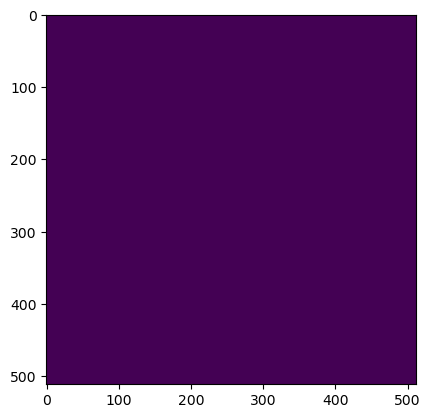

Wrote output/patches/mask/VU_S1_165-469814-4000-6311035-2000.tiff (512 x 512 pixels)


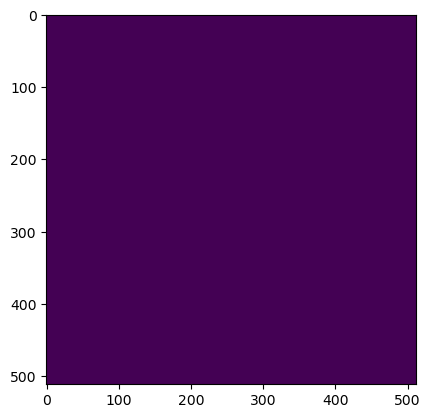

Wrote output/patches/mask/VU_S1_165-469814-4000-6311137-6000.tiff (512 x 512 pixels)


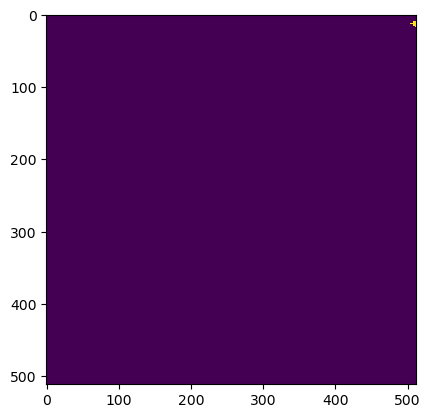

Wrote output/patches/mask/VU_S1_165-469814-4000-6311240-0000.tiff (512 x 512 pixels)


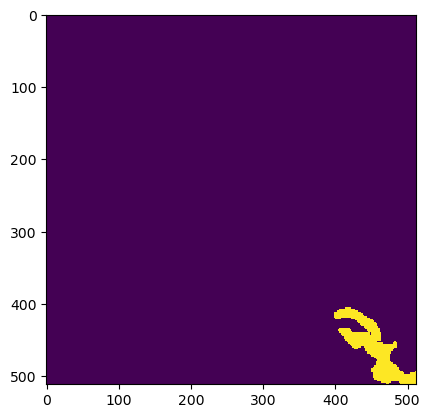

Wrote output/patches/mask/VU_S1_165-469814-4000-6311342-4000.tiff (512 x 512 pixels)


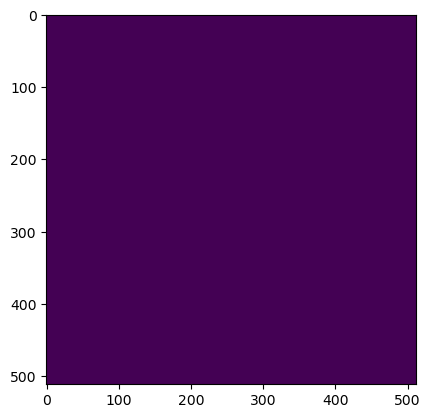

Wrote output/patches/mask/VU_S1_165-469814-4000-6311444-8000.tiff (512 x 512 pixels)


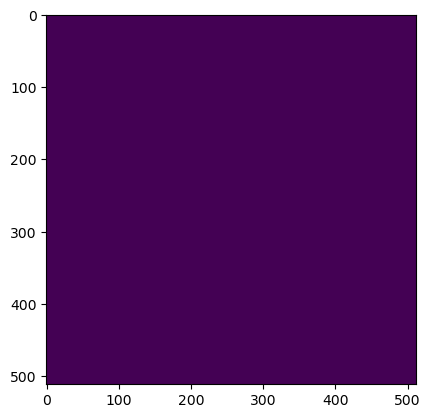

Wrote output/patches/mask/VU_S1_165-469916-8000-6310830-4000.tiff (512 x 512 pixels)


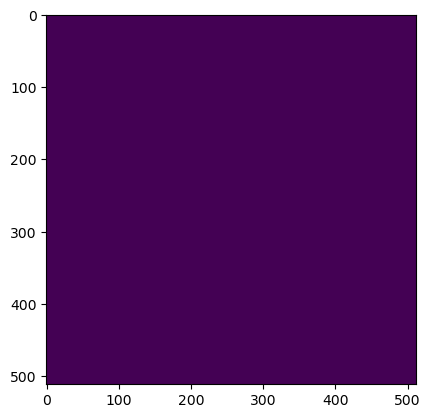

Wrote output/patches/mask/VU_S1_165-469916-8000-6310932-8000.tiff (512 x 512 pixels)


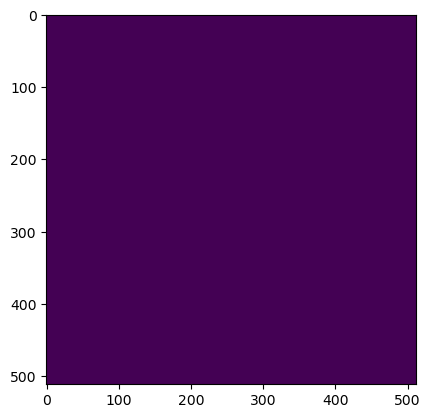

Wrote output/patches/mask/VU_S1_165-469916-8000-6311035-2000.tiff (512 x 512 pixels)


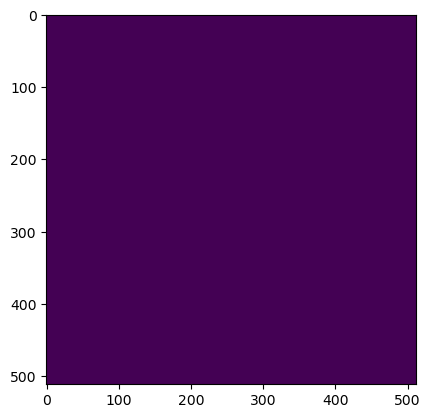

Wrote output/patches/mask/VU_S1_165-469916-8000-6311137-6000.tiff (512 x 512 pixels)


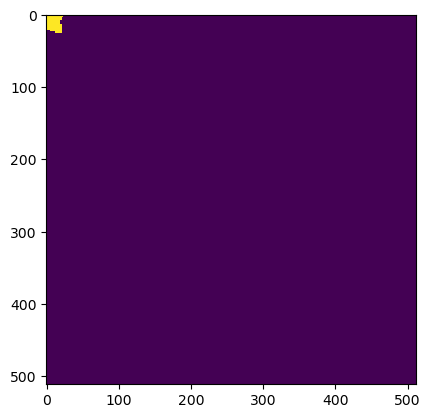

Wrote output/patches/mask/VU_S1_165-469916-8000-6311240-0000.tiff (512 x 512 pixels)


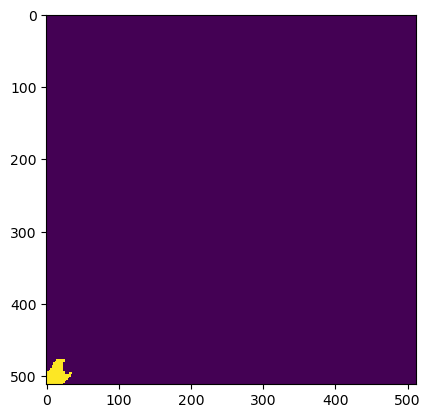

Wrote output/patches/mask/VU_S1_165-469916-8000-6311342-4000.tiff (512 x 512 pixels)


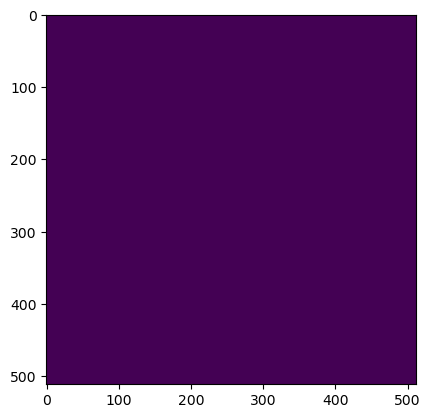

Wrote output/patches/mask/VU_S1_165-469916-8000-6311444-8000.tiff (512 x 512 pixels)


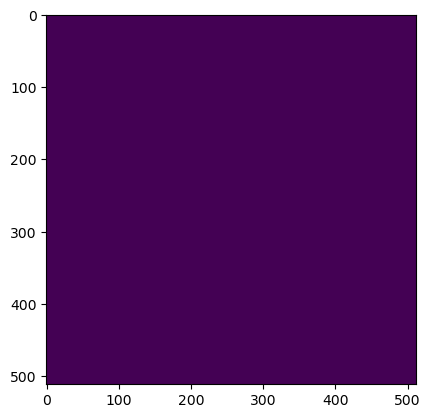

Wrote output/patches/mask/VU_S1_165-470019-2000-6310830-4000.tiff (512 x 512 pixels)


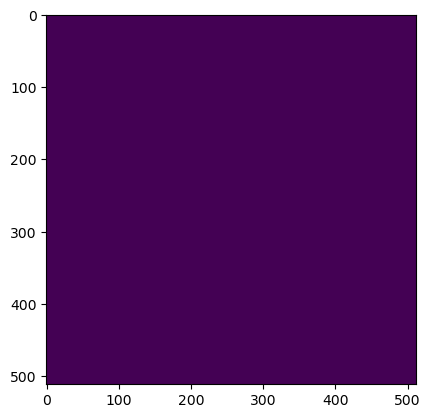

Wrote output/patches/mask/VU_S1_165-470019-2000-6310932-8000.tiff (512 x 512 pixels)


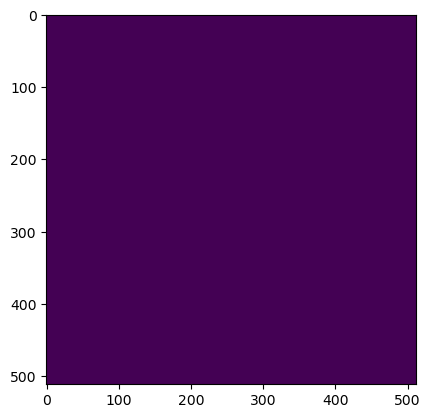

Wrote output/patches/mask/VU_S1_165-470019-2000-6311035-2000.tiff (512 x 512 pixels)


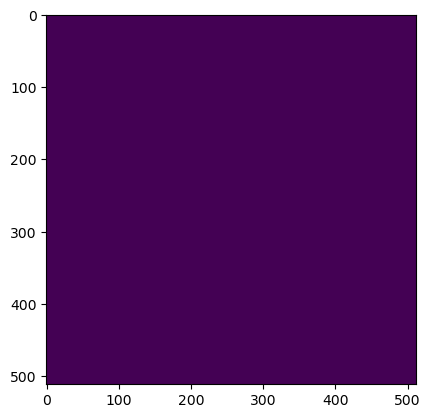

Wrote output/patches/mask/VU_S1_165-470019-2000-6311137-6000.tiff (512 x 512 pixels)


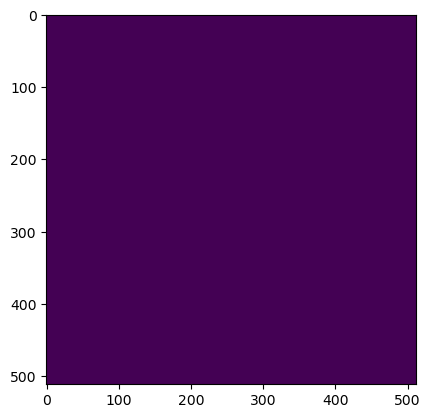

Wrote output/patches/mask/VU_S1_165-470019-2000-6311240-0000.tiff (512 x 512 pixels)


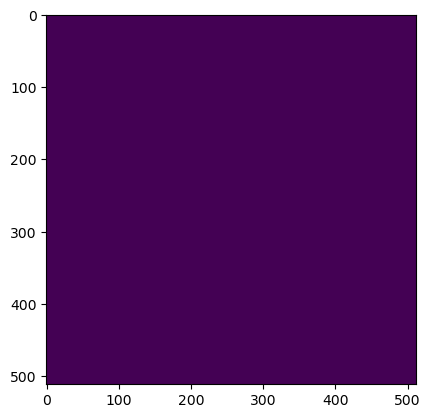

Wrote output/patches/mask/VU_S1_165-470019-2000-6311342-4000.tiff (512 x 512 pixels)


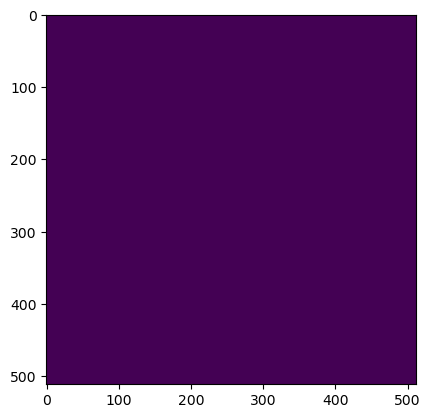

Wrote output/patches/mask/VU_S1_165-470019-2000-6311444-8000.tiff (512 x 512 pixels)


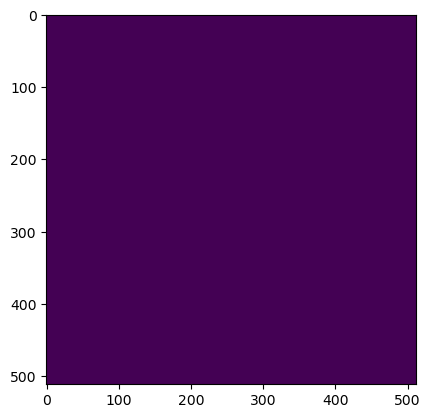

Wrote output/patches/mask/VU_S1_165-470121-6000-6310830-4000.tiff (512 x 512 pixels)


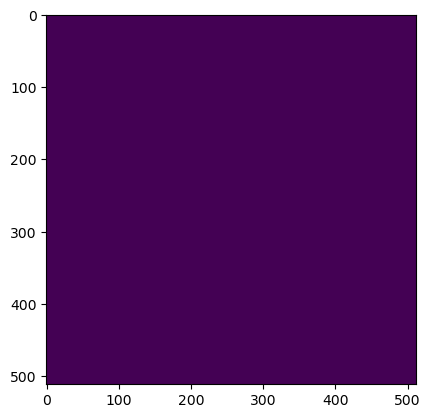

Wrote output/patches/mask/VU_S1_165-470121-6000-6310932-8000.tiff (512 x 512 pixels)


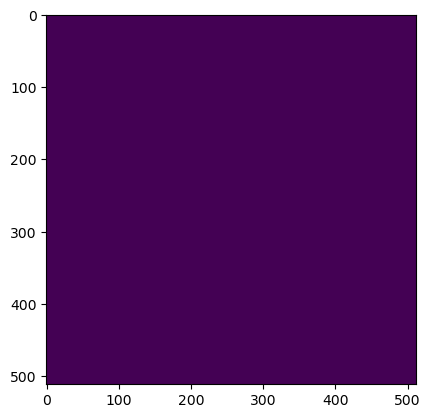

Wrote output/patches/mask/VU_S1_165-470121-6000-6311035-2000.tiff (512 x 512 pixels)


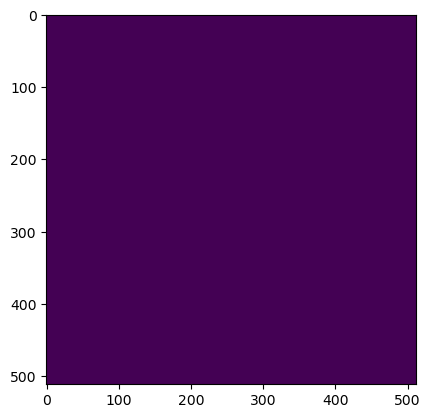

Wrote output/patches/mask/VU_S1_165-470121-6000-6311137-6000.tiff (512 x 512 pixels)


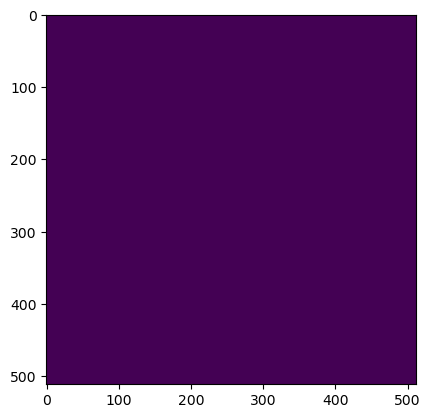

Wrote output/patches/mask/VU_S1_165-470121-6000-6311240-0000.tiff (512 x 512 pixels)


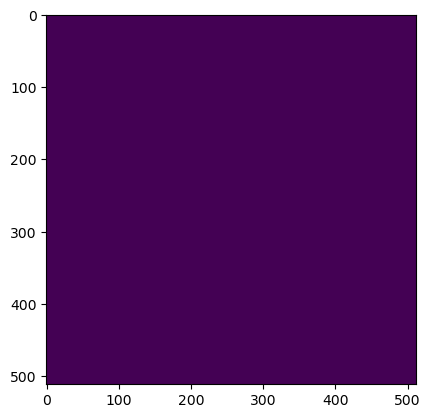

Wrote output/patches/mask/VU_S1_165-470121-6000-6311342-4000.tiff (512 x 512 pixels)


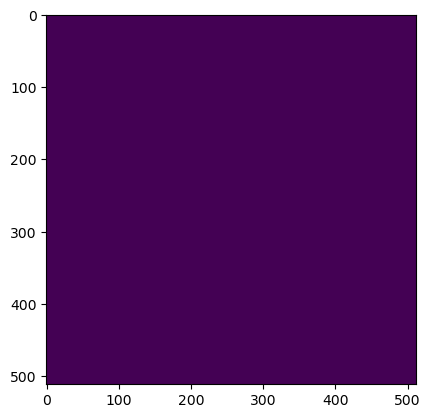

Wrote output/patches/mask/VU_S1_165-470121-6000-6311444-8000.tiff (512 x 512 pixels)


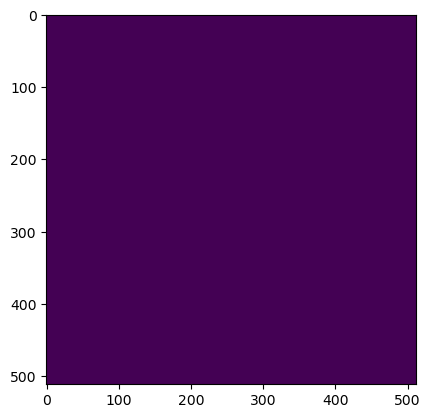

Wrote output/patches/mask/VU_S1_165-470224-0000-6310830-4000.tiff (512 x 512 pixels)


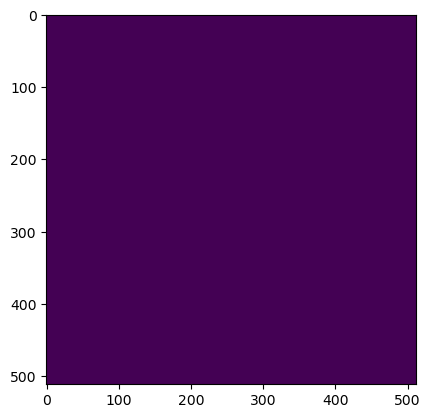

Wrote output/patches/mask/VU_S1_165-470224-0000-6310932-8000.tiff (512 x 512 pixels)


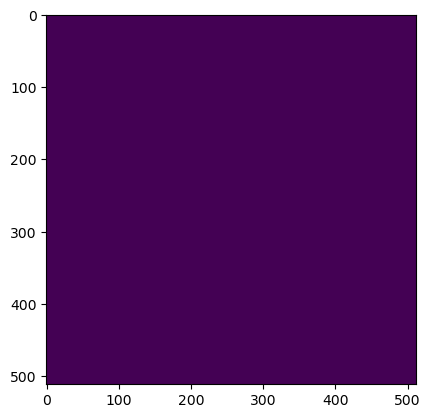

Wrote output/patches/mask/VU_S1_165-470224-0000-6311035-2000.tiff (512 x 512 pixels)


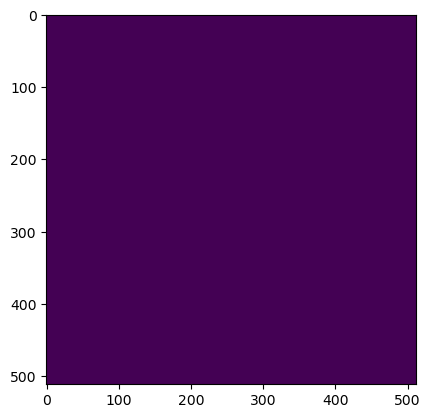

Wrote output/patches/mask/VU_S1_165-470224-0000-6311137-6000.tiff (512 x 512 pixels)


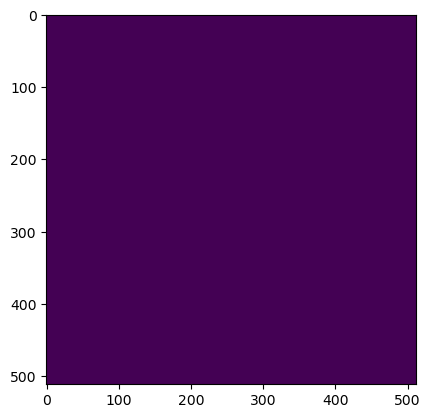

Wrote output/patches/mask/VU_S1_165-470224-0000-6311240-0000.tiff (512 x 512 pixels)


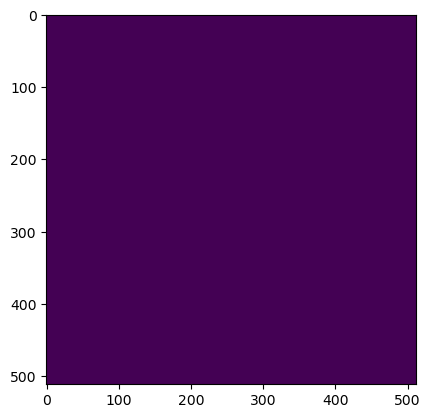

Wrote output/patches/mask/VU_S1_165-470224-0000-6311342-4000.tiff (512 x 512 pixels)


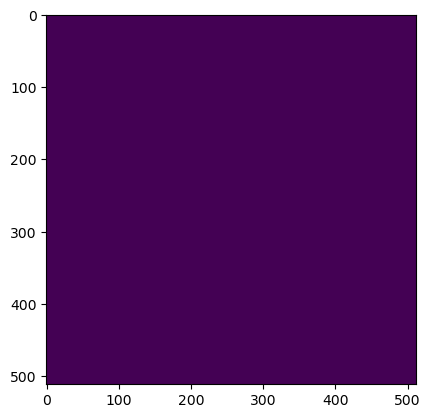

Wrote output/patches/mask/VU_S1_165-470224-0000-6311444-8000.tiff (512 x 512 pixels)


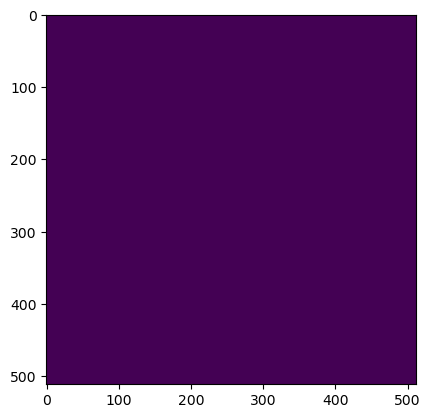

Wrote output/patches/mask/VU_S1_165-470326-4000-6310830-4000.tiff (512 x 512 pixels)


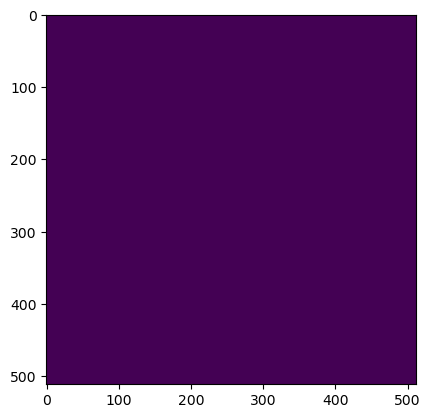

Wrote output/patches/mask/VU_S1_165-470326-4000-6310932-8000.tiff (512 x 512 pixels)


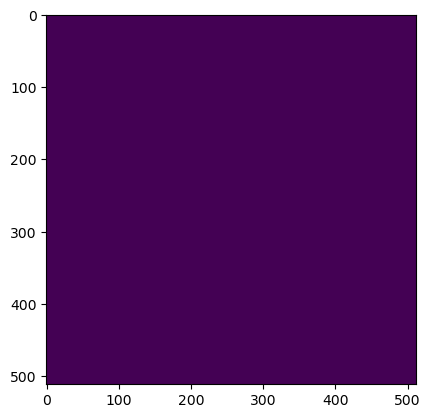

Wrote output/patches/mask/VU_S1_165-470326-4000-6311035-2000.tiff (512 x 512 pixels)


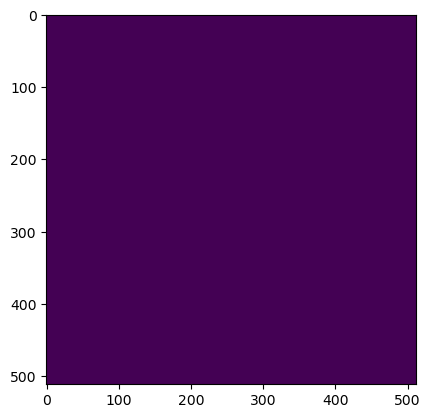

Wrote output/patches/mask/VU_S1_165-470326-4000-6311137-6000.tiff (512 x 512 pixels)


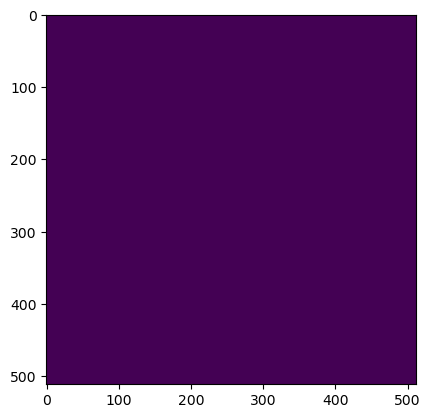

Wrote output/patches/mask/VU_S1_165-470326-4000-6311240-0000.tiff (512 x 512 pixels)


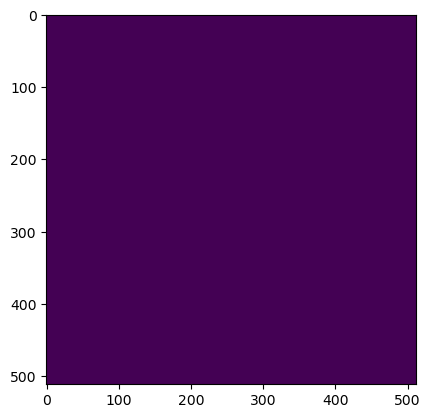

Wrote output/patches/mask/VU_S1_165-470326-4000-6311342-4000.tiff (512 x 512 pixels)


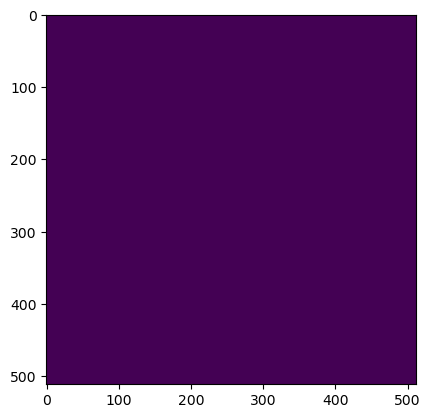

Wrote output/patches/mask/VU_S1_165-470326-4000-6311444-8000.tiff (512 x 512 pixels)


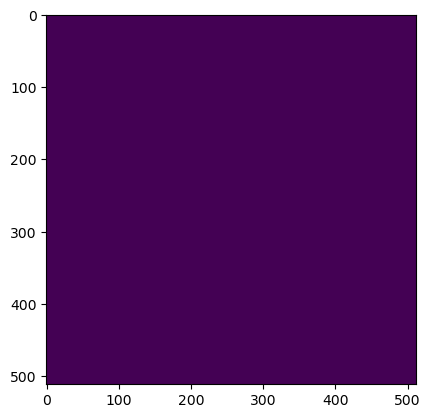

Wrote output/patches/mask/VU_S1_165-470428-8000-6310830-4000.tiff (512 x 512 pixels)


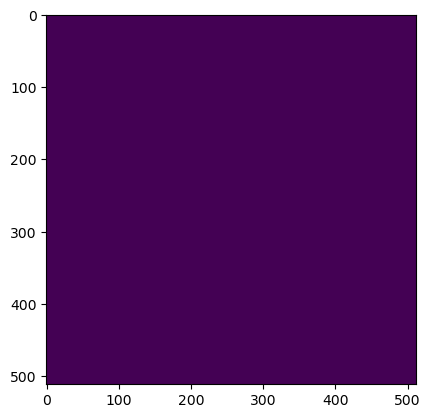

Wrote output/patches/mask/VU_S1_165-470428-8000-6310932-8000.tiff (512 x 512 pixels)


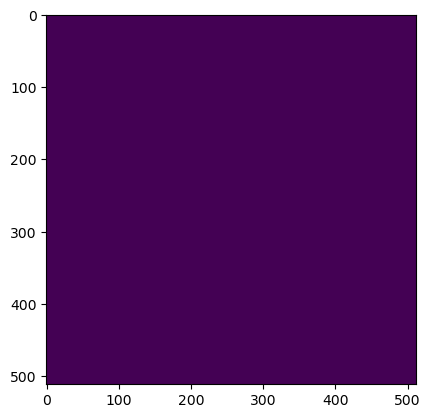

Wrote output/patches/mask/VU_S1_165-470428-8000-6311035-2000.tiff (512 x 512 pixels)


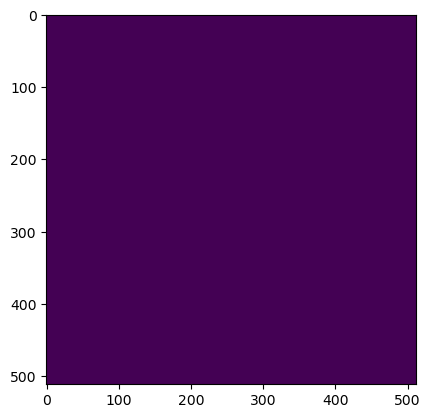

Wrote output/patches/mask/VU_S1_165-470428-8000-6311137-6000.tiff (512 x 512 pixels)


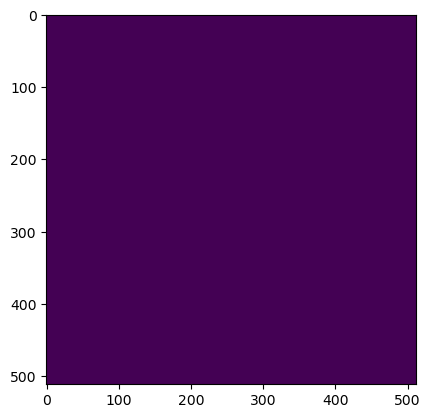

Wrote output/patches/mask/VU_S1_165-470428-8000-6311240-0000.tiff (512 x 512 pixels)


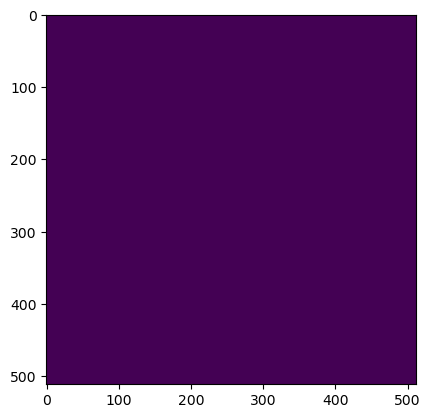

Wrote output/patches/mask/VU_S1_165-470428-8000-6311342-4000.tiff (512 x 512 pixels)


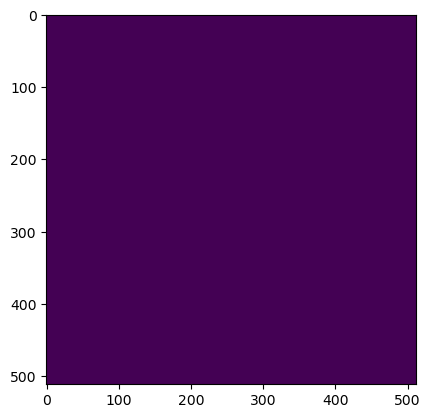

Wrote output/patches/mask/VU_S1_165-470428-8000-6311444-8000.tiff (512 x 512 pixels)


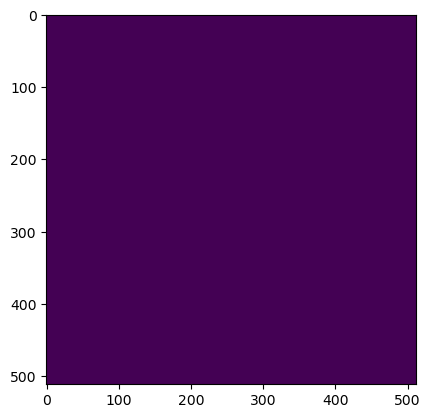

Wrote output/patches/mask/VU_S1_165-470531-2000-6310830-4000.tiff (512 x 512 pixels)


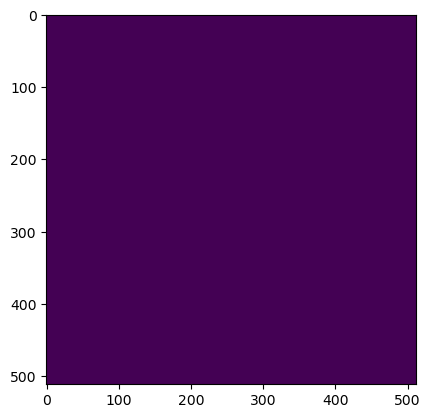

Wrote output/patches/mask/VU_S1_165-470531-2000-6310932-8000.tiff (512 x 512 pixels)


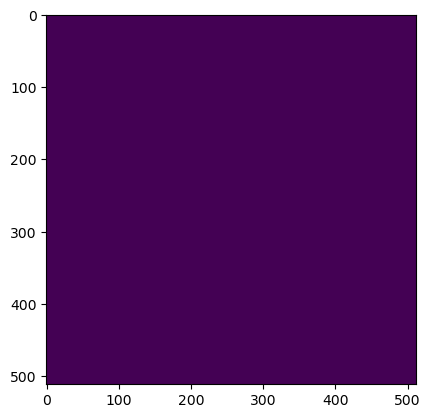

Wrote output/patches/mask/VU_S1_165-470531-2000-6311035-2000.tiff (512 x 512 pixels)


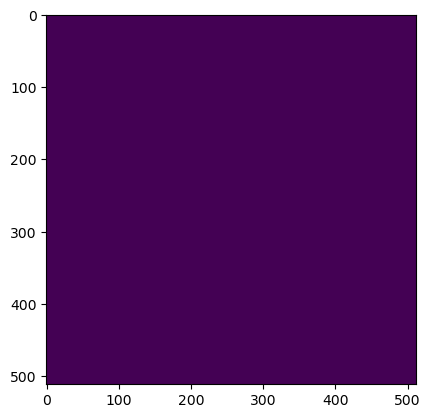

Wrote output/patches/mask/VU_S1_165-470531-2000-6311137-6000.tiff (512 x 512 pixels)


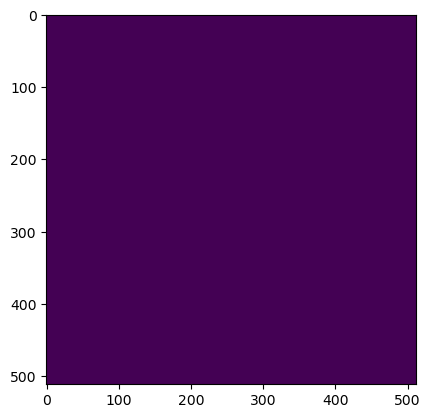

Wrote output/patches/mask/VU_S1_165-470531-2000-6311240-0000.tiff (512 x 512 pixels)


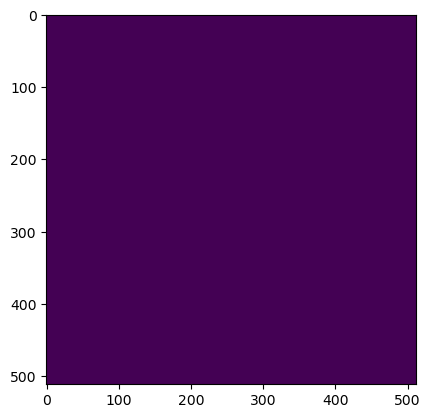

Wrote output/patches/mask/VU_S1_165-470531-2000-6311342-4000.tiff (512 x 512 pixels)


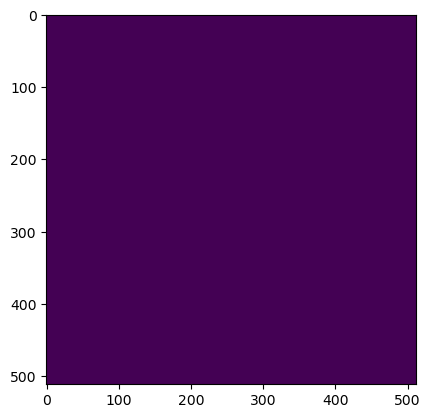

Wrote output/patches/mask/VU_S1_165-470531-2000-6311444-8000.tiff (512 x 512 pixels)
Zone VV_S1_166 Building Mask...


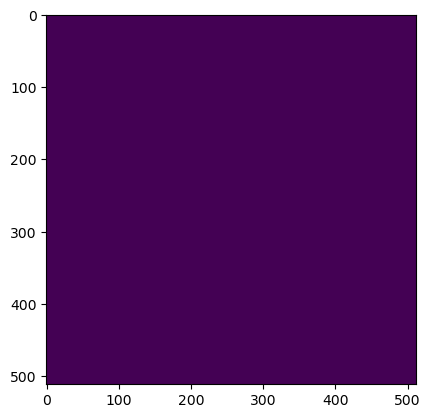

Wrote output/patches/mask/VV_S1_166-453584-0000-6310830-4000.tiff (512 x 512 pixels)


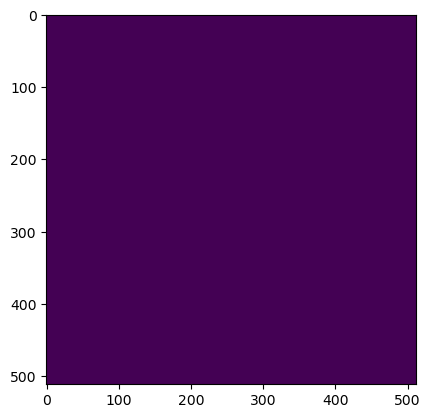

Wrote output/patches/mask/VV_S1_166-453584-0000-6310932-8000.tiff (512 x 512 pixels)


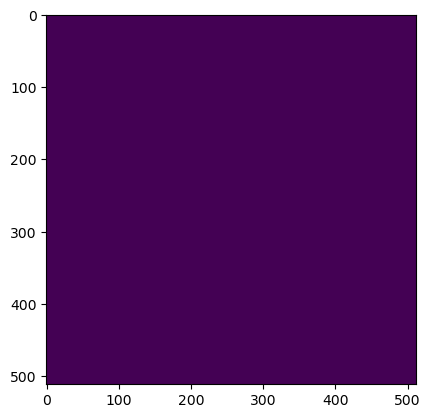

Wrote output/patches/mask/VV_S1_166-453686-4000-6310830-4000.tiff (512 x 512 pixels)


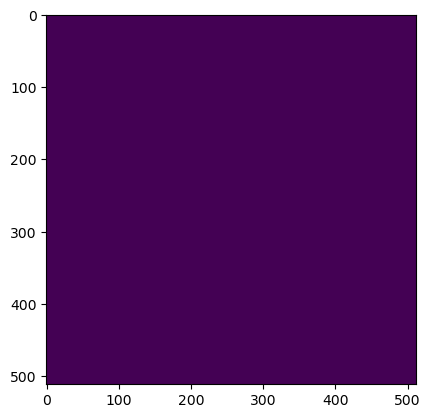

Wrote output/patches/mask/VV_S1_166-453686-4000-6310932-8000.tiff (512 x 512 pixels)


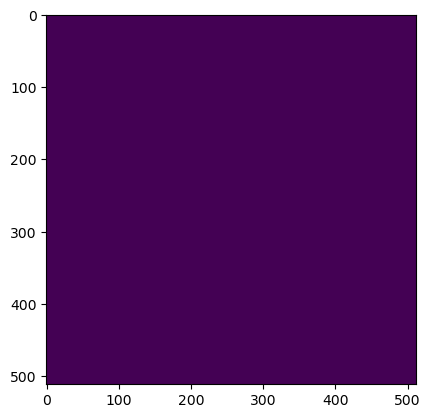

Wrote output/patches/mask/VV_S1_166-453788-8000-6310830-4000.tiff (512 x 512 pixels)


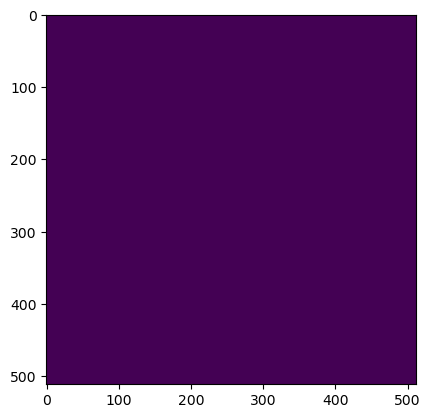

Wrote output/patches/mask/VV_S1_166-453788-8000-6310932-8000.tiff (512 x 512 pixels)


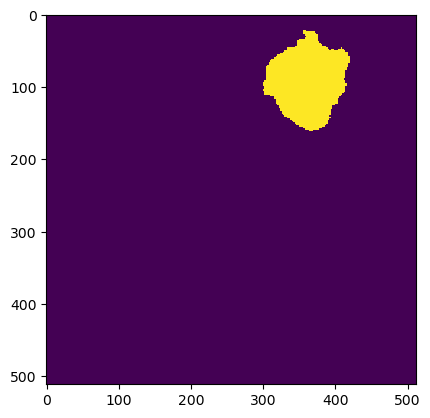

Wrote output/patches/mask/VV_S1_166-453891-2000-6310830-4000.tiff (512 x 512 pixels)


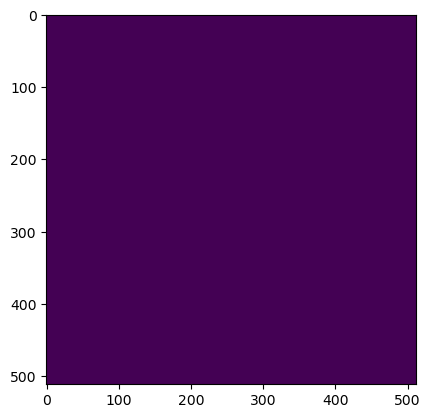

Wrote output/patches/mask/VV_S1_166-453891-2000-6310932-8000.tiff (512 x 512 pixels)
Zone UC_S1_167 Building Mask...


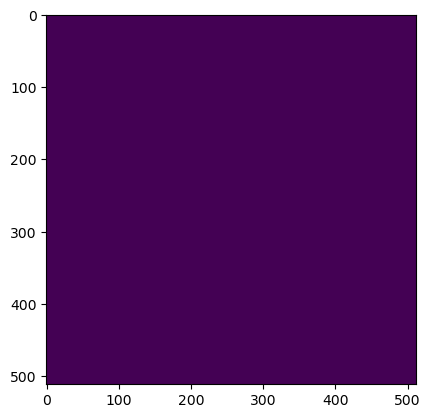

Wrote output/patches/mask/UC_S1_167-521936-0000-6310830-4000.tiff (512 x 512 pixels)


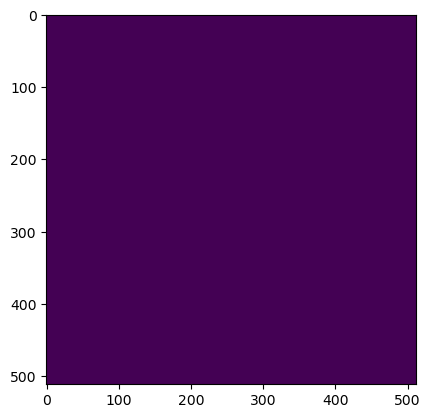

Wrote output/patches/mask/UC_S1_167-521936-0000-6310932-8000.tiff (512 x 512 pixels)


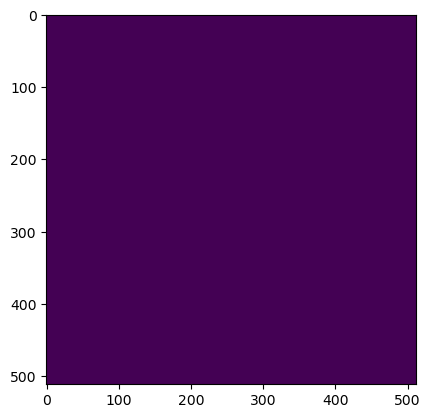

Wrote output/patches/mask/UC_S1_167-522038-4000-6310830-4000.tiff (512 x 512 pixels)


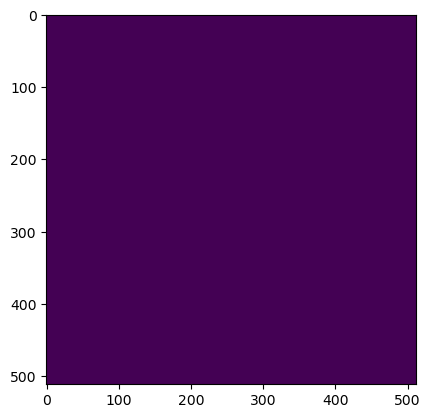

Wrote output/patches/mask/UC_S1_167-522038-4000-6310932-8000.tiff (512 x 512 pixels)
Zone VC_S1_168 Building Mask...


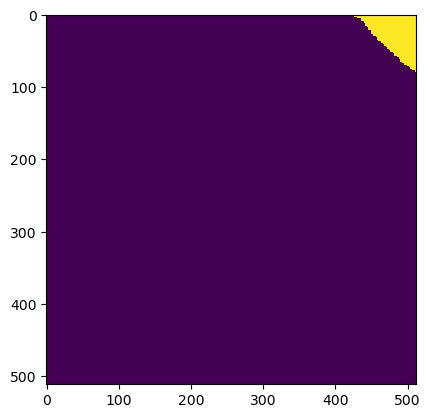

Wrote output/patches/mask/VC_S1_168-475856-0000-6311086-4000.tiff (512 x 512 pixels)


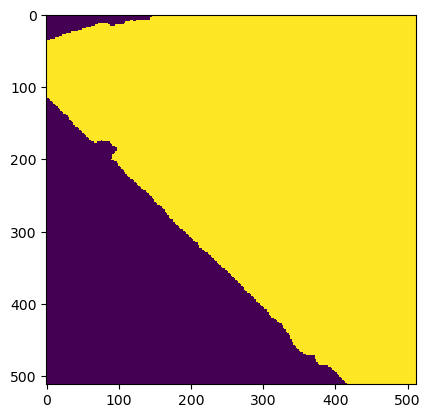

Wrote output/patches/mask/VC_S1_168-475856-0000-6311188-8000.tiff (512 x 512 pixels)


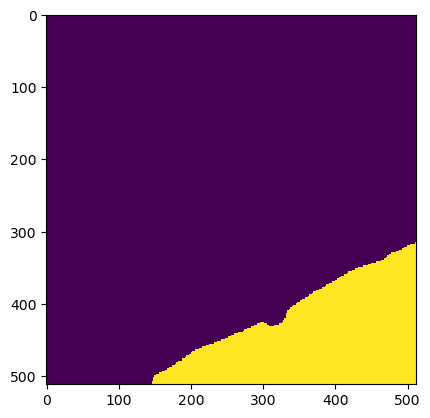

Wrote output/patches/mask/VC_S1_168-475856-0000-6311291-2000.tiff (512 x 512 pixels)


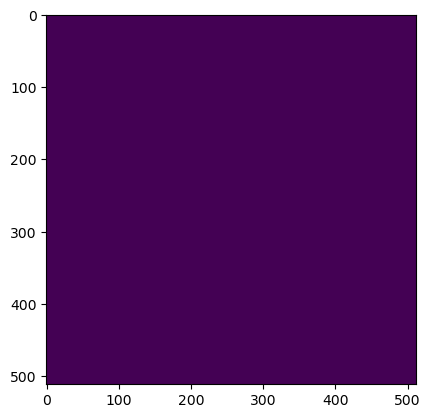

Wrote output/patches/mask/VC_S1_168-475856-0000-6311393-6000.tiff (512 x 512 pixels)


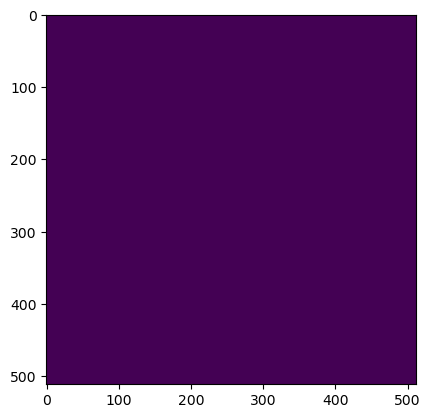

Wrote output/patches/mask/VC_S1_168-475856-0000-6311496-0000.tiff (512 x 512 pixels)


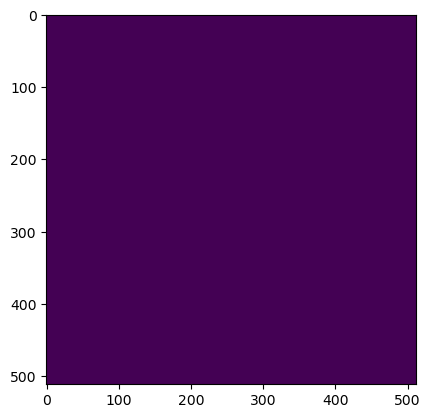

Wrote output/patches/mask/VC_S1_168-475856-0000-6311598-4000.tiff (512 x 512 pixels)


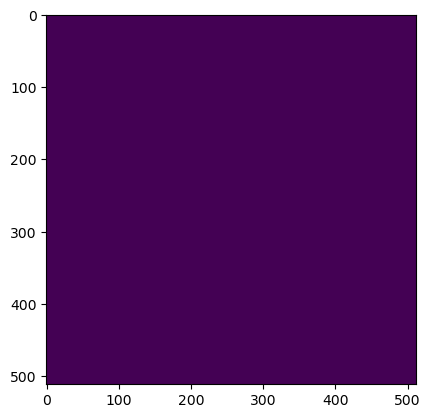

Wrote output/patches/mask/VC_S1_168-475856-0000-6311700-8000.tiff (512 x 512 pixels)


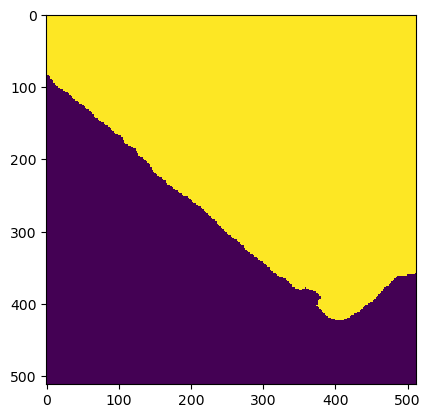

Wrote output/patches/mask/VC_S1_168-475958-4000-6311086-4000.tiff (512 x 512 pixels)


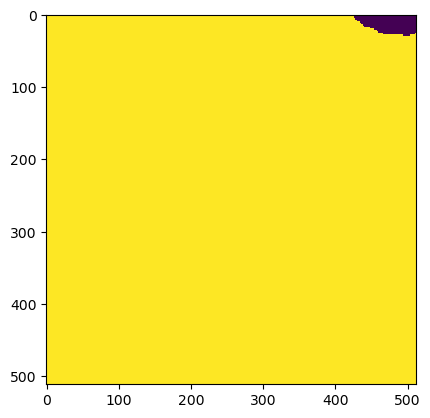

Wrote output/patches/mask/VC_S1_168-475958-4000-6311188-8000.tiff (512 x 512 pixels)


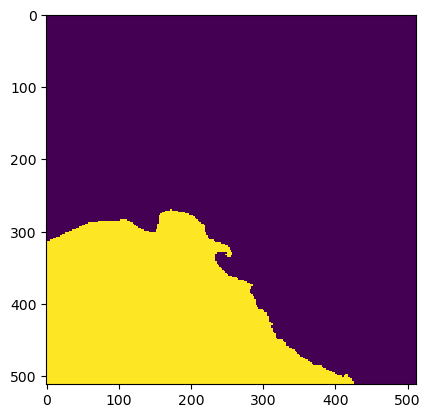

Wrote output/patches/mask/VC_S1_168-475958-4000-6311291-2000.tiff (512 x 512 pixels)


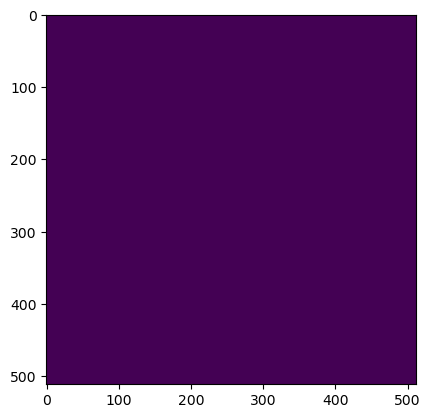

Wrote output/patches/mask/VC_S1_168-475958-4000-6311393-6000.tiff (512 x 512 pixels)


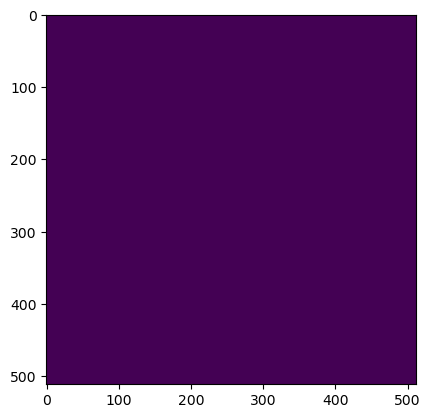

Wrote output/patches/mask/VC_S1_168-475958-4000-6311496-0000.tiff (512 x 512 pixels)


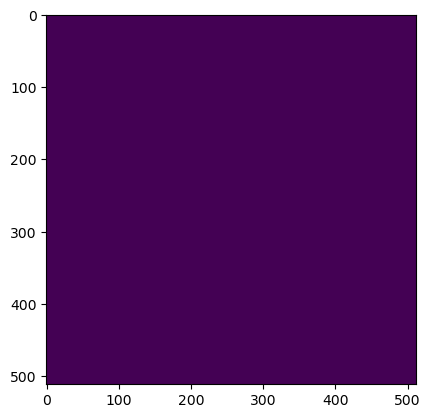

Wrote output/patches/mask/VC_S1_168-475958-4000-6311598-4000.tiff (512 x 512 pixels)


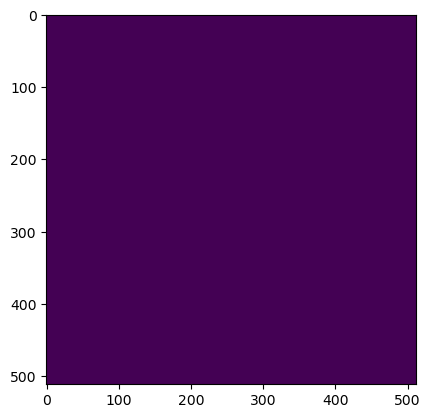

Wrote output/patches/mask/VC_S1_168-475958-4000-6311700-8000.tiff (512 x 512 pixels)


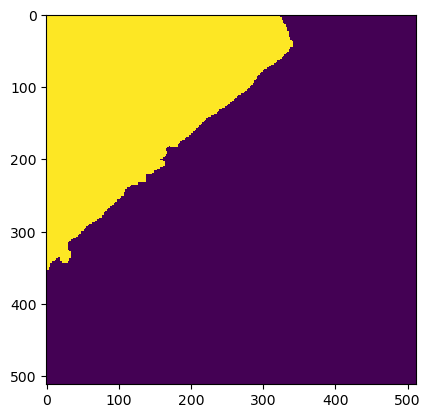

Wrote output/patches/mask/VC_S1_168-476060-8000-6311086-4000.tiff (512 x 512 pixels)


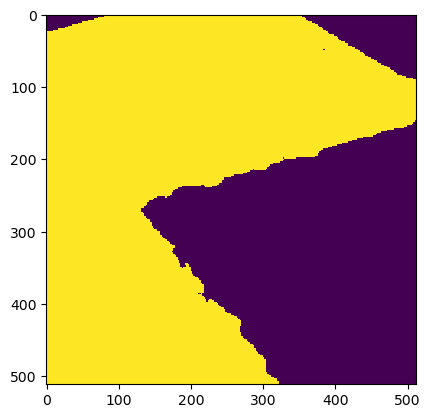

Wrote output/patches/mask/VC_S1_168-476060-8000-6311188-8000.tiff (512 x 512 pixels)


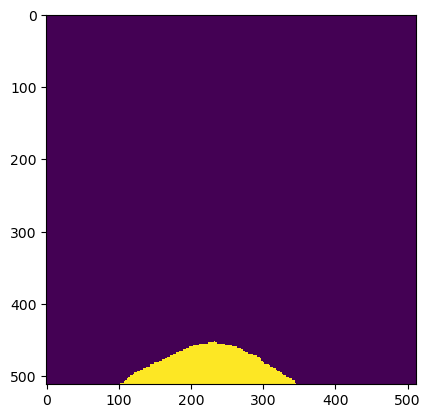

Wrote output/patches/mask/VC_S1_168-476060-8000-6311291-2000.tiff (512 x 512 pixels)


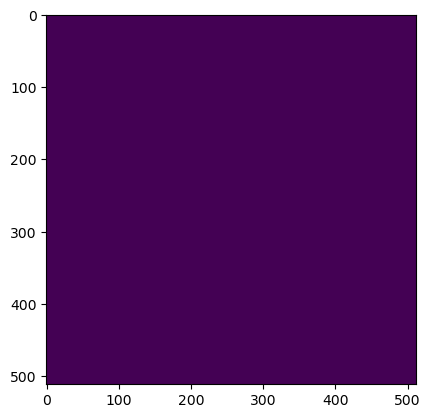

Wrote output/patches/mask/VC_S1_168-476060-8000-6311393-6000.tiff (512 x 512 pixels)


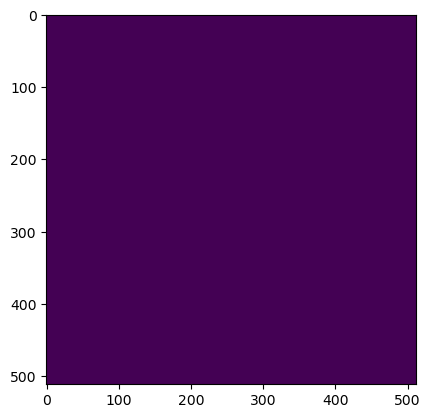

Wrote output/patches/mask/VC_S1_168-476060-8000-6311496-0000.tiff (512 x 512 pixels)


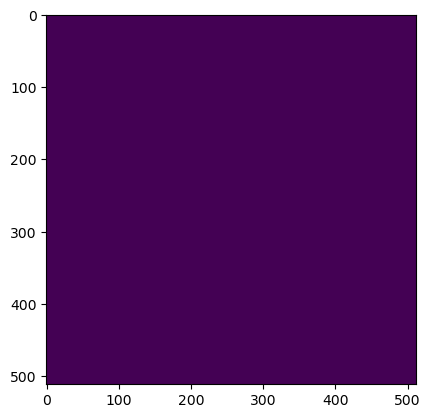

Wrote output/patches/mask/VC_S1_168-476060-8000-6311598-4000.tiff (512 x 512 pixels)


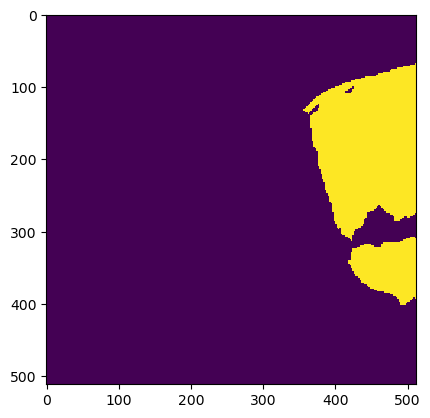

Wrote output/patches/mask/VC_S1_168-476060-8000-6311700-8000.tiff (512 x 512 pixels)


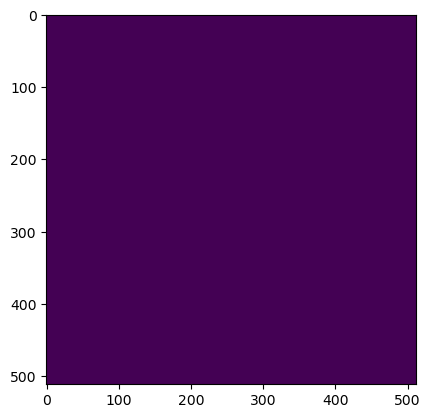

Wrote output/patches/mask/VC_S1_168-476163-2000-6311086-4000.tiff (512 x 512 pixels)


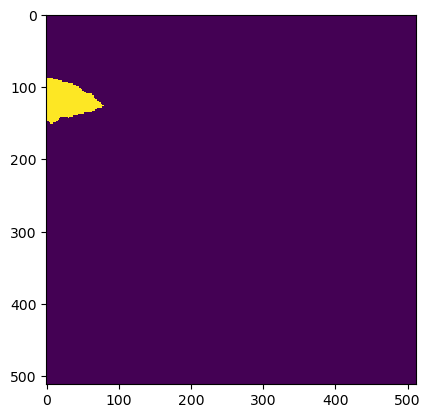

Wrote output/patches/mask/VC_S1_168-476163-2000-6311188-8000.tiff (512 x 512 pixels)


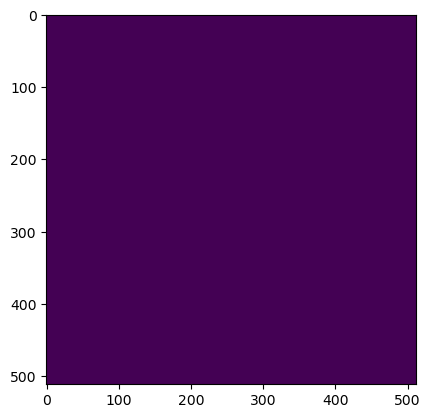

Wrote output/patches/mask/VC_S1_168-476163-2000-6311291-2000.tiff (512 x 512 pixels)


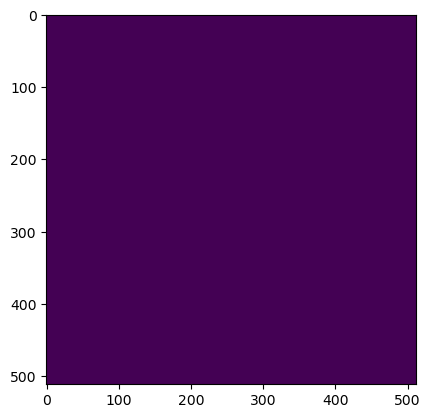

Wrote output/patches/mask/VC_S1_168-476163-2000-6311393-6000.tiff (512 x 512 pixels)


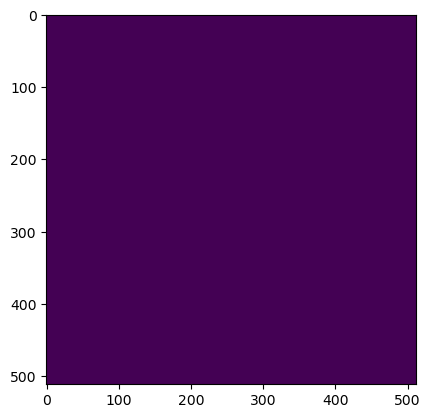

Wrote output/patches/mask/VC_S1_168-476163-2000-6311496-0000.tiff (512 x 512 pixels)


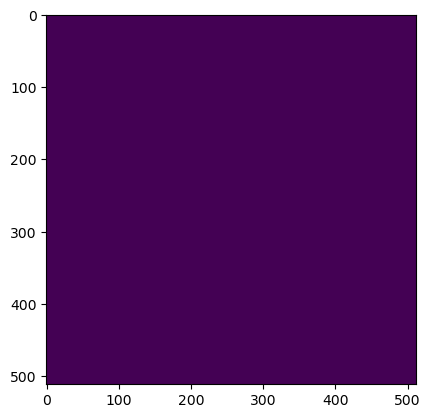

Wrote output/patches/mask/VC_S1_168-476163-2000-6311598-4000.tiff (512 x 512 pixels)


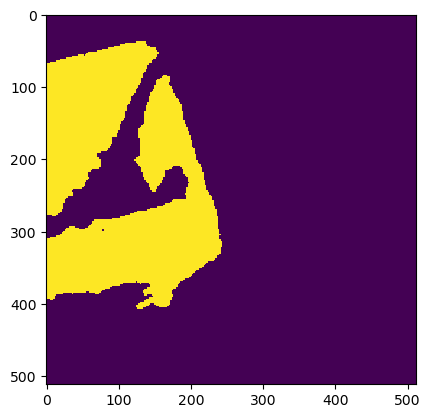

Wrote output/patches/mask/VC_S1_168-476163-2000-6311700-8000.tiff (512 x 512 pixels)


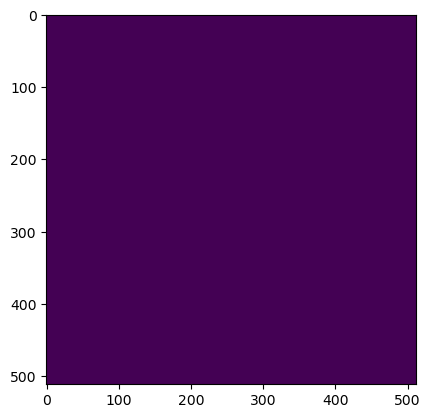

Wrote output/patches/mask/VC_S1_168-476265-6000-6311086-4000.tiff (512 x 512 pixels)


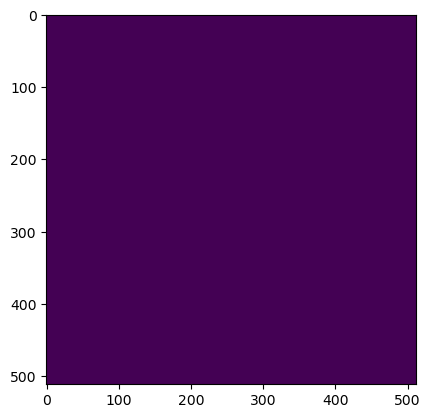

Wrote output/patches/mask/VC_S1_168-476265-6000-6311188-8000.tiff (512 x 512 pixels)


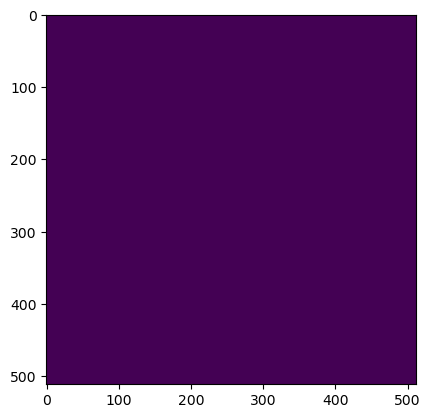

Wrote output/patches/mask/VC_S1_168-476265-6000-6311291-2000.tiff (512 x 512 pixels)


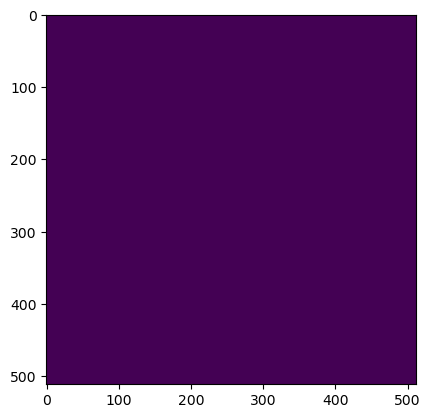

Wrote output/patches/mask/VC_S1_168-476265-6000-6311393-6000.tiff (512 x 512 pixels)


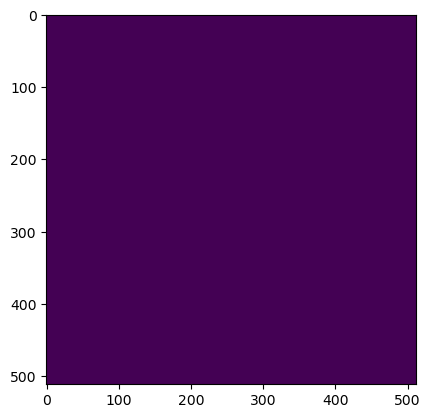

Wrote output/patches/mask/VC_S1_168-476265-6000-6311496-0000.tiff (512 x 512 pixels)


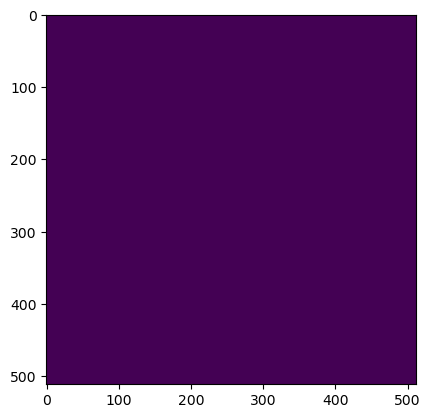

Wrote output/patches/mask/VC_S1_168-476265-6000-6311598-4000.tiff (512 x 512 pixels)


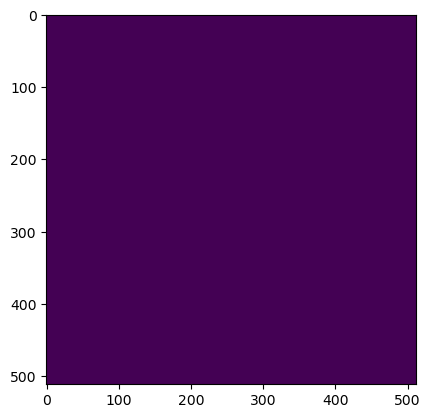

Wrote output/patches/mask/VC_S1_168-476265-6000-6311700-8000.tiff (512 x 512 pixels)


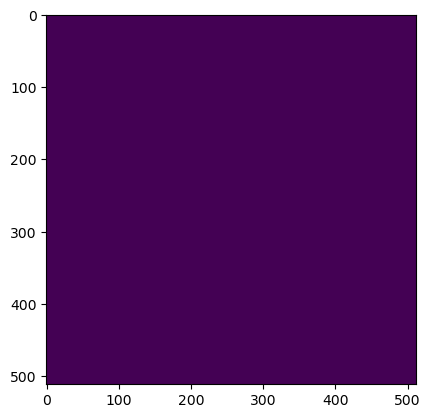

Wrote output/patches/mask/VC_S1_168-476368-0000-6311086-4000.tiff (512 x 512 pixels)


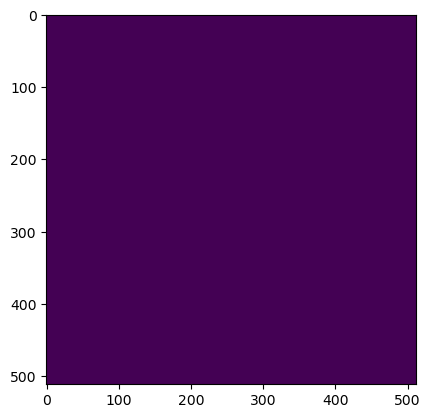

Wrote output/patches/mask/VC_S1_168-476368-0000-6311188-8000.tiff (512 x 512 pixels)


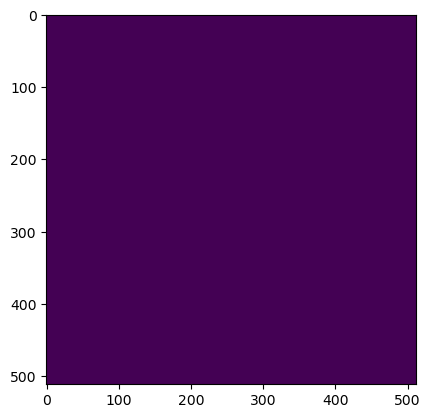

Wrote output/patches/mask/VC_S1_168-476368-0000-6311291-2000.tiff (512 x 512 pixels)


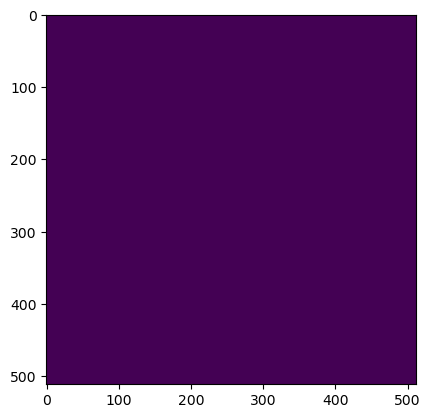

Wrote output/patches/mask/VC_S1_168-476368-0000-6311393-6000.tiff (512 x 512 pixels)


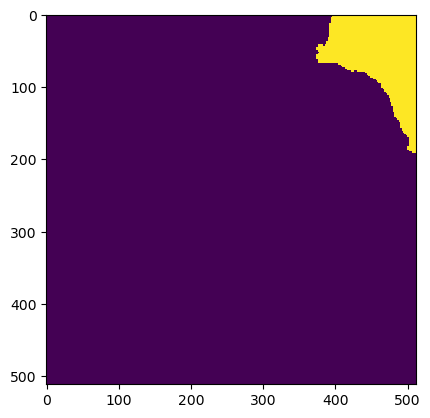

Wrote output/patches/mask/VC_S1_168-476368-0000-6311496-0000.tiff (512 x 512 pixels)


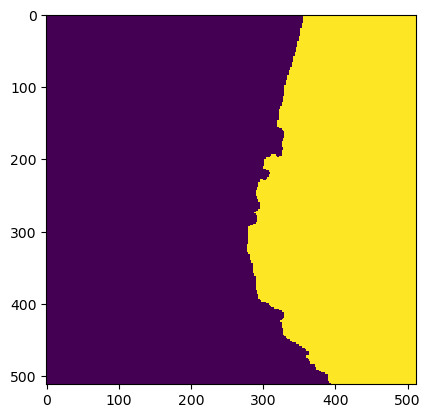

Wrote output/patches/mask/VC_S1_168-476368-0000-6311598-4000.tiff (512 x 512 pixels)


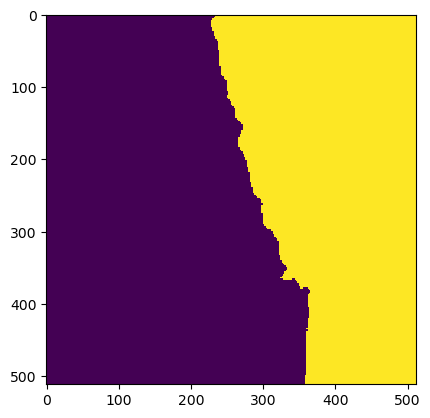

Wrote output/patches/mask/VC_S1_168-476368-0000-6311700-8000.tiff (512 x 512 pixels)


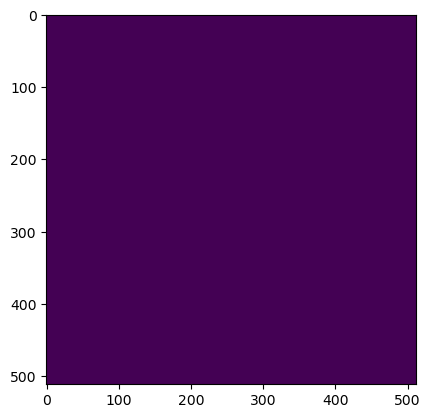

Wrote output/patches/mask/VC_S1_168-476470-4000-6311086-4000.tiff (512 x 512 pixels)


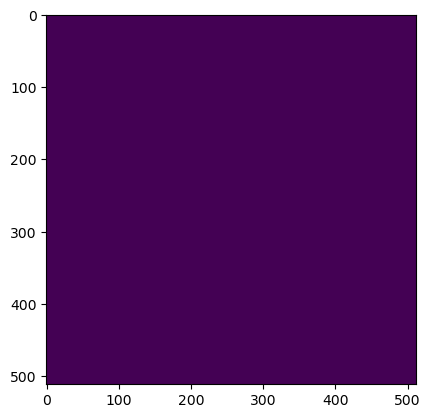

Wrote output/patches/mask/VC_S1_168-476470-4000-6311188-8000.tiff (512 x 512 pixels)


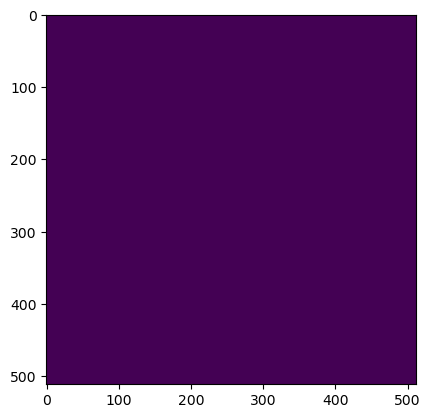

Wrote output/patches/mask/VC_S1_168-476470-4000-6311291-2000.tiff (512 x 512 pixels)


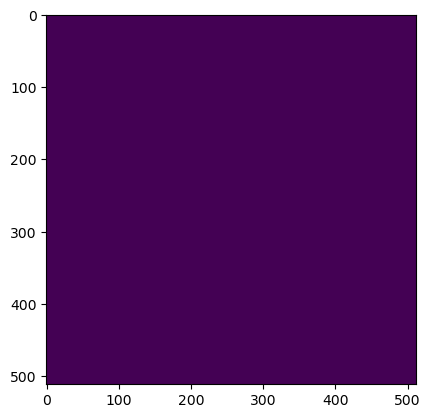

Wrote output/patches/mask/VC_S1_168-476470-4000-6311393-6000.tiff (512 x 512 pixels)


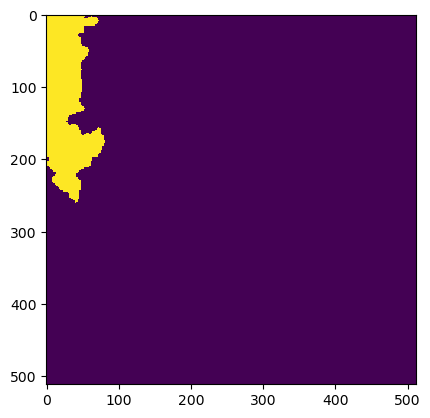

Wrote output/patches/mask/VC_S1_168-476470-4000-6311496-0000.tiff (512 x 512 pixels)


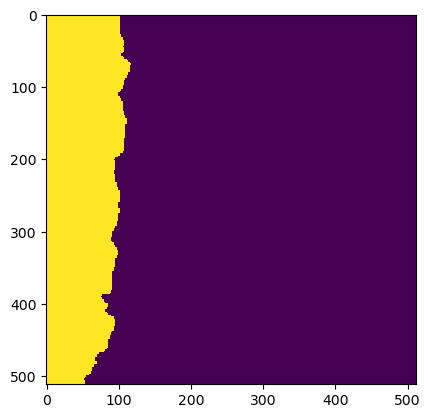

Wrote output/patches/mask/VC_S1_168-476470-4000-6311598-4000.tiff (512 x 512 pixels)


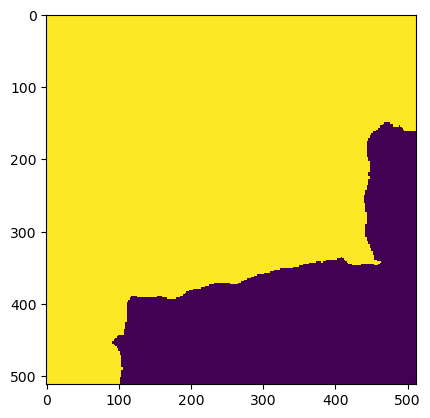

Wrote output/patches/mask/VC_S1_168-476470-4000-6311700-8000.tiff (512 x 512 pixels)
Zone CV_S1_169 Building Mask...


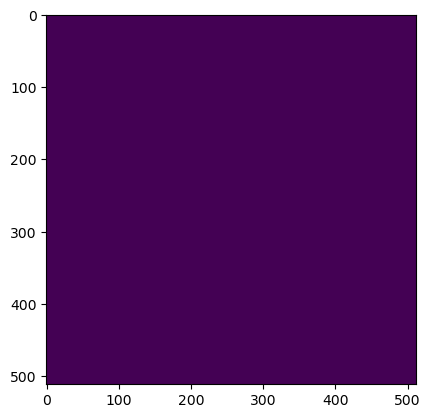

Wrote output/patches/mask/CV_S1_169-494544-0000-6311086-4000.tiff (512 x 512 pixels)


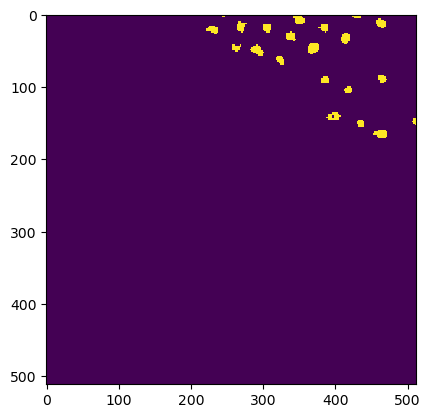

Wrote output/patches/mask/CV_S1_169-494544-0000-6311188-8000.tiff (512 x 512 pixels)


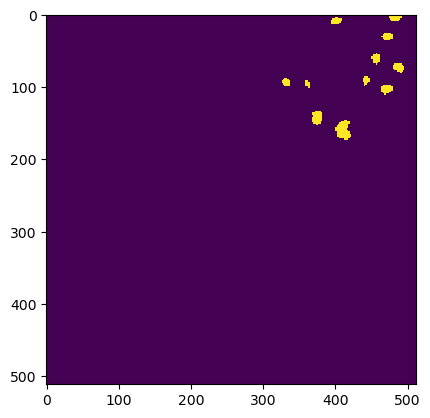

Wrote output/patches/mask/CV_S1_169-494646-4000-6311086-4000.tiff (512 x 512 pixels)


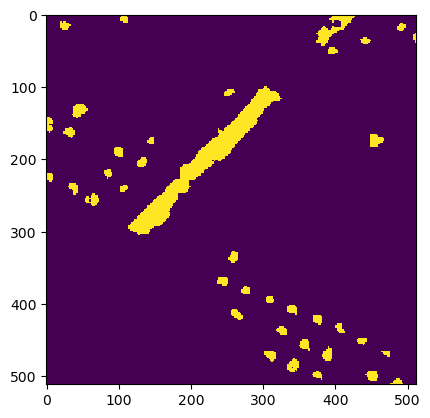

Wrote output/patches/mask/CV_S1_169-494646-4000-6311188-8000.tiff (512 x 512 pixels)
Zone UV_S1_170 Building Mask...


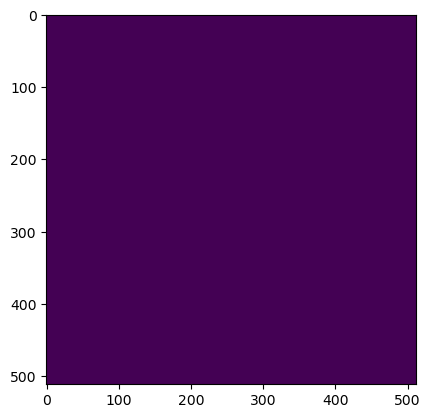

Wrote output/patches/mask/UV_S1_170-444112-0000-6311086-4000.tiff (512 x 512 pixels)


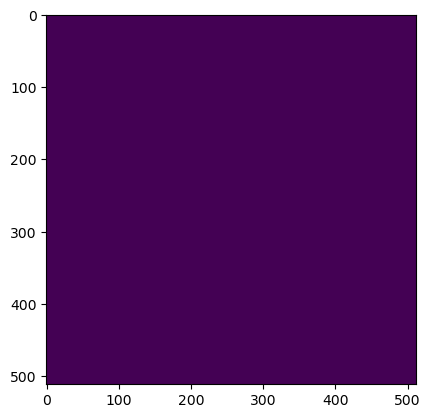

Wrote output/patches/mask/UV_S1_170-444112-0000-6311188-8000.tiff (512 x 512 pixels)


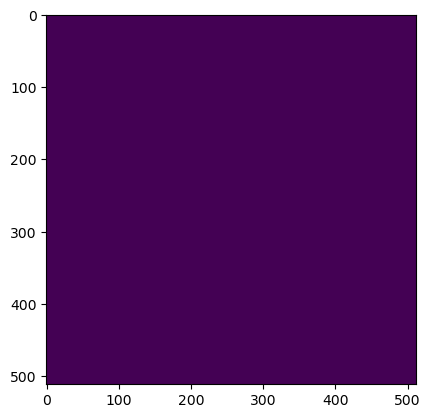

Wrote output/patches/mask/UV_S1_170-444112-0000-6311291-2000.tiff (512 x 512 pixels)


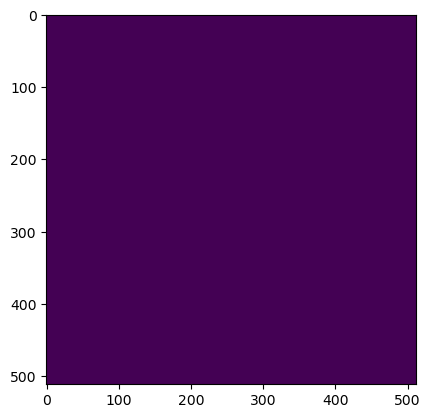

Wrote output/patches/mask/UV_S1_170-444112-0000-6311393-6000.tiff (512 x 512 pixels)


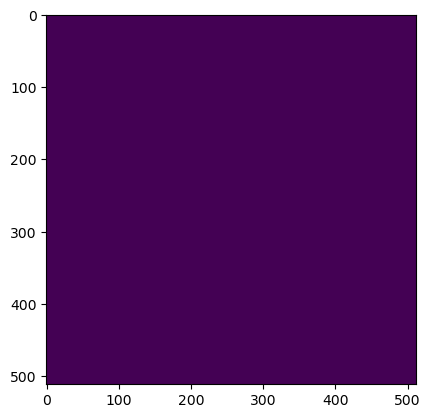

Wrote output/patches/mask/UV_S1_170-444214-4000-6311086-4000.tiff (512 x 512 pixels)


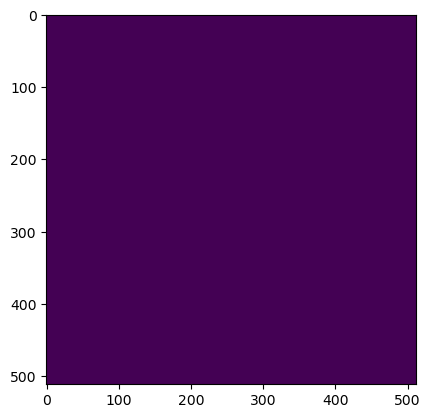

Wrote output/patches/mask/UV_S1_170-444214-4000-6311188-8000.tiff (512 x 512 pixels)


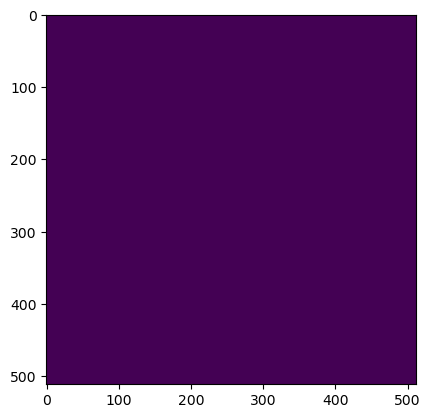

Wrote output/patches/mask/UV_S1_170-444214-4000-6311291-2000.tiff (512 x 512 pixels)


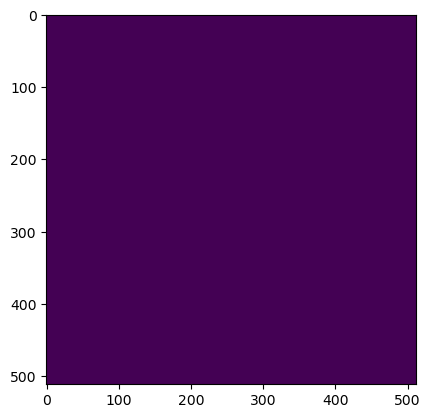

Wrote output/patches/mask/UV_S1_170-444214-4000-6311393-6000.tiff (512 x 512 pixels)


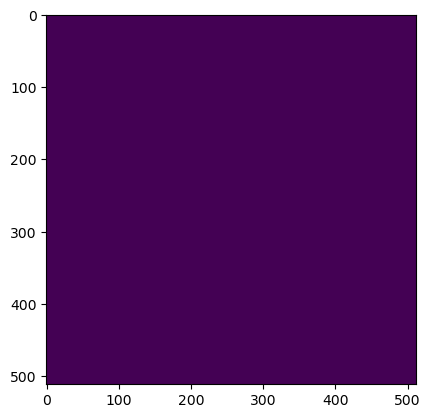

Wrote output/patches/mask/UV_S1_170-444316-8000-6311086-4000.tiff (512 x 512 pixels)


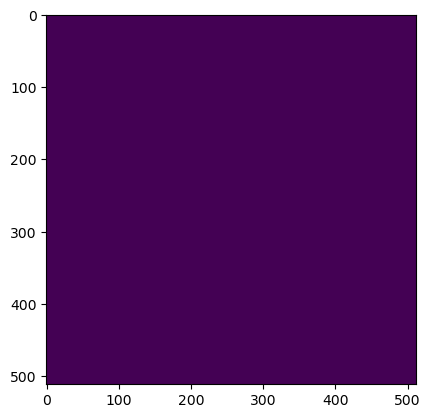

Wrote output/patches/mask/UV_S1_170-444316-8000-6311188-8000.tiff (512 x 512 pixels)


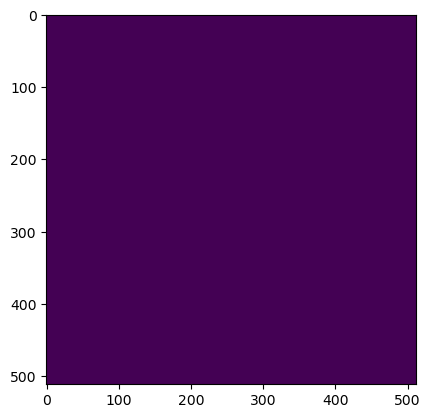

Wrote output/patches/mask/UV_S1_170-444316-8000-6311291-2000.tiff (512 x 512 pixels)


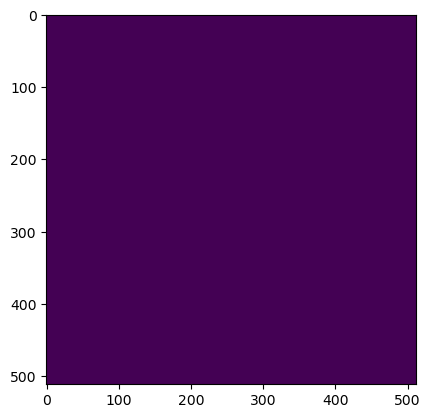

Wrote output/patches/mask/UV_S1_170-444316-8000-6311393-6000.tiff (512 x 512 pixels)


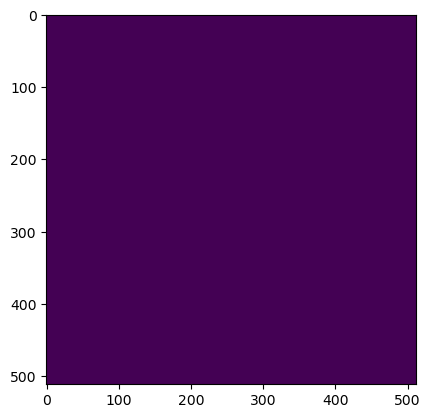

Wrote output/patches/mask/UV_S1_170-444419-2000-6311086-4000.tiff (512 x 512 pixels)


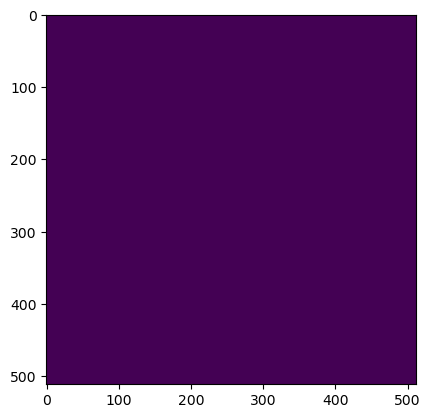

Wrote output/patches/mask/UV_S1_170-444419-2000-6311188-8000.tiff (512 x 512 pixels)


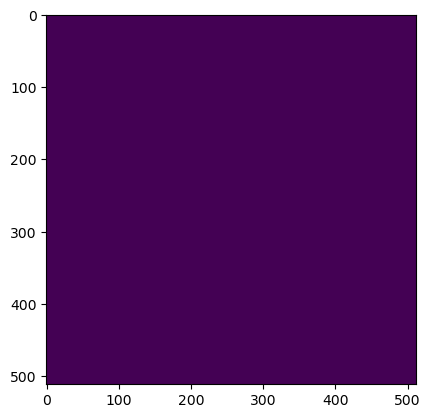

Wrote output/patches/mask/UV_S1_170-444419-2000-6311291-2000.tiff (512 x 512 pixels)


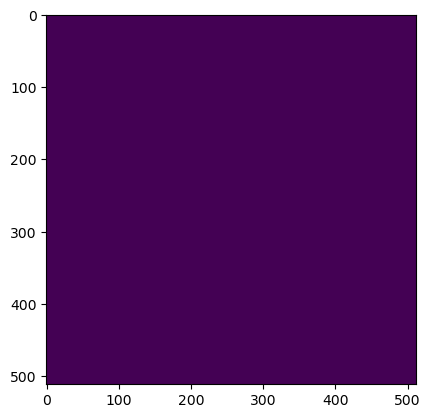

Wrote output/patches/mask/UV_S1_170-444419-2000-6311393-6000.tiff (512 x 512 pixels)
Zone VC_S1_171 Building Mask...


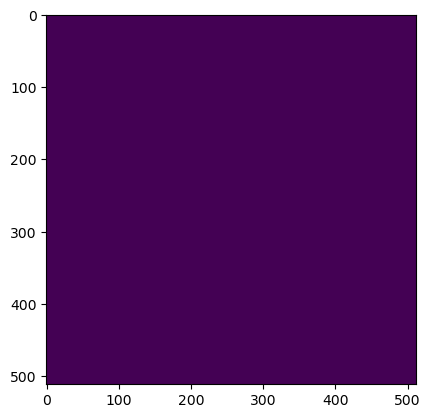

Wrote output/patches/mask/VC_S1_171-481232-0000-6311086-4000.tiff (512 x 512 pixels)


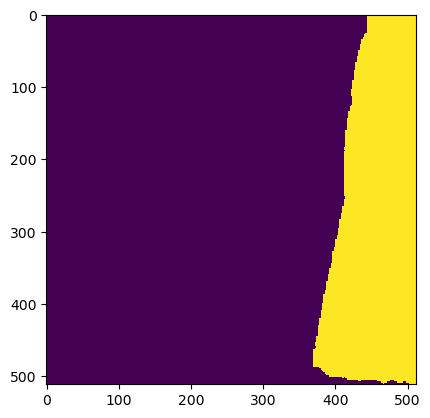

Wrote output/patches/mask/VC_S1_171-481232-0000-6311188-8000.tiff (512 x 512 pixels)


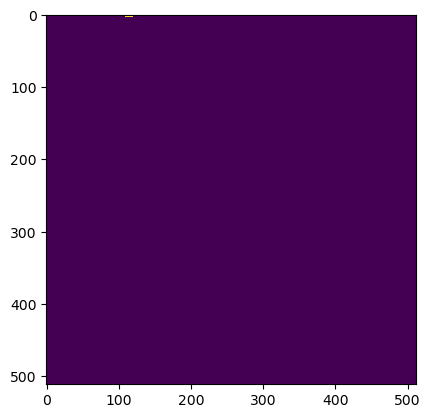

Wrote output/patches/mask/VC_S1_171-481334-4000-6311086-4000.tiff (512 x 512 pixels)


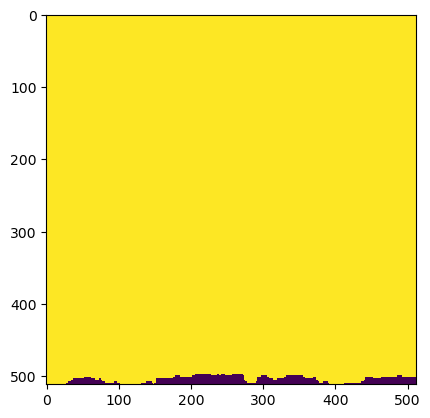

Wrote output/patches/mask/VC_S1_171-481334-4000-6311188-8000.tiff (512 x 512 pixels)
Zone UV_S1_172 Building Mask...


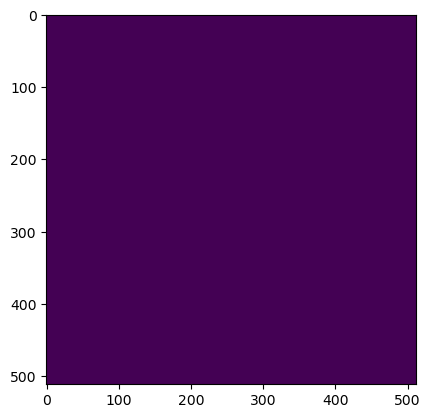

Wrote output/patches/mask/UV_S1_172-479184-0000-6311598-4000.tiff (512 x 512 pixels)


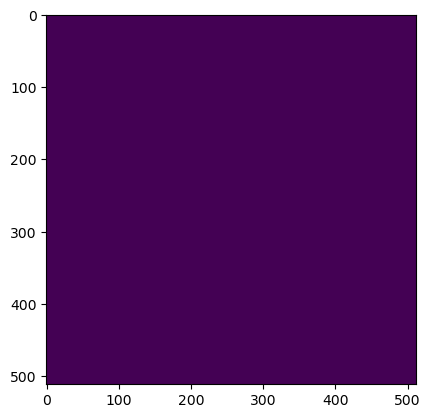

Wrote output/patches/mask/UV_S1_172-479184-0000-6311700-8000.tiff (512 x 512 pixels)


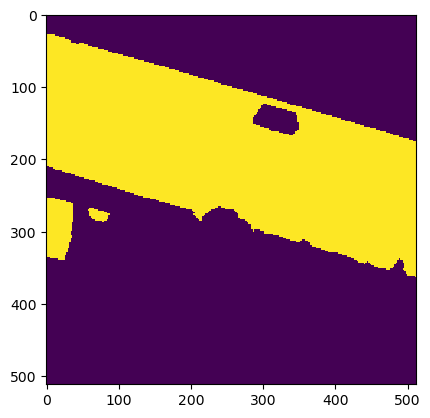

Wrote output/patches/mask/UV_S1_172-479184-0000-6311803-2000.tiff (512 x 512 pixels)


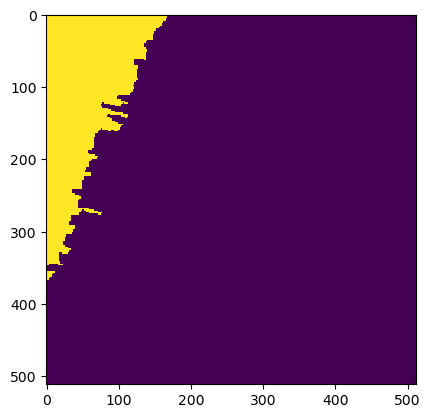

Wrote output/patches/mask/UV_S1_172-479184-0000-6311905-6000.tiff (512 x 512 pixels)


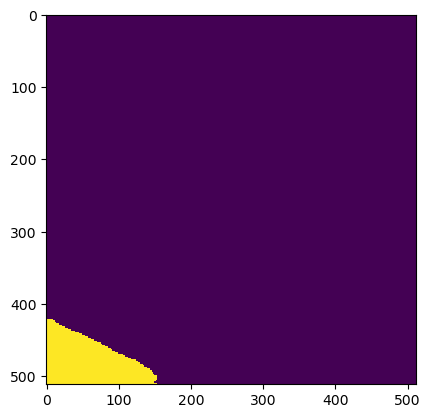

Wrote output/patches/mask/UV_S1_172-479184-0000-6312008-0000.tiff (512 x 512 pixels)


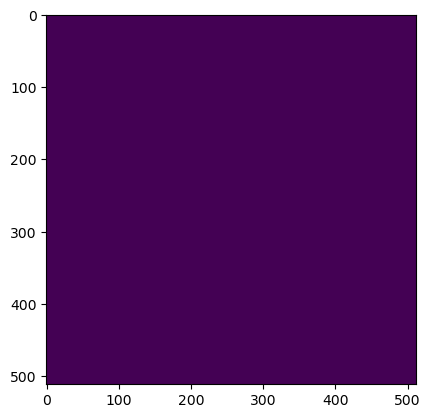

Wrote output/patches/mask/UV_S1_172-479184-0000-6312110-4000.tiff (512 x 512 pixels)


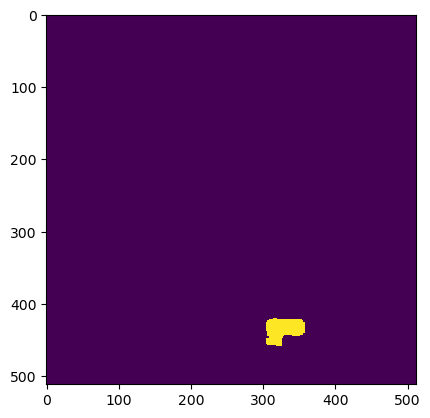

Wrote output/patches/mask/UV_S1_172-479184-0000-6312212-8000.tiff (512 x 512 pixels)


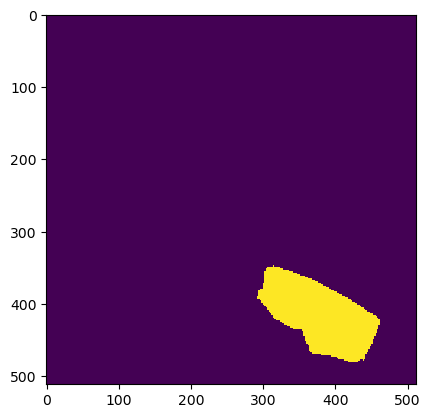

Wrote output/patches/mask/UV_S1_172-479286-4000-6311598-4000.tiff (512 x 512 pixels)


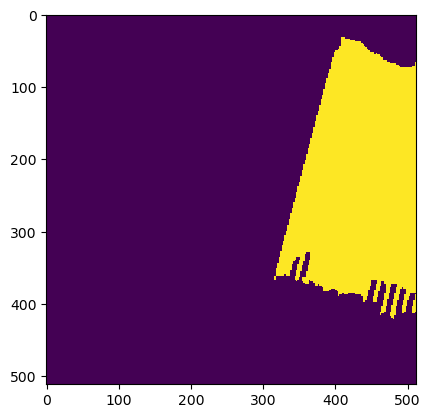

Wrote output/patches/mask/UV_S1_172-479286-4000-6311700-8000.tiff (512 x 512 pixels)


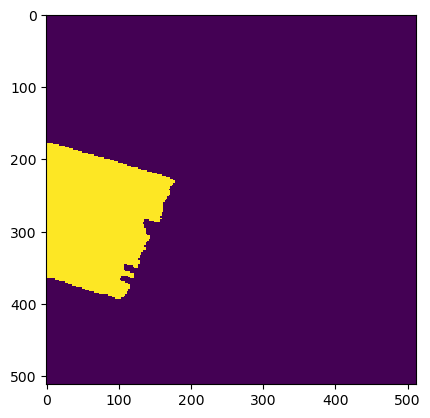

Wrote output/patches/mask/UV_S1_172-479286-4000-6311803-2000.tiff (512 x 512 pixels)


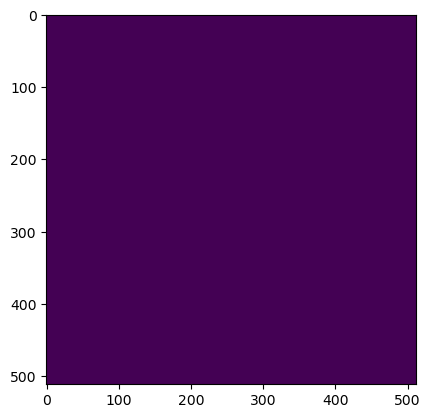

Wrote output/patches/mask/UV_S1_172-479286-4000-6311905-6000.tiff (512 x 512 pixels)


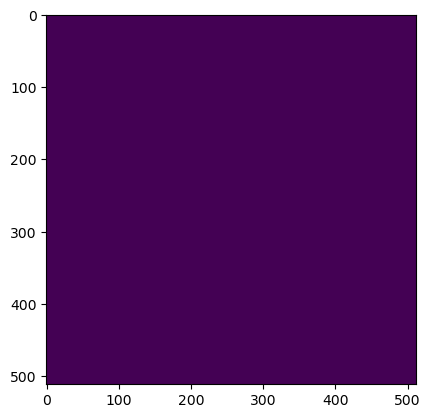

Wrote output/patches/mask/UV_S1_172-479286-4000-6312008-0000.tiff (512 x 512 pixels)


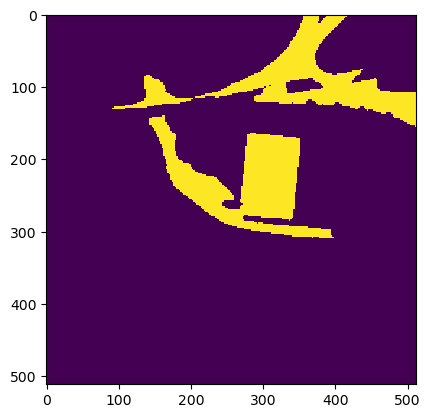

Wrote output/patches/mask/UV_S1_172-479286-4000-6312110-4000.tiff (512 x 512 pixels)


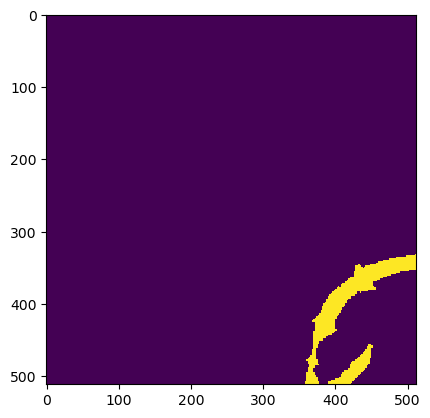

Wrote output/patches/mask/UV_S1_172-479286-4000-6312212-8000.tiff (512 x 512 pixels)


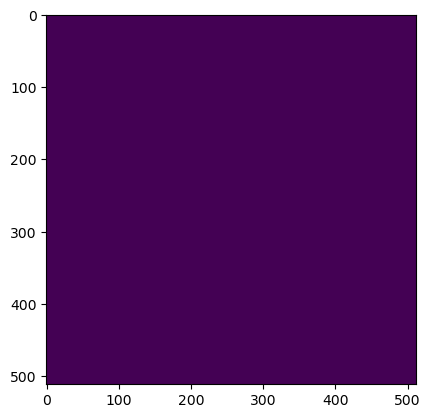

Wrote output/patches/mask/UV_S1_172-479388-8000-6311598-4000.tiff (512 x 512 pixels)


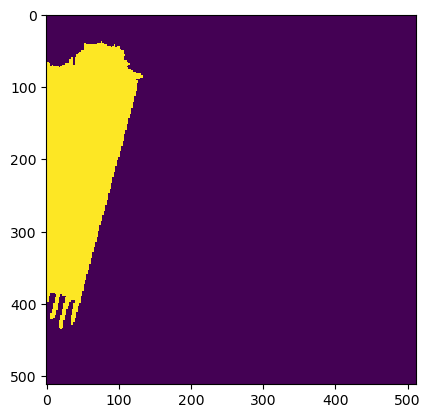

Wrote output/patches/mask/UV_S1_172-479388-8000-6311700-8000.tiff (512 x 512 pixels)


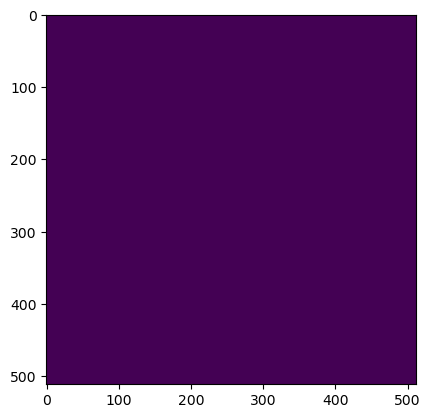

Wrote output/patches/mask/UV_S1_172-479388-8000-6311803-2000.tiff (512 x 512 pixels)


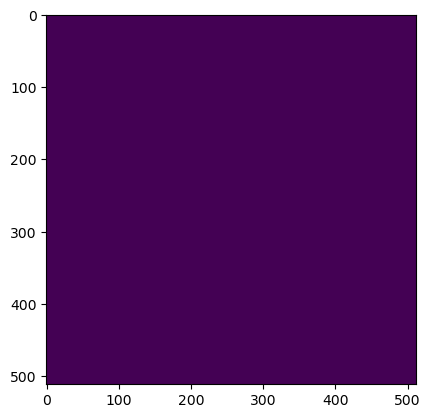

Wrote output/patches/mask/UV_S1_172-479388-8000-6311905-6000.tiff (512 x 512 pixels)


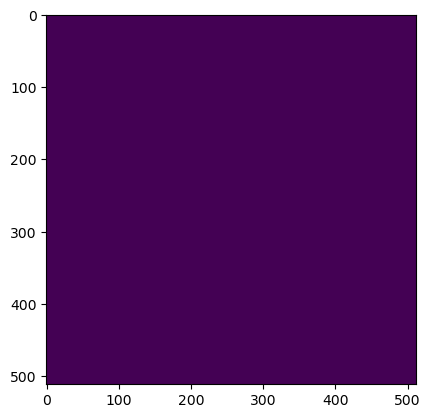

Wrote output/patches/mask/UV_S1_172-479388-8000-6312008-0000.tiff (512 x 512 pixels)


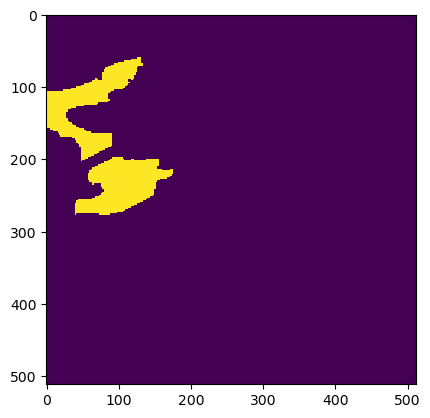

Wrote output/patches/mask/UV_S1_172-479388-8000-6312110-4000.tiff (512 x 512 pixels)


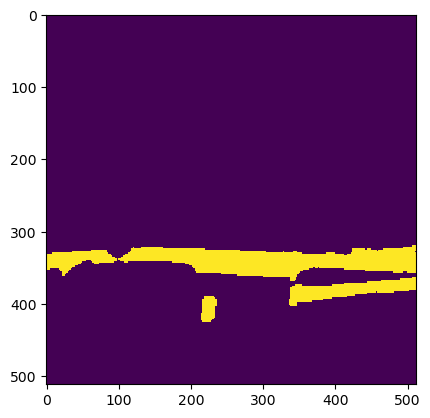

Wrote output/patches/mask/UV_S1_172-479388-8000-6312212-8000.tiff (512 x 512 pixels)


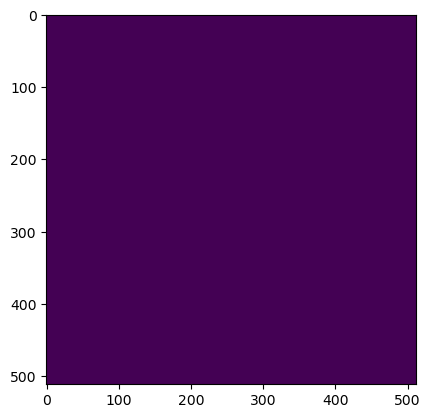

Wrote output/patches/mask/UV_S1_172-479491-2000-6311598-4000.tiff (512 x 512 pixels)


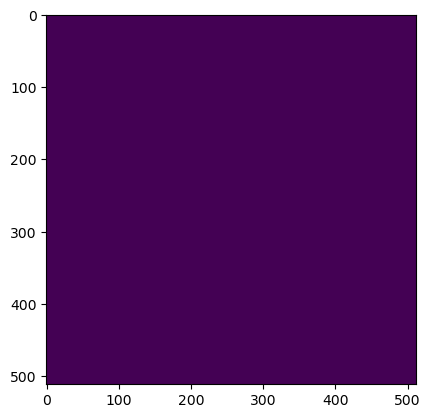

Wrote output/patches/mask/UV_S1_172-479491-2000-6311700-8000.tiff (512 x 512 pixels)


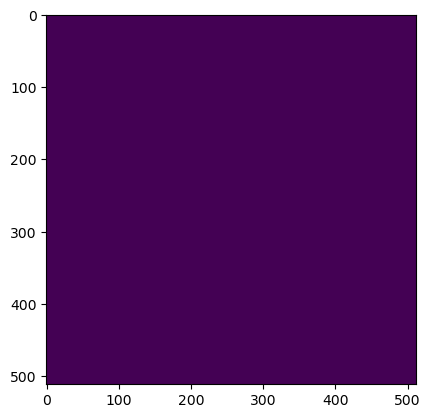

Wrote output/patches/mask/UV_S1_172-479491-2000-6311803-2000.tiff (512 x 512 pixels)


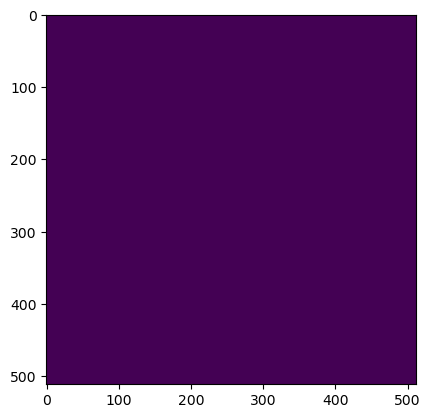

Wrote output/patches/mask/UV_S1_172-479491-2000-6311905-6000.tiff (512 x 512 pixels)


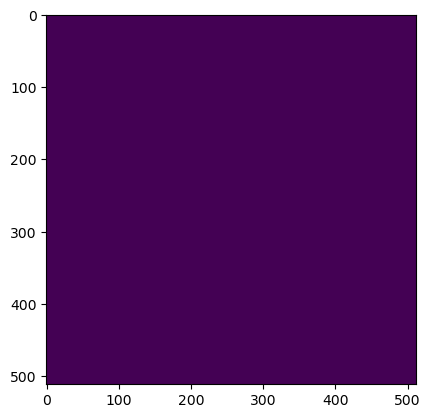

Wrote output/patches/mask/UV_S1_172-479491-2000-6312008-0000.tiff (512 x 512 pixels)


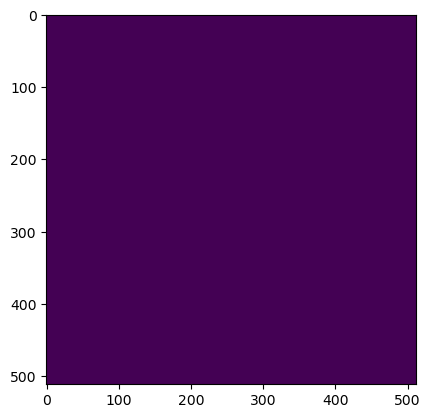

Wrote output/patches/mask/UV_S1_172-479491-2000-6312110-4000.tiff (512 x 512 pixels)


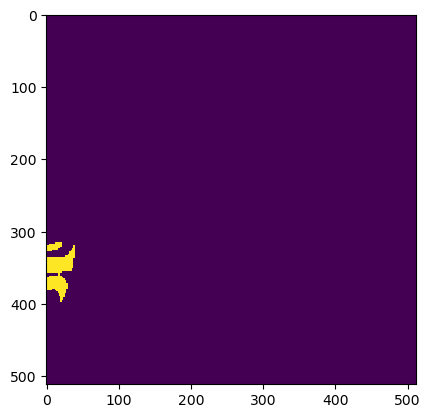

Wrote output/patches/mask/UV_S1_172-479491-2000-6312212-8000.tiff (512 x 512 pixels)
Zone UV_S1_173 Building Mask...


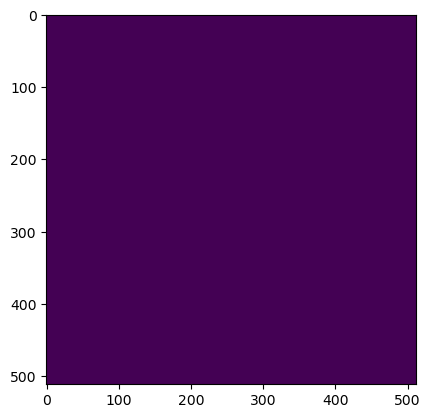

Wrote output/patches/mask/UV_S1_173-472272-0000-6311598-4000.tiff (512 x 512 pixels)


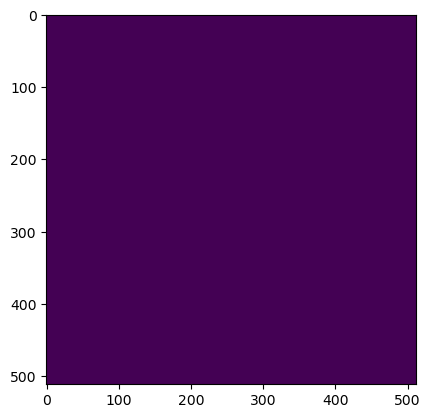

Wrote output/patches/mask/UV_S1_173-472272-0000-6311700-8000.tiff (512 x 512 pixels)


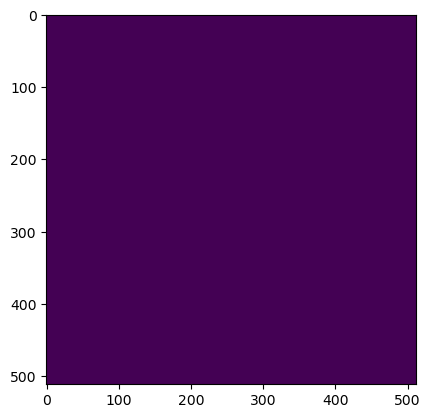

Wrote output/patches/mask/UV_S1_173-472374-4000-6311598-4000.tiff (512 x 512 pixels)


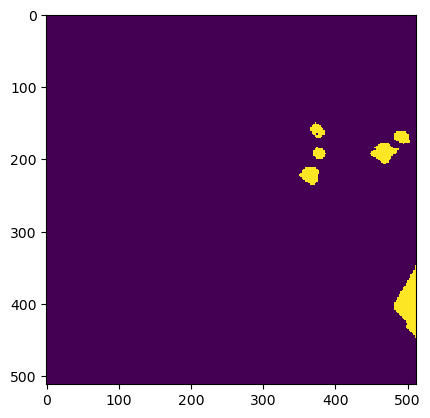

Wrote output/patches/mask/UV_S1_173-472374-4000-6311700-8000.tiff (512 x 512 pixels)


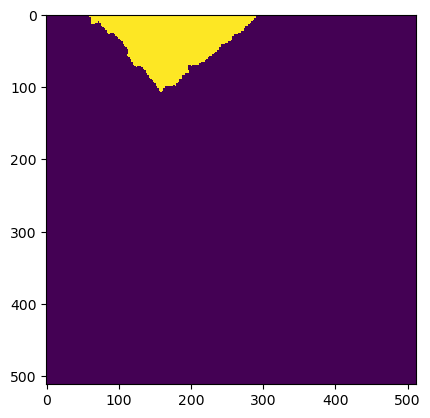

Wrote output/patches/mask/UV_S1_173-472476-8000-6311598-4000.tiff (512 x 512 pixels)


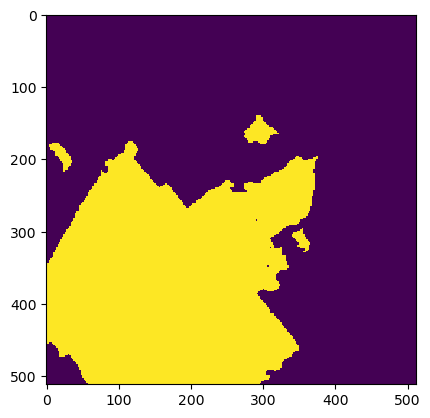

Wrote output/patches/mask/UV_S1_173-472476-8000-6311700-8000.tiff (512 x 512 pixels)


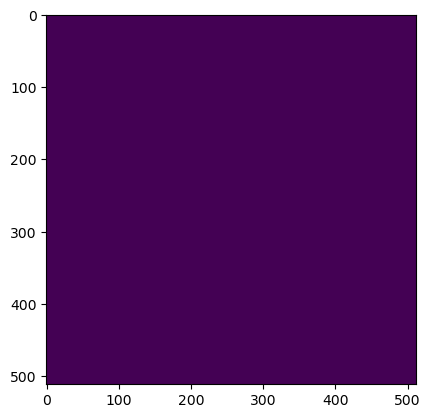

Wrote output/patches/mask/UV_S1_173-472579-2000-6311598-4000.tiff (512 x 512 pixels)


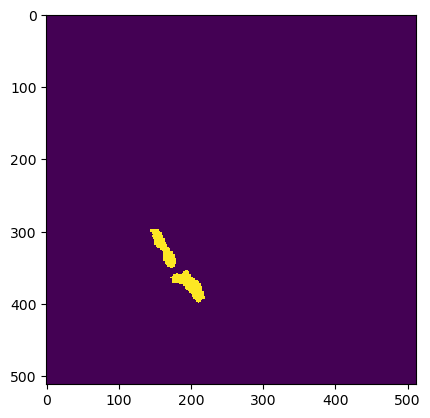

Wrote output/patches/mask/UV_S1_173-472579-2000-6311700-8000.tiff (512 x 512 pixels)
Zone VV_S1_174 Building Mask...


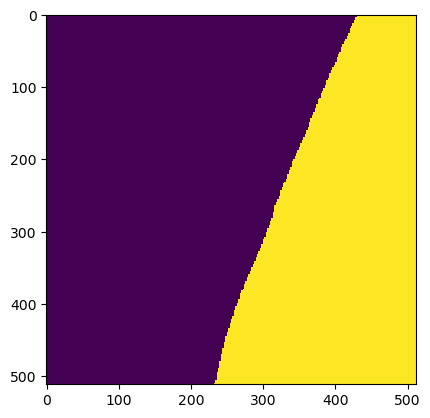

Wrote output/patches/mask/VV_S1_174-468176-0000-6311598-4000.tiff (512 x 512 pixels)


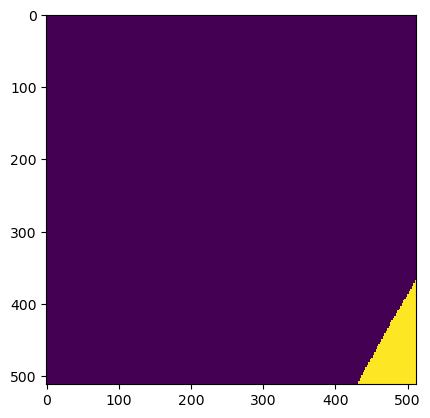

Wrote output/patches/mask/VV_S1_174-468176-0000-6311700-8000.tiff (512 x 512 pixels)


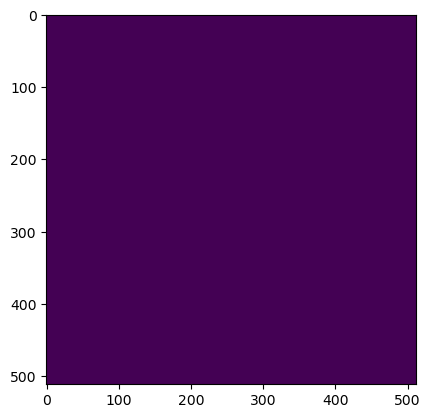

Wrote output/patches/mask/VV_S1_174-468278-4000-6311598-4000.tiff (512 x 512 pixels)


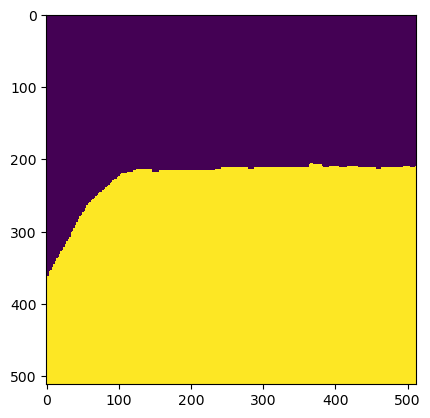

Wrote output/patches/mask/VV_S1_174-468278-4000-6311700-8000.tiff (512 x 512 pixels)
Zone VC_S1_175 Building Mask...


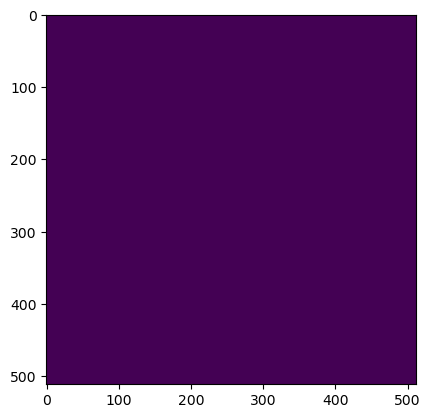

Wrote output/patches/mask/VC_S1_175-446416-0000-6312110-4000.tiff (512 x 512 pixels)


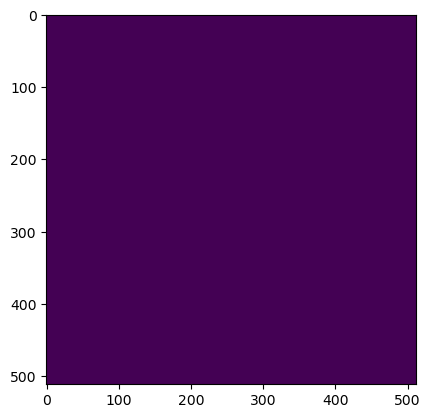

Wrote output/patches/mask/VC_S1_175-446416-0000-6312212-8000.tiff (512 x 512 pixels)


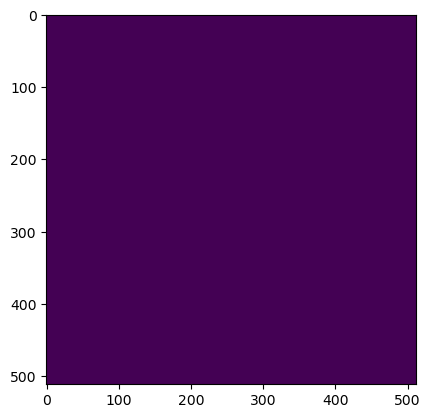

Wrote output/patches/mask/VC_S1_175-446416-0000-6312315-2000.tiff (512 x 512 pixels)


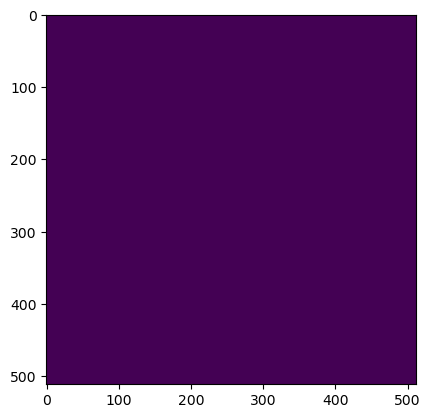

Wrote output/patches/mask/VC_S1_175-446416-0000-6312417-6000.tiff (512 x 512 pixels)


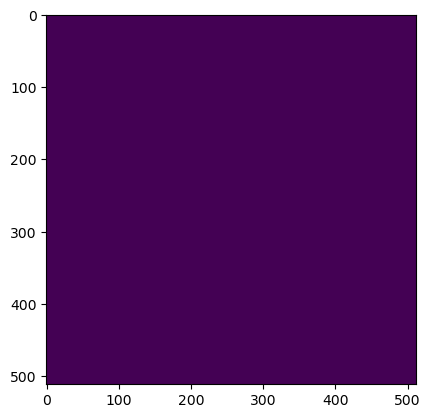

Wrote output/patches/mask/VC_S1_175-446518-4000-6312110-4000.tiff (512 x 512 pixels)


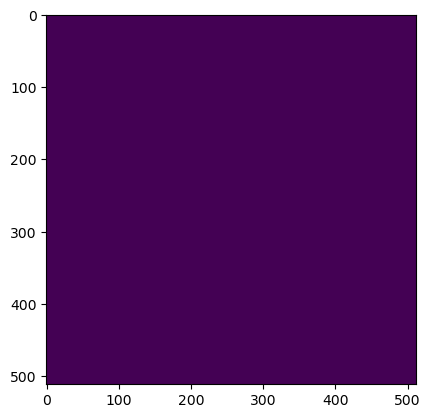

Wrote output/patches/mask/VC_S1_175-446518-4000-6312212-8000.tiff (512 x 512 pixels)


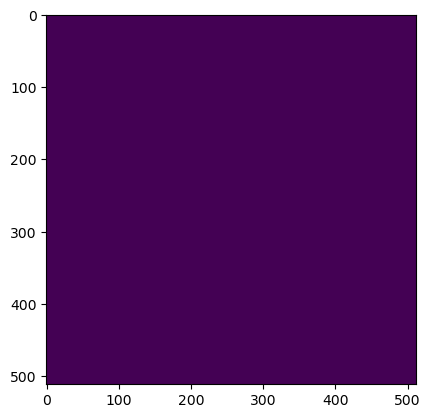

Wrote output/patches/mask/VC_S1_175-446518-4000-6312315-2000.tiff (512 x 512 pixels)


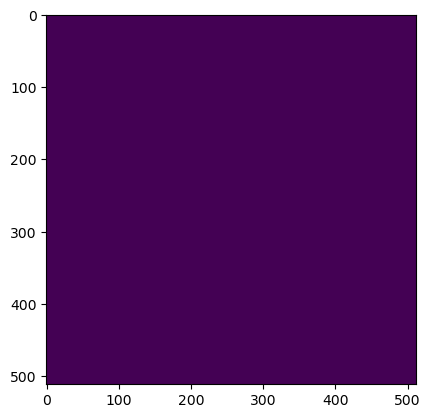

Wrote output/patches/mask/VC_S1_175-446518-4000-6312417-6000.tiff (512 x 512 pixels)
Zone VU_S1_176 Building Mask...


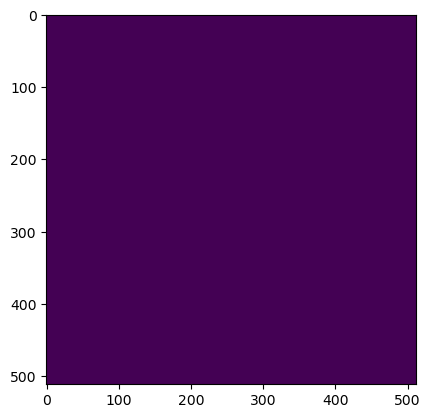

Wrote output/patches/mask/VU_S1_176-449488-0000-6312110-4000.tiff (512 x 512 pixels)


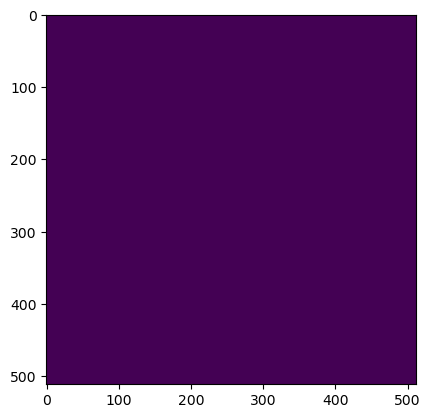

Wrote output/patches/mask/VU_S1_176-449488-0000-6312212-8000.tiff (512 x 512 pixels)


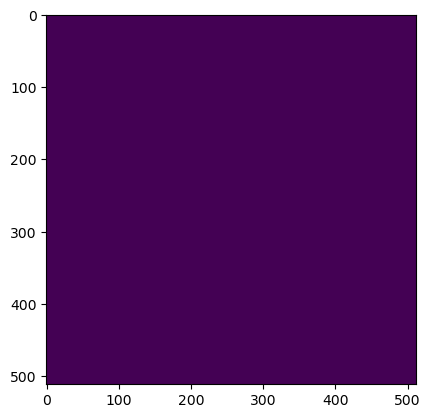

Wrote output/patches/mask/VU_S1_176-449590-4000-6312110-4000.tiff (512 x 512 pixels)


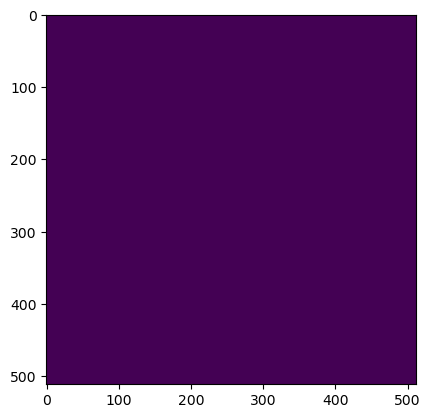

Wrote output/patches/mask/VU_S1_176-449590-4000-6312212-8000.tiff (512 x 512 pixels)
Zone UU_S1_177 Building Mask...


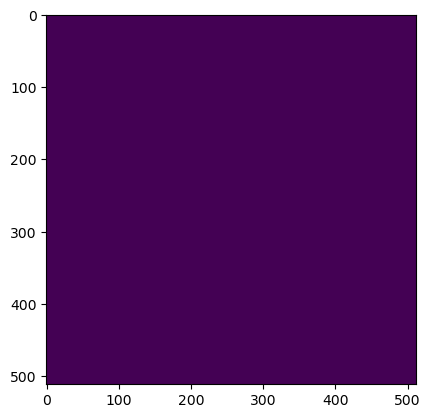

Wrote output/patches/mask/UU_S1_177-468688-0000-6312366-4000.tiff (512 x 512 pixels)


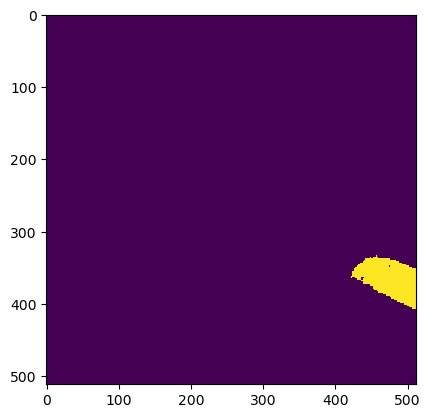

Wrote output/patches/mask/UU_S1_177-468688-0000-6312468-8000.tiff (512 x 512 pixels)


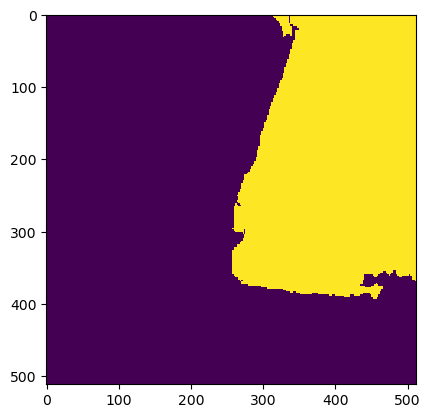

Wrote output/patches/mask/UU_S1_177-468790-4000-6312366-4000.tiff (512 x 512 pixels)


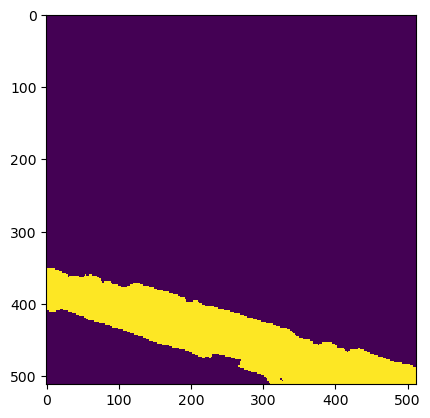

Wrote output/patches/mask/UU_S1_177-468790-4000-6312468-8000.tiff (512 x 512 pixels)
Zone VV_S1_178 Building Mask...


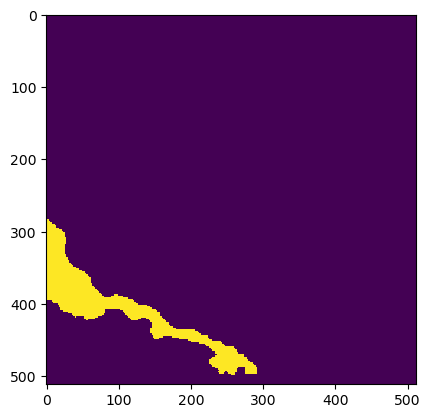

Wrote output/patches/mask/VV_S1_178-463824-0000-6312366-4000.tiff (512 x 512 pixels)


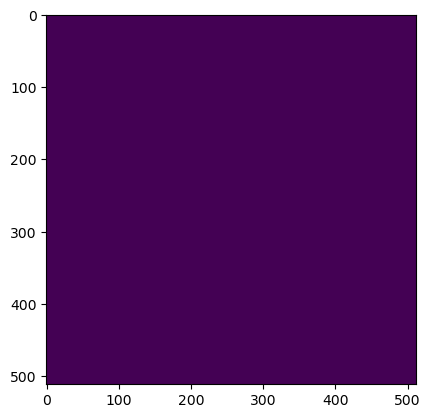

Wrote output/patches/mask/VV_S1_178-463824-0000-6312468-8000.tiff (512 x 512 pixels)


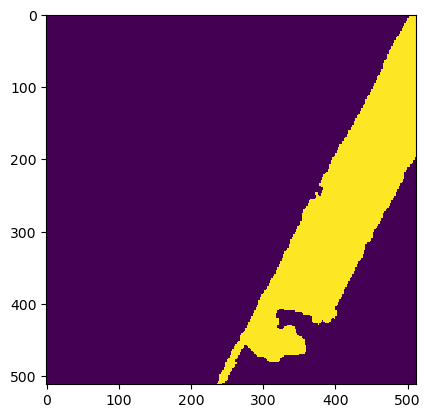

Wrote output/patches/mask/VV_S1_178-463926-4000-6312366-4000.tiff (512 x 512 pixels)


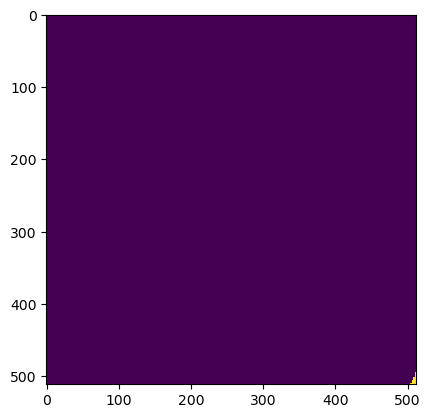

Wrote output/patches/mask/VV_S1_178-463926-4000-6312468-8000.tiff (512 x 512 pixels)
Zone UV_S1_179 Building Mask...


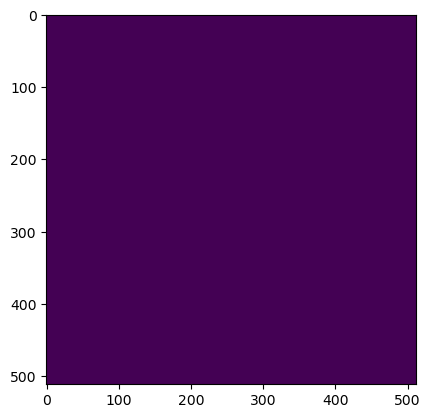

Wrote output/patches/mask/UV_S1_179-520144-0000-6312366-4000.tiff (512 x 512 pixels)


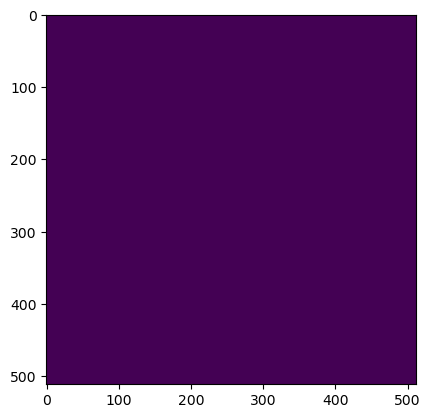

Wrote output/patches/mask/UV_S1_179-520144-0000-6312468-8000.tiff (512 x 512 pixels)


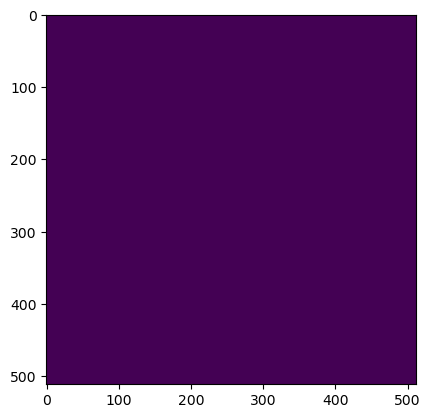

Wrote output/patches/mask/UV_S1_179-520246-4000-6312366-4000.tiff (512 x 512 pixels)


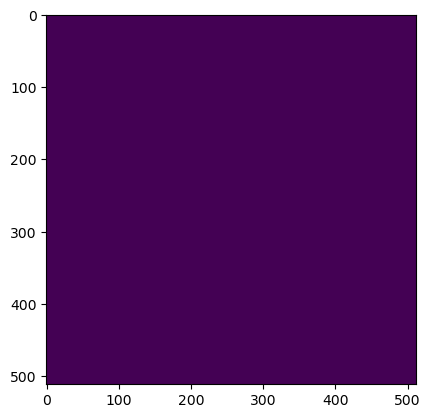

Wrote output/patches/mask/UV_S1_179-520246-4000-6312468-8000.tiff (512 x 512 pixels)
Zone NC_S1_180 Building Mask...


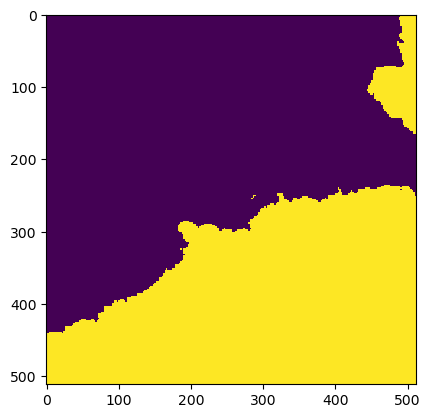

Wrote output/patches/mask/NC_S1_180-471248-0000-6312366-4000.tiff (512 x 512 pixels)


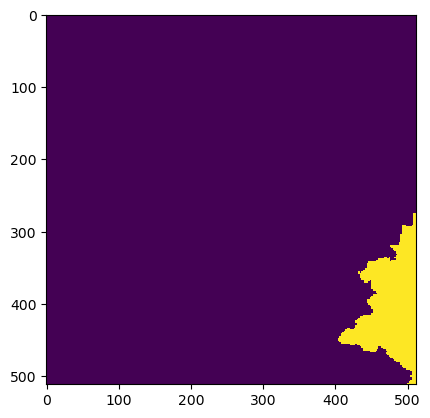

Wrote output/patches/mask/NC_S1_180-471248-0000-6312468-8000.tiff (512 x 512 pixels)


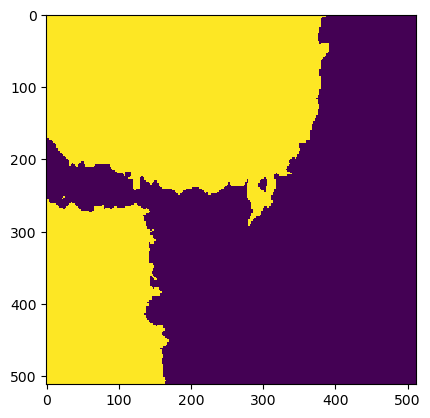

Wrote output/patches/mask/NC_S1_180-471350-4000-6312366-4000.tiff (512 x 512 pixels)


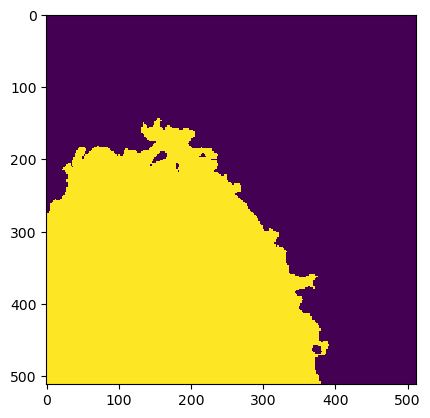

Wrote output/patches/mask/NC_S1_180-471350-4000-6312468-8000.tiff (512 x 512 pixels)
Zone UU_S1_181 Building Mask...


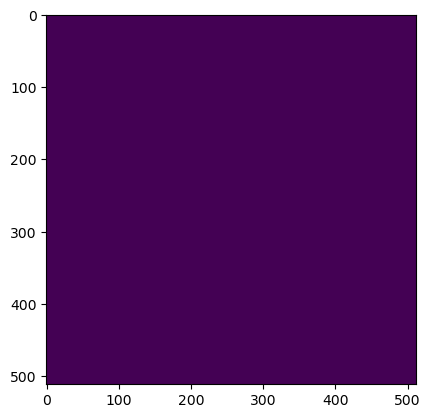

Wrote output/patches/mask/UU_S1_181-477648-0000-6312366-4000.tiff (512 x 512 pixels)


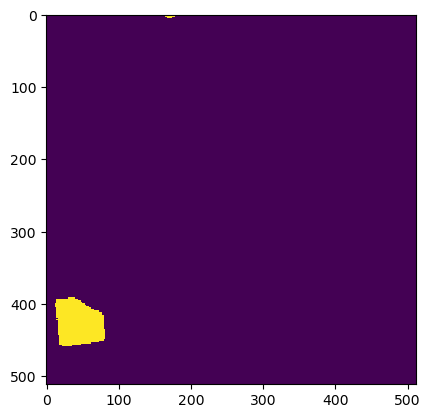

Wrote output/patches/mask/UU_S1_181-477648-0000-6312468-8000.tiff (512 x 512 pixels)


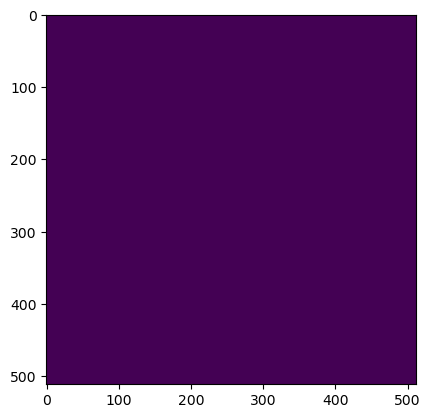

Wrote output/patches/mask/UU_S1_181-477750-4000-6312366-4000.tiff (512 x 512 pixels)


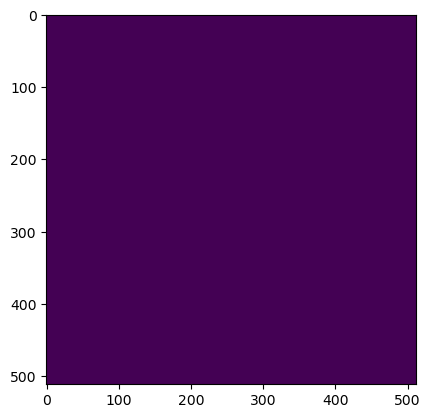

Wrote output/patches/mask/UU_S1_181-477750-4000-6312468-8000.tiff (512 x 512 pixels)
Zone UU_S1_182 Building Mask...


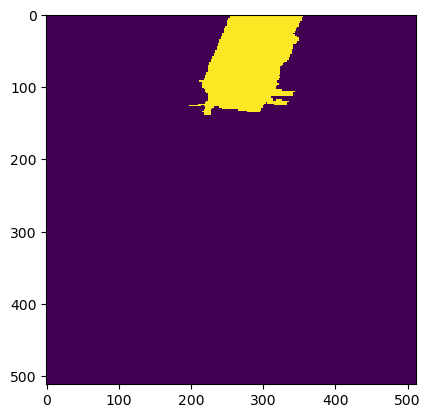

Wrote output/patches/mask/UU_S1_182-476624-0000-6313390-4000.tiff (512 x 512 pixels)


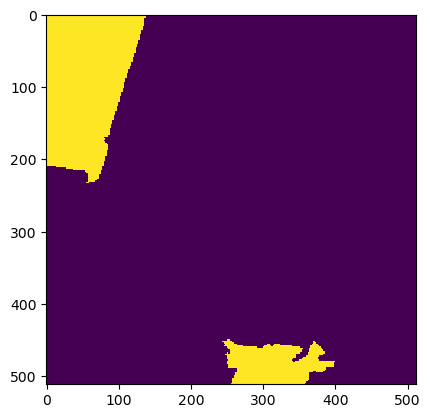

Wrote output/patches/mask/UU_S1_182-476624-0000-6313492-8000.tiff (512 x 512 pixels)


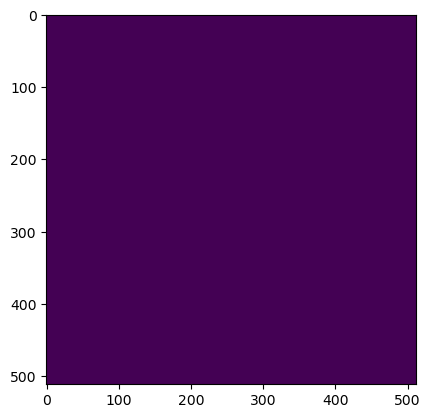

Wrote output/patches/mask/UU_S1_182-476726-4000-6313390-4000.tiff (512 x 512 pixels)


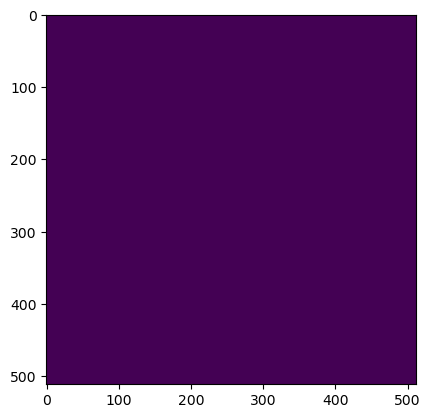

Wrote output/patches/mask/UU_S1_182-476726-4000-6313492-8000.tiff (512 x 512 pixels)
Zone VV_S1_183 Building Mask...


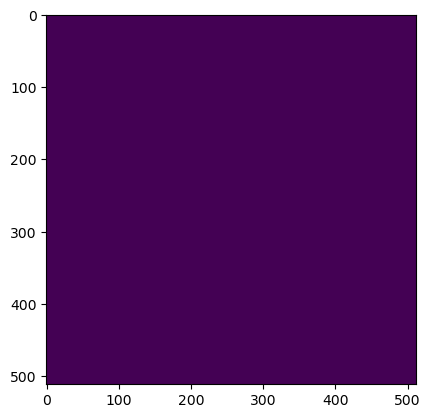

Wrote output/patches/mask/VV_S1_183-444112-0000-6314158-4000.tiff (512 x 512 pixels)


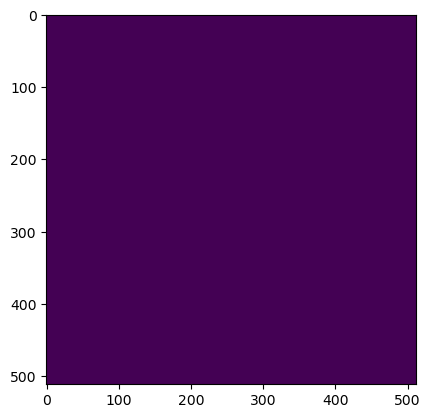

Wrote output/patches/mask/VV_S1_183-444112-0000-6314260-8000.tiff (512 x 512 pixels)


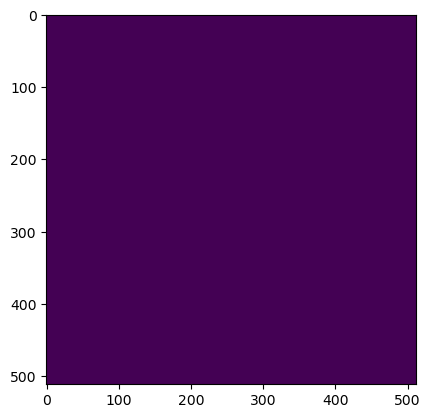

Wrote output/patches/mask/VV_S1_183-444214-4000-6314158-4000.tiff (512 x 512 pixels)


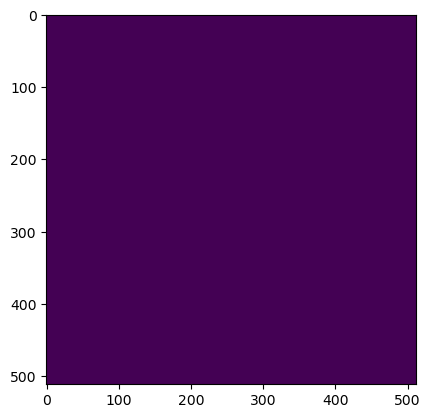

Wrote output/patches/mask/VV_S1_183-444214-4000-6314260-8000.tiff (512 x 512 pixels)
Zone VC_S1_184 Building Mask...


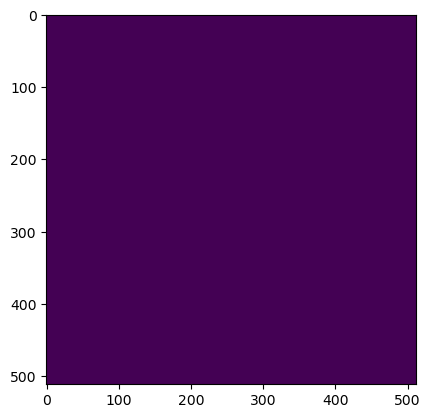

Wrote output/patches/mask/VC_S1_184-444880-0000-6313390-4000.tiff (512 x 512 pixels)


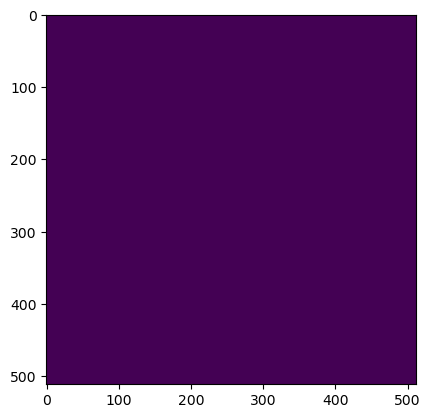

Wrote output/patches/mask/VC_S1_184-444880-0000-6313492-8000.tiff (512 x 512 pixels)


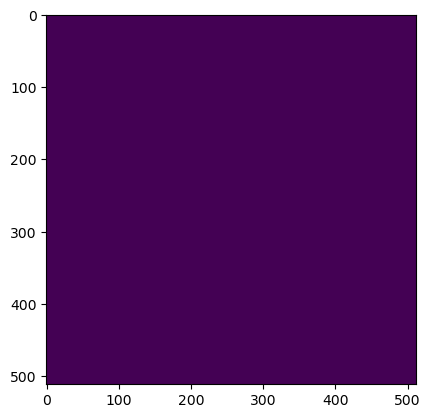

Wrote output/patches/mask/VC_S1_184-444982-4000-6313390-4000.tiff (512 x 512 pixels)


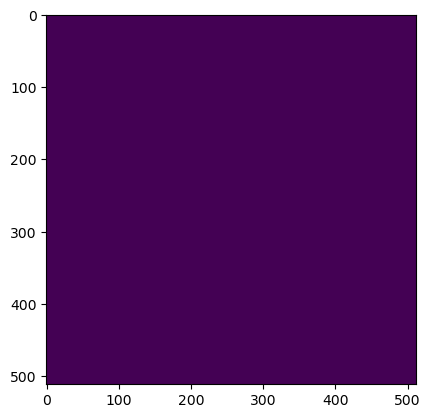

Wrote output/patches/mask/VC_S1_184-444982-4000-6313492-8000.tiff (512 x 512 pixels)
Zone NV_S1_185 Building Mask...


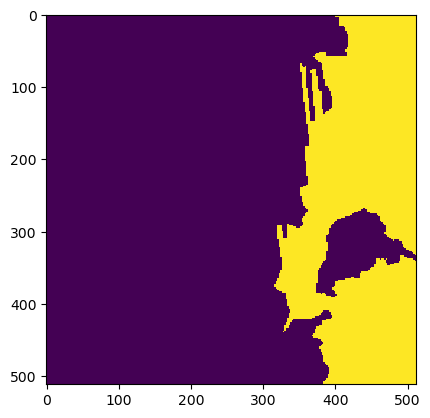

Wrote output/patches/mask/NV_S1_185-468176-0000-6313646-4000.tiff (512 x 512 pixels)


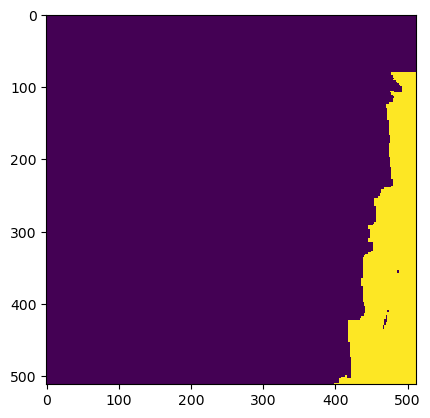

Wrote output/patches/mask/NV_S1_185-468176-0000-6313748-8000.tiff (512 x 512 pixels)


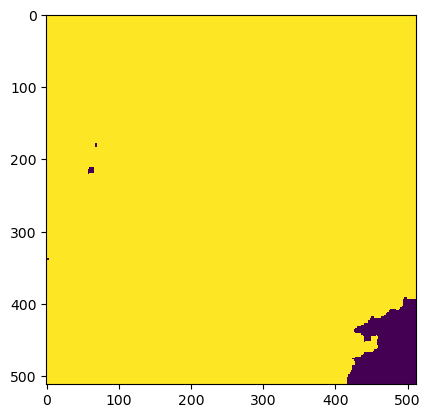

Wrote output/patches/mask/NV_S1_185-468278-4000-6313646-4000.tiff (512 x 512 pixels)


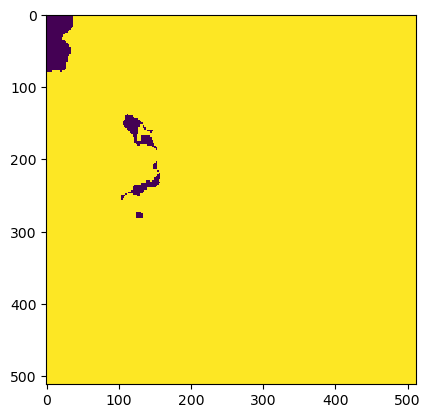

Wrote output/patches/mask/NV_S1_185-468278-4000-6313748-8000.tiff (512 x 512 pixels)
Zone VC_S1_186 Building Mask...


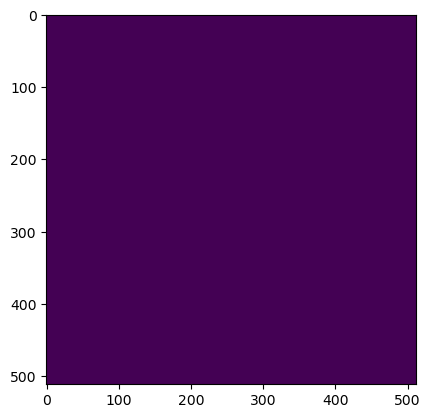

Wrote output/patches/mask/VC_S1_186-457936-0000-6312366-4000.tiff (512 x 512 pixels)


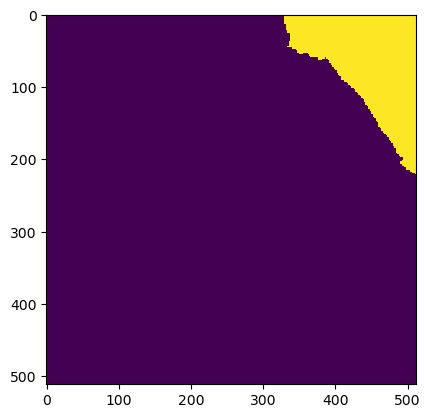

Wrote output/patches/mask/VC_S1_186-457936-0000-6312468-8000.tiff (512 x 512 pixels)


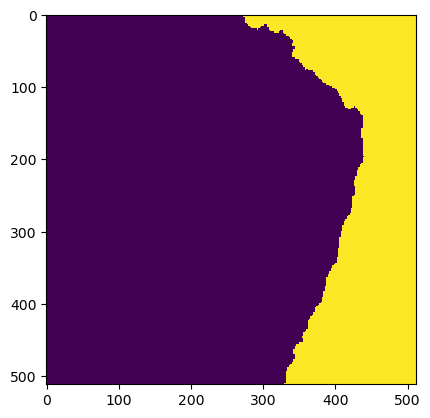

Wrote output/patches/mask/VC_S1_186-457936-0000-6312571-2000.tiff (512 x 512 pixels)


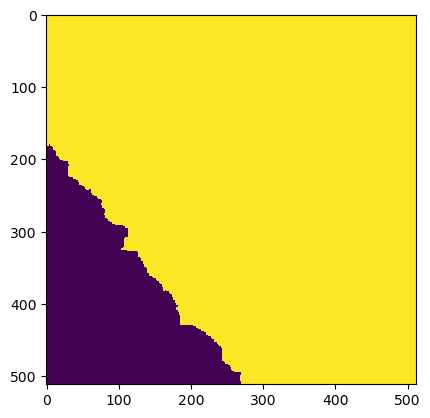

Wrote output/patches/mask/VC_S1_186-457936-0000-6312673-6000.tiff (512 x 512 pixels)


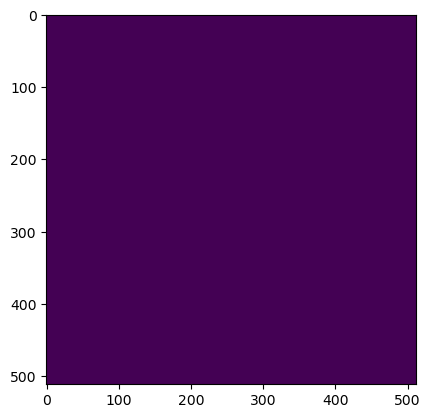

Wrote output/patches/mask/VC_S1_186-458038-4000-6312366-4000.tiff (512 x 512 pixels)


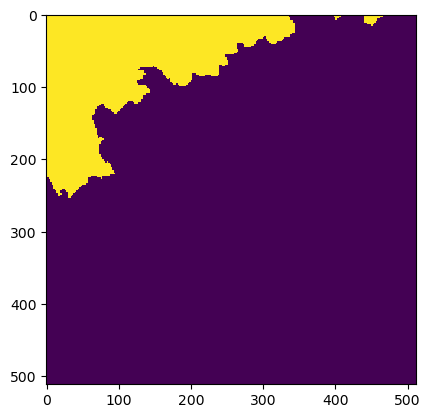

Wrote output/patches/mask/VC_S1_186-458038-4000-6312468-8000.tiff (512 x 512 pixels)


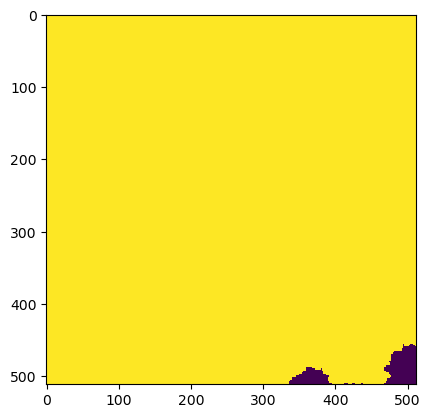

Wrote output/patches/mask/VC_S1_186-458038-4000-6312571-2000.tiff (512 x 512 pixels)


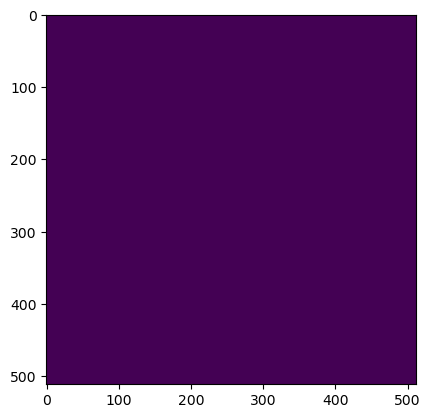

Wrote output/patches/mask/VC_S1_186-458038-4000-6312673-6000.tiff (512 x 512 pixels)
Zone VV_S1_187 Building Mask...


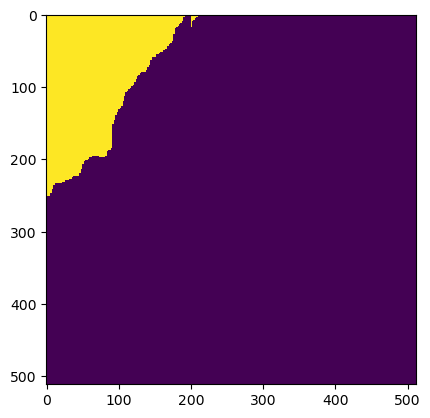

Wrote output/patches/mask/VV_S1_187-460240-0000-6312878-4000.tiff (512 x 512 pixels)


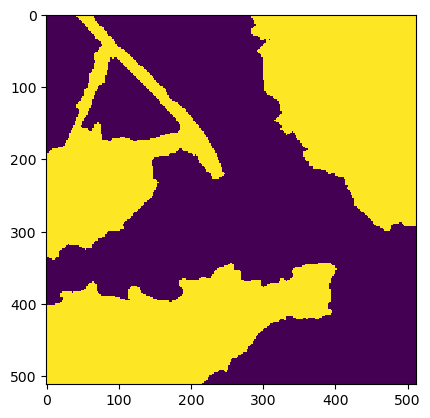

Wrote output/patches/mask/VV_S1_187-460240-0000-6312980-8000.tiff (512 x 512 pixels)


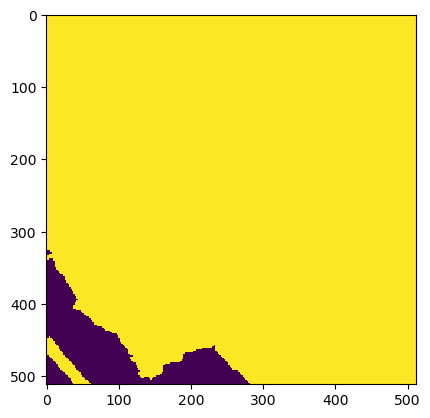

Wrote output/patches/mask/VV_S1_187-460240-0000-6313083-2000.tiff (512 x 512 pixels)


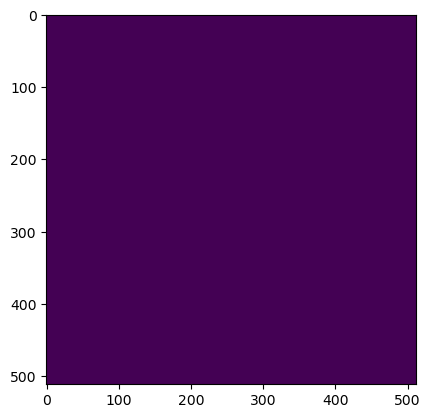

Wrote output/patches/mask/VV_S1_187-460240-0000-6313185-6000.tiff (512 x 512 pixels)


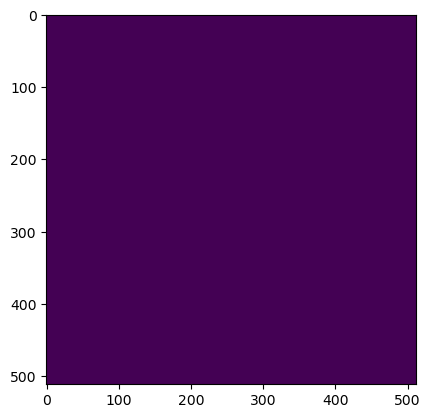

Wrote output/patches/mask/VV_S1_187-460342-4000-6312878-4000.tiff (512 x 512 pixels)


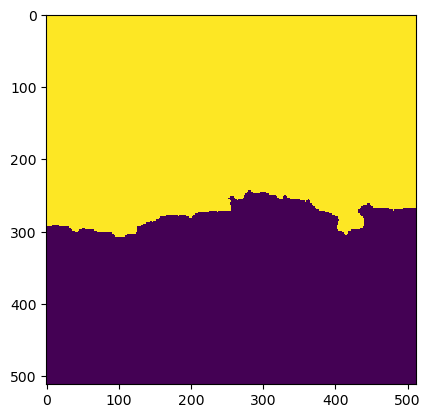

Wrote output/patches/mask/VV_S1_187-460342-4000-6312980-8000.tiff (512 x 512 pixels)


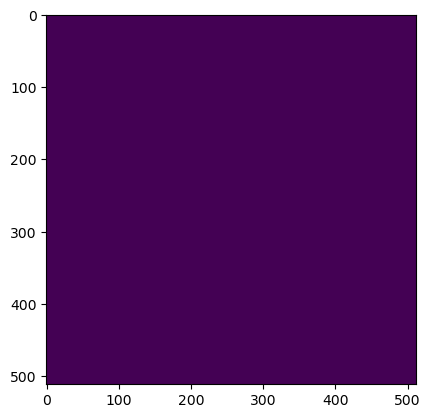

Wrote output/patches/mask/VV_S1_187-460342-4000-6313083-2000.tiff (512 x 512 pixels)


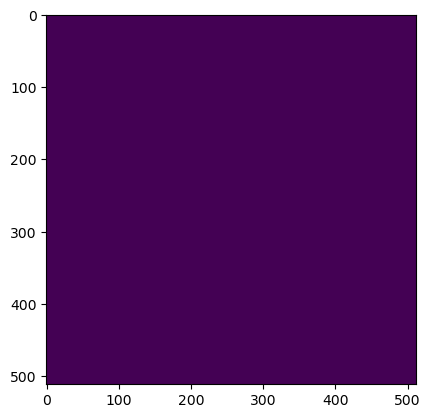

Wrote output/patches/mask/VV_S1_187-460342-4000-6313185-6000.tiff (512 x 512 pixels)


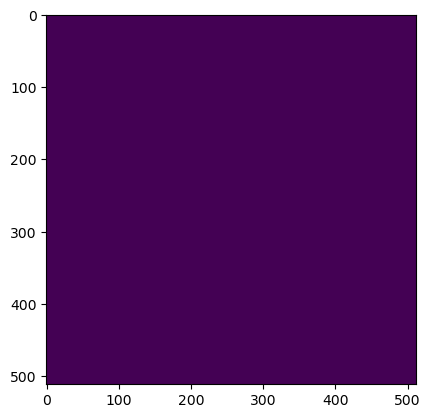

Wrote output/patches/mask/VV_S1_187-460444-8000-6312878-4000.tiff (512 x 512 pixels)


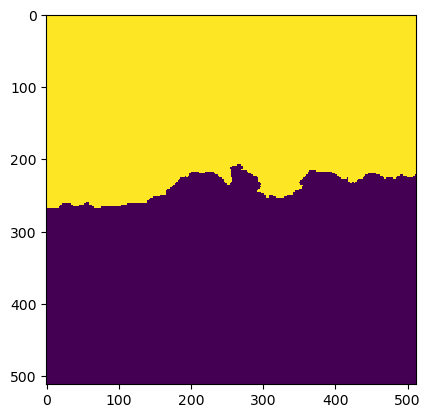

Wrote output/patches/mask/VV_S1_187-460444-8000-6312980-8000.tiff (512 x 512 pixels)


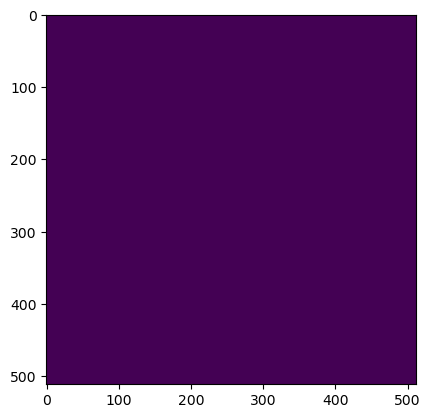

Wrote output/patches/mask/VV_S1_187-460444-8000-6313083-2000.tiff (512 x 512 pixels)


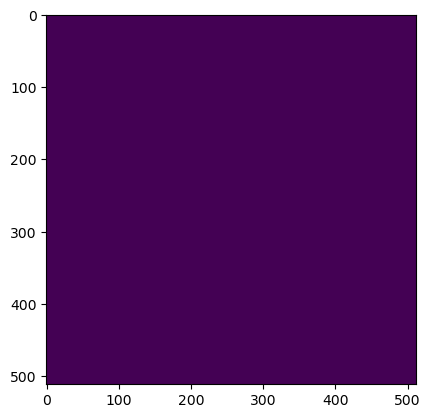

Wrote output/patches/mask/VV_S1_187-460444-8000-6313185-6000.tiff (512 x 512 pixels)


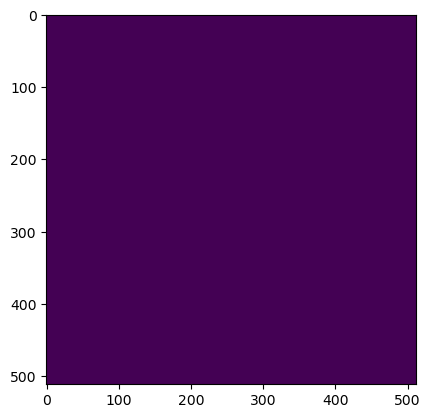

Wrote output/patches/mask/VV_S1_187-460547-2000-6312878-4000.tiff (512 x 512 pixels)


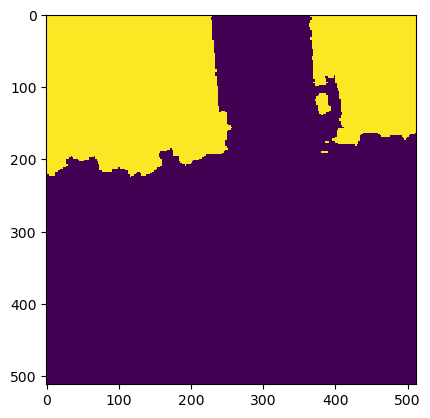

Wrote output/patches/mask/VV_S1_187-460547-2000-6312980-8000.tiff (512 x 512 pixels)


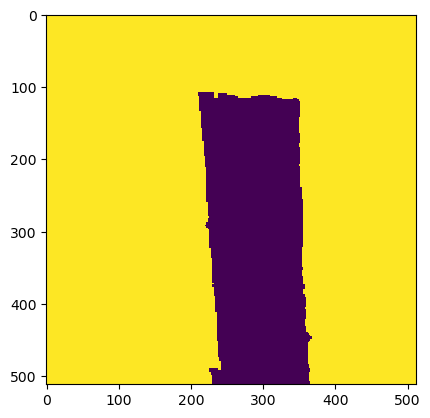

Wrote output/patches/mask/VV_S1_187-460547-2000-6313083-2000.tiff (512 x 512 pixels)


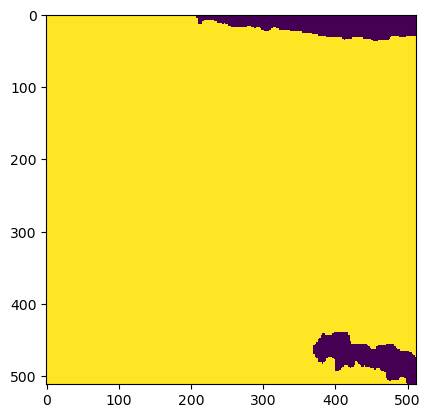

Wrote output/patches/mask/VV_S1_187-460547-2000-6313185-6000.tiff (512 x 512 pixels)
Zone VV_S1_188 Building Mask...


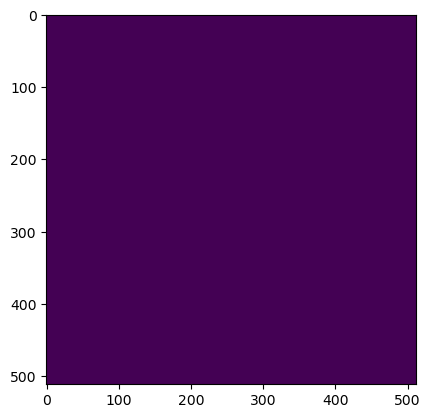

Wrote output/patches/mask/VV_S1_188-521936-0000-6314670-4000.tiff (512 x 512 pixels)


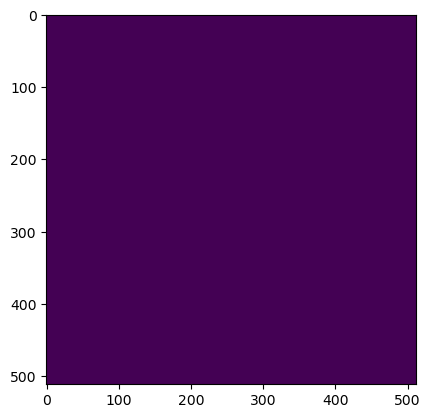

Wrote output/patches/mask/VV_S1_188-521936-0000-6314772-8000.tiff (512 x 512 pixels)


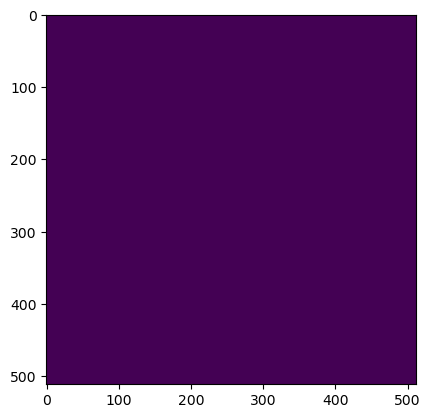

Wrote output/patches/mask/VV_S1_188-522038-4000-6314670-4000.tiff (512 x 512 pixels)


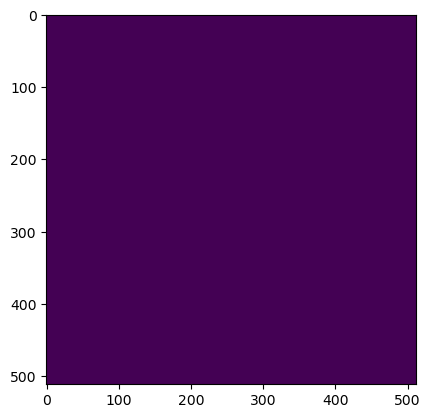

Wrote output/patches/mask/VV_S1_188-522038-4000-6314772-8000.tiff (512 x 512 pixels)
Zone UC_S1_189 Building Mask...


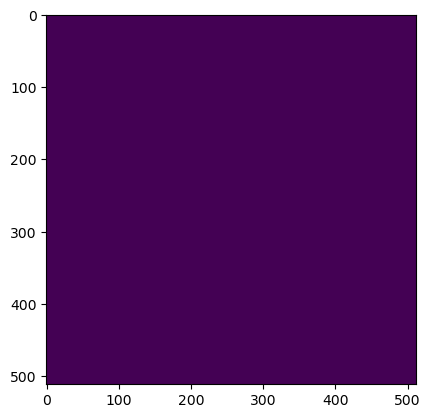

Wrote output/patches/mask/UC_S1_189-508112-0000-6314926-4000.tiff (512 x 512 pixels)


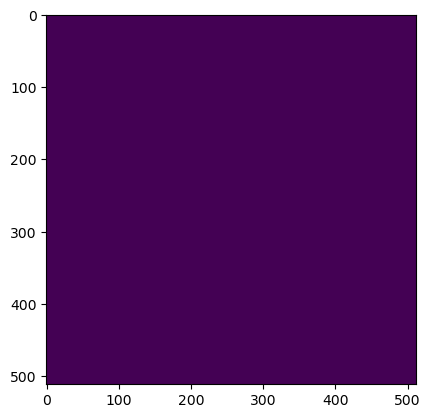

Wrote output/patches/mask/UC_S1_189-508112-0000-6315028-8000.tiff (512 x 512 pixels)


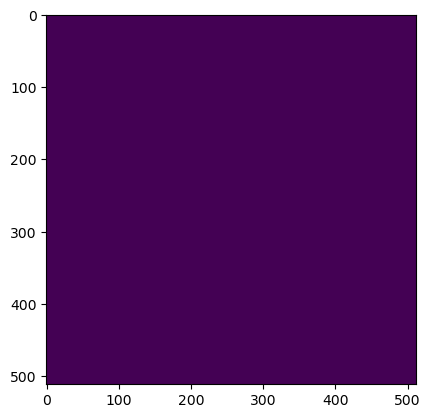

Wrote output/patches/mask/UC_S1_189-508214-4000-6314926-4000.tiff (512 x 512 pixels)


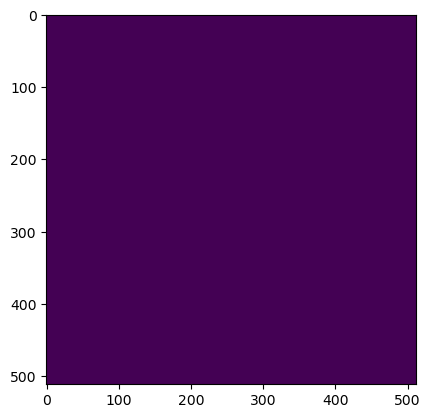

Wrote output/patches/mask/UC_S1_189-508214-4000-6315028-8000.tiff (512 x 512 pixels)


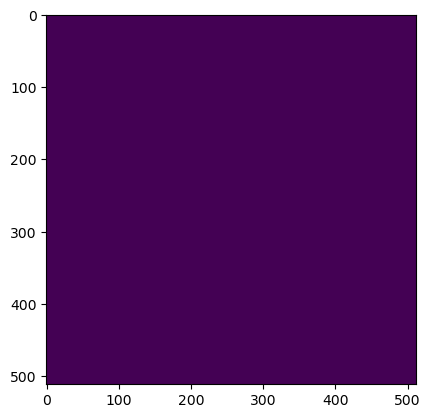

Wrote output/patches/mask/UC_S1_189-508316-8000-6314926-4000.tiff (512 x 512 pixels)


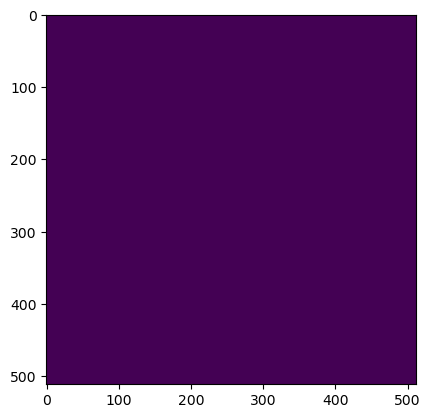

Wrote output/patches/mask/UC_S1_189-508316-8000-6315028-8000.tiff (512 x 512 pixels)


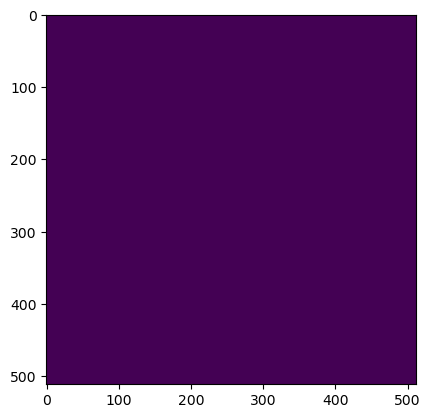

Wrote output/patches/mask/UC_S1_189-508419-2000-6314926-4000.tiff (512 x 512 pixels)


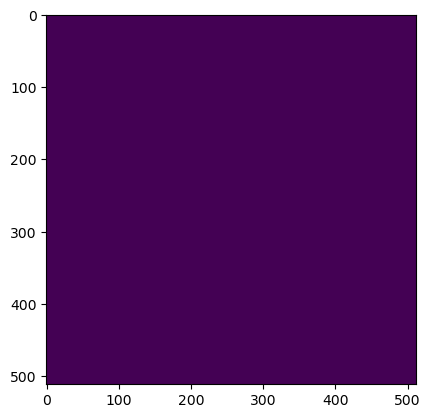

Wrote output/patches/mask/UC_S1_189-508419-2000-6315028-8000.tiff (512 x 512 pixels)
Zone VC_S1_190 Building Mask...


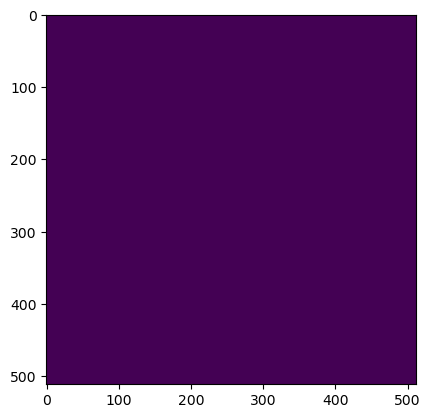

Wrote output/patches/mask/VC_S1_190-448720-0000-6315438-4000.tiff (512 x 512 pixels)


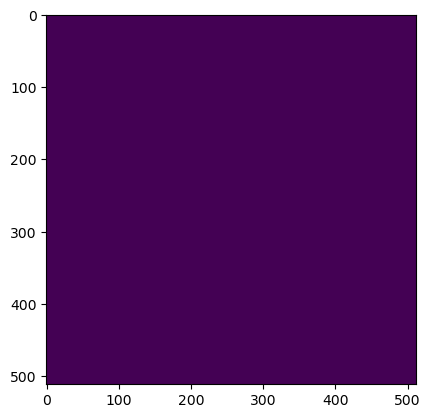

Wrote output/patches/mask/VC_S1_190-448720-0000-6315540-8000.tiff (512 x 512 pixels)


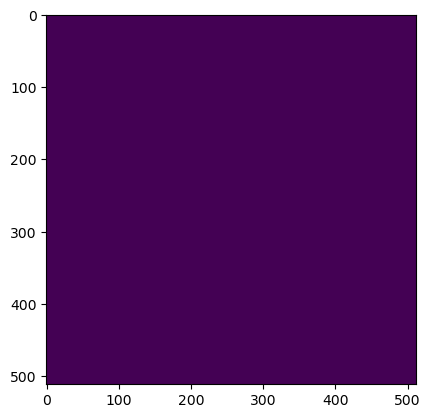

Wrote output/patches/mask/VC_S1_190-448822-4000-6315438-4000.tiff (512 x 512 pixels)


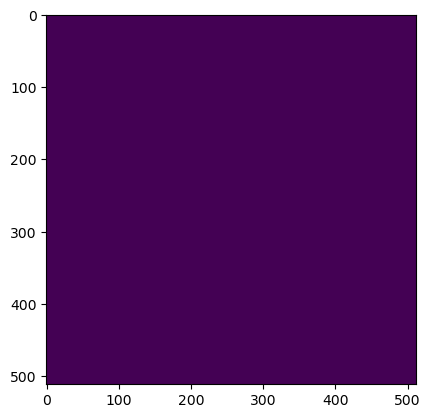

Wrote output/patches/mask/VC_S1_190-448822-4000-6315540-8000.tiff (512 x 512 pixels)
Zone VU_S1_191 Building Mask...


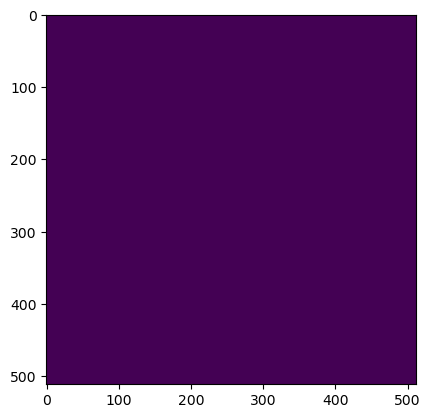

Wrote output/patches/mask/VU_S1_191-453584-0000-6315950-4000.tiff (512 x 512 pixels)


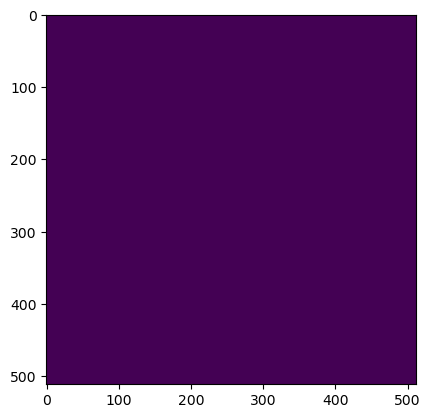

Wrote output/patches/mask/VU_S1_191-453584-0000-6316052-8000.tiff (512 x 512 pixels)


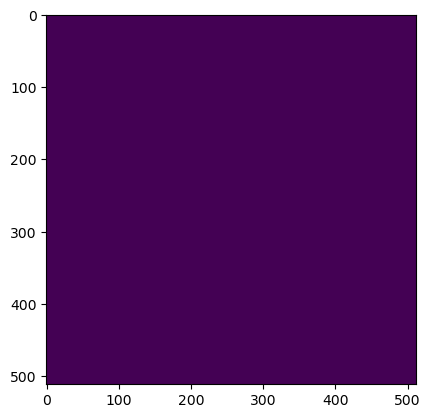

Wrote output/patches/mask/VU_S1_191-453686-4000-6315950-4000.tiff (512 x 512 pixels)


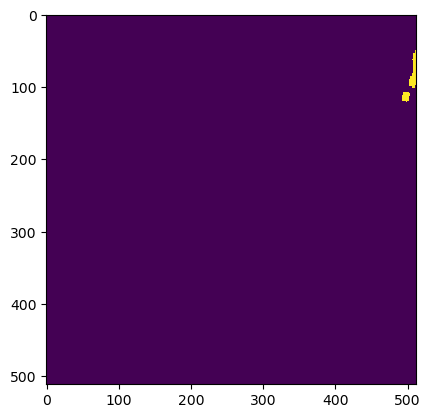

Wrote output/patches/mask/VU_S1_191-453686-4000-6316052-8000.tiff (512 x 512 pixels)
Zone VU_S1_192 Building Mask...


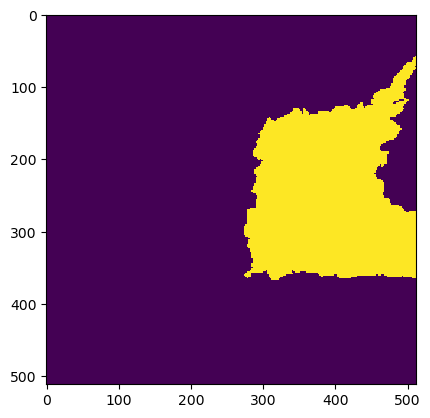

Wrote output/patches/mask/VU_S1_192-454608-0000-6316206-4000.tiff (512 x 512 pixels)


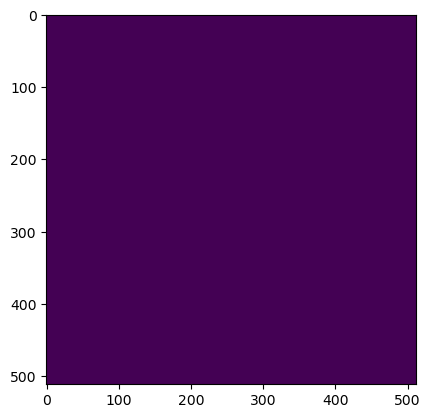

Wrote output/patches/mask/VU_S1_192-454608-0000-6316308-8000.tiff (512 x 512 pixels)


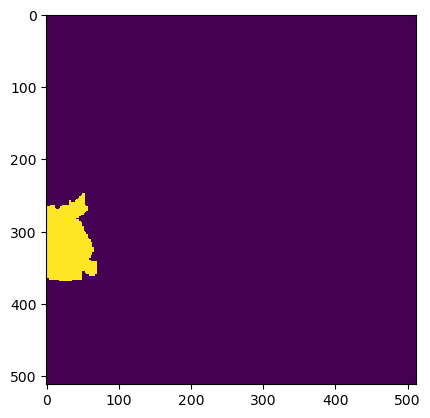

Wrote output/patches/mask/VU_S1_192-454710-4000-6316206-4000.tiff (512 x 512 pixels)


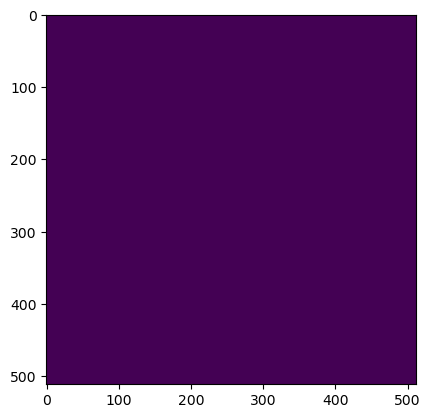

Wrote output/patches/mask/VU_S1_192-454710-4000-6316308-8000.tiff (512 x 512 pixels)
Zone UC_S1_193 Building Mask...


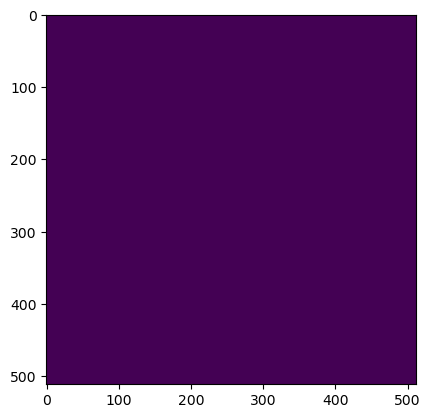

Wrote output/patches/mask/UC_S1_193-457424-0000-6315438-4000.tiff (512 x 512 pixels)


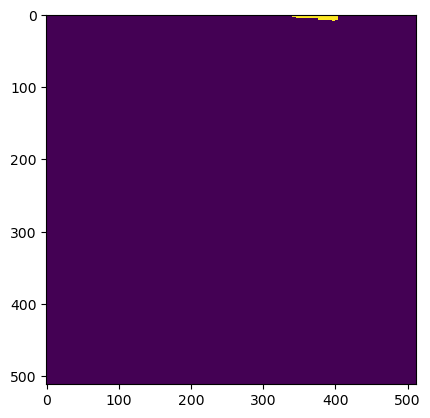

Wrote output/patches/mask/UC_S1_193-457424-0000-6315540-8000.tiff (512 x 512 pixels)


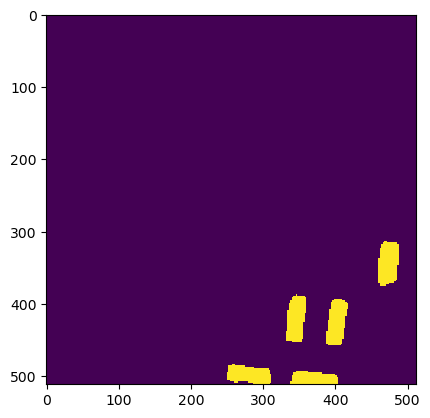

Wrote output/patches/mask/UC_S1_193-457424-0000-6315643-2000.tiff (512 x 512 pixels)


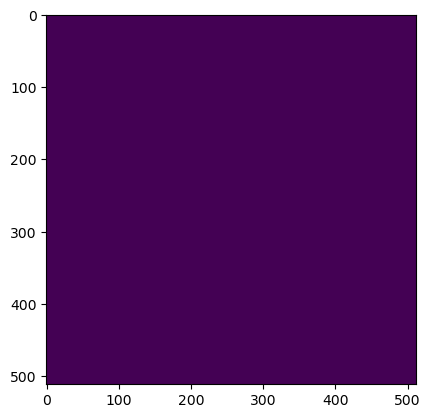

Wrote output/patches/mask/UC_S1_193-457424-0000-6315745-6000.tiff (512 x 512 pixels)


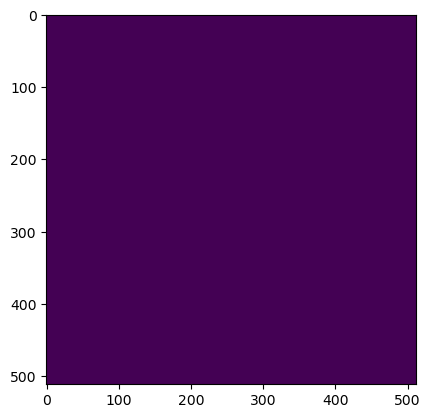

Wrote output/patches/mask/UC_S1_193-457526-4000-6315438-4000.tiff (512 x 512 pixels)


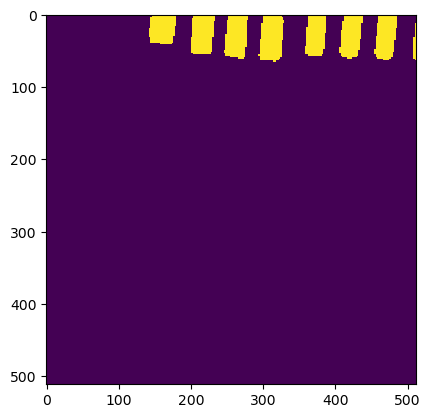

Wrote output/patches/mask/UC_S1_193-457526-4000-6315540-8000.tiff (512 x 512 pixels)


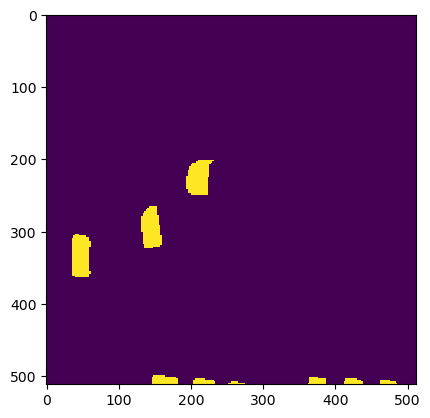

Wrote output/patches/mask/UC_S1_193-457526-4000-6315643-2000.tiff (512 x 512 pixels)


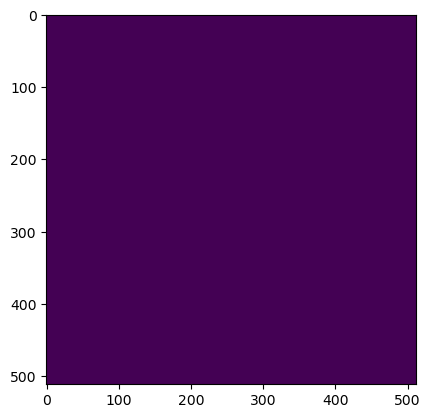

Wrote output/patches/mask/UC_S1_193-457526-4000-6315745-6000.tiff (512 x 512 pixels)
Zone VU_S1_194 Building Mask...


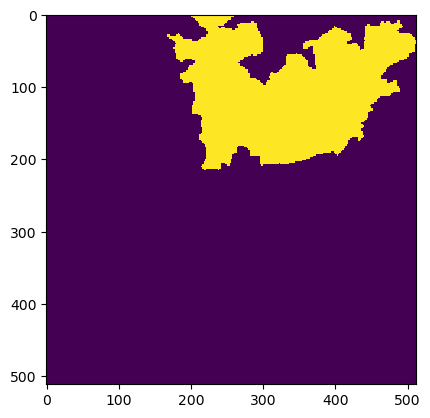

Wrote output/patches/mask/VU_S1_194-479184-0000-6316974-4000.tiff (512 x 512 pixels)


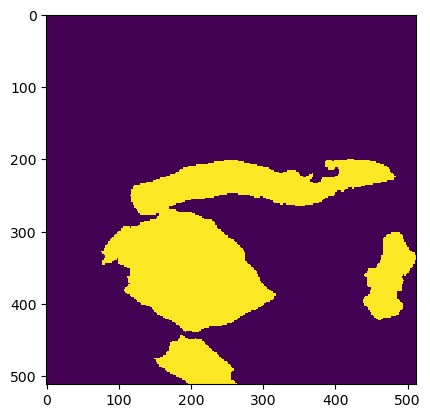

Wrote output/patches/mask/VU_S1_194-479184-0000-6317076-8000.tiff (512 x 512 pixels)


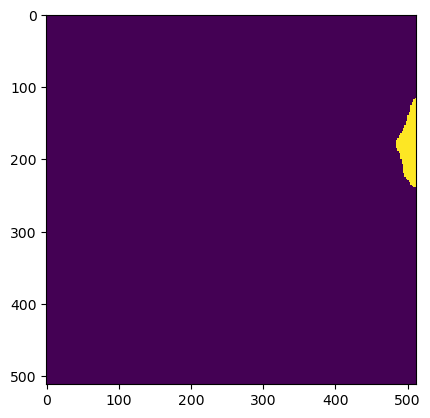

Wrote output/patches/mask/VU_S1_194-479184-0000-6317179-2000.tiff (512 x 512 pixels)


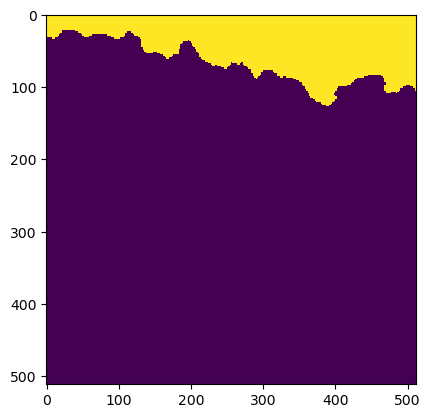

Wrote output/patches/mask/VU_S1_194-479184-0000-6317281-6000.tiff (512 x 512 pixels)


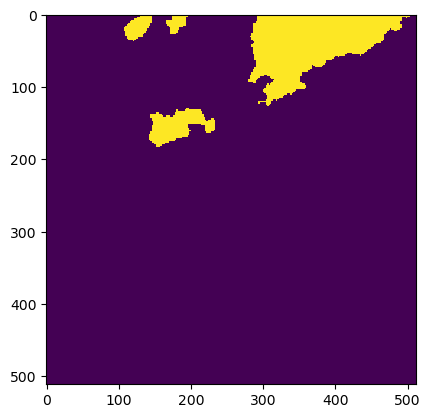

Wrote output/patches/mask/VU_S1_194-479286-4000-6316974-4000.tiff (512 x 512 pixels)


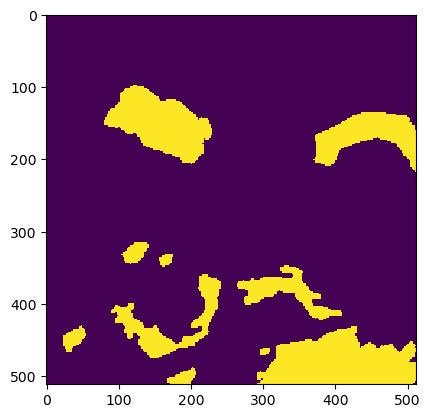

Wrote output/patches/mask/VU_S1_194-479286-4000-6317076-8000.tiff (512 x 512 pixels)


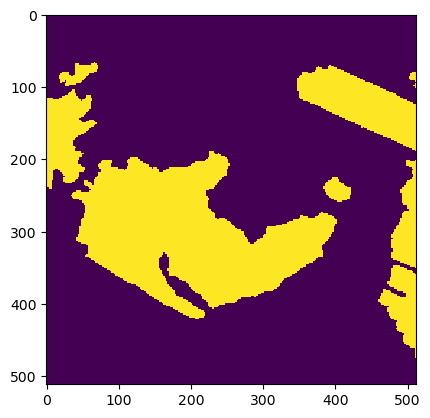

Wrote output/patches/mask/VU_S1_194-479286-4000-6317179-2000.tiff (512 x 512 pixels)


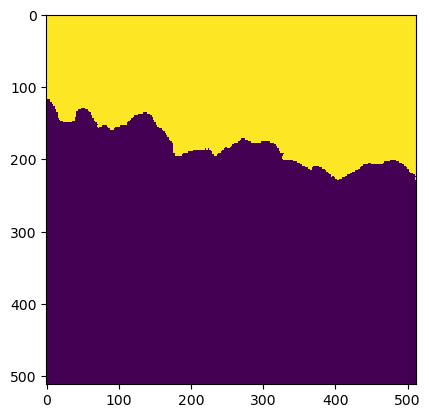

Wrote output/patches/mask/VU_S1_194-479286-4000-6317281-6000.tiff (512 x 512 pixels)


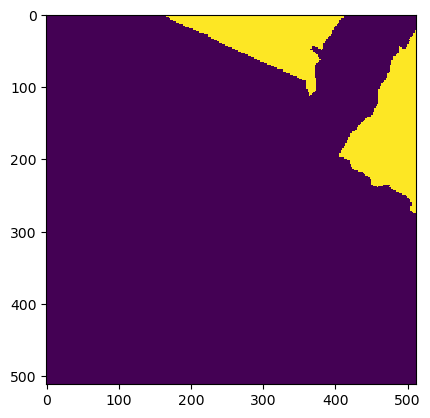

Wrote output/patches/mask/VU_S1_194-479388-8000-6316974-4000.tiff (512 x 512 pixels)


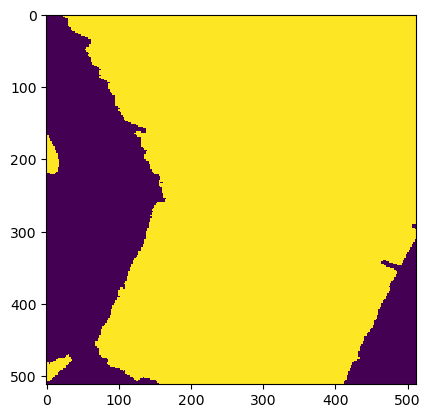

Wrote output/patches/mask/VU_S1_194-479388-8000-6317076-8000.tiff (512 x 512 pixels)


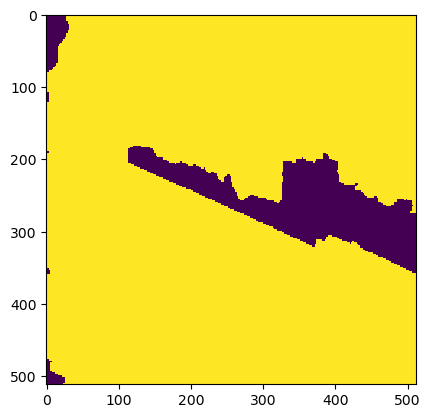

Wrote output/patches/mask/VU_S1_194-479388-8000-6317179-2000.tiff (512 x 512 pixels)


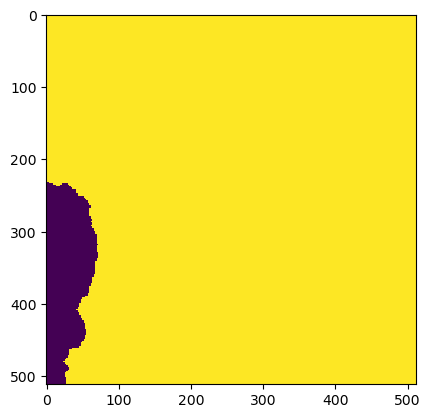

Wrote output/patches/mask/VU_S1_194-479388-8000-6317281-6000.tiff (512 x 512 pixels)


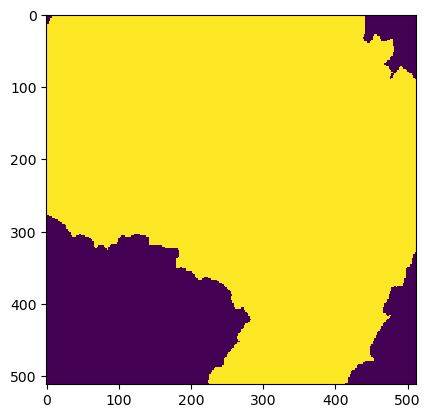

Wrote output/patches/mask/VU_S1_194-479491-2000-6316974-4000.tiff (512 x 512 pixels)


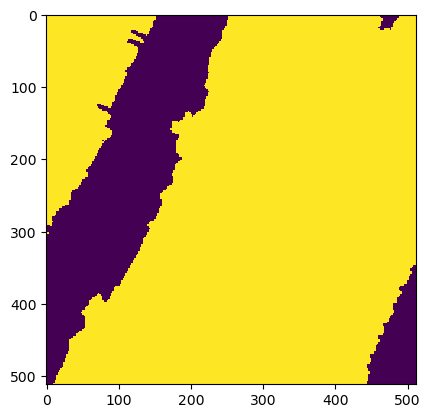

Wrote output/patches/mask/VU_S1_194-479491-2000-6317076-8000.tiff (512 x 512 pixels)


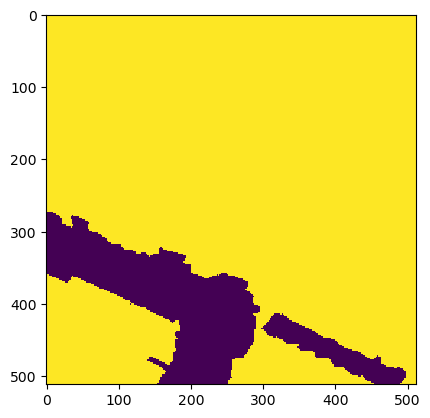

Wrote output/patches/mask/VU_S1_194-479491-2000-6317179-2000.tiff (512 x 512 pixels)


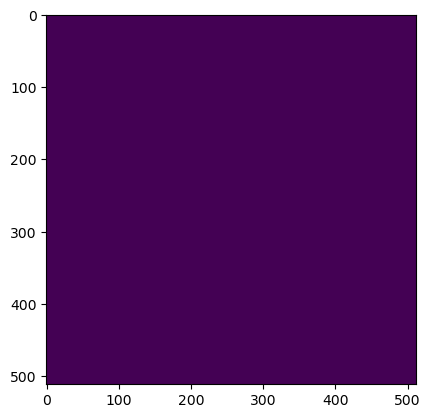

Wrote output/patches/mask/VU_S1_194-479491-2000-6317281-6000.tiff (512 x 512 pixels)
Zone UC_S1_195 Building Mask...


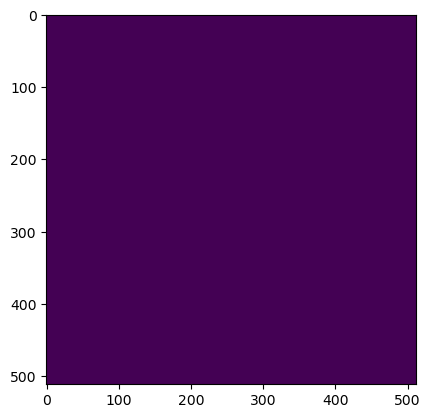

Wrote output/patches/mask/UC_S1_195-484048-0000-6316974-4000.tiff (512 x 512 pixels)


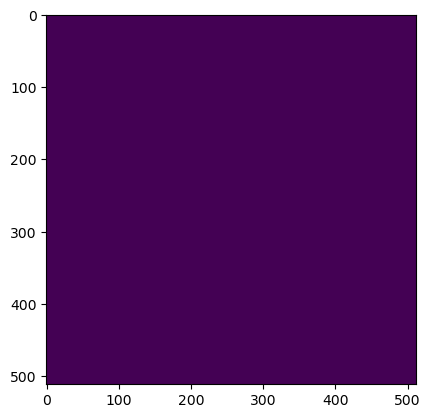

Wrote output/patches/mask/UC_S1_195-484048-0000-6317076-8000.tiff (512 x 512 pixels)


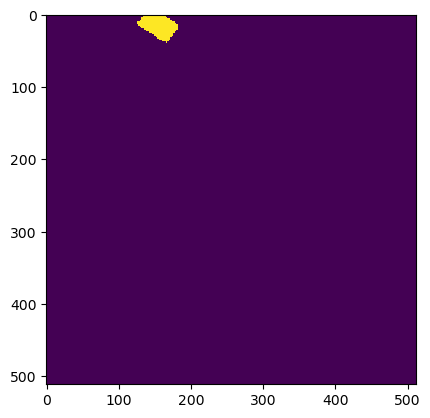

Wrote output/patches/mask/UC_S1_195-484048-0000-6317179-2000.tiff (512 x 512 pixels)


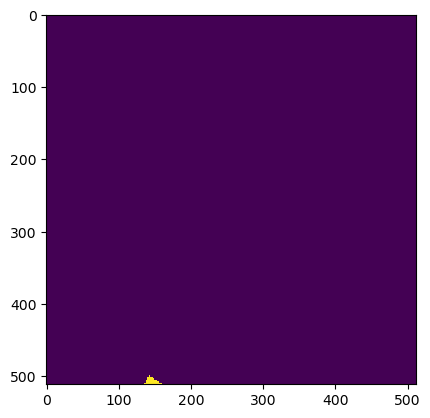

Wrote output/patches/mask/UC_S1_195-484048-0000-6317281-6000.tiff (512 x 512 pixels)


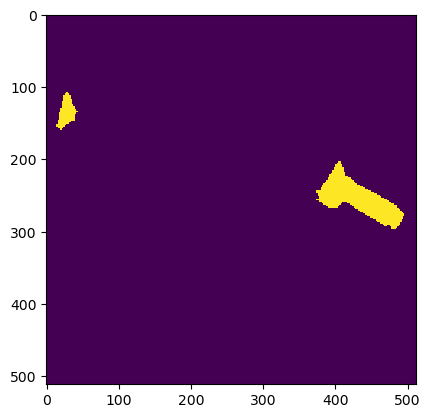

Wrote output/patches/mask/UC_S1_195-484048-0000-6317384-0000.tiff (512 x 512 pixels)


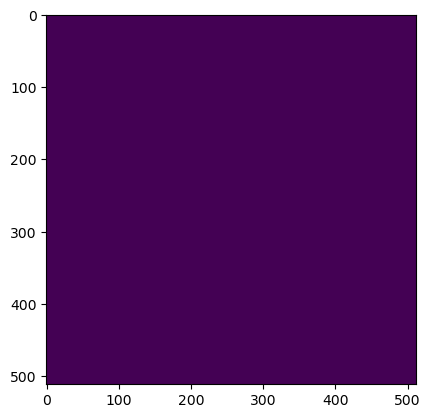

Wrote output/patches/mask/UC_S1_195-484048-0000-6317486-4000.tiff (512 x 512 pixels)


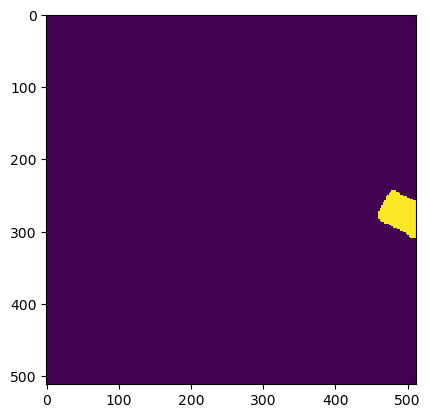

Wrote output/patches/mask/UC_S1_195-484048-0000-6317588-8000.tiff (512 x 512 pixels)


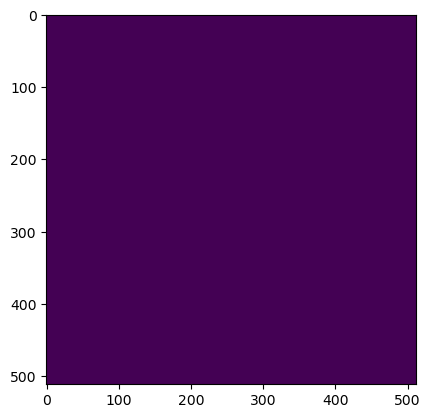

Wrote output/patches/mask/UC_S1_195-484150-4000-6316974-4000.tiff (512 x 512 pixels)


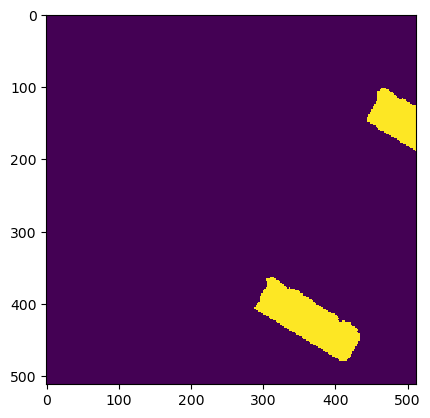

Wrote output/patches/mask/UC_S1_195-484150-4000-6317076-8000.tiff (512 x 512 pixels)


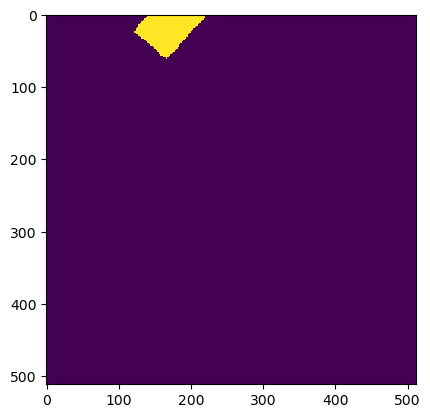

Wrote output/patches/mask/UC_S1_195-484150-4000-6317179-2000.tiff (512 x 512 pixels)


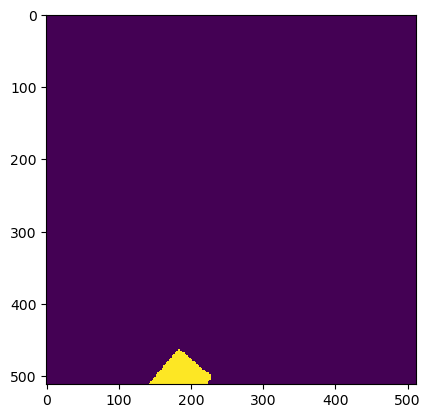

Wrote output/patches/mask/UC_S1_195-484150-4000-6317281-6000.tiff (512 x 512 pixels)


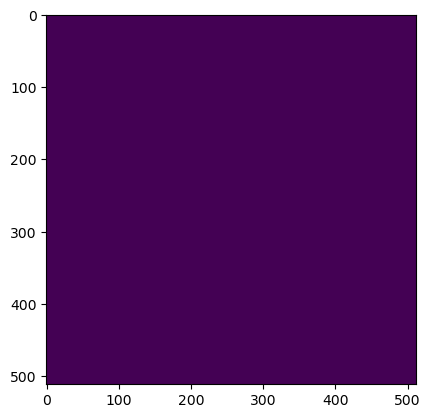

Wrote output/patches/mask/UC_S1_195-484150-4000-6317384-0000.tiff (512 x 512 pixels)


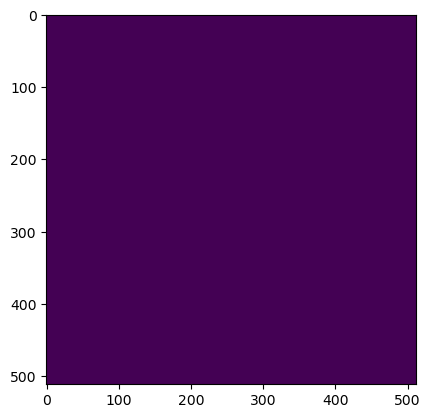

Wrote output/patches/mask/UC_S1_195-484150-4000-6317486-4000.tiff (512 x 512 pixels)


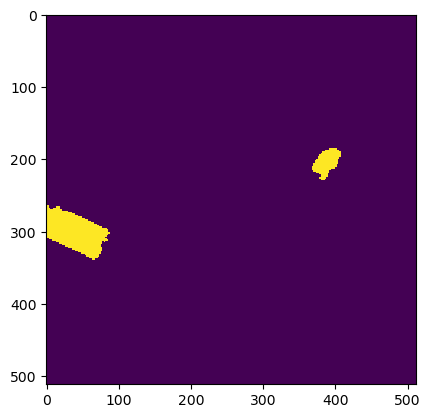

Wrote output/patches/mask/UC_S1_195-484150-4000-6317588-8000.tiff (512 x 512 pixels)
Zone VC_S1_196 Building Mask...


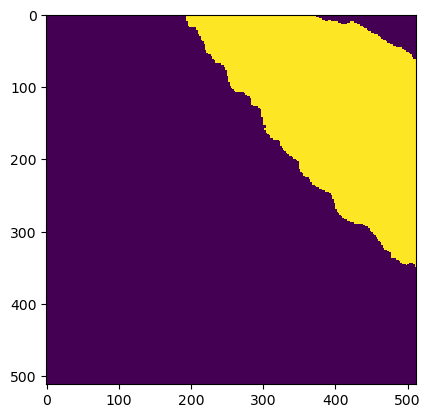

Wrote output/patches/mask/VC_S1_196-481232-0000-6316462-4000.tiff (512 x 512 pixels)


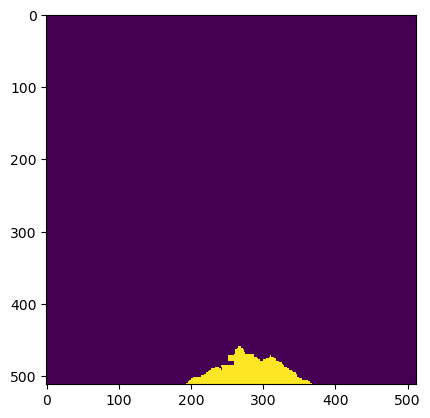

Wrote output/patches/mask/VC_S1_196-481232-0000-6316564-8000.tiff (512 x 512 pixels)


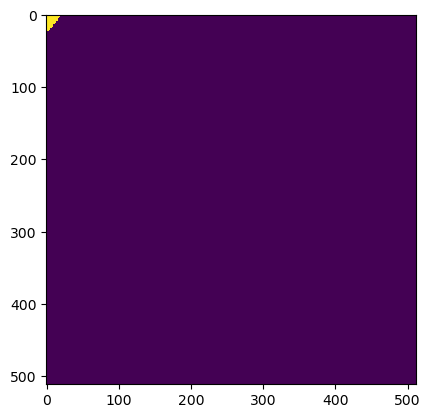

Wrote output/patches/mask/VC_S1_196-481232-0000-6316667-2000.tiff (512 x 512 pixels)


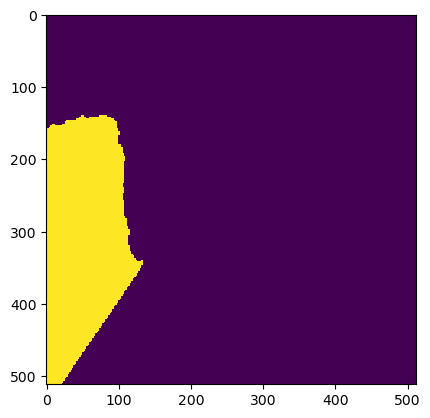

Wrote output/patches/mask/VC_S1_196-481232-0000-6316769-6000.tiff (512 x 512 pixels)


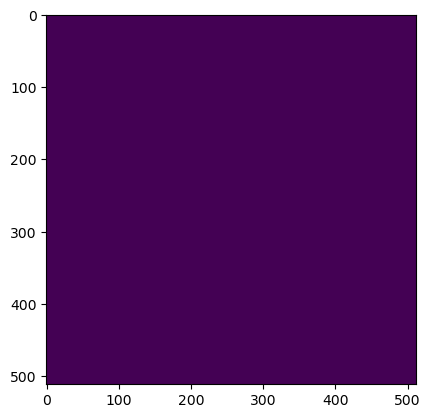

Wrote output/patches/mask/VC_S1_196-481232-0000-6316872-0000.tiff (512 x 512 pixels)


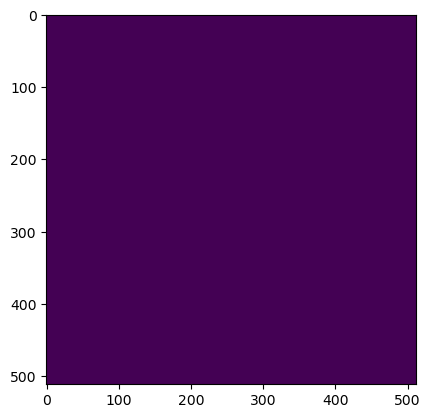

Wrote output/patches/mask/VC_S1_196-481232-0000-6316974-4000.tiff (512 x 512 pixels)


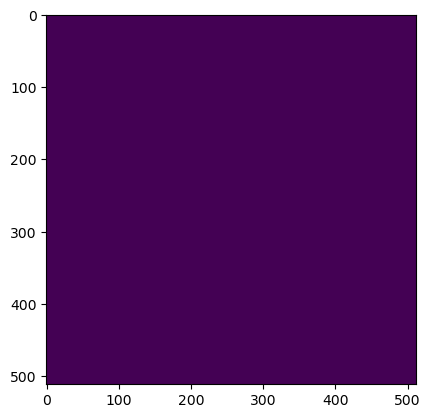

Wrote output/patches/mask/VC_S1_196-481232-0000-6317076-8000.tiff (512 x 512 pixels)


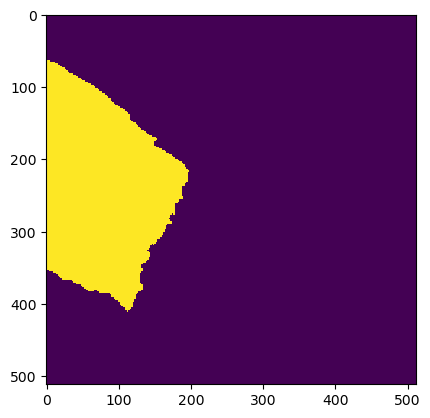

Wrote output/patches/mask/VC_S1_196-481334-4000-6316462-4000.tiff (512 x 512 pixels)


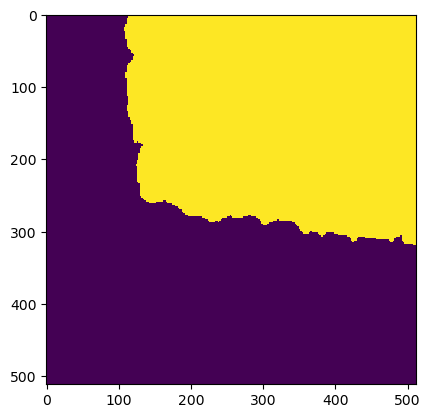

Wrote output/patches/mask/VC_S1_196-481334-4000-6316564-8000.tiff (512 x 512 pixels)


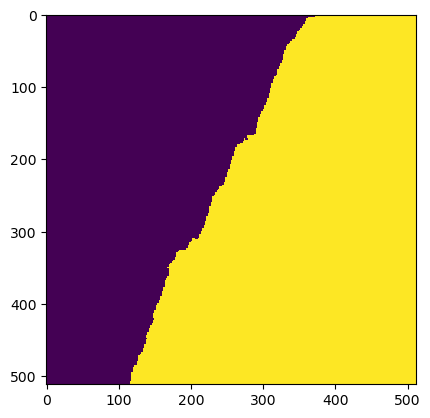

Wrote output/patches/mask/VC_S1_196-481334-4000-6316667-2000.tiff (512 x 512 pixels)


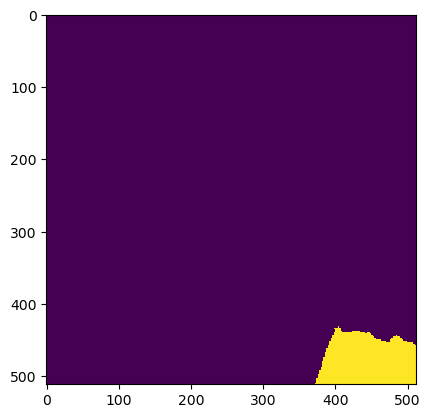

Wrote output/patches/mask/VC_S1_196-481334-4000-6316769-6000.tiff (512 x 512 pixels)


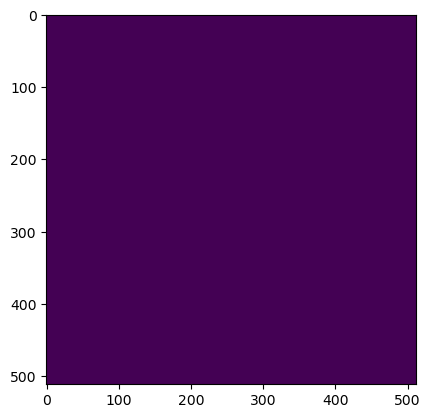

Wrote output/patches/mask/VC_S1_196-481334-4000-6316872-0000.tiff (512 x 512 pixels)


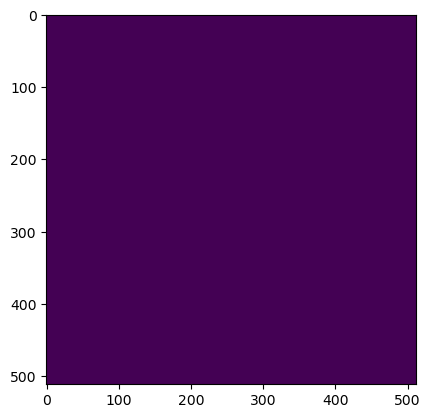

Wrote output/patches/mask/VC_S1_196-481334-4000-6316974-4000.tiff (512 x 512 pixels)


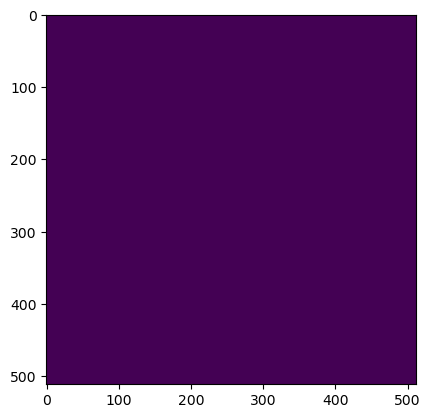

Wrote output/patches/mask/VC_S1_196-481334-4000-6317076-8000.tiff (512 x 512 pixels)


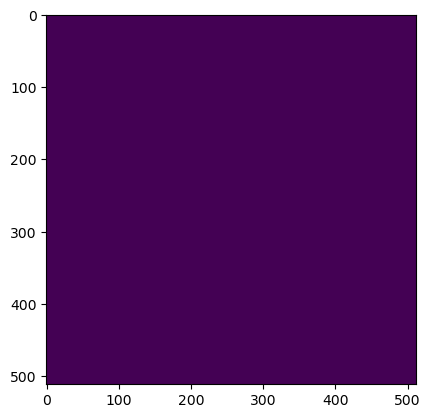

Wrote output/patches/mask/VC_S1_196-481436-8000-6316462-4000.tiff (512 x 512 pixels)


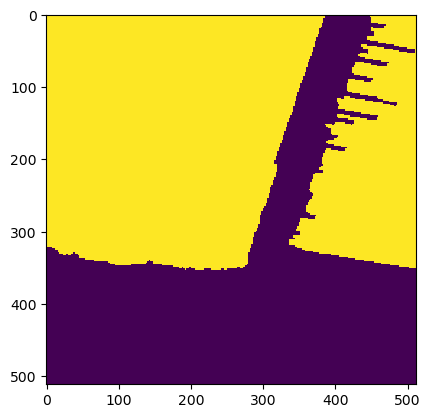

Wrote output/patches/mask/VC_S1_196-481436-8000-6316564-8000.tiff (512 x 512 pixels)


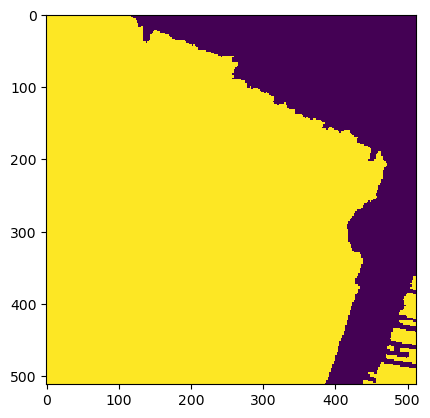

Wrote output/patches/mask/VC_S1_196-481436-8000-6316667-2000.tiff (512 x 512 pixels)


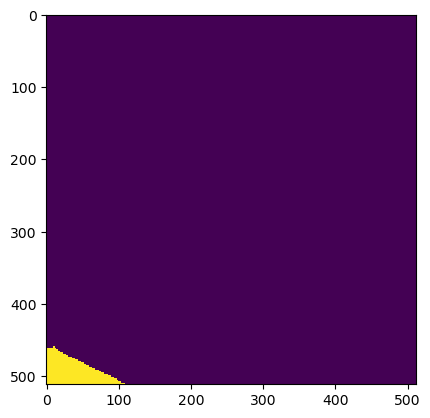

Wrote output/patches/mask/VC_S1_196-481436-8000-6316769-6000.tiff (512 x 512 pixels)


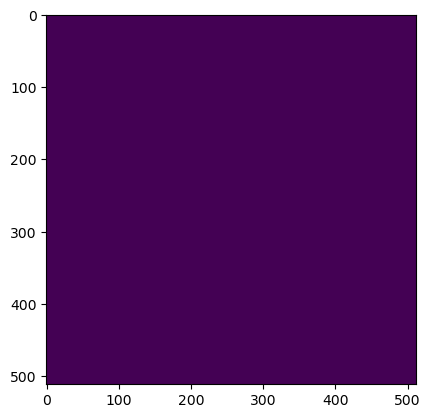

Wrote output/patches/mask/VC_S1_196-481436-8000-6316872-0000.tiff (512 x 512 pixels)


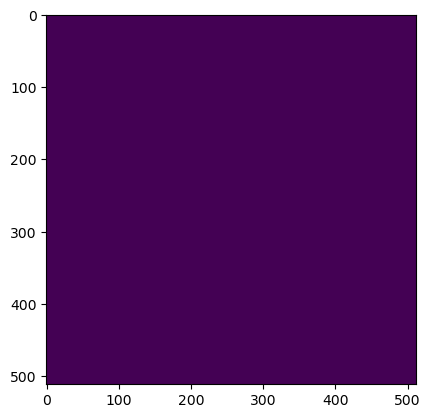

Wrote output/patches/mask/VC_S1_196-481436-8000-6316974-4000.tiff (512 x 512 pixels)


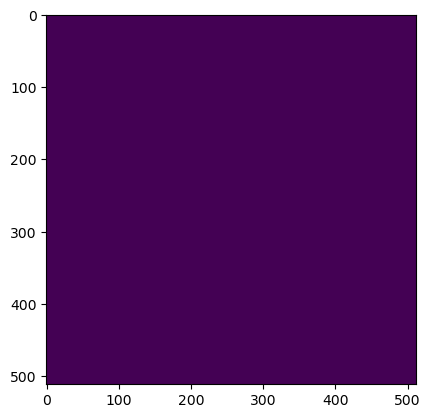

Wrote output/patches/mask/VC_S1_196-481436-8000-6317076-8000.tiff (512 x 512 pixels)


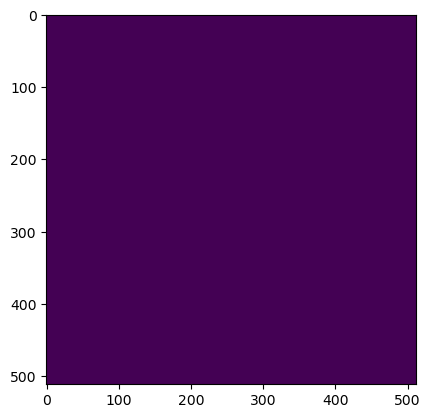

Wrote output/patches/mask/VC_S1_196-481539-2000-6316462-4000.tiff (512 x 512 pixels)


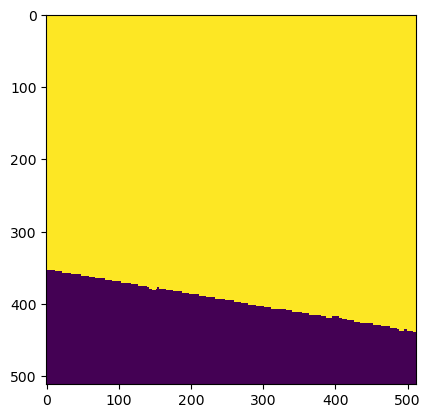

Wrote output/patches/mask/VC_S1_196-481539-2000-6316564-8000.tiff (512 x 512 pixels)


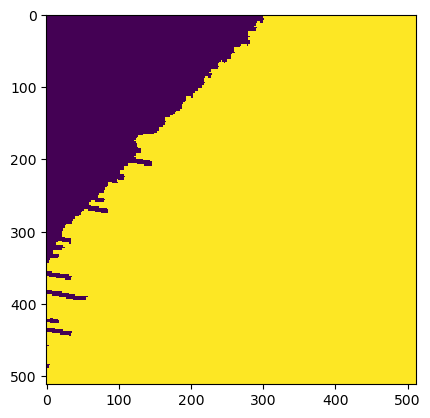

Wrote output/patches/mask/VC_S1_196-481539-2000-6316667-2000.tiff (512 x 512 pixels)


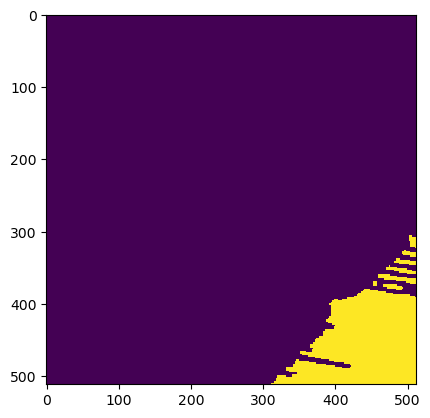

Wrote output/patches/mask/VC_S1_196-481539-2000-6316769-6000.tiff (512 x 512 pixels)


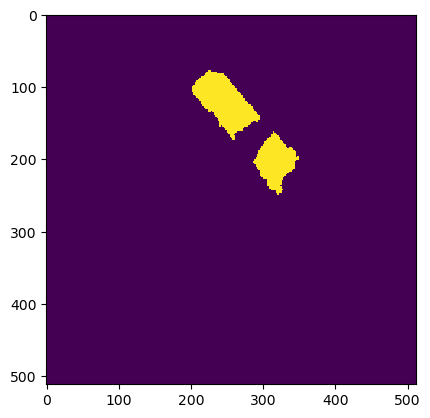

Wrote output/patches/mask/VC_S1_196-481539-2000-6316872-0000.tiff (512 x 512 pixels)


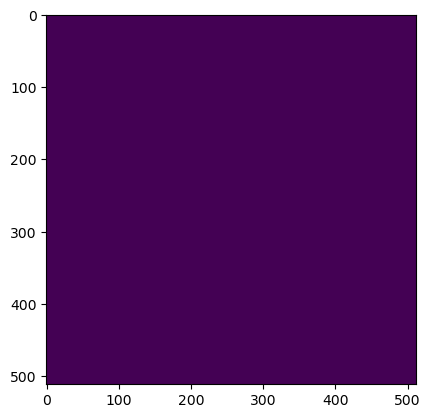

Wrote output/patches/mask/VC_S1_196-481539-2000-6316974-4000.tiff (512 x 512 pixels)


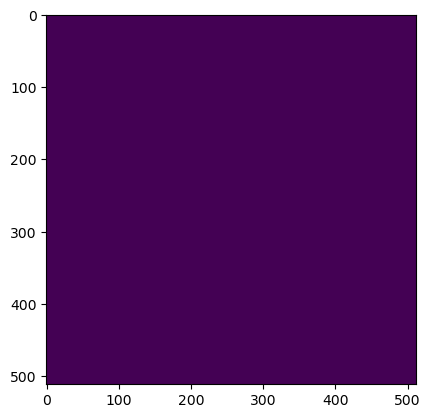

Wrote output/patches/mask/VC_S1_196-481539-2000-6317076-8000.tiff (512 x 512 pixels)


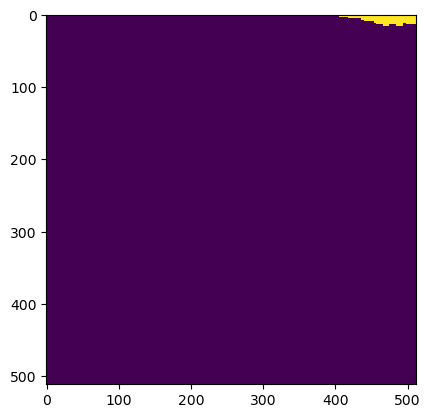

Wrote output/patches/mask/VC_S1_196-481641-6000-6316462-4000.tiff (512 x 512 pixels)


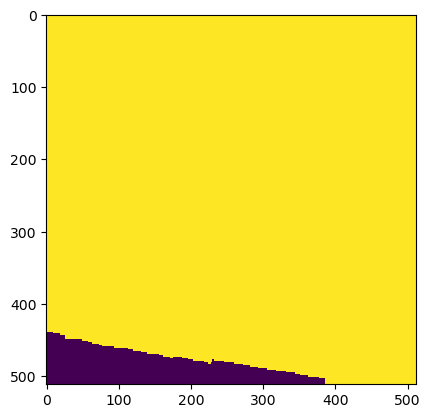

Wrote output/patches/mask/VC_S1_196-481641-6000-6316564-8000.tiff (512 x 512 pixels)


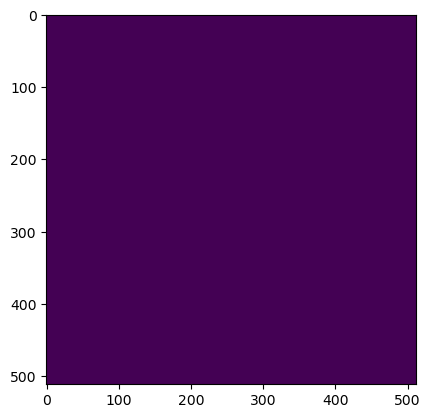

Wrote output/patches/mask/VC_S1_196-481641-6000-6316667-2000.tiff (512 x 512 pixels)


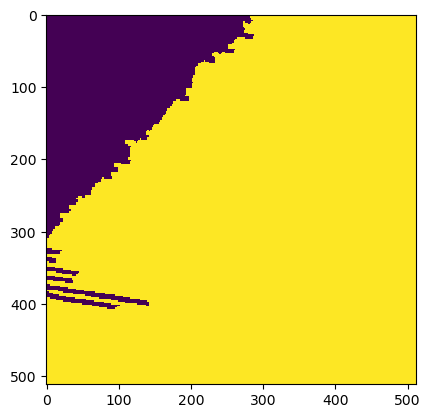

Wrote output/patches/mask/VC_S1_196-481641-6000-6316769-6000.tiff (512 x 512 pixels)


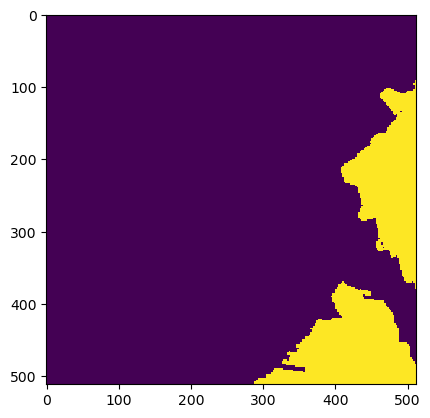

Wrote output/patches/mask/VC_S1_196-481641-6000-6316872-0000.tiff (512 x 512 pixels)


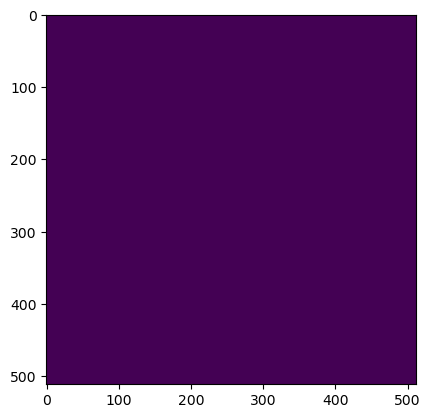

Wrote output/patches/mask/VC_S1_196-481641-6000-6316974-4000.tiff (512 x 512 pixels)


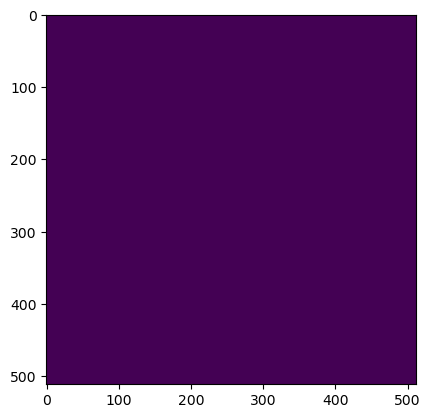

Wrote output/patches/mask/VC_S1_196-481641-6000-6317076-8000.tiff (512 x 512 pixels)


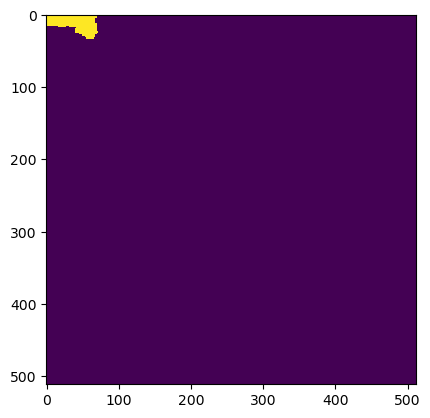

Wrote output/patches/mask/VC_S1_196-481744-0000-6316462-4000.tiff (512 x 512 pixels)


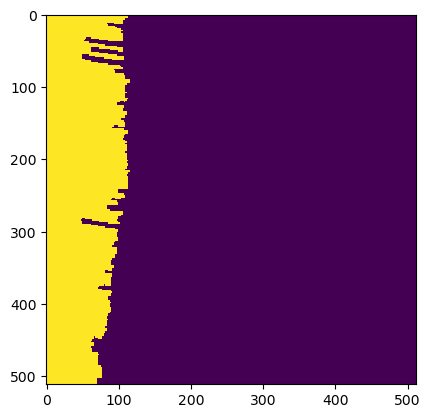

Wrote output/patches/mask/VC_S1_196-481744-0000-6316564-8000.tiff (512 x 512 pixels)


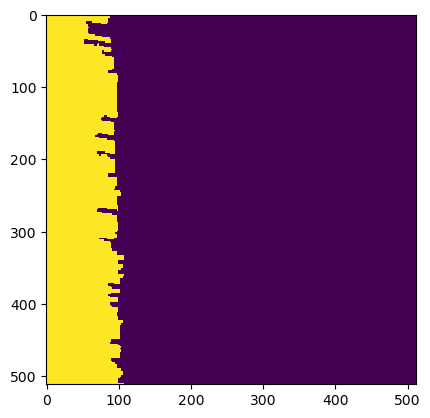

Wrote output/patches/mask/VC_S1_196-481744-0000-6316667-2000.tiff (512 x 512 pixels)


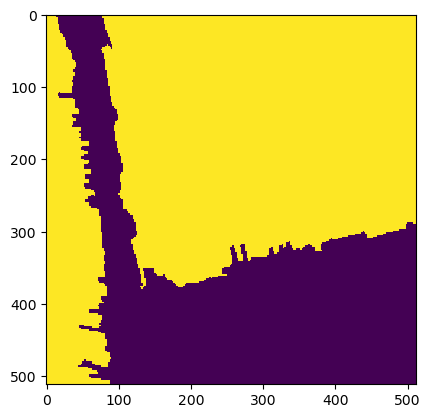

Wrote output/patches/mask/VC_S1_196-481744-0000-6316769-6000.tiff (512 x 512 pixels)


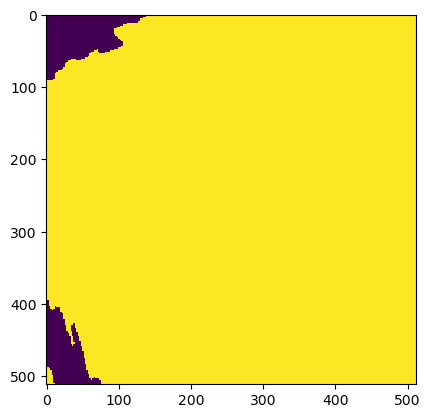

Wrote output/patches/mask/VC_S1_196-481744-0000-6316872-0000.tiff (512 x 512 pixels)


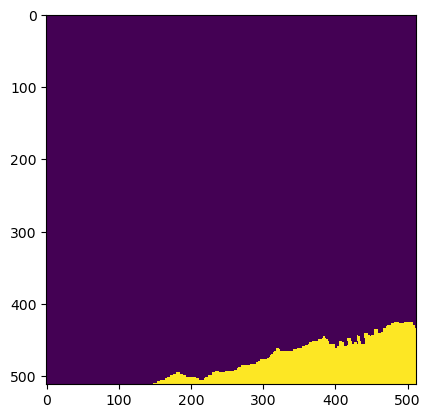

Wrote output/patches/mask/VC_S1_196-481744-0000-6316974-4000.tiff (512 x 512 pixels)


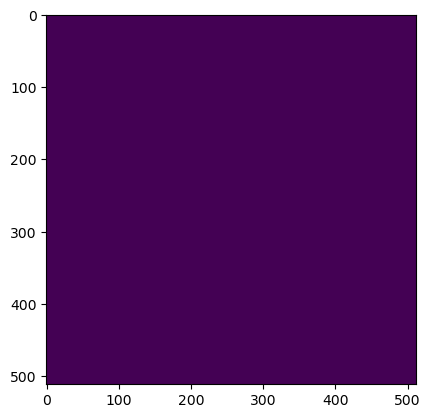

Wrote output/patches/mask/VC_S1_196-481744-0000-6317076-8000.tiff (512 x 512 pixels)


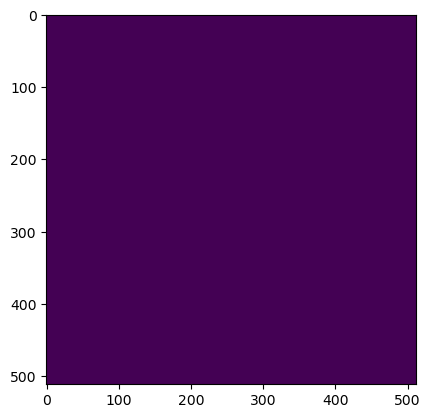

Wrote output/patches/mask/VC_S1_196-481846-4000-6316462-4000.tiff (512 x 512 pixels)


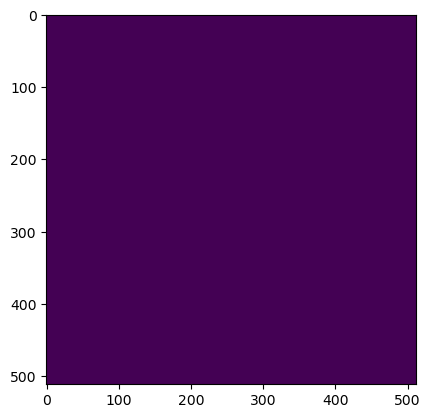

Wrote output/patches/mask/VC_S1_196-481846-4000-6316564-8000.tiff (512 x 512 pixels)


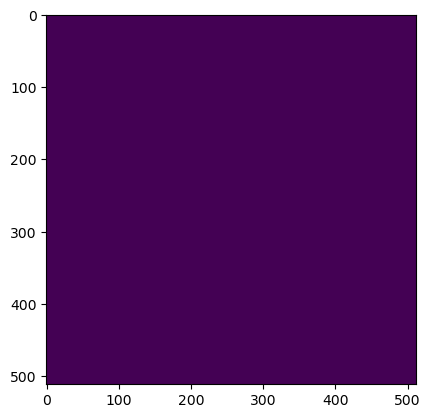

Wrote output/patches/mask/VC_S1_196-481846-4000-6316667-2000.tiff (512 x 512 pixels)


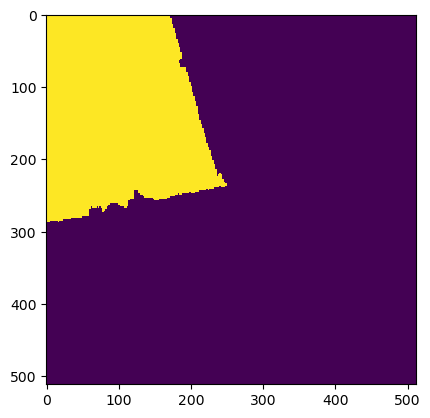

Wrote output/patches/mask/VC_S1_196-481846-4000-6316769-6000.tiff (512 x 512 pixels)


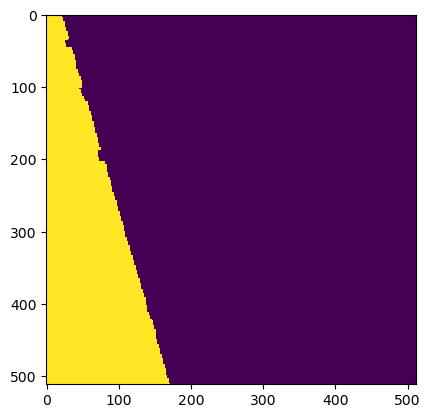

Wrote output/patches/mask/VC_S1_196-481846-4000-6316872-0000.tiff (512 x 512 pixels)


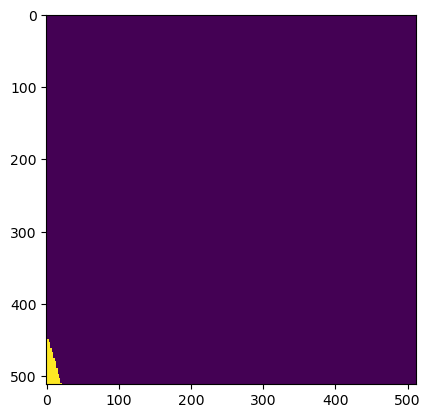

Wrote output/patches/mask/VC_S1_196-481846-4000-6316974-4000.tiff (512 x 512 pixels)


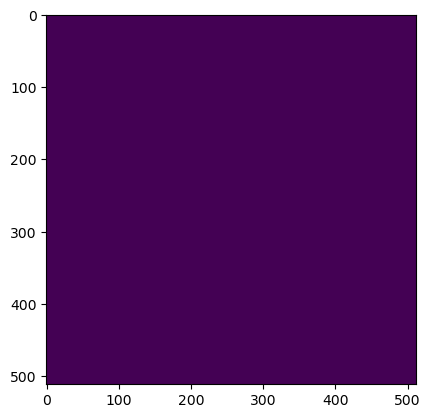

Wrote output/patches/mask/VC_S1_196-481846-4000-6317076-8000.tiff (512 x 512 pixels)
Zone VC_S1_197 Building Mask...


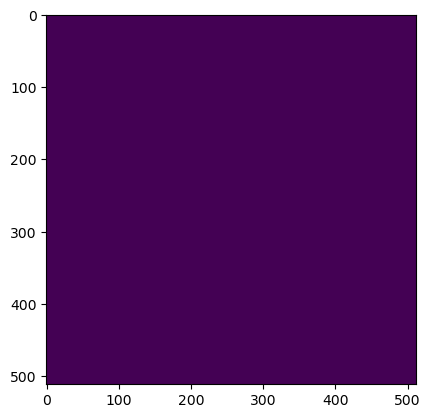

Wrote output/patches/mask/VC_S1_197-447952-0000-6316974-4000.tiff (512 x 512 pixels)


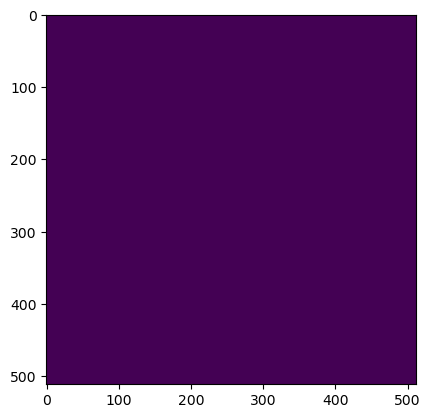

Wrote output/patches/mask/VC_S1_197-447952-0000-6317076-8000.tiff (512 x 512 pixels)


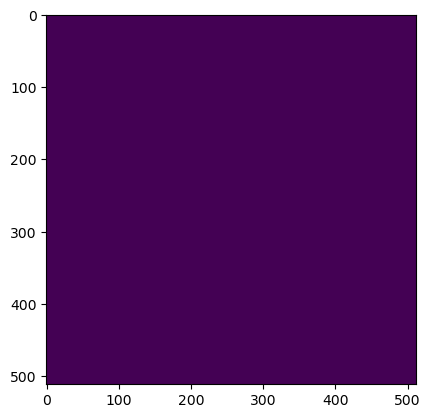

Wrote output/patches/mask/VC_S1_197-447952-0000-6317179-2000.tiff (512 x 512 pixels)


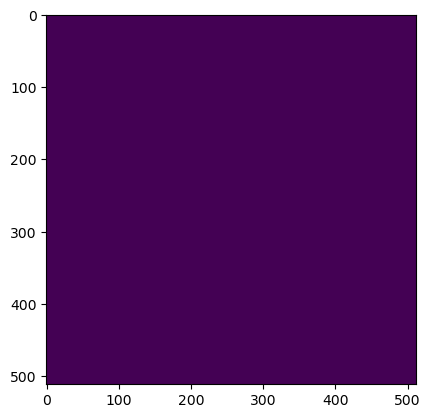

Wrote output/patches/mask/VC_S1_197-447952-0000-6317281-6000.tiff (512 x 512 pixels)


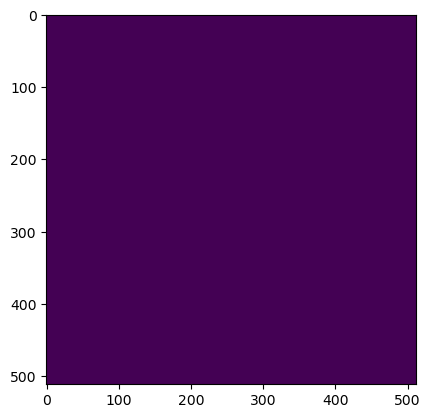

Wrote output/patches/mask/VC_S1_197-448054-4000-6316974-4000.tiff (512 x 512 pixels)


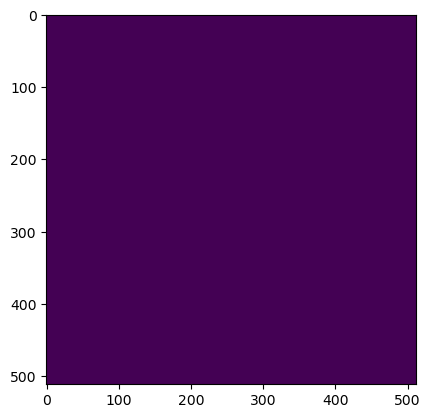

Wrote output/patches/mask/VC_S1_197-448054-4000-6317076-8000.tiff (512 x 512 pixels)


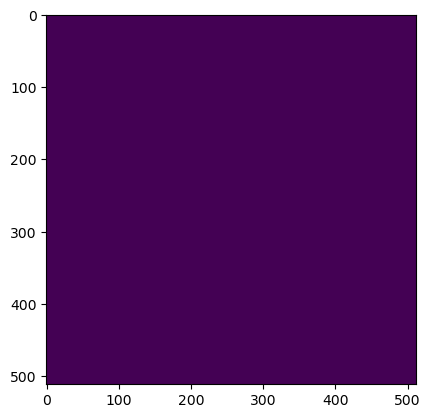

Wrote output/patches/mask/VC_S1_197-448054-4000-6317179-2000.tiff (512 x 512 pixels)


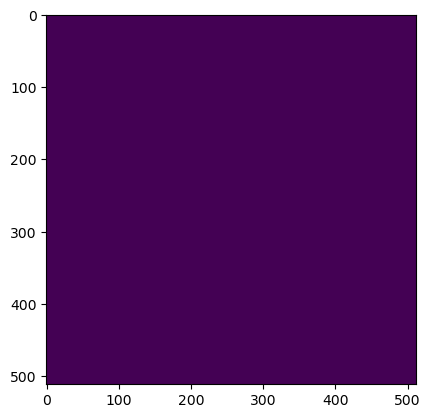

Wrote output/patches/mask/VC_S1_197-448054-4000-6317281-6000.tiff (512 x 512 pixels)


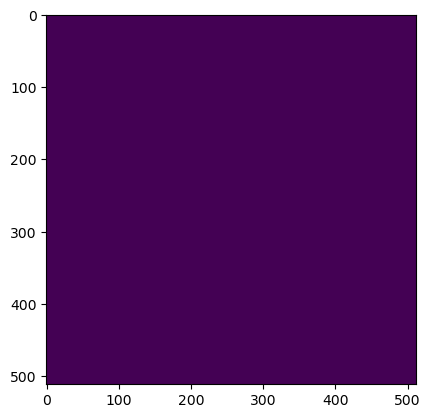

Wrote output/patches/mask/VC_S1_197-448156-8000-6316974-4000.tiff (512 x 512 pixels)


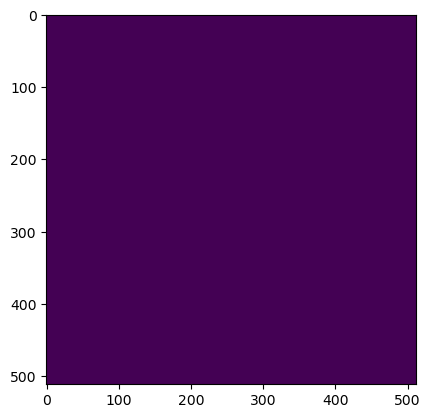

Wrote output/patches/mask/VC_S1_197-448156-8000-6317076-8000.tiff (512 x 512 pixels)


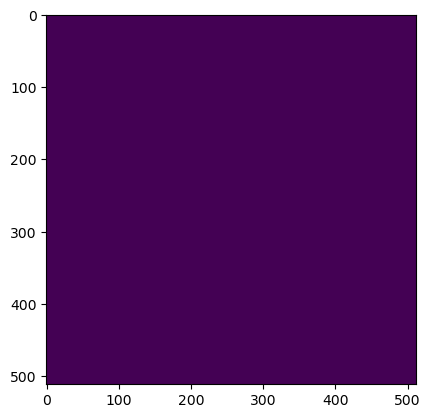

Wrote output/patches/mask/VC_S1_197-448156-8000-6317179-2000.tiff (512 x 512 pixels)


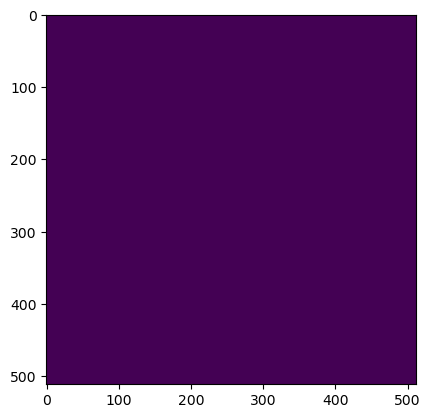

Wrote output/patches/mask/VC_S1_197-448156-8000-6317281-6000.tiff (512 x 512 pixels)


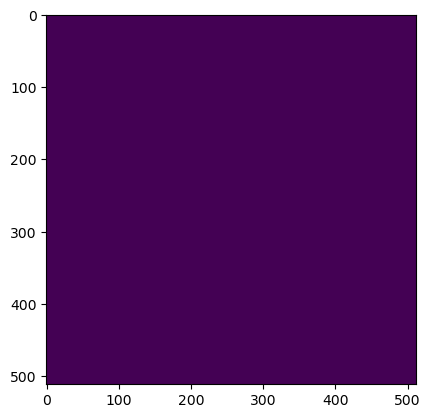

Wrote output/patches/mask/VC_S1_197-448259-2000-6316974-4000.tiff (512 x 512 pixels)


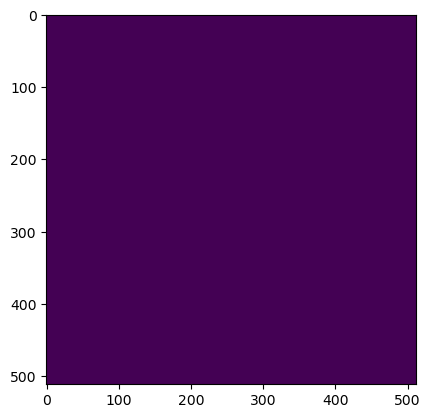

Wrote output/patches/mask/VC_S1_197-448259-2000-6317076-8000.tiff (512 x 512 pixels)


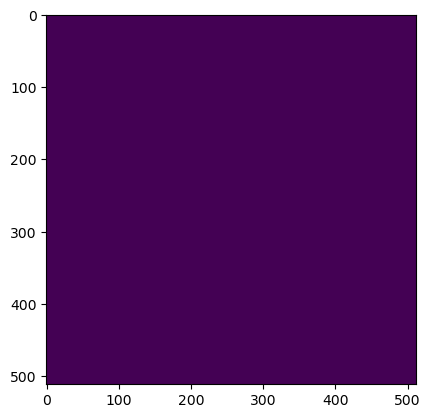

Wrote output/patches/mask/VC_S1_197-448259-2000-6317179-2000.tiff (512 x 512 pixels)


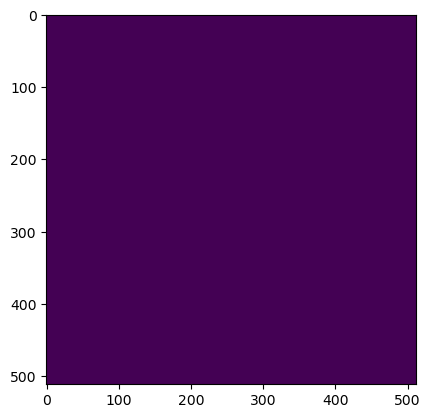

Wrote output/patches/mask/VC_S1_197-448259-2000-6317281-6000.tiff (512 x 512 pixels)


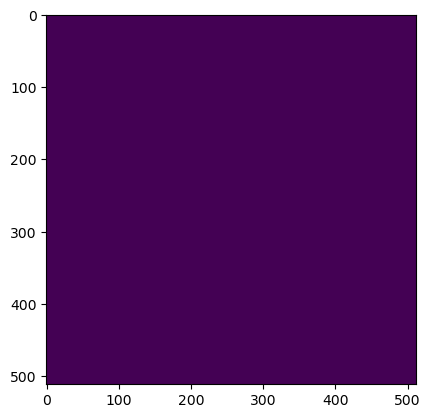

Wrote output/patches/mask/VC_S1_197-448361-6000-6316974-4000.tiff (512 x 512 pixels)


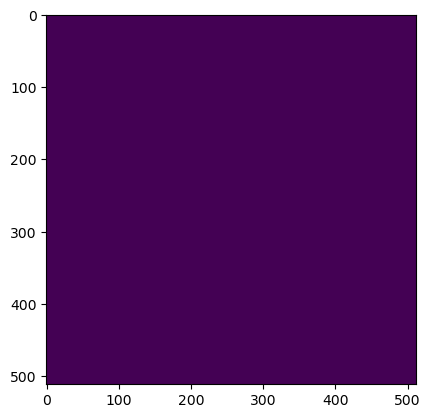

Wrote output/patches/mask/VC_S1_197-448361-6000-6317076-8000.tiff (512 x 512 pixels)


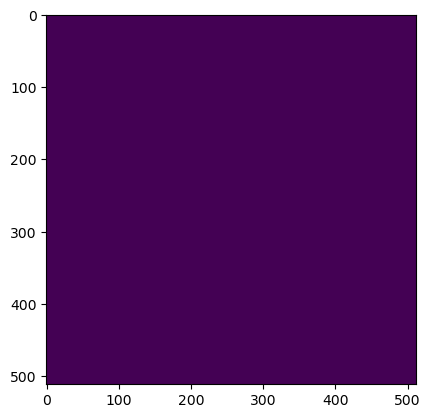

Wrote output/patches/mask/VC_S1_197-448361-6000-6317179-2000.tiff (512 x 512 pixels)


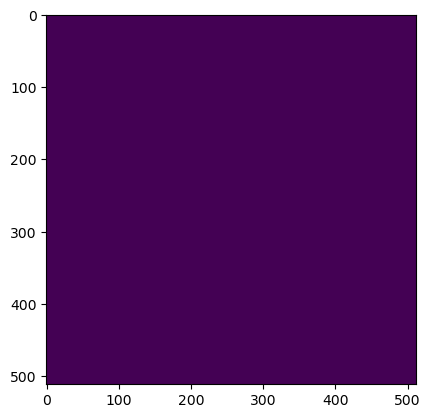

Wrote output/patches/mask/VC_S1_197-448361-6000-6317281-6000.tiff (512 x 512 pixels)


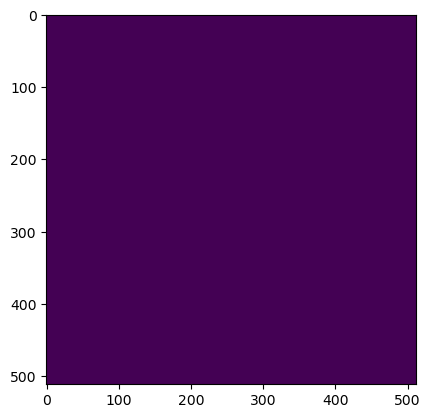

Wrote output/patches/mask/VC_S1_197-448464-0000-6316974-4000.tiff (512 x 512 pixels)


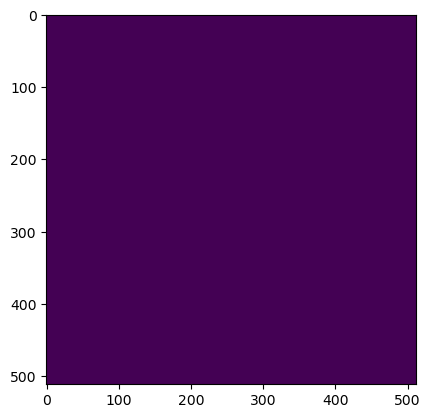

Wrote output/patches/mask/VC_S1_197-448464-0000-6317076-8000.tiff (512 x 512 pixels)


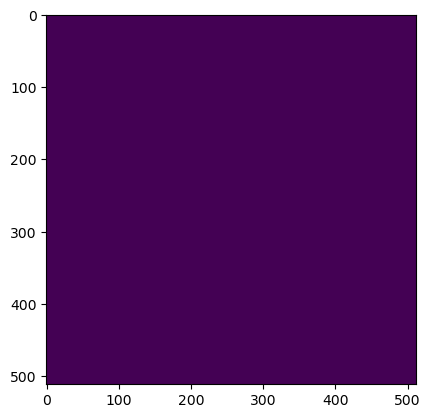

Wrote output/patches/mask/VC_S1_197-448464-0000-6317179-2000.tiff (512 x 512 pixels)


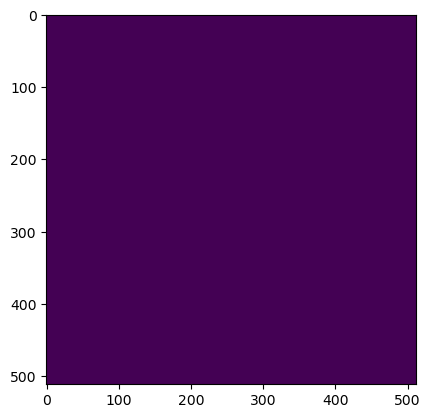

Wrote output/patches/mask/VC_S1_197-448464-0000-6317281-6000.tiff (512 x 512 pixels)


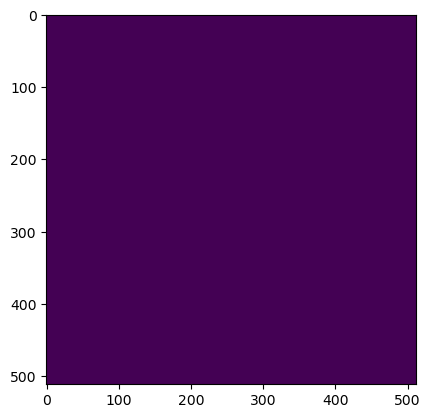

Wrote output/patches/mask/VC_S1_197-448566-4000-6316974-4000.tiff (512 x 512 pixels)


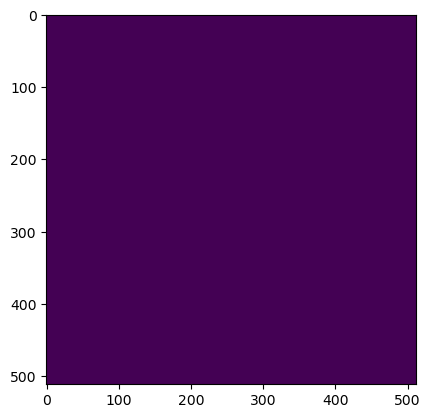

Wrote output/patches/mask/VC_S1_197-448566-4000-6317076-8000.tiff (512 x 512 pixels)


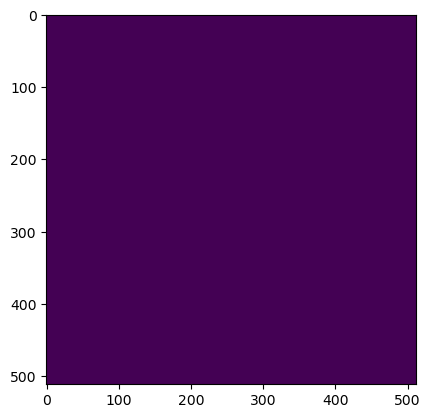

Wrote output/patches/mask/VC_S1_197-448566-4000-6317179-2000.tiff (512 x 512 pixels)


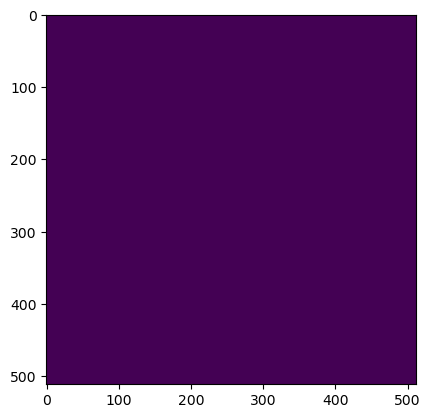

Wrote output/patches/mask/VC_S1_197-448566-4000-6317281-6000.tiff (512 x 512 pixels)


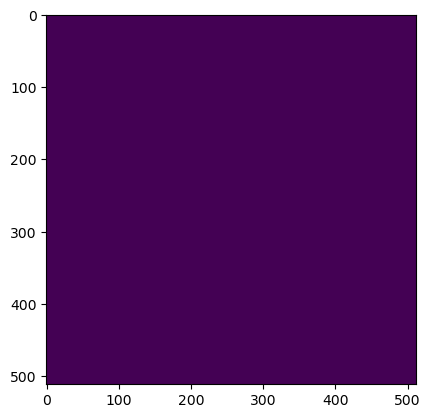

Wrote output/patches/mask/VC_S1_197-448668-8000-6316974-4000.tiff (512 x 512 pixels)


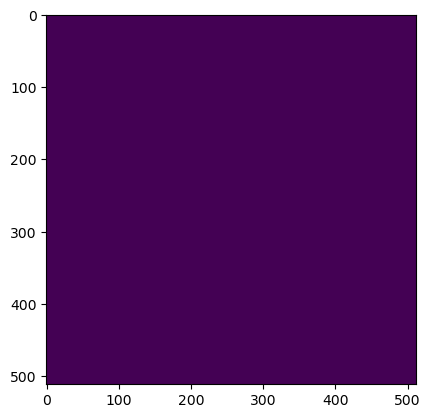

Wrote output/patches/mask/VC_S1_197-448668-8000-6317076-8000.tiff (512 x 512 pixels)


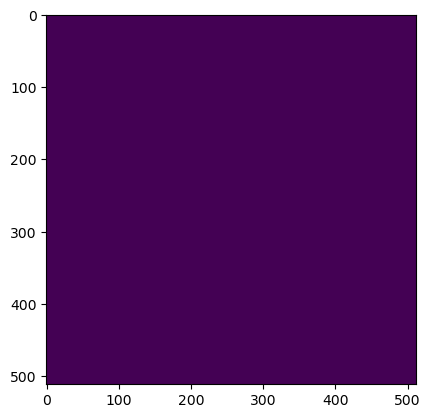

Wrote output/patches/mask/VC_S1_197-448668-8000-6317179-2000.tiff (512 x 512 pixels)


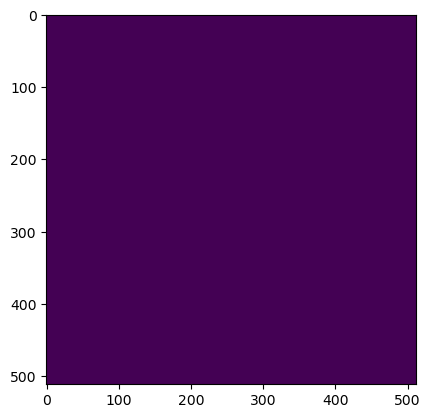

Wrote output/patches/mask/VC_S1_197-448668-8000-6317281-6000.tiff (512 x 512 pixels)


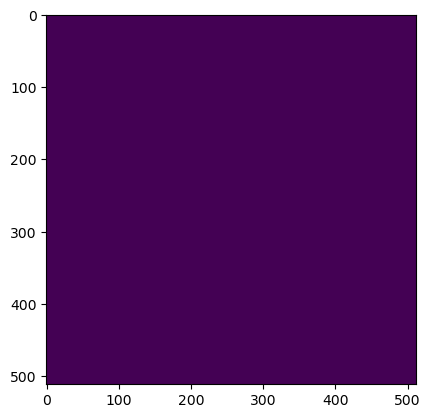

Wrote output/patches/mask/VC_S1_197-448771-2000-6316974-4000.tiff (512 x 512 pixels)


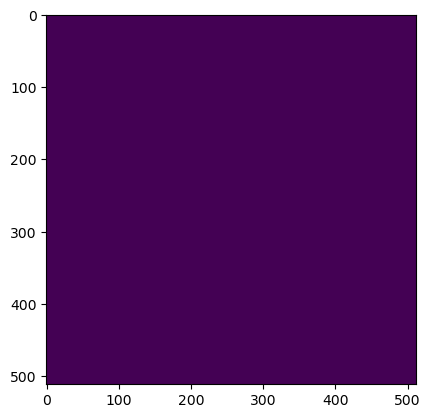

Wrote output/patches/mask/VC_S1_197-448771-2000-6317076-8000.tiff (512 x 512 pixels)


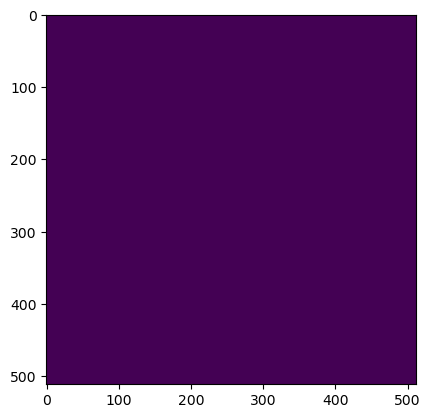

Wrote output/patches/mask/VC_S1_197-448771-2000-6317179-2000.tiff (512 x 512 pixels)


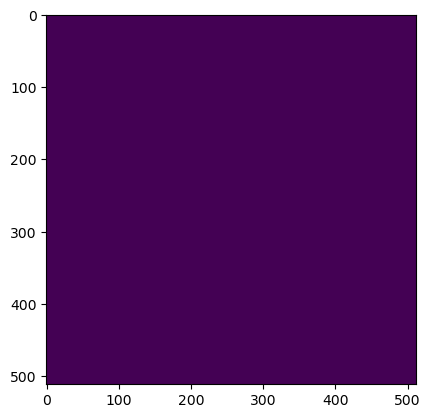

Wrote output/patches/mask/VC_S1_197-448771-2000-6317281-6000.tiff (512 x 512 pixels)
Zone CU_S1_198 Building Mask...


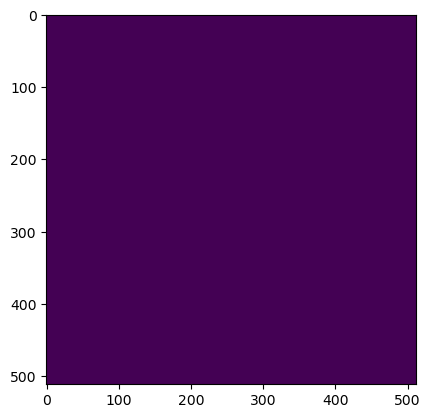

Wrote output/patches/mask/CU_S1_198-501712-0000-6316974-4000.tiff (512 x 512 pixels)


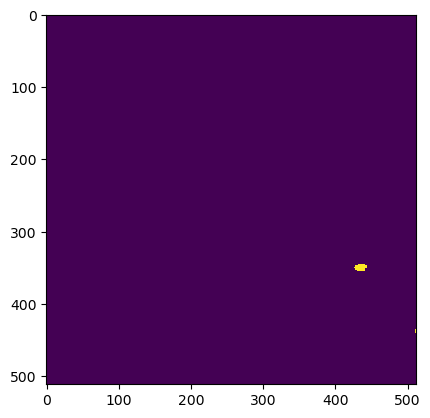

Wrote output/patches/mask/CU_S1_198-501712-0000-6317076-8000.tiff (512 x 512 pixels)


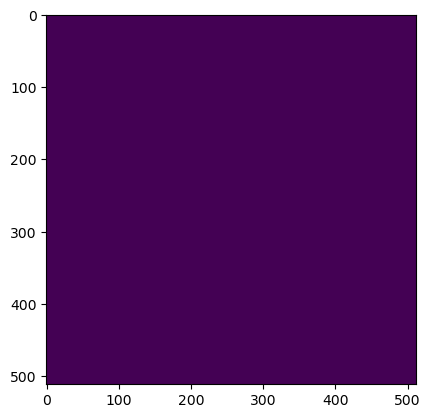

Wrote output/patches/mask/CU_S1_198-501814-4000-6316974-4000.tiff (512 x 512 pixels)


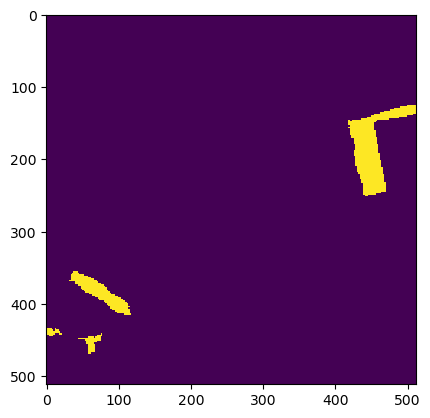

Wrote output/patches/mask/CU_S1_198-501814-4000-6317076-8000.tiff (512 x 512 pixels)
Zone CV_S1_199 Building Mask...


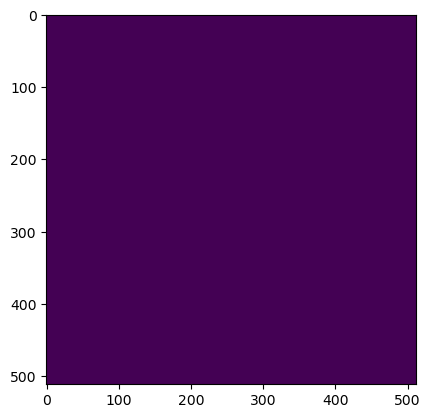

Wrote output/patches/mask/CV_S1_199-472016-0000-6317230-4000.tiff (512 x 512 pixels)


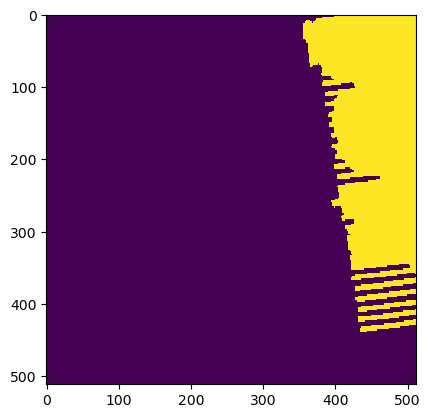

Wrote output/patches/mask/CV_S1_199-472016-0000-6317332-8000.tiff (512 x 512 pixels)


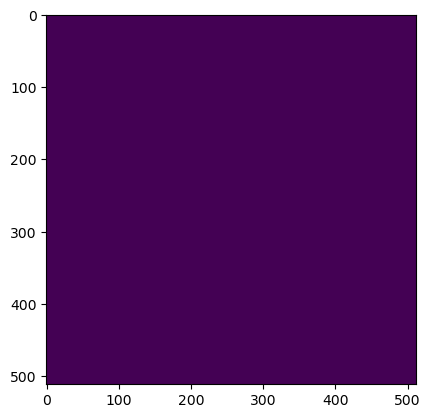

Wrote output/patches/mask/CV_S1_199-472118-4000-6317230-4000.tiff (512 x 512 pixels)


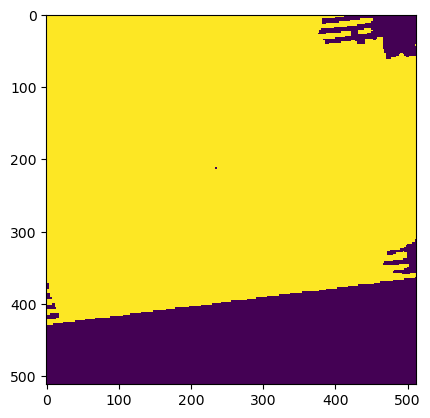

Wrote output/patches/mask/CV_S1_199-472118-4000-6317332-8000.tiff (512 x 512 pixels)
Zone UC_S1_200 Building Mask...


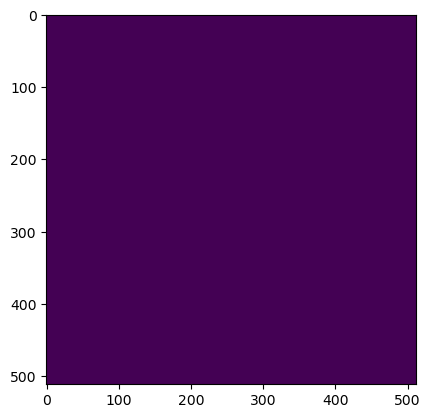

Wrote output/patches/mask/UC_S1_200-449232-0000-6317486-4000.tiff (512 x 512 pixels)


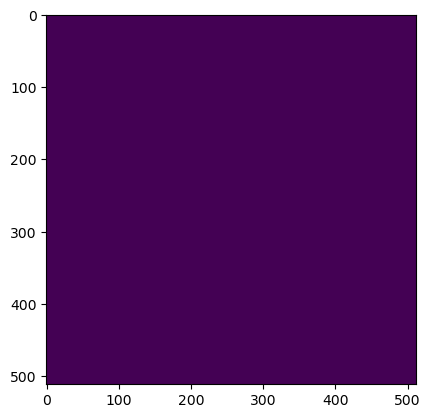

Wrote output/patches/mask/UC_S1_200-449232-0000-6317588-8000.tiff (512 x 512 pixels)


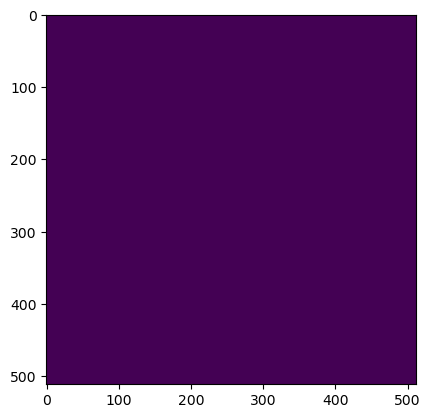

Wrote output/patches/mask/UC_S1_200-449232-0000-6317691-2000.tiff (512 x 512 pixels)


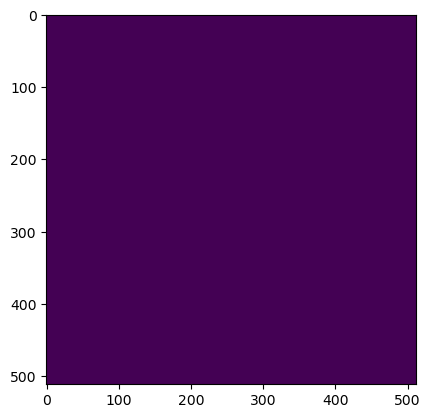

Wrote output/patches/mask/UC_S1_200-449232-0000-6317793-6000.tiff (512 x 512 pixels)


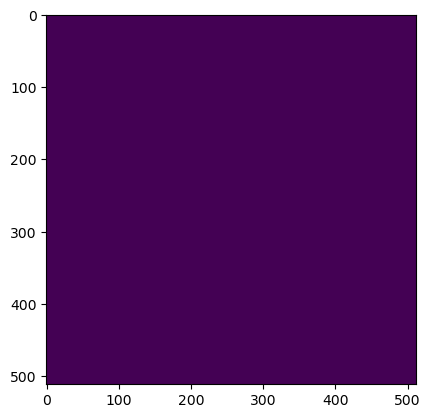

Wrote output/patches/mask/UC_S1_200-449232-0000-6317896-0000.tiff (512 x 512 pixels)


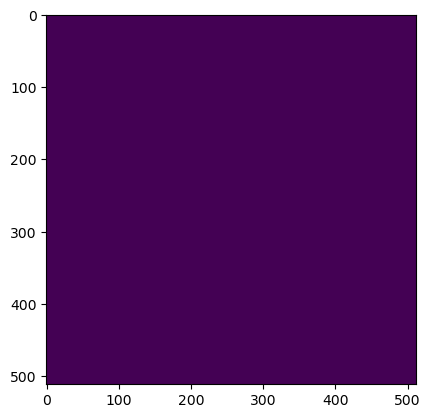

Wrote output/patches/mask/UC_S1_200-449232-0000-6317998-4000.tiff (512 x 512 pixels)


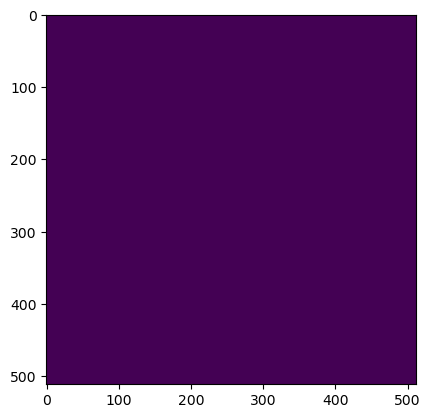

Wrote output/patches/mask/UC_S1_200-449232-0000-6318100-8000.tiff (512 x 512 pixels)


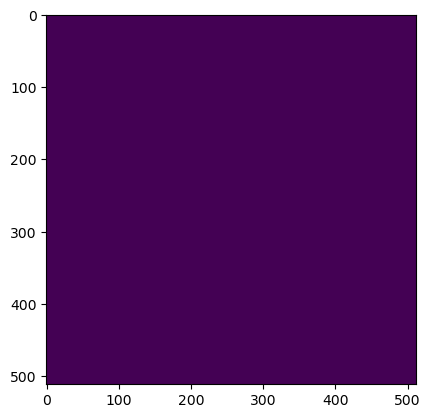

Wrote output/patches/mask/UC_S1_200-449334-4000-6317486-4000.tiff (512 x 512 pixels)


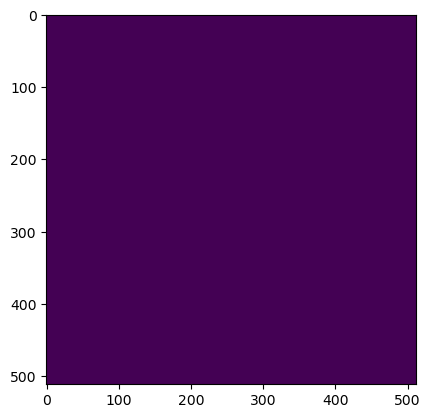

Wrote output/patches/mask/UC_S1_200-449334-4000-6317588-8000.tiff (512 x 512 pixels)


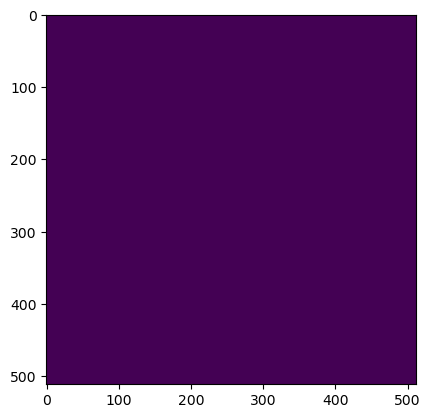

Wrote output/patches/mask/UC_S1_200-449334-4000-6317691-2000.tiff (512 x 512 pixels)


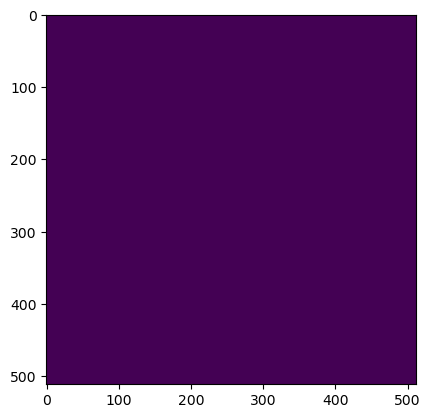

Wrote output/patches/mask/UC_S1_200-449334-4000-6317793-6000.tiff (512 x 512 pixels)


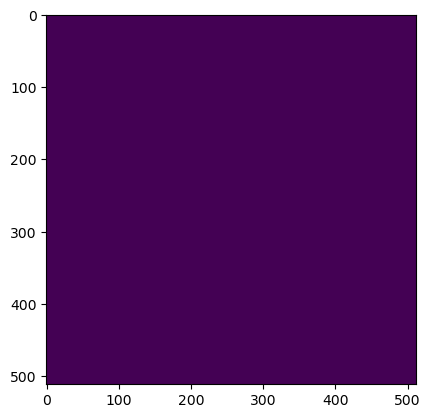

Wrote output/patches/mask/UC_S1_200-449334-4000-6317896-0000.tiff (512 x 512 pixels)


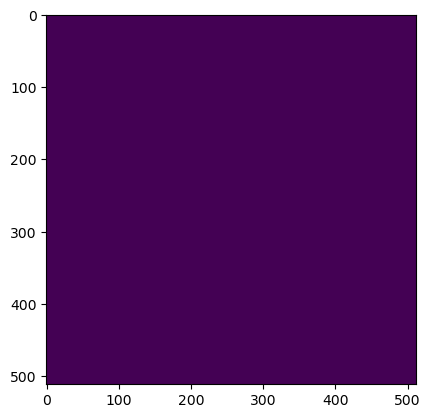

Wrote output/patches/mask/UC_S1_200-449334-4000-6317998-4000.tiff (512 x 512 pixels)


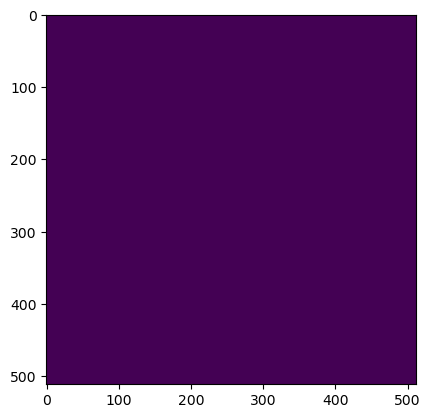

Wrote output/patches/mask/UC_S1_200-449334-4000-6318100-8000.tiff (512 x 512 pixels)


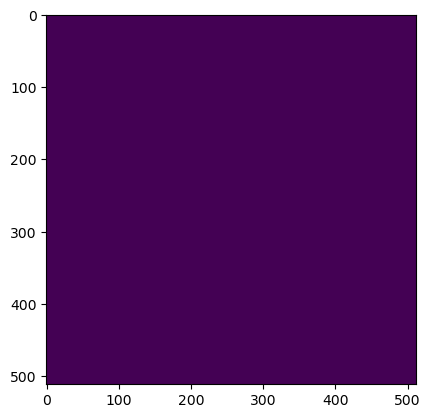

Wrote output/patches/mask/UC_S1_200-449436-8000-6317486-4000.tiff (512 x 512 pixels)


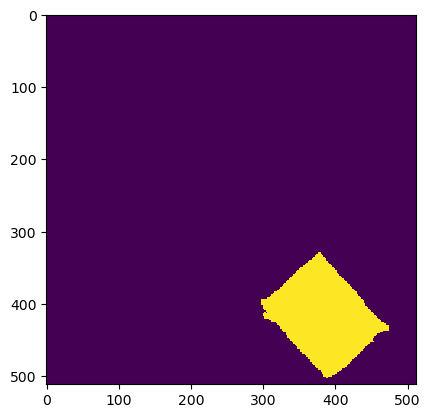

Wrote output/patches/mask/UC_S1_200-449436-8000-6317588-8000.tiff (512 x 512 pixels)


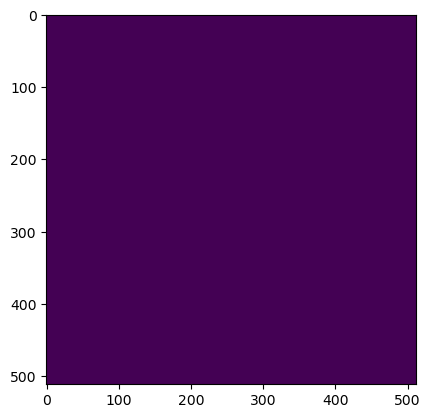

Wrote output/patches/mask/UC_S1_200-449436-8000-6317691-2000.tiff (512 x 512 pixels)


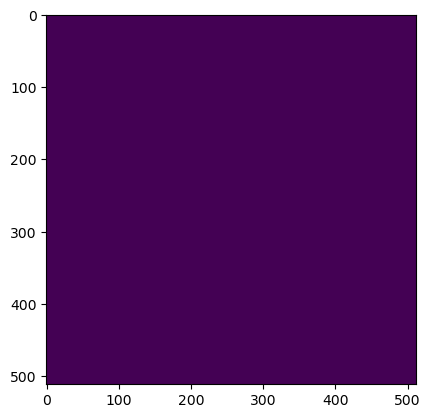

Wrote output/patches/mask/UC_S1_200-449436-8000-6317793-6000.tiff (512 x 512 pixels)


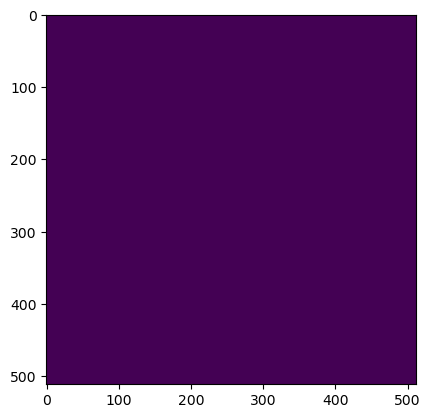

Wrote output/patches/mask/UC_S1_200-449436-8000-6317896-0000.tiff (512 x 512 pixels)


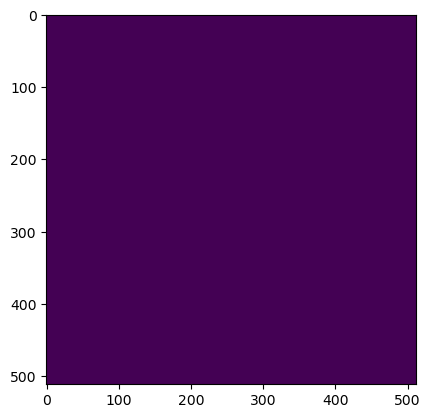

Wrote output/patches/mask/UC_S1_200-449436-8000-6317998-4000.tiff (512 x 512 pixels)


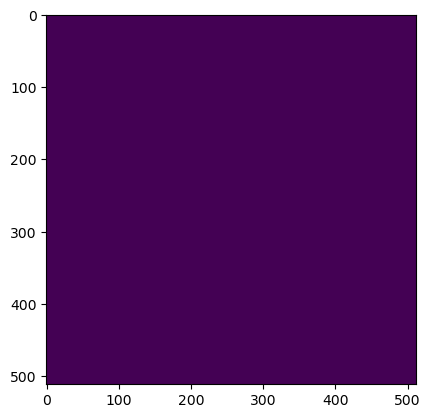

Wrote output/patches/mask/UC_S1_200-449436-8000-6318100-8000.tiff (512 x 512 pixels)


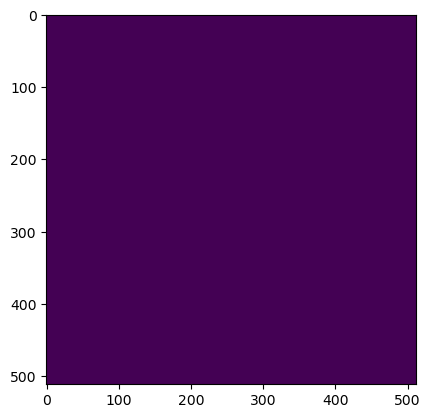

Wrote output/patches/mask/UC_S1_200-449539-2000-6317486-4000.tiff (512 x 512 pixels)


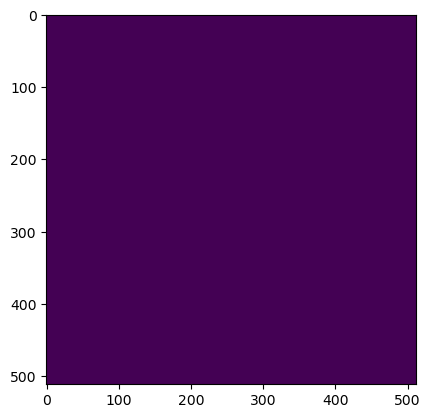

Wrote output/patches/mask/UC_S1_200-449539-2000-6317588-8000.tiff (512 x 512 pixels)


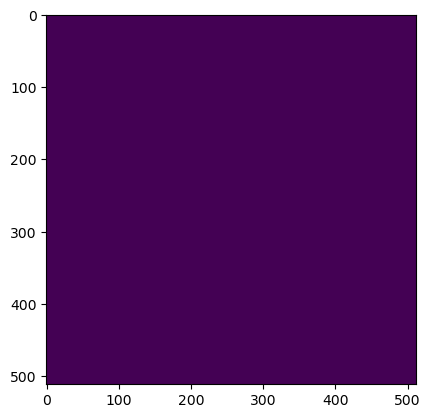

Wrote output/patches/mask/UC_S1_200-449539-2000-6317691-2000.tiff (512 x 512 pixels)


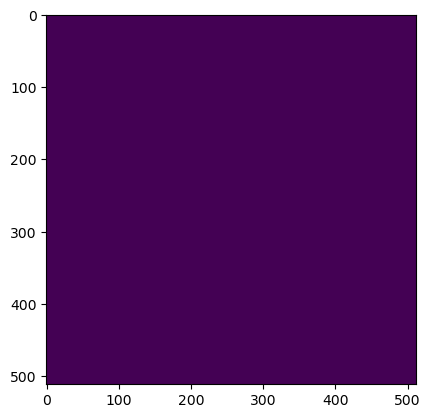

Wrote output/patches/mask/UC_S1_200-449539-2000-6317793-6000.tiff (512 x 512 pixels)


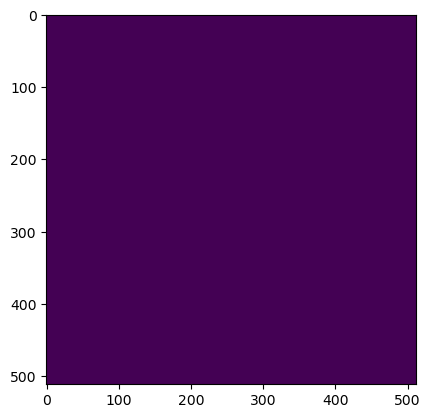

Wrote output/patches/mask/UC_S1_200-449539-2000-6317896-0000.tiff (512 x 512 pixels)


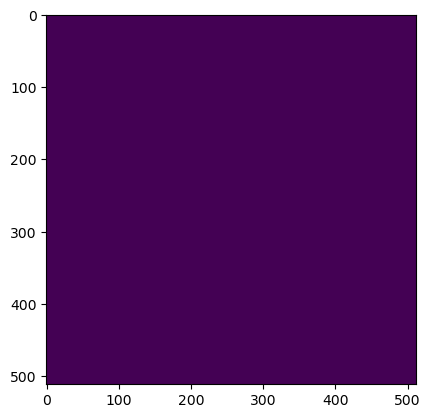

Wrote output/patches/mask/UC_S1_200-449539-2000-6317998-4000.tiff (512 x 512 pixels)


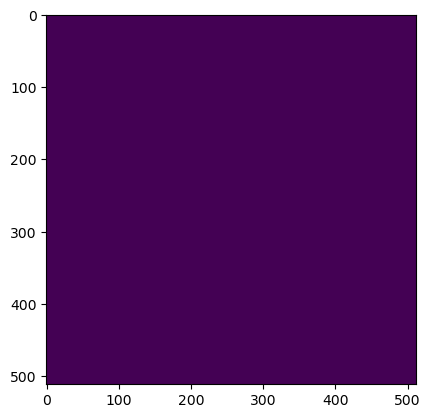

Wrote output/patches/mask/UC_S1_200-449539-2000-6318100-8000.tiff (512 x 512 pixels)


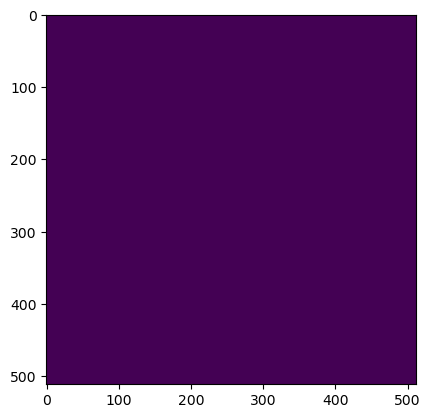

Wrote output/patches/mask/UC_S1_200-449641-6000-6317486-4000.tiff (512 x 512 pixels)


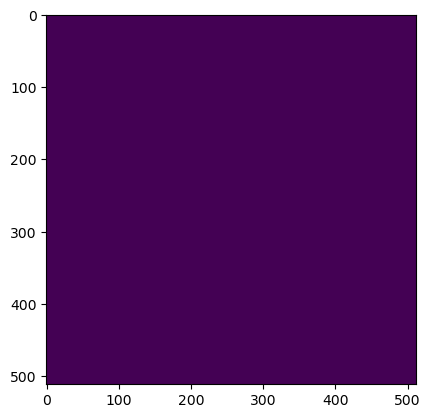

Wrote output/patches/mask/UC_S1_200-449641-6000-6317588-8000.tiff (512 x 512 pixels)


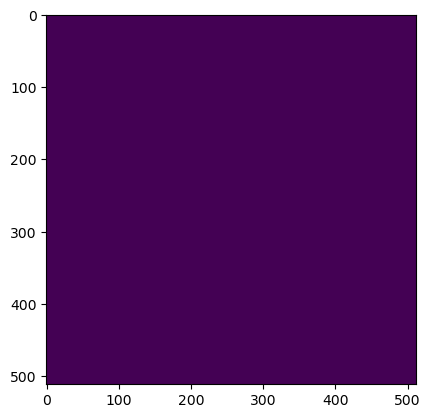

Wrote output/patches/mask/UC_S1_200-449641-6000-6317691-2000.tiff (512 x 512 pixels)


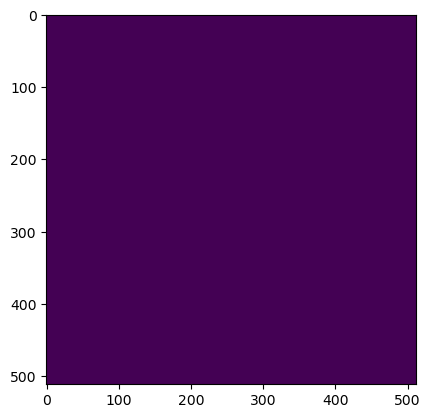

Wrote output/patches/mask/UC_S1_200-449641-6000-6317793-6000.tiff (512 x 512 pixels)


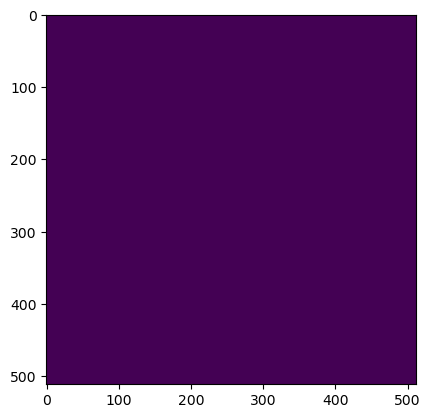

Wrote output/patches/mask/UC_S1_200-449641-6000-6317896-0000.tiff (512 x 512 pixels)


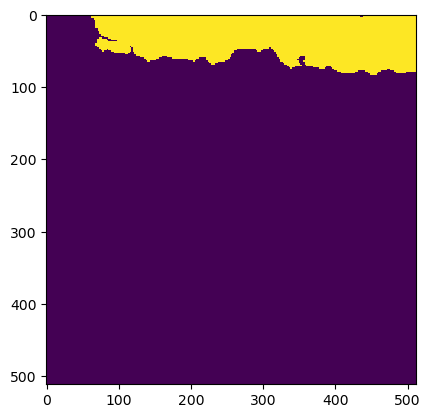

Wrote output/patches/mask/UC_S1_200-449641-6000-6317998-4000.tiff (512 x 512 pixels)


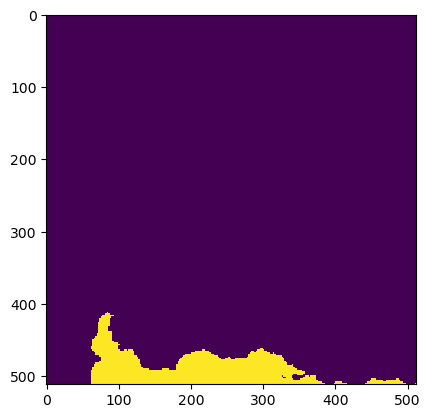

Wrote output/patches/mask/UC_S1_200-449641-6000-6318100-8000.tiff (512 x 512 pixels)


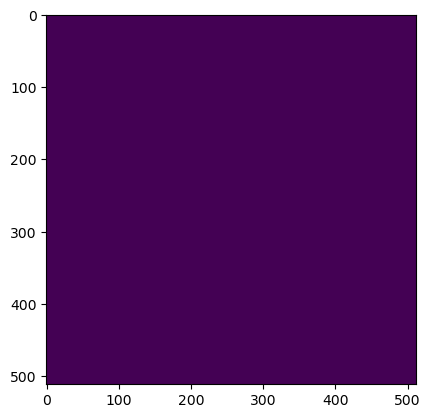

Wrote output/patches/mask/UC_S1_200-449744-0000-6317486-4000.tiff (512 x 512 pixels)


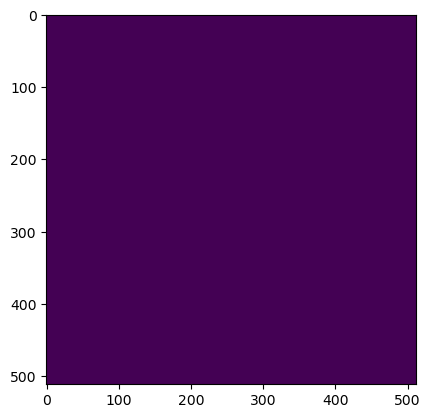

Wrote output/patches/mask/UC_S1_200-449744-0000-6317588-8000.tiff (512 x 512 pixels)


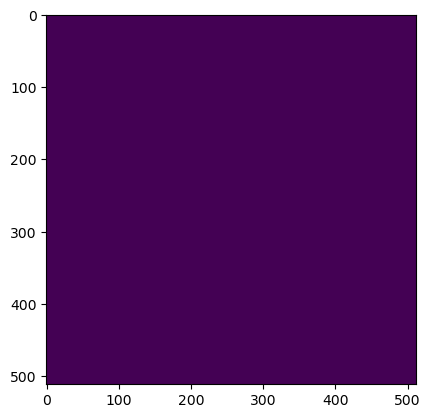

Wrote output/patches/mask/UC_S1_200-449744-0000-6317691-2000.tiff (512 x 512 pixels)


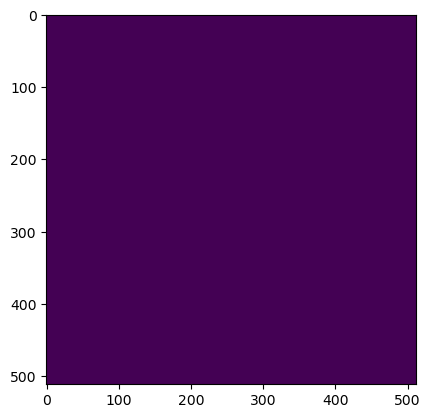

Wrote output/patches/mask/UC_S1_200-449744-0000-6317793-6000.tiff (512 x 512 pixels)


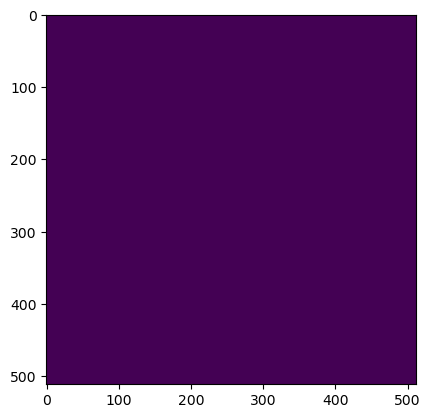

Wrote output/patches/mask/UC_S1_200-449744-0000-6317896-0000.tiff (512 x 512 pixels)


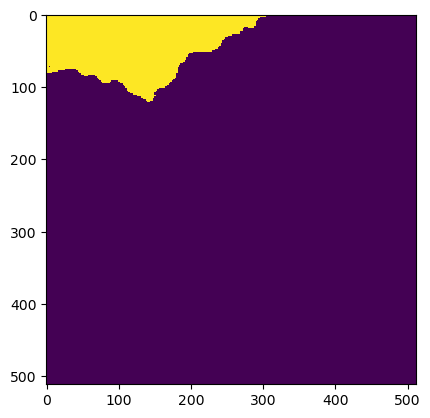

Wrote output/patches/mask/UC_S1_200-449744-0000-6317998-4000.tiff (512 x 512 pixels)


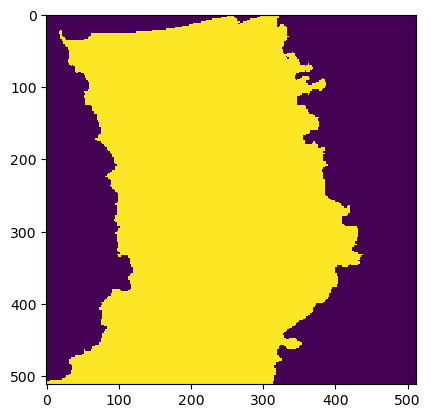

Wrote output/patches/mask/UC_S1_200-449744-0000-6318100-8000.tiff (512 x 512 pixels)


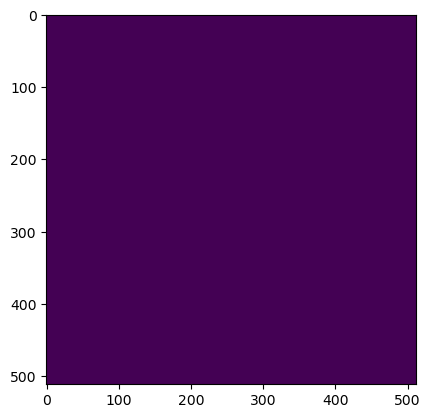

Wrote output/patches/mask/UC_S1_200-449846-4000-6317486-4000.tiff (512 x 512 pixels)


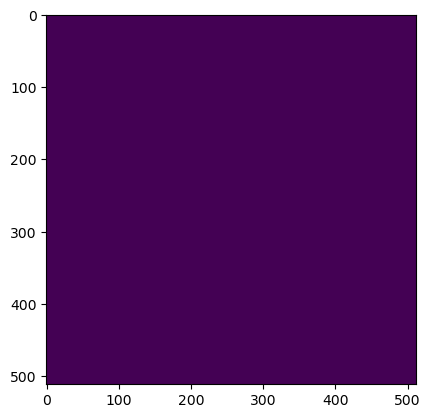

Wrote output/patches/mask/UC_S1_200-449846-4000-6317588-8000.tiff (512 x 512 pixels)


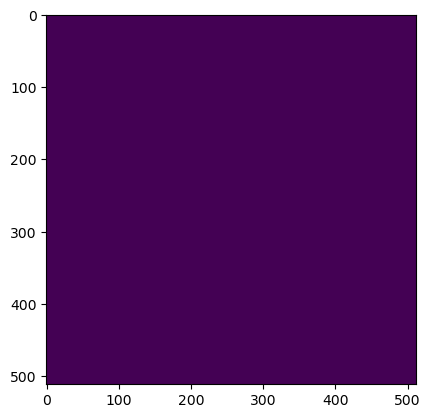

Wrote output/patches/mask/UC_S1_200-449846-4000-6317691-2000.tiff (512 x 512 pixels)


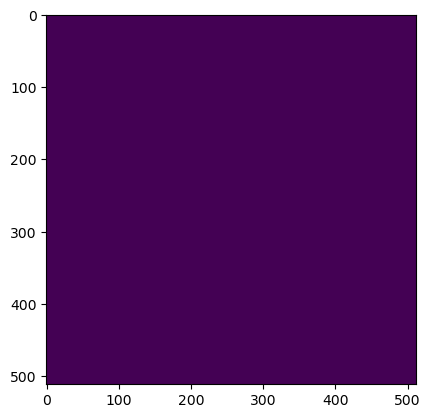

Wrote output/patches/mask/UC_S1_200-449846-4000-6317793-6000.tiff (512 x 512 pixels)


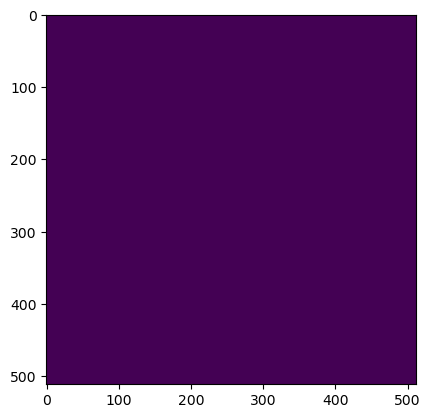

Wrote output/patches/mask/UC_S1_200-449846-4000-6317896-0000.tiff (512 x 512 pixels)


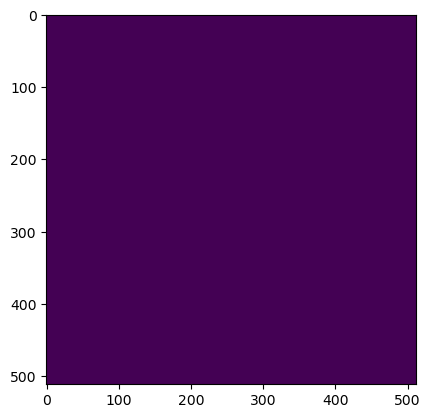

Wrote output/patches/mask/UC_S1_200-449846-4000-6317998-4000.tiff (512 x 512 pixels)


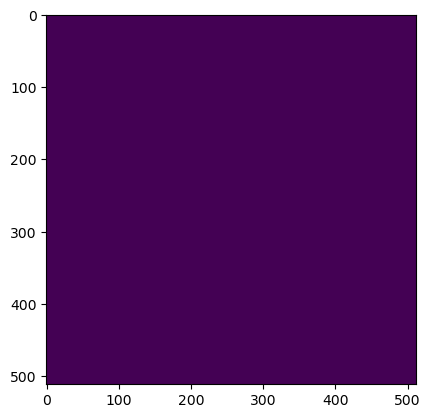

Wrote output/patches/mask/UC_S1_200-449846-4000-6318100-8000.tiff (512 x 512 pixels)
Zone UC_S1_201 Building Mask...


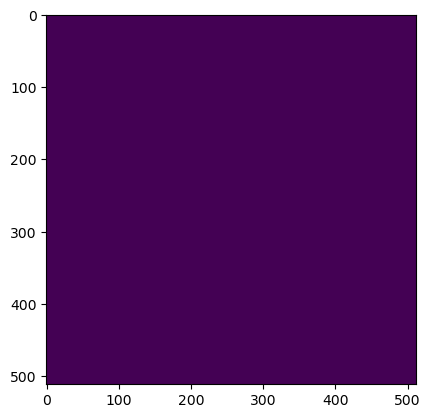

Wrote output/patches/mask/UC_S1_201-511184-0000-6317742-4000.tiff (512 x 512 pixels)


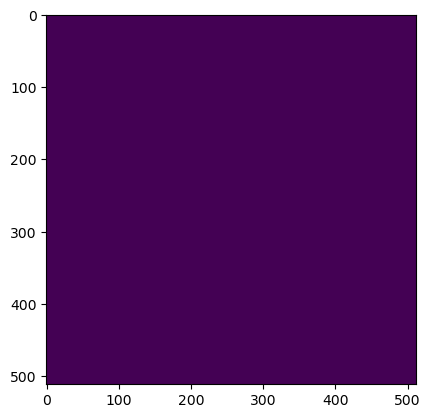

Wrote output/patches/mask/UC_S1_201-511184-0000-6317844-8000.tiff (512 x 512 pixels)


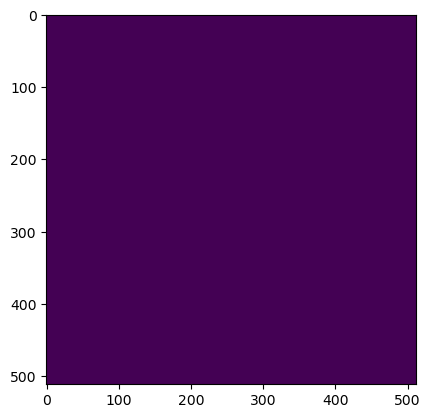

Wrote output/patches/mask/UC_S1_201-511184-0000-6317947-2000.tiff (512 x 512 pixels)


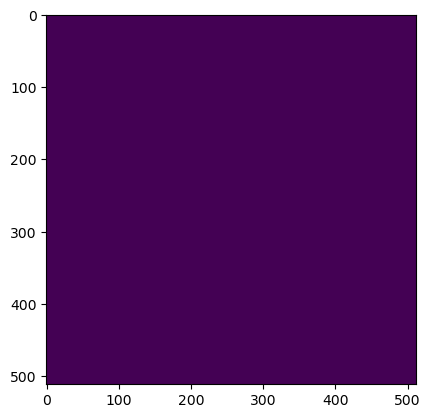

Wrote output/patches/mask/UC_S1_201-511184-0000-6318049-6000.tiff (512 x 512 pixels)


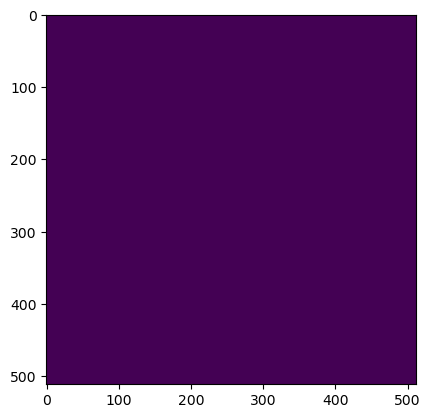

Wrote output/patches/mask/UC_S1_201-511286-4000-6317742-4000.tiff (512 x 512 pixels)


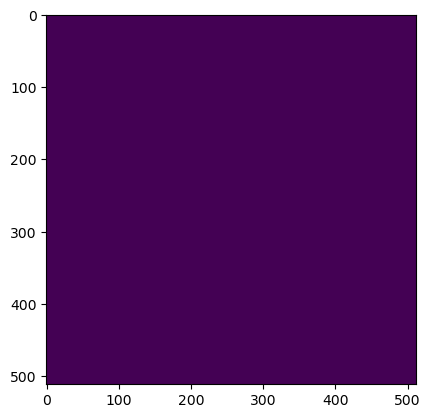

Wrote output/patches/mask/UC_S1_201-511286-4000-6317844-8000.tiff (512 x 512 pixels)


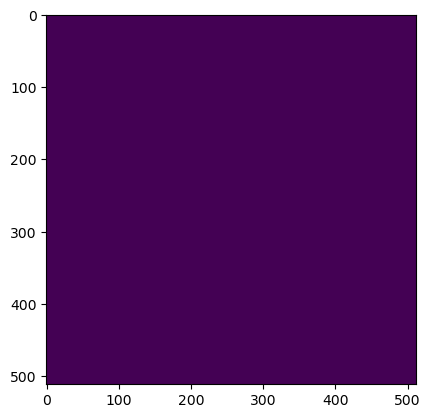

Wrote output/patches/mask/UC_S1_201-511286-4000-6317947-2000.tiff (512 x 512 pixels)


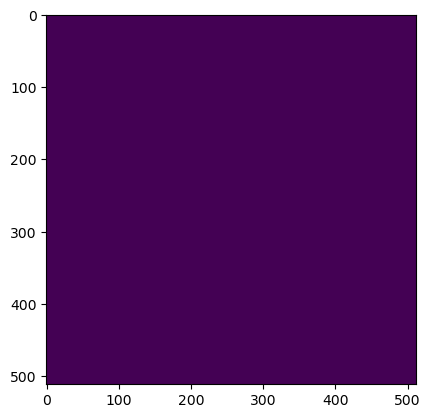

Wrote output/patches/mask/UC_S1_201-511286-4000-6318049-6000.tiff (512 x 512 pixels)
Zone VC_S1_202 Building Mask...


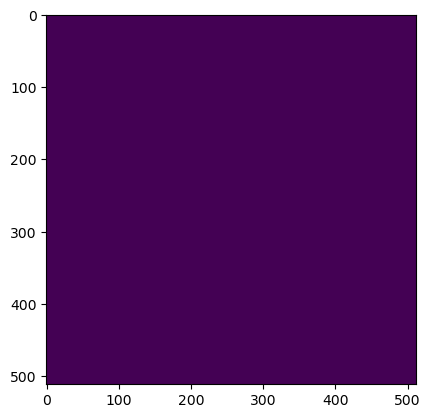

Wrote output/patches/mask/VC_S1_202-467408-0000-6317998-4000.tiff (512 x 512 pixels)


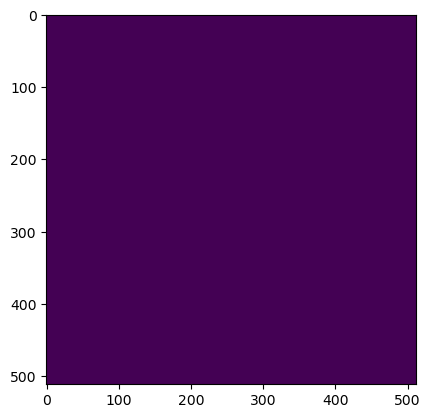

Wrote output/patches/mask/VC_S1_202-467408-0000-6318100-8000.tiff (512 x 512 pixels)


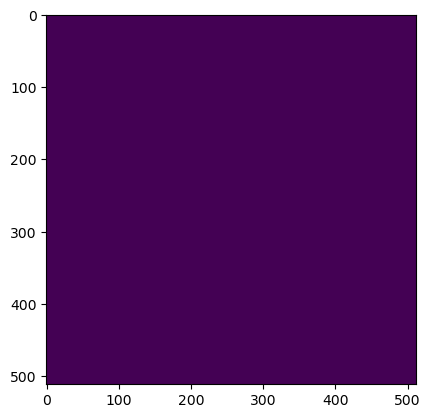

Wrote output/patches/mask/VC_S1_202-467510-4000-6317998-4000.tiff (512 x 512 pixels)


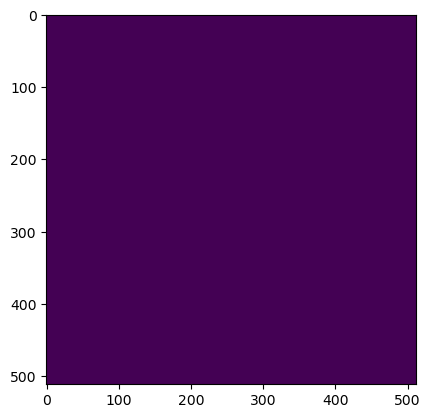

Wrote output/patches/mask/VC_S1_202-467510-4000-6318100-8000.tiff (512 x 512 pixels)


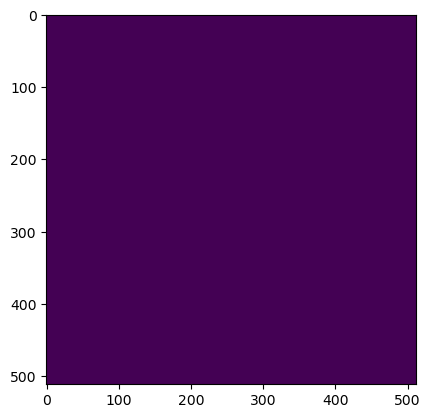

Wrote output/patches/mask/VC_S1_202-467612-8000-6317998-4000.tiff (512 x 512 pixels)


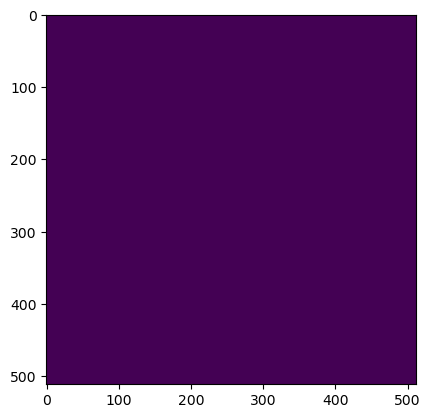

Wrote output/patches/mask/VC_S1_202-467612-8000-6318100-8000.tiff (512 x 512 pixels)


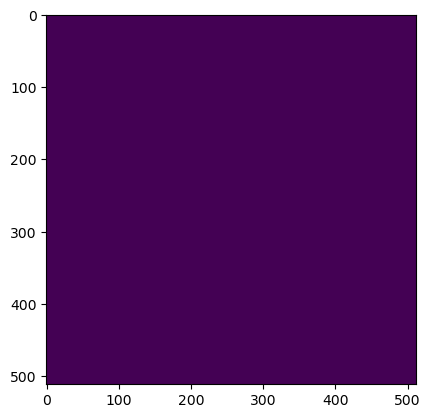

Wrote output/patches/mask/VC_S1_202-467715-2000-6317998-4000.tiff (512 x 512 pixels)


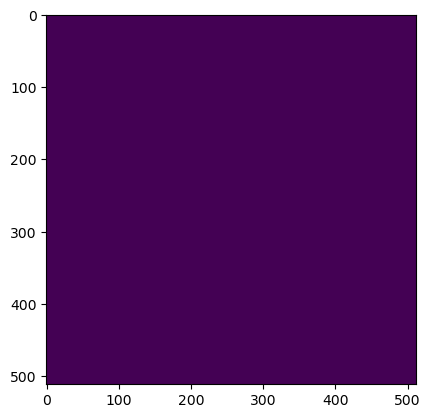

Wrote output/patches/mask/VC_S1_202-467715-2000-6318100-8000.tiff (512 x 512 pixels)


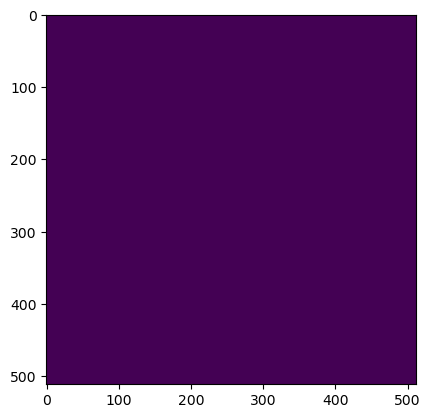

Wrote output/patches/mask/VC_S1_202-467817-6000-6317998-4000.tiff (512 x 512 pixels)


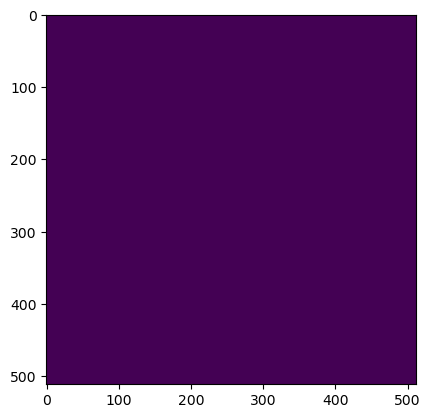

Wrote output/patches/mask/VC_S1_202-467817-6000-6318100-8000.tiff (512 x 512 pixels)


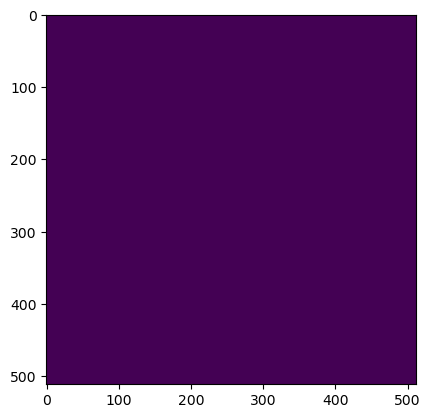

Wrote output/patches/mask/VC_S1_202-467920-0000-6317998-4000.tiff (512 x 512 pixels)


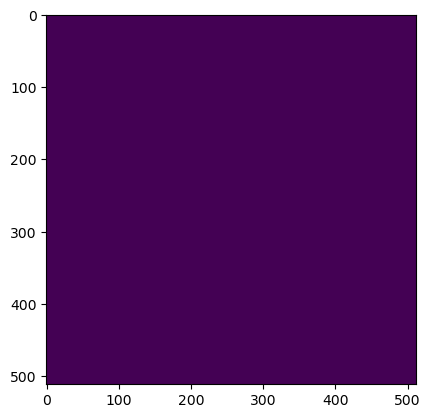

Wrote output/patches/mask/VC_S1_202-467920-0000-6318100-8000.tiff (512 x 512 pixels)


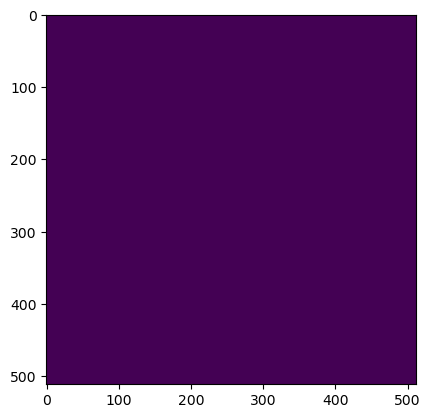

Wrote output/patches/mask/VC_S1_202-468022-4000-6317998-4000.tiff (512 x 512 pixels)


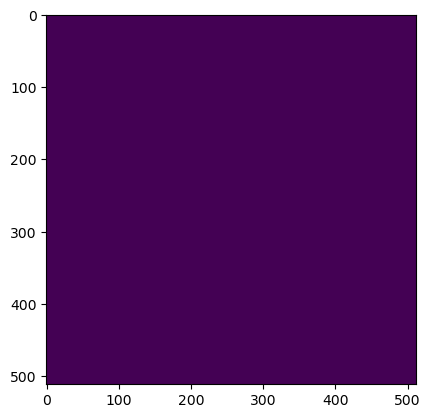

Wrote output/patches/mask/VC_S1_202-468022-4000-6318100-8000.tiff (512 x 512 pixels)


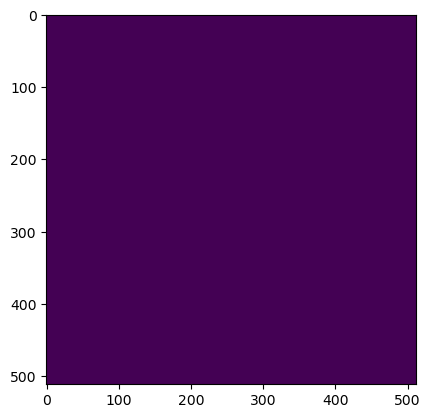

Wrote output/patches/mask/VC_S1_202-468124-8000-6317998-4000.tiff (512 x 512 pixels)


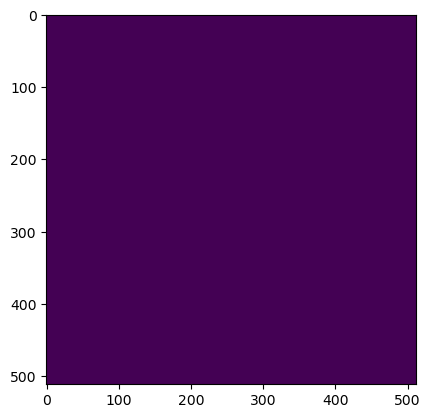

Wrote output/patches/mask/VC_S1_202-468124-8000-6318100-8000.tiff (512 x 512 pixels)


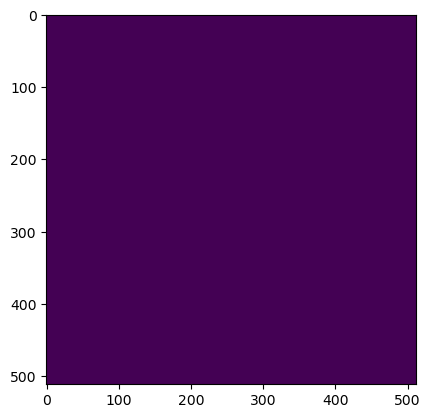

Wrote output/patches/mask/VC_S1_202-468227-2000-6317998-4000.tiff (512 x 512 pixels)


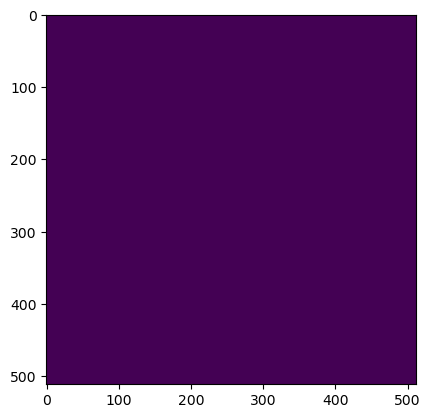

Wrote output/patches/mask/VC_S1_202-468227-2000-6318100-8000.tiff (512 x 512 pixels)


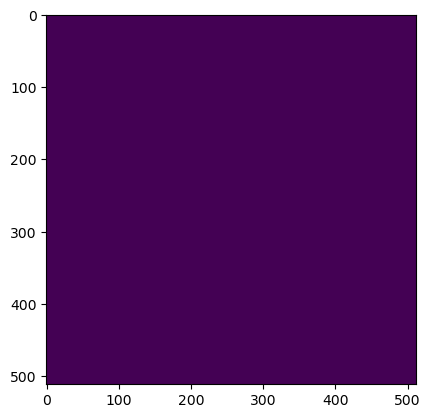

Wrote output/patches/mask/VC_S1_202-468329-6000-6317998-4000.tiff (512 x 512 pixels)


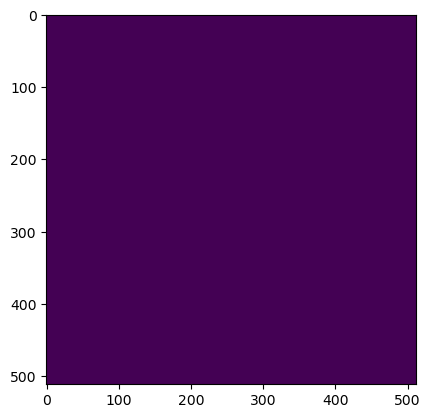

Wrote output/patches/mask/VC_S1_202-468329-6000-6318100-8000.tiff (512 x 512 pixels)


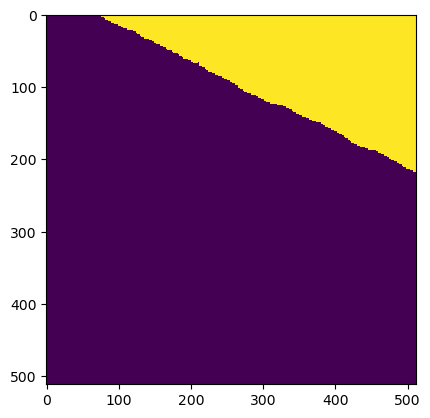

Wrote output/patches/mask/VC_S1_202-468432-0000-6317998-4000.tiff (512 x 512 pixels)


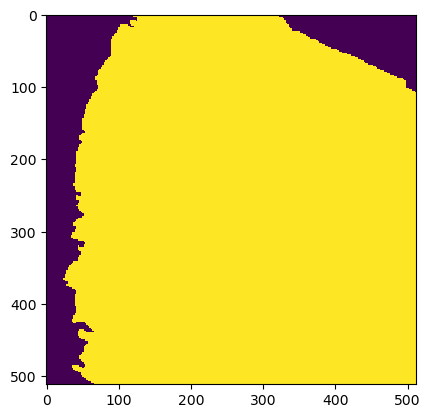

Wrote output/patches/mask/VC_S1_202-468432-0000-6318100-8000.tiff (512 x 512 pixels)


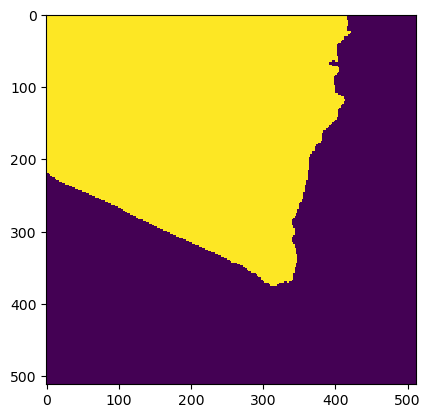

Wrote output/patches/mask/VC_S1_202-468534-4000-6317998-4000.tiff (512 x 512 pixels)


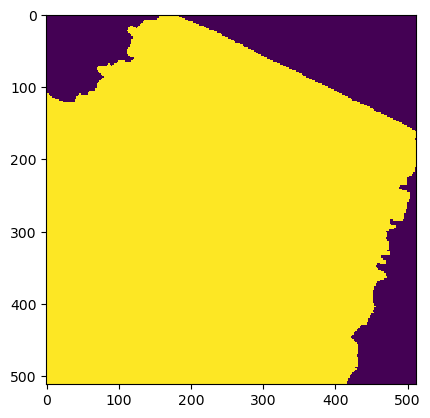

Wrote output/patches/mask/VC_S1_202-468534-4000-6318100-8000.tiff (512 x 512 pixels)
Zone UU_S1_203 Building Mask...


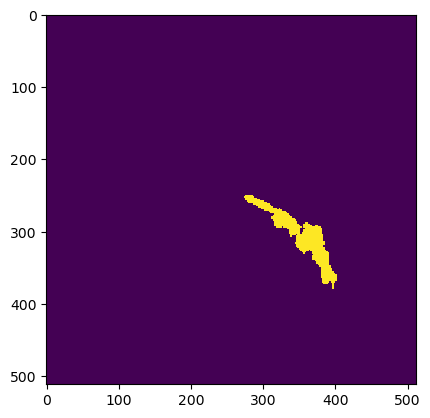

Wrote output/patches/mask/UU_S1_203-487632-0000-6317998-4000.tiff (512 x 512 pixels)


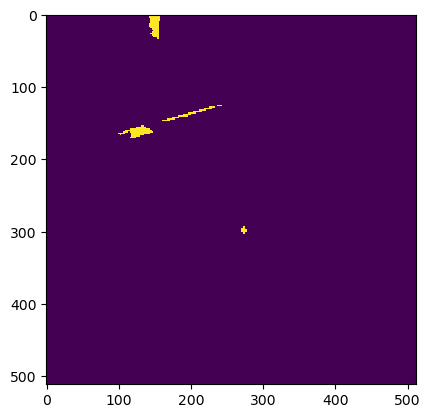

Wrote output/patches/mask/UU_S1_203-487632-0000-6318100-8000.tiff (512 x 512 pixels)


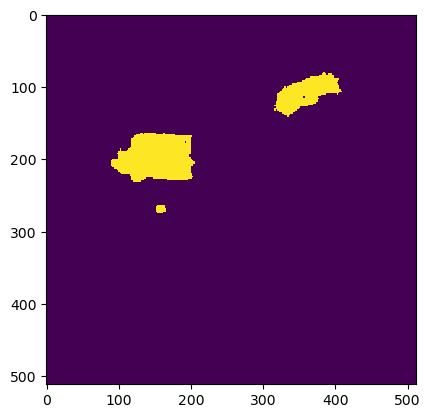

Wrote output/patches/mask/UU_S1_203-487734-4000-6317998-4000.tiff (512 x 512 pixels)


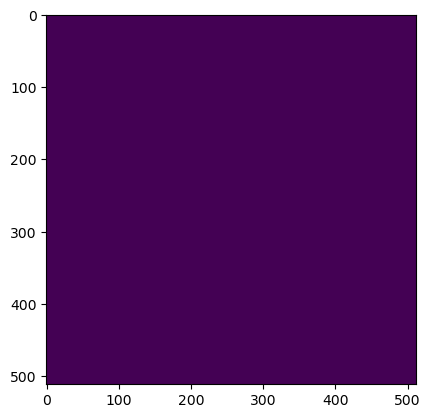

Wrote output/patches/mask/UU_S1_203-487734-4000-6318100-8000.tiff (512 x 512 pixels)


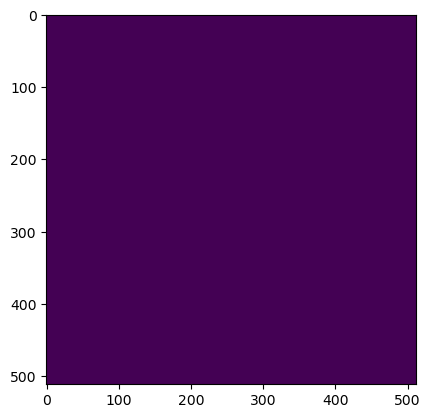

Wrote output/patches/mask/UU_S1_203-487836-8000-6317998-4000.tiff (512 x 512 pixels)


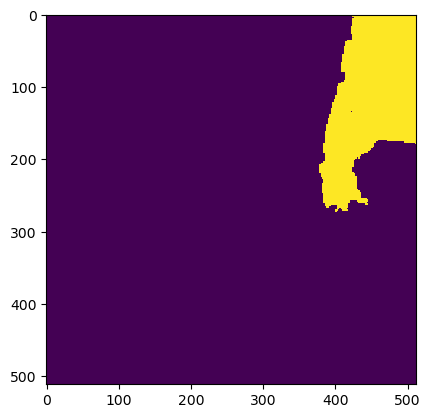

Wrote output/patches/mask/UU_S1_203-487836-8000-6318100-8000.tiff (512 x 512 pixels)


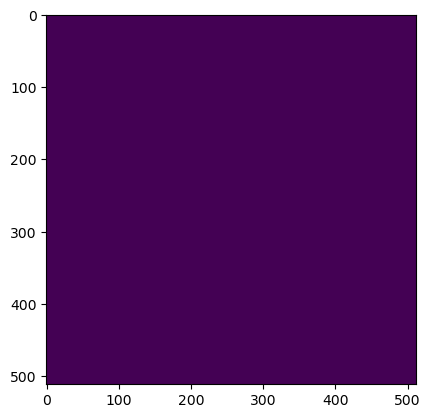

Wrote output/patches/mask/UU_S1_203-487939-2000-6317998-4000.tiff (512 x 512 pixels)


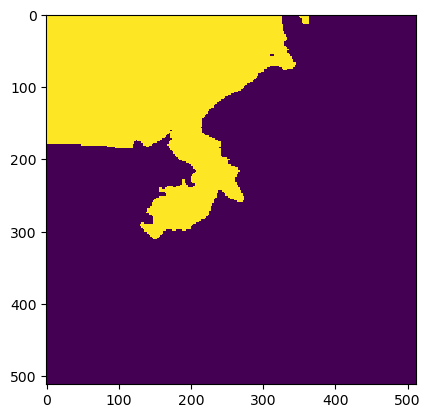

Wrote output/patches/mask/UU_S1_203-487939-2000-6318100-8000.tiff (512 x 512 pixels)
Zone UN_S1_204 Building Mask...


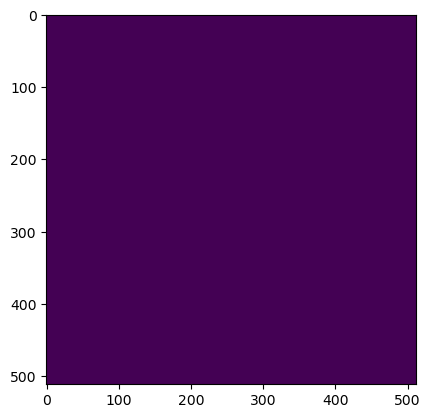

Wrote output/patches/mask/UN_S1_204-469456-0000-6318254-4000.tiff (512 x 512 pixels)


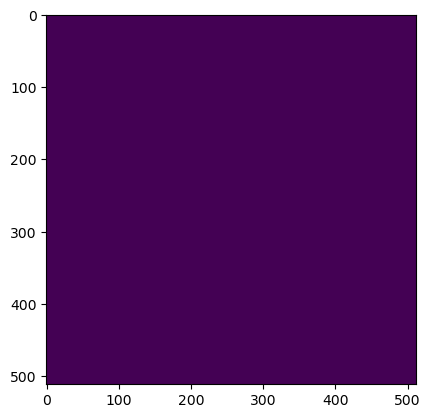

Wrote output/patches/mask/UN_S1_204-469456-0000-6318356-8000.tiff (512 x 512 pixels)


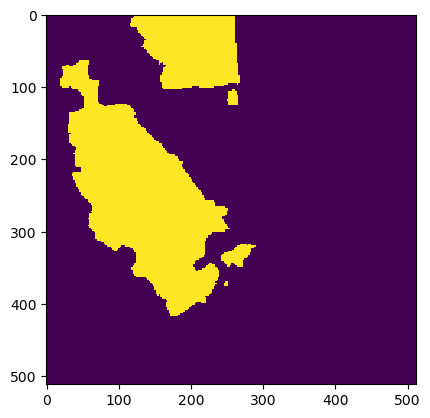

Wrote output/patches/mask/UN_S1_204-469558-4000-6318254-4000.tiff (512 x 512 pixels)


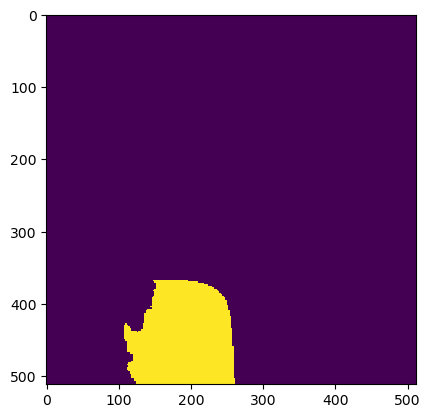

Wrote output/patches/mask/UN_S1_204-469558-4000-6318356-8000.tiff (512 x 512 pixels)
Zone VC_S1_205 Building Mask...


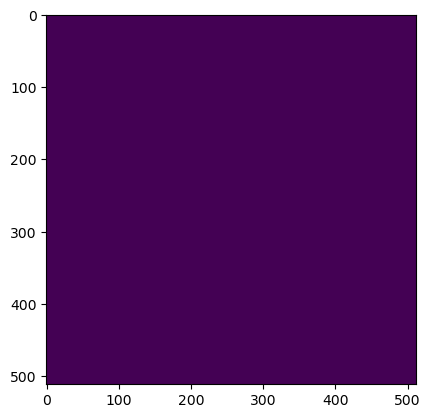

Wrote output/patches/mask/VC_S1_205-450256-0000-6318510-4000.tiff (512 x 512 pixels)


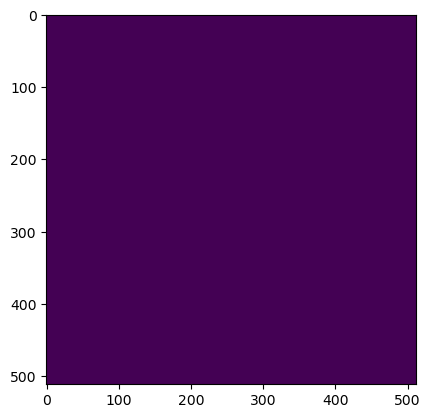

Wrote output/patches/mask/VC_S1_205-450256-0000-6318612-8000.tiff (512 x 512 pixels)


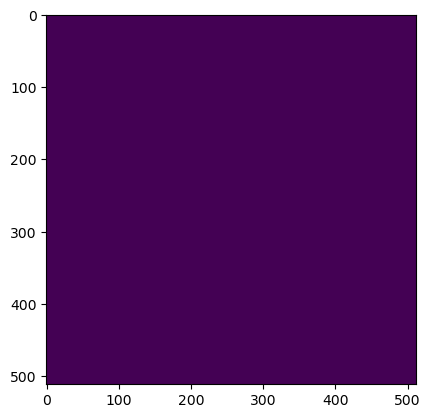

Wrote output/patches/mask/VC_S1_205-450256-0000-6318715-2000.tiff (512 x 512 pixels)


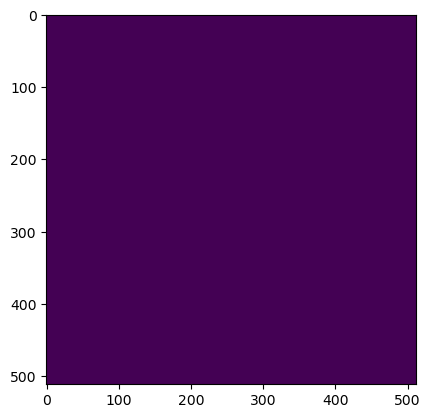

Wrote output/patches/mask/VC_S1_205-450256-0000-6318817-6000.tiff (512 x 512 pixels)


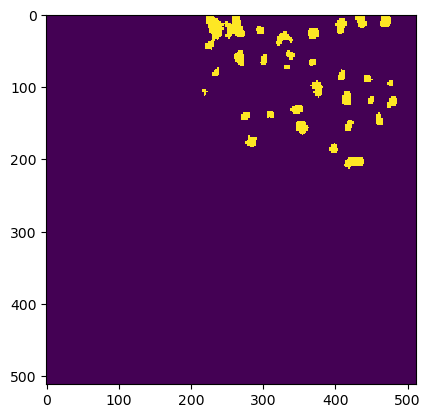

Wrote output/patches/mask/VC_S1_205-450256-0000-6318920-0000.tiff (512 x 512 pixels)


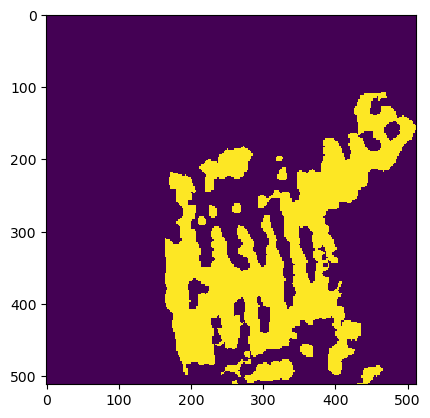

Wrote output/patches/mask/VC_S1_205-450256-0000-6319022-4000.tiff (512 x 512 pixels)


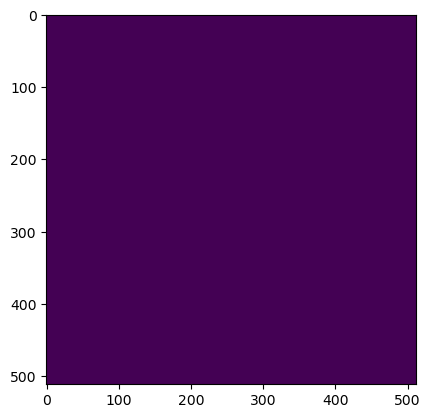

Wrote output/patches/mask/VC_S1_205-450256-0000-6319124-8000.tiff (512 x 512 pixels)


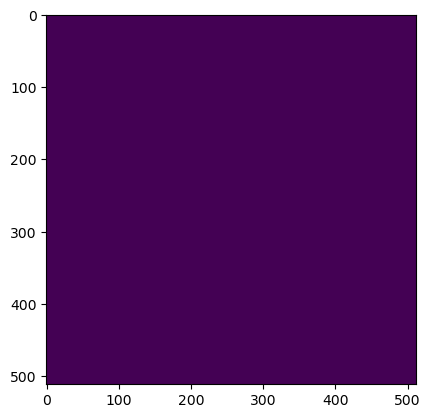

Wrote output/patches/mask/VC_S1_205-450256-0000-6319227-2000.tiff (512 x 512 pixels)


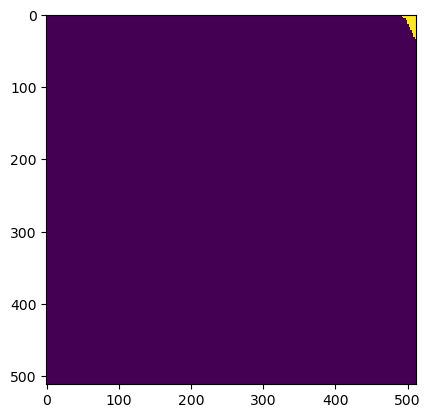

Wrote output/patches/mask/VC_S1_205-450256-0000-6319329-6000.tiff (512 x 512 pixels)


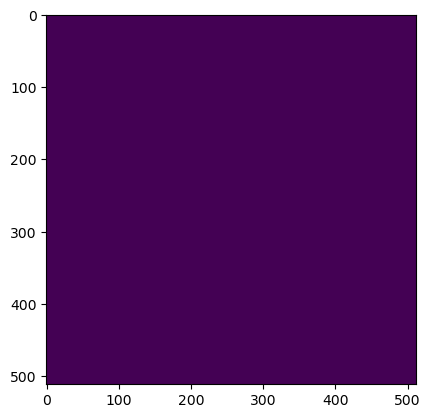

Wrote output/patches/mask/VC_S1_205-450358-4000-6318510-4000.tiff (512 x 512 pixels)


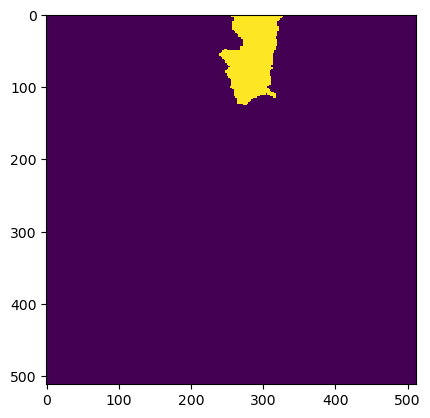

Wrote output/patches/mask/VC_S1_205-450358-4000-6318612-8000.tiff (512 x 512 pixels)


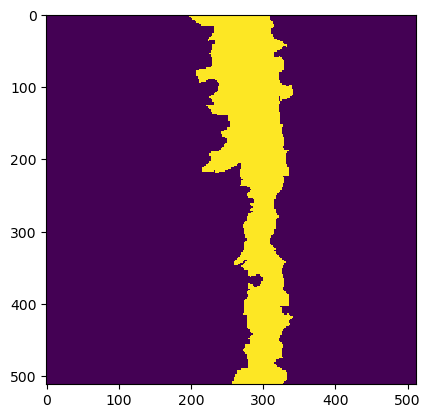

Wrote output/patches/mask/VC_S1_205-450358-4000-6318715-2000.tiff (512 x 512 pixels)


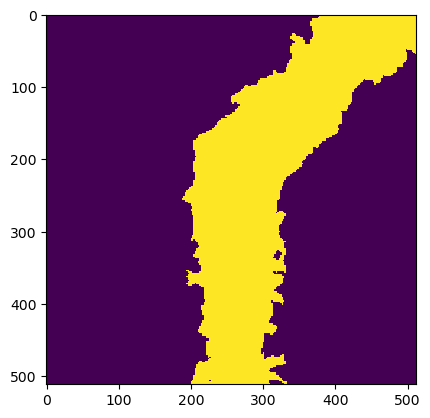

Wrote output/patches/mask/VC_S1_205-450358-4000-6318817-6000.tiff (512 x 512 pixels)


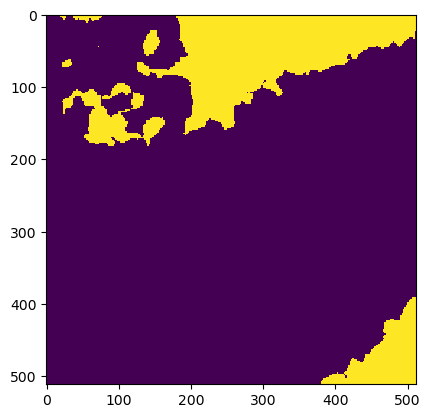

Wrote output/patches/mask/VC_S1_205-450358-4000-6318920-0000.tiff (512 x 512 pixels)


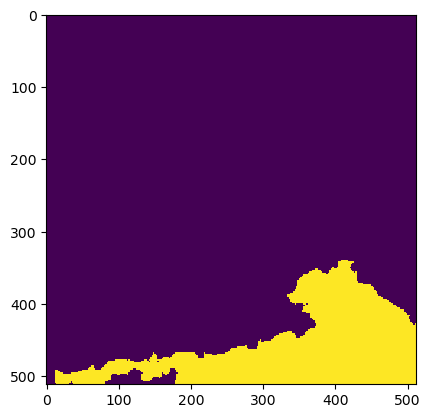

Wrote output/patches/mask/VC_S1_205-450358-4000-6319022-4000.tiff (512 x 512 pixels)


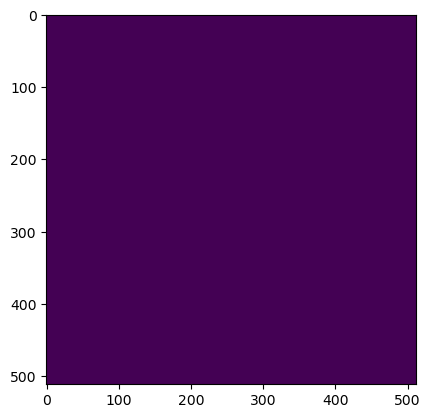

Wrote output/patches/mask/VC_S1_205-450358-4000-6319124-8000.tiff (512 x 512 pixels)


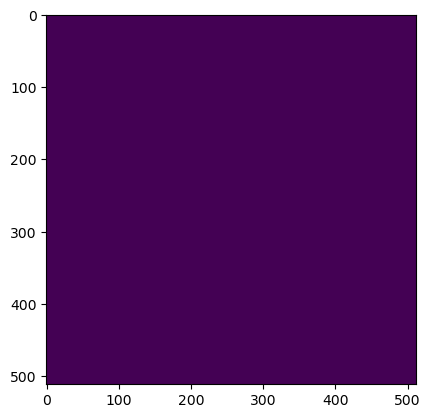

Wrote output/patches/mask/VC_S1_205-450358-4000-6319227-2000.tiff (512 x 512 pixels)


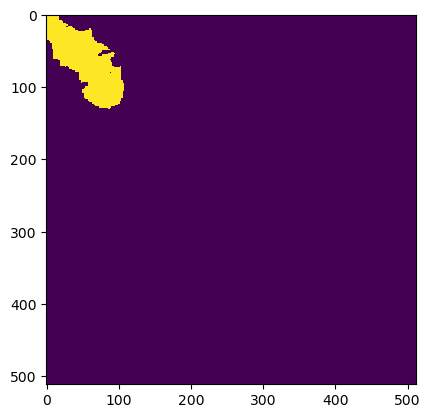

Wrote output/patches/mask/VC_S1_205-450358-4000-6319329-6000.tiff (512 x 512 pixels)


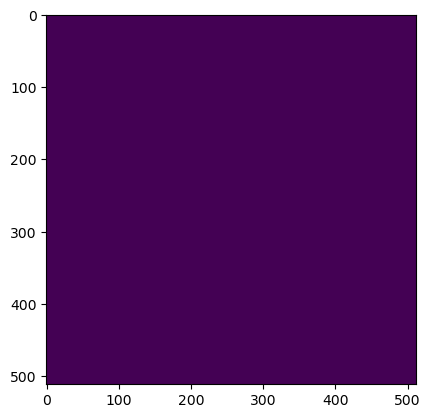

Wrote output/patches/mask/VC_S1_205-450460-8000-6318510-4000.tiff (512 x 512 pixels)


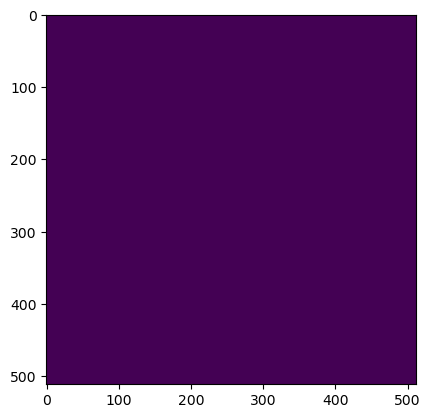

Wrote output/patches/mask/VC_S1_205-450460-8000-6318612-8000.tiff (512 x 512 pixels)


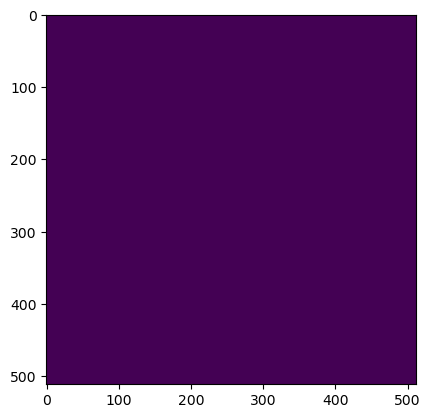

Wrote output/patches/mask/VC_S1_205-450460-8000-6318715-2000.tiff (512 x 512 pixels)


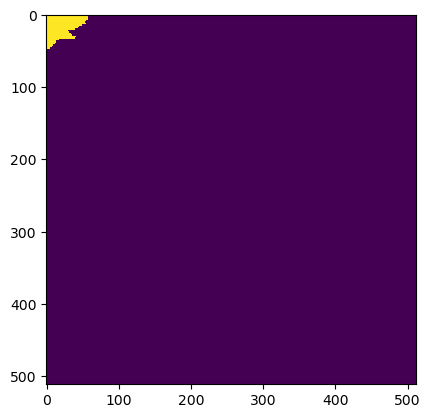

Wrote output/patches/mask/VC_S1_205-450460-8000-6318817-6000.tiff (512 x 512 pixels)


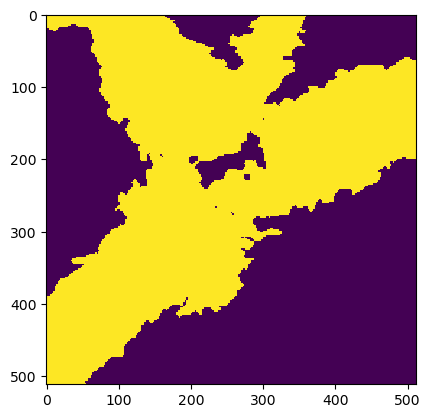

Wrote output/patches/mask/VC_S1_205-450460-8000-6318920-0000.tiff (512 x 512 pixels)


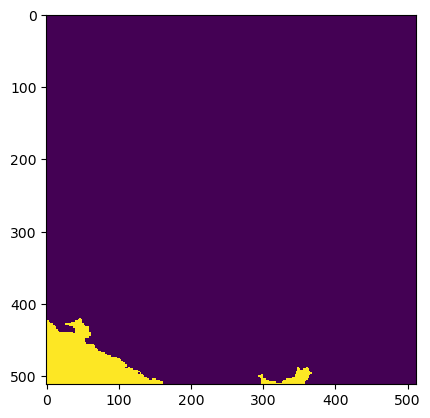

Wrote output/patches/mask/VC_S1_205-450460-8000-6319022-4000.tiff (512 x 512 pixels)


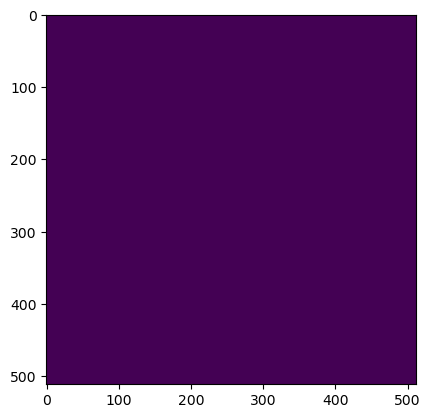

Wrote output/patches/mask/VC_S1_205-450460-8000-6319124-8000.tiff (512 x 512 pixels)


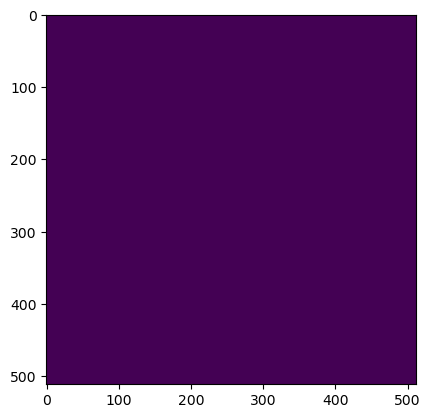

Wrote output/patches/mask/VC_S1_205-450460-8000-6319227-2000.tiff (512 x 512 pixels)


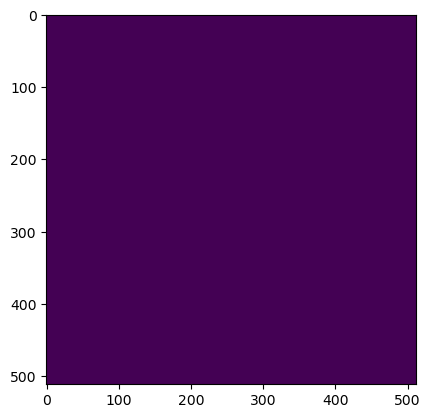

Wrote output/patches/mask/VC_S1_205-450460-8000-6319329-6000.tiff (512 x 512 pixels)


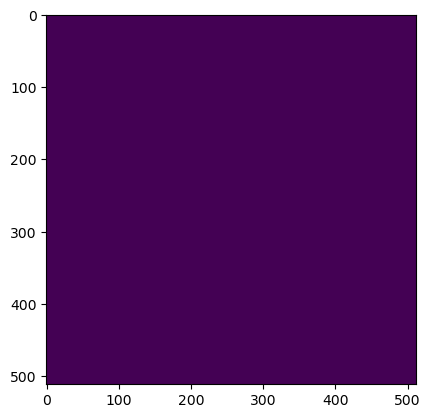

Wrote output/patches/mask/VC_S1_205-450563-2000-6318510-4000.tiff (512 x 512 pixels)


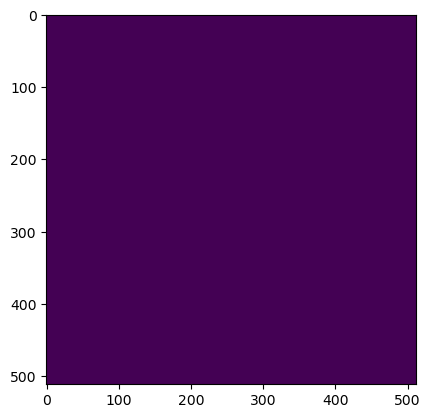

Wrote output/patches/mask/VC_S1_205-450563-2000-6318612-8000.tiff (512 x 512 pixels)


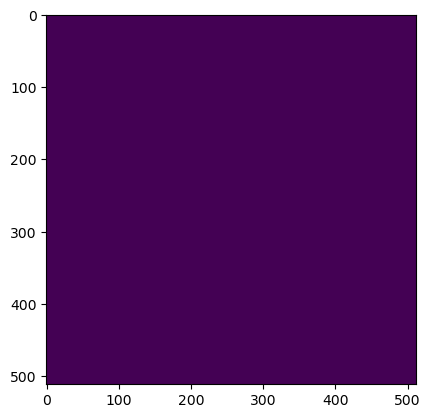

Wrote output/patches/mask/VC_S1_205-450563-2000-6318715-2000.tiff (512 x 512 pixels)


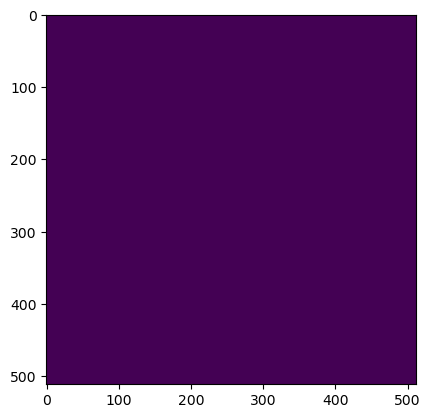

Wrote output/patches/mask/VC_S1_205-450563-2000-6318817-6000.tiff (512 x 512 pixels)


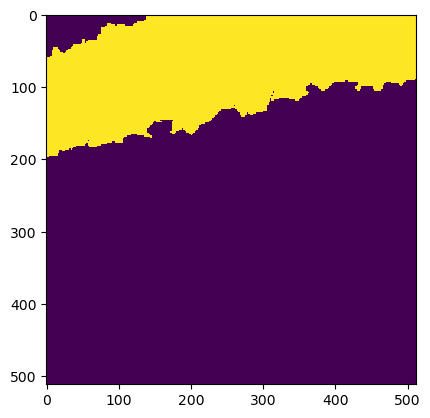

Wrote output/patches/mask/VC_S1_205-450563-2000-6318920-0000.tiff (512 x 512 pixels)


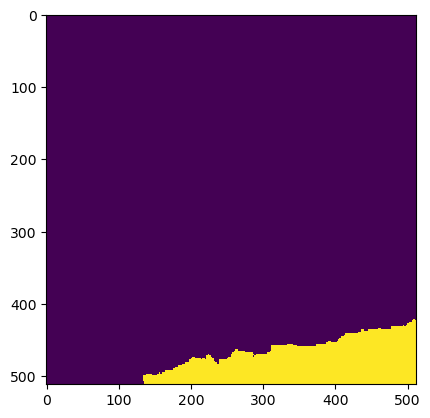

Wrote output/patches/mask/VC_S1_205-450563-2000-6319022-4000.tiff (512 x 512 pixels)


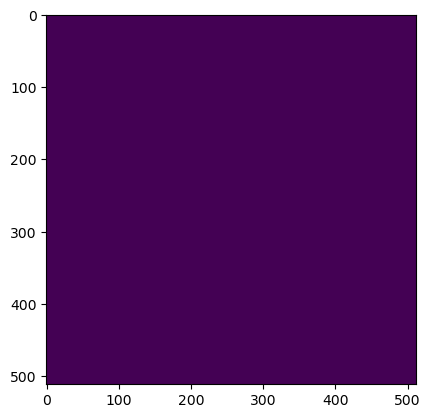

Wrote output/patches/mask/VC_S1_205-450563-2000-6319124-8000.tiff (512 x 512 pixels)


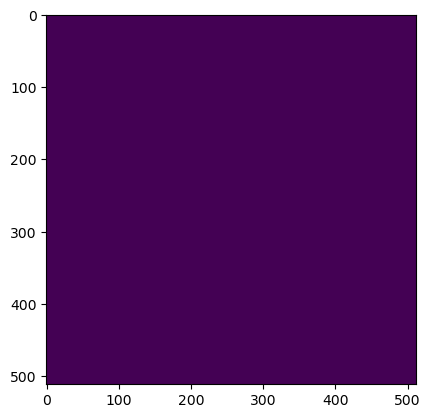

Wrote output/patches/mask/VC_S1_205-450563-2000-6319227-2000.tiff (512 x 512 pixels)


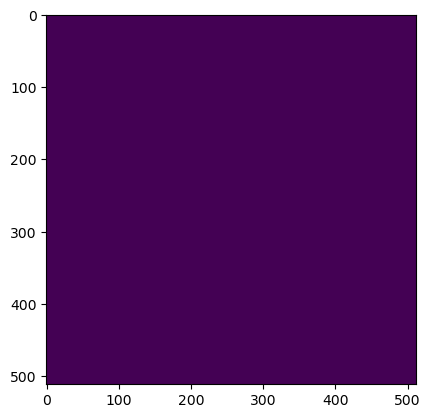

Wrote output/patches/mask/VC_S1_205-450563-2000-6319329-6000.tiff (512 x 512 pixels)


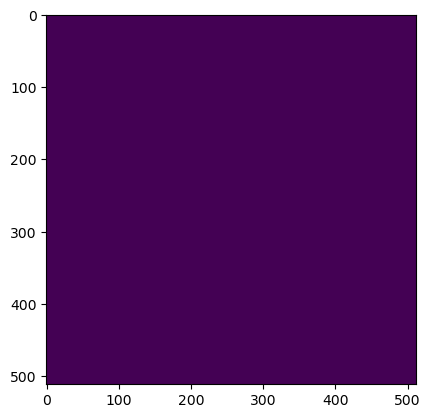

Wrote output/patches/mask/VC_S1_205-450665-6000-6318510-4000.tiff (512 x 512 pixels)


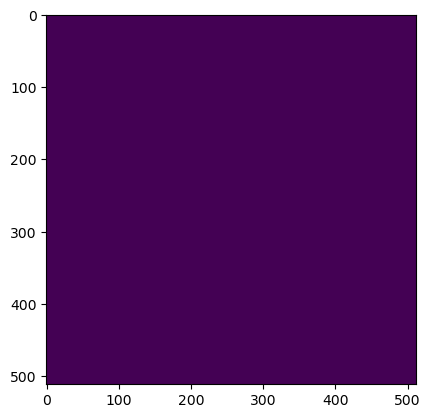

Wrote output/patches/mask/VC_S1_205-450665-6000-6318612-8000.tiff (512 x 512 pixels)


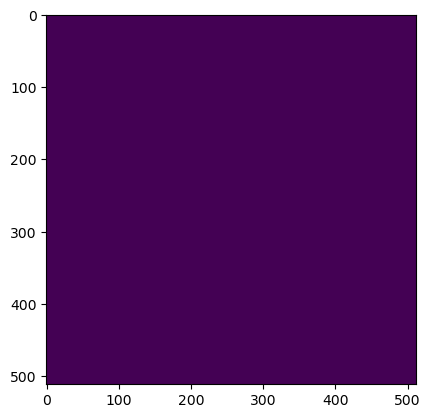

Wrote output/patches/mask/VC_S1_205-450665-6000-6318715-2000.tiff (512 x 512 pixels)


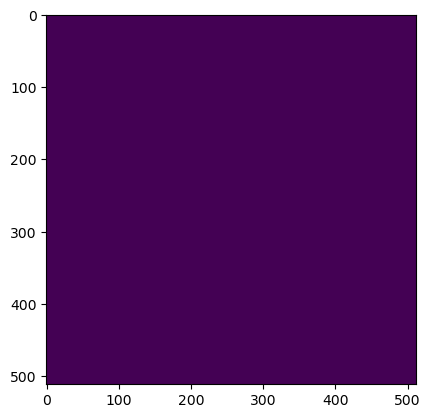

Wrote output/patches/mask/VC_S1_205-450665-6000-6318817-6000.tiff (512 x 512 pixels)


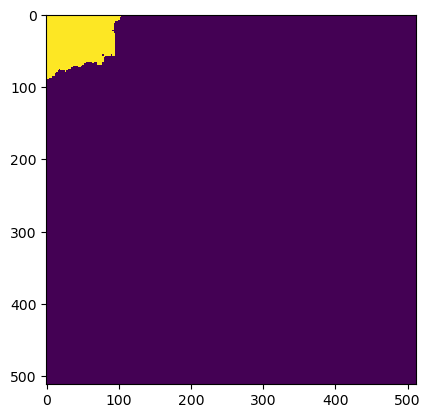

Wrote output/patches/mask/VC_S1_205-450665-6000-6318920-0000.tiff (512 x 512 pixels)


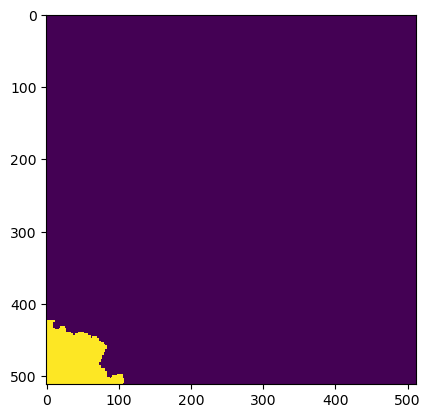

Wrote output/patches/mask/VC_S1_205-450665-6000-6319022-4000.tiff (512 x 512 pixels)


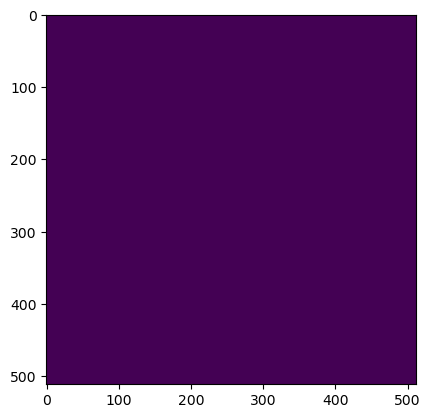

Wrote output/patches/mask/VC_S1_205-450665-6000-6319124-8000.tiff (512 x 512 pixels)


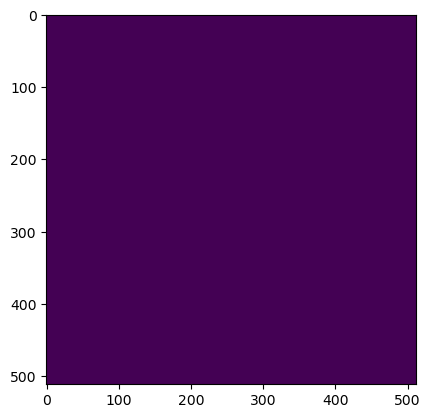

Wrote output/patches/mask/VC_S1_205-450665-6000-6319227-2000.tiff (512 x 512 pixels)


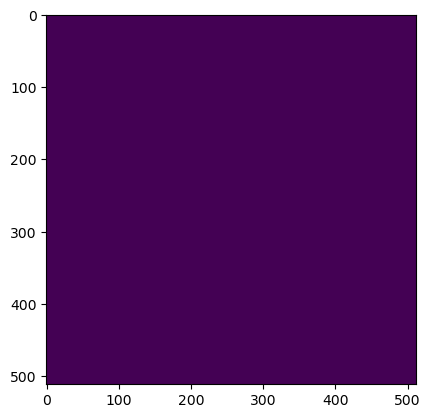

Wrote output/patches/mask/VC_S1_205-450665-6000-6319329-6000.tiff (512 x 512 pixels)


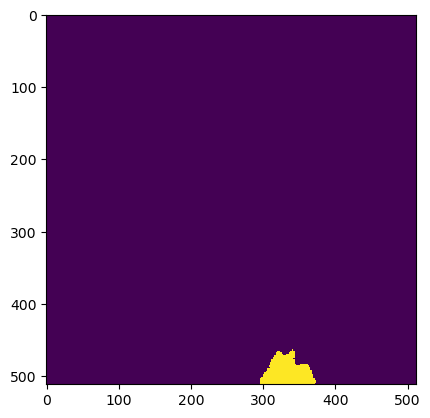

Wrote output/patches/mask/VC_S1_205-450768-0000-6318510-4000.tiff (512 x 512 pixels)


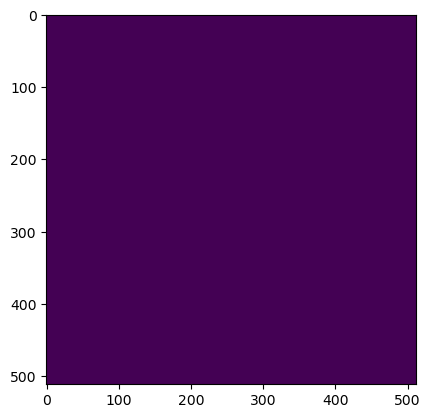

Wrote output/patches/mask/VC_S1_205-450768-0000-6318612-8000.tiff (512 x 512 pixels)


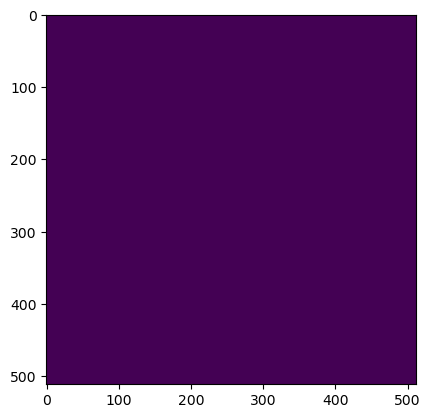

Wrote output/patches/mask/VC_S1_205-450768-0000-6318715-2000.tiff (512 x 512 pixels)


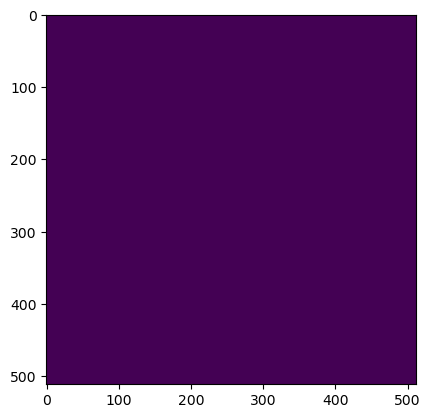

Wrote output/patches/mask/VC_S1_205-450768-0000-6318817-6000.tiff (512 x 512 pixels)


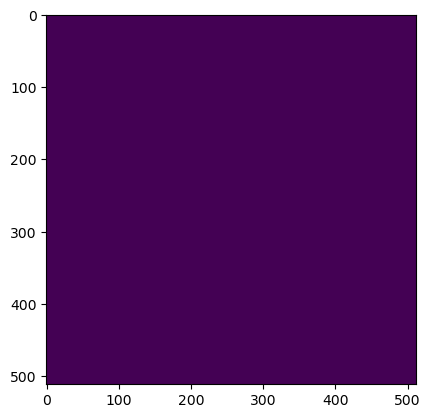

Wrote output/patches/mask/VC_S1_205-450768-0000-6318920-0000.tiff (512 x 512 pixels)


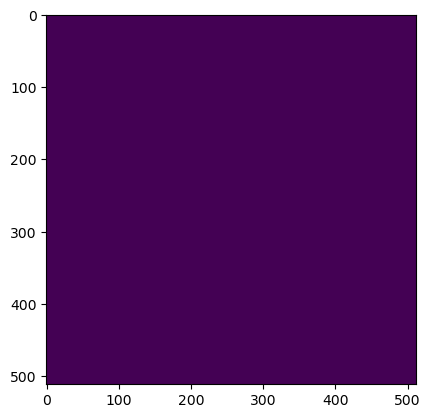

Wrote output/patches/mask/VC_S1_205-450768-0000-6319022-4000.tiff (512 x 512 pixels)


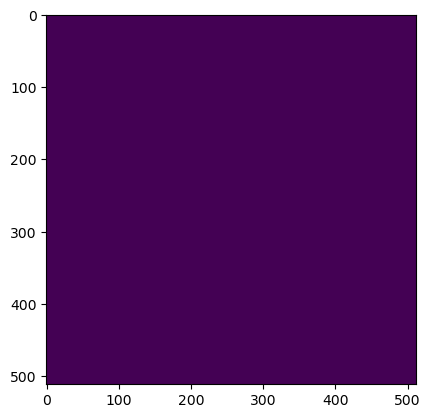

Wrote output/patches/mask/VC_S1_205-450768-0000-6319124-8000.tiff (512 x 512 pixels)


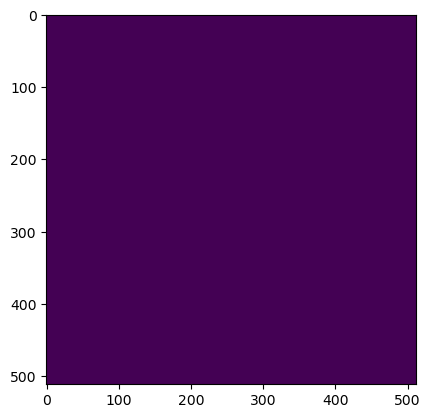

Wrote output/patches/mask/VC_S1_205-450768-0000-6319227-2000.tiff (512 x 512 pixels)


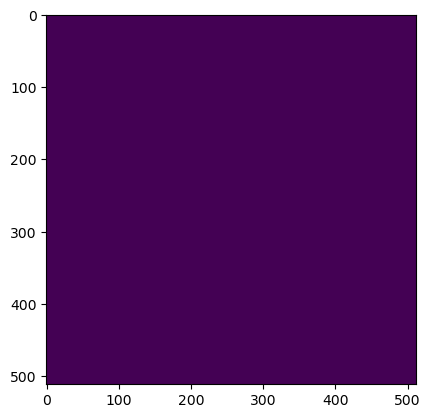

Wrote output/patches/mask/VC_S1_205-450768-0000-6319329-6000.tiff (512 x 512 pixels)


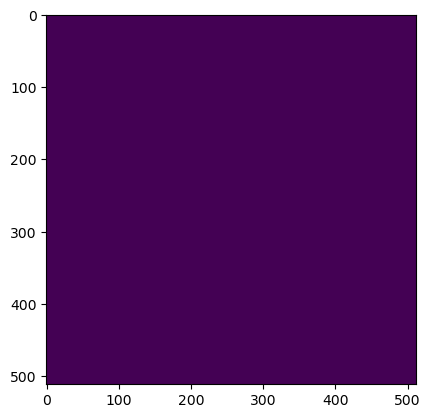

Wrote output/patches/mask/VC_S1_205-450870-4000-6318510-4000.tiff (512 x 512 pixels)


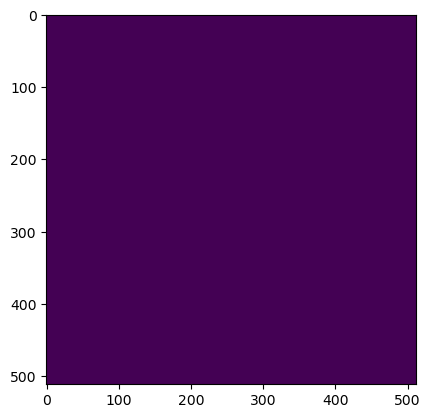

Wrote output/patches/mask/VC_S1_205-450870-4000-6318612-8000.tiff (512 x 512 pixels)


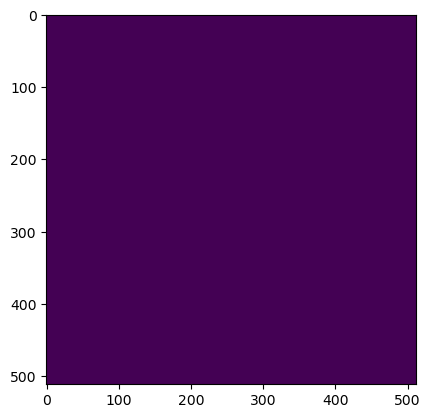

Wrote output/patches/mask/VC_S1_205-450870-4000-6318715-2000.tiff (512 x 512 pixels)


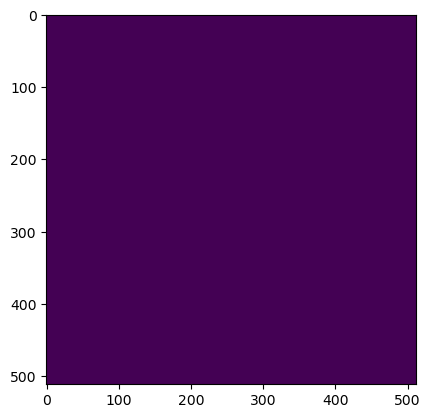

Wrote output/patches/mask/VC_S1_205-450870-4000-6318817-6000.tiff (512 x 512 pixels)


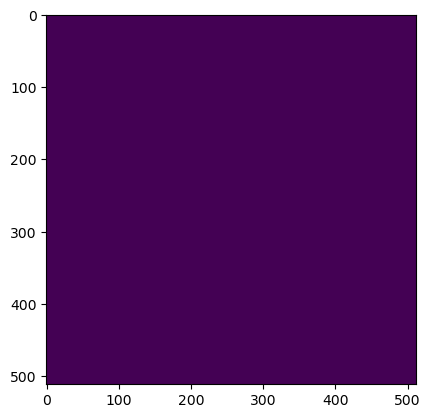

Wrote output/patches/mask/VC_S1_205-450870-4000-6318920-0000.tiff (512 x 512 pixels)


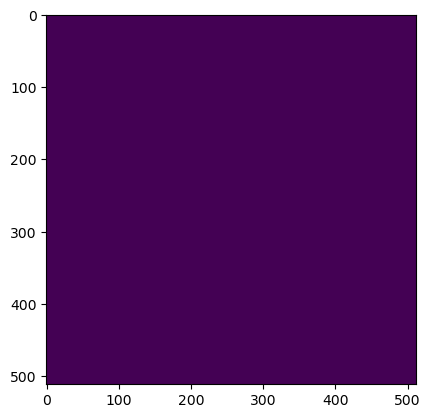

Wrote output/patches/mask/VC_S1_205-450870-4000-6319022-4000.tiff (512 x 512 pixels)


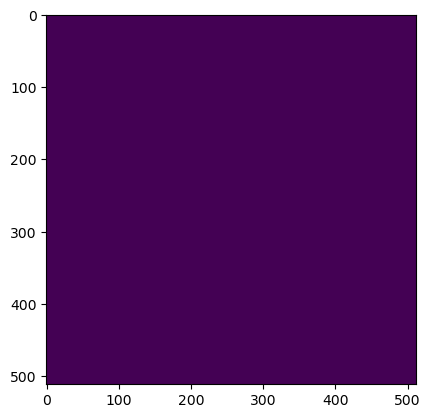

Wrote output/patches/mask/VC_S1_205-450870-4000-6319124-8000.tiff (512 x 512 pixels)


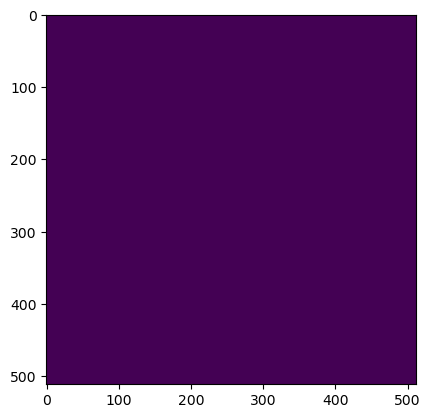

Wrote output/patches/mask/VC_S1_205-450870-4000-6319227-2000.tiff (512 x 512 pixels)


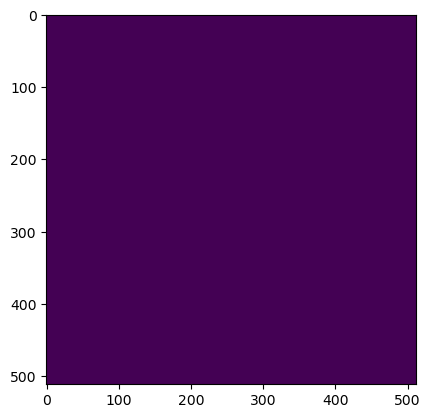

Wrote output/patches/mask/VC_S1_205-450870-4000-6319329-6000.tiff (512 x 512 pixels)
Zone UC_S1_206 Building Mask...


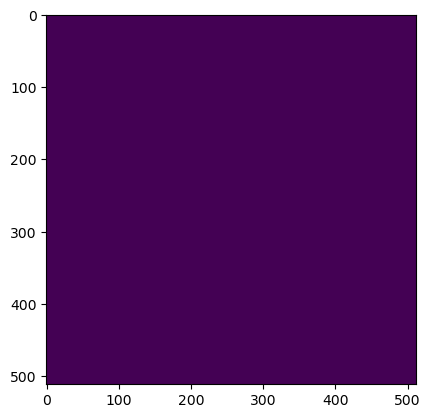

Wrote output/patches/mask/UC_S1_206-456912-0000-6318510-4000.tiff (512 x 512 pixels)


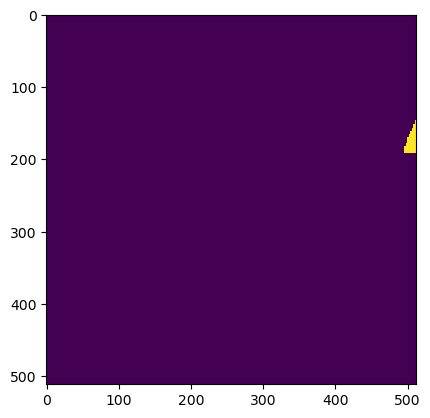

Wrote output/patches/mask/UC_S1_206-456912-0000-6318612-8000.tiff (512 x 512 pixels)


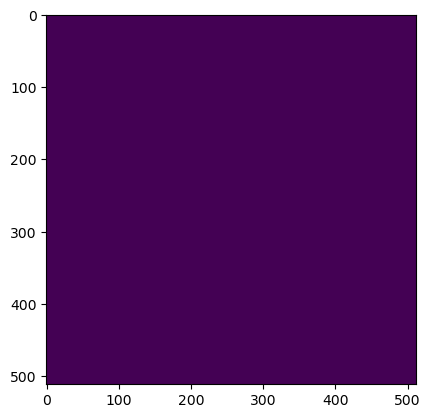

Wrote output/patches/mask/UC_S1_206-456912-0000-6318715-2000.tiff (512 x 512 pixels)


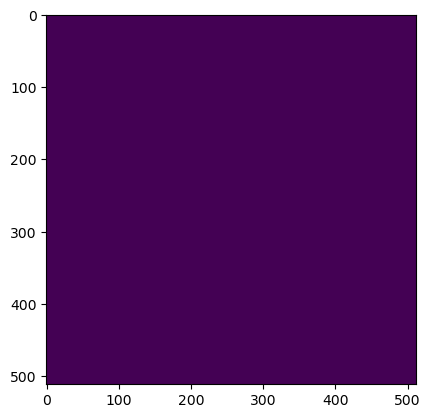

Wrote output/patches/mask/UC_S1_206-456912-0000-6318817-6000.tiff (512 x 512 pixels)


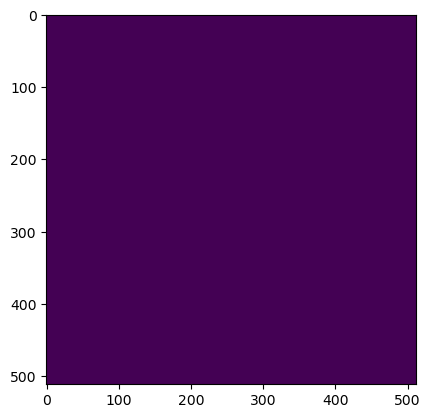

Wrote output/patches/mask/UC_S1_206-457014-4000-6318510-4000.tiff (512 x 512 pixels)


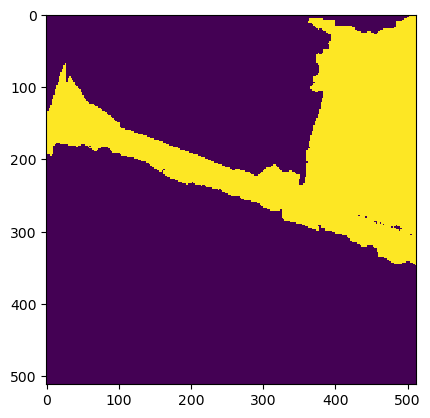

Wrote output/patches/mask/UC_S1_206-457014-4000-6318612-8000.tiff (512 x 512 pixels)


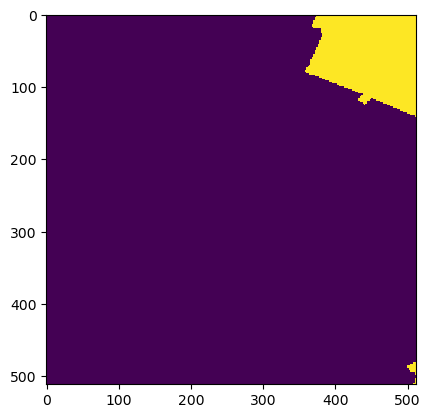

Wrote output/patches/mask/UC_S1_206-457014-4000-6318715-2000.tiff (512 x 512 pixels)


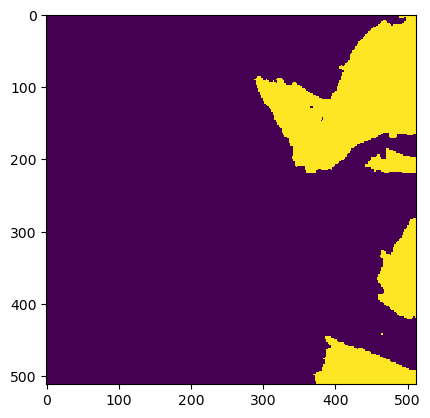

Wrote output/patches/mask/UC_S1_206-457014-4000-6318817-6000.tiff (512 x 512 pixels)


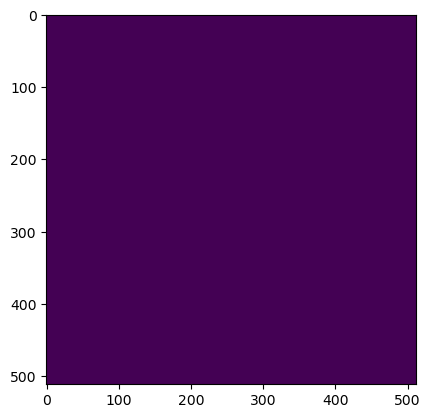

Wrote output/patches/mask/UC_S1_206-457116-8000-6318510-4000.tiff (512 x 512 pixels)


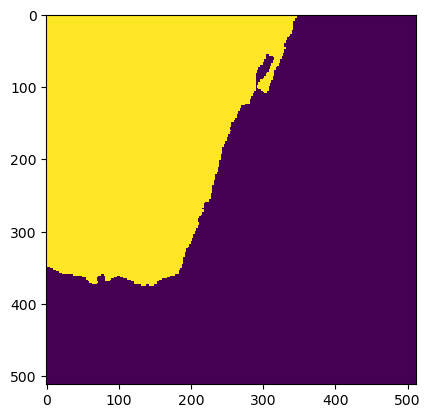

Wrote output/patches/mask/UC_S1_206-457116-8000-6318612-8000.tiff (512 x 512 pixels)


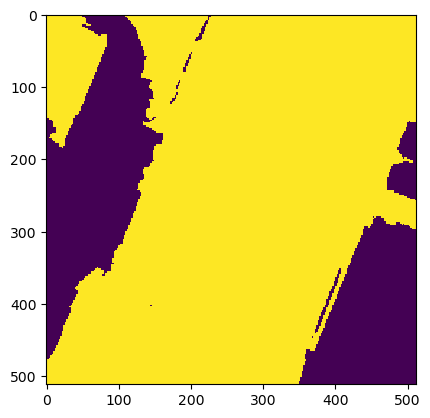

Wrote output/patches/mask/UC_S1_206-457116-8000-6318715-2000.tiff (512 x 512 pixels)


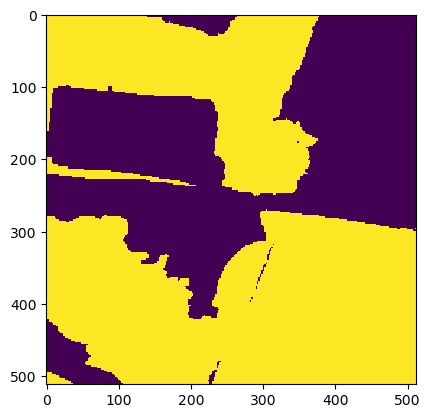

Wrote output/patches/mask/UC_S1_206-457116-8000-6318817-6000.tiff (512 x 512 pixels)


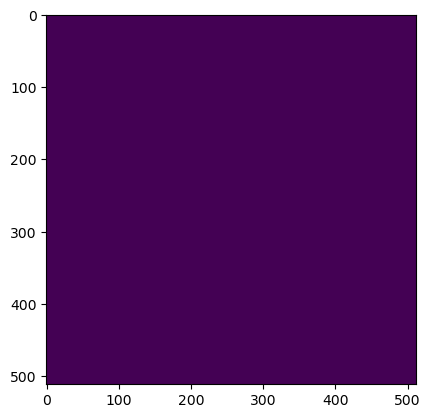

Wrote output/patches/mask/UC_S1_206-457219-2000-6318510-4000.tiff (512 x 512 pixels)


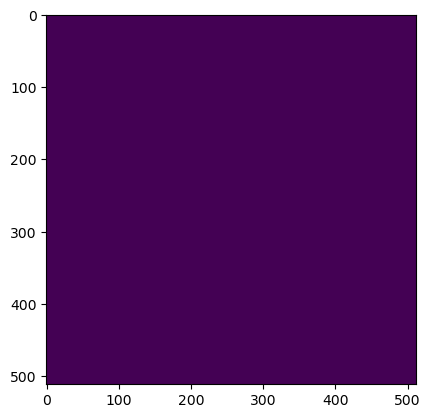

Wrote output/patches/mask/UC_S1_206-457219-2000-6318612-8000.tiff (512 x 512 pixels)


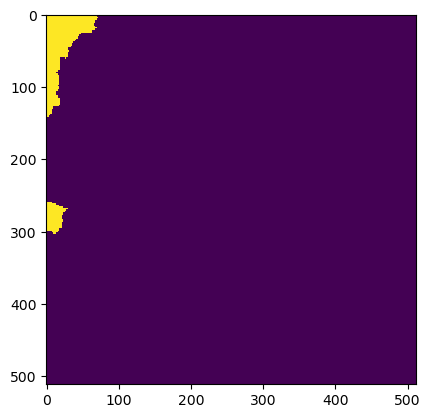

Wrote output/patches/mask/UC_S1_206-457219-2000-6318715-2000.tiff (512 x 512 pixels)


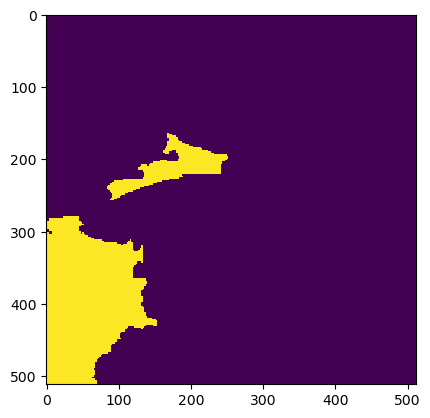

Wrote output/patches/mask/UC_S1_206-457219-2000-6318817-6000.tiff (512 x 512 pixels)
Zone CU_S1_207 Building Mask...


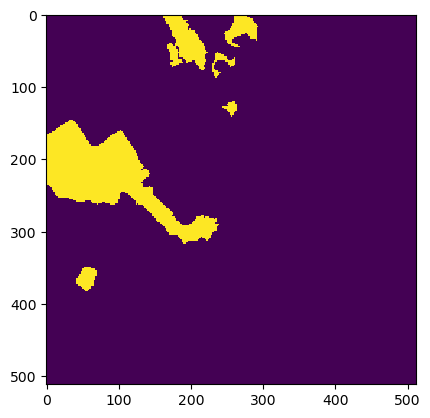

Wrote output/patches/mask/CU_S1_207-455888-0000-6319022-4000.tiff (512 x 512 pixels)


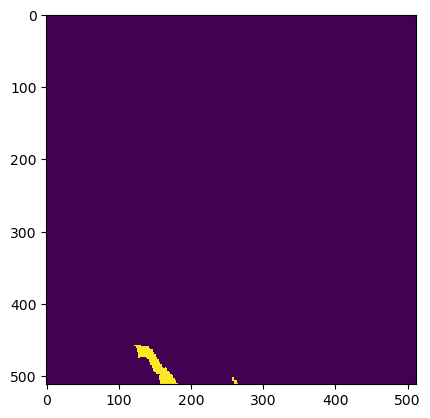

Wrote output/patches/mask/CU_S1_207-455888-0000-6319124-8000.tiff (512 x 512 pixels)


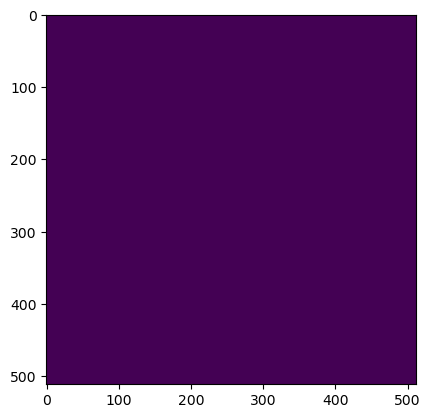

Wrote output/patches/mask/CU_S1_207-455990-4000-6319022-4000.tiff (512 x 512 pixels)


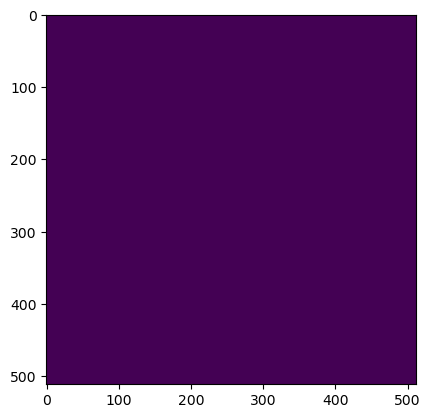

Wrote output/patches/mask/CU_S1_207-455990-4000-6319124-8000.tiff (512 x 512 pixels)
Zone VC_S1_208 Building Mask...


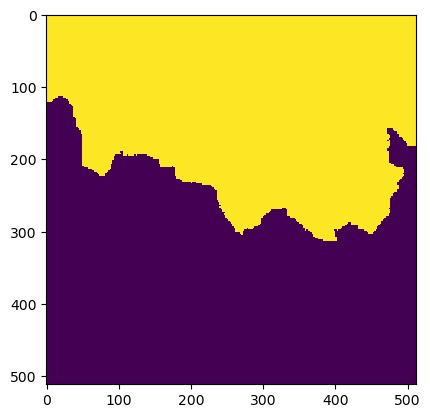

Wrote output/patches/mask/VC_S1_208-457424-0000-6319278-4000.tiff (512 x 512 pixels)


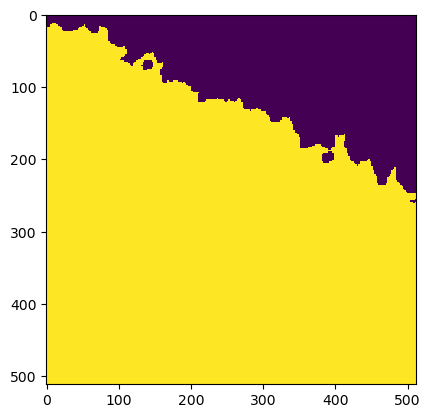

Wrote output/patches/mask/VC_S1_208-457424-0000-6319380-8000.tiff (512 x 512 pixels)


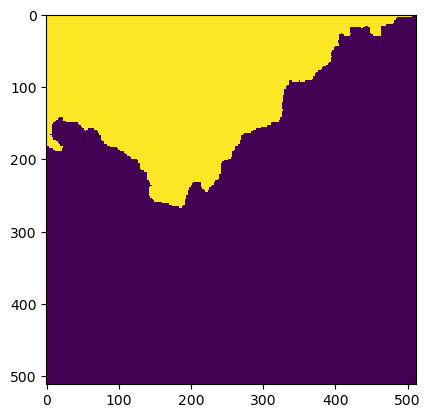

Wrote output/patches/mask/VC_S1_208-457526-4000-6319278-4000.tiff (512 x 512 pixels)


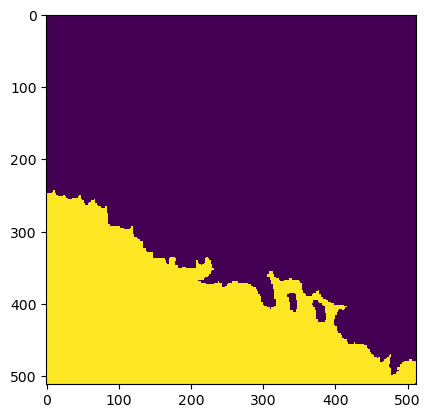

Wrote output/patches/mask/VC_S1_208-457526-4000-6319380-8000.tiff (512 x 512 pixels)
Zone VV_S1_209 Building Mask...


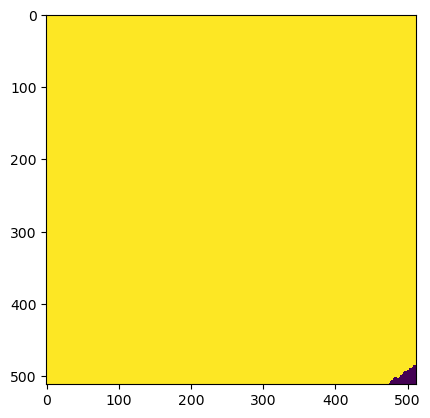

Wrote output/patches/mask/VV_S1_209-476112-0000-6319278-4000.tiff (512 x 512 pixels)


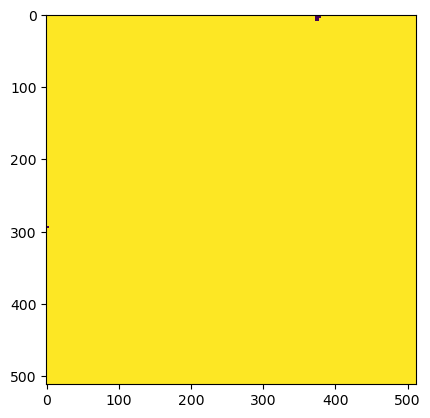

Wrote output/patches/mask/VV_S1_209-476112-0000-6319380-8000.tiff (512 x 512 pixels)


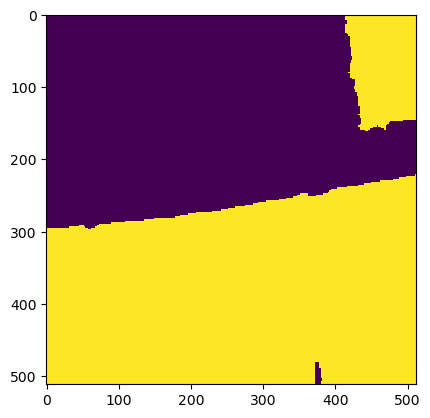

Wrote output/patches/mask/VV_S1_209-476112-0000-6319483-2000.tiff (512 x 512 pixels)


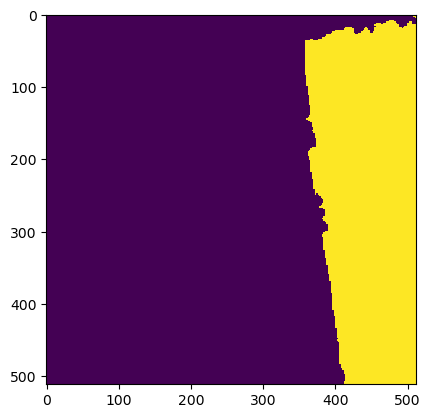

Wrote output/patches/mask/VV_S1_209-476112-0000-6319585-6000.tiff (512 x 512 pixels)


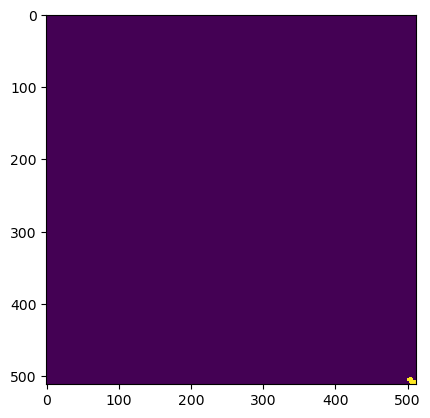

Wrote output/patches/mask/VV_S1_209-476112-0000-6319688-0000.tiff (512 x 512 pixels)


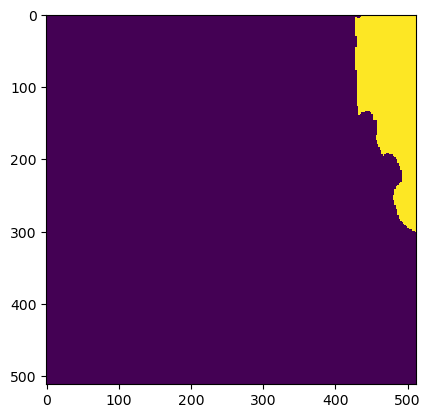

Wrote output/patches/mask/VV_S1_209-476112-0000-6319790-4000.tiff (512 x 512 pixels)


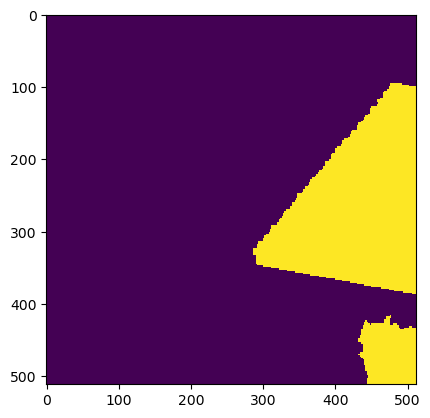

Wrote output/patches/mask/VV_S1_209-476112-0000-6319892-8000.tiff (512 x 512 pixels)


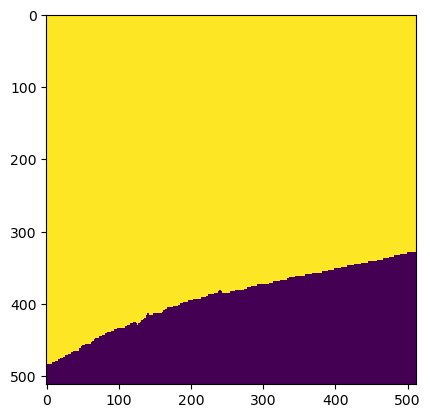

Wrote output/patches/mask/VV_S1_209-476214-4000-6319278-4000.tiff (512 x 512 pixels)


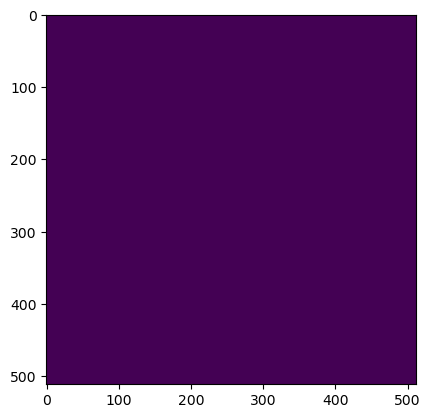

Wrote output/patches/mask/VV_S1_209-476214-4000-6319380-8000.tiff (512 x 512 pixels)


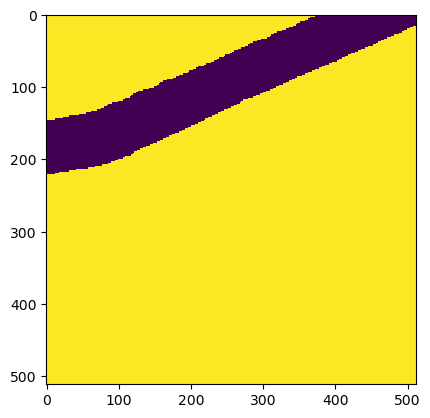

Wrote output/patches/mask/VV_S1_209-476214-4000-6319483-2000.tiff (512 x 512 pixels)


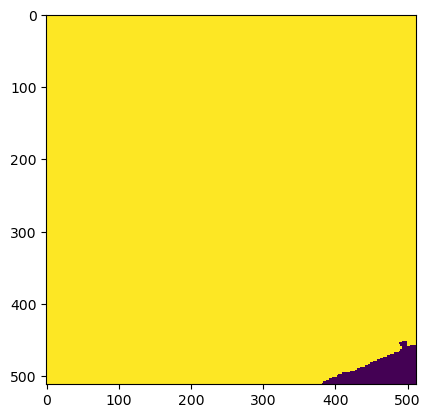

Wrote output/patches/mask/VV_S1_209-476214-4000-6319585-6000.tiff (512 x 512 pixels)


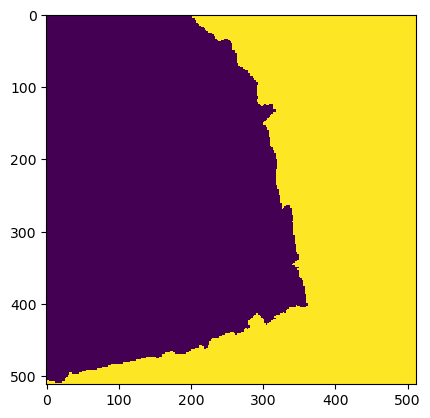

Wrote output/patches/mask/VV_S1_209-476214-4000-6319688-0000.tiff (512 x 512 pixels)


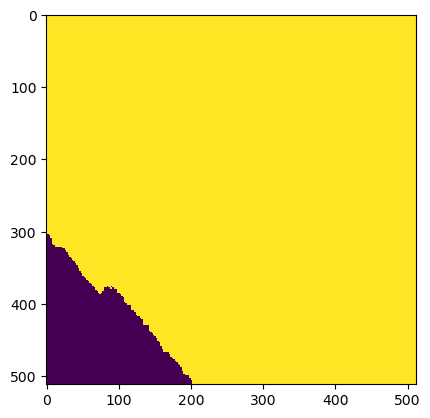

Wrote output/patches/mask/VV_S1_209-476214-4000-6319790-4000.tiff (512 x 512 pixels)


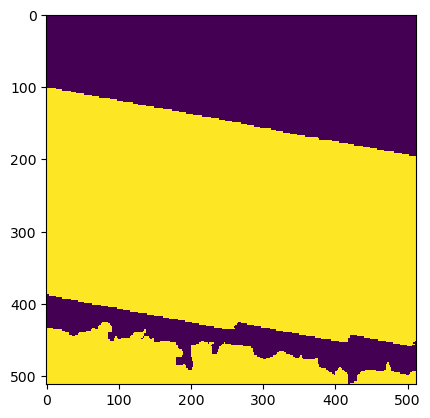

Wrote output/patches/mask/VV_S1_209-476214-4000-6319892-8000.tiff (512 x 512 pixels)
Zone UC_S1_210 Building Mask...


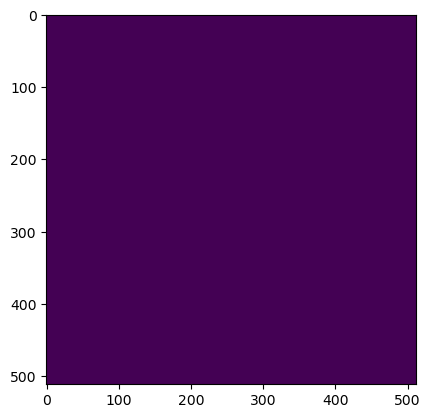

Wrote output/patches/mask/UC_S1_210-445392-0000-6319278-4000.tiff (512 x 512 pixels)


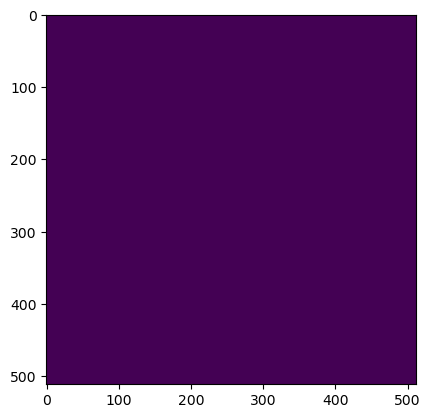

Wrote output/patches/mask/UC_S1_210-445392-0000-6319380-8000.tiff (512 x 512 pixels)


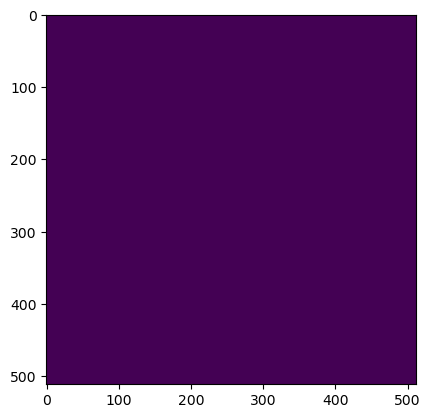

Wrote output/patches/mask/UC_S1_210-445392-0000-6319483-2000.tiff (512 x 512 pixels)


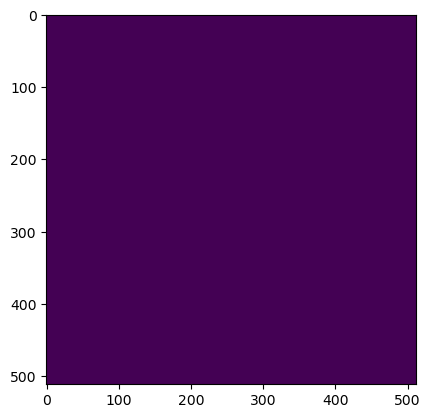

Wrote output/patches/mask/UC_S1_210-445392-0000-6319585-6000.tiff (512 x 512 pixels)


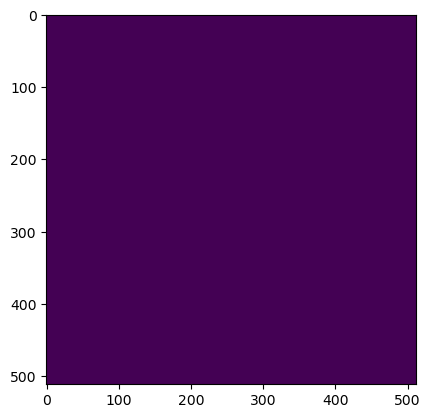

Wrote output/patches/mask/UC_S1_210-445494-4000-6319278-4000.tiff (512 x 512 pixels)


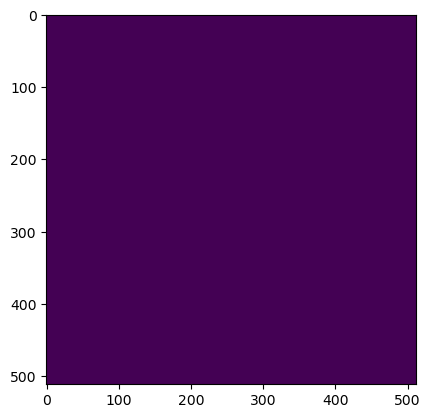

Wrote output/patches/mask/UC_S1_210-445494-4000-6319380-8000.tiff (512 x 512 pixels)


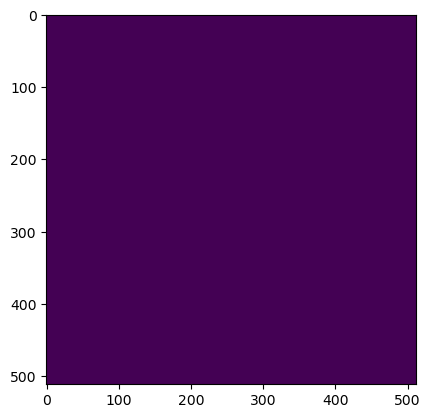

Wrote output/patches/mask/UC_S1_210-445494-4000-6319483-2000.tiff (512 x 512 pixels)


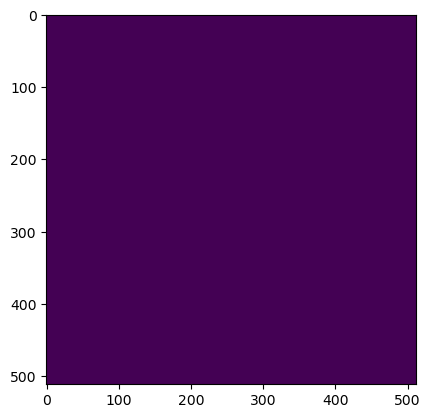

Wrote output/patches/mask/UC_S1_210-445494-4000-6319585-6000.tiff (512 x 512 pixels)


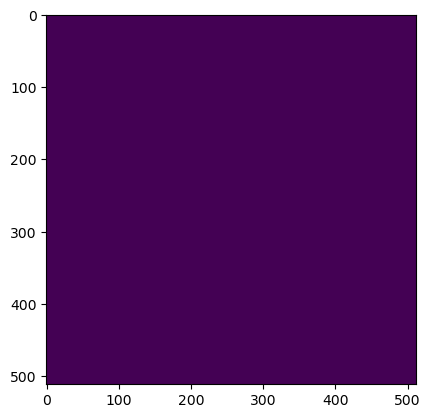

Wrote output/patches/mask/UC_S1_210-445596-8000-6319278-4000.tiff (512 x 512 pixels)


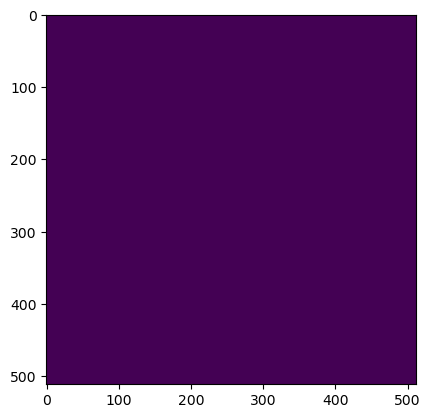

Wrote output/patches/mask/UC_S1_210-445596-8000-6319380-8000.tiff (512 x 512 pixels)


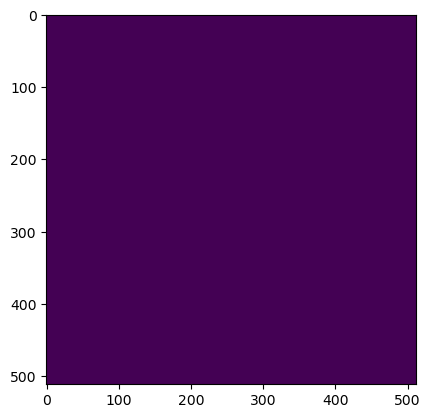

Wrote output/patches/mask/UC_S1_210-445596-8000-6319483-2000.tiff (512 x 512 pixels)


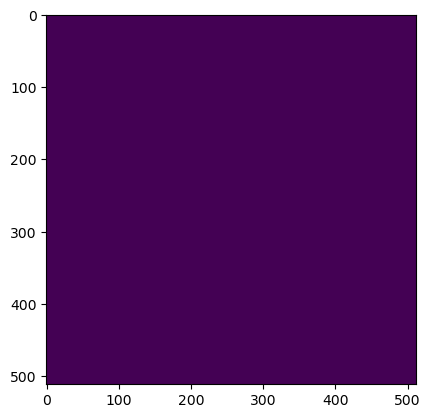

Wrote output/patches/mask/UC_S1_210-445596-8000-6319585-6000.tiff (512 x 512 pixels)


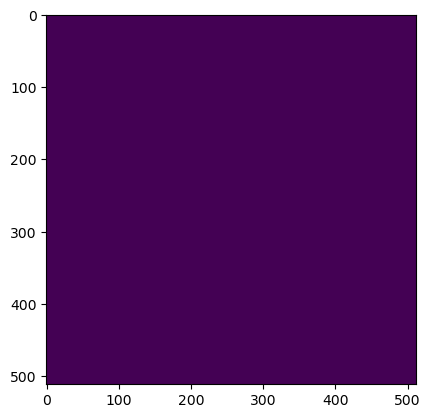

Wrote output/patches/mask/UC_S1_210-445699-2000-6319278-4000.tiff (512 x 512 pixels)


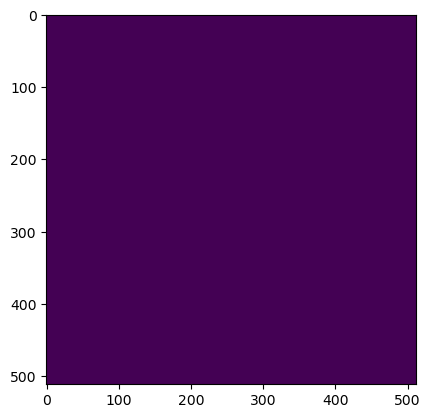

Wrote output/patches/mask/UC_S1_210-445699-2000-6319380-8000.tiff (512 x 512 pixels)


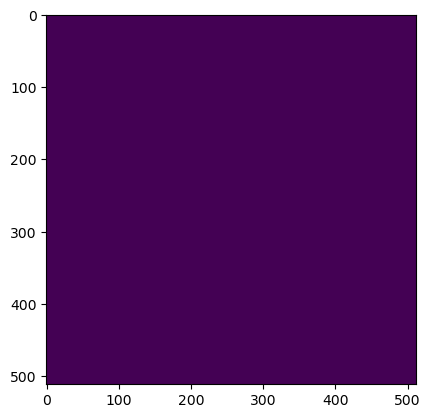

Wrote output/patches/mask/UC_S1_210-445699-2000-6319483-2000.tiff (512 x 512 pixels)


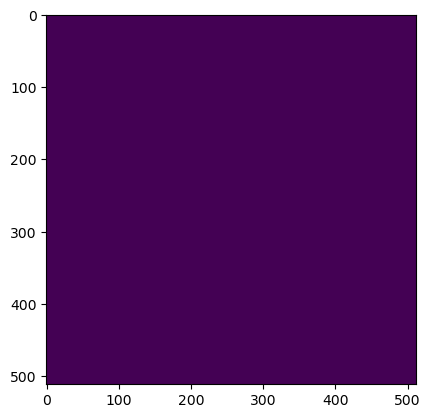

Wrote output/patches/mask/UC_S1_210-445699-2000-6319585-6000.tiff (512 x 512 pixels)
Zone VV_S1_211 Building Mask...


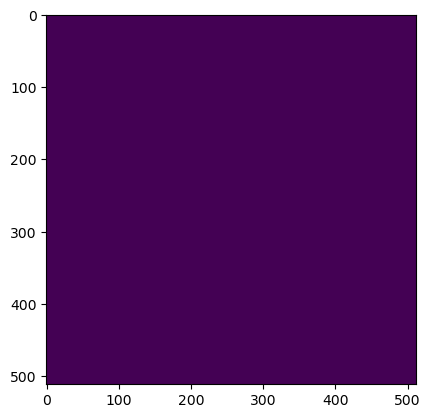

Wrote output/patches/mask/VV_S1_211-467152-0000-6319534-4000.tiff (512 x 512 pixels)


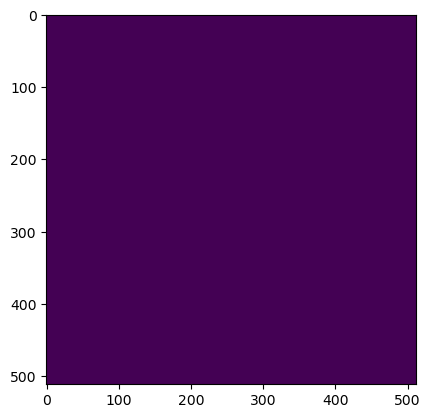

Wrote output/patches/mask/VV_S1_211-467152-0000-6319636-8000.tiff (512 x 512 pixels)


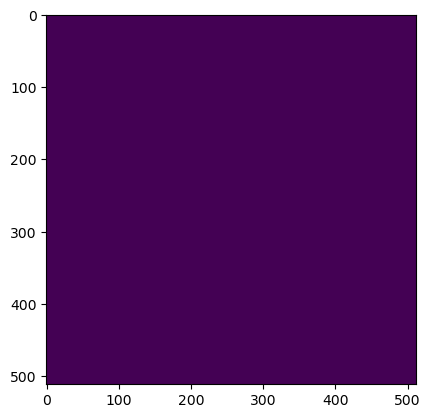

Wrote output/patches/mask/VV_S1_211-467152-0000-6319739-2000.tiff (512 x 512 pixels)


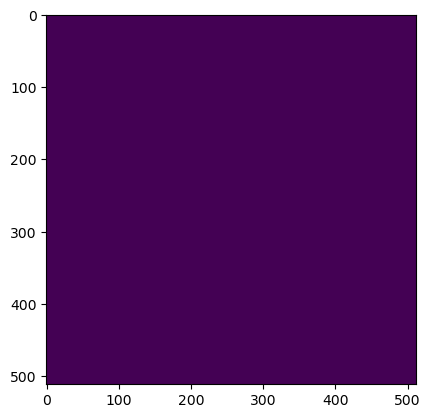

Wrote output/patches/mask/VV_S1_211-467152-0000-6319841-6000.tiff (512 x 512 pixels)


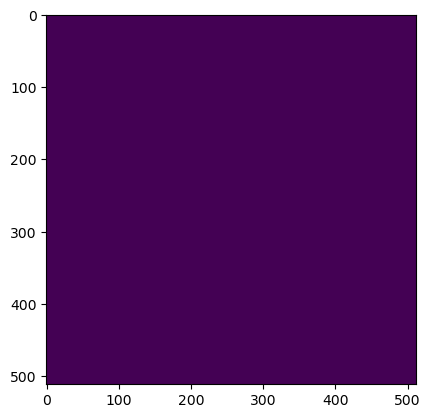

Wrote output/patches/mask/VV_S1_211-467254-4000-6319534-4000.tiff (512 x 512 pixels)


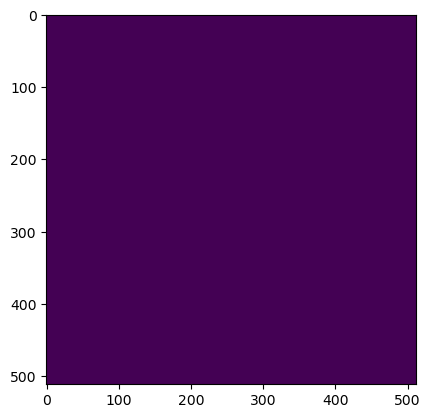

Wrote output/patches/mask/VV_S1_211-467254-4000-6319636-8000.tiff (512 x 512 pixels)


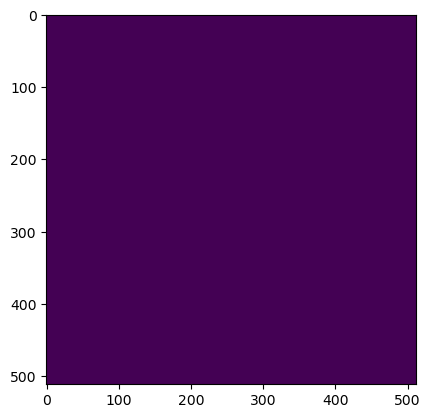

Wrote output/patches/mask/VV_S1_211-467254-4000-6319739-2000.tiff (512 x 512 pixels)


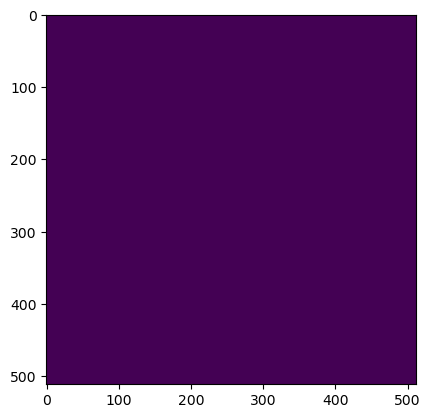

Wrote output/patches/mask/VV_S1_211-467254-4000-6319841-6000.tiff (512 x 512 pixels)


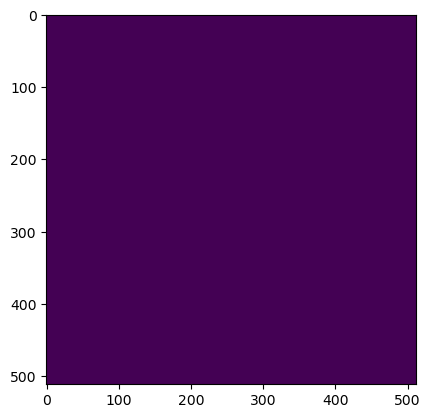

Wrote output/patches/mask/VV_S1_211-467356-8000-6319534-4000.tiff (512 x 512 pixels)


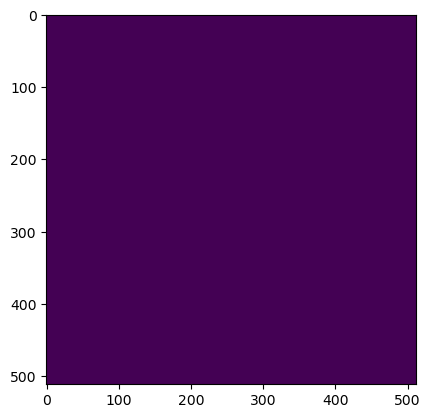

Wrote output/patches/mask/VV_S1_211-467356-8000-6319636-8000.tiff (512 x 512 pixels)


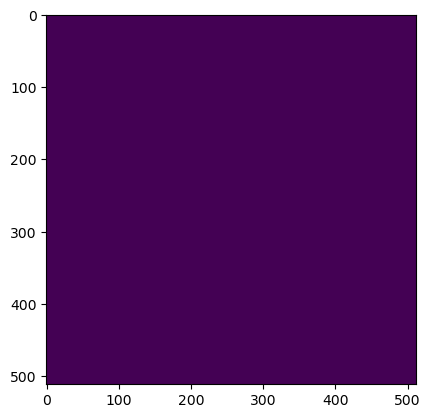

Wrote output/patches/mask/VV_S1_211-467356-8000-6319739-2000.tiff (512 x 512 pixels)


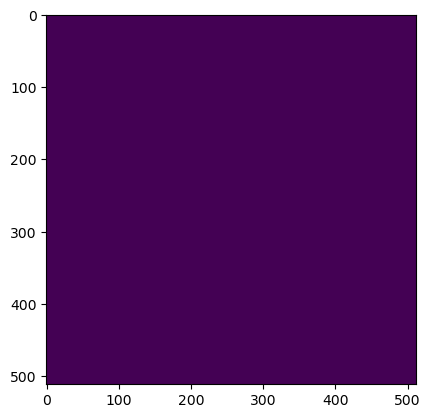

Wrote output/patches/mask/VV_S1_211-467356-8000-6319841-6000.tiff (512 x 512 pixels)


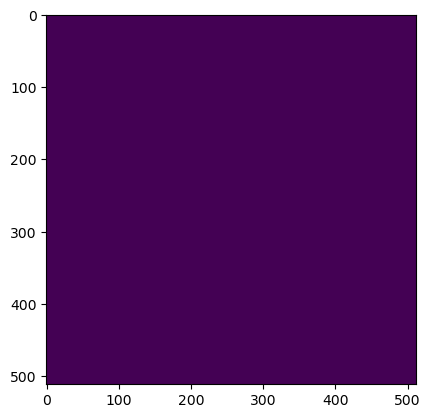

Wrote output/patches/mask/VV_S1_211-467459-2000-6319534-4000.tiff (512 x 512 pixels)


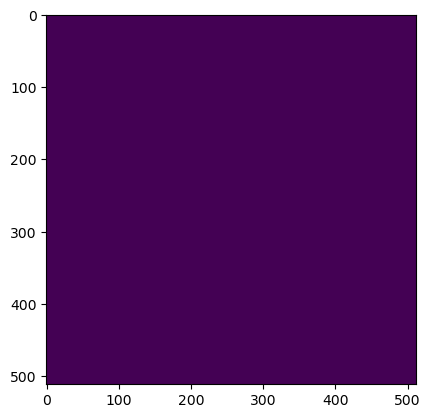

Wrote output/patches/mask/VV_S1_211-467459-2000-6319636-8000.tiff (512 x 512 pixels)


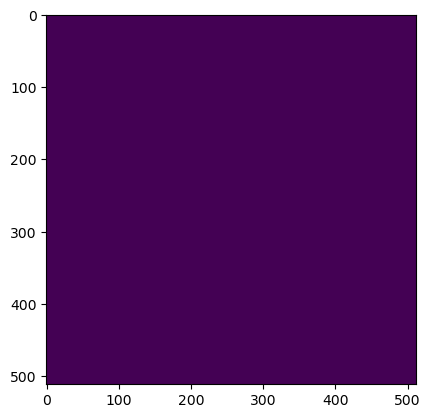

Wrote output/patches/mask/VV_S1_211-467459-2000-6319739-2000.tiff (512 x 512 pixels)


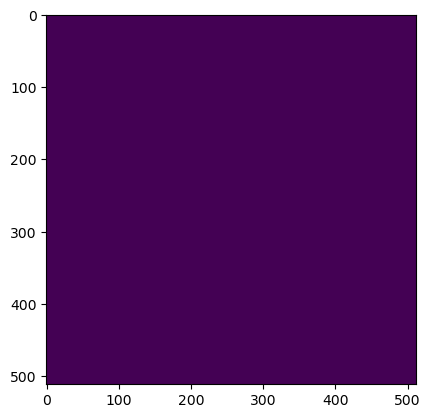

Wrote output/patches/mask/VV_S1_211-467459-2000-6319841-6000.tiff (512 x 512 pixels)


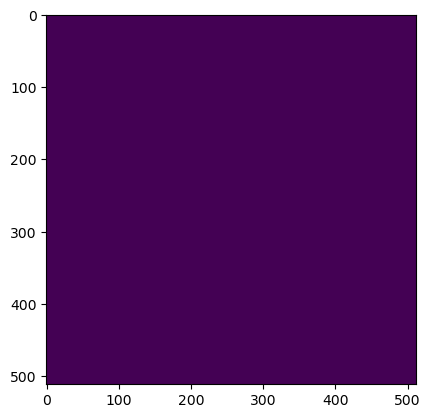

Wrote output/patches/mask/VV_S1_211-467561-6000-6319534-4000.tiff (512 x 512 pixels)


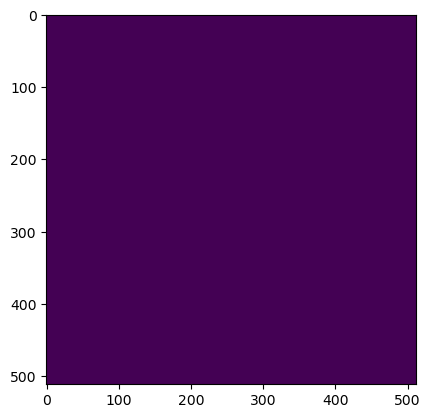

Wrote output/patches/mask/VV_S1_211-467561-6000-6319636-8000.tiff (512 x 512 pixels)


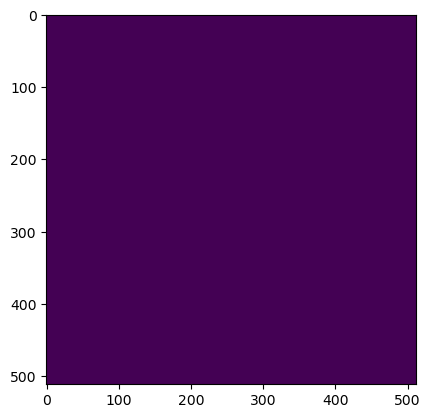

Wrote output/patches/mask/VV_S1_211-467561-6000-6319739-2000.tiff (512 x 512 pixels)


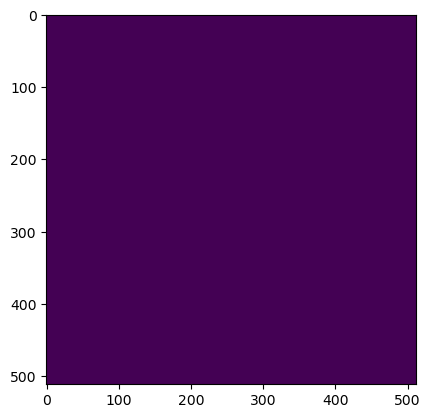

Wrote output/patches/mask/VV_S1_211-467561-6000-6319841-6000.tiff (512 x 512 pixels)


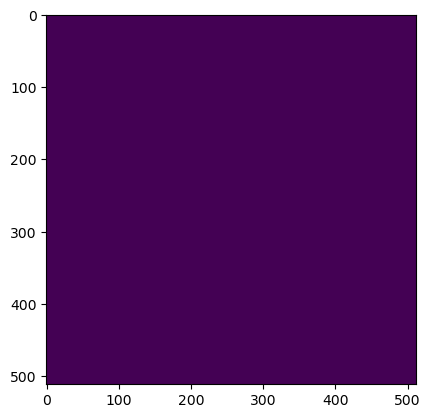

Wrote output/patches/mask/VV_S1_211-467664-0000-6319534-4000.tiff (512 x 512 pixels)


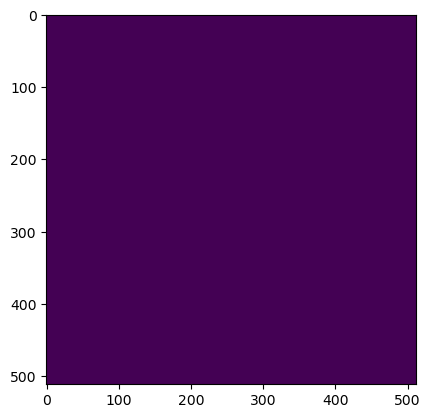

Wrote output/patches/mask/VV_S1_211-467664-0000-6319636-8000.tiff (512 x 512 pixels)


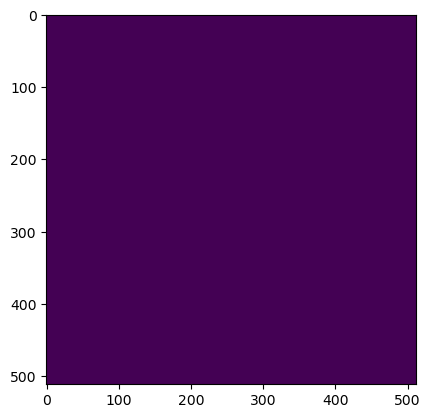

Wrote output/patches/mask/VV_S1_211-467664-0000-6319739-2000.tiff (512 x 512 pixels)


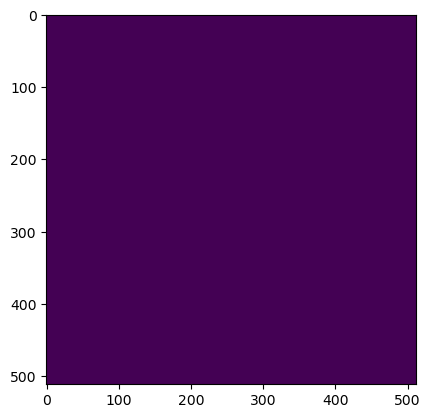

Wrote output/patches/mask/VV_S1_211-467664-0000-6319841-6000.tiff (512 x 512 pixels)


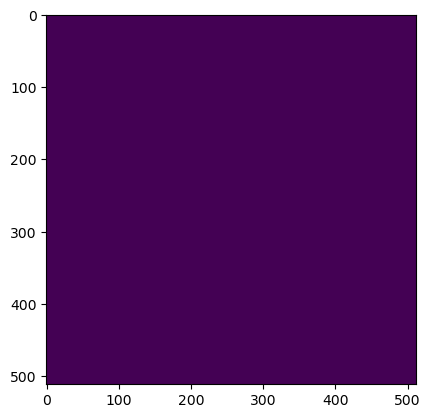

Wrote output/patches/mask/VV_S1_211-467766-4000-6319534-4000.tiff (512 x 512 pixels)


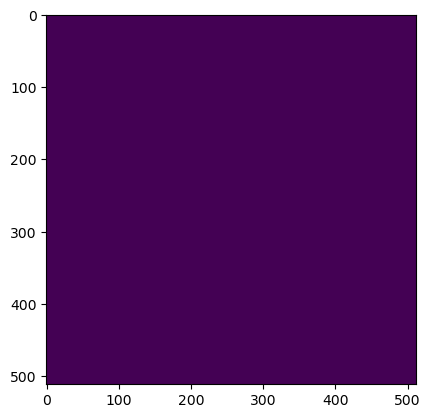

Wrote output/patches/mask/VV_S1_211-467766-4000-6319636-8000.tiff (512 x 512 pixels)


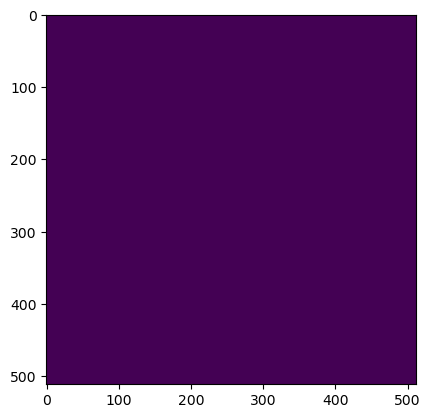

Wrote output/patches/mask/VV_S1_211-467766-4000-6319739-2000.tiff (512 x 512 pixels)


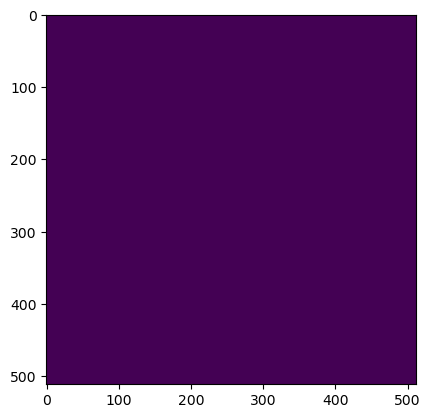

Wrote output/patches/mask/VV_S1_211-467766-4000-6319841-6000.tiff (512 x 512 pixels)


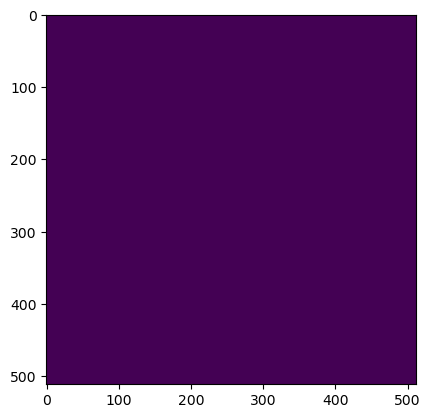

Wrote output/patches/mask/VV_S1_211-467868-8000-6319534-4000.tiff (512 x 512 pixels)


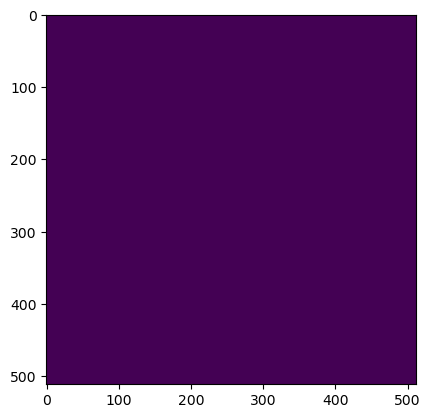

Wrote output/patches/mask/VV_S1_211-467868-8000-6319636-8000.tiff (512 x 512 pixels)


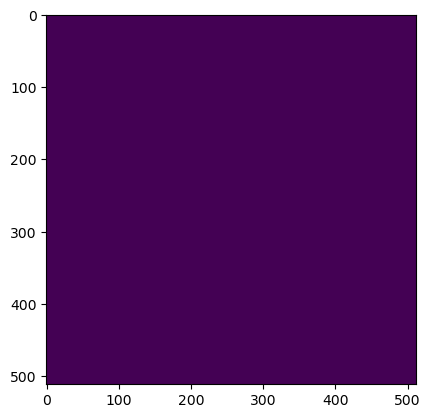

Wrote output/patches/mask/VV_S1_211-467868-8000-6319739-2000.tiff (512 x 512 pixels)


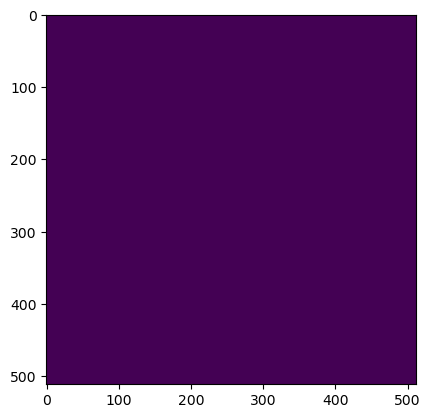

Wrote output/patches/mask/VV_S1_211-467868-8000-6319841-6000.tiff (512 x 512 pixels)


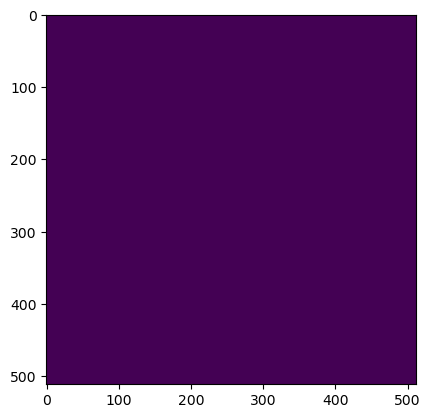

Wrote output/patches/mask/VV_S1_211-467971-2000-6319534-4000.tiff (512 x 512 pixels)


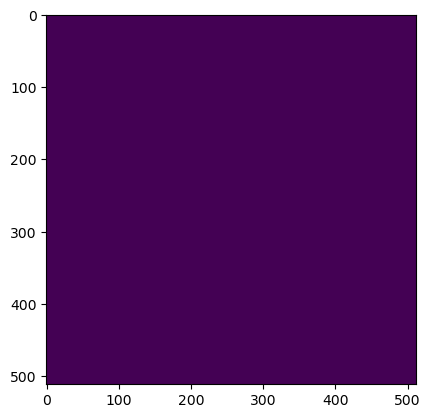

Wrote output/patches/mask/VV_S1_211-467971-2000-6319636-8000.tiff (512 x 512 pixels)


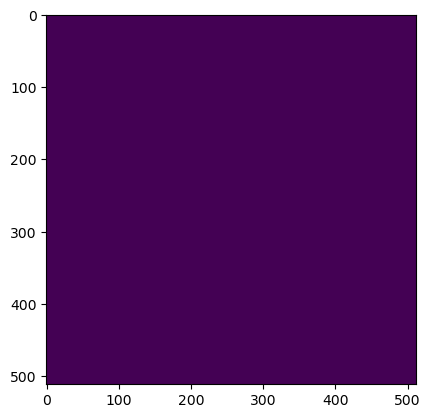

Wrote output/patches/mask/VV_S1_211-467971-2000-6319739-2000.tiff (512 x 512 pixels)


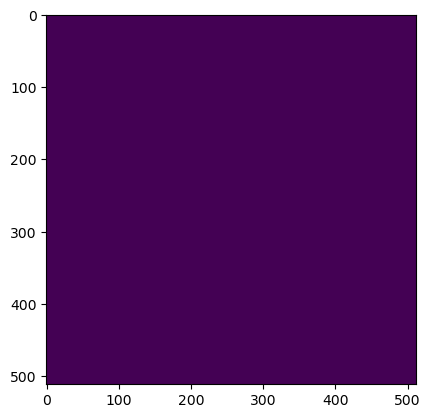

Wrote output/patches/mask/VV_S1_211-467971-2000-6319841-6000.tiff (512 x 512 pixels)
Zone VV_S1_212 Building Mask...


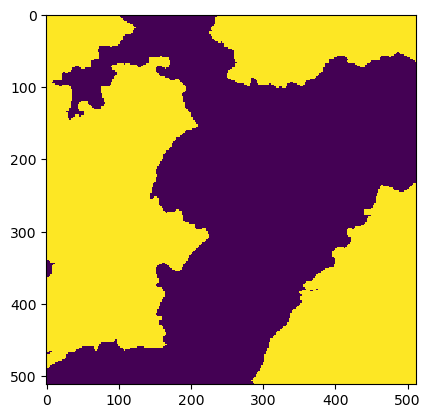

Wrote output/patches/mask/VV_S1_212-448720-0000-6319790-4000.tiff (512 x 512 pixels)


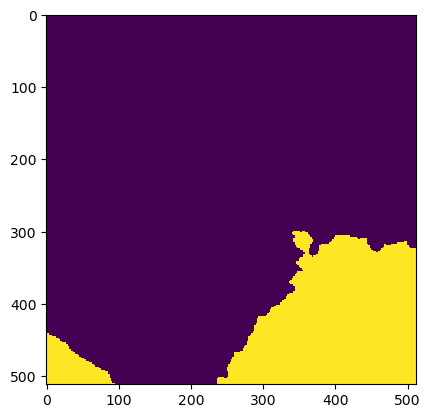

Wrote output/patches/mask/VV_S1_212-448720-0000-6319892-8000.tiff (512 x 512 pixels)


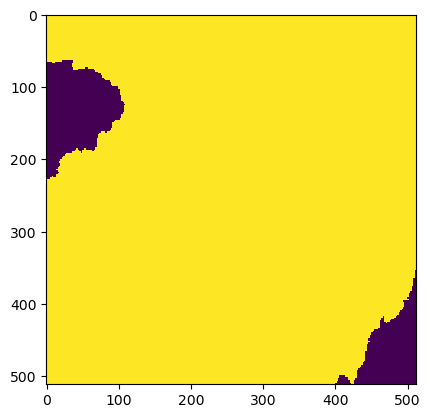

Wrote output/patches/mask/VV_S1_212-448822-4000-6319790-4000.tiff (512 x 512 pixels)


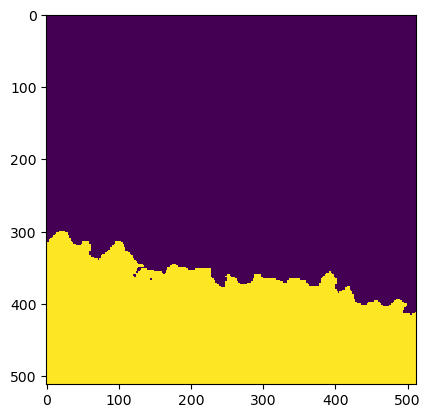

Wrote output/patches/mask/VV_S1_212-448822-4000-6319892-8000.tiff (512 x 512 pixels)
Zone UC_S1_213 Building Mask...


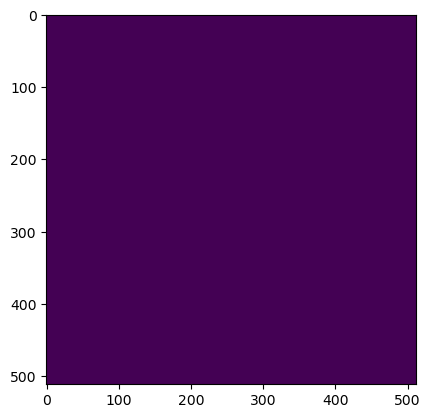

Wrote output/patches/mask/UC_S1_213-464848-0000-6320046-4000.tiff (512 x 512 pixels)


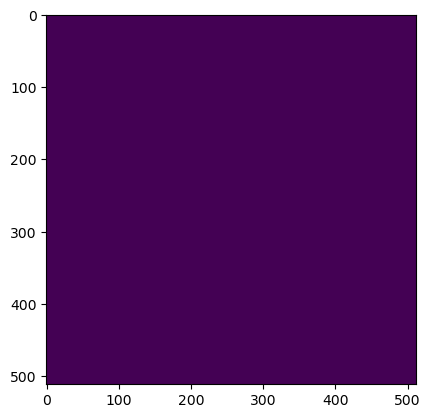

Wrote output/patches/mask/UC_S1_213-464848-0000-6320148-8000.tiff (512 x 512 pixels)


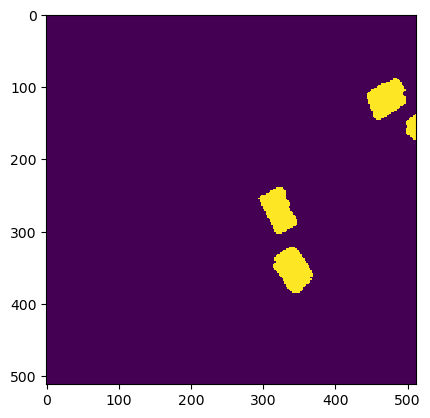

Wrote output/patches/mask/UC_S1_213-464848-0000-6320251-2000.tiff (512 x 512 pixels)


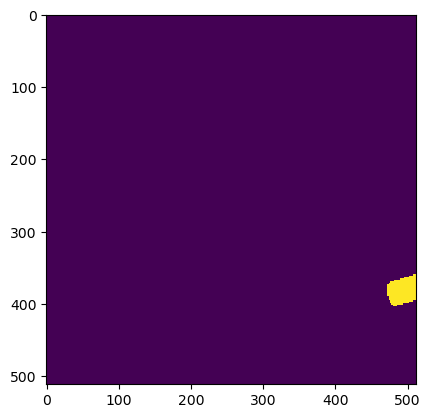

Wrote output/patches/mask/UC_S1_213-464848-0000-6320353-6000.tiff (512 x 512 pixels)


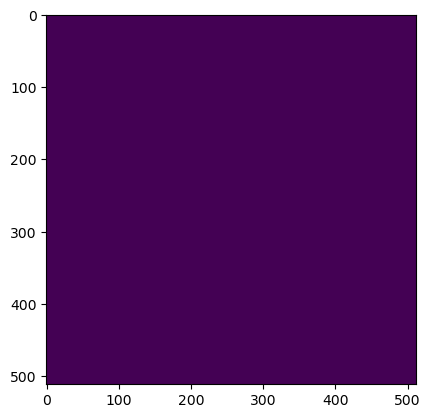

Wrote output/patches/mask/UC_S1_213-464950-4000-6320046-4000.tiff (512 x 512 pixels)


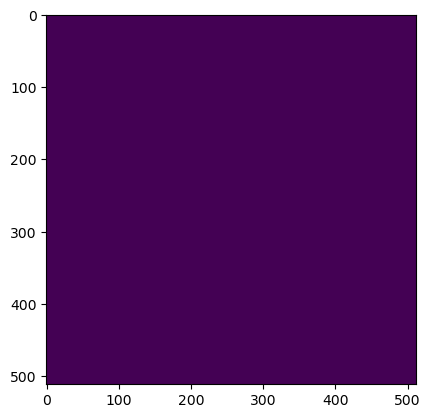

Wrote output/patches/mask/UC_S1_213-464950-4000-6320148-8000.tiff (512 x 512 pixels)


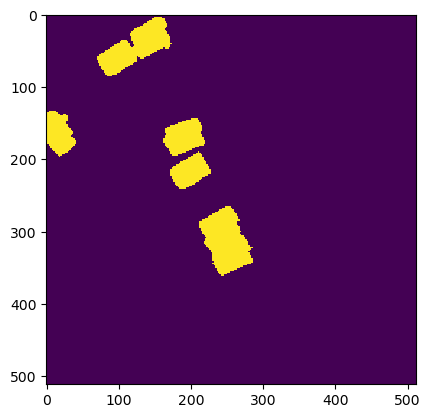

Wrote output/patches/mask/UC_S1_213-464950-4000-6320251-2000.tiff (512 x 512 pixels)


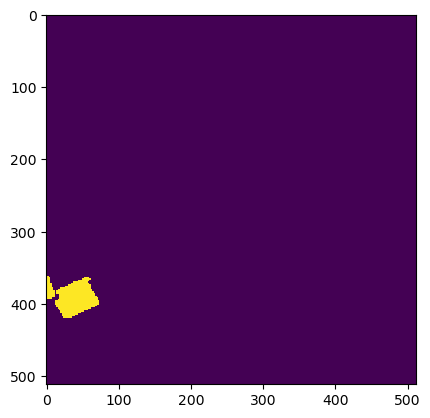

Wrote output/patches/mask/UC_S1_213-464950-4000-6320353-6000.tiff (512 x 512 pixels)
Zone VV_S1_214 Building Mask...


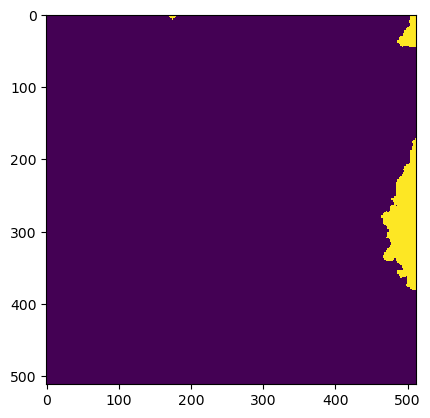

Wrote output/patches/mask/VV_S1_214-451280-0000-6320814-4000.tiff (512 x 512 pixels)


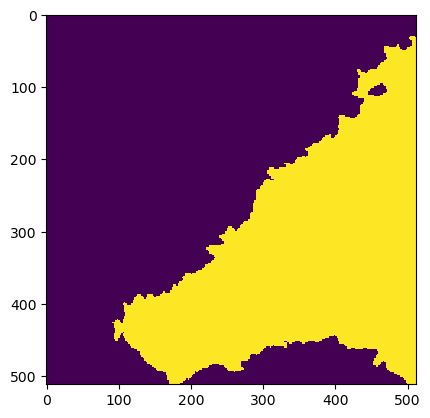

Wrote output/patches/mask/VV_S1_214-451280-0000-6320916-8000.tiff (512 x 512 pixels)


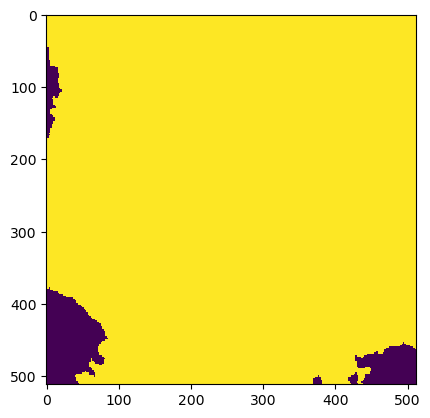

Wrote output/patches/mask/VV_S1_214-451382-4000-6320814-4000.tiff (512 x 512 pixels)


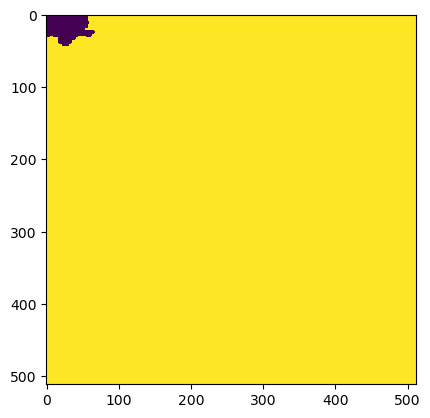

Wrote output/patches/mask/VV_S1_214-451382-4000-6320916-8000.tiff (512 x 512 pixels)


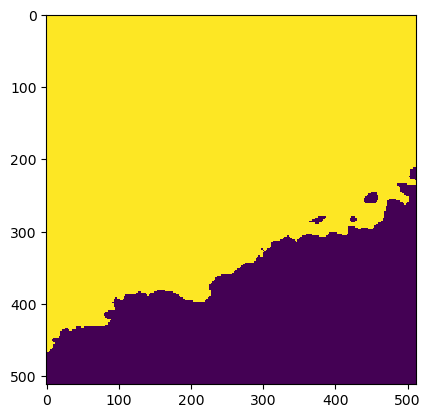

Wrote output/patches/mask/VV_S1_214-451484-8000-6320814-4000.tiff (512 x 512 pixels)


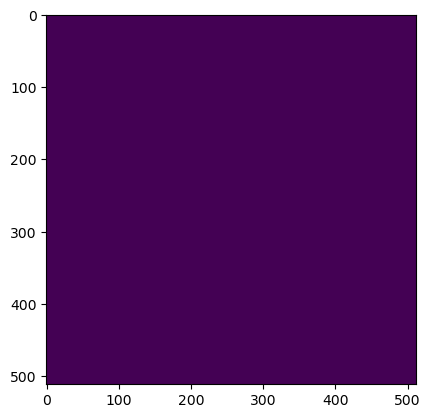

Wrote output/patches/mask/VV_S1_214-451484-8000-6320916-8000.tiff (512 x 512 pixels)


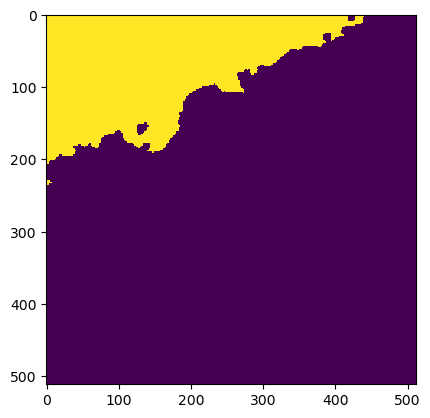

Wrote output/patches/mask/VV_S1_214-451587-2000-6320814-4000.tiff (512 x 512 pixels)


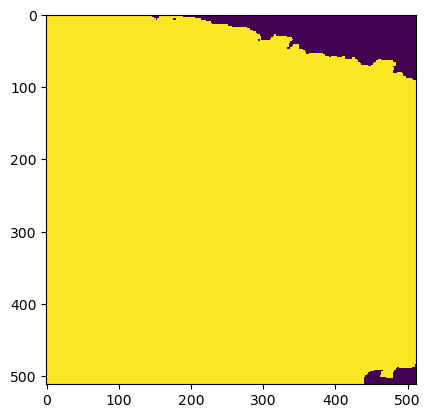

Wrote output/patches/mask/VV_S1_214-451587-2000-6320916-8000.tiff (512 x 512 pixels)


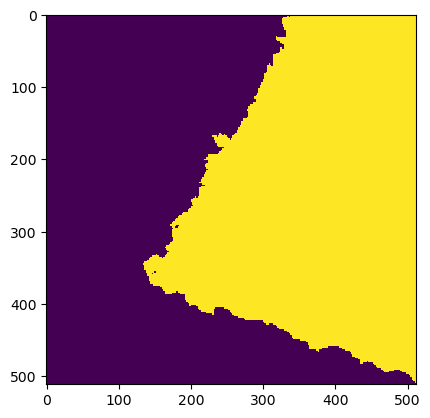

Wrote output/patches/mask/VV_S1_214-451689-6000-6320814-4000.tiff (512 x 512 pixels)


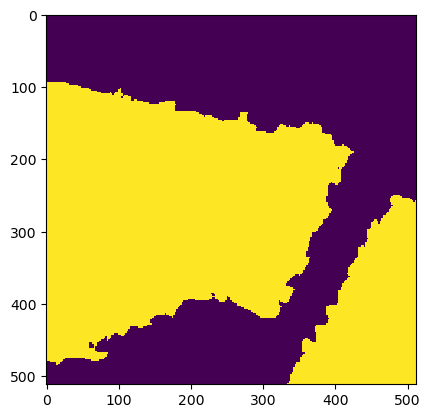

Wrote output/patches/mask/VV_S1_214-451689-6000-6320916-8000.tiff (512 x 512 pixels)


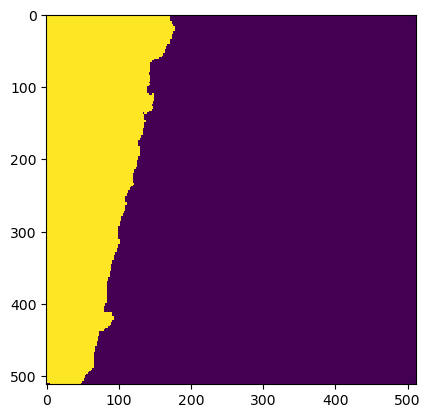

Wrote output/patches/mask/VV_S1_214-451792-0000-6320814-4000.tiff (512 x 512 pixels)


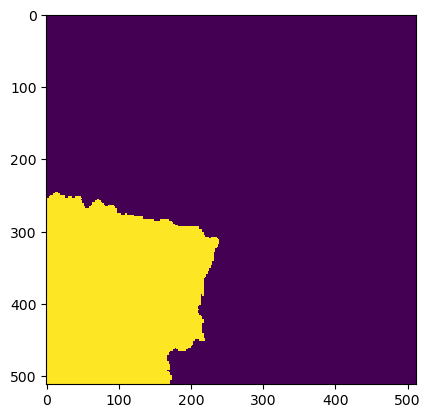

Wrote output/patches/mask/VV_S1_214-451792-0000-6320916-8000.tiff (512 x 512 pixels)


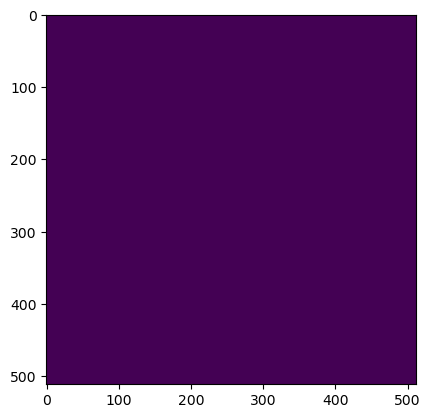

Wrote output/patches/mask/VV_S1_214-451894-4000-6320814-4000.tiff (512 x 512 pixels)


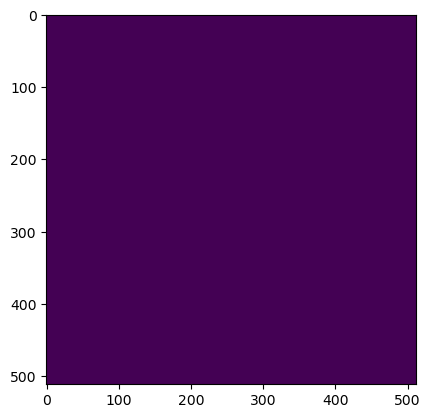

Wrote output/patches/mask/VV_S1_214-451894-4000-6320916-8000.tiff (512 x 512 pixels)


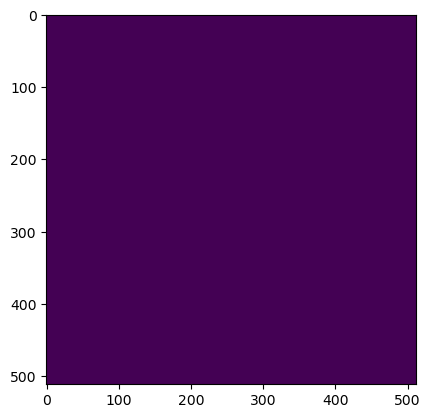

Wrote output/patches/mask/VV_S1_214-451996-8000-6320814-4000.tiff (512 x 512 pixels)


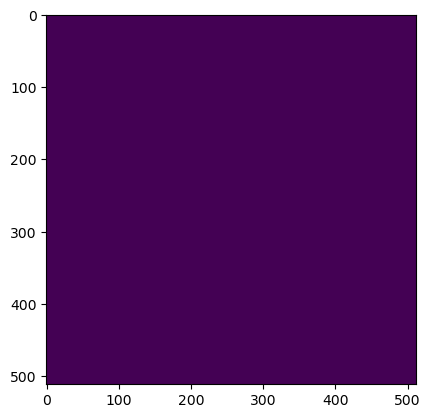

Wrote output/patches/mask/VV_S1_214-451996-8000-6320916-8000.tiff (512 x 512 pixels)


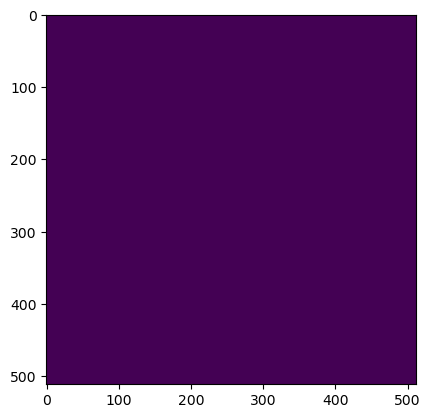

Wrote output/patches/mask/VV_S1_214-452099-2000-6320814-4000.tiff (512 x 512 pixels)


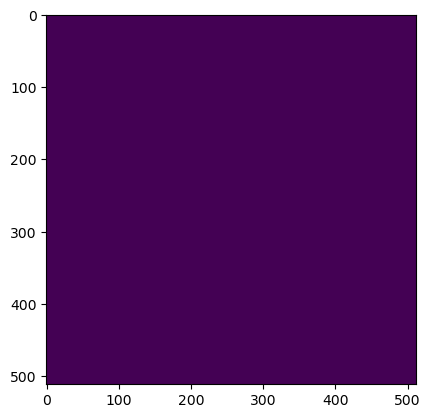

Wrote output/patches/mask/VV_S1_214-452099-2000-6320916-8000.tiff (512 x 512 pixels)


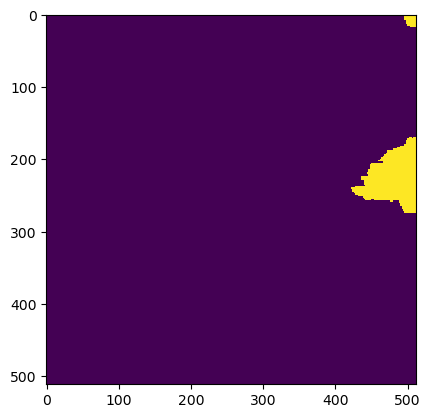

Wrote output/patches/mask/VV_S1_214-452201-6000-6320814-4000.tiff (512 x 512 pixels)


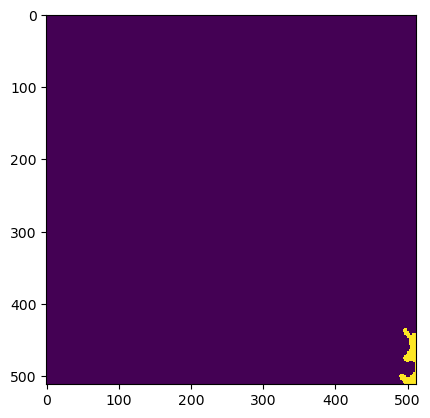

Wrote output/patches/mask/VV_S1_214-452201-6000-6320916-8000.tiff (512 x 512 pixels)


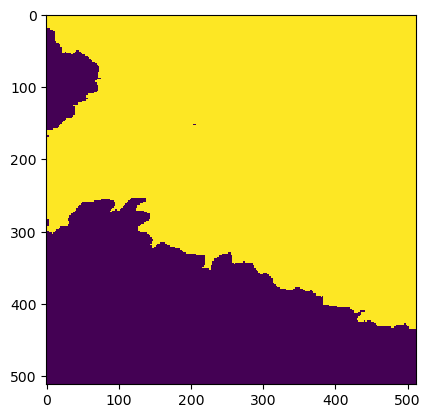

Wrote output/patches/mask/VV_S1_214-452304-0000-6320814-4000.tiff (512 x 512 pixels)


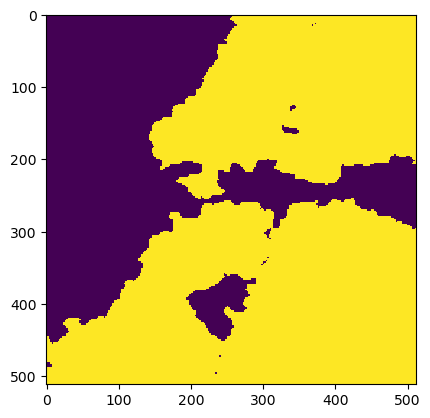

Wrote output/patches/mask/VV_S1_214-452304-0000-6320916-8000.tiff (512 x 512 pixels)


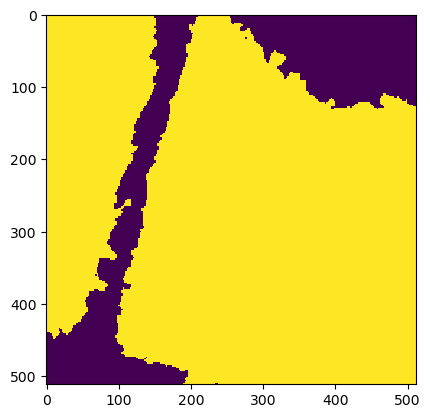

Wrote output/patches/mask/VV_S1_214-452406-4000-6320814-4000.tiff (512 x 512 pixels)


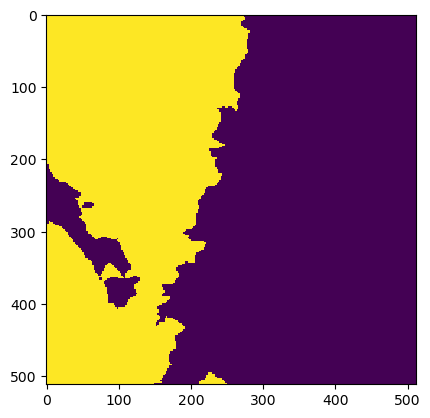

Wrote output/patches/mask/VV_S1_214-452406-4000-6320916-8000.tiff (512 x 512 pixels)
Zone UU_S1_215 Building Mask...


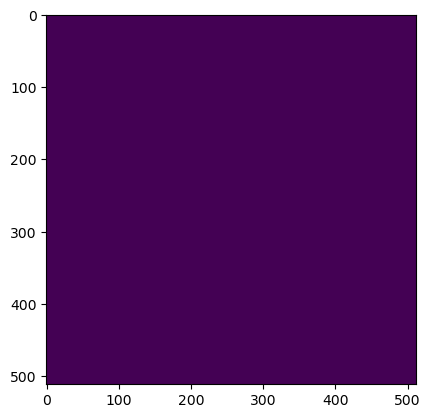

Wrote output/patches/mask/UU_S1_215-490192-0000-6320814-4000.tiff (512 x 512 pixels)


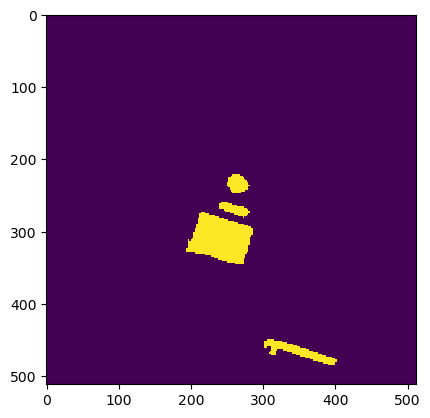

Wrote output/patches/mask/UU_S1_215-490192-0000-6320916-8000.tiff (512 x 512 pixels)


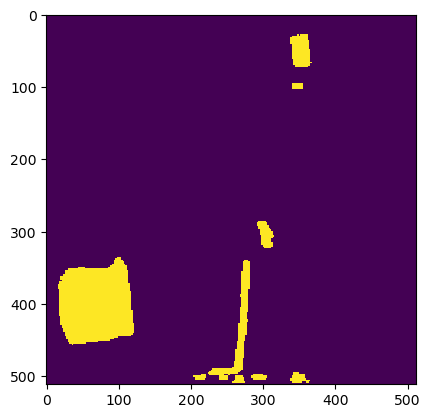

Wrote output/patches/mask/UU_S1_215-490192-0000-6321019-2000.tiff (512 x 512 pixels)


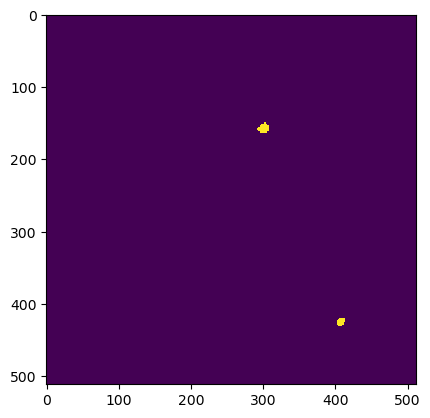

Wrote output/patches/mask/UU_S1_215-490192-0000-6321121-6000.tiff (512 x 512 pixels)


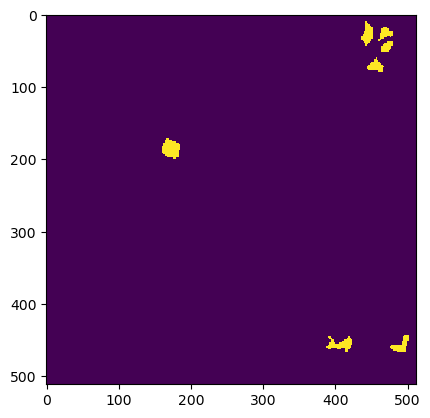

Wrote output/patches/mask/UU_S1_215-490294-4000-6320814-4000.tiff (512 x 512 pixels)


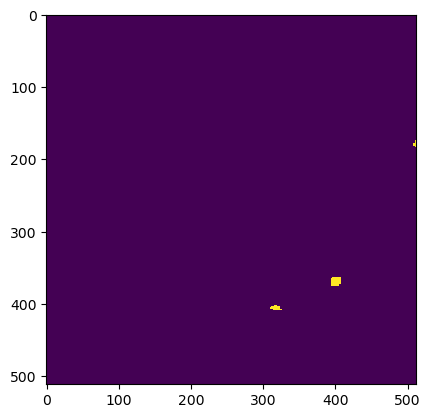

Wrote output/patches/mask/UU_S1_215-490294-4000-6320916-8000.tiff (512 x 512 pixels)


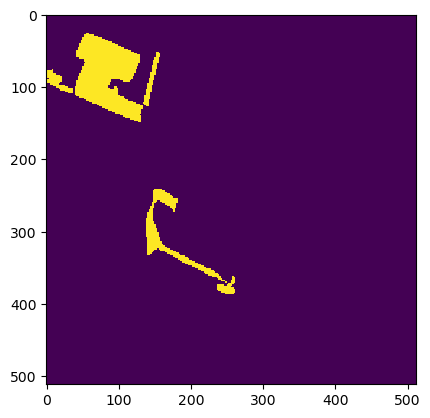

Wrote output/patches/mask/UU_S1_215-490294-4000-6321019-2000.tiff (512 x 512 pixels)


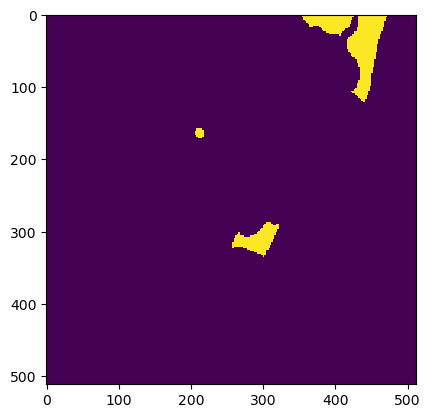

Wrote output/patches/mask/UU_S1_215-490294-4000-6321121-6000.tiff (512 x 512 pixels)
Zone UU_S1_216 Building Mask...


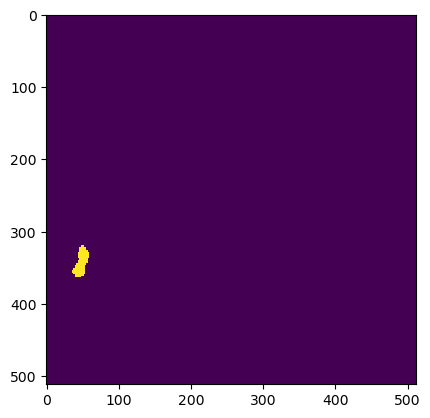

Wrote output/patches/mask/UU_S1_216-466128-0000-6320814-4000.tiff (512 x 512 pixels)


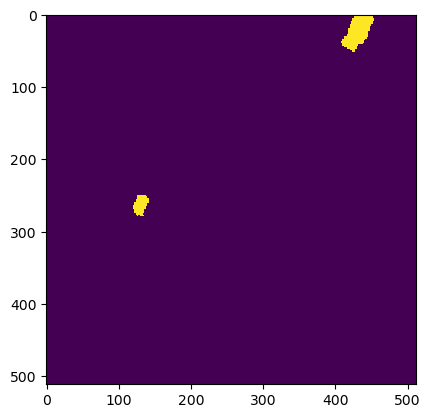

Wrote output/patches/mask/UU_S1_216-466128-0000-6320916-8000.tiff (512 x 512 pixels)


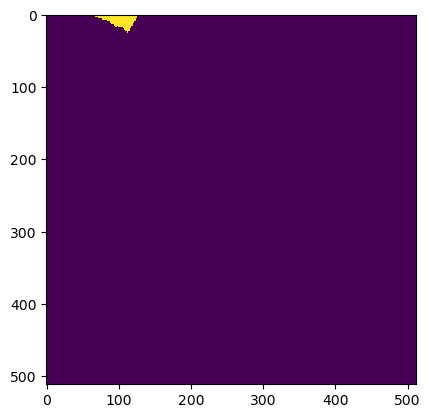

Wrote output/patches/mask/UU_S1_216-466230-4000-6320814-4000.tiff (512 x 512 pixels)


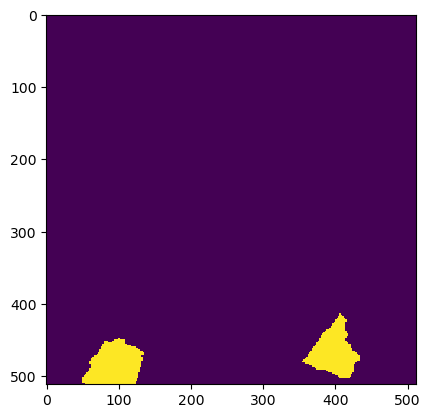

Wrote output/patches/mask/UU_S1_216-466230-4000-6320916-8000.tiff (512 x 512 pixels)
Zone UU_S1_217 Building Mask...


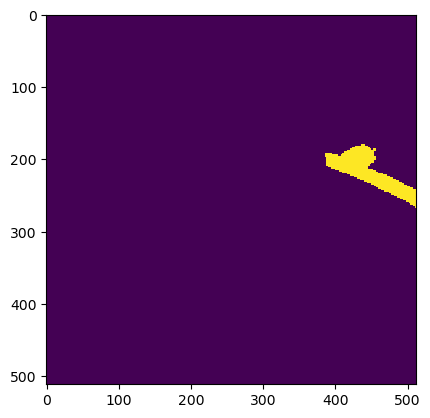

Wrote output/patches/mask/UU_S1_217-498128-0000-6322862-4000.tiff (512 x 512 pixels)


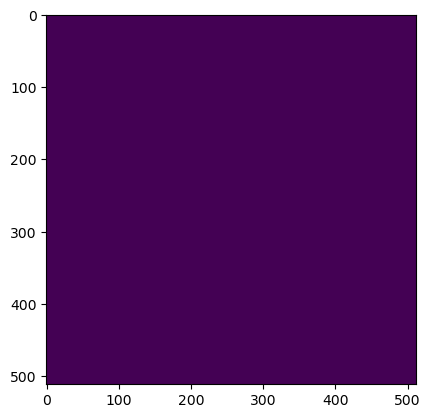

Wrote output/patches/mask/UU_S1_217-498128-0000-6322964-8000.tiff (512 x 512 pixels)


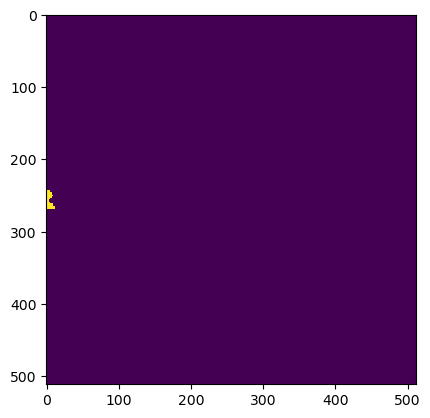

Wrote output/patches/mask/UU_S1_217-498230-4000-6322862-4000.tiff (512 x 512 pixels)


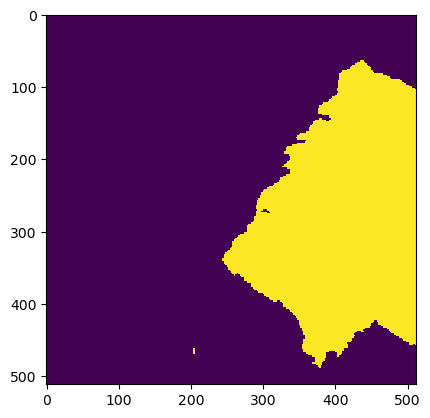

Wrote output/patches/mask/UU_S1_217-498230-4000-6322964-8000.tiff (512 x 512 pixels)
Zone UC_S1_218 Building Mask...


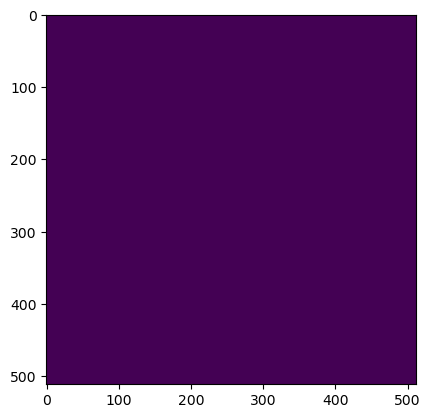

Wrote output/patches/mask/UC_S1_218-511440-0000-6322862-4000.tiff (512 x 512 pixels)


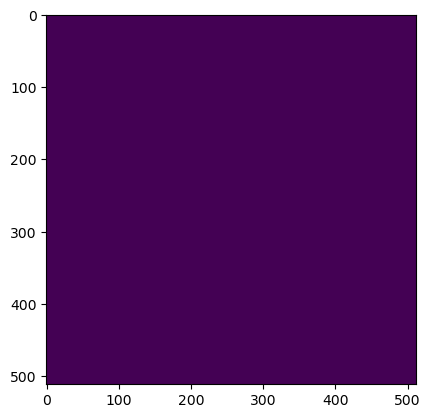

Wrote output/patches/mask/UC_S1_218-511440-0000-6322964-8000.tiff (512 x 512 pixels)


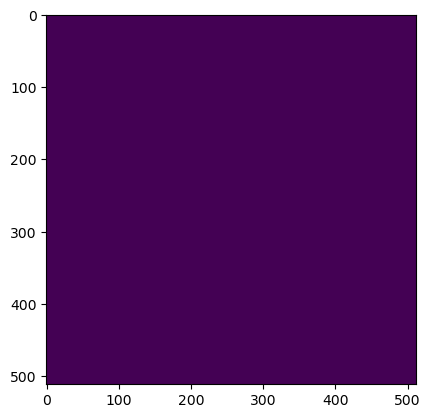

Wrote output/patches/mask/UC_S1_218-511542-4000-6322862-4000.tiff (512 x 512 pixels)


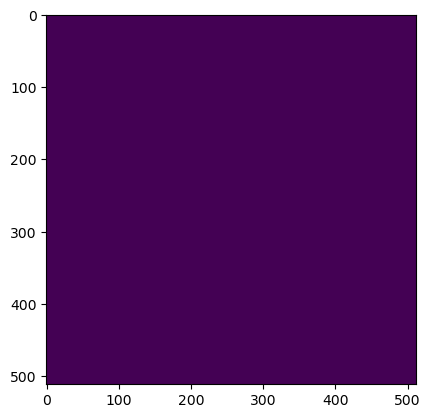

Wrote output/patches/mask/UC_S1_218-511542-4000-6322964-8000.tiff (512 x 512 pixels)
Zone CC_S1_219 Building Mask...


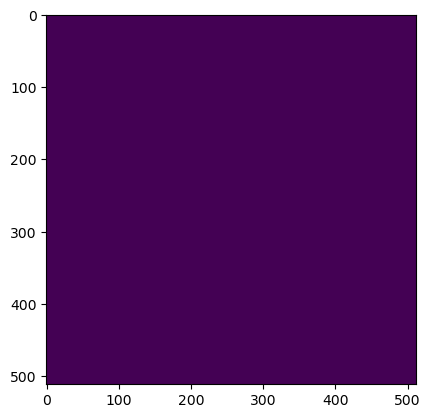

Wrote output/patches/mask/CC_S1_219-502224-0000-6322606-4000.tiff (512 x 512 pixels)


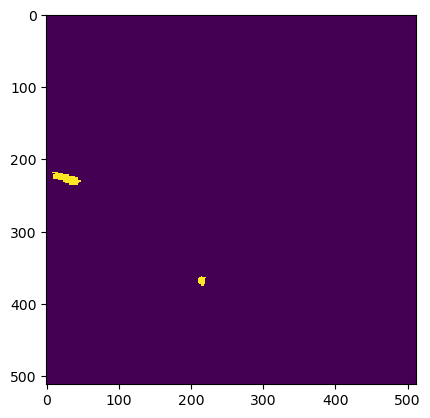

Wrote output/patches/mask/CC_S1_219-502224-0000-6322708-8000.tiff (512 x 512 pixels)


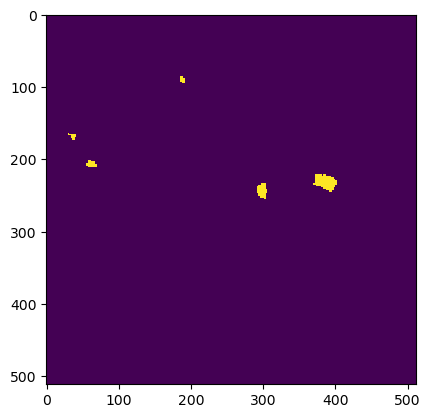

Wrote output/patches/mask/CC_S1_219-502326-4000-6322606-4000.tiff (512 x 512 pixels)


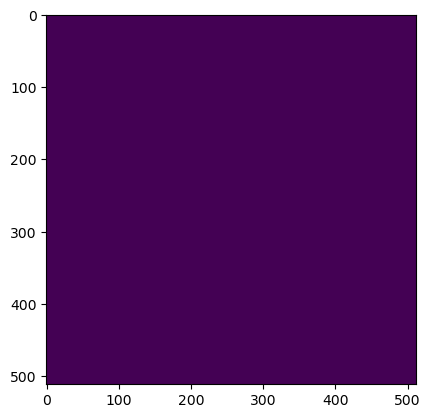

Wrote output/patches/mask/CC_S1_219-502326-4000-6322708-8000.tiff (512 x 512 pixels)
Zone CU_S1_220 Building Mask...


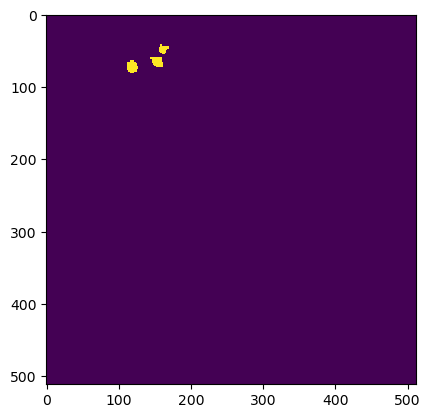

Wrote output/patches/mask/CU_S1_220-500432-0000-6322862-4000.tiff (512 x 512 pixels)


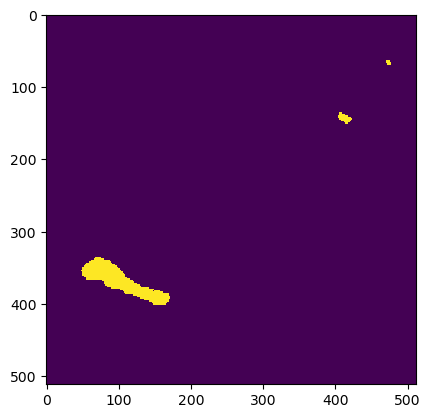

Wrote output/patches/mask/CU_S1_220-500432-0000-6322964-8000.tiff (512 x 512 pixels)


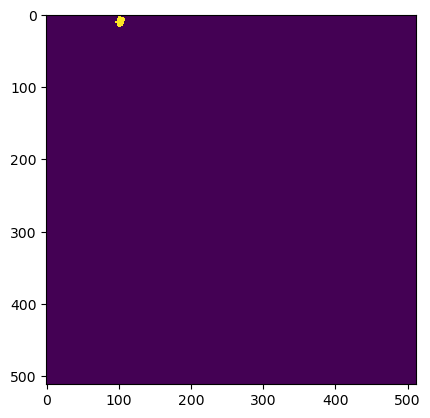

Wrote output/patches/mask/CU_S1_220-500432-0000-6323067-2000.tiff (512 x 512 pixels)


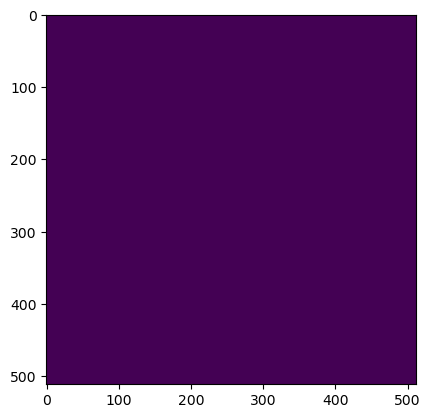

Wrote output/patches/mask/CU_S1_220-500432-0000-6323169-6000.tiff (512 x 512 pixels)


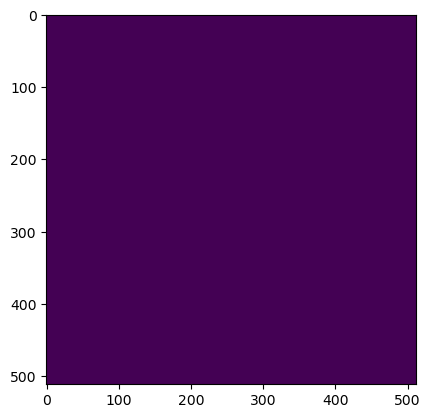

Wrote output/patches/mask/CU_S1_220-500534-4000-6322862-4000.tiff (512 x 512 pixels)


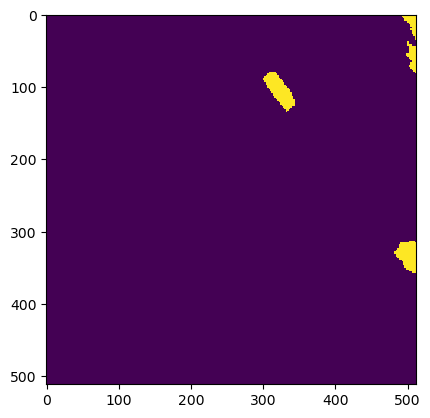

Wrote output/patches/mask/CU_S1_220-500534-4000-6322964-8000.tiff (512 x 512 pixels)


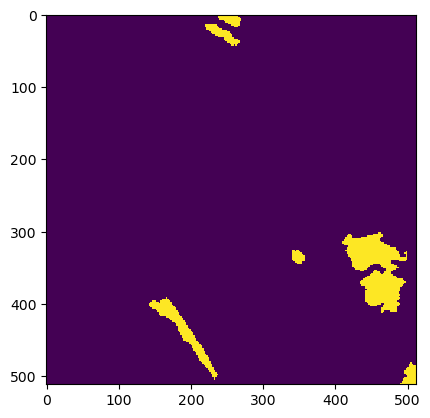

Wrote output/patches/mask/CU_S1_220-500534-4000-6323067-2000.tiff (512 x 512 pixels)


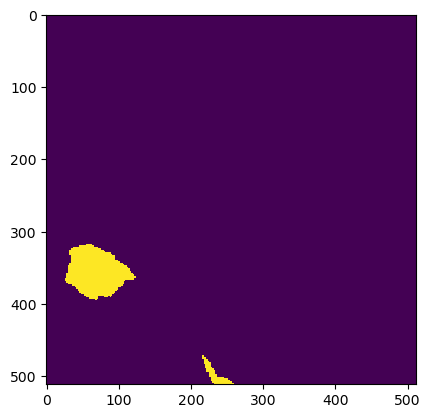

Wrote output/patches/mask/CU_S1_220-500534-4000-6323169-6000.tiff (512 x 512 pixels)
Zone VU_S1_221 Building Mask...


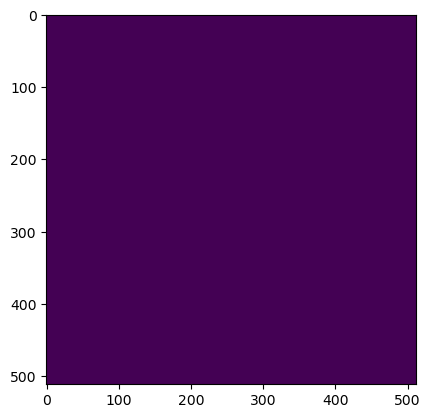

Wrote output/patches/mask/VU_S1_221-493776-0000-6323118-4000.tiff (512 x 512 pixels)


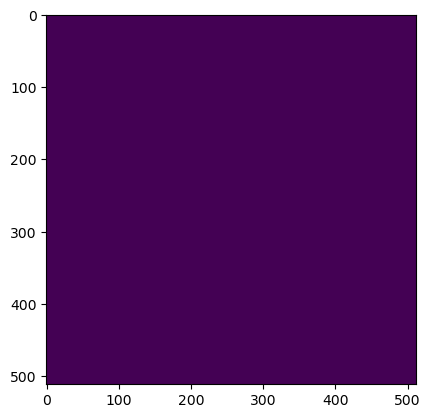

Wrote output/patches/mask/VU_S1_221-493776-0000-6323220-8000.tiff (512 x 512 pixels)


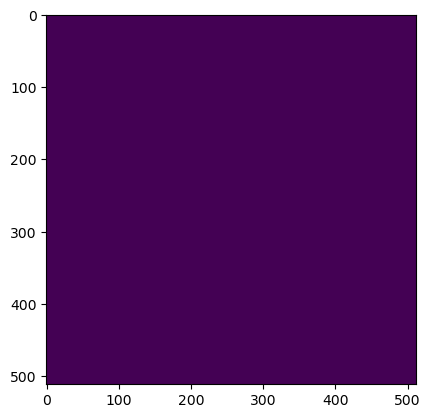

Wrote output/patches/mask/VU_S1_221-493776-0000-6323323-2000.tiff (512 x 512 pixels)


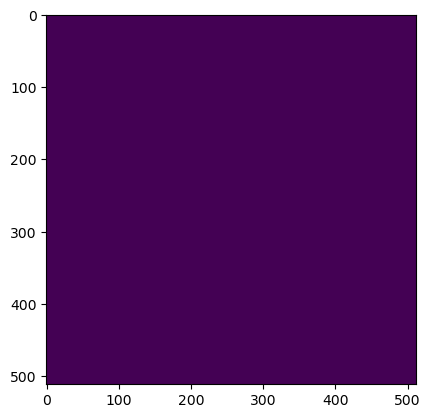

Wrote output/patches/mask/VU_S1_221-493776-0000-6323425-6000.tiff (512 x 512 pixels)


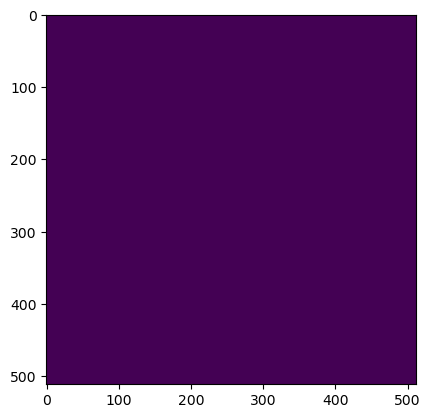

Wrote output/patches/mask/VU_S1_221-493776-0000-6323528-0000.tiff (512 x 512 pixels)


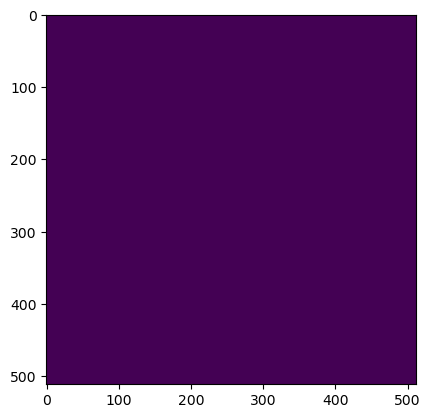

Wrote output/patches/mask/VU_S1_221-493776-0000-6323630-4000.tiff (512 x 512 pixels)


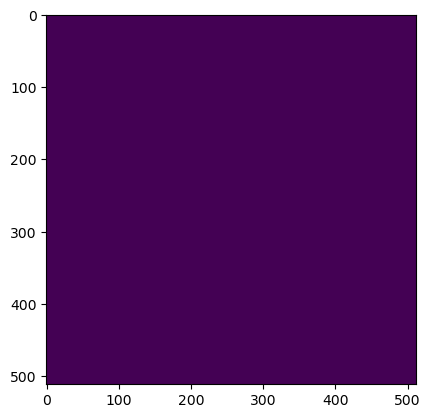

Wrote output/patches/mask/VU_S1_221-493776-0000-6323732-8000.tiff (512 x 512 pixels)


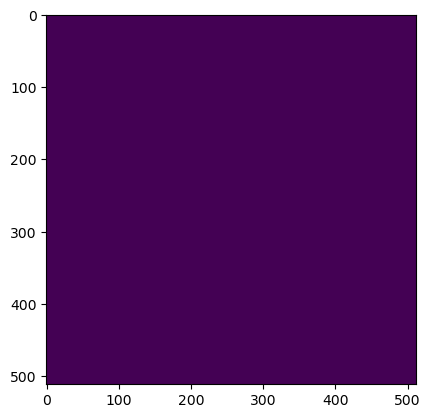

Wrote output/patches/mask/VU_S1_221-493776-0000-6323835-2000.tiff (512 x 512 pixels)


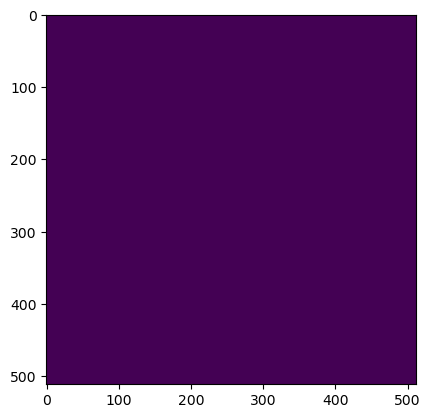

Wrote output/patches/mask/VU_S1_221-493776-0000-6323937-6000.tiff (512 x 512 pixels)


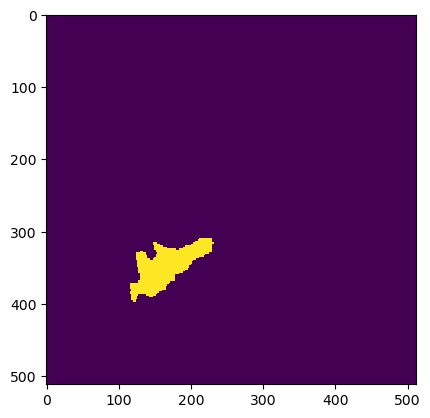

Wrote output/patches/mask/VU_S1_221-493776-0000-6324040-0000.tiff (512 x 512 pixels)


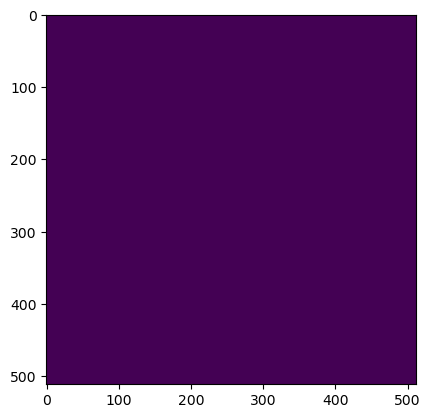

Wrote output/patches/mask/VU_S1_221-493776-0000-6324142-4000.tiff (512 x 512 pixels)


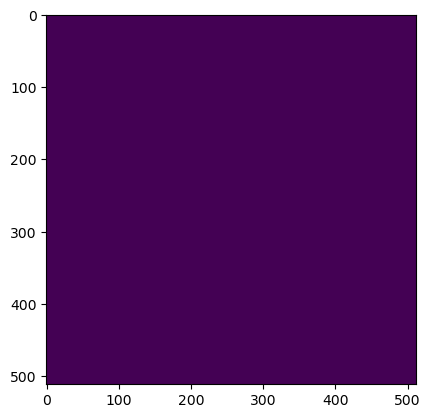

Wrote output/patches/mask/VU_S1_221-493776-0000-6324244-8000.tiff (512 x 512 pixels)


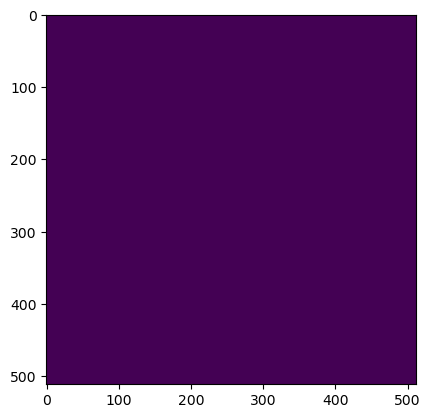

Wrote output/patches/mask/VU_S1_221-493878-4000-6323118-4000.tiff (512 x 512 pixels)


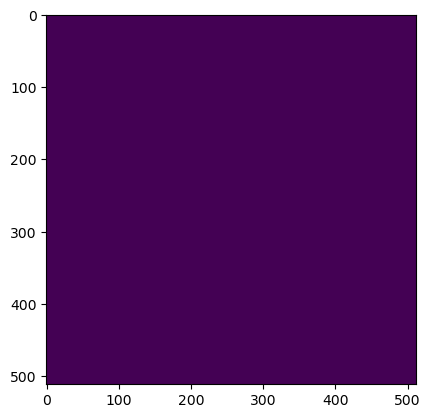

Wrote output/patches/mask/VU_S1_221-493878-4000-6323220-8000.tiff (512 x 512 pixels)


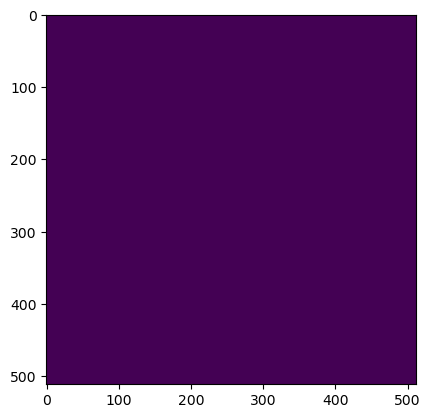

Wrote output/patches/mask/VU_S1_221-493878-4000-6323323-2000.tiff (512 x 512 pixels)


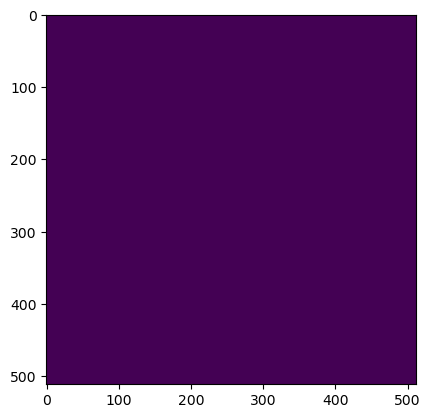

Wrote output/patches/mask/VU_S1_221-493878-4000-6323425-6000.tiff (512 x 512 pixels)


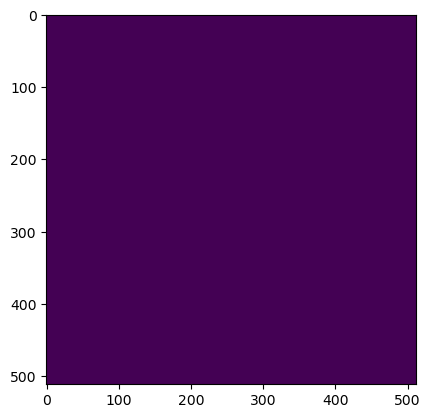

Wrote output/patches/mask/VU_S1_221-493878-4000-6323528-0000.tiff (512 x 512 pixels)


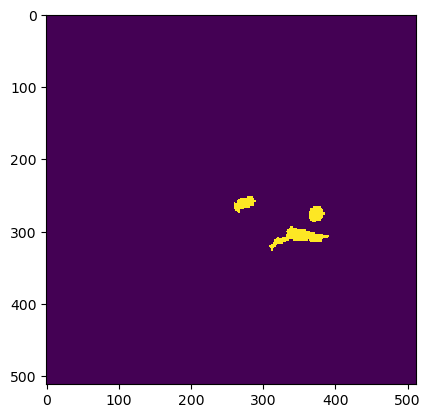

Wrote output/patches/mask/VU_S1_221-493878-4000-6323630-4000.tiff (512 x 512 pixels)


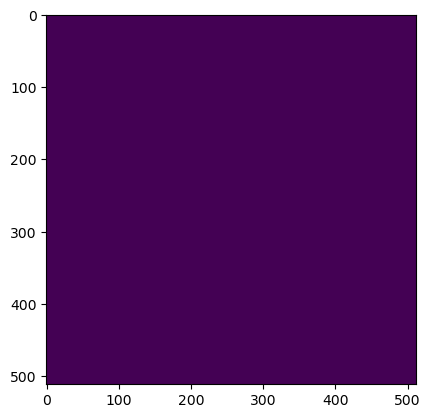

Wrote output/patches/mask/VU_S1_221-493878-4000-6323732-8000.tiff (512 x 512 pixels)


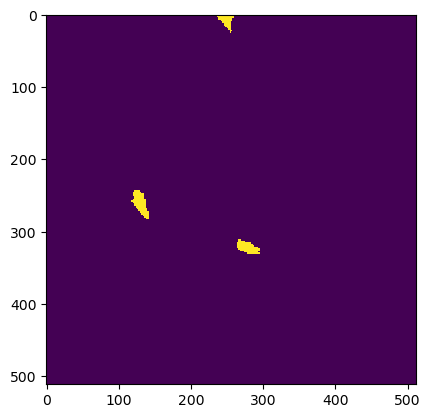

Wrote output/patches/mask/VU_S1_221-493878-4000-6323835-2000.tiff (512 x 512 pixels)


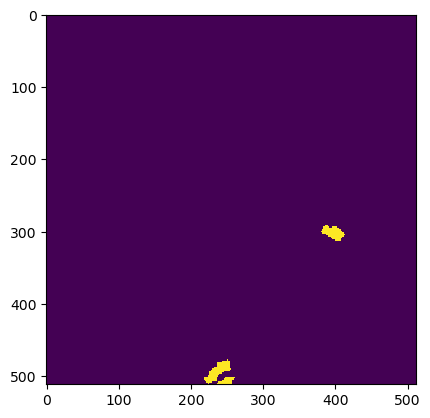

Wrote output/patches/mask/VU_S1_221-493878-4000-6323937-6000.tiff (512 x 512 pixels)


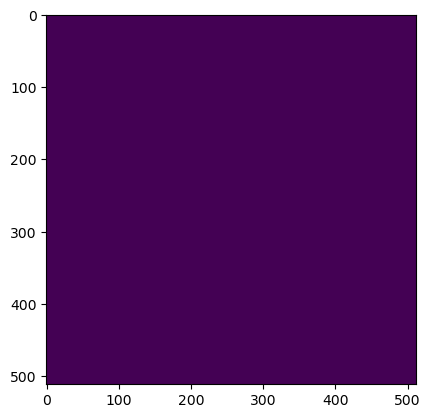

Wrote output/patches/mask/VU_S1_221-493878-4000-6324040-0000.tiff (512 x 512 pixels)


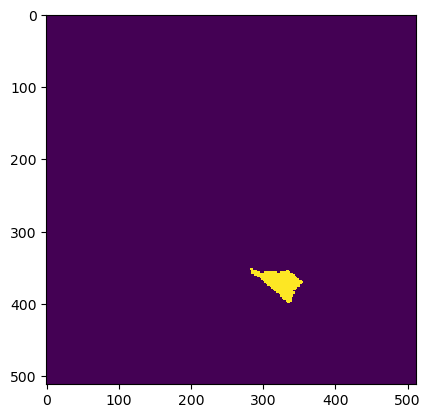

Wrote output/patches/mask/VU_S1_221-493878-4000-6324142-4000.tiff (512 x 512 pixels)


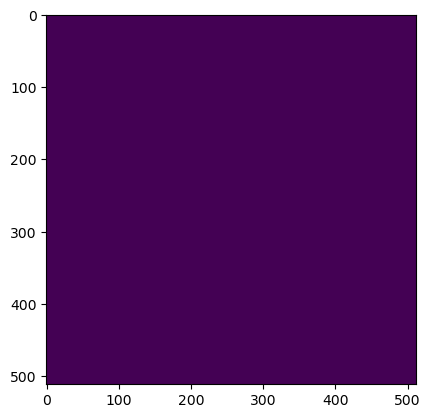

Wrote output/patches/mask/VU_S1_221-493878-4000-6324244-8000.tiff (512 x 512 pixels)


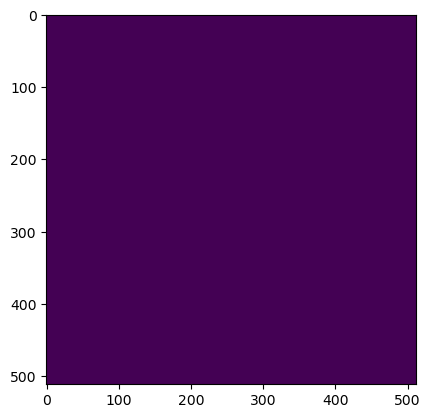

Wrote output/patches/mask/VU_S1_221-493980-8000-6323118-4000.tiff (512 x 512 pixels)


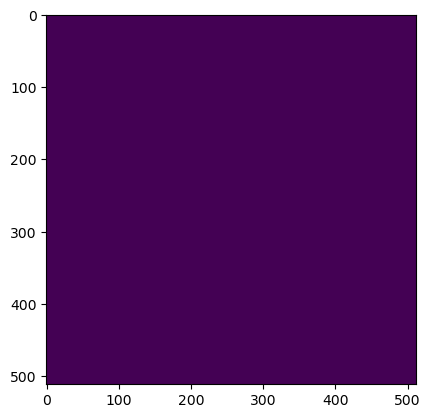

Wrote output/patches/mask/VU_S1_221-493980-8000-6323220-8000.tiff (512 x 512 pixels)


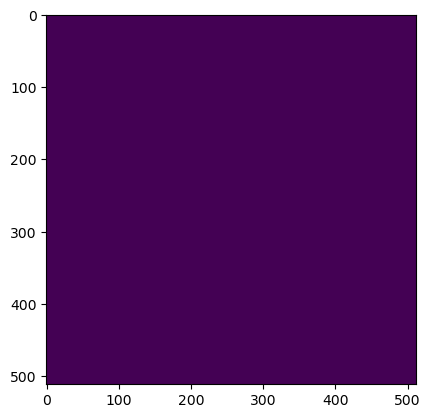

Wrote output/patches/mask/VU_S1_221-493980-8000-6323323-2000.tiff (512 x 512 pixels)


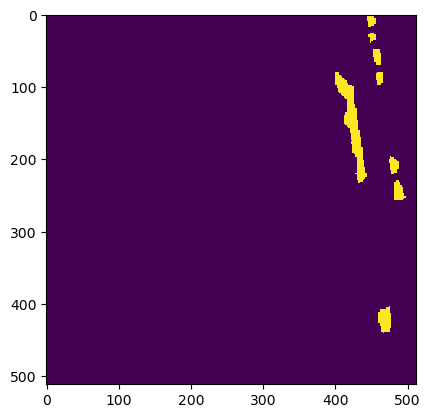

Wrote output/patches/mask/VU_S1_221-493980-8000-6323425-6000.tiff (512 x 512 pixels)


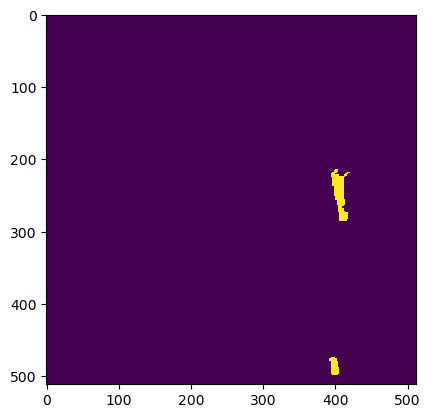

Wrote output/patches/mask/VU_S1_221-493980-8000-6323528-0000.tiff (512 x 512 pixels)


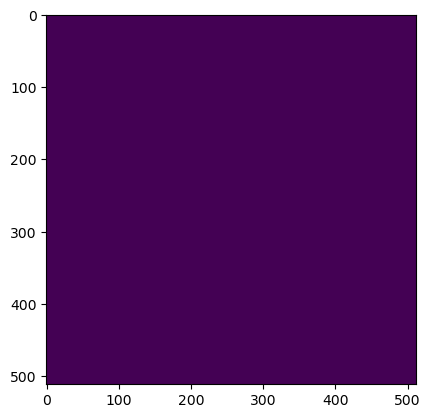

Wrote output/patches/mask/VU_S1_221-493980-8000-6323630-4000.tiff (512 x 512 pixels)


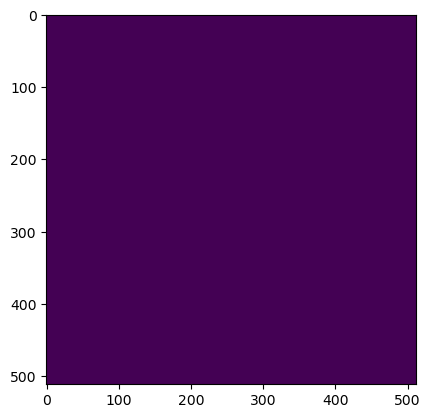

Wrote output/patches/mask/VU_S1_221-493980-8000-6323732-8000.tiff (512 x 512 pixels)


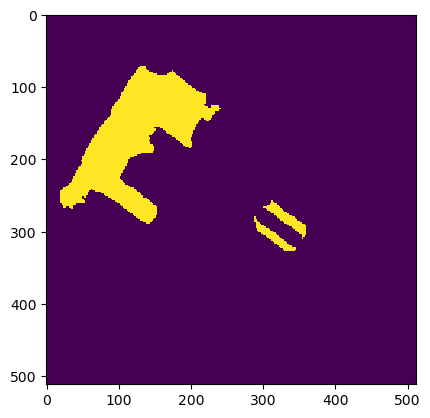

Wrote output/patches/mask/VU_S1_221-493980-8000-6323835-2000.tiff (512 x 512 pixels)


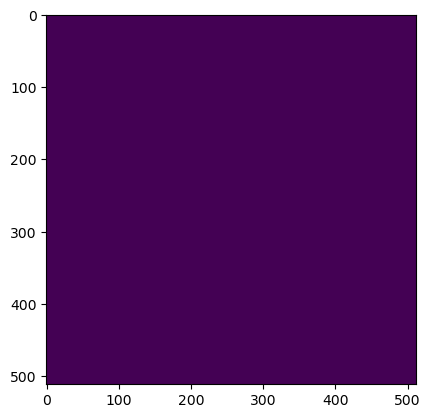

Wrote output/patches/mask/VU_S1_221-493980-8000-6323937-6000.tiff (512 x 512 pixels)


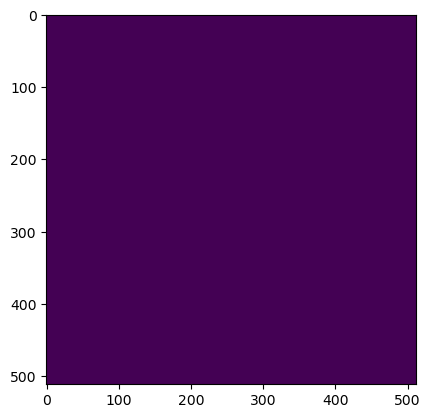

Wrote output/patches/mask/VU_S1_221-493980-8000-6324040-0000.tiff (512 x 512 pixels)


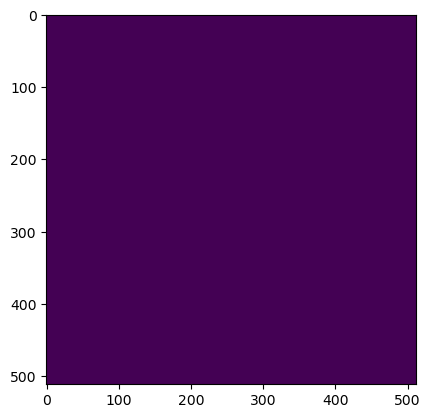

Wrote output/patches/mask/VU_S1_221-493980-8000-6324142-4000.tiff (512 x 512 pixels)


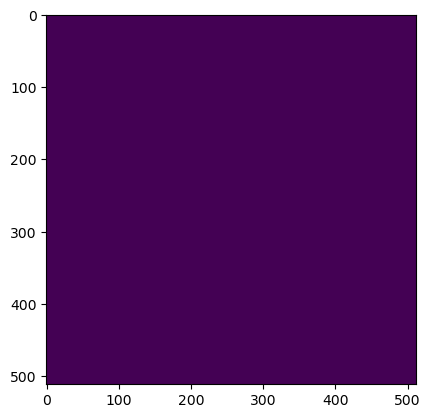

Wrote output/patches/mask/VU_S1_221-493980-8000-6324244-8000.tiff (512 x 512 pixels)


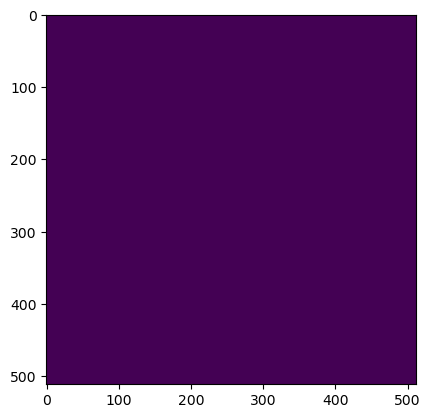

Wrote output/patches/mask/VU_S1_221-494083-2000-6323118-4000.tiff (512 x 512 pixels)


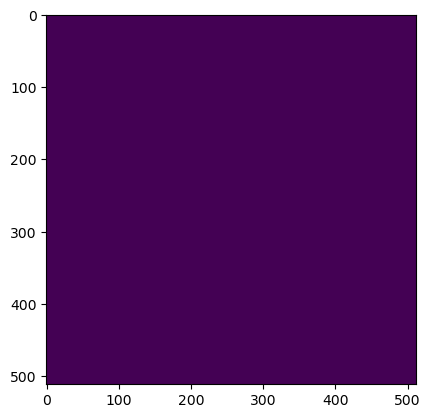

Wrote output/patches/mask/VU_S1_221-494083-2000-6323220-8000.tiff (512 x 512 pixels)


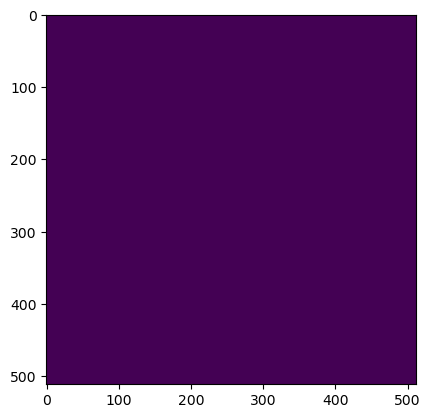

Wrote output/patches/mask/VU_S1_221-494083-2000-6323323-2000.tiff (512 x 512 pixels)


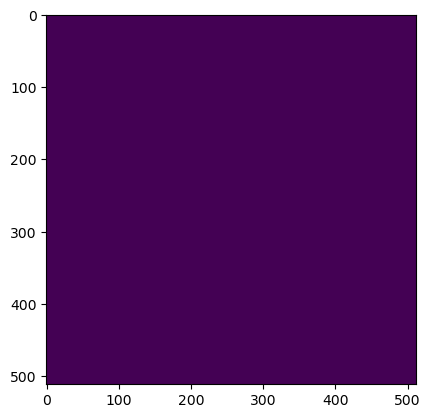

Wrote output/patches/mask/VU_S1_221-494083-2000-6323425-6000.tiff (512 x 512 pixels)


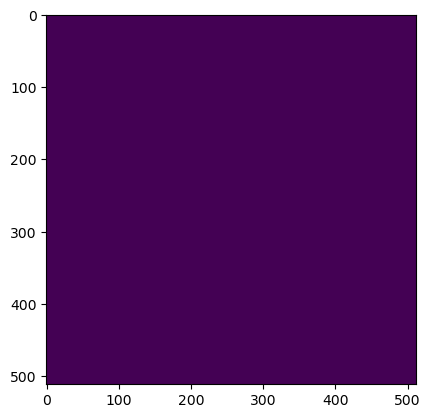

Wrote output/patches/mask/VU_S1_221-494083-2000-6323528-0000.tiff (512 x 512 pixels)


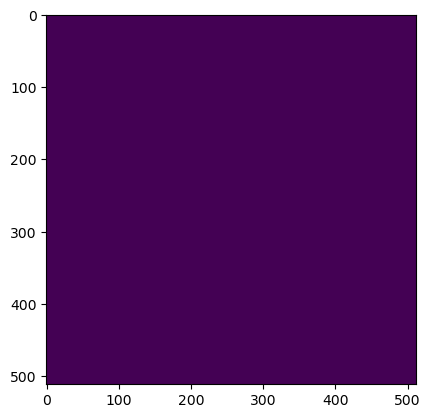

Wrote output/patches/mask/VU_S1_221-494083-2000-6323630-4000.tiff (512 x 512 pixels)


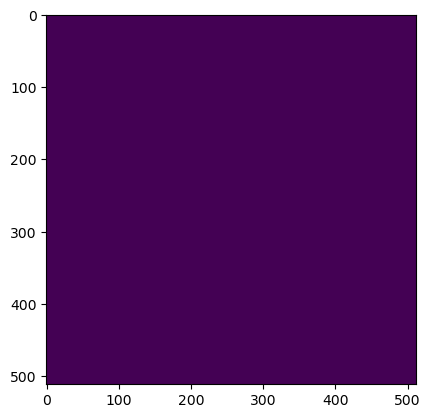

Wrote output/patches/mask/VU_S1_221-494083-2000-6323732-8000.tiff (512 x 512 pixels)


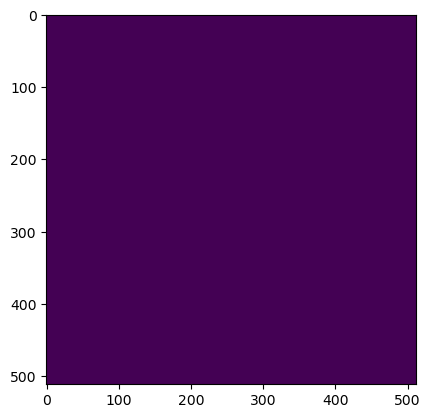

Wrote output/patches/mask/VU_S1_221-494083-2000-6323835-2000.tiff (512 x 512 pixels)


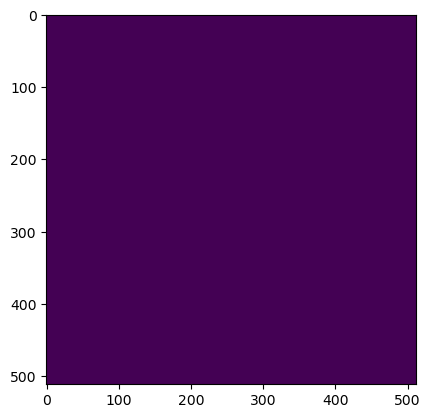

Wrote output/patches/mask/VU_S1_221-494083-2000-6323937-6000.tiff (512 x 512 pixels)


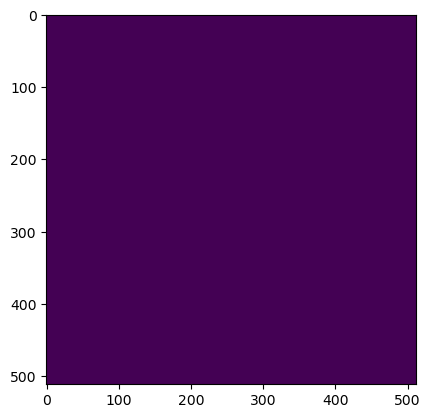

Wrote output/patches/mask/VU_S1_221-494083-2000-6324040-0000.tiff (512 x 512 pixels)


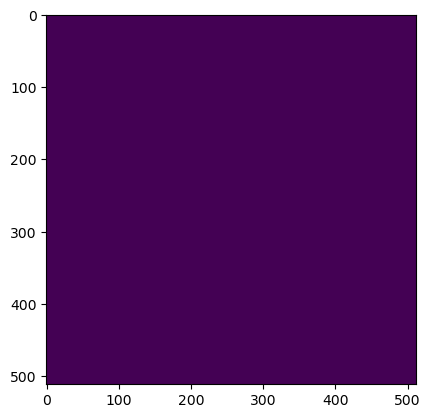

Wrote output/patches/mask/VU_S1_221-494083-2000-6324142-4000.tiff (512 x 512 pixels)


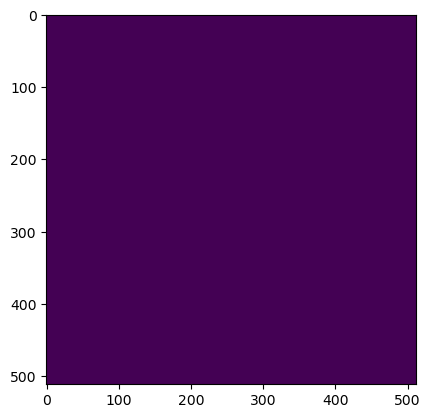

Wrote output/patches/mask/VU_S1_221-494083-2000-6324244-8000.tiff (512 x 512 pixels)
Zone VC_S1_222 Building Mask...


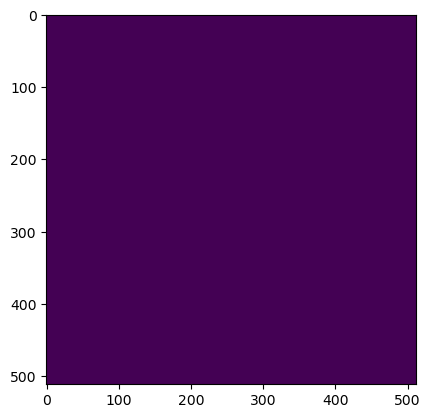

Wrote output/patches/mask/VC_S1_222-477136-0000-6323374-4000.tiff (512 x 512 pixels)


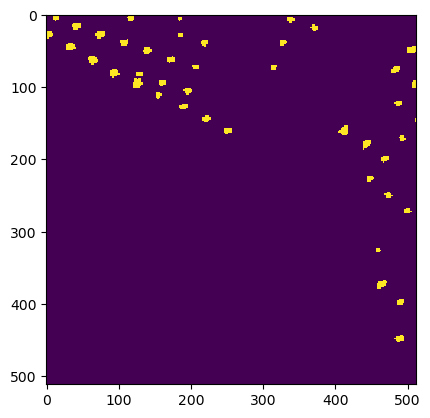

Wrote output/patches/mask/VC_S1_222-477136-0000-6323476-8000.tiff (512 x 512 pixels)


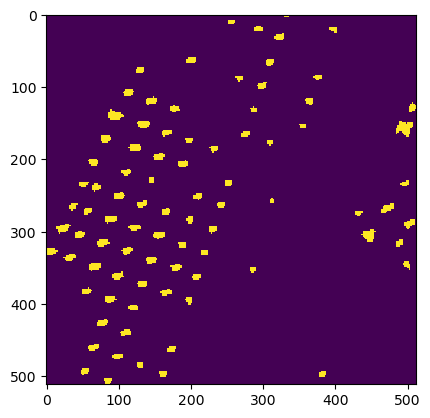

Wrote output/patches/mask/VC_S1_222-477136-0000-6323579-2000.tiff (512 x 512 pixels)


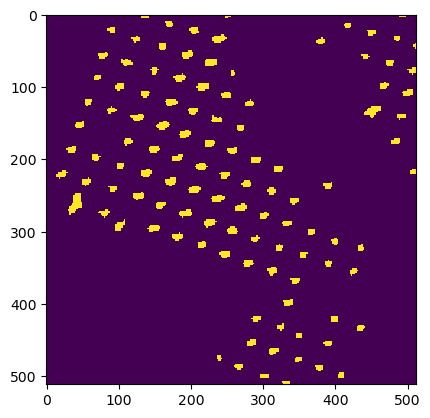

Wrote output/patches/mask/VC_S1_222-477136-0000-6323681-6000.tiff (512 x 512 pixels)


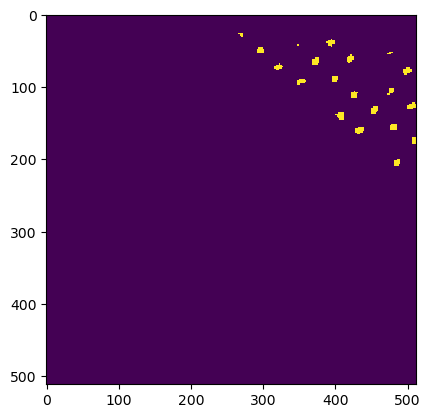

Wrote output/patches/mask/VC_S1_222-477238-4000-6323374-4000.tiff (512 x 512 pixels)


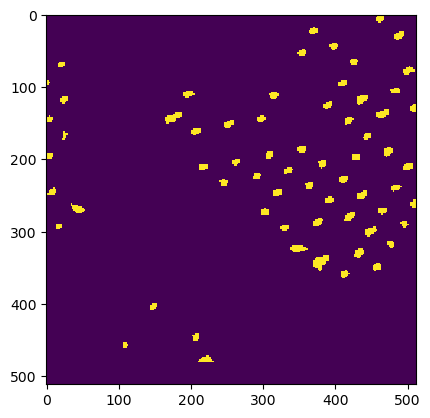

Wrote output/patches/mask/VC_S1_222-477238-4000-6323476-8000.tiff (512 x 512 pixels)


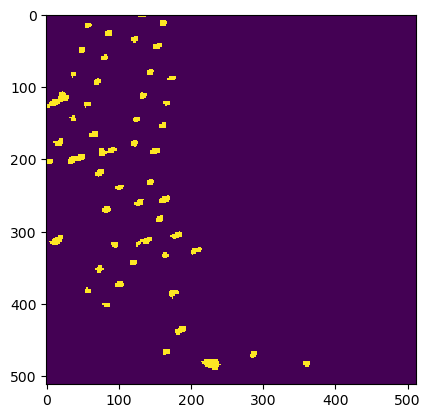

Wrote output/patches/mask/VC_S1_222-477238-4000-6323579-2000.tiff (512 x 512 pixels)


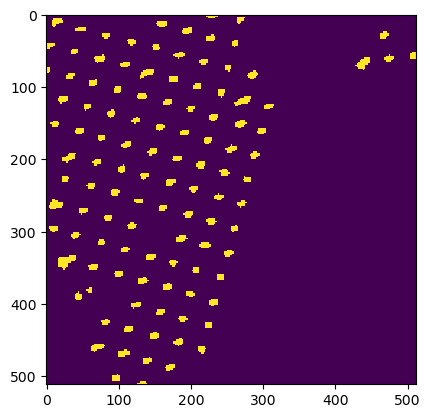

Wrote output/patches/mask/VC_S1_222-477238-4000-6323681-6000.tiff (512 x 512 pixels)


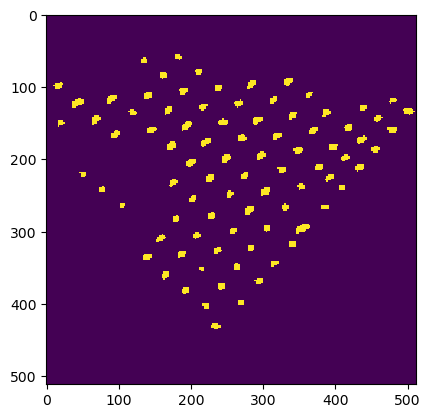

Wrote output/patches/mask/VC_S1_222-477340-8000-6323374-4000.tiff (512 x 512 pixels)


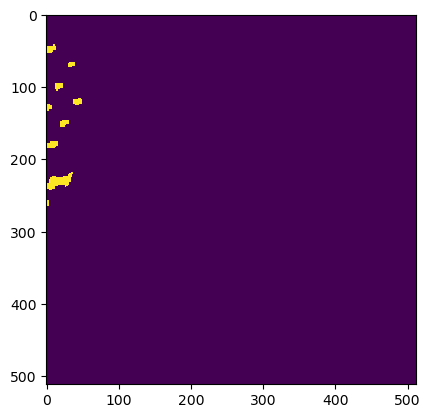

Wrote output/patches/mask/VC_S1_222-477340-8000-6323476-8000.tiff (512 x 512 pixels)


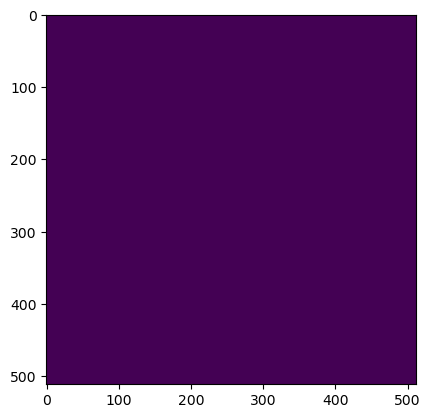

Wrote output/patches/mask/VC_S1_222-477340-8000-6323579-2000.tiff (512 x 512 pixels)


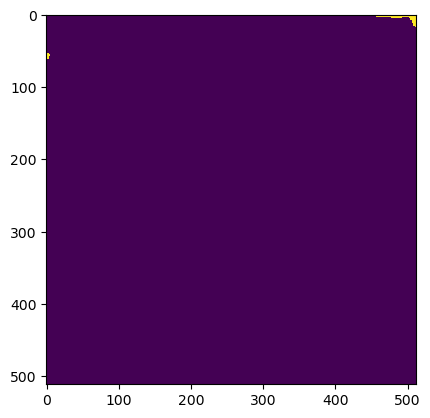

Wrote output/patches/mask/VC_S1_222-477340-8000-6323681-6000.tiff (512 x 512 pixels)


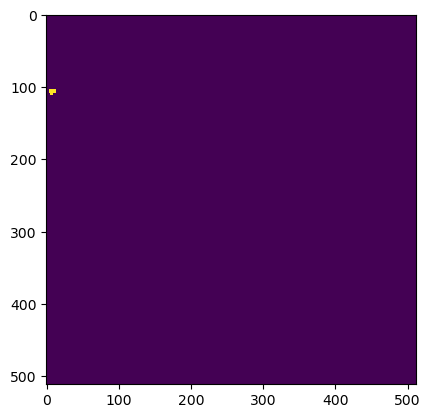

Wrote output/patches/mask/VC_S1_222-477443-2000-6323374-4000.tiff (512 x 512 pixels)


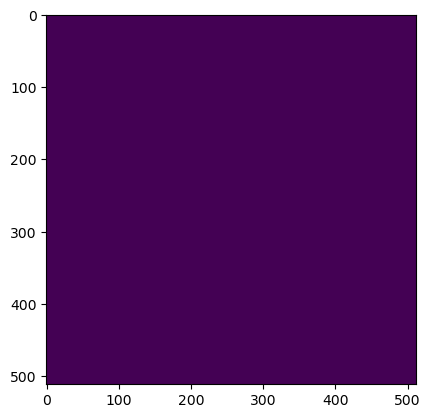

Wrote output/patches/mask/VC_S1_222-477443-2000-6323476-8000.tiff (512 x 512 pixels)


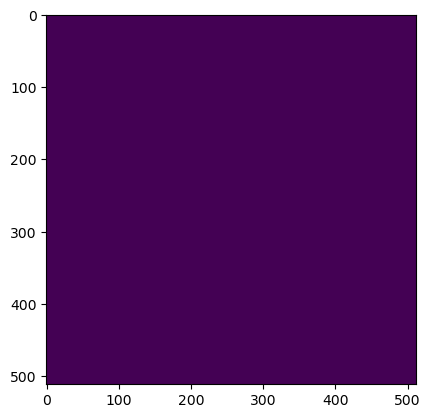

Wrote output/patches/mask/VC_S1_222-477443-2000-6323579-2000.tiff (512 x 512 pixels)


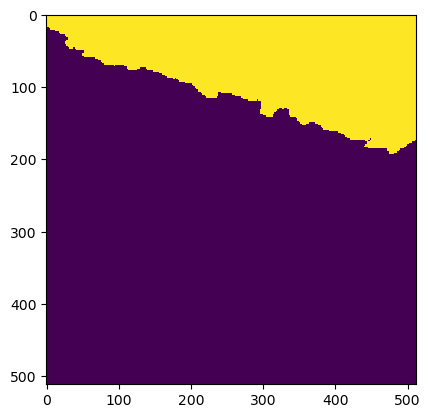

Wrote output/patches/mask/VC_S1_222-477443-2000-6323681-6000.tiff (512 x 512 pixels)
Zone UU_S1_223 Building Mask...


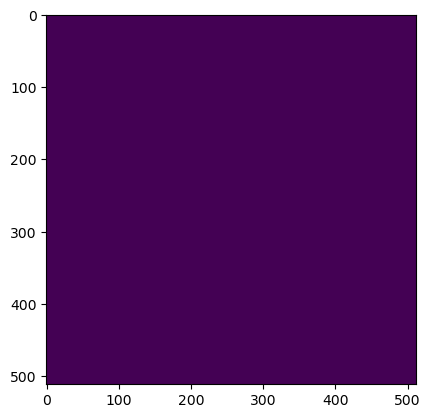

Wrote output/patches/mask/UU_S1_223-468688-0000-6323886-4000.tiff (512 x 512 pixels)


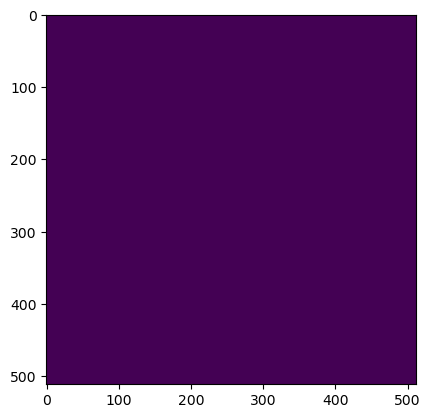

Wrote output/patches/mask/UU_S1_223-468688-0000-6323988-8000.tiff (512 x 512 pixels)


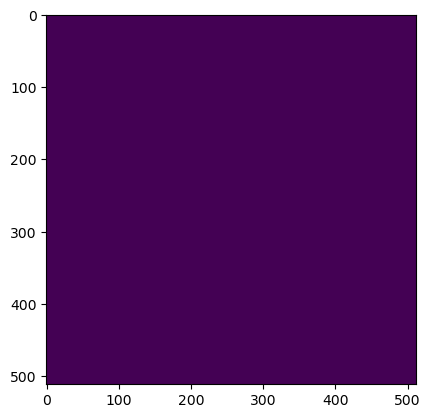

Wrote output/patches/mask/UU_S1_223-468790-4000-6323886-4000.tiff (512 x 512 pixels)


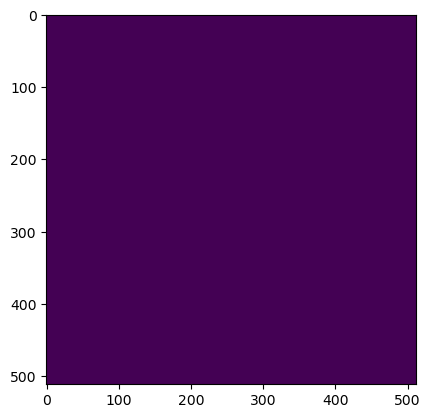

Wrote output/patches/mask/UU_S1_223-468790-4000-6323988-8000.tiff (512 x 512 pixels)


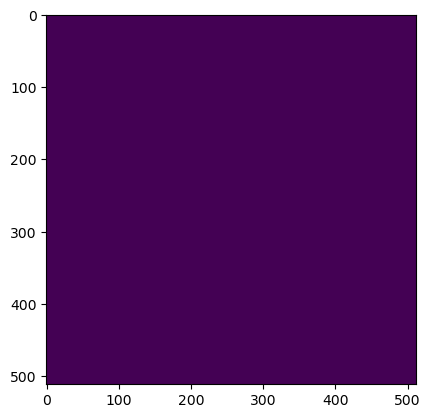

Wrote output/patches/mask/UU_S1_223-468892-8000-6323886-4000.tiff (512 x 512 pixels)


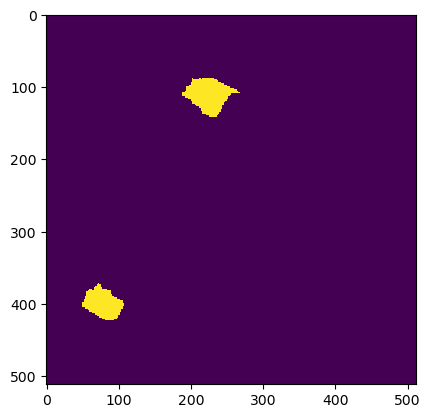

Wrote output/patches/mask/UU_S1_223-468892-8000-6323988-8000.tiff (512 x 512 pixels)


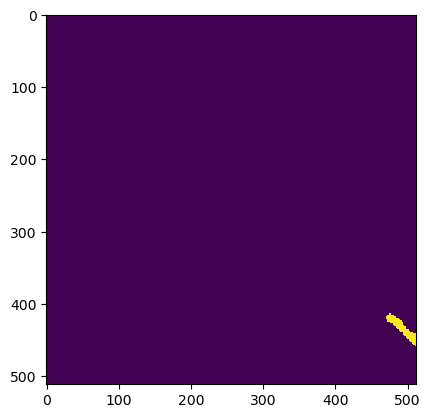

Wrote output/patches/mask/UU_S1_223-468995-2000-6323886-4000.tiff (512 x 512 pixels)


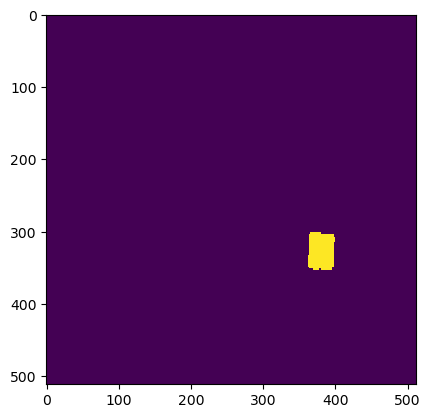

Wrote output/patches/mask/UU_S1_223-468995-2000-6323988-8000.tiff (512 x 512 pixels)
Zone UU_S1_224 Building Mask...


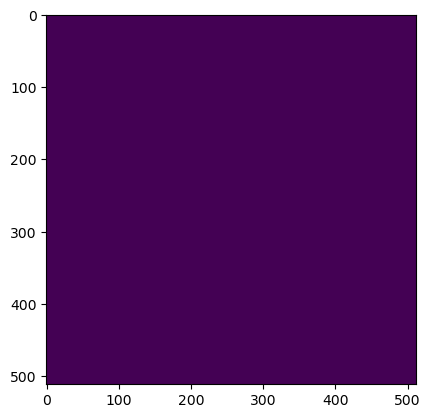

Wrote output/patches/mask/UU_S1_224-467152-0000-6323886-4000.tiff (512 x 512 pixels)


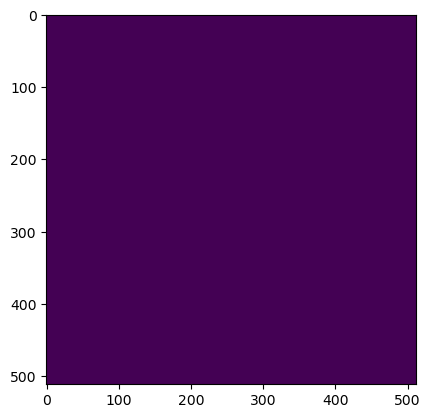

Wrote output/patches/mask/UU_S1_224-467152-0000-6323988-8000.tiff (512 x 512 pixels)


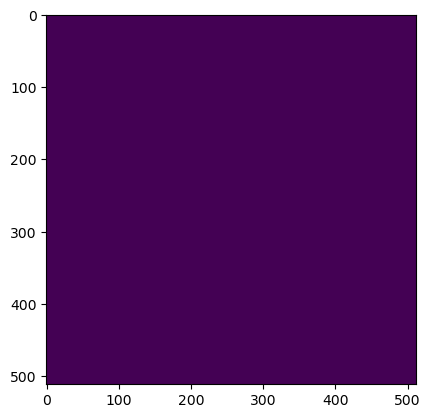

Wrote output/patches/mask/UU_S1_224-467254-4000-6323886-4000.tiff (512 x 512 pixels)


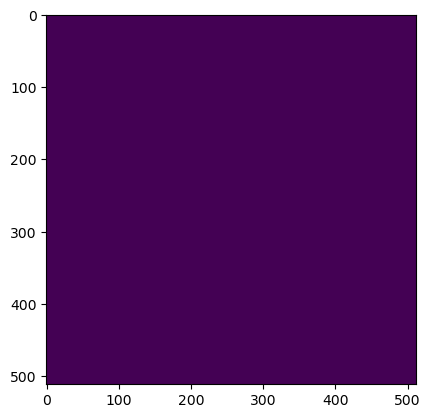

Wrote output/patches/mask/UU_S1_224-467254-4000-6323988-8000.tiff (512 x 512 pixels)
Zone UC_S1_225 Building Mask...


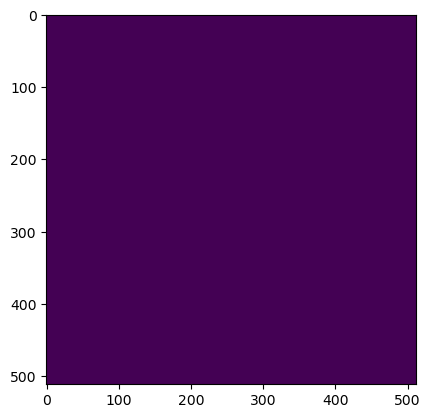

Wrote output/patches/mask/UC_S1_225-487376-0000-6326446-4000.tiff (512 x 512 pixels)


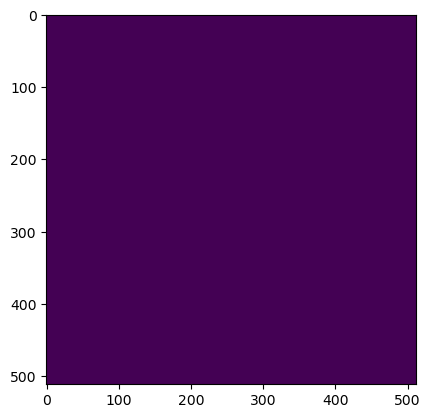

Wrote output/patches/mask/UC_S1_225-487376-0000-6326548-8000.tiff (512 x 512 pixels)


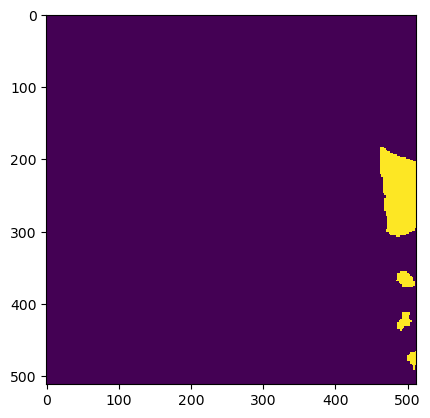

Wrote output/patches/mask/UC_S1_225-487478-4000-6326446-4000.tiff (512 x 512 pixels)


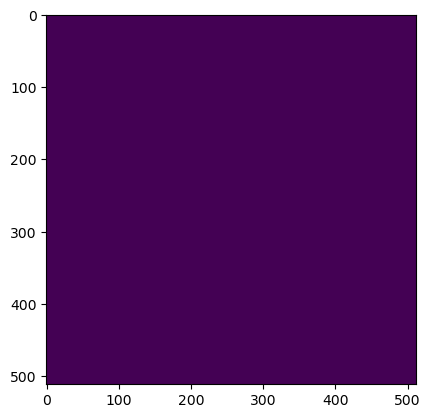

Wrote output/patches/mask/UC_S1_225-487478-4000-6326548-8000.tiff (512 x 512 pixels)


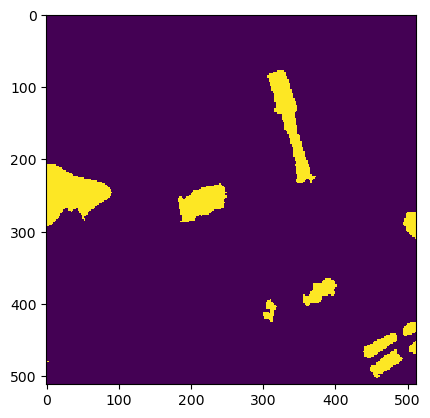

Wrote output/patches/mask/UC_S1_225-487580-8000-6326446-4000.tiff (512 x 512 pixels)


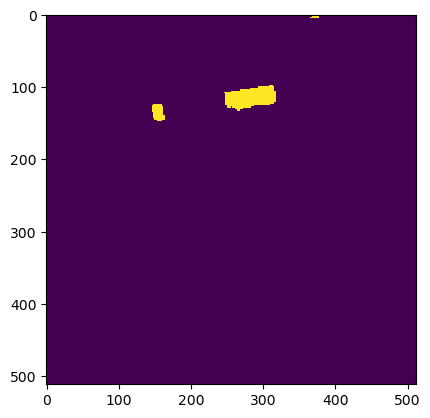

Wrote output/patches/mask/UC_S1_225-487580-8000-6326548-8000.tiff (512 x 512 pixels)


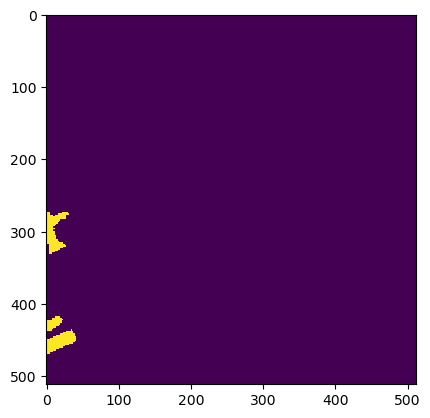

Wrote output/patches/mask/UC_S1_225-487683-2000-6326446-4000.tiff (512 x 512 pixels)


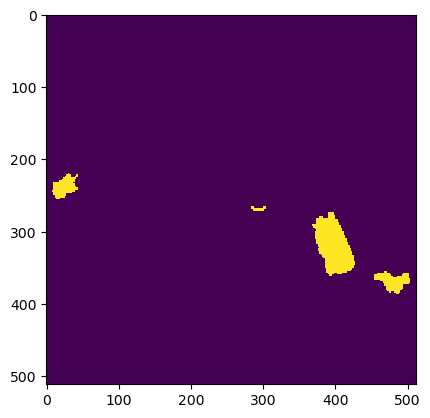

Wrote output/patches/mask/UC_S1_225-487683-2000-6326548-8000.tiff (512 x 512 pixels)
Zone CU_S1_226 Building Mask...


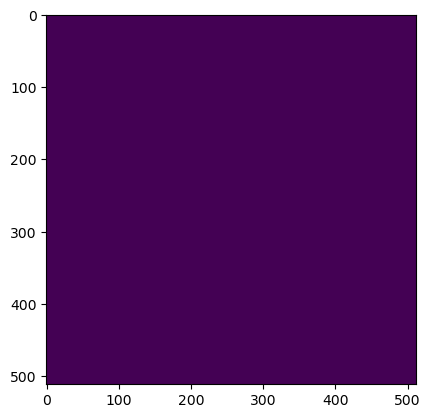

Wrote output/patches/mask/CU_S1_226-510672-0000-6328238-4000.tiff (512 x 512 pixels)


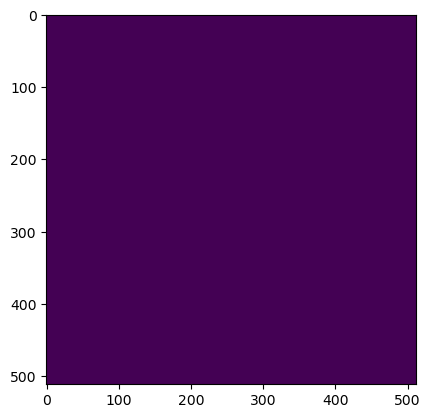

Wrote output/patches/mask/CU_S1_226-510672-0000-6328340-8000.tiff (512 x 512 pixels)


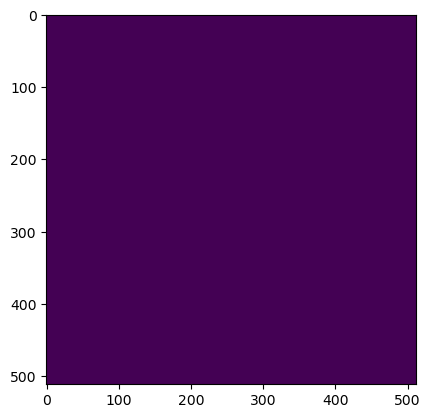

Wrote output/patches/mask/CU_S1_226-510774-4000-6328238-4000.tiff (512 x 512 pixels)


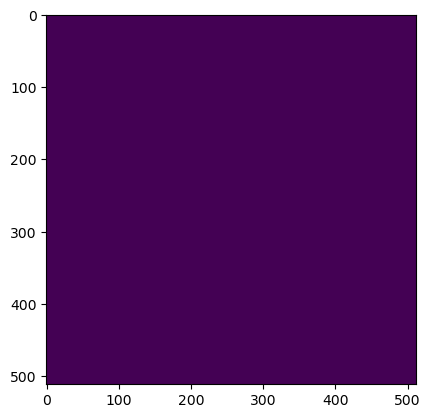

Wrote output/patches/mask/CU_S1_226-510774-4000-6328340-8000.tiff (512 x 512 pixels)
Zone UU_S1_227 Building Mask...


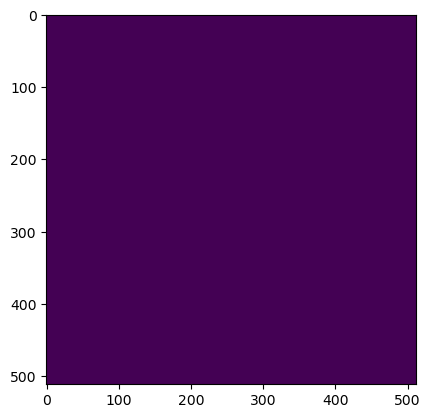

Wrote output/patches/mask/UU_S1_227-522704-0000-6329006-4000.tiff (512 x 512 pixels)


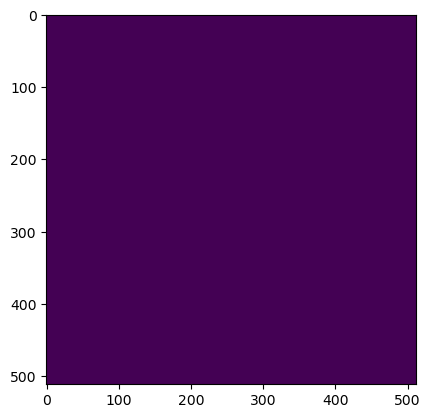

Wrote output/patches/mask/UU_S1_227-522704-0000-6329108-8000.tiff (512 x 512 pixels)


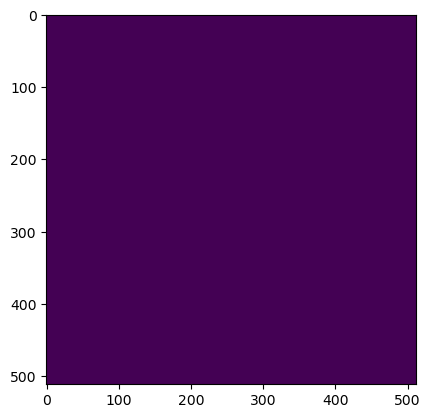

Wrote output/patches/mask/UU_S1_227-522704-0000-6329211-2000.tiff (512 x 512 pixels)


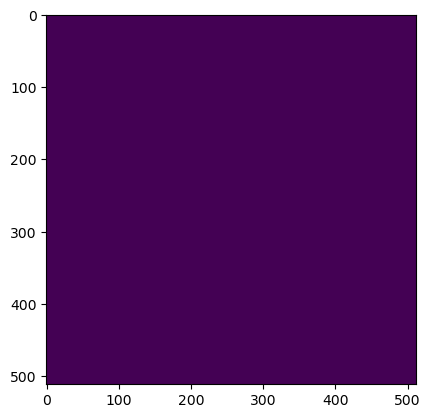

Wrote output/patches/mask/UU_S1_227-522704-0000-6329313-6000.tiff (512 x 512 pixels)


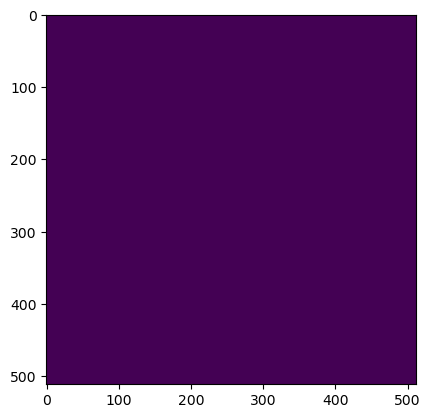

Wrote output/patches/mask/UU_S1_227-522704-0000-6329416-0000.tiff (512 x 512 pixels)


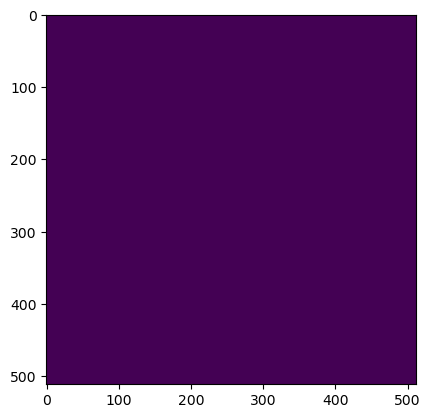

Wrote output/patches/mask/UU_S1_227-522704-0000-6329518-4000.tiff (512 x 512 pixels)


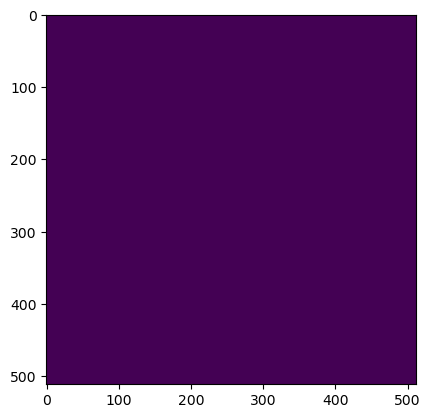

Wrote output/patches/mask/UU_S1_227-522704-0000-6329620-8000.tiff (512 x 512 pixels)


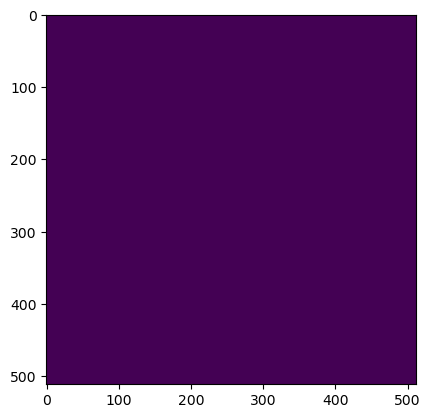

Wrote output/patches/mask/UU_S1_227-522806-4000-6329006-4000.tiff (512 x 512 pixels)


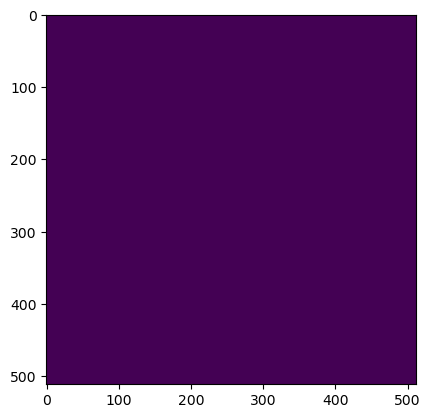

Wrote output/patches/mask/UU_S1_227-522806-4000-6329108-8000.tiff (512 x 512 pixels)


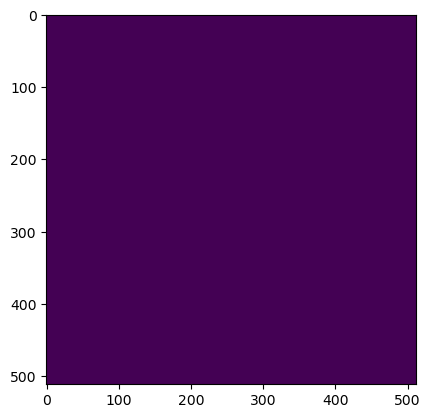

Wrote output/patches/mask/UU_S1_227-522806-4000-6329211-2000.tiff (512 x 512 pixels)


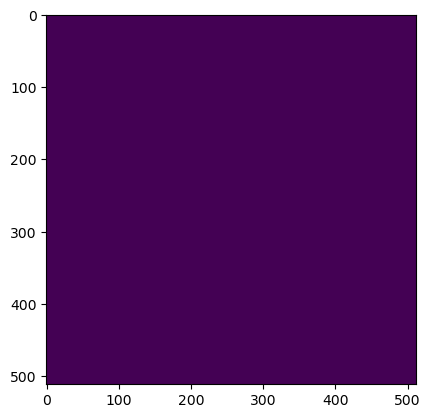

Wrote output/patches/mask/UU_S1_227-522806-4000-6329313-6000.tiff (512 x 512 pixels)


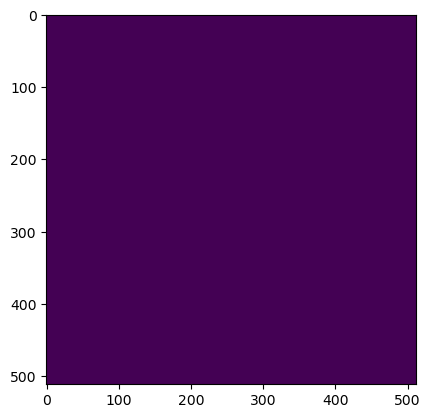

Wrote output/patches/mask/UU_S1_227-522806-4000-6329416-0000.tiff (512 x 512 pixels)


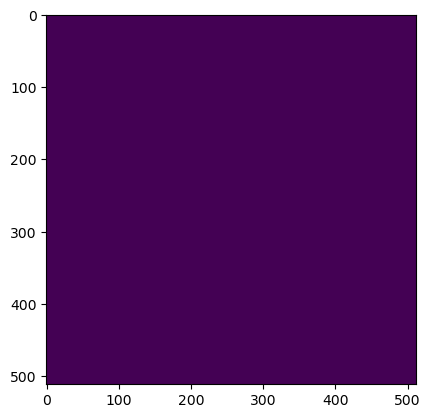

Wrote output/patches/mask/UU_S1_227-522806-4000-6329518-4000.tiff (512 x 512 pixels)


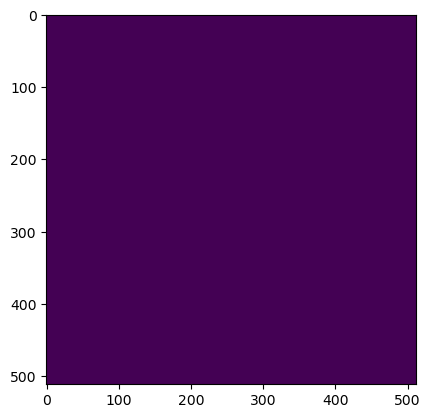

Wrote output/patches/mask/UU_S1_227-522806-4000-6329620-8000.tiff (512 x 512 pixels)


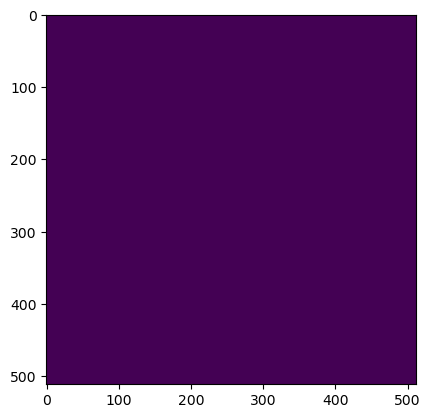

Wrote output/patches/mask/UU_S1_227-522908-8000-6329006-4000.tiff (512 x 512 pixels)


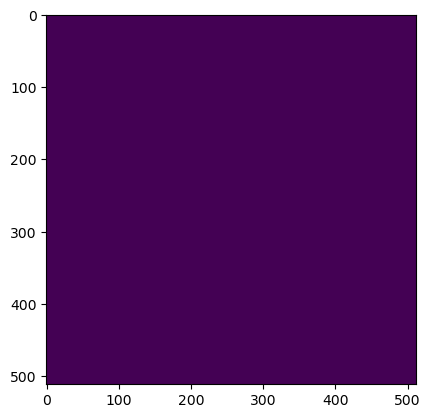

Wrote output/patches/mask/UU_S1_227-522908-8000-6329108-8000.tiff (512 x 512 pixels)


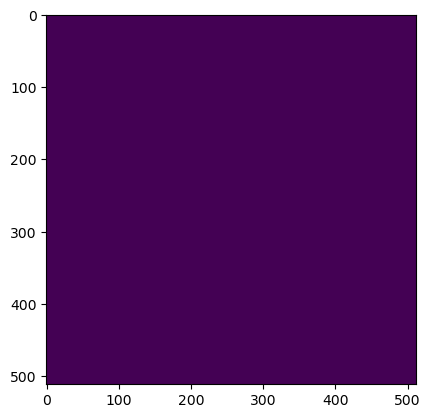

Wrote output/patches/mask/UU_S1_227-522908-8000-6329211-2000.tiff (512 x 512 pixels)


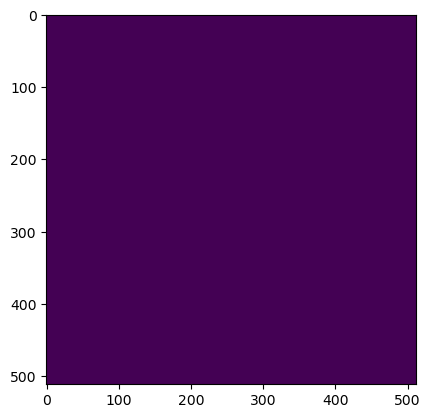

Wrote output/patches/mask/UU_S1_227-522908-8000-6329313-6000.tiff (512 x 512 pixels)


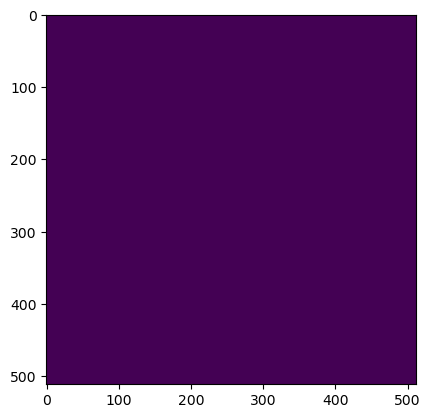

Wrote output/patches/mask/UU_S1_227-522908-8000-6329416-0000.tiff (512 x 512 pixels)


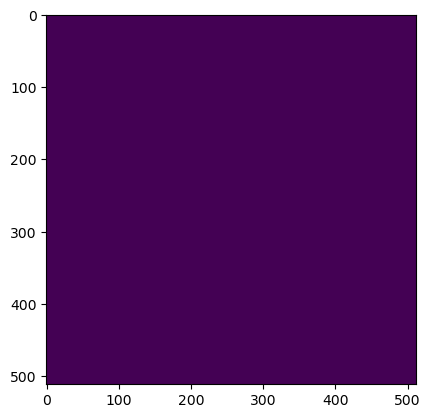

Wrote output/patches/mask/UU_S1_227-522908-8000-6329518-4000.tiff (512 x 512 pixels)


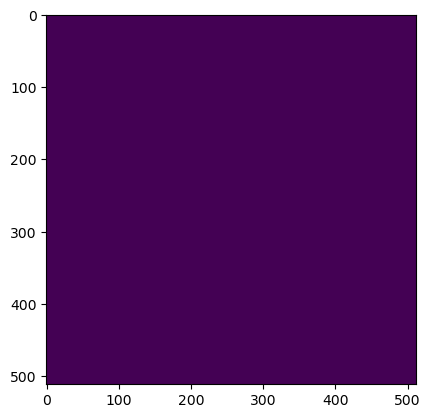

Wrote output/patches/mask/UU_S1_227-522908-8000-6329620-8000.tiff (512 x 512 pixels)


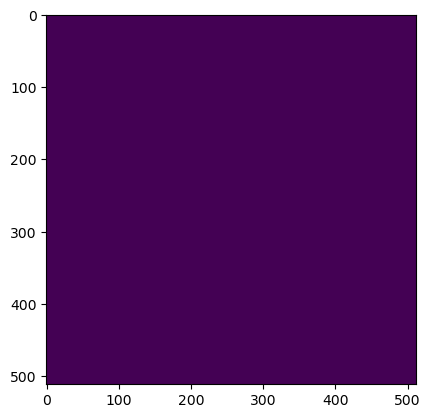

Wrote output/patches/mask/UU_S1_227-523011-2000-6329006-4000.tiff (512 x 512 pixels)


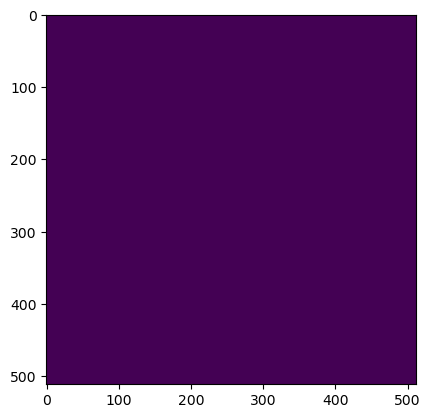

Wrote output/patches/mask/UU_S1_227-523011-2000-6329108-8000.tiff (512 x 512 pixels)


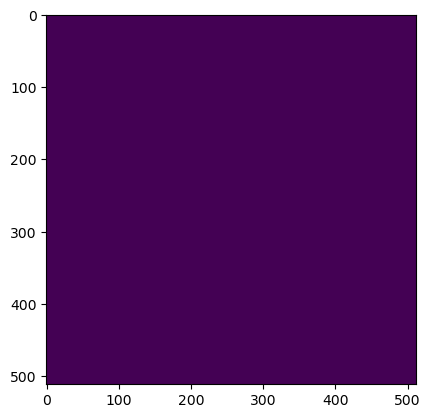

Wrote output/patches/mask/UU_S1_227-523011-2000-6329211-2000.tiff (512 x 512 pixels)


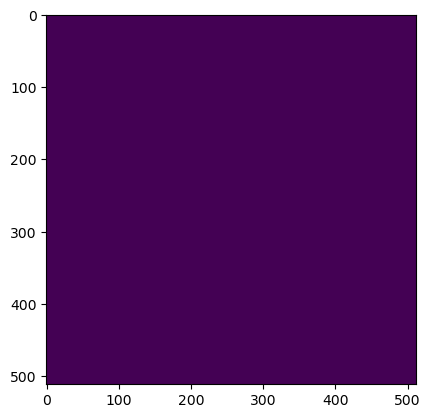

Wrote output/patches/mask/UU_S1_227-523011-2000-6329313-6000.tiff (512 x 512 pixels)


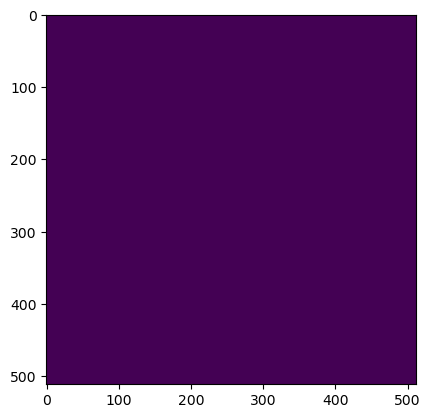

Wrote output/patches/mask/UU_S1_227-523011-2000-6329416-0000.tiff (512 x 512 pixels)


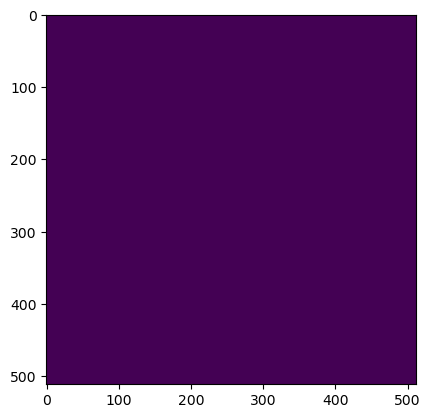

Wrote output/patches/mask/UU_S1_227-523011-2000-6329518-4000.tiff (512 x 512 pixels)


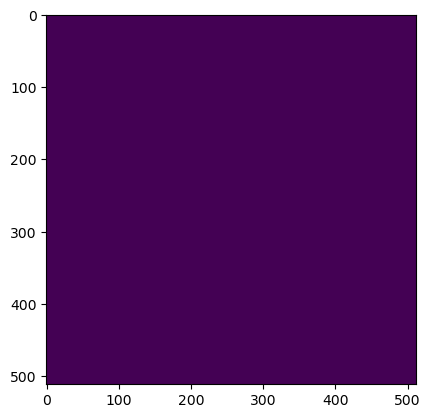

Wrote output/patches/mask/UU_S1_227-523011-2000-6329620-8000.tiff (512 x 512 pixels)


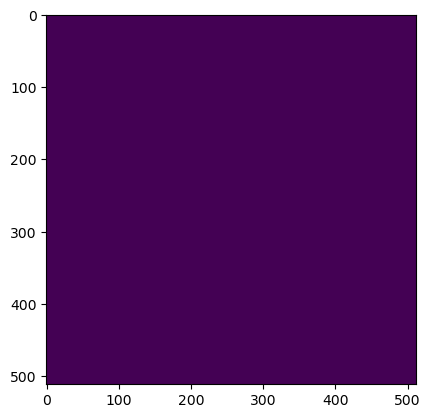

Wrote output/patches/mask/UU_S1_227-523113-6000-6329006-4000.tiff (512 x 512 pixels)


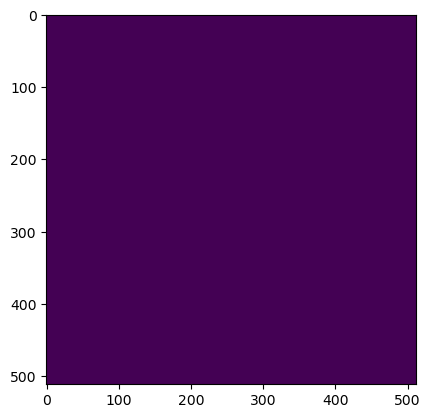

Wrote output/patches/mask/UU_S1_227-523113-6000-6329108-8000.tiff (512 x 512 pixels)


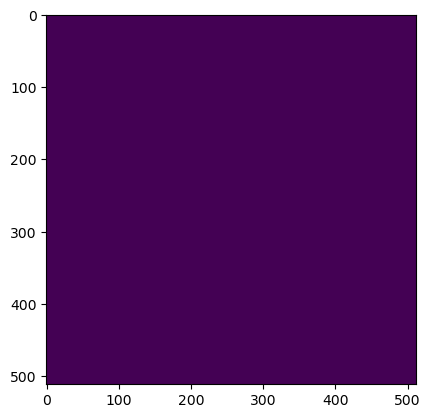

Wrote output/patches/mask/UU_S1_227-523113-6000-6329211-2000.tiff (512 x 512 pixels)


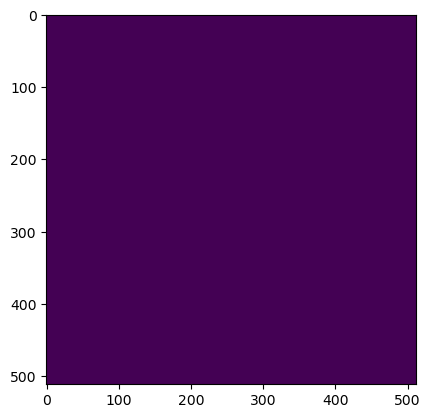

Wrote output/patches/mask/UU_S1_227-523113-6000-6329313-6000.tiff (512 x 512 pixels)


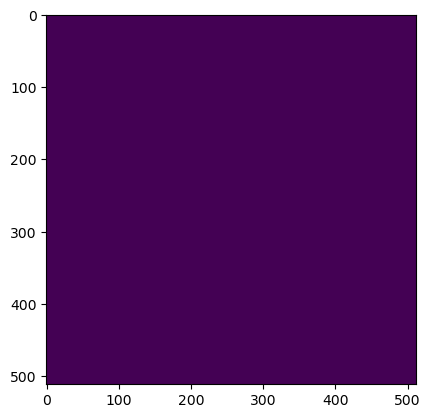

Wrote output/patches/mask/UU_S1_227-523113-6000-6329416-0000.tiff (512 x 512 pixels)


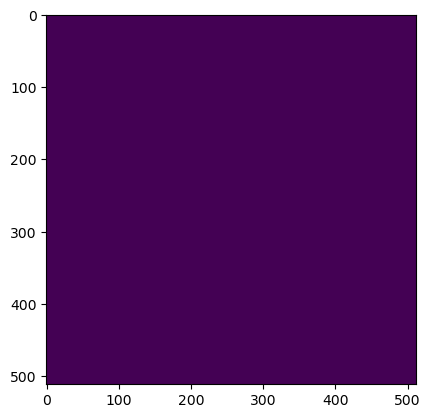

Wrote output/patches/mask/UU_S1_227-523113-6000-6329518-4000.tiff (512 x 512 pixels)


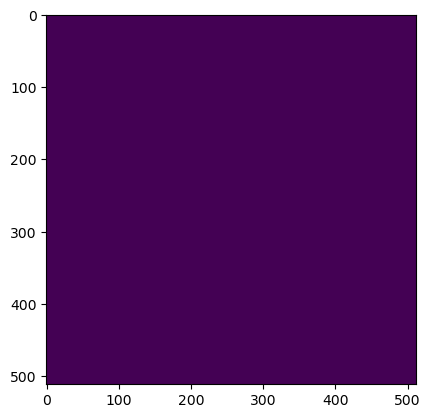

Wrote output/patches/mask/UU_S1_227-523113-6000-6329620-8000.tiff (512 x 512 pixels)


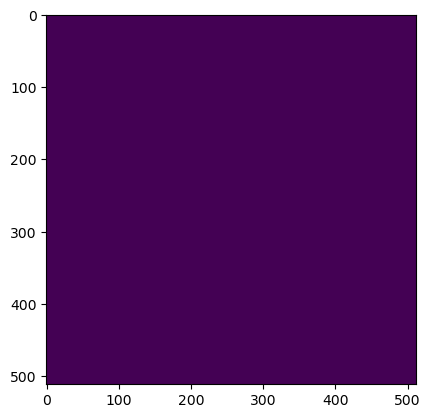

Wrote output/patches/mask/UU_S1_227-523216-0000-6329006-4000.tiff (512 x 512 pixels)


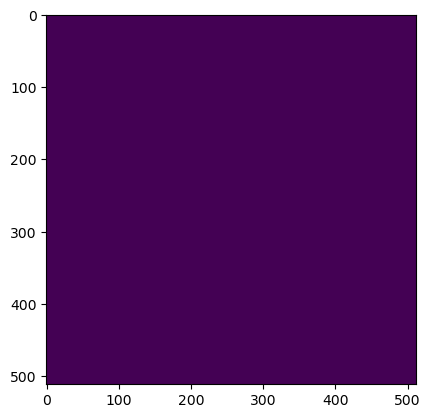

Wrote output/patches/mask/UU_S1_227-523216-0000-6329108-8000.tiff (512 x 512 pixels)


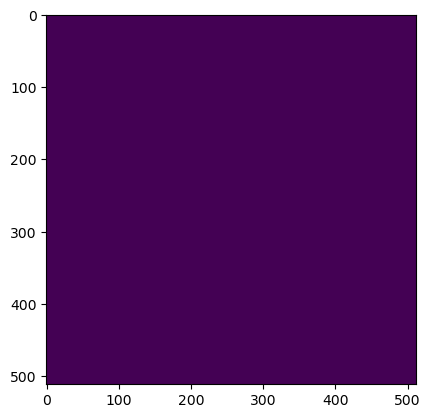

Wrote output/patches/mask/UU_S1_227-523216-0000-6329211-2000.tiff (512 x 512 pixels)


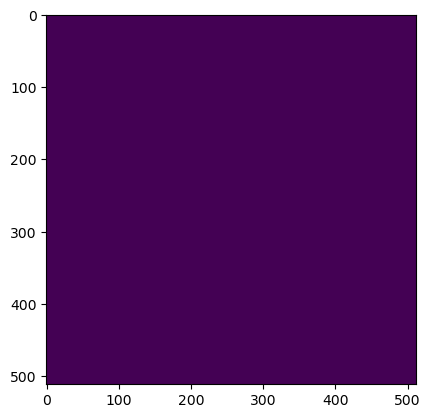

Wrote output/patches/mask/UU_S1_227-523216-0000-6329313-6000.tiff (512 x 512 pixels)


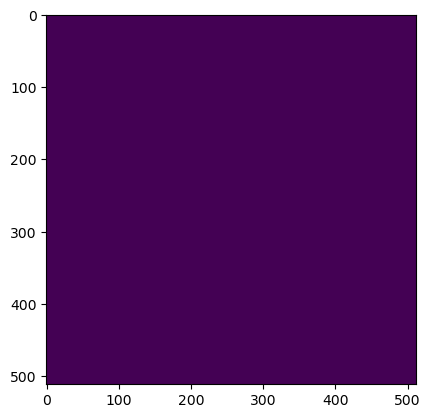

Wrote output/patches/mask/UU_S1_227-523216-0000-6329416-0000.tiff (512 x 512 pixels)


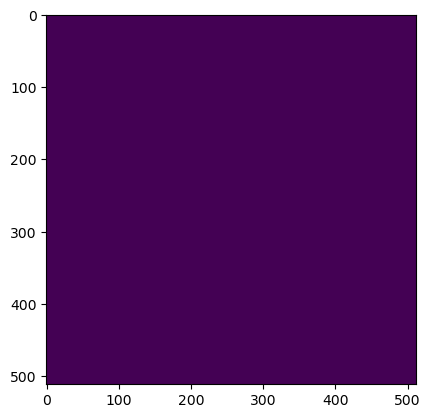

Wrote output/patches/mask/UU_S1_227-523216-0000-6329518-4000.tiff (512 x 512 pixels)


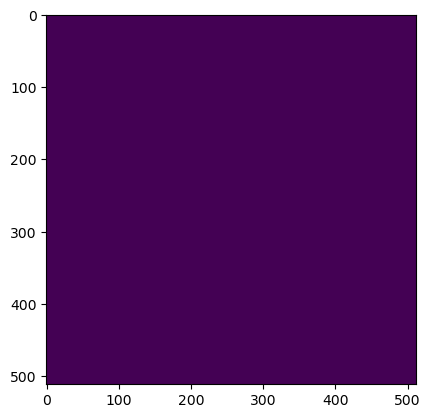

Wrote output/patches/mask/UU_S1_227-523216-0000-6329620-8000.tiff (512 x 512 pixels)


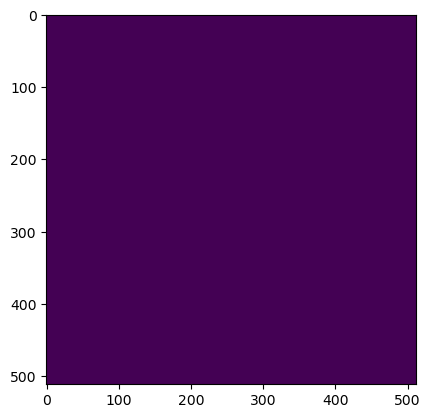

Wrote output/patches/mask/UU_S1_227-523318-4000-6329006-4000.tiff (512 x 512 pixels)


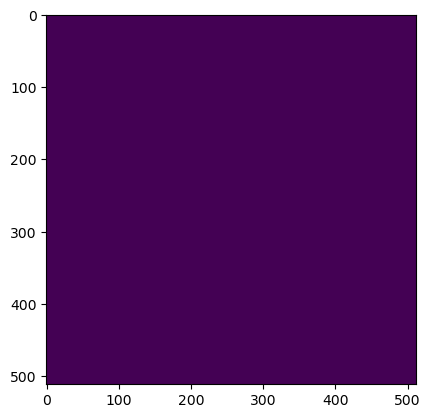

Wrote output/patches/mask/UU_S1_227-523318-4000-6329108-8000.tiff (512 x 512 pixels)


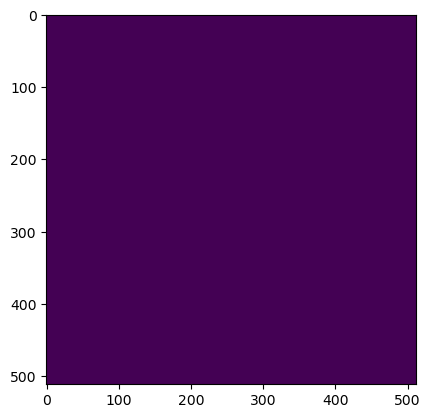

Wrote output/patches/mask/UU_S1_227-523318-4000-6329211-2000.tiff (512 x 512 pixels)


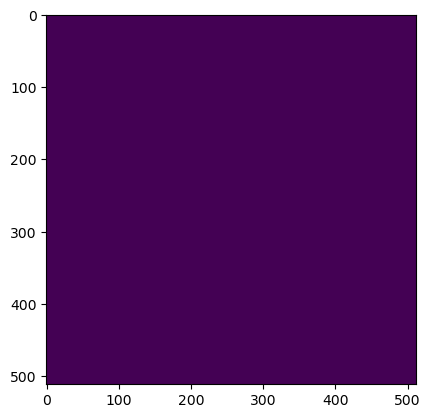

Wrote output/patches/mask/UU_S1_227-523318-4000-6329313-6000.tiff (512 x 512 pixels)


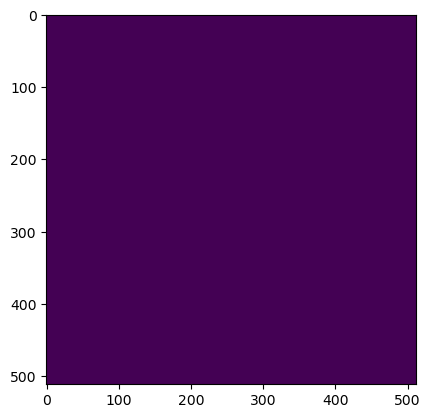

Wrote output/patches/mask/UU_S1_227-523318-4000-6329416-0000.tiff (512 x 512 pixels)


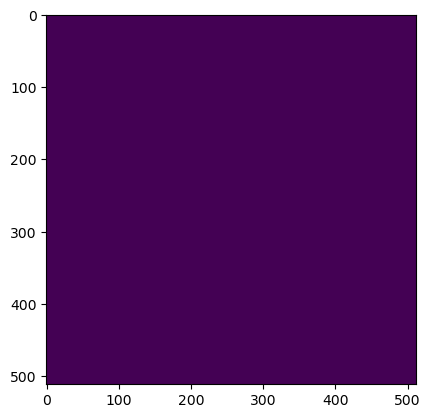

Wrote output/patches/mask/UU_S1_227-523318-4000-6329518-4000.tiff (512 x 512 pixels)


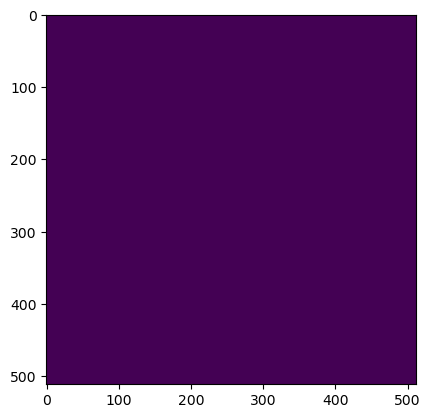

Wrote output/patches/mask/UU_S1_227-523318-4000-6329620-8000.tiff (512 x 512 pixels)
Zone UC_S1_228 Building Mask...


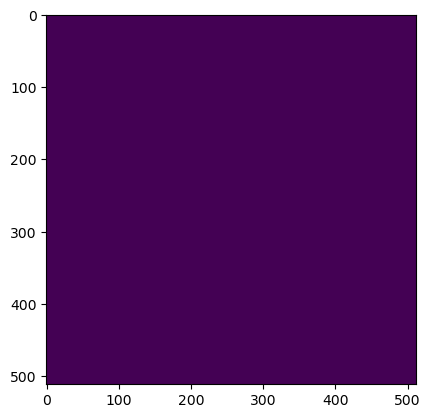

Wrote output/patches/mask/UC_S1_228-506064-0000-6331822-4000.tiff (512 x 512 pixels)


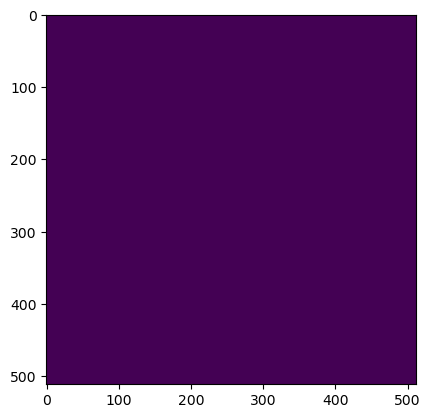

Wrote output/patches/mask/UC_S1_228-506064-0000-6331924-8000.tiff (512 x 512 pixels)


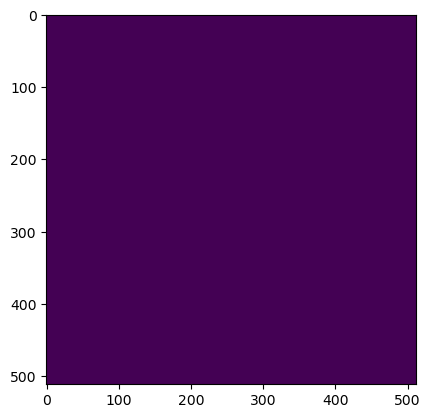

Wrote output/patches/mask/UC_S1_228-506064-0000-6332027-2000.tiff (512 x 512 pixels)


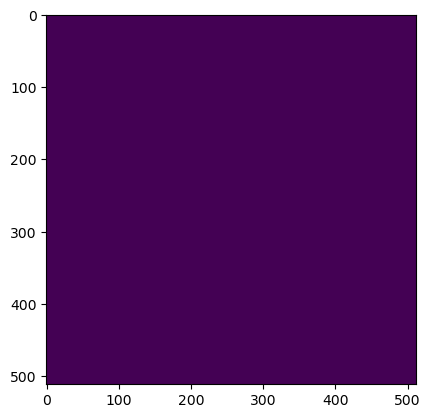

Wrote output/patches/mask/UC_S1_228-506064-0000-6332129-6000.tiff (512 x 512 pixels)


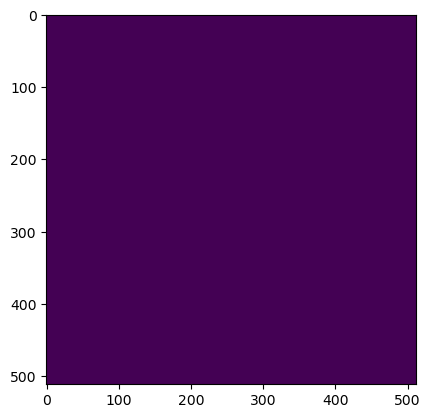

Wrote output/patches/mask/UC_S1_228-506064-0000-6332232-0000.tiff (512 x 512 pixels)


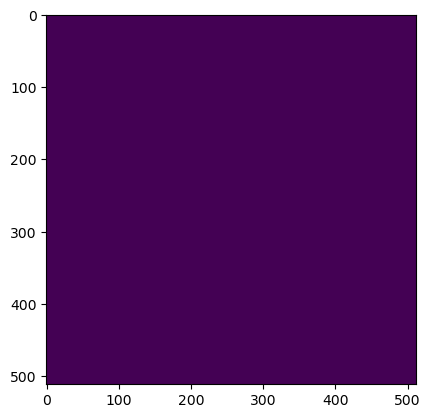

Wrote output/patches/mask/UC_S1_228-506064-0000-6332334-4000.tiff (512 x 512 pixels)


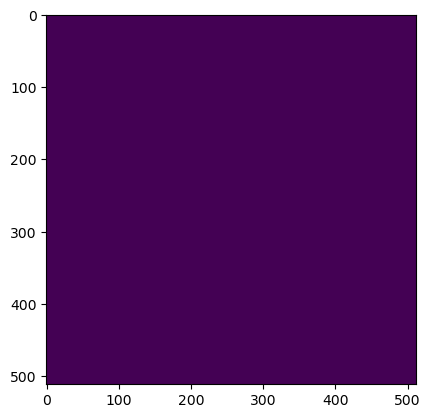

Wrote output/patches/mask/UC_S1_228-506064-0000-6332436-8000.tiff (512 x 512 pixels)


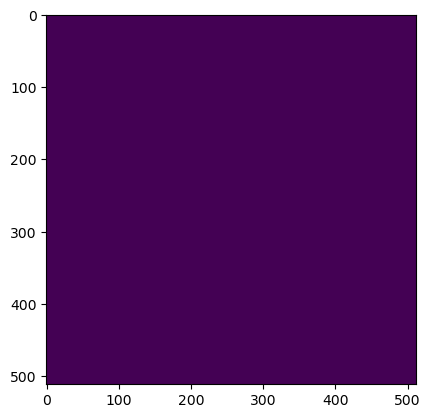

Wrote output/patches/mask/UC_S1_228-506064-0000-6332539-2000.tiff (512 x 512 pixels)


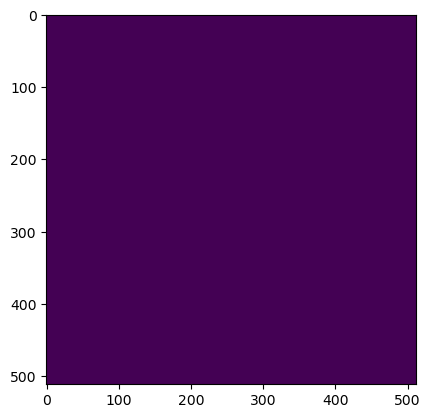

Wrote output/patches/mask/UC_S1_228-506064-0000-6332641-6000.tiff (512 x 512 pixels)


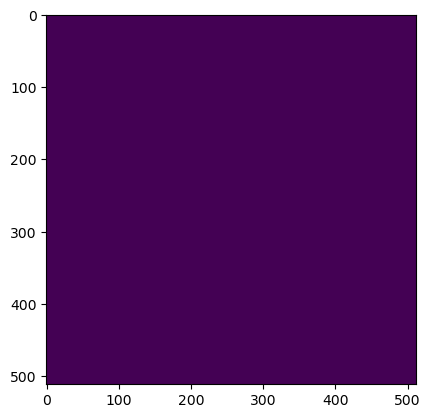

Wrote output/patches/mask/UC_S1_228-506166-4000-6331822-4000.tiff (512 x 512 pixels)


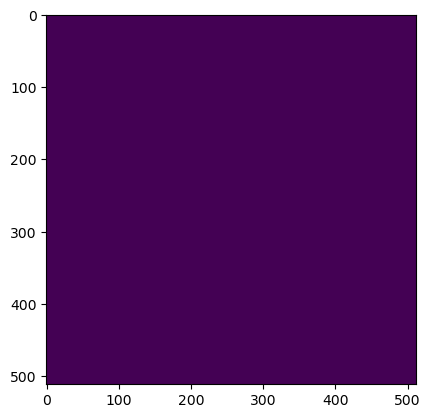

Wrote output/patches/mask/UC_S1_228-506166-4000-6331924-8000.tiff (512 x 512 pixels)


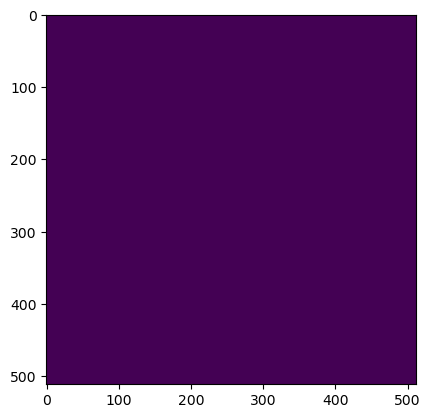

Wrote output/patches/mask/UC_S1_228-506166-4000-6332027-2000.tiff (512 x 512 pixels)


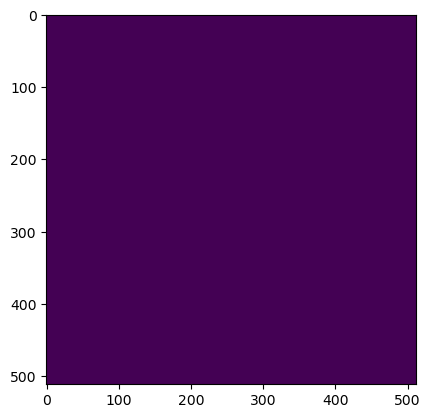

Wrote output/patches/mask/UC_S1_228-506166-4000-6332129-6000.tiff (512 x 512 pixels)


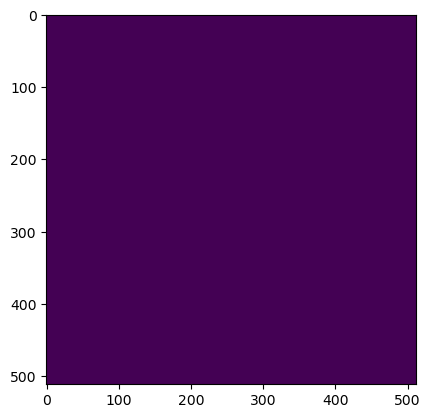

Wrote output/patches/mask/UC_S1_228-506166-4000-6332232-0000.tiff (512 x 512 pixels)


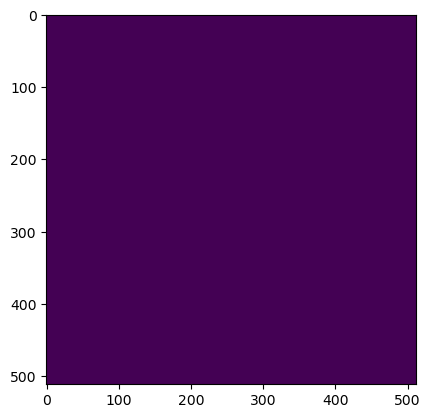

Wrote output/patches/mask/UC_S1_228-506166-4000-6332334-4000.tiff (512 x 512 pixels)


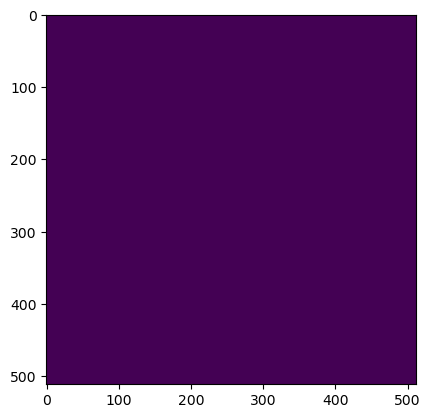

Wrote output/patches/mask/UC_S1_228-506166-4000-6332436-8000.tiff (512 x 512 pixels)


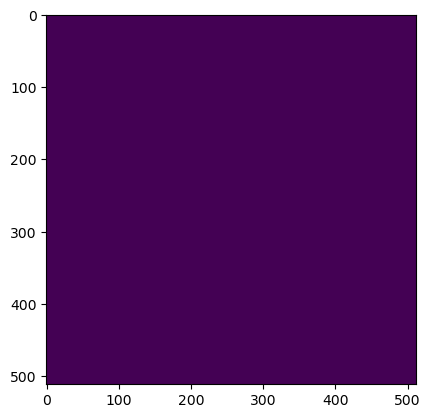

Wrote output/patches/mask/UC_S1_228-506166-4000-6332539-2000.tiff (512 x 512 pixels)


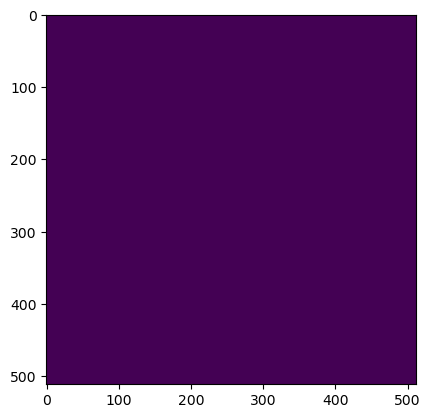

Wrote output/patches/mask/UC_S1_228-506166-4000-6332641-6000.tiff (512 x 512 pixels)


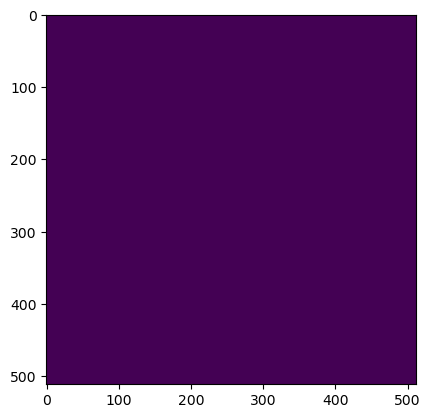

Wrote output/patches/mask/UC_S1_228-506268-8000-6331822-4000.tiff (512 x 512 pixels)


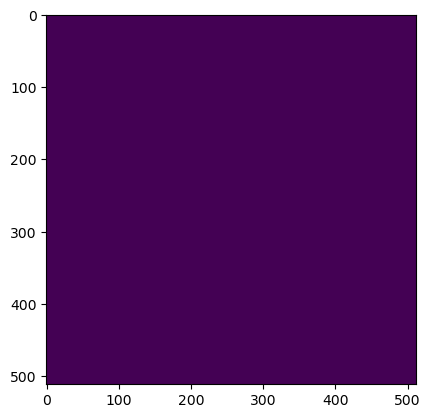

Wrote output/patches/mask/UC_S1_228-506268-8000-6331924-8000.tiff (512 x 512 pixels)


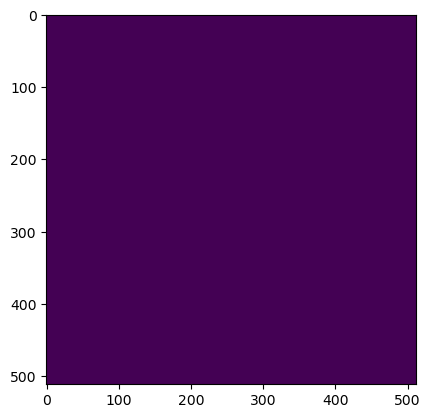

Wrote output/patches/mask/UC_S1_228-506268-8000-6332027-2000.tiff (512 x 512 pixels)


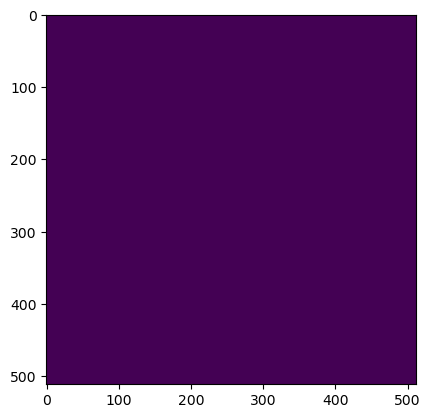

Wrote output/patches/mask/UC_S1_228-506268-8000-6332129-6000.tiff (512 x 512 pixels)


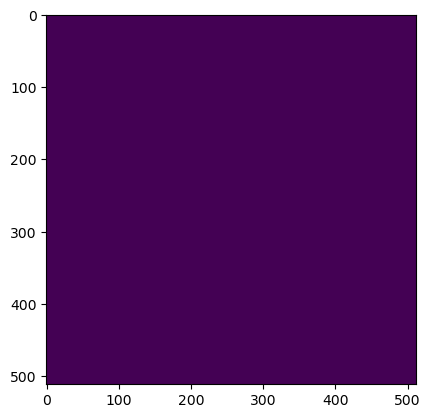

Wrote output/patches/mask/UC_S1_228-506268-8000-6332232-0000.tiff (512 x 512 pixels)


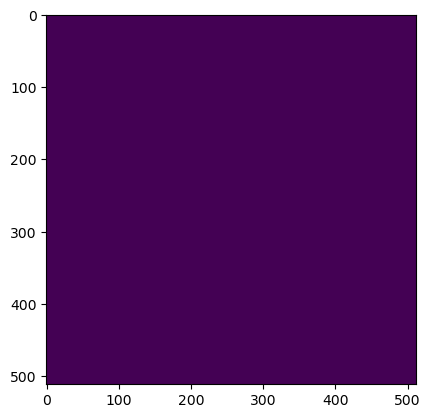

Wrote output/patches/mask/UC_S1_228-506268-8000-6332334-4000.tiff (512 x 512 pixels)


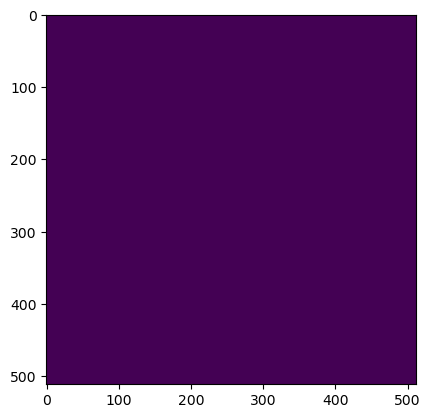

Wrote output/patches/mask/UC_S1_228-506268-8000-6332436-8000.tiff (512 x 512 pixels)


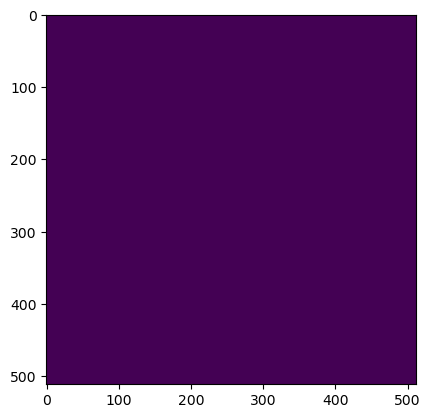

Wrote output/patches/mask/UC_S1_228-506268-8000-6332539-2000.tiff (512 x 512 pixels)


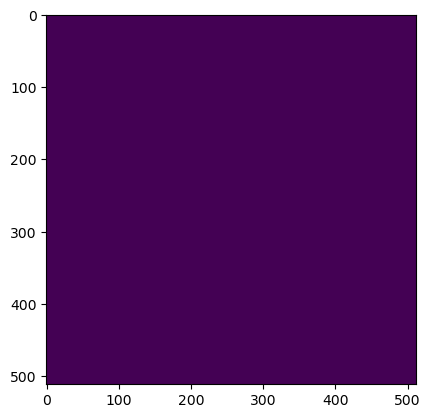

Wrote output/patches/mask/UC_S1_228-506268-8000-6332641-6000.tiff (512 x 512 pixels)


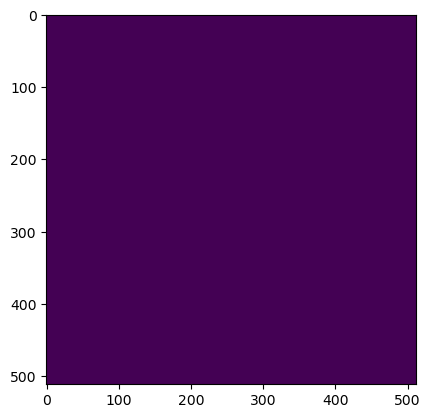

Wrote output/patches/mask/UC_S1_228-506371-2000-6331822-4000.tiff (512 x 512 pixels)


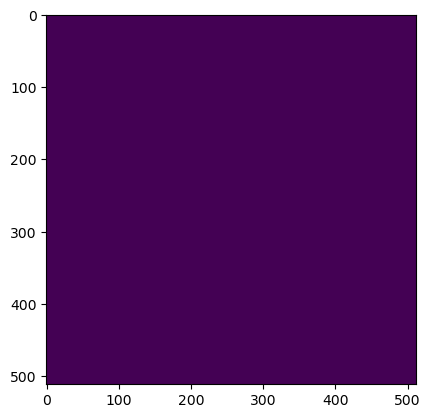

Wrote output/patches/mask/UC_S1_228-506371-2000-6331924-8000.tiff (512 x 512 pixels)


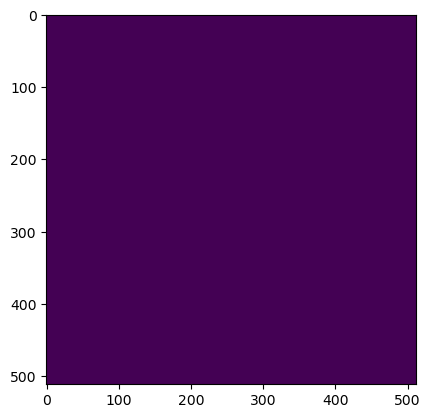

Wrote output/patches/mask/UC_S1_228-506371-2000-6332027-2000.tiff (512 x 512 pixels)


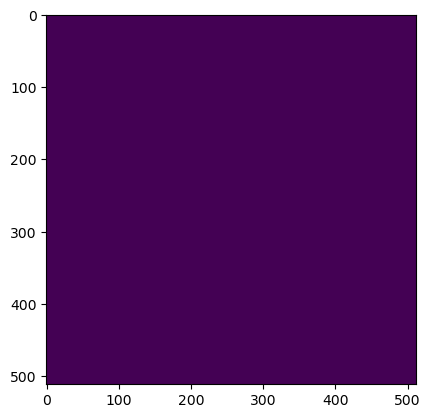

Wrote output/patches/mask/UC_S1_228-506371-2000-6332129-6000.tiff (512 x 512 pixels)


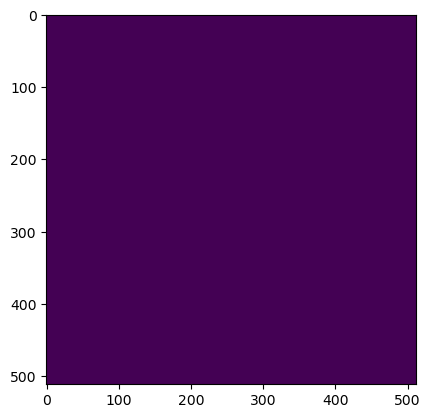

Wrote output/patches/mask/UC_S1_228-506371-2000-6332232-0000.tiff (512 x 512 pixels)


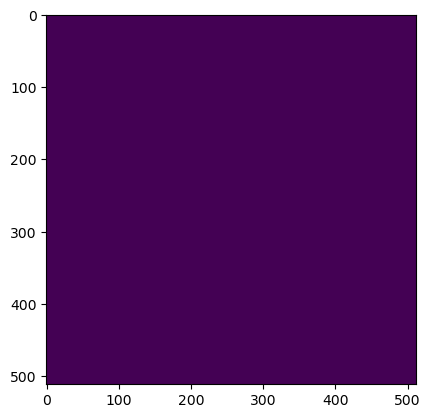

Wrote output/patches/mask/UC_S1_228-506371-2000-6332334-4000.tiff (512 x 512 pixels)


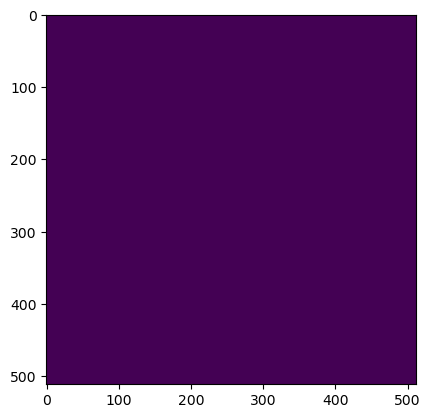

Wrote output/patches/mask/UC_S1_228-506371-2000-6332436-8000.tiff (512 x 512 pixels)


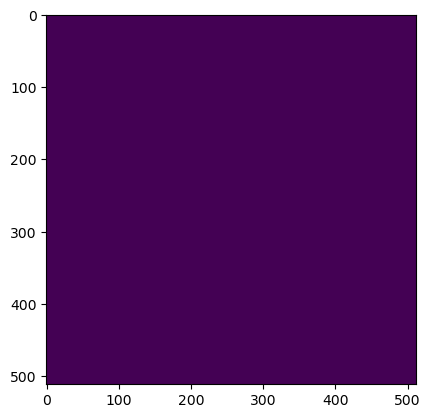

Wrote output/patches/mask/UC_S1_228-506371-2000-6332539-2000.tiff (512 x 512 pixels)


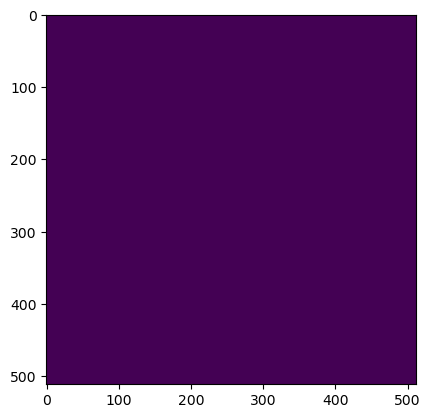

Wrote output/patches/mask/UC_S1_228-506371-2000-6332641-6000.tiff (512 x 512 pixels)
Zone VV_S1_229 Building Mask...


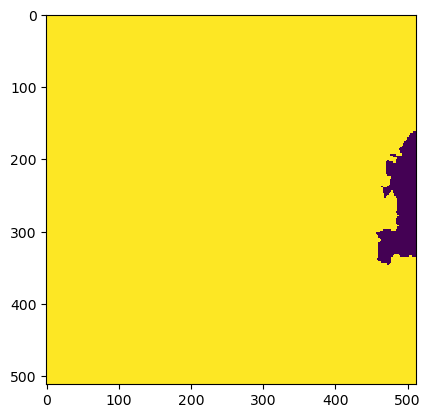

Wrote output/patches/mask/VV_S1_229-446416-0000-6294190-4000.tiff (512 x 512 pixels)


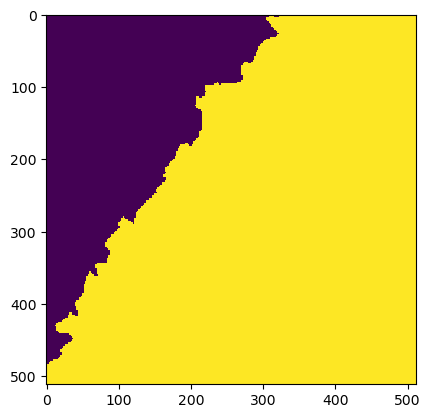

Wrote output/patches/mask/VV_S1_229-446416-0000-6294292-8000.tiff (512 x 512 pixels)


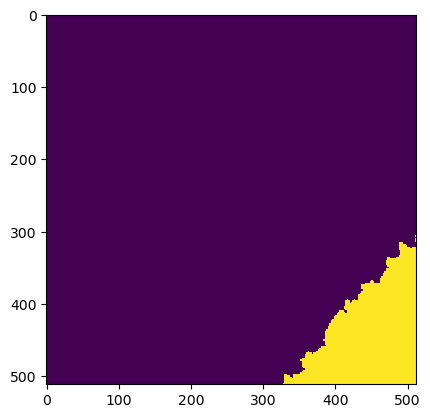

Wrote output/patches/mask/VV_S1_229-446416-0000-6294395-2000.tiff (512 x 512 pixels)


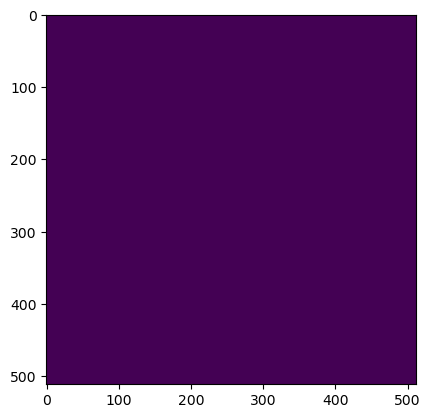

Wrote output/patches/mask/VV_S1_229-446416-0000-6294497-6000.tiff (512 x 512 pixels)


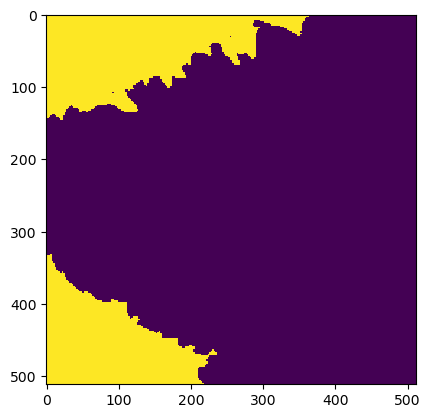

Wrote output/patches/mask/VV_S1_229-446518-4000-6294190-4000.tiff (512 x 512 pixels)


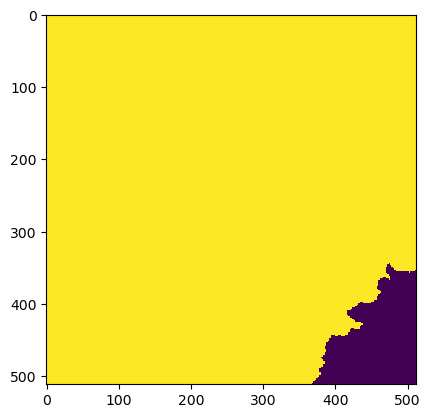

Wrote output/patches/mask/VV_S1_229-446518-4000-6294292-8000.tiff (512 x 512 pixels)


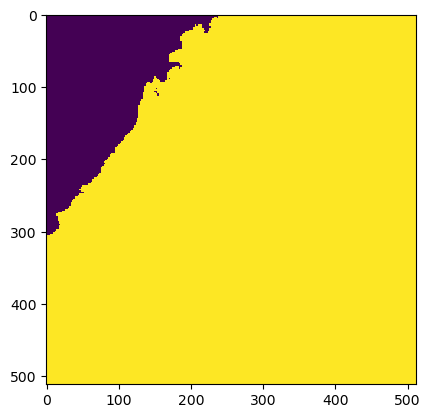

Wrote output/patches/mask/VV_S1_229-446518-4000-6294395-2000.tiff (512 x 512 pixels)


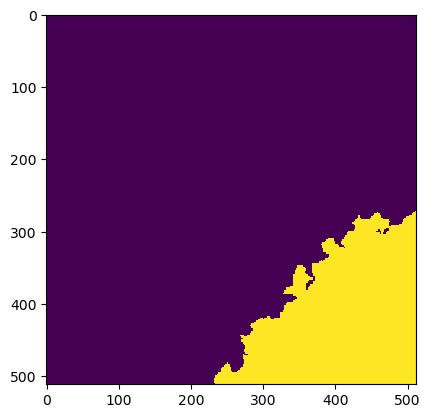

Wrote output/patches/mask/VV_S1_229-446518-4000-6294497-6000.tiff (512 x 512 pixels)


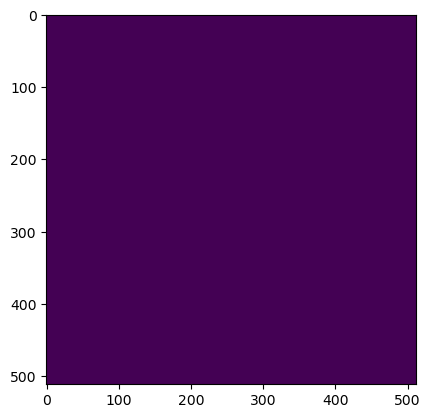

Wrote output/patches/mask/VV_S1_229-446620-8000-6294190-4000.tiff (512 x 512 pixels)


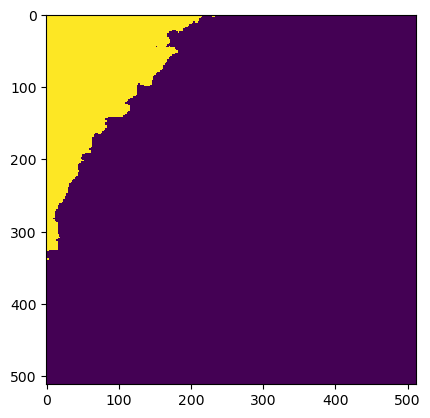

Wrote output/patches/mask/VV_S1_229-446620-8000-6294292-8000.tiff (512 x 512 pixels)


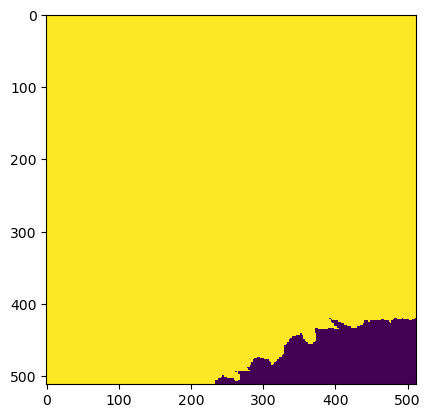

Wrote output/patches/mask/VV_S1_229-446620-8000-6294395-2000.tiff (512 x 512 pixels)


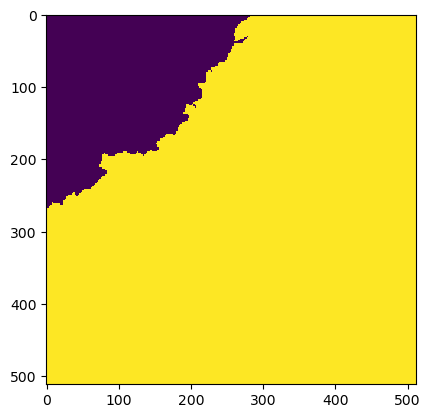

Wrote output/patches/mask/VV_S1_229-446620-8000-6294497-6000.tiff (512 x 512 pixels)


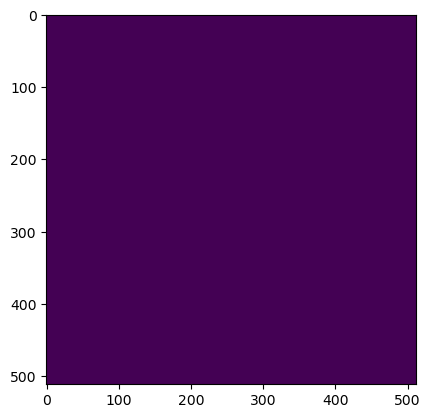

Wrote output/patches/mask/VV_S1_229-446723-2000-6294190-4000.tiff (512 x 512 pixels)


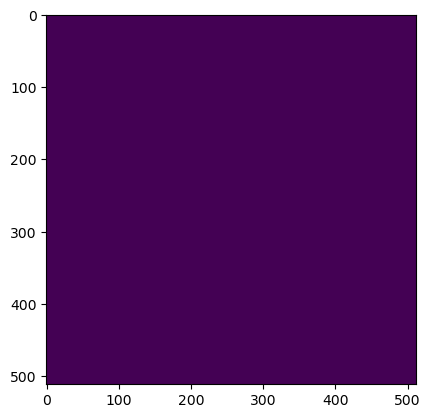

Wrote output/patches/mask/VV_S1_229-446723-2000-6294292-8000.tiff (512 x 512 pixels)


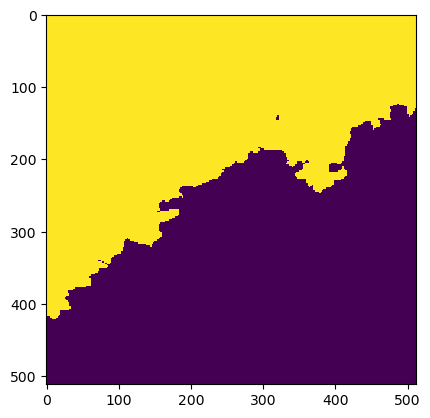

Wrote output/patches/mask/VV_S1_229-446723-2000-6294395-2000.tiff (512 x 512 pixels)


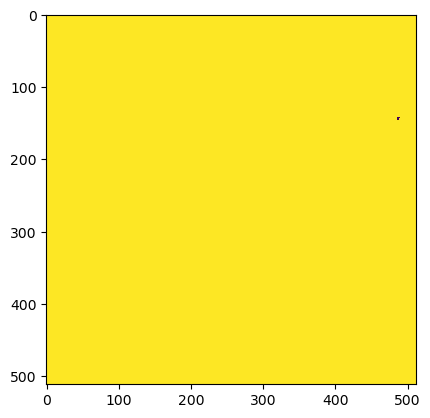

Wrote output/patches/mask/VV_S1_229-446723-2000-6294497-6000.tiff (512 x 512 pixels)
Zone UC_S1_230 Building Mask...


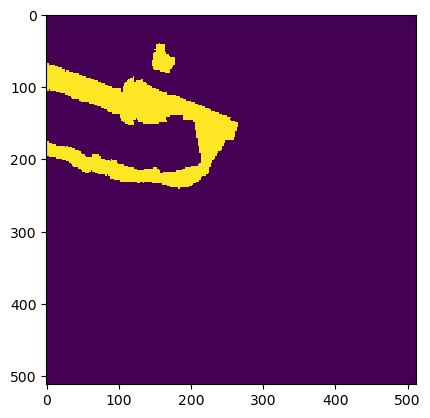

Wrote output/patches/mask/UC_S1_230-439760-0000-6294702-4000.tiff (512 x 512 pixels)


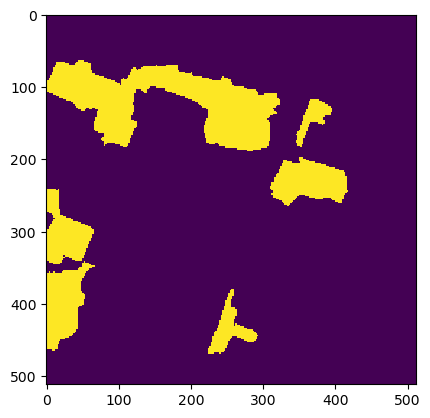

Wrote output/patches/mask/UC_S1_230-439760-0000-6294804-8000.tiff (512 x 512 pixels)


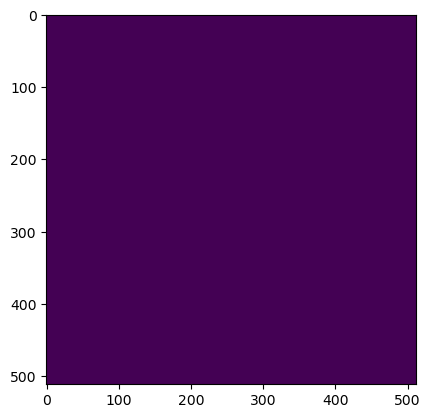

Wrote output/patches/mask/UC_S1_230-439862-4000-6294702-4000.tiff (512 x 512 pixels)


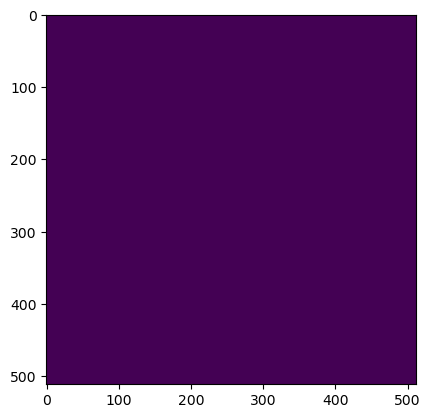

Wrote output/patches/mask/UC_S1_230-439862-4000-6294804-8000.tiff (512 x 512 pixels)
Zone UC_S1_231 Building Mask...


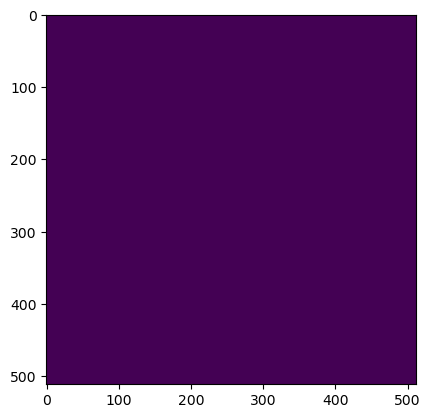

Wrote output/patches/mask/UC_S1_231-438480-0000-6294702-4000.tiff (512 x 512 pixels)


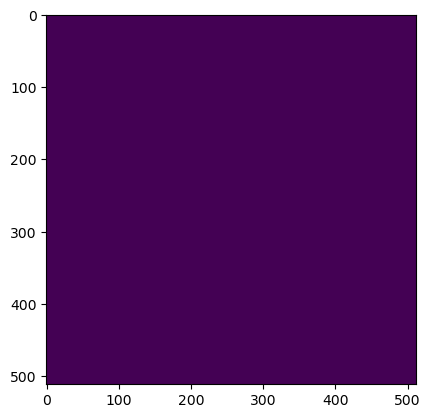

Wrote output/patches/mask/UC_S1_231-438480-0000-6294804-8000.tiff (512 x 512 pixels)


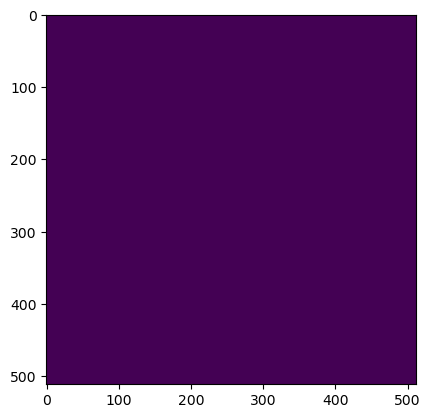

Wrote output/patches/mask/UC_S1_231-438582-4000-6294702-4000.tiff (512 x 512 pixels)


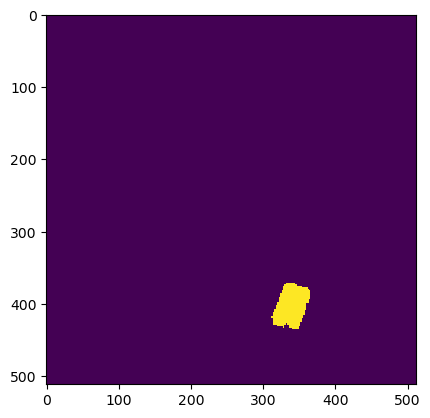

Wrote output/patches/mask/UC_S1_231-438582-4000-6294804-8000.tiff (512 x 512 pixels)


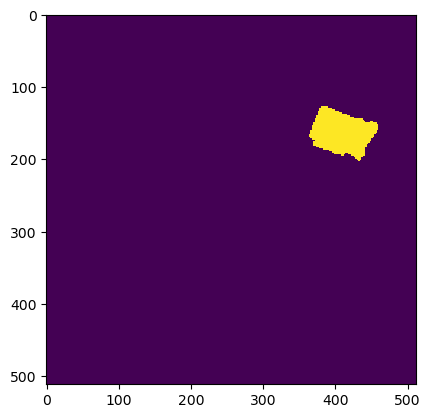

Wrote output/patches/mask/UC_S1_231-438684-8000-6294702-4000.tiff (512 x 512 pixels)


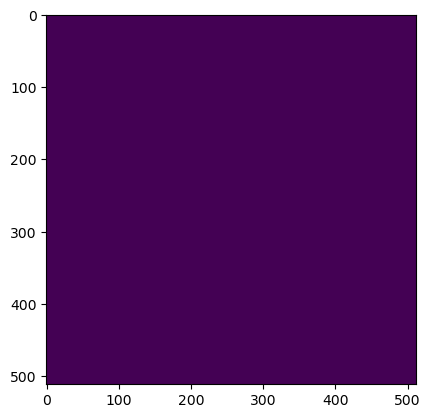

Wrote output/patches/mask/UC_S1_231-438684-8000-6294804-8000.tiff (512 x 512 pixels)


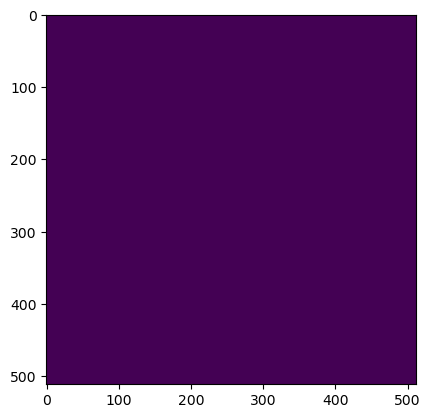

Wrote output/patches/mask/UC_S1_231-438787-2000-6294702-4000.tiff (512 x 512 pixels)


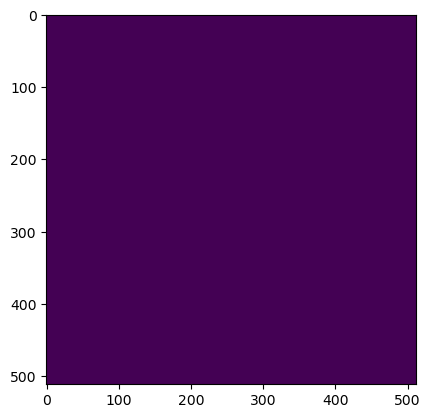

Wrote output/patches/mask/UC_S1_231-438787-2000-6294804-8000.tiff (512 x 512 pixels)
Zone VC_S1_232 Building Mask...


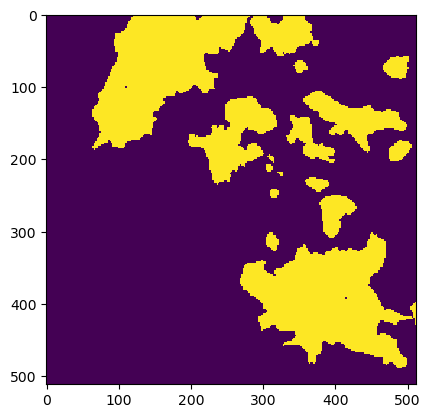

Wrote output/patches/mask/VC_S1_232-465616-0000-6294702-4000.tiff (512 x 512 pixels)


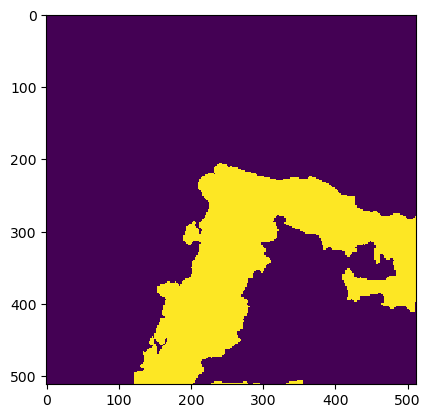

Wrote output/patches/mask/VC_S1_232-465616-0000-6294804-8000.tiff (512 x 512 pixels)


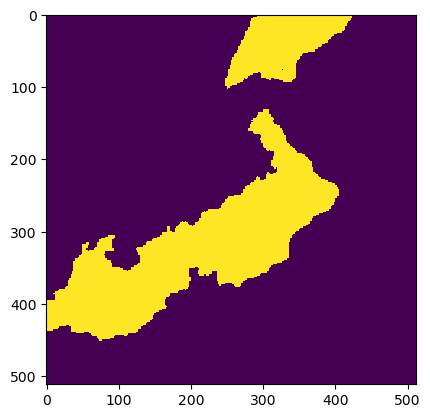

Wrote output/patches/mask/VC_S1_232-465718-4000-6294702-4000.tiff (512 x 512 pixels)


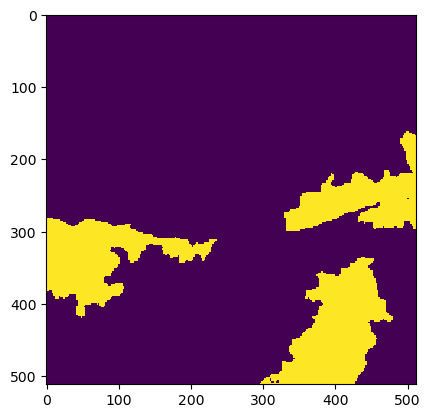

Wrote output/patches/mask/VC_S1_232-465718-4000-6294804-8000.tiff (512 x 512 pixels)


['output/patches/mask/UC_S1_1-485584-0000-6256046-4000.tiff',
 'output/patches/mask/UC_S1_1-485584-0000-6256148-8000.tiff',
 'output/patches/mask/UC_S1_1-485686-4000-6256046-4000.tiff',
 'output/patches/mask/UC_S1_1-485686-4000-6256148-8000.tiff',
 'output/patches/mask/CV_S1_2-491216-0000-6257326-4000.tiff',
 'output/patches/mask/CV_S1_2-491216-0000-6257428-8000.tiff',
 'output/patches/mask/CV_S1_2-491216-0000-6257531-2000.tiff',
 'output/patches/mask/CV_S1_2-491216-0000-6257633-6000.tiff',
 'output/patches/mask/CV_S1_2-491318-4000-6257326-4000.tiff',
 'output/patches/mask/CV_S1_2-491318-4000-6257428-8000.tiff',
 'output/patches/mask/CV_S1_2-491318-4000-6257531-2000.tiff',
 'output/patches/mask/CV_S1_2-491318-4000-6257633-6000.tiff',
 'output/patches/mask/CV_S1_2-491420-8000-6257326-4000.tiff',
 'output/patches/mask/CV_S1_2-491420-8000-6257428-8000.tiff',
 'output/patches/mask/CV_S1_2-491420-8000-6257531-2000.tiff',
 'output/patches/mask/CV_S1_2-491420-8000-6257633-6000.tiff',
 'output

In [81]:
write_patches_mask(
    changes_by_zone_df,
    zones_df,
    mnt_vrt,
    "output/patches/mask",
    512,
    resolution,
    live_plot=True,
)

## Build global shapefile with zone geometries and T0, T1, mask rvbie tiff files

In [66]:
files = list(zip(zone_2016_files, zone_2019_files, zones_masks_files))
files

[('output/zones/T0/UC_S1_1.tiff',
  'output/zones/T1/UC_S1_1.tiff',
  'output/zones/mask/UC_S1_1.tiff'),
 ('output/zones/T0/CV_S1_2.tiff',
  'output/zones/T1/CV_S1_2.tiff',
  'output/zones/mask/CV_S1_2.tiff'),
 ('output/zones/T0/CU_S1_3.tiff',
  'output/zones/T1/CU_S1_3.tiff',
  'output/zones/mask/CU_S1_3.tiff'),
 ('output/zones/T0/VV_S1_4.tiff',
  'output/zones/T1/VV_S1_4.tiff',
  'output/zones/mask/VV_S1_4.tiff'),
 ('output/zones/T0/CU_S1_5.tiff',
  'output/zones/T1/CU_S1_5.tiff',
  'output/zones/mask/CU_S1_5.tiff'),
 ('output/zones/T0/VV_S1_6.tiff',
  'output/zones/T1/VV_S1_6.tiff',
  'output/zones/mask/VV_S1_6.tiff'),
 ('output/zones/T0/CC_S1_7.tiff',
  'output/zones/T1/CC_S1_7.tiff',
  'output/zones/mask/CC_S1_7.tiff'),
 ('output/zones/T0/CV_S1_8.tiff',
  'output/zones/T1/CV_S1_8.tiff',
  'output/zones/mask/CV_S1_8.tiff'),
 ('output/zones/T0/VV_S1_9.tiff',
  'output/zones/T1/VV_S1_9.tiff',
  'output/zones/mask/VV_S1_9.tiff'),
 ('output/zones/T0/CC_S1_10.tiff',
  'output/zones/T1/C

In [68]:
zsdf = zones_df.copy()
zsdf["TO"] = zone_2016_files
zsdf["T1"] = zone_2019_files
zsdf["mask"] = zones_masks_files
zsdf.to_file("output/zones/dataset.shp")

## Comparing datasets

In [98]:
from osgeo_utils import gdalcompare
from osgeo import gdal
import filecmp

truth_dir = "/mnt/store_dai/projets/dchan/datasets/gers/change/zones/mask"

for zone, r in list(changes_by_zone_df.iterrows()):
    print(f"Zone {zone} Checking...")
    
    file1 = f"{output_dir}/{zone}.tiff"
    file2 = f"{truth_dir}/{zone}.tiff"
    tiff1 = gdal.Open(file1)
    tiff2 = gdal.Open(file2)
    
#     r1 = rasterio.open(file1)
#     print("mask", tiff1.GetRasterBand(1).GetMaskFlags(), tiff2.GetRasterBand(1).GetMaskFlags())

    bin_cmp = filecmp.cmp(file1, file2)
    gdal_cmp = gdalcompare.compare_db(tiff1, tiff2)
    if bin_cmp and (gdal_cmp == 0):
        print("SAME")
    else:
        print("NOT SAME")

Zone CC_S1_10 Checking...
Band 1 checksum difference:
  Golden: 2316
  New:    2457
  Pixels Differing: 141
  Maximum Pixel Difference: 1.0
NOT SAME
Zone CC_S1_108 Checking...
Band 1 checksum difference:
  Golden: 8764
  New:    9572
  Pixels Differing: 808
  Maximum Pixel Difference: 1.0
Difference in Band 1 metadata key count
  Golden Keys: []
  New Keys: ['STATISTICS_APPROXIMATE', 'STATISTICS_MAXIMUM', 'STATISTICS_MEAN', 'STATISTICS_MINIMUM', 'STATISTICS_STDDEV', 'STATISTICS_VALID_PERCENT']
NOT SAME
Zone CC_S1_110 Checking...
Band 1 checksum difference:
  Golden: 28400
  New:    30275
  Pixels Differing: 1875
  Maximum Pixel Difference: 1.0
NOT SAME
Zone CC_S1_112 Checking...
Band 1 checksum difference:
  Golden: 31128
  New:    12390
  Pixels Differing: 46798
  Maximum Pixel Difference: 1.0
NOT SAME
Zone CC_S1_126 Checking...
Band 1 checksum difference:
  Golden: 6916
  New:    7568
  Pixels Differing: 652
  Maximum Pixel Difference: 1.0
NOT SAME
Zone CC_S1_219 Checking...
Band 1 c

Band 1 checksum difference:
  Golden: 15236
  New:    47049
  Pixels Differing: 31813
  Maximum Pixel Difference: 1.0
NOT SAME
Zone NV_S1_151 Checking...
Band 1 checksum difference:
  Golden: 45684
  New:    55714
  Pixels Differing: 10030
  Maximum Pixel Difference: 1.0
NOT SAME
Zone NV_S1_185 Checking...
Band 1 checksum difference:
  Golden: 3012
  New:    6136
  Pixels Differing: 3124
  Maximum Pixel Difference: 1.0
NOT SAME
Zone NV_S1_49 Checking...
Band 1 checksum difference:
  Golden: 16120
  New:    24637
  Pixels Differing: 8517
  Maximum Pixel Difference: 1.0
NOT SAME
Zone NV_S1_95 Checking...
Band 1 checksum difference:
  Golden: 2080
  New:    13574
  Pixels Differing: 11494
  Maximum Pixel Difference: 1.0
NOT SAME
Zone UC_S1_1 Checking...
Band 1 checksum difference:
  Golden: 20212
  New:    55804
  Pixels Differing: 296374
  Maximum Pixel Difference: 1.0
NOT SAME
Zone UC_S1_105 Checking...
Band 1 checksum difference:
  Golden: 26088
  New:    29272
  Pixels Differing: 3184

Band 1 checksum difference:
  Golden: 10988
  New:    11462
  Pixels Differing: 474
  Maximum Pixel Difference: 1.0
NOT SAME
Zone UU_S1_182 Checking...
Band 1 checksum difference:
  Golden: 5120
  New:    6958
  Pixels Differing: 1838
  Maximum Pixel Difference: 1.0
NOT SAME
Zone UU_S1_19 Checking...
Band 1 checksum difference:
  Golden: 35160
  New:    37000
  Pixels Differing: 1840
  Maximum Pixel Difference: 1.0
NOT SAME
Zone UU_S1_203 Checking...
Band 1 checksum difference:
  Golden: 25092
  New:    30048
  Pixels Differing: 4956
  Maximum Pixel Difference: 1.0
NOT SAME
Zone UU_S1_215 Checking...
Band 1 checksum difference:
  Golden: 55260
  New:    58722
  Pixels Differing: 3462
  Maximum Pixel Difference: 1.0
NOT SAME
Zone UU_S1_216 Checking...
Band 1 checksum difference:
  Golden: 12660
  New:    13392
  Pixels Differing: 732
  Maximum Pixel Difference: 1.0
NOT SAME
Zone UU_S1_217 Checking...
Band 1 checksum difference:
  Golden: 22440
  New:    23682
  Pixels Differing: 1242
  

Band 1 checksum difference:
  Golden: 28444
  New:    32378
  Pixels Differing: 3934
  Maximum Pixel Difference: 1.0
NOT SAME
Zone VC_S1_196 Checking...
Band 1 checksum difference:
  Golden: 36920
  New:    49511
  Pixels Differing: 12591
  Maximum Pixel Difference: 1.0
NOT SAME
Zone VC_S1_202 Checking...
Band 1 checksum difference:
  Golden: 15156
  New:    17640
  Pixels Differing: 2484
  Maximum Pixel Difference: 1.0
NOT SAME
Zone VC_S1_205 Checking...
Band 1 checksum difference:
  Golden: 24896
  New:    38302
  Pixels Differing: 13406
  Maximum Pixel Difference: 1.0
NOT SAME
Zone VC_S1_208 Checking...
Band 1 checksum difference:
  Golden: 10908
  New:    13711
  Pixels Differing: 2803
  Maximum Pixel Difference: 1.0
NOT SAME
Zone VC_S1_222 Checking...
Band 1 checksum difference:
  Golden: 13844
  New:    33596
  Pixels Differing: 19752
  Maximum Pixel Difference: 1.0
NOT SAME
Zone VC_S1_232 Checking...
Band 1 checksum difference:
  Golden: 32416
  New:    39386
  Pixels Differing: